<a href="https://colab.research.google.com/github/dwarfy35/deep_learning2/blob/main/FontGANTrained.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [1]:
import matplotlib.pyplot as plt
import numpy as np
import torch
import torch.optim as optim
import torch.nn as nn
from torch.utils.data import Dataset, DataLoader
from torchvision import transforms
from google.colab import drive
from torch.autograd import grad

drive.mount('/content/gdrive')

Mounted at /content/gdrive


In [2]:
class Generator(nn.Module):
    def __init__(self, z_dim, num_classes, img_size):
        super(Generator, self).__init__()
        self.z_dim = z_dim
        self.num_classes = num_classes
        self.img_size = img_size

        self.model = nn.Sequential(
            nn.Linear(z_dim + num_classes, 256),
            nn.ReLU(),
            nn.Linear(256, 512),
            #nn.BatchNorm1d(512),
            nn.ReLU(),
            nn.Linear(512, 1024),
            #nn.BatchNorm1d(1024),
            nn.ReLU(),
            nn.Linear(1024, img_size * img_size),
            nn.Tanh()
        )

    def forward(self, z_s, z_c):
        z = torch.cat([z_s, z_c], dim=1)
        img = self.model(z)
        return img.view(img.size(0), 1, self.img_size, self.img_size)

class Discriminator(nn.Module):
    def __init__(self, img_size):
        super(Discriminator, self).__init__()
        self.model = nn.Sequential(
            nn.Linear(img_size * img_size, 512),
            nn.LeakyReLU(0.2),
            nn.Linear(512, 256),
            nn.LeakyReLU(0.2),
            nn.Linear(256, 1)
        )

    def forward(self, img):
        img_flat = img.view(img.size(0), -1)
        validity = self.model(img_flat)
        return validity


In [3]:
ngf = 32
nc = 1
ndf = 32

In [4]:


class ConvGenerator(nn.Module):
    def __init__(self, z_dim, num_classes, img_size):
        super(ConvGenerator, self).__init__()
        self.img_size = img_size
        self.init_size = img_size // 8  # Initial image size before upsampling

        # Fully connected layer to map z to initial feature maps
        self.fc = nn.Sequential(
            nn.Linear(z_dim + num_classes, 256 * self.init_size ** 2),
            nn.ReLU()
        )

        # Convolutional blocks to progressively upsample
        self.conv_blocks = nn.Sequential(
            nn.ConvTranspose2d(256, 128, 4, stride=2, padding=1),  # Upsample to img_size/4
            #nn.BatchNorm2d(128),
            nn.ReLU(),
            nn.ConvTranspose2d(128, 128, 4, stride=2, padding=1),  # Upsample to img_size/2
            #nn.BatchNorm2d(128),
            nn.ReLU(),
            nn.Conv2d(128, 128, 3, stride=1, padding=1),  # Additional convolution
            #nn.BatchNorm2d(128),
            nn.ReLU(),
            nn.ConvTranspose2d(128, 64, 4, stride=2, padding=1),  # Upsample to img_size
            #nn.BatchNorm2d(64),
            nn.ReLU(),
            nn.Conv2d(64, 1, 3, stride=1, padding=1),  # Output single-channel image
            nn.Tanh()  # Output in range [-1, 1]
        )

    def forward(self, z):
        out = self.fc(z)  # Fully connected
        out = out.view(out.size(0), 256, self.init_size, self.init_size)  # Reshape to (B, C, H, W)
        img = self.conv_blocks(out)  # Upsample to the desired image size
        return img



class ConvDiscriminator(nn.Module):
    def __init__(self, img_size):
        super(ConvDiscriminator, self).__init__()
        self.img_size = img_size

        # Convolutional blocks to progressively downsample
        self.conv_blocks = nn.Sequential(
            nn.Conv2d(1, 64, 4, stride=2, padding=1),  # Downsample to img_size/2
            nn.LeakyReLU(0.2, inplace=True),
            nn.Conv2d(64, 128, 4, stride=2, padding=1),  # Downsample to img_size/4
            #nn.BatchNorm2d(128),
            nn.LeakyReLU(0.2, inplace=True),
            nn.Conv2d(128, 128, 3, stride=1, padding=1),  # Additional convolution
            #nn.BatchNorm2d(128),
            nn.LeakyReLU(0.2, inplace=True),
            nn.Conv2d(128, 256, 4, stride=2, padding=1),  # Downsample to img_size/8
            #nn.BatchNorm2d(256),
            nn.LeakyReLU(0.2, inplace=True),
        )

        # Fully connected layer to output a single scalar
        self.fc = nn.Sequential(
            nn.Linear(256 * (img_size // 8) ** 2, 1)
        )

    def forward(self, img):
        out = self.conv_blocks(img)  # Convolutions
        out = out.view(out.size(0), -1)  # Flatten
        validity = self.fc(out)  # Scalar output
        return validity




In [5]:
class Discriminator2(nn.Module):
    def __init__(self, nc=1, ndf=32, ngpu=1):
        """
        Args:
            nc: Number of channels in the input image (e.g., 1 for grayscale).
            ndf: Number of filters in the first convolutional layer.
            ngpu: Number of GPUs available for training.
        """
        super(Discriminator2, self).__init__()
        self.ngpu = ngpu
        self.main = nn.Sequential(
            # Input: (nc) x 32 x 32
            nn.Conv2d(nc, ndf, 4, 2, 1, bias=False),  # 32x32 → 16x16
            nn.LeakyReLU(0.2, inplace=True),
            # State: (ndf) x 16 x 16
            nn.Conv2d(ndf, ndf * 2, 4, 2, 1, bias=False),  # 16x16 → 8x8
            #nn.BatchNorm2d(ndf * 2),
            nn.LeakyReLU(0.2, inplace=True),
            # State: (ndf*2) x 8 x 8
            nn.Conv2d(ndf * 2, ndf * 4, 4, 2, 1, bias=False),  # 8x8 → 4x4
            #nn.BatchNorm2d(ndf * 4),
            nn.LeakyReLU(0.2, inplace=True),
            # State: (ndf*4) x 4 x 4
            nn.Conv2d(ndf * 4, 1, 4, 1, 0, bias=False),  # 4x4 → 1x1
            nn.Sigmoid()  # Output scalar probability
        )

    def forward(self, input):
        return self.main(input)


In [6]:
class Generator2(nn.Module):
    def __init__(self, nz=126, ngf=32, nc=1, ngpu=1):
        """
        Args:
            nz: Size of the latent vector (input to the generator).
            ngf: Number of filters in the last transposed convolutional layer.
            nc: Number of output channels in the generated image (e.g., 1 for grayscale).
            ngpu: Number of GPUs available for training.
        """
        super(Generator2, self).__init__()
        self.ngpu = ngpu
        self.init_size = 4  # Initial feature map size (4x4)

        # Fully connected layer to project latent vector
        self.fc = nn.Sequential(
            nn.Linear(nz, ngf * 4 * self.init_size * self.init_size),  # Project to 4x4x(ngf*4)
            nn.ReLU(True)
        )

        # Transposed convolutional layers
        self.main = nn.Sequential(
            # Input: (ngf*4) x 4 x 4
            nn.ConvTranspose2d(ngf * 4, ngf * 2, 4, 2, 1, bias=False),  # 4x4 → 8x8
            #nn.BatchNorm2d(ngf * 2),
            nn.ReLU(True),
            # State: (ngf*2) x 8 x 8
            nn.ConvTranspose2d(ngf * 2, ngf, 4, 2, 1, bias=False),  # 8x8 → 16x16
            #nn.BatchNorm2d(ngf),
            nn.ReLU(True),
            # State: (ngf) x 16 x 16
            nn.ConvTranspose2d(ngf, nc, 4, 2, 1, bias=False),  # 16x16 → 32x32
            nn.Tanh()  # Output range: [-1, 1]
        )

    def forward(self, z):
        # Fully connected projection and reshape to 4D
        out = self.fc(z).view(z.size(0), -1, self.init_size, self.init_size)  # Shape: [B, ngf*4, 4, 4]
        img = self.main(out)  # Pass through transposed convolutional layers
        return img



In [7]:
class Generator3(nn.Module):
    def __init__(self, latent_dim):
        super(Generator3, self).__init__()

        self.init_size = 2  # Initial spatial size
        self.latent_dim = latent_dim

        # In the paper it is not specified z transforms into a 4x4x512 (for 64x64 data) so we will use a linear layer to do so.
        self.fc = nn.Linear(latent_dim, 512 * self.init_size * self.init_size)
        # No relu because we just had to reshape the latent vector to something that when flattened is 2 * 32^2, which 2x2x512 is


        # We make the transposed convolutional layers (fractionally strided convolutions)
        self.deconv_blocks = nn.Sequential(
            # Block 1: Input (2x2x512) -> Output (4x4x256)
            nn.ConvTranspose2d(512, 256, kernel_size=4, stride=2, padding=1),
            nn.ReLU(),

            # Block 2: Input (4x4x256)-> Output (8x8x128)
            nn.ConvTranspose2d(256, 128, kernel_size=4, stride=2, padding=1),
            nn.ReLU(),

            # Block 3: Input (8x8x128) -> Output (16x16x64)
            nn.ConvTranspose2d(128, 64, kernel_size=4, stride=2, padding=1),
            nn.ReLU(),

            # Final Block: Input (16x16x64) -> Output (32x32x1)
            nn.ConvTranspose2d(64, 1, kernel_size=4, stride=2, padding=1),
            nn.Tanh()
        )

    def forward(self, z):
        # Pass the latent vector through the fully connected layer
        out = self.fc(z)

        # Reshape to match the initial feature map dimensions. out.size(0) = batch size.
        out = out.view(out.size(0), 512, self.init_size, self.init_size)

        # We pass "out" through the transposed convolutional blocks
        img = self.deconv_blocks(out)

        return img

class Discriminator3(nn.Module):
    def __init__(self, nc=1, ndf=32, ngpu=1):
        """
        Args:
            nc: Number of channels in the input image (e.g., 1 for grayscale).
            ndf: Number of filters in the first convolutional layer.
            ngpu: Number of GPUs available for training.
        """
        super(Discriminator3, self).__init__()
        self.ngpu = ngpu
        self.main = nn.Sequential(
            # Input: (nc) x 32 x 32
            nn.Conv2d(1, ndf, 4, 2, 1, bias=False),  # 32x32 → 16x16
            nn.LeakyReLU(0.2, inplace=True),
            # State: (ndf) x 16 x 16
            nn.Conv2d(ndf, ndf * 2, 4, 2, 1, bias=False),  # 16x16 → 8x8
            #nn.BatchNorm2d(ndf * 2),
            nn.LeakyReLU(0.2, inplace=True),
            # State: (ndf*2) x 8 x 8
            nn.Conv2d(ndf * 2, ndf * 4, 4, 2, 1, bias=False),  # 8x8 → 4x4
            #nn.BatchNorm2d(ndf * 4),
            nn.LeakyReLU(0.2, inplace=True),
            # State: (ndf*4) x 4 x 4
            nn.Conv2d(ndf * 4, 1, 4, 1, 0, bias=False),  # 4x4 → 1x1
            nn.Sigmoid()  # Output scalar probability
        )

    def forward(self, input):
        return self.main(input)

In [8]:
class Flatten(nn.Module):
  def forward(self, x):
    N, _, _, _ = x.size() # read in N, C, H, W
    return x.view(N, -1)  # "flatten" the C * H * W values into a single vector per image

class Unflatten(nn.Module):
  """
  An Unflatten module receives an input of shape (N, C*H*W) and reshapes it
  to produce an output of shape (N, C, H, W).
  """
  def __init__(self, N=-1, C=128, H=7, W=7):
      super(Unflatten, self).__init__()
      self.N = N
      self.C = C
      self.H = H
      self.W = W

  def forward(self, x):
      return x.view(self.N, self.C, self.H, self.W)

In [9]:
def intermediate_generator_alt(glyph_size=(32, 32), glyph_count=26, dimension=512):
  conv_dimensions = [dimension, int(dimension / 2), int(dimension / 4)]
  fc_layer_widths = [
    int(conv_dimensions[2] * glyph_size[0] / 8 * glyph_size[1] / 8),
    int(glyph_size[0] * glyph_size[1]),
    int(glyph_size[0] / 8 * glyph_size[1] / 8 * glyph_count * dimension / 4)
  ]
  upconv_dimensions = [int(dimension / 4), int(dimension / 8), int(dimension / 16), 1]

  return nn.Sequential(

    # (1, 16, 16) -> (D, 8, 8)
    nn.Conv2d(1, conv_dimensions[0], 4, 2, 1),
    nn.LeakyReLU(0.2),

    # (D, 8, 8) -> (D/2, 4, 4)
    nn.Conv2d(conv_dimensions[0], conv_dimensions[1], 4, 2, 1),
    nn.LeakyReLU(0.2),

    # (D/2, 4, 4) -> (D/4, 2, 2)
    nn.Conv2d(conv_dimensions[1], conv_dimensions[2], 4, 2, 1),
    nn.LeakyReLU(0.2),

    # (D/4, 2, 2) -> (1, D)
    Flatten(),

    # D -> 256 (W * H)
    nn.Linear(in_features=fc_layer_widths[0], out_features=fc_layer_widths[1]),
    nn.ReLU(),

    # 256 -> 16 * 16 * 26 * D (W * H * GC * D/4)
    nn.Linear(fc_layer_widths[1], fc_layer_widths[2]),
    nn.ReLU(),

    # W * G * GC * D/8 -> (D/4, H, W * GC)
    Unflatten(C=upconv_dimensions[0], H=int(glyph_size[0] / 8), W=int(glyph_size[1] / 8) * glyph_count),
    nn.BatchNorm2d(upconv_dimensions[0]),

    # Fractionally Strided Conv 1
    nn.ConvTranspose2d(upconv_dimensions[0], upconv_dimensions[1], 4, 2, 1), #4 * 4 * GC * D/8
    nn.BatchNorm2d(upconv_dimensions[1]),
    nn.ReLU(),

    # Fractionally Strided Conv 2
    nn.ConvTranspose2d(upconv_dimensions[1], upconv_dimensions[2], 4, 2, 1), #8 * 8 * GC * D/16
    nn.BatchNorm2d(upconv_dimensions[2]),
    nn.ReLU(),

    # Fractionally Strided Conv 3
    # (D, 16, 416) -> (1, 16, 416)
    nn.ConvTranspose2d(upconv_dimensions[2], upconv_dimensions[3], 4, 2, 1), # 16 * 16 * GC * 1
    nn.Sigmoid()
  )

def build_font_shape_discriminator(image_size=(64, 1664), dimension=16):
    """
    PyTorch model implementing the GlyphGAN critic.

    Inputs:
    - `image_size`: The size of the entire alphabet (usually (H, W * 26))
    - `dimension`: The filter depth after each conv. Doubles per conv layer (1 - > 2 -> 4 -> 8)
    """

    output_size = int(8 * dimension * (image_size[0] / 16) * (image_size[1] / 16))

    return nn.Sequential(
      nn.Conv2d(1, dimension, 4, 2, 1),
      nn.LeakyReLU(0.2),

      nn.Conv2d(dimension, 2 * dimension, 4, 2, 1),
      nn.LeakyReLU(0.2),

      nn.Conv2d(2 * dimension, 4 * dimension, 4, 2, 1),
      nn.LeakyReLU(0.2),

      nn.Conv2d(4 * dimension, 8 * dimension, 4, 2, 1),
      nn.LeakyReLU(0.2),

      Flatten(),

      nn.Linear(output_size, 1), # Default size will be 3328 variable linear layer
      nn.Sigmoid()
    )


In [10]:
npz_file = '/content/gdrive/My Drive/character_font.npz'

class NPZDataset(Dataset):
    def __init__(self, npz_file, transform=None, filter_label=None, num_samples=None):
        # Load the data from the .npz file
        data = np.load(npz_file)
        self.images = data['images']
        self.labels = data['labels']
        self.transform = transform

        # Filter by label if specified
        if filter_label is not None:
            # Find indices of the desired label
            label_indices = np.where(self.labels == filter_label)[0]

            # If num_samples is specified, limit the number of samples
            if num_samples is not None:
                label_indices = label_indices[:num_samples]

            # Filter images and labels
            self.images = self.images[label_indices]
            self.labels = self.labels[label_indices]

    def __len__(self):
        return len(self.images)

    def __getitem__(self, idx):
        # Get the image and label for the given index
        image = self.images[idx]
        label = self.labels[idx]

        # Reshape the image to add a channel dimension
        image = image[np.newaxis, ...]  # Add channel dimension at the beginning

        # Apply transformations if any
        if self.transform:
            image = self.transform(image)

        # Convert to PyTorch tensor if necessary
        image = torch.tensor(image, dtype=torch.float32)
        label = torch.tensor(label, dtype=torch.long)

        return image, label

In [11]:
def compute_gradient_penalty(D, real_samples, fake_samples):
    alpha = torch.rand(real_samples.size(0), 1, 1, 1, device=real_samples.device)
    interpolates = (alpha * real_samples + ((1 - alpha) * fake_samples)).requires_grad_(True)
    d_interpolates = D(interpolates)
    fake = torch.ones(real_samples.size(0), 1, device=real_samples.device)
    gradients = grad(outputs=d_interpolates, inputs=interpolates,
                     grad_outputs=fake, create_graph=True, retain_graph=True, only_inputs=True)[0]
    gradients = gradients.view(gradients.size(0), -1)
    gradient_penalty = ((gradients.norm(2, dim=1) - 1) ** 2).mean()
    return gradient_penalty


In [12]:
def displayGeneratedImage(class_index, generator, z_dim, num_classes, device='cuda'):
    """
    Generates and displays an image for a given class using the generator.

    Args:
        class_index (int): Index of the character class to generate (0 to num_classes - 1).
        generator (nn.Module): Pre-trained generator model.
        z_dim (int): Dimension of the style vector.
        num_classes (int): Number of character classes.
        device (str): Device for computation ('cuda' or 'cpu').
    """
    # Ensure the class index is valid
    if not (0 <= class_index < num_classes):
        raise ValueError(f"Invalid class_index: {class_index}. Must be in range [0, {num_classes - 1}].")

    # Create the one-hot vector for the class
    z_c = torch.zeros(1, num_classes, device=device)
    z_c[0, class_index] = 1  # Set the desired class

    # Create the random style vector
    z_s = torch.randn(1, z_dim, device=device)

    # Concatenate the style and class vectors
    z = torch.cat((z_s, z_c), dim=1)

    # Generate the image
    with torch.no_grad():
        generated_img = generator(z).cpu().numpy()[0, 0]  # Extract the first batch and first channel

    # Rescale the image from [-1, 1] to [0, 255]
    generated_img = np.rot90(generated_img, k=-1)
    generated_img = np.uint8(np.interp(generated_img, (-1, 1), (0, 255)))

    # Display the image
    plt.figure(figsize=(5, 5))
    plt.imshow(generated_img, cmap='gray')
    plt.axis("off")
    plt.title(f"Generated Image for Class {class_index}")
    plt.show()


In [13]:
transform = transforms.Compose([
    transforms.ToTensor(),
    transforms.Normalize((0.5,), (0.5,))  # Normalize to [-1, 1]
])

#dataset = NPZDataset(npz_file, transform=transform)

In [14]:
from torch.autograd import grad

def compute_gradient_penalty(discriminator, real_samples, fake_samples, device="cuda"):
    """
    Compute the gradient penalty for WGAN-GP.

    Args:
        discriminator: The discriminator model.
        real_samples: Batch of real images.
        fake_samples: Batch of fake images generated by the generator.
        device: The device to run the computations on.

    Returns:
        Gradient penalty (scalar).
    """
    # Interpolate between real and fake samples
    alpha = torch.randn(real_samples.size(0), 1, 1, 1, device=device)
    interpolates = (alpha * real_samples + (1 - alpha) * fake_samples).requires_grad_(True)

    # Pass interpolated samples through the discriminator
    d_interpolates = discriminator(interpolates)  # Output shape: [batch_size, 1, 1, 1] or [batch_size, 1]

    # Ensure the output is flat
    d_interpolates = d_interpolates.view(-1)  # Flatten to [batch_size]

    # Create grad_outputs for the gradient computation
    fake = torch.ones(d_interpolates.size(), device=device)

    # Compute gradients of the discriminator's output w.r.t. interpolated inputs
    gradients = grad(
        outputs=d_interpolates,
        inputs=interpolates,
        grad_outputs=fake,
        create_graph=True,
        retain_graph=True,
        only_inputs=True,
    )[0]

    # Compute gradient penalty
    gradients = gradients.view(gradients.size(0), -1)  # Flatten gradients
    gradient_penalty = ((gradients.norm(2, dim=1) - 1) ** 2).mean()
    return gradient_penalty


<ipython-input-10-4f3e8d9164e4>:40: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  image = torch.tensor(image, dtype=torch.float32)


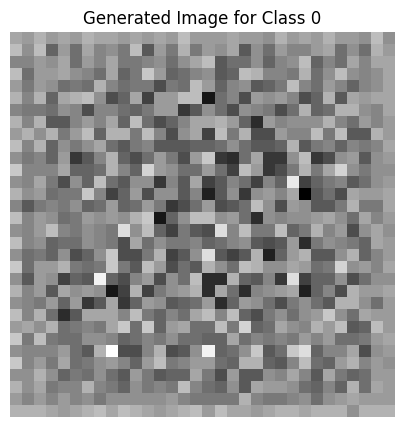

Epoch [1/2500], D_loss: 9.085683822631836, G_loss: -0.5435106754302979


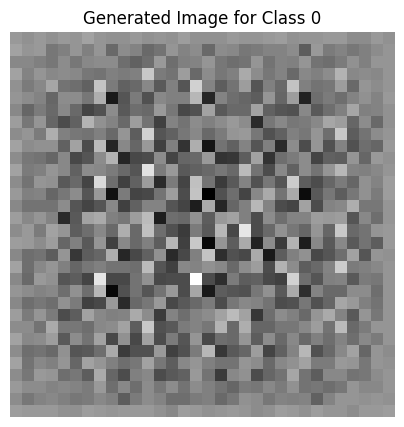

Epoch [2/2500], D_loss: 8.144623756408691, G_loss: -0.526544988155365


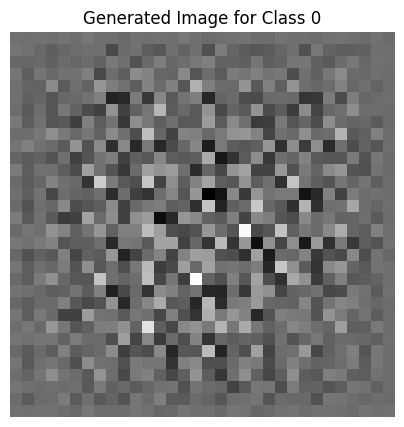

Epoch [3/2500], D_loss: 7.243350505828857, G_loss: -0.6087391376495361


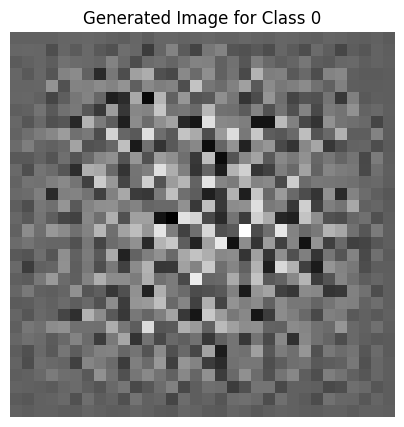

Epoch [4/2500], D_loss: 8.494412422180176, G_loss: -0.8778120279312134


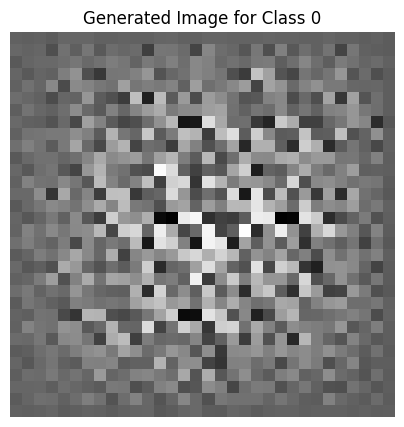

Epoch [5/2500], D_loss: 9.19996166229248, G_loss: -0.9682580232620239


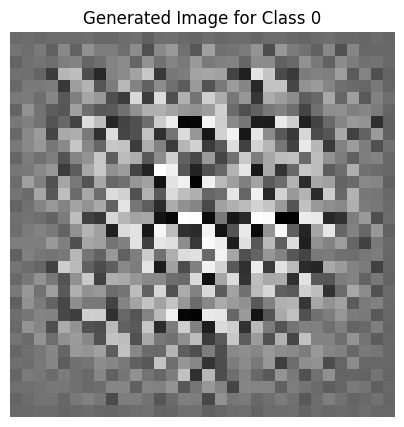

Epoch [6/2500], D_loss: 9.34420394897461, G_loss: -0.937532365322113


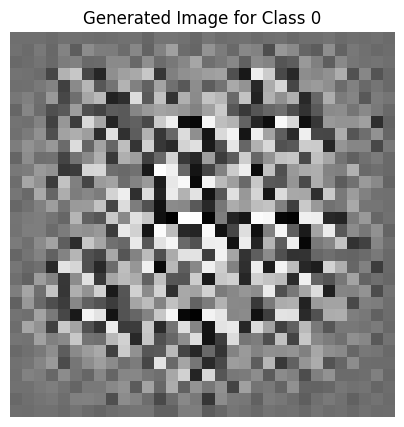

Epoch [7/2500], D_loss: 9.2495698928833, G_loss: -0.8768845796585083


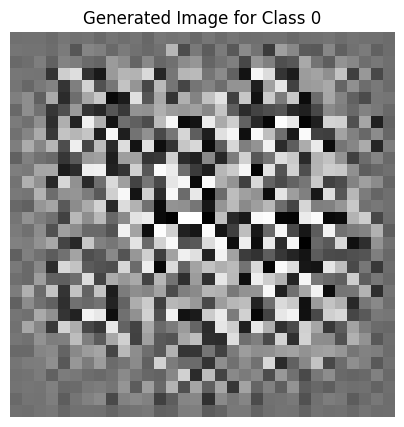

Epoch [8/2500], D_loss: 8.695807456970215, G_loss: -0.7358259558677673


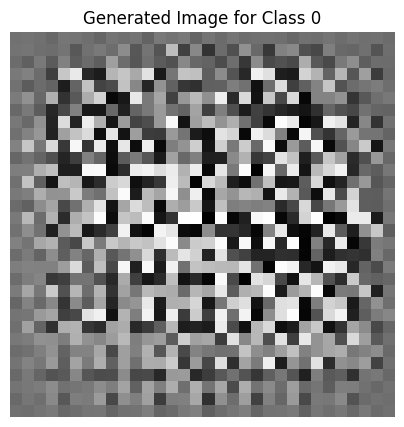

Epoch [9/2500], D_loss: 8.24365234375, G_loss: -0.6374406814575195


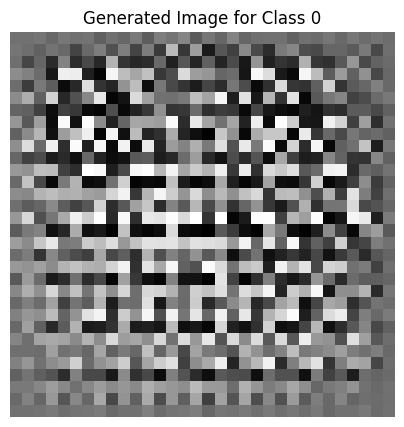

Epoch [10/2500], D_loss: 8.445040702819824, G_loss: -0.6846996545791626


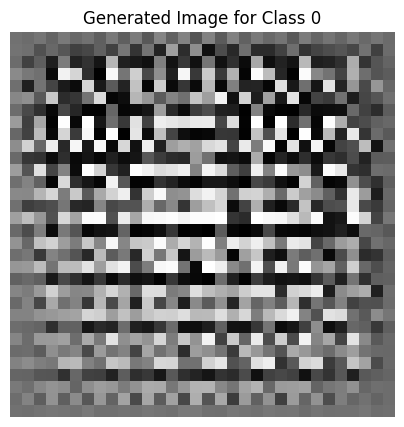

Epoch [11/2500], D_loss: 8.275040626525879, G_loss: -0.6762673854827881


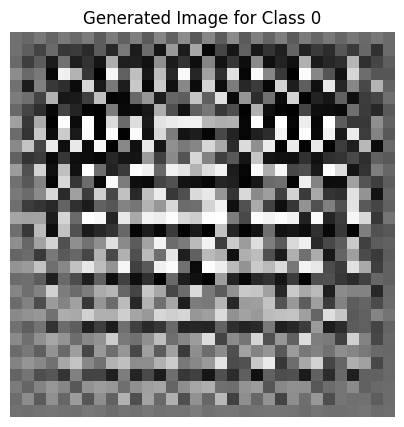

Epoch [12/2500], D_loss: 7.476912498474121, G_loss: -0.4923338294029236


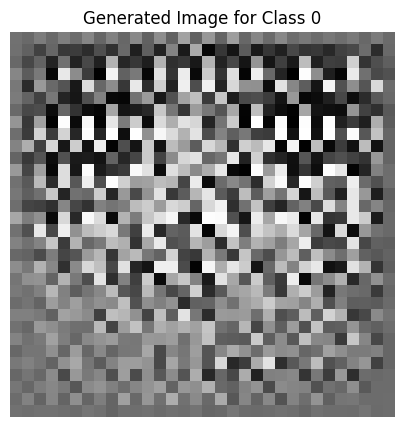

Epoch [13/2500], D_loss: 7.136401176452637, G_loss: -0.4488084316253662


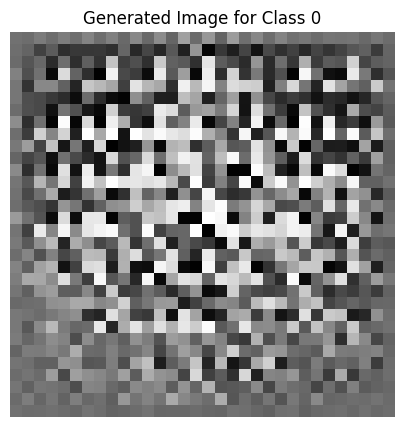

Epoch [14/2500], D_loss: 6.768387317657471, G_loss: -0.37700292468070984


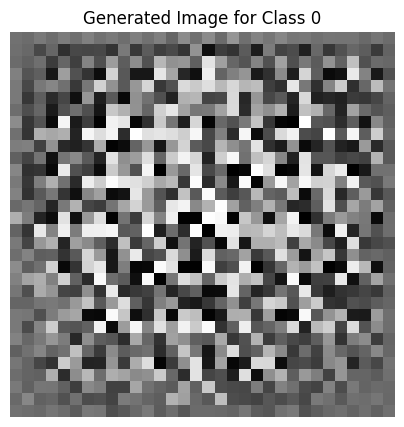

Epoch [15/2500], D_loss: 6.620014667510986, G_loss: -0.3629542589187622


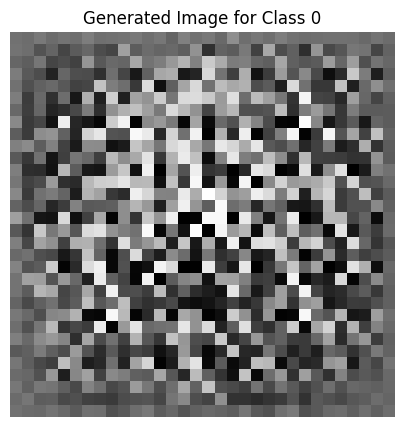

Epoch [16/2500], D_loss: 6.605967998504639, G_loss: -0.3831956386566162


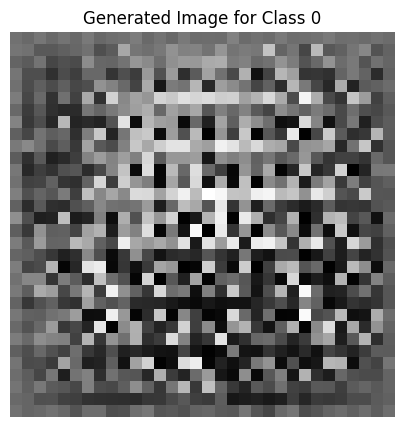

Epoch [17/2500], D_loss: 6.726572036743164, G_loss: -0.40509510040283203


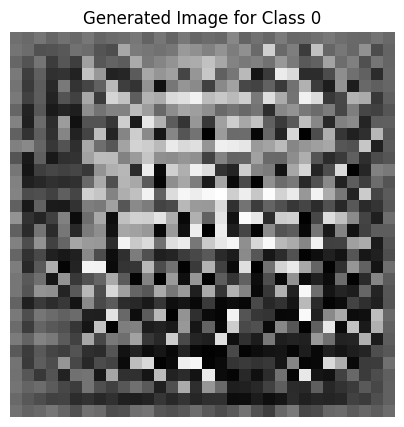

Epoch [18/2500], D_loss: 6.929748058319092, G_loss: -0.40804561972618103


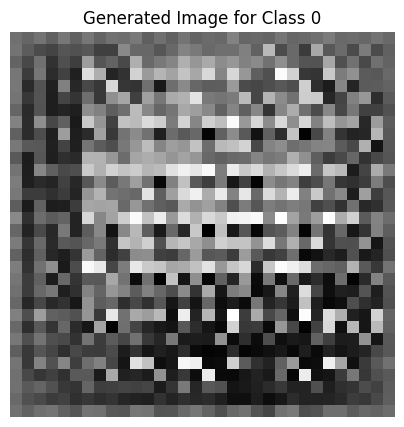

Epoch [19/2500], D_loss: 7.399641036987305, G_loss: -0.4550168216228485


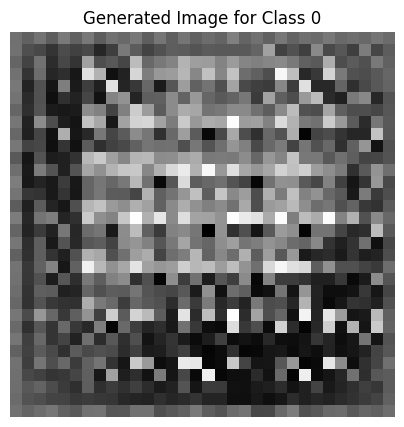

Epoch [20/2500], D_loss: 7.006510257720947, G_loss: -0.43045276403427124


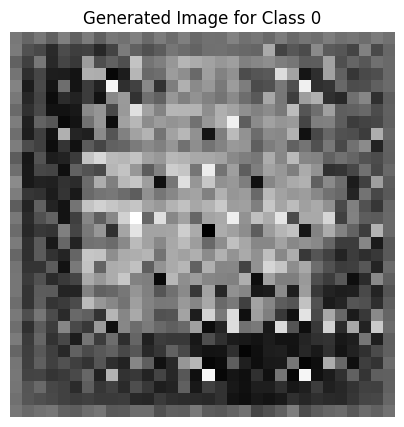

Epoch [21/2500], D_loss: 6.277751445770264, G_loss: -0.4445329010486603


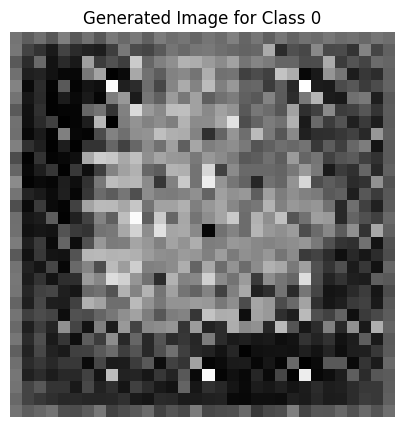

Epoch [22/2500], D_loss: 6.368844509124756, G_loss: -0.5111531019210815


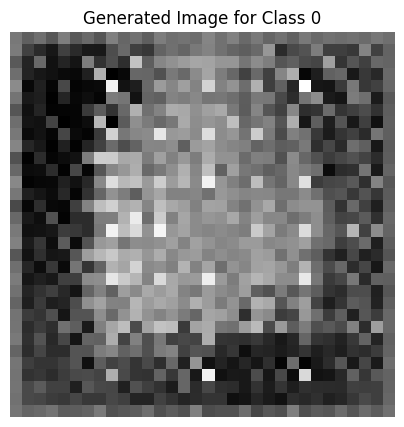

Epoch [23/2500], D_loss: 7.064821243286133, G_loss: -0.6552698016166687


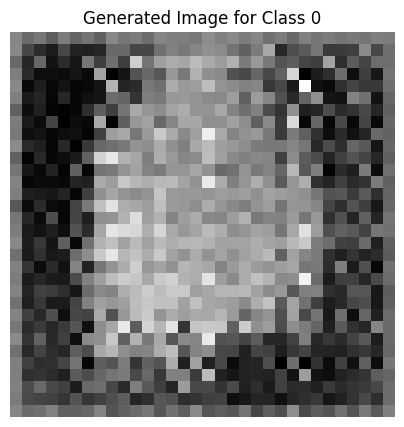

Epoch [24/2500], D_loss: 6.763538360595703, G_loss: -0.7203783988952637


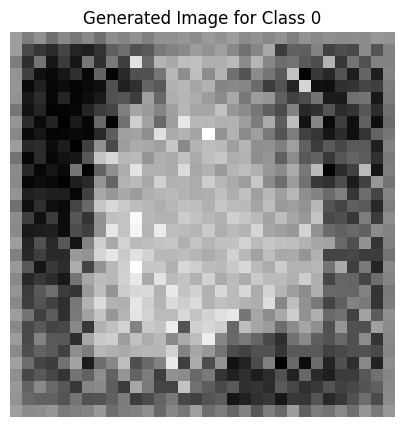

Epoch [25/2500], D_loss: 6.3248748779296875, G_loss: -0.7753509879112244


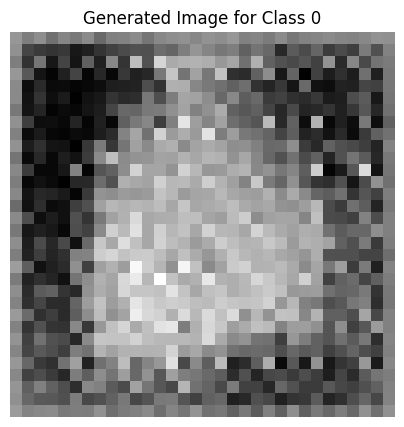

Epoch [26/2500], D_loss: 5.831486701965332, G_loss: -0.7494274973869324


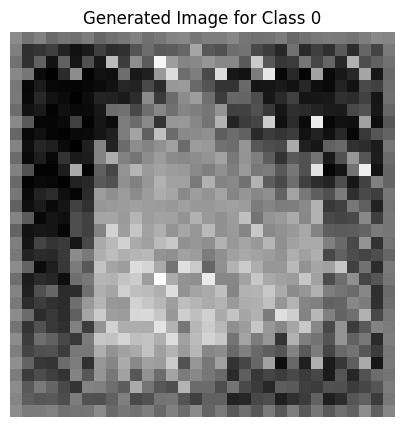

Epoch [27/2500], D_loss: 5.800868988037109, G_loss: -0.793621301651001


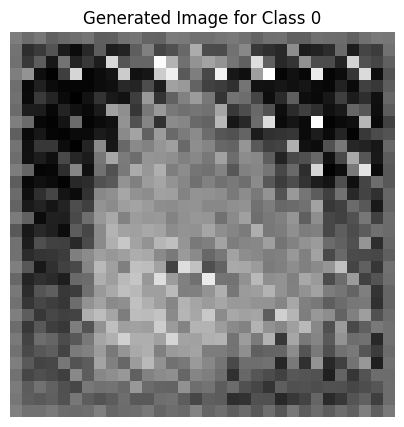

Epoch [28/2500], D_loss: 5.492897987365723, G_loss: -0.7456116676330566


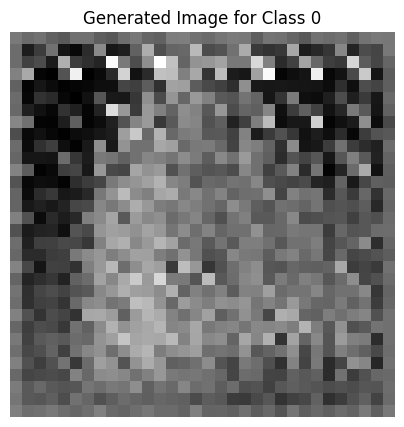

Epoch [29/2500], D_loss: 4.982029438018799, G_loss: -0.4790700674057007


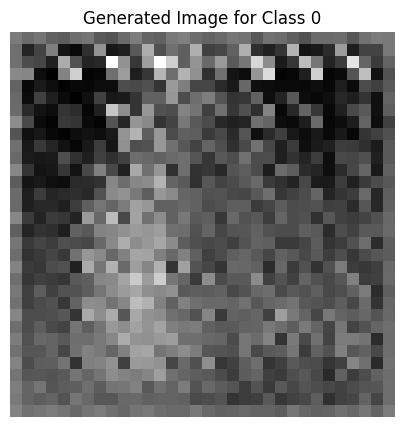

Epoch [30/2500], D_loss: 5.024319171905518, G_loss: -0.5145847797393799


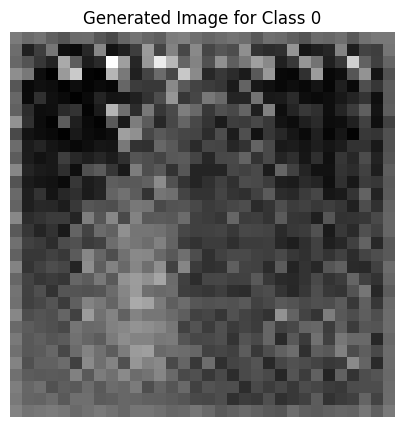

Epoch [31/2500], D_loss: 5.110017776489258, G_loss: -0.5937685370445251


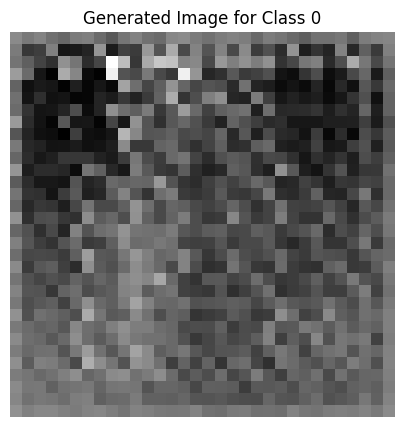

Epoch [32/2500], D_loss: 4.937698841094971, G_loss: -0.5179468393325806


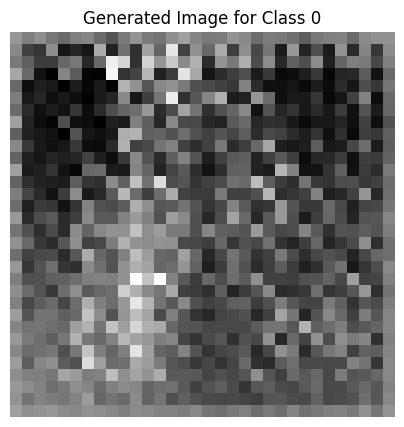

Epoch [33/2500], D_loss: 4.8607635498046875, G_loss: -0.5251320004463196


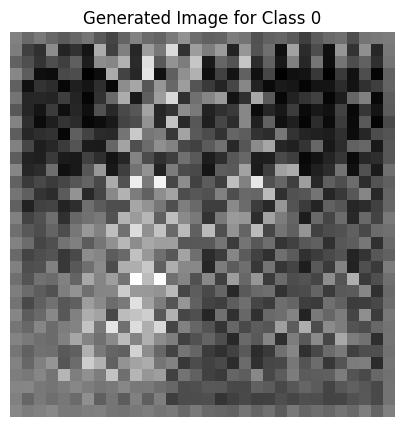

Epoch [34/2500], D_loss: 5.373705863952637, G_loss: -0.4485347270965576


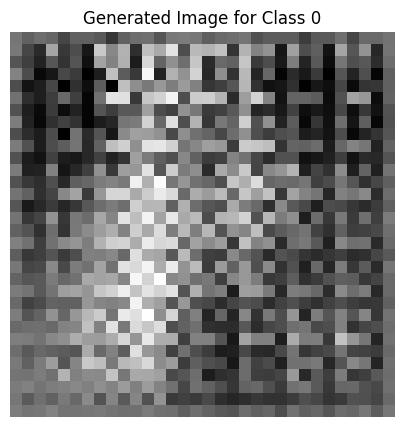

Epoch [35/2500], D_loss: 5.176025390625, G_loss: -0.41474848985671997


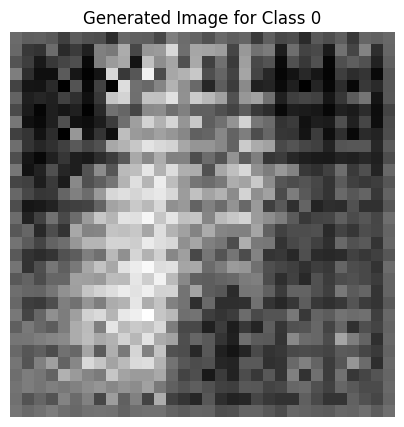

Epoch [36/2500], D_loss: 3.722377061843872, G_loss: -0.40505796670913696


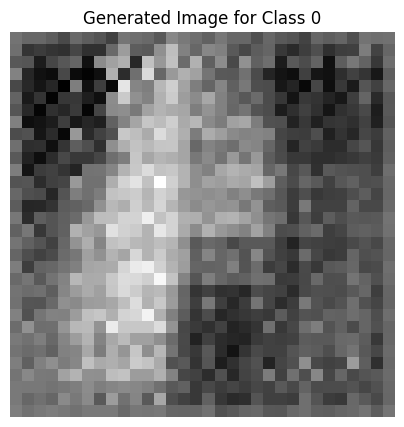

Epoch [37/2500], D_loss: 4.100234508514404, G_loss: -0.5995358228683472


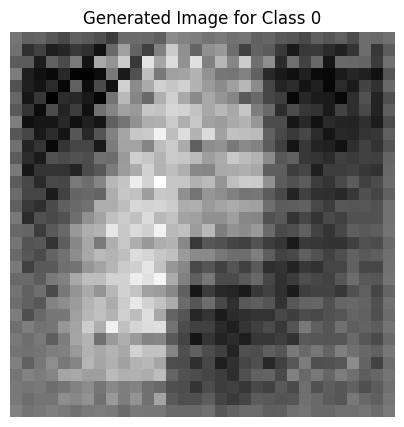

Epoch [38/2500], D_loss: 4.5887064933776855, G_loss: -0.7127209901809692


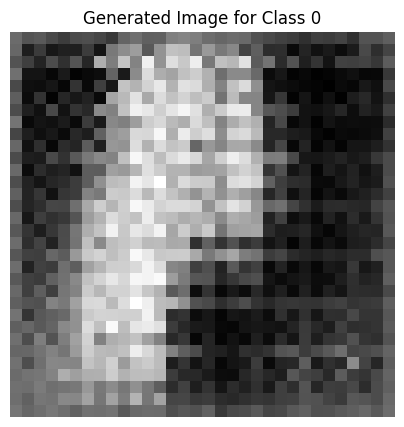

Epoch [39/2500], D_loss: 3.3838951587677, G_loss: -0.6013139486312866


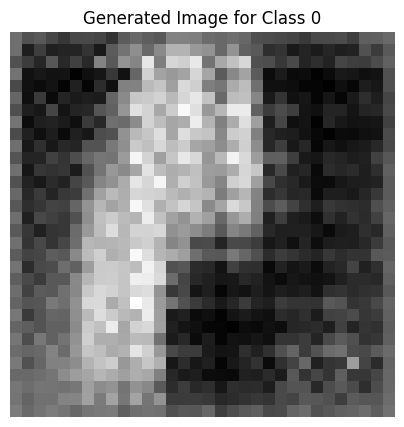

Epoch [40/2500], D_loss: 2.3910067081451416, G_loss: -0.5328472852706909


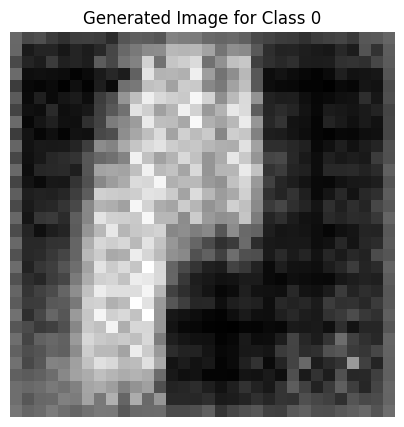

Epoch [41/2500], D_loss: 2.2772181034088135, G_loss: -0.5191352963447571


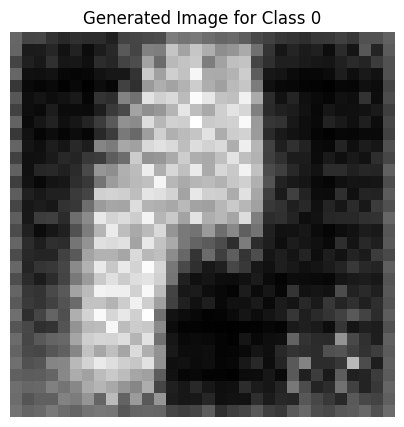

Epoch [42/2500], D_loss: 2.6246907711029053, G_loss: -0.5101256370544434


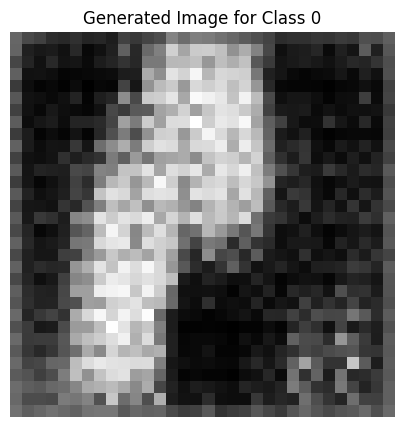

Epoch [43/2500], D_loss: 2.7394280433654785, G_loss: -0.58650803565979


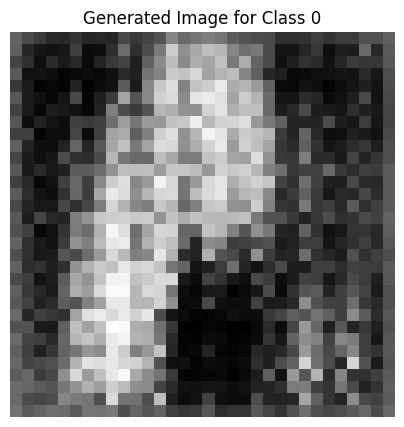

Epoch [44/2500], D_loss: 2.906978130340576, G_loss: -0.5512045621871948


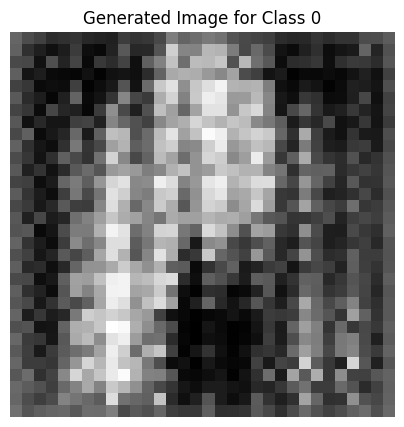

Epoch [45/2500], D_loss: 2.734713315963745, G_loss: -0.42010173201560974


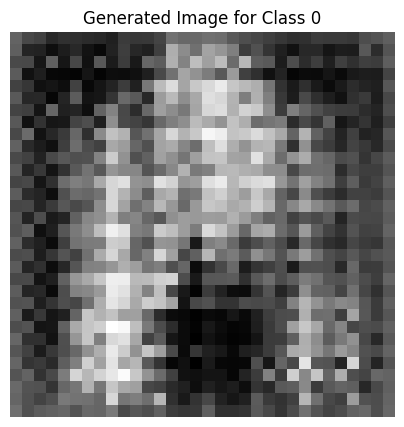

Epoch [46/2500], D_loss: 2.5179338455200195, G_loss: -0.3396342992782593


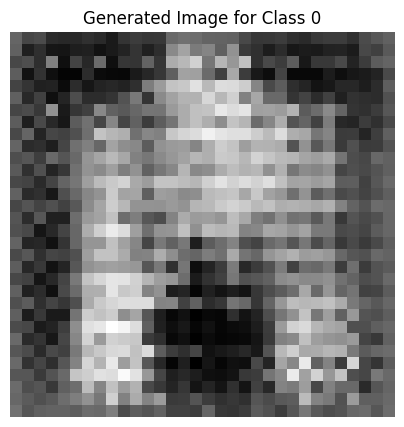

Epoch [47/2500], D_loss: 2.1318907737731934, G_loss: -0.3762137293815613


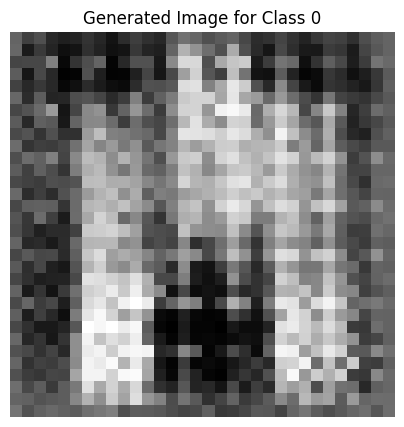

Epoch [48/2500], D_loss: 2.826866865158081, G_loss: -0.7418137788772583


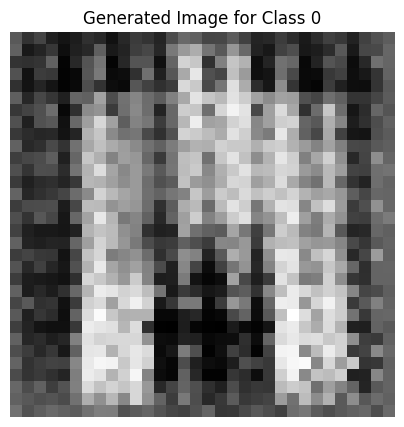

Epoch [49/2500], D_loss: 2.302750825881958, G_loss: -0.5846061110496521


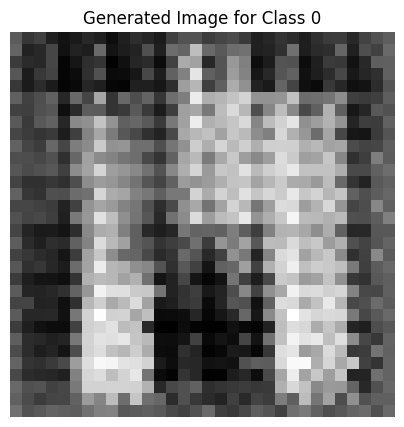

Epoch [50/2500], D_loss: 2.030339241027832, G_loss: -0.4132779836654663


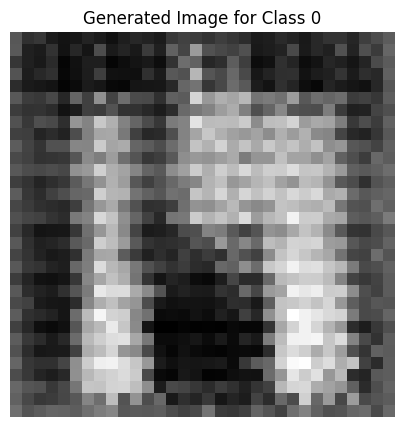

Epoch [51/2500], D_loss: 1.7155911922454834, G_loss: -0.49742770195007324


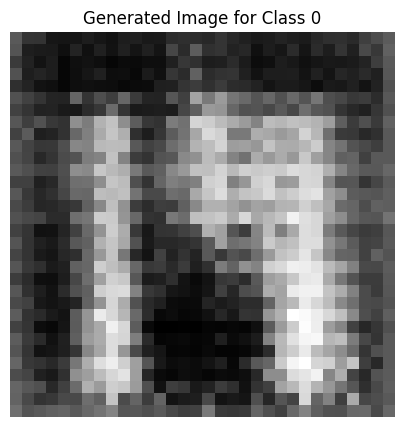

Epoch [52/2500], D_loss: 2.013568878173828, G_loss: -0.5725557804107666


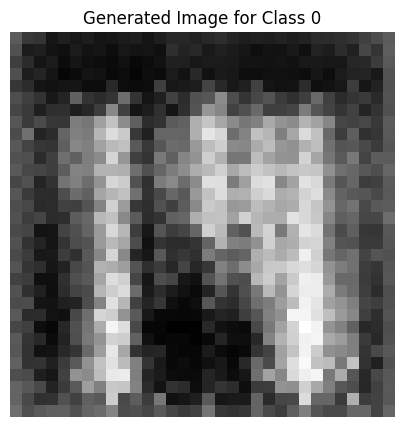

Epoch [53/2500], D_loss: 2.266284942626953, G_loss: -0.626285195350647


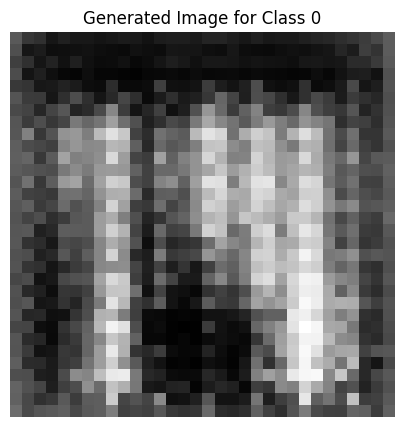

Epoch [54/2500], D_loss: 2.0752274990081787, G_loss: -0.5230733156204224


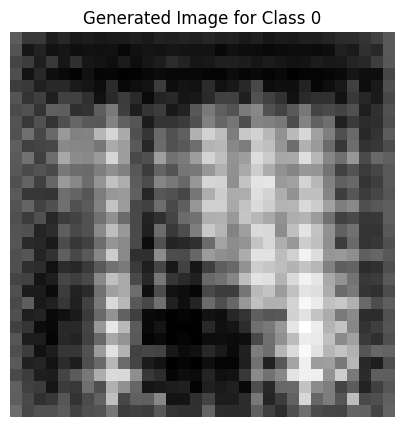

Epoch [55/2500], D_loss: 1.6735835075378418, G_loss: -0.44415703415870667


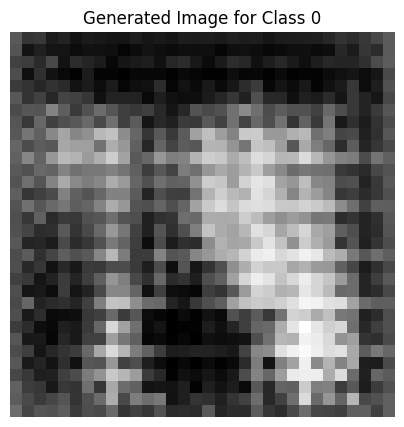

Epoch [56/2500], D_loss: 2.0164031982421875, G_loss: -0.5581165552139282


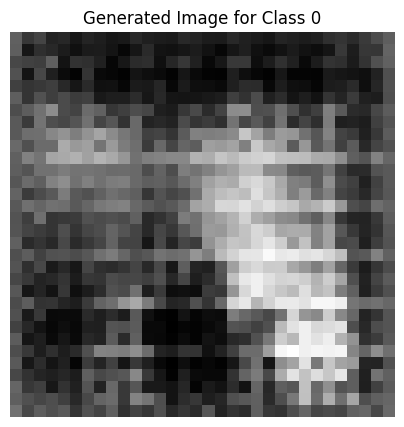

Epoch [57/2500], D_loss: 1.8849087953567505, G_loss: -0.5278866291046143


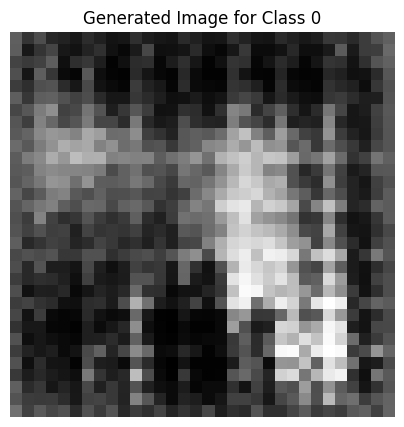

Epoch [58/2500], D_loss: 1.9787338972091675, G_loss: -0.600504994392395


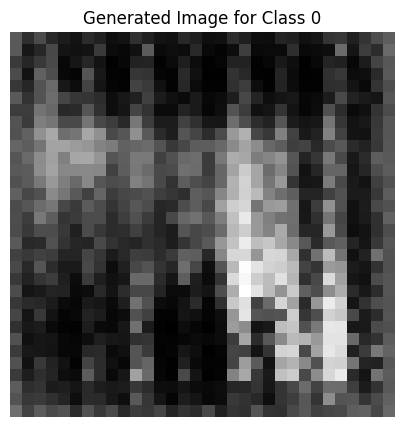

Epoch [59/2500], D_loss: 2.310962677001953, G_loss: -0.7206109166145325


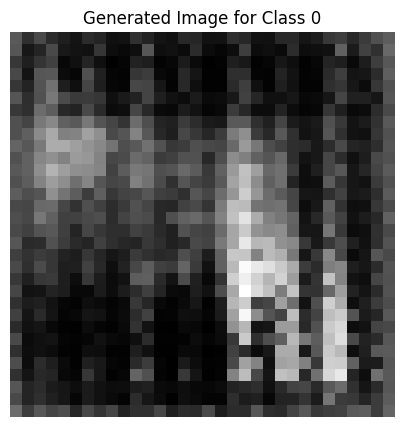

Epoch [60/2500], D_loss: 2.3018229007720947, G_loss: -0.6045323610305786


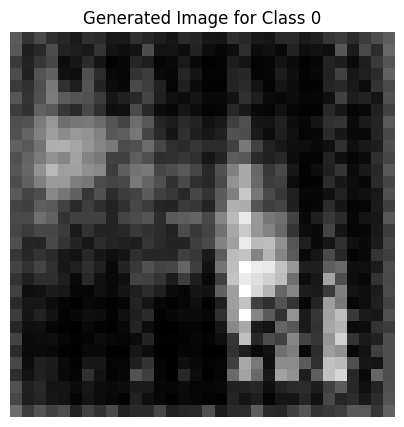

Epoch [61/2500], D_loss: 2.493363380432129, G_loss: -0.5591036677360535


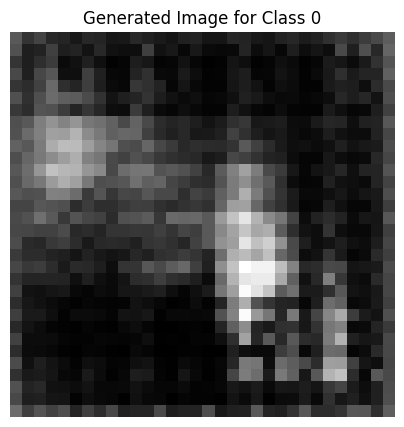

Epoch [62/2500], D_loss: 2.3461318016052246, G_loss: -0.6472724676132202


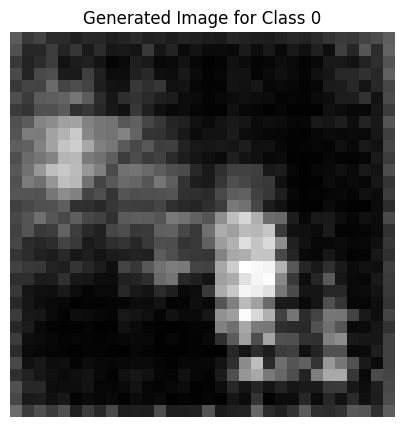

Epoch [63/2500], D_loss: 2.263249635696411, G_loss: -0.6261098980903625


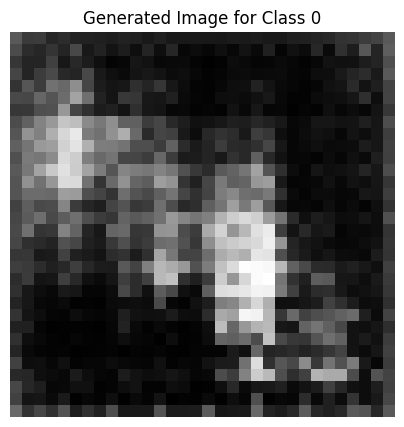

Epoch [64/2500], D_loss: 2.2826926708221436, G_loss: -0.5606967210769653


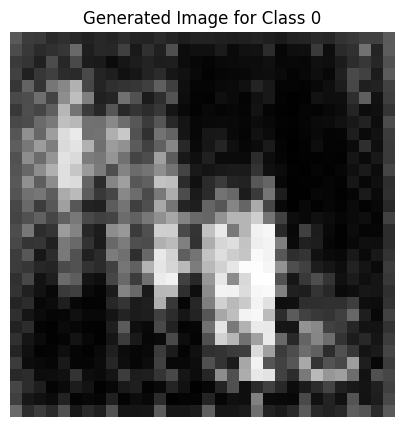

Epoch [65/2500], D_loss: 2.376502275466919, G_loss: -0.6198409795761108


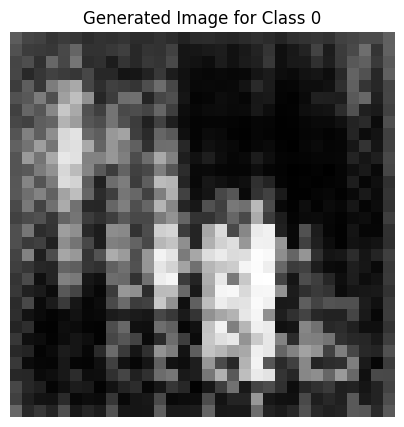

Epoch [66/2500], D_loss: 2.344444513320923, G_loss: -0.5401162505149841


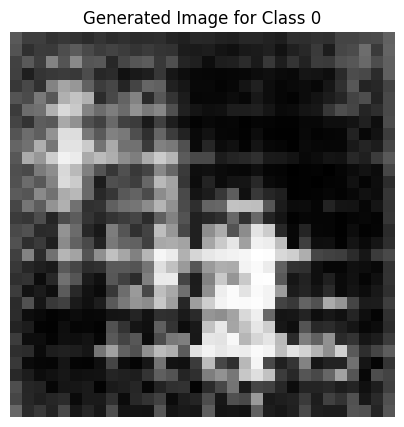

Epoch [67/2500], D_loss: 2.1402242183685303, G_loss: -0.4783688485622406


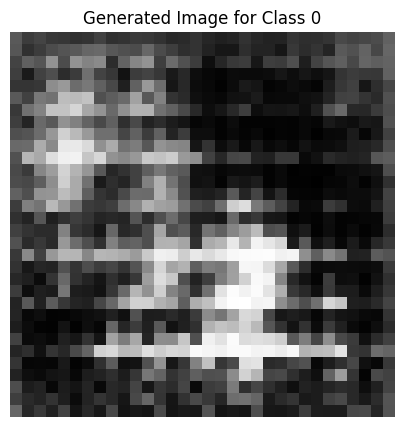

Epoch [68/2500], D_loss: 1.9341230392456055, G_loss: -0.44350916147232056


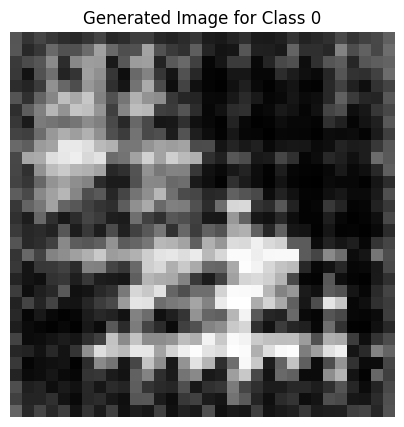

Epoch [69/2500], D_loss: 1.9708410501480103, G_loss: -0.44901296496391296


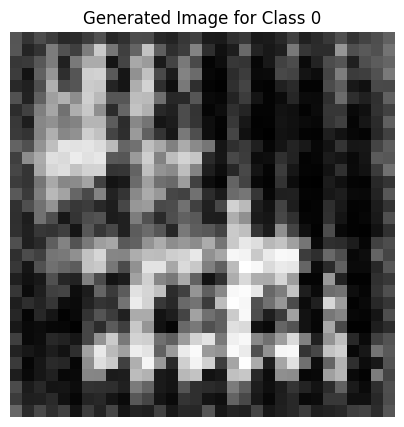

Epoch [70/2500], D_loss: 2.3283801078796387, G_loss: -0.4725559949874878


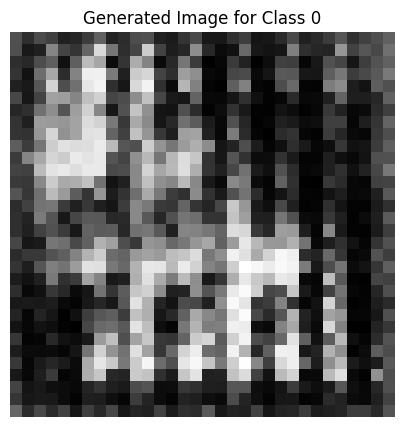

Epoch [71/2500], D_loss: 1.618196725845337, G_loss: -0.48353514075279236


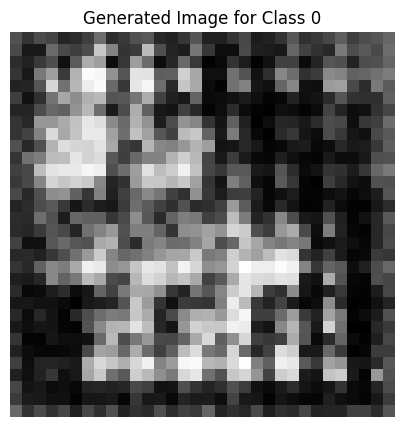

Epoch [72/2500], D_loss: 1.8106415271759033, G_loss: -0.5047634840011597


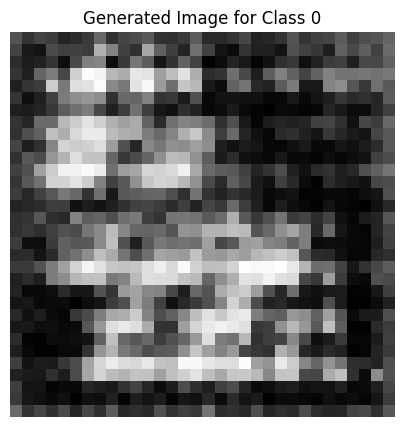

Epoch [73/2500], D_loss: 1.5791015625, G_loss: -0.5488647818565369


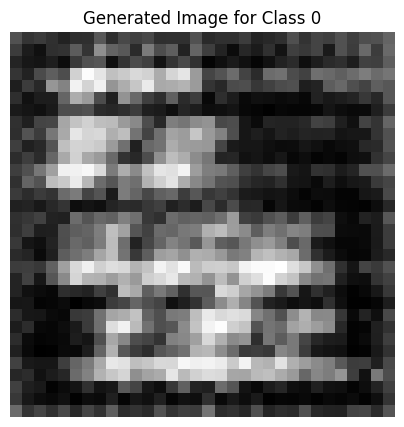

Epoch [74/2500], D_loss: 1.6360907554626465, G_loss: -0.5266262292861938


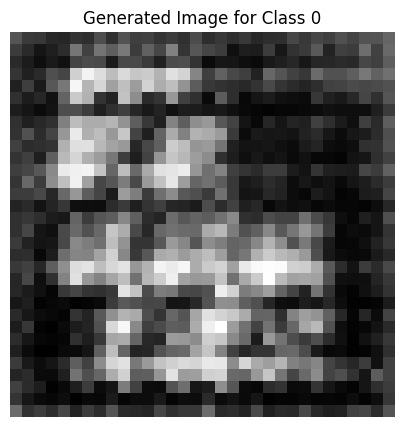

Epoch [75/2500], D_loss: 1.888843059539795, G_loss: -0.42832687497138977


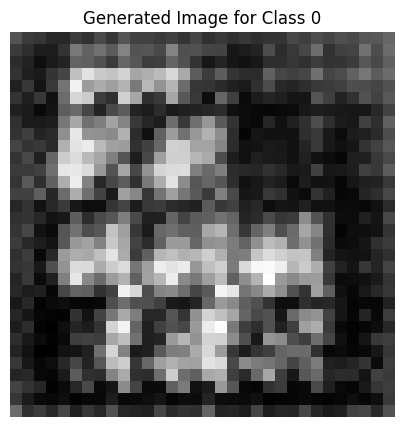

Epoch [76/2500], D_loss: 1.4317786693572998, G_loss: -0.429962694644928


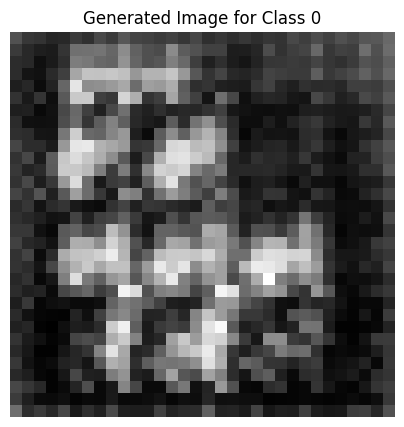

Epoch [77/2500], D_loss: 2.031561851501465, G_loss: -0.46831321716308594


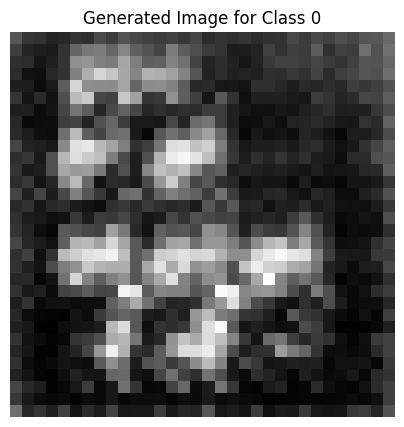

Epoch [78/2500], D_loss: 1.9176961183547974, G_loss: -0.5429050922393799


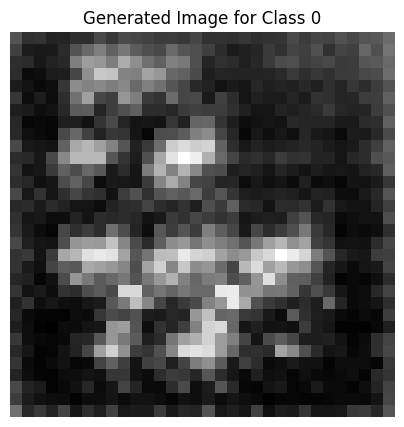

Epoch [79/2500], D_loss: 1.997385025024414, G_loss: -0.6663384437561035


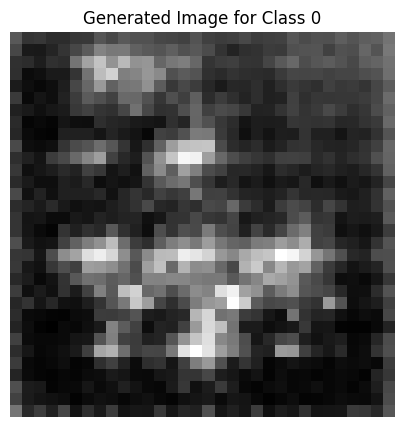

Epoch [80/2500], D_loss: 1.6774861812591553, G_loss: -0.5884636640548706


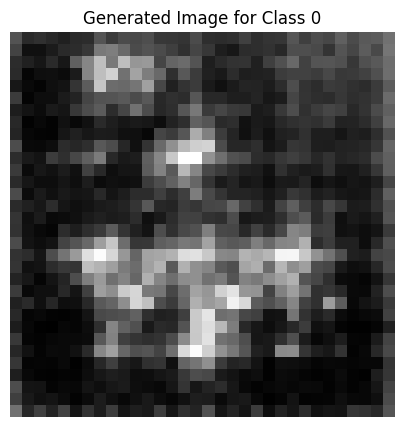

Epoch [81/2500], D_loss: 2.023135185241699, G_loss: -0.641564130783081


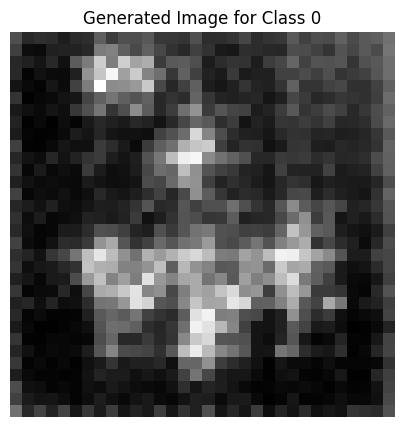

Epoch [82/2500], D_loss: 2.098332405090332, G_loss: -0.6145488023757935


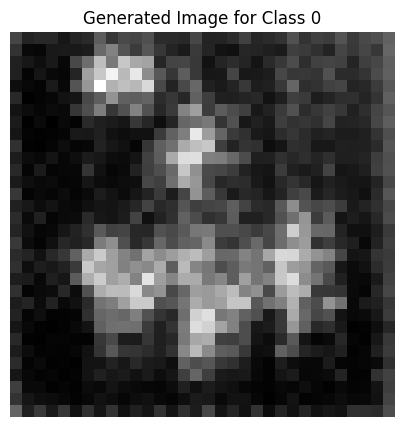

Epoch [83/2500], D_loss: 2.0420150756835938, G_loss: -0.6865234375


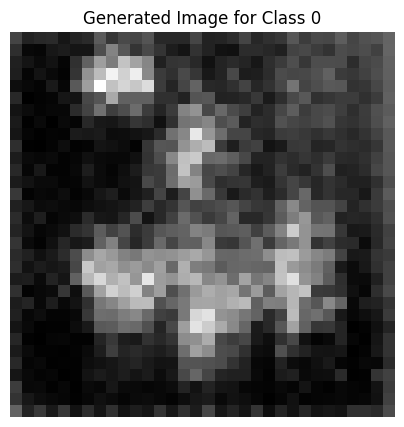

Epoch [84/2500], D_loss: 1.872572422027588, G_loss: -0.6501757502555847


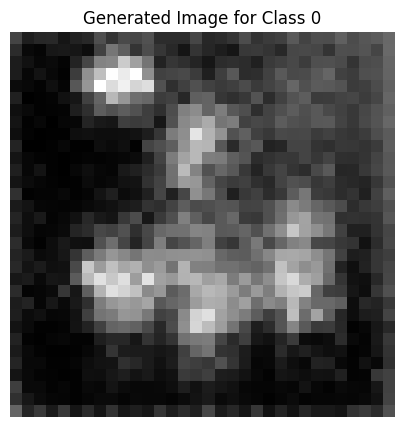

Epoch [85/2500], D_loss: 1.578840970993042, G_loss: -0.5843844413757324


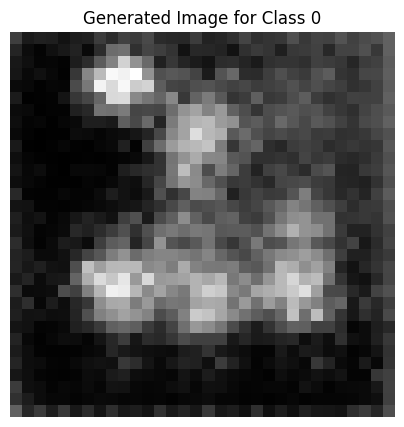

Epoch [86/2500], D_loss: 1.4245777130126953, G_loss: -0.6585851907730103


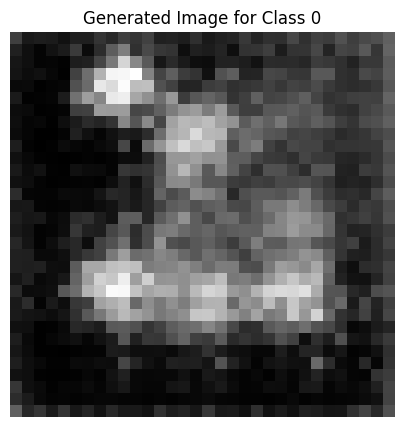

Epoch [87/2500], D_loss: 1.766768455505371, G_loss: -0.7019081115722656


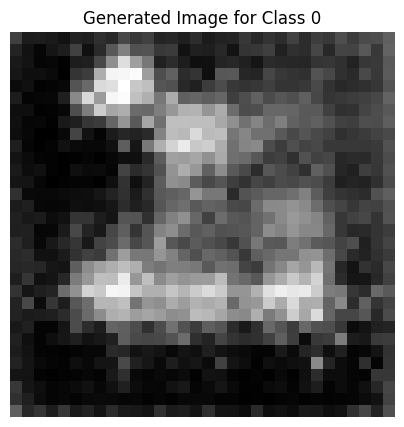

Epoch [88/2500], D_loss: 1.7469112873077393, G_loss: -0.6996205449104309


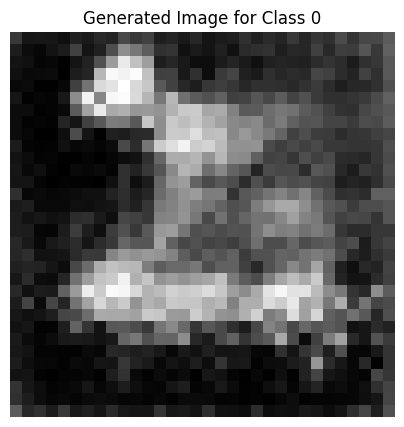

Epoch [89/2500], D_loss: 1.8155364990234375, G_loss: -0.6706833839416504


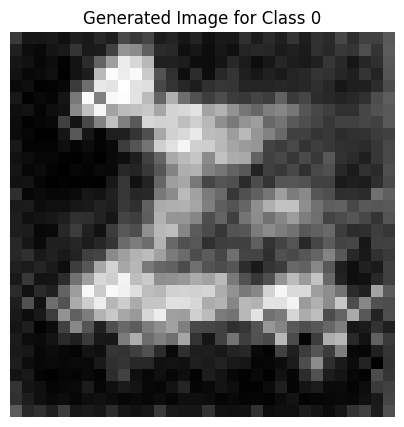

Epoch [90/2500], D_loss: 1.5437613725662231, G_loss: -0.6218677759170532


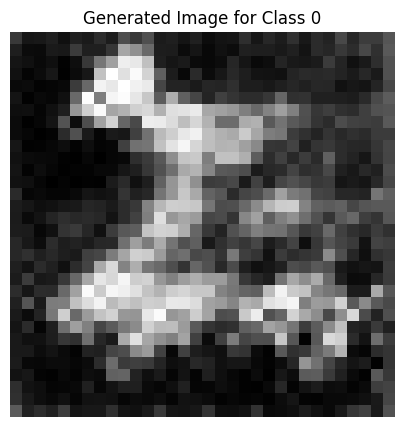

Epoch [91/2500], D_loss: 1.770555019378662, G_loss: -0.6520360708236694


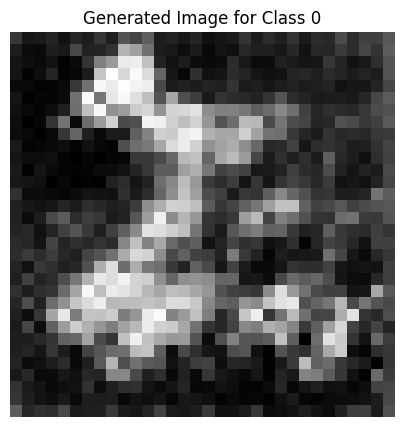

Epoch [92/2500], D_loss: 1.338505506515503, G_loss: -0.6127886772155762


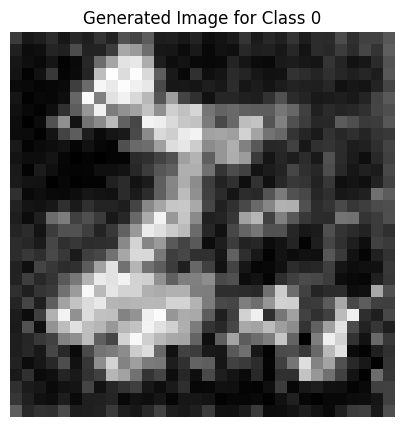

Epoch [93/2500], D_loss: 1.6911616325378418, G_loss: -0.576890230178833


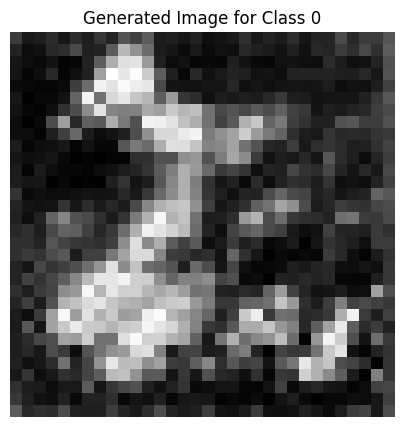

Epoch [94/2500], D_loss: 0.9127165079116821, G_loss: -0.5694706439971924


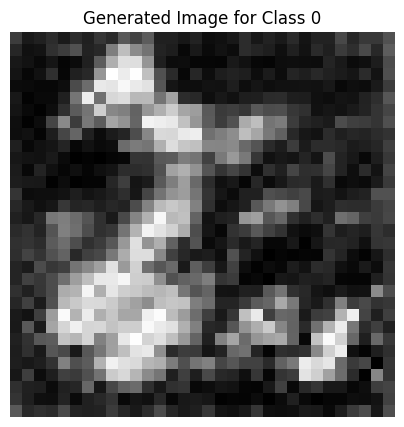

Epoch [95/2500], D_loss: 1.4852852821350098, G_loss: -0.6336622834205627


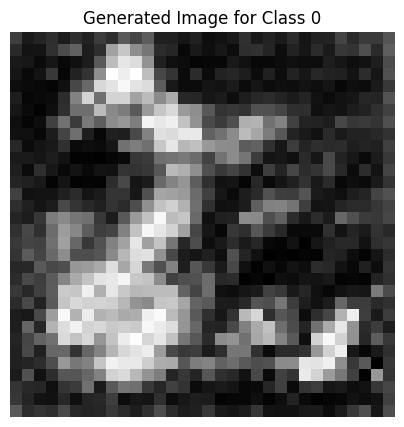

Epoch [96/2500], D_loss: 1.4714508056640625, G_loss: -0.6100136041641235


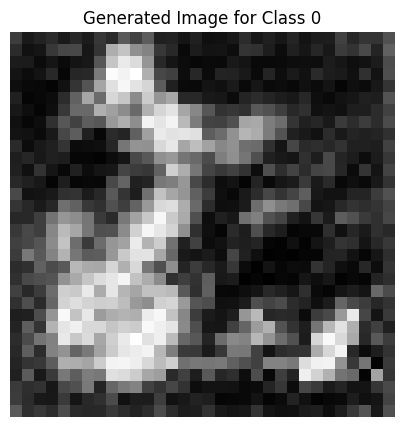

Epoch [97/2500], D_loss: 1.3703457117080688, G_loss: -0.588311493396759


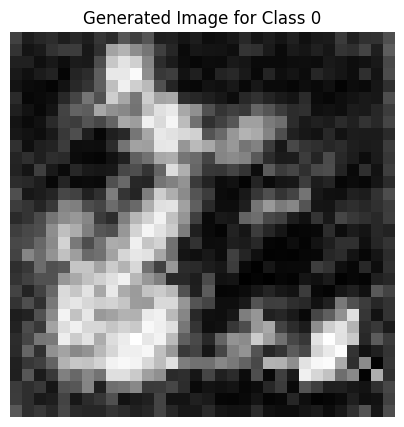

Epoch [98/2500], D_loss: 1.4625859260559082, G_loss: -0.5568889379501343


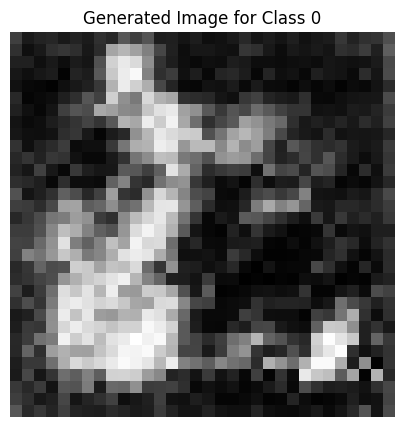

Epoch [99/2500], D_loss: 1.1210718154907227, G_loss: -0.5610461235046387


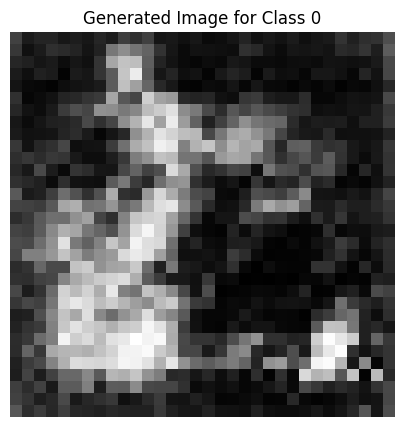

Epoch [100/2500], D_loss: 1.470043420791626, G_loss: -0.5065610408782959


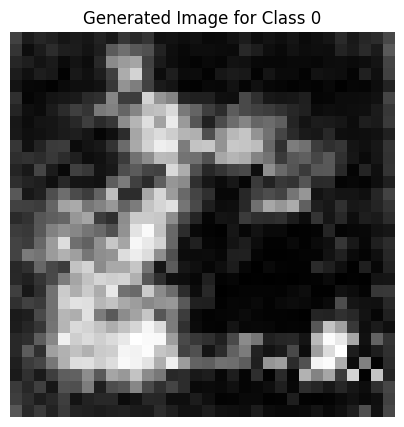

Epoch [101/2500], D_loss: 1.0539402961730957, G_loss: -0.6065767407417297


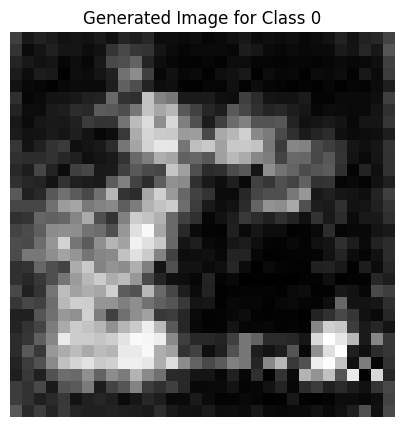

Epoch [102/2500], D_loss: 1.2566081285476685, G_loss: -0.4825698733329773


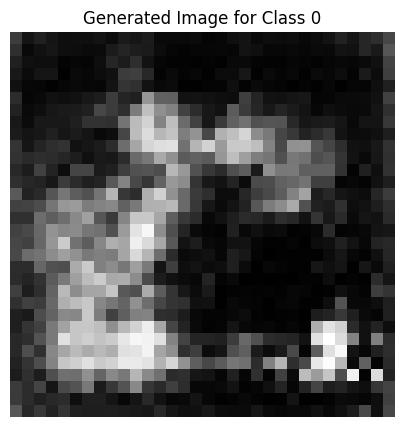

Epoch [103/2500], D_loss: 1.1106476783752441, G_loss: -0.6397939920425415


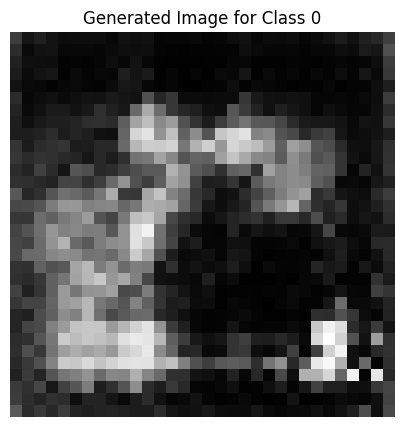

Epoch [104/2500], D_loss: 1.3028395175933838, G_loss: -0.552139163017273


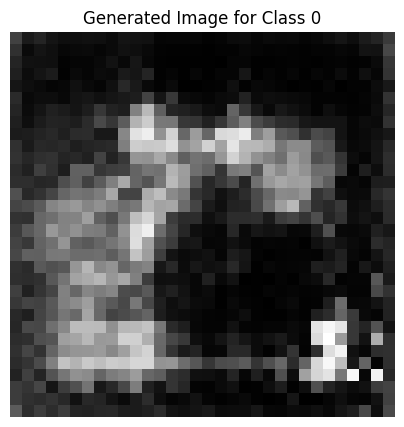

Epoch [105/2500], D_loss: 1.1879384517669678, G_loss: -0.49980953335762024


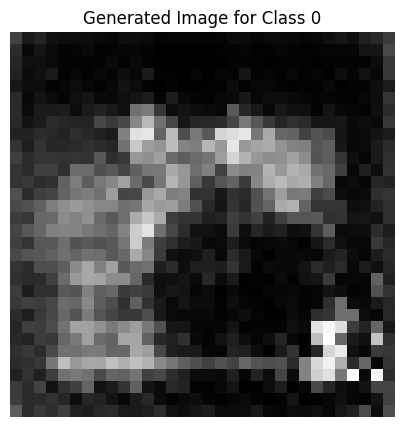

Epoch [106/2500], D_loss: 1.583432912826538, G_loss: -0.5560651421546936


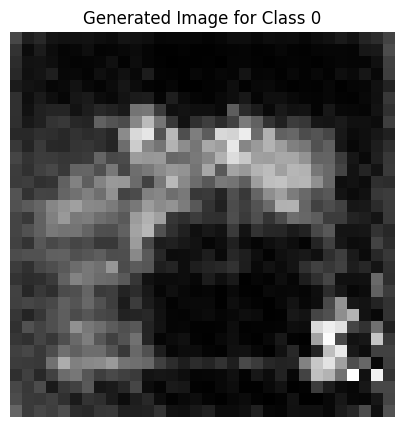

Epoch [107/2500], D_loss: 1.3054087162017822, G_loss: -0.6979644894599915


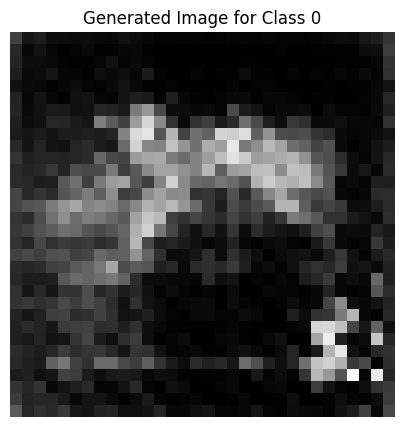

Epoch [108/2500], D_loss: 1.5405583381652832, G_loss: -0.7036823034286499


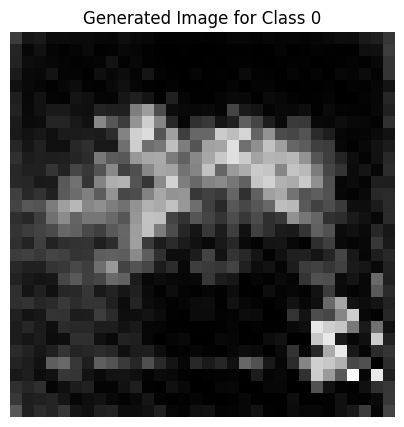

Epoch [109/2500], D_loss: 1.2752842903137207, G_loss: -0.681658923625946


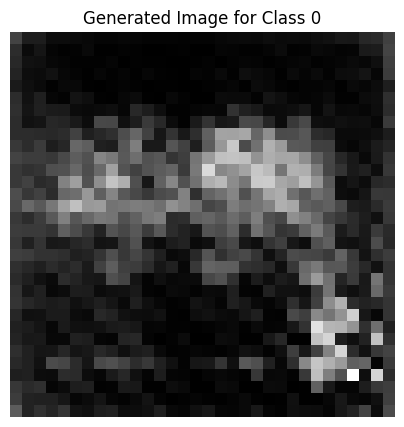

Epoch [110/2500], D_loss: 1.4731497764587402, G_loss: -0.703685998916626


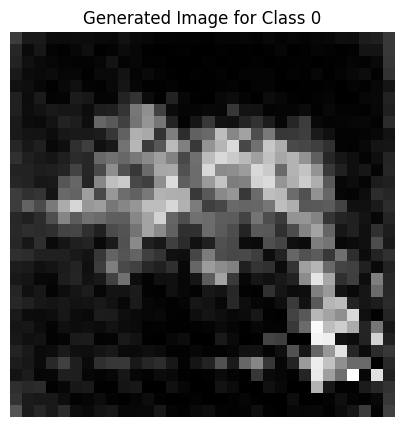

Epoch [111/2500], D_loss: 1.8203027248382568, G_loss: -0.6890106797218323


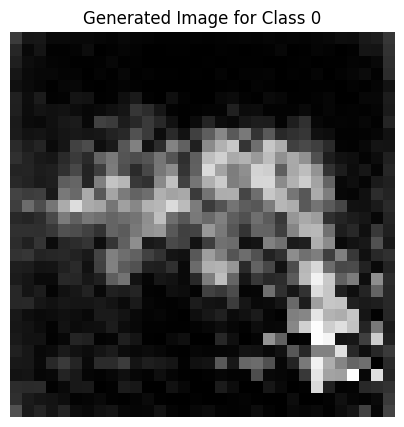

Epoch [112/2500], D_loss: 1.3135504722595215, G_loss: -0.6491119861602783


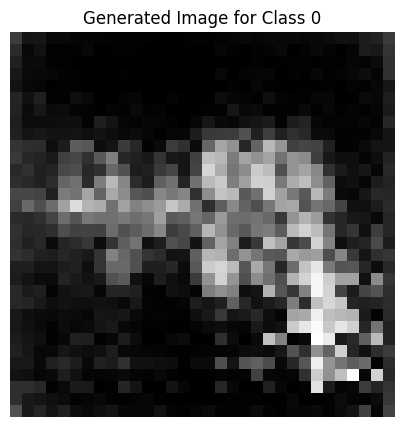

Epoch [113/2500], D_loss: 1.8619158267974854, G_loss: -0.6624594330787659


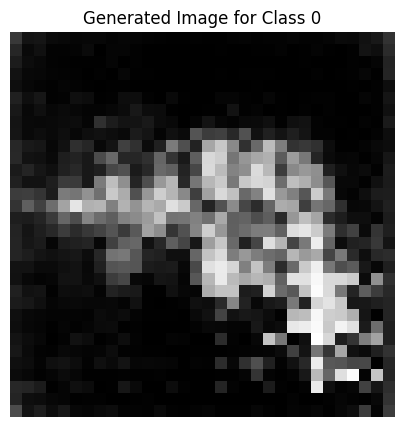

Epoch [114/2500], D_loss: 1.4901108741760254, G_loss: -0.7113876342773438


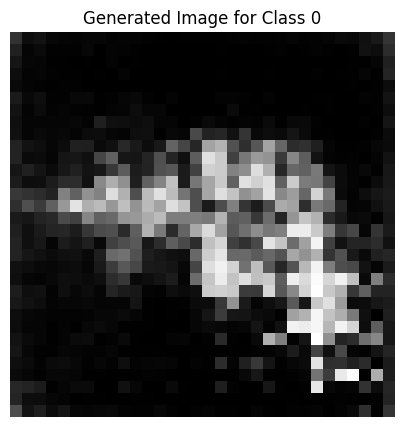

Epoch [115/2500], D_loss: 1.6835453510284424, G_loss: -0.6603444814682007


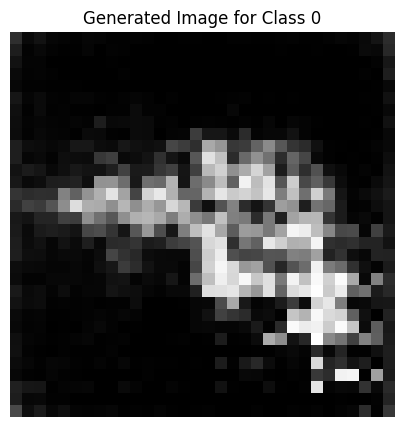

Epoch [116/2500], D_loss: 1.6189098358154297, G_loss: -0.6517676115036011


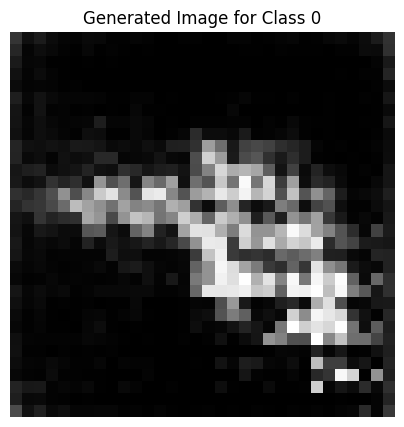

Epoch [117/2500], D_loss: 1.5510375499725342, G_loss: -0.6499283313751221


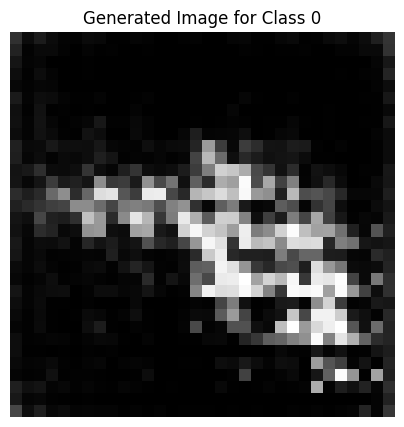

Epoch [118/2500], D_loss: 1.5741053819656372, G_loss: -0.721761167049408


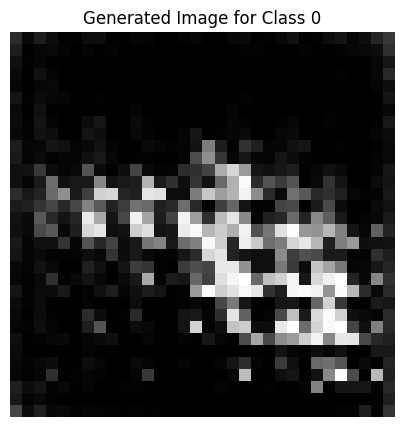

Epoch [119/2500], D_loss: 1.346329927444458, G_loss: -0.666603147983551


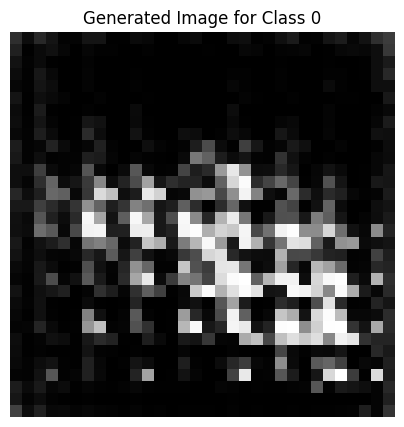

Epoch [120/2500], D_loss: 1.1366995573043823, G_loss: -0.6232472658157349


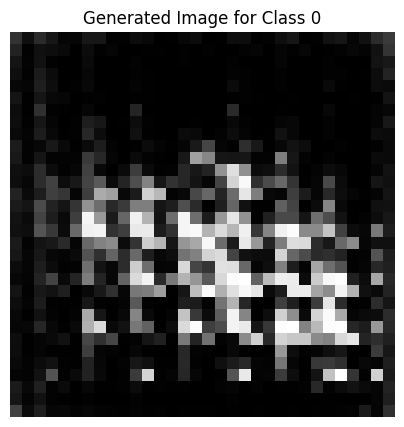

Epoch [121/2500], D_loss: 1.0320899486541748, G_loss: -0.6257750391960144


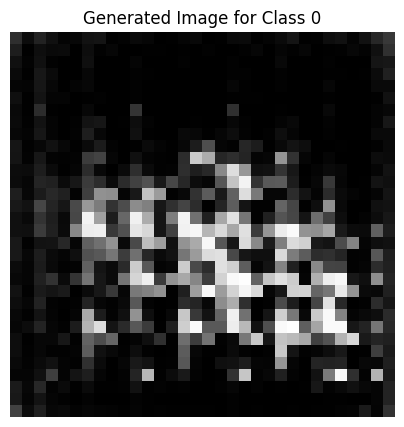

Epoch [122/2500], D_loss: 1.1343164443969727, G_loss: -0.3116365075111389


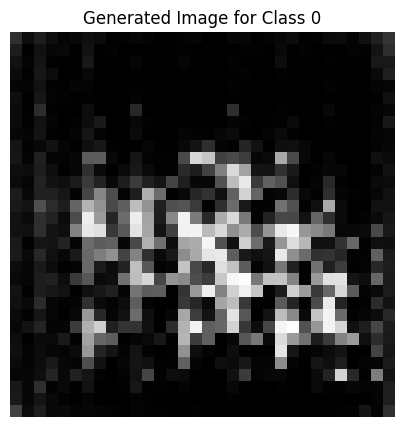

Epoch [123/2500], D_loss: 0.9680503010749817, G_loss: -0.640529990196228


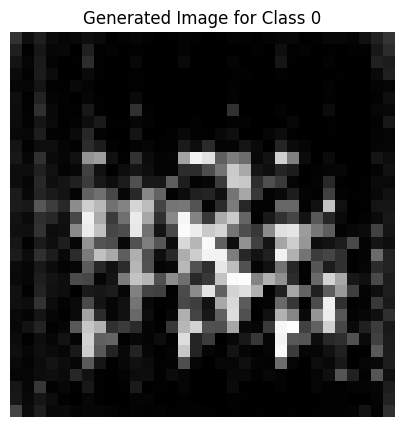

Epoch [124/2500], D_loss: 1.1000628471374512, G_loss: -0.5988205671310425


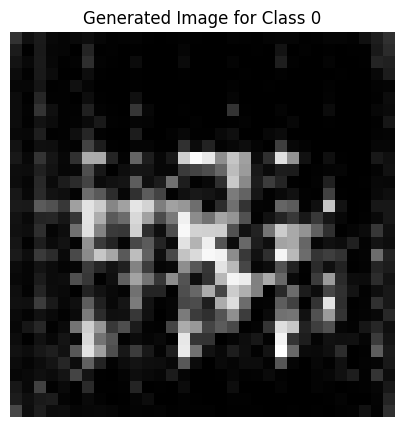

Epoch [125/2500], D_loss: 1.1895228624343872, G_loss: -0.5773108601570129


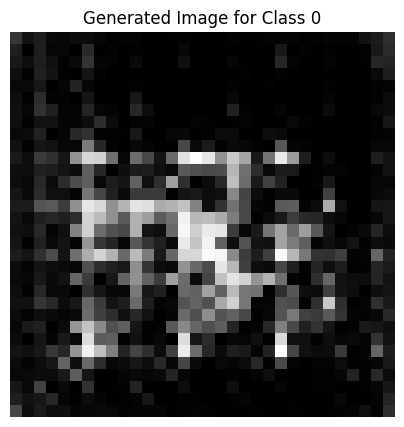

Epoch [126/2500], D_loss: 1.4495775699615479, G_loss: -0.6234340071678162


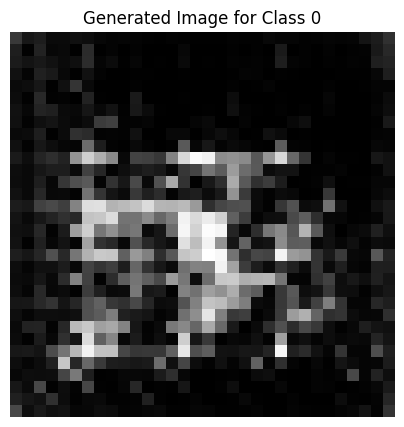

Epoch [127/2500], D_loss: 0.9276750683784485, G_loss: -0.625460684299469


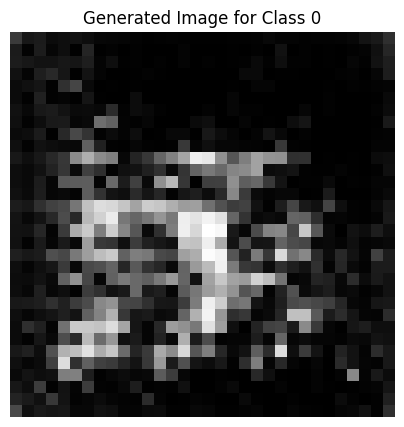

Epoch [128/2500], D_loss: 0.8083721399307251, G_loss: -0.478348970413208


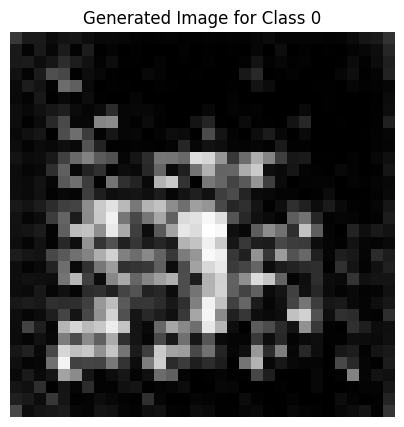

Epoch [129/2500], D_loss: 1.3492188453674316, G_loss: -0.5545357465744019


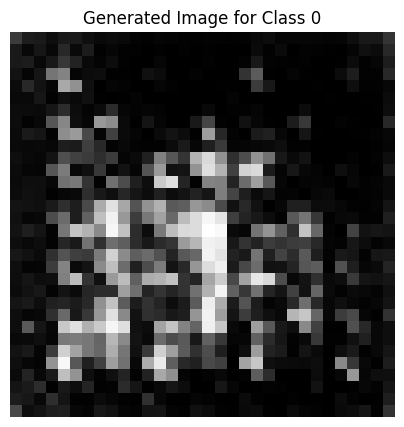

Epoch [130/2500], D_loss: 1.3950145244598389, G_loss: -0.47948601841926575


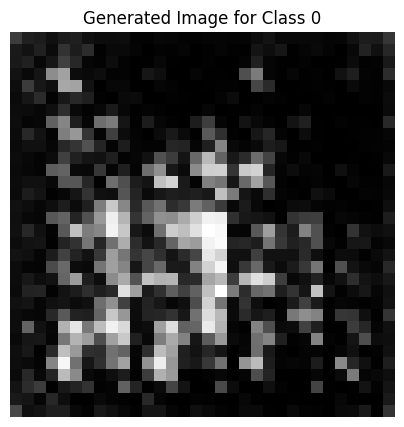

Epoch [131/2500], D_loss: 1.4442625045776367, G_loss: -0.5257855653762817


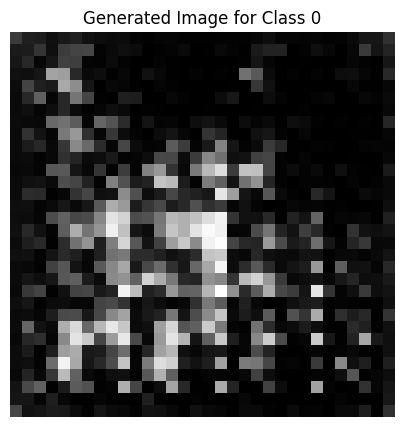

Epoch [132/2500], D_loss: 1.0462123155593872, G_loss: -0.6411833763122559


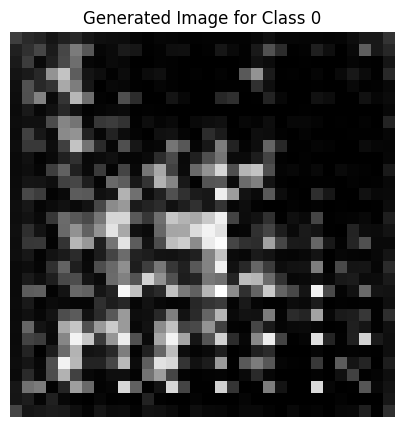

Epoch [133/2500], D_loss: 1.2496280670166016, G_loss: -0.5642138123512268


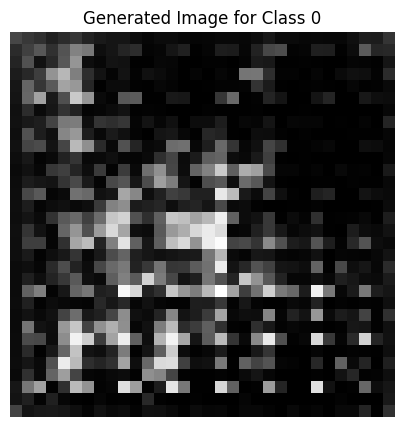

Epoch [134/2500], D_loss: 0.9502553939819336, G_loss: -0.38997986912727356


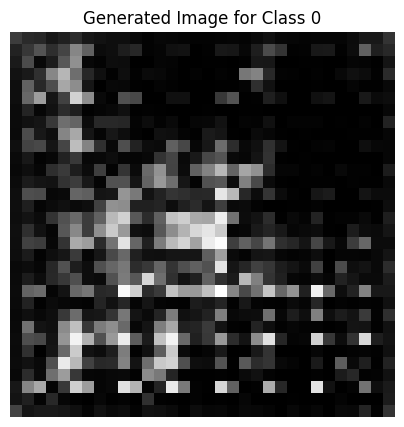

Epoch [135/2500], D_loss: 0.9249547719955444, G_loss: -0.5086867809295654


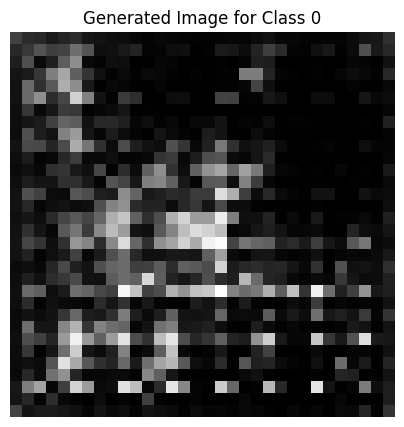

Epoch [136/2500], D_loss: 0.7937545776367188, G_loss: -0.3308359980583191


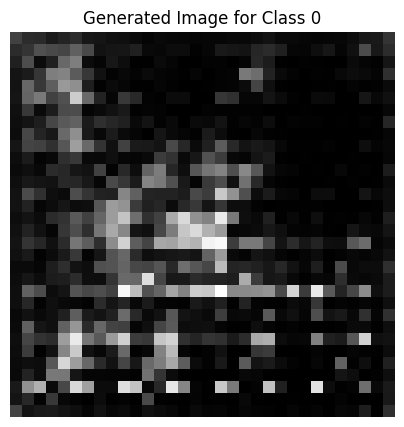

Epoch [137/2500], D_loss: 1.0356370210647583, G_loss: -0.37601688504219055


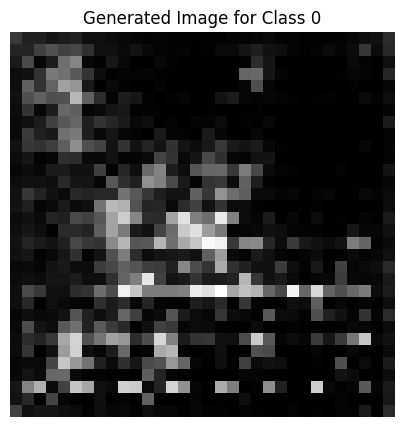

Epoch [138/2500], D_loss: 0.6006653308868408, G_loss: -0.41273385286331177


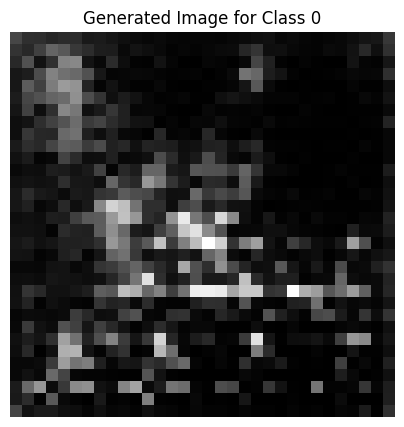

Epoch [139/2500], D_loss: 0.9624377489089966, G_loss: -0.449657142162323


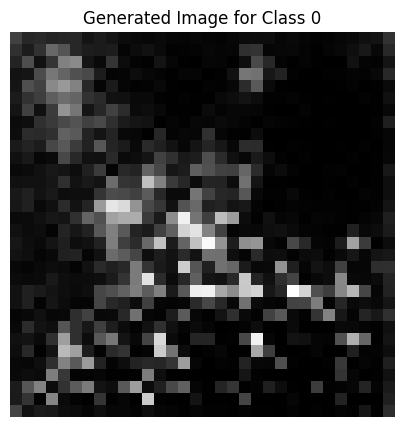

Epoch [140/2500], D_loss: 1.0612471103668213, G_loss: -0.617638111114502


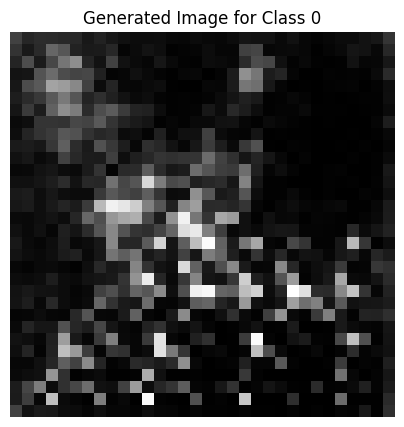

Epoch [141/2500], D_loss: 1.0843422412872314, G_loss: -0.5096885561943054


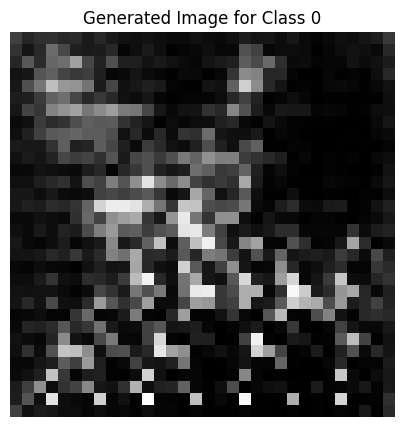

Epoch [142/2500], D_loss: 1.8866102695465088, G_loss: -0.5961904525756836


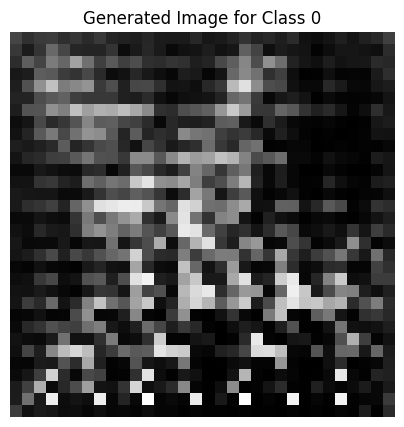

Epoch [143/2500], D_loss: 0.9824394583702087, G_loss: -0.5054951906204224


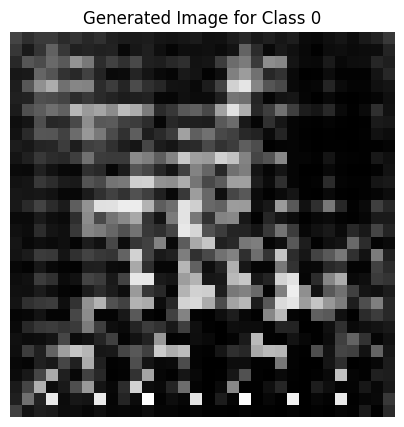

Epoch [144/2500], D_loss: 0.9148169159889221, G_loss: -0.440236896276474


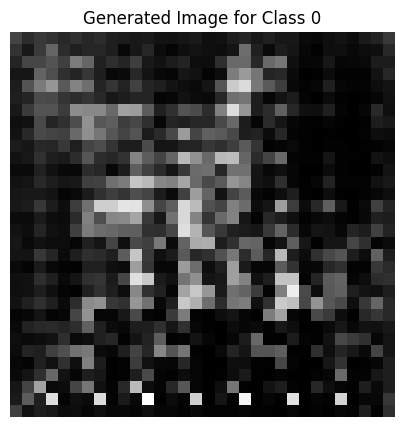

Epoch [145/2500], D_loss: 0.8580870628356934, G_loss: -0.563561201095581


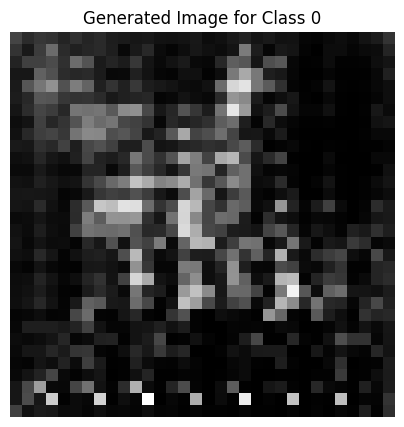

Epoch [146/2500], D_loss: 1.2302825450897217, G_loss: -0.4793846309185028


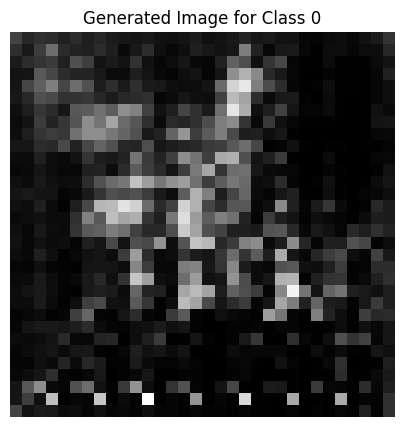

Epoch [147/2500], D_loss: 0.8229663968086243, G_loss: -0.3271774649620056


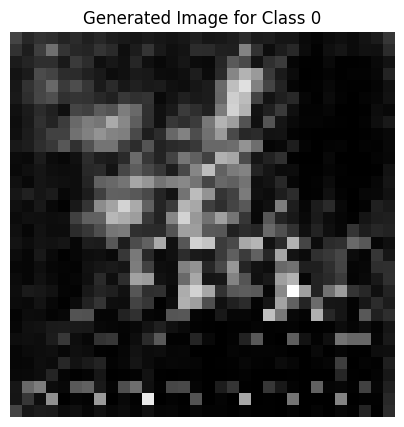

Epoch [148/2500], D_loss: 1.0460314750671387, G_loss: -0.5644134283065796


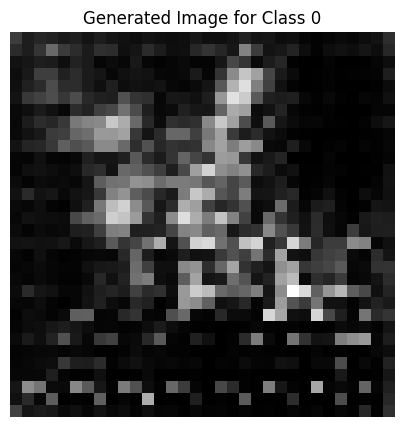

Epoch [149/2500], D_loss: 0.9795290231704712, G_loss: -0.599179208278656


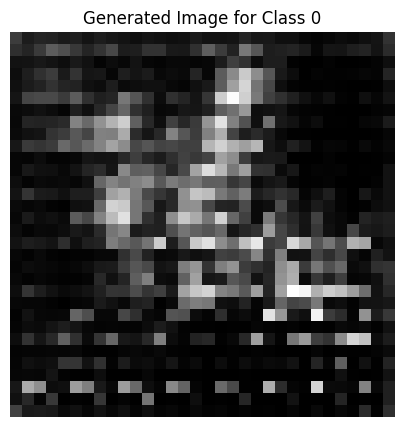

Epoch [150/2500], D_loss: 0.9809198379516602, G_loss: -0.5891867280006409


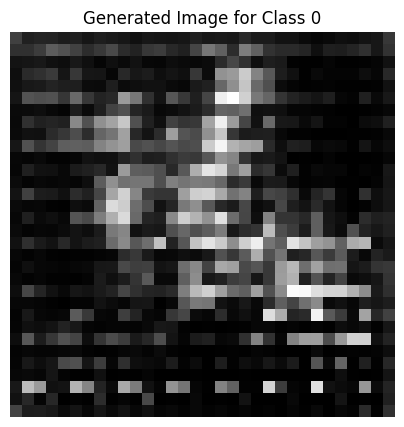

Epoch [151/2500], D_loss: 1.0726267099380493, G_loss: -0.6482821702957153


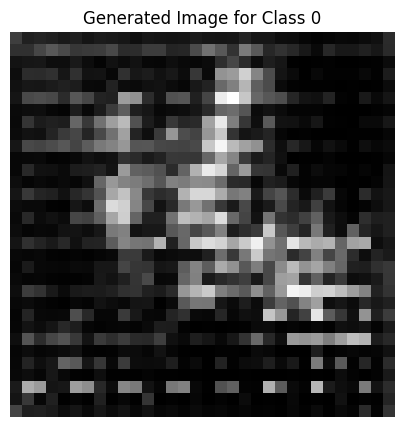

Epoch [152/2500], D_loss: 0.5972515940666199, G_loss: -0.4581461548805237


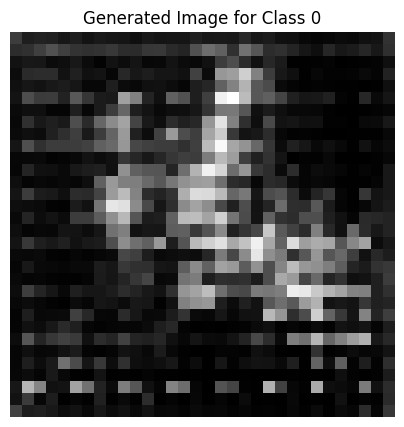

Epoch [153/2500], D_loss: 0.7993953227996826, G_loss: -0.5419596433639526


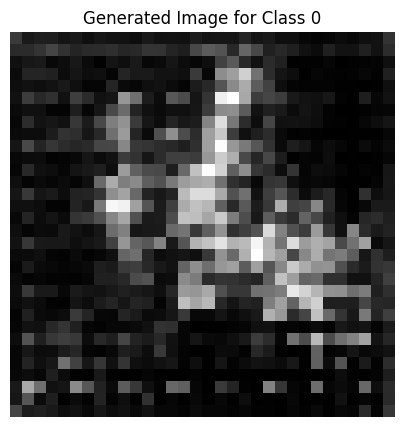

Epoch [154/2500], D_loss: 0.7142842411994934, G_loss: -0.5910429358482361


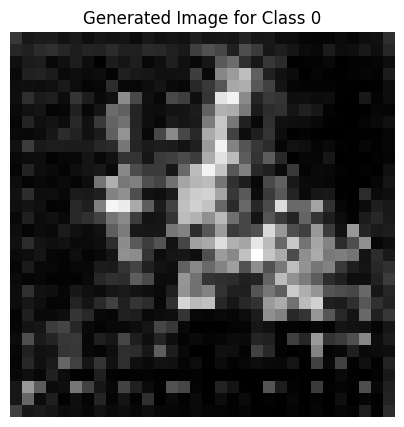

Epoch [155/2500], D_loss: 0.9833740592002869, G_loss: -0.6713804602622986


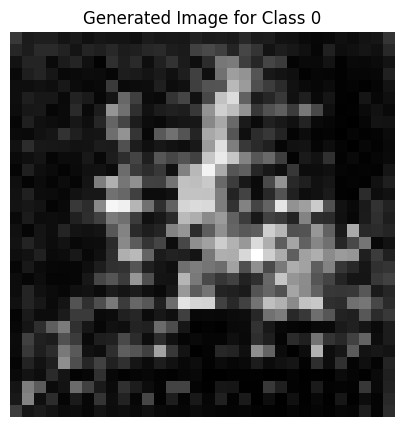

Epoch [156/2500], D_loss: 1.0254396200180054, G_loss: -0.6576818227767944


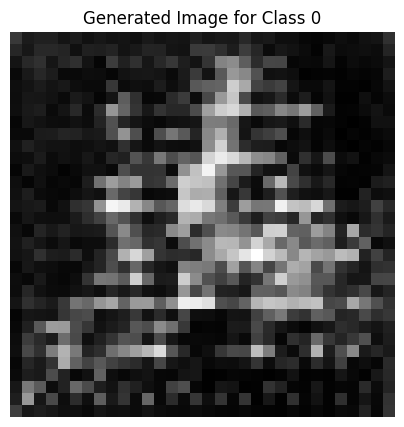

Epoch [157/2500], D_loss: 1.2930660247802734, G_loss: -0.657641589641571


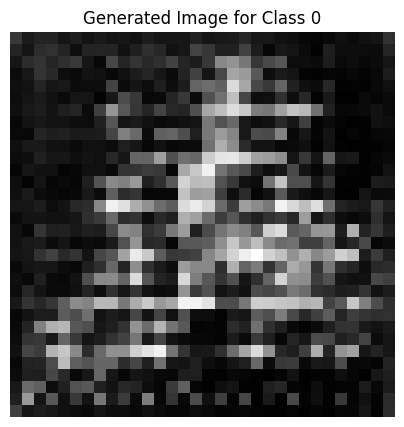

Epoch [158/2500], D_loss: 1.1239609718322754, G_loss: -0.6306381821632385


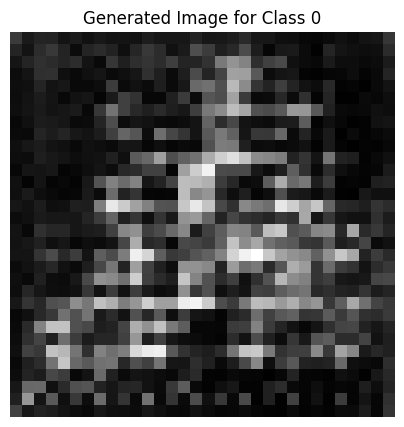

Epoch [159/2500], D_loss: 1.152605414390564, G_loss: -0.6265120506286621


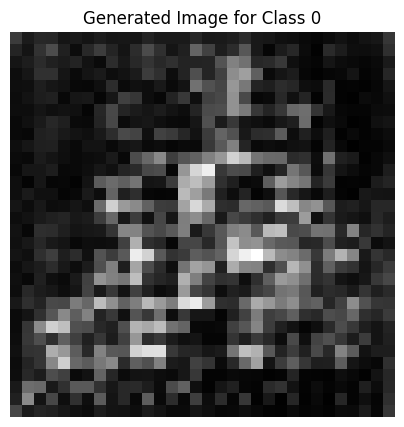

Epoch [160/2500], D_loss: 1.004080057144165, G_loss: -0.5606256723403931


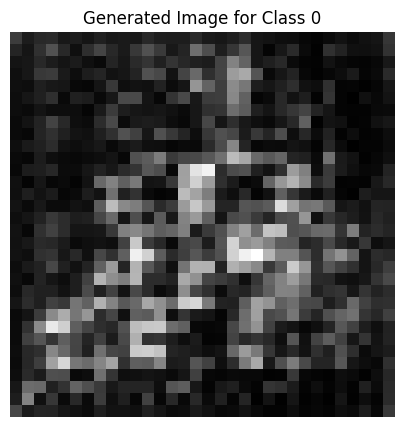

Epoch [161/2500], D_loss: 1.175544261932373, G_loss: -0.6859230995178223


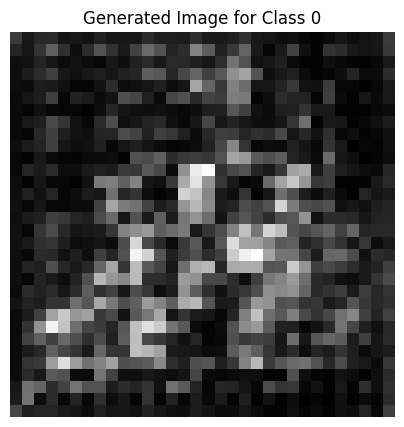

Epoch [162/2500], D_loss: 0.767822265625, G_loss: -0.4598589837551117


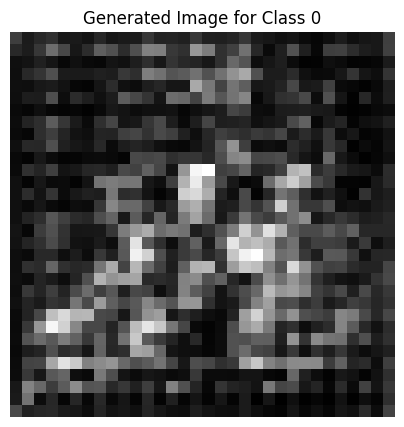

Epoch [163/2500], D_loss: 0.9707719683647156, G_loss: -0.5888123512268066


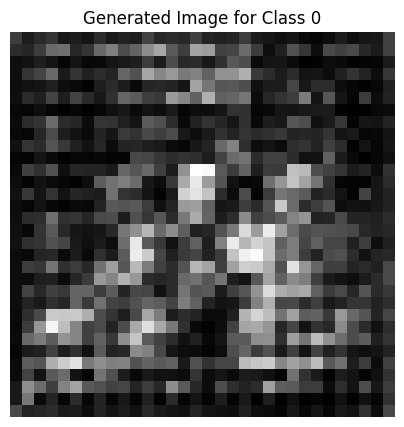

Epoch [164/2500], D_loss: 1.0556515455245972, G_loss: -0.622499942779541


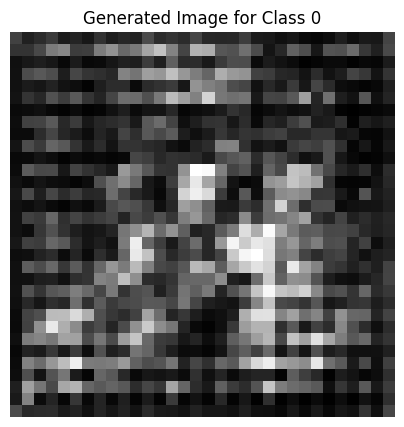

Epoch [165/2500], D_loss: 1.1144516468048096, G_loss: -0.5949088335037231


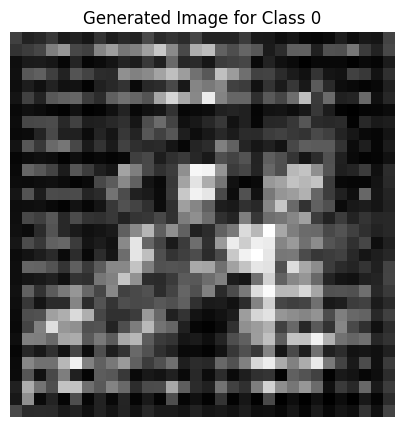

Epoch [166/2500], D_loss: 0.8689717054367065, G_loss: -0.5770201086997986


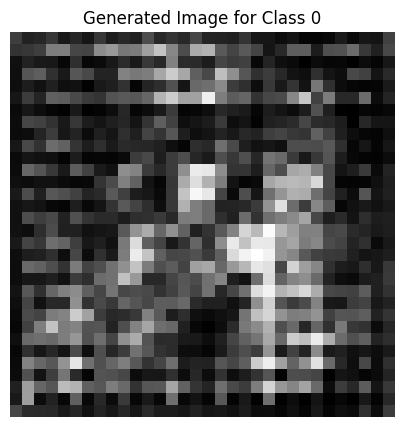

Epoch [167/2500], D_loss: 1.0366241931915283, G_loss: -0.38795244693756104


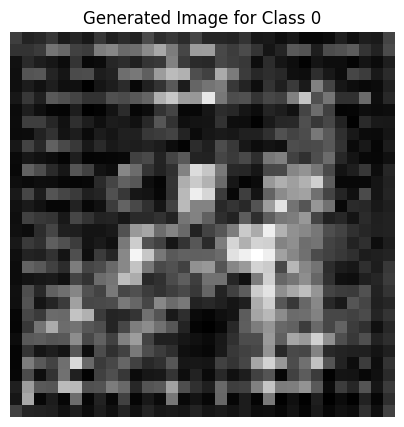

Epoch [168/2500], D_loss: 0.5193601846694946, G_loss: -0.5509347915649414


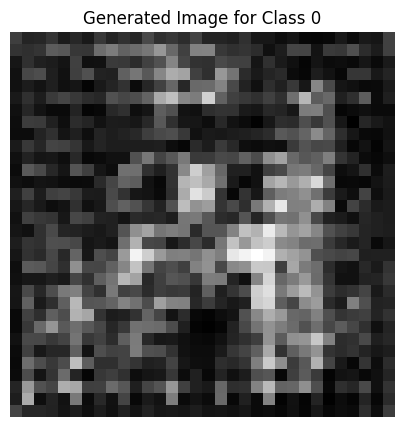

Epoch [169/2500], D_loss: 1.1188631057739258, G_loss: -0.6428775191307068


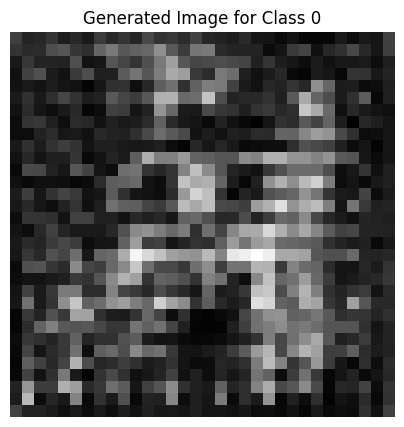

Epoch [170/2500], D_loss: 1.103461503982544, G_loss: -0.7178505063056946


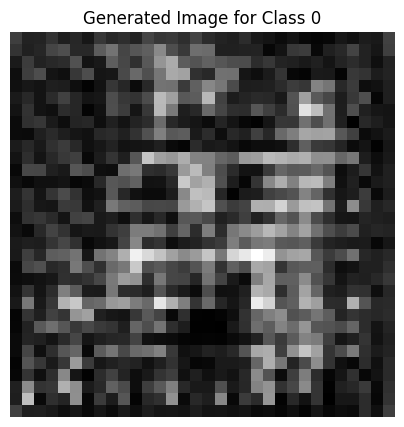

Epoch [171/2500], D_loss: 1.1362547874450684, G_loss: -0.5947592258453369


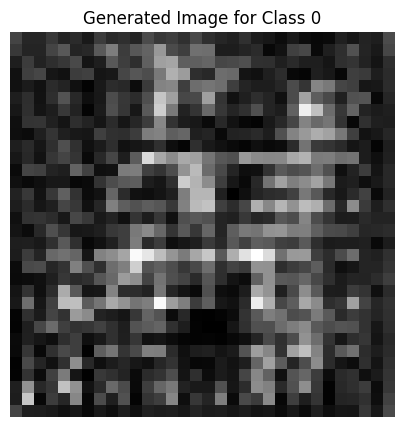

Epoch [172/2500], D_loss: 0.5352987051010132, G_loss: -0.4087214469909668


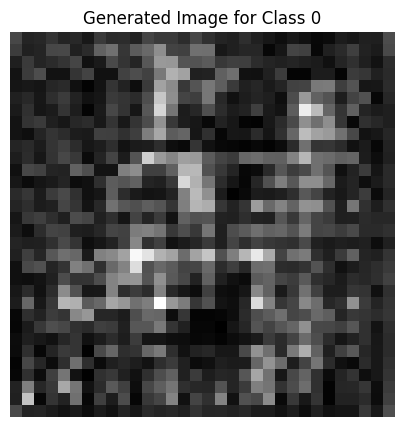

Epoch [173/2500], D_loss: 0.7913975715637207, G_loss: -0.5288209915161133


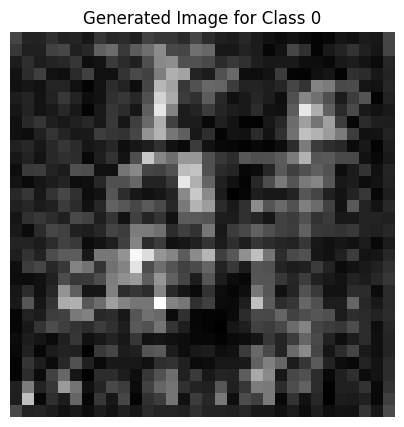

Epoch [174/2500], D_loss: 0.7225962281227112, G_loss: -0.5094983577728271


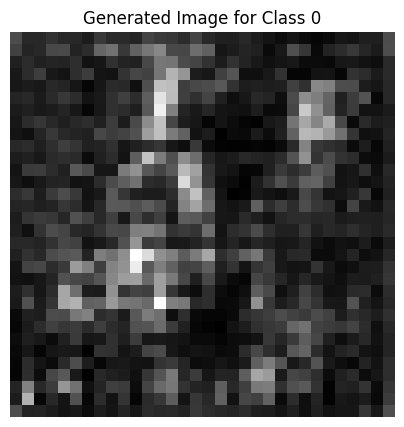

Epoch [175/2500], D_loss: 0.6351061463356018, G_loss: -0.5271573066711426


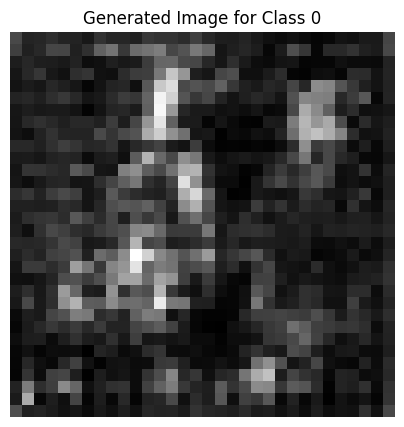

Epoch [176/2500], D_loss: 0.9209496974945068, G_loss: -0.49562475085258484


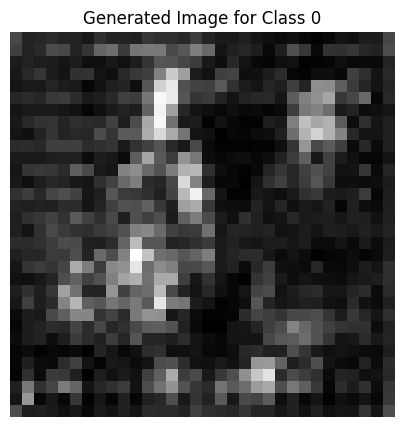

Epoch [177/2500], D_loss: 1.0748560428619385, G_loss: -0.6010907292366028


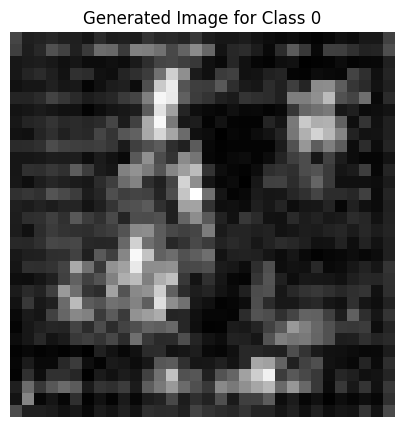

Epoch [178/2500], D_loss: 0.6878830790519714, G_loss: -0.6097155809402466


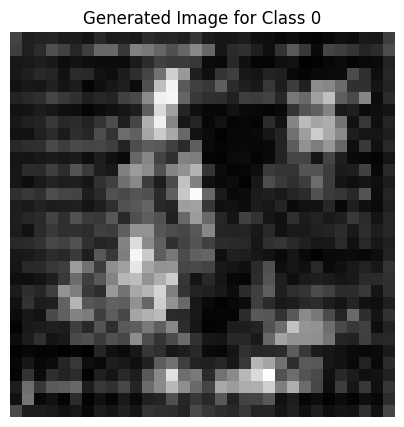

Epoch [179/2500], D_loss: 0.9967814683914185, G_loss: -0.6323704719543457


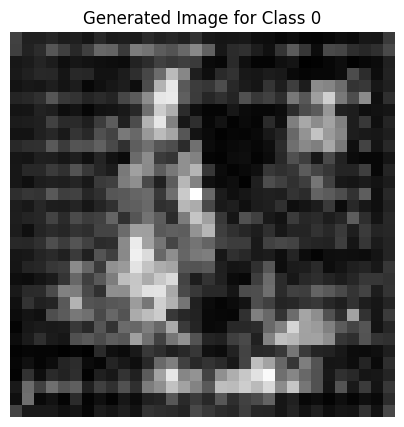

Epoch [180/2500], D_loss: 0.684426486492157, G_loss: -0.605521023273468


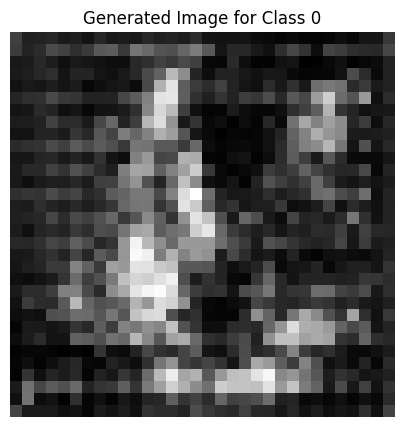

Epoch [181/2500], D_loss: 0.6374465823173523, G_loss: -0.6035005450248718


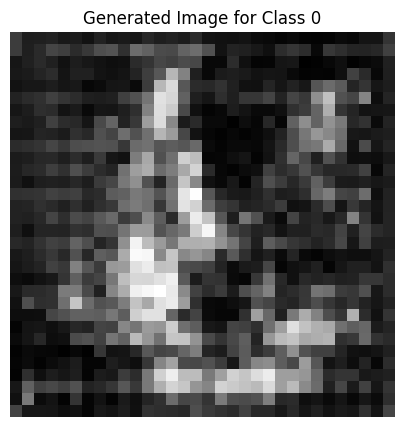

Epoch [182/2500], D_loss: 0.6067675948143005, G_loss: -0.6154171228408813


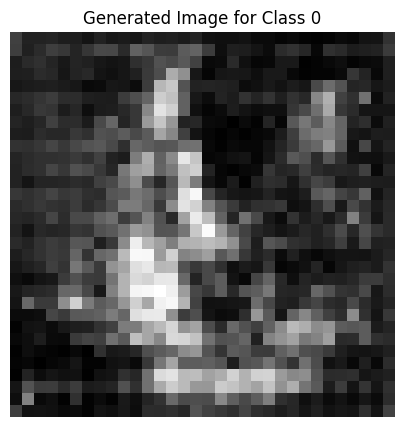

Epoch [183/2500], D_loss: 0.7972200512886047, G_loss: -0.6519216895103455


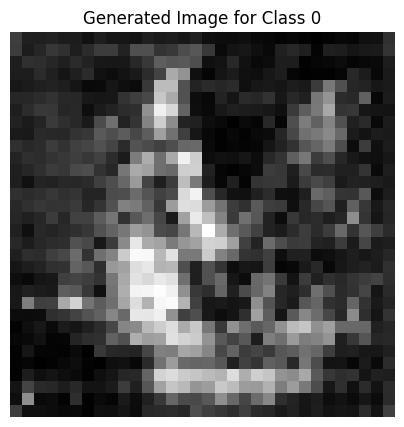

Epoch [184/2500], D_loss: 0.7446925640106201, G_loss: -0.5692960023880005


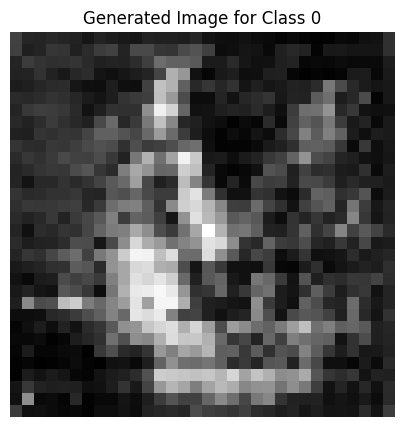

Epoch [185/2500], D_loss: 0.5351731777191162, G_loss: -0.379591166973114


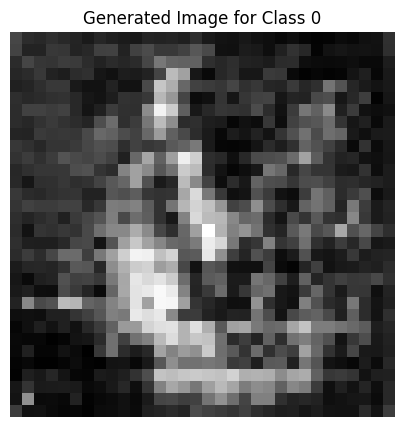

Epoch [186/2500], D_loss: 0.5018961429595947, G_loss: -0.5555338859558105


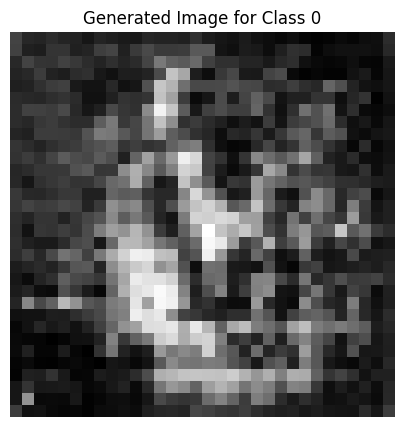

Epoch [187/2500], D_loss: 0.8105247020721436, G_loss: -0.5057772397994995


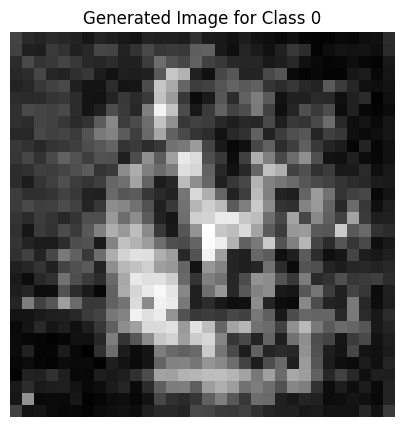

Epoch [188/2500], D_loss: 0.6578654646873474, G_loss: -0.4888034760951996


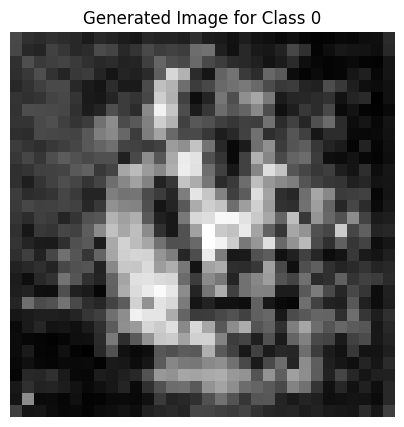

Epoch [189/2500], D_loss: 0.5784445405006409, G_loss: -0.5750606060028076


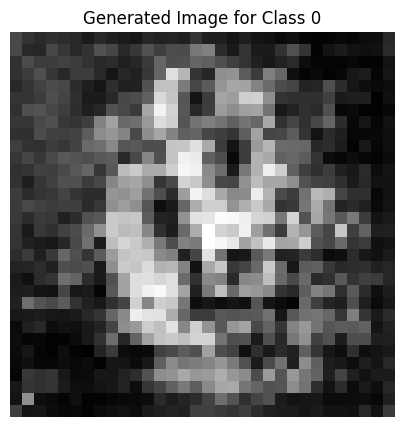

Epoch [190/2500], D_loss: 0.7474055290222168, G_loss: -0.5021941065788269


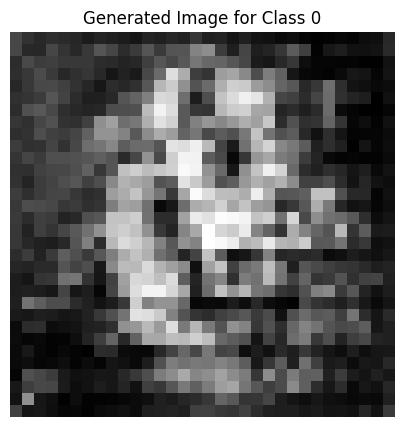

Epoch [191/2500], D_loss: 0.728914737701416, G_loss: -0.6012718677520752


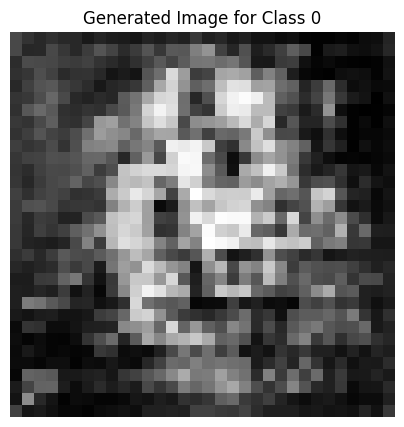

Epoch [192/2500], D_loss: 0.9360902905464172, G_loss: -0.5932722687721252


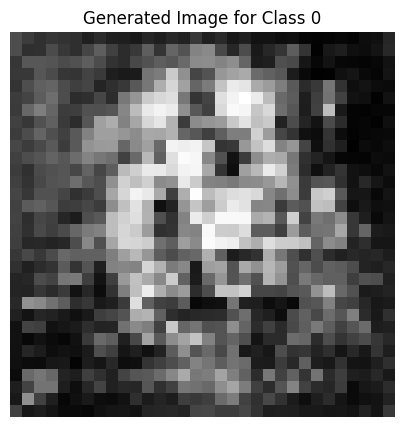

Epoch [193/2500], D_loss: 0.7400652766227722, G_loss: -0.5998882055282593


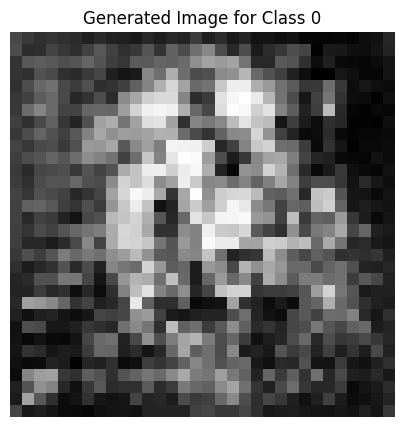

Epoch [194/2500], D_loss: 0.7380938529968262, G_loss: -0.6081504821777344


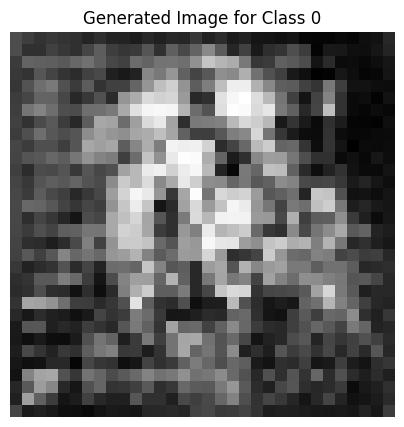

Epoch [195/2500], D_loss: 0.6071996092796326, G_loss: -0.47151124477386475


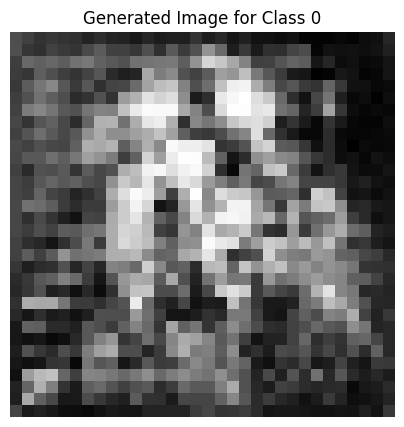

Epoch [196/2500], D_loss: 0.563563346862793, G_loss: -0.4266487956047058


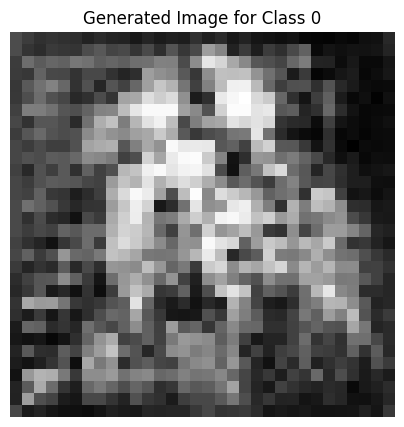

Epoch [197/2500], D_loss: 0.3920208513736725, G_loss: -0.44538554549217224


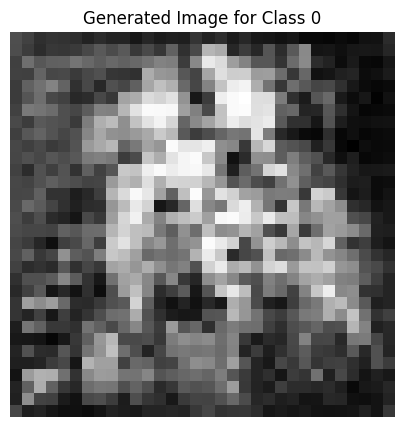

Epoch [198/2500], D_loss: 0.40659090876579285, G_loss: -0.5121241807937622


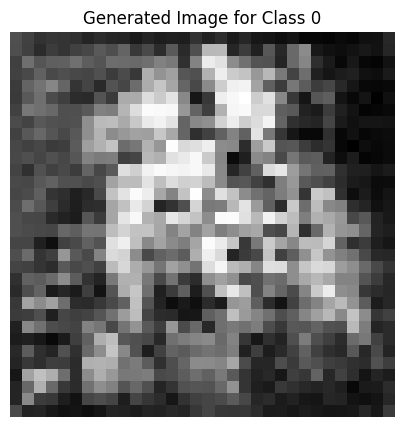

Epoch [199/2500], D_loss: 0.4156903028488159, G_loss: -0.5662164688110352


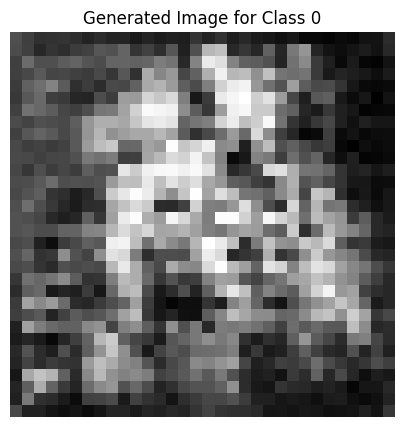

Epoch [200/2500], D_loss: 0.4656706750392914, G_loss: -0.3978515863418579


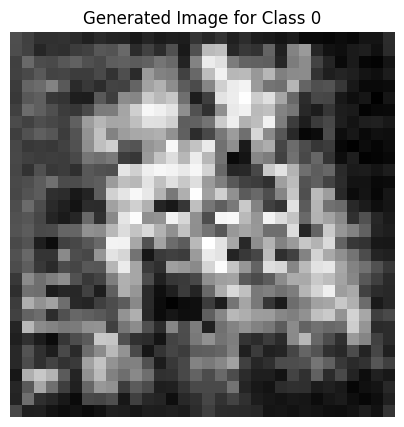

Epoch [201/2500], D_loss: 0.24576926231384277, G_loss: -0.3609859049320221


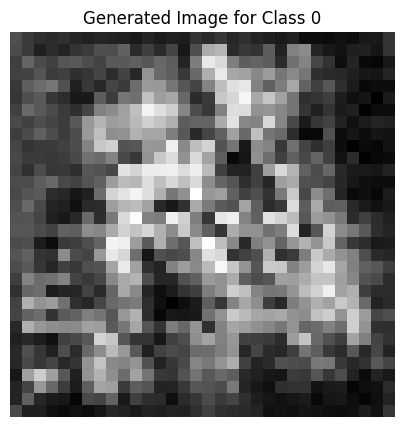

Epoch [202/2500], D_loss: 0.37943214178085327, G_loss: -0.46676284074783325


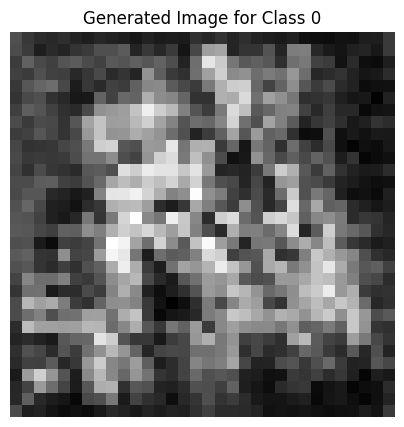

Epoch [203/2500], D_loss: 0.2930472791194916, G_loss: -0.35007721185684204


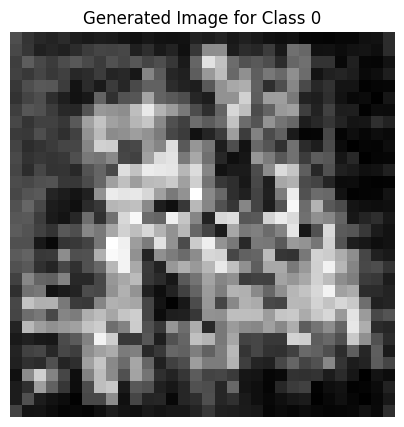

Epoch [204/2500], D_loss: 0.3863484263420105, G_loss: -0.34650659561157227


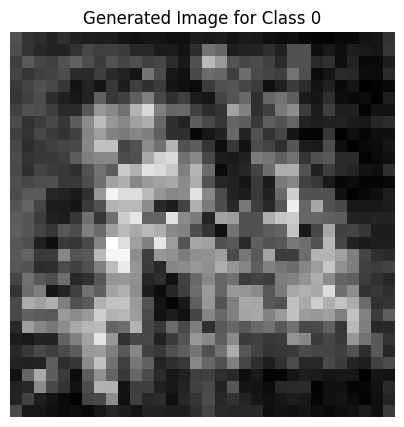

Epoch [205/2500], D_loss: 0.4097556471824646, G_loss: -0.5298123359680176


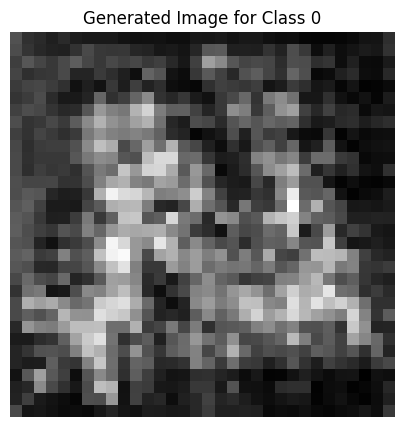

Epoch [206/2500], D_loss: 0.5714499354362488, G_loss: -0.48202937841415405


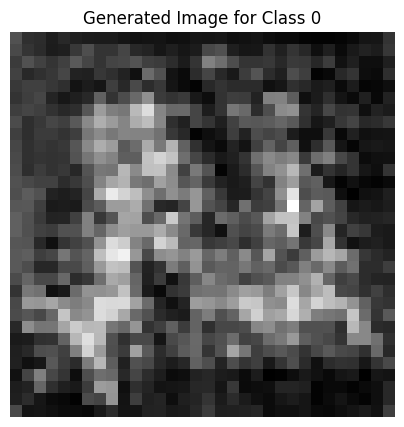

Epoch [207/2500], D_loss: 0.6951332688331604, G_loss: -0.554600715637207


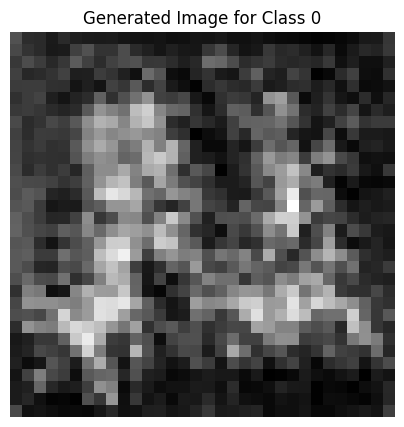

Epoch [208/2500], D_loss: 0.482252299785614, G_loss: -0.5405083894729614


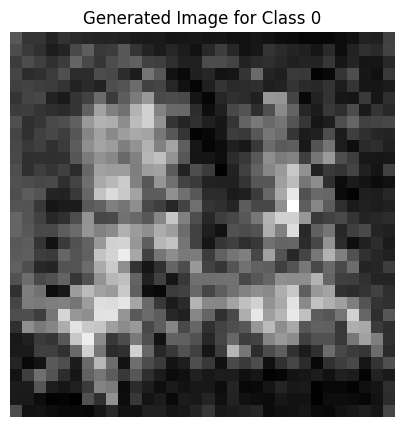

Epoch [209/2500], D_loss: 0.5877635478973389, G_loss: -0.5532917976379395


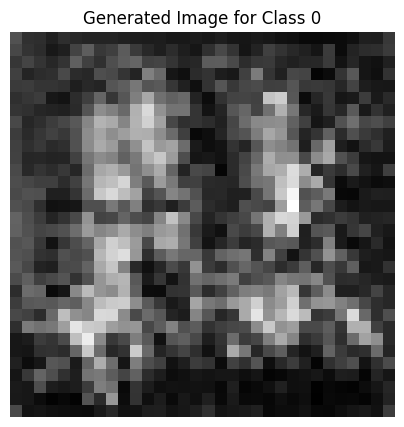

Epoch [210/2500], D_loss: 0.5514171123504639, G_loss: -0.5740973949432373


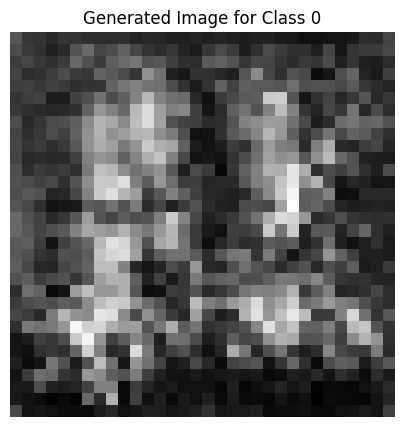

Epoch [211/2500], D_loss: 0.38168132305145264, G_loss: -0.5223085880279541


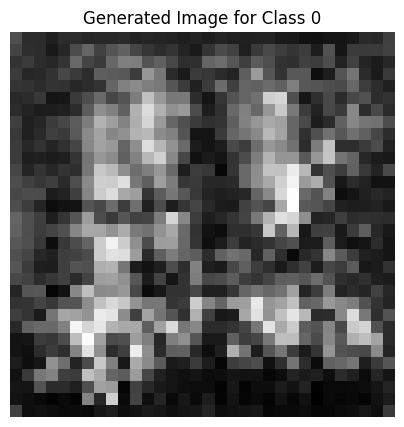

Epoch [212/2500], D_loss: 0.3693545162677765, G_loss: -0.5011651515960693


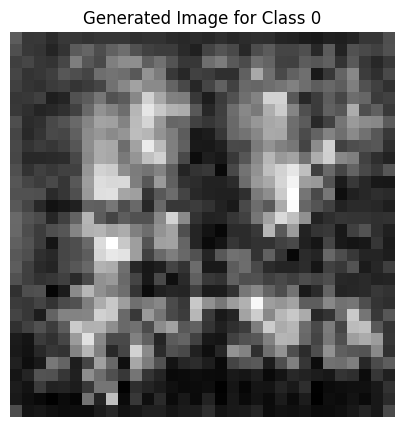

Epoch [213/2500], D_loss: 0.5035709738731384, G_loss: -0.4962444603443146


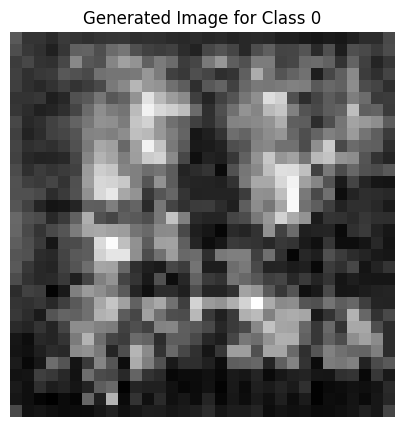

Epoch [214/2500], D_loss: 0.484946072101593, G_loss: -0.4876460134983063


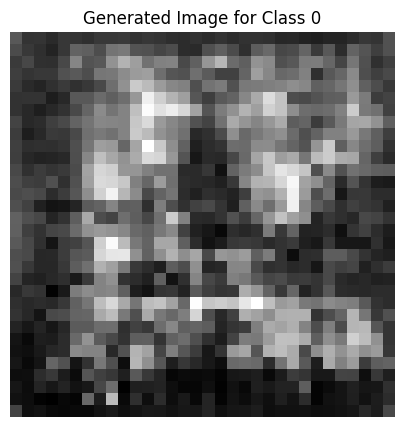

Epoch [215/2500], D_loss: 0.5117096900939941, G_loss: -0.4901002049446106


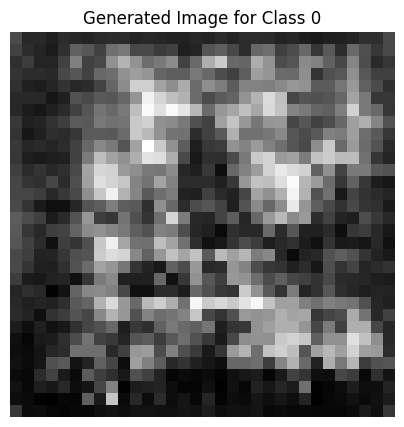

Epoch [216/2500], D_loss: 0.4123418927192688, G_loss: -0.5531169176101685


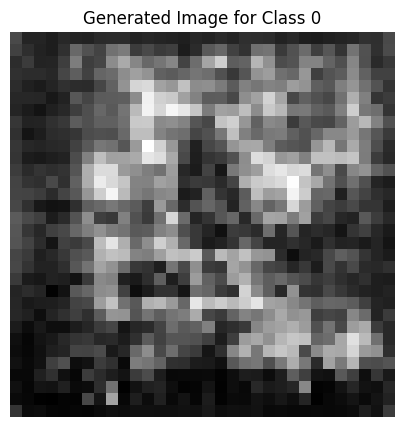

Epoch [217/2500], D_loss: 0.8296962976455688, G_loss: -0.3114333748817444


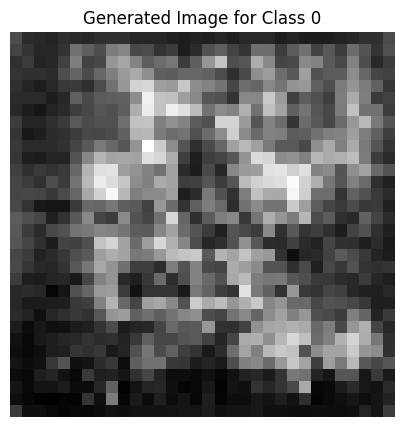

Epoch [218/2500], D_loss: 0.31175005435943604, G_loss: -0.4430052936077118


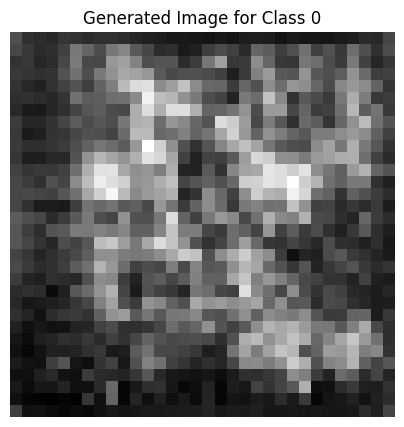

Epoch [219/2500], D_loss: 0.2772537171840668, G_loss: -0.49057286977767944


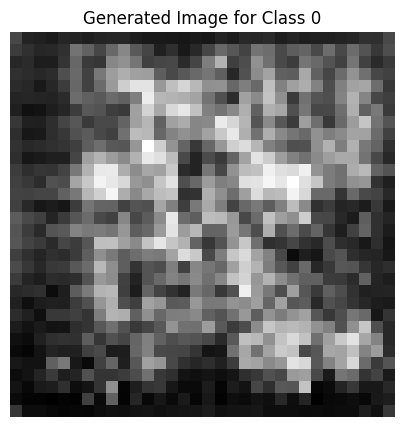

Epoch [220/2500], D_loss: 0.3508191406726837, G_loss: -0.5173786282539368


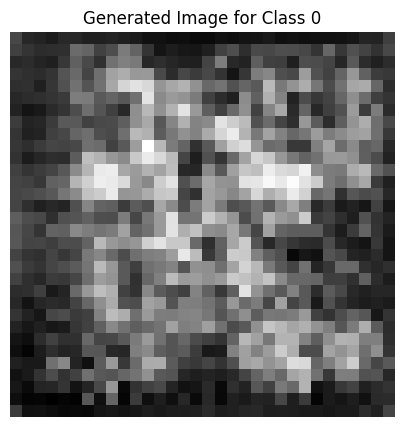

Epoch [221/2500], D_loss: 0.41092944145202637, G_loss: -0.5119284391403198


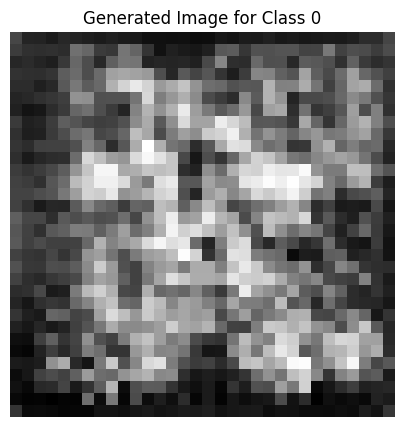

Epoch [222/2500], D_loss: 0.28728508949279785, G_loss: -0.4546622633934021


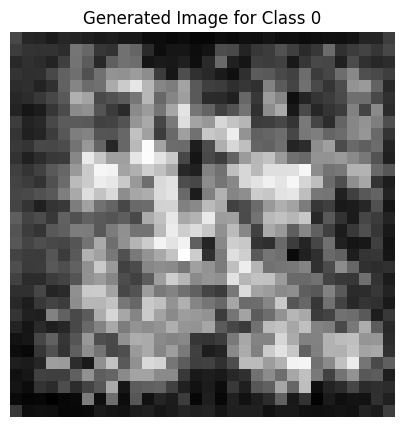

Epoch [223/2500], D_loss: 0.3409877121448517, G_loss: -0.5058441162109375


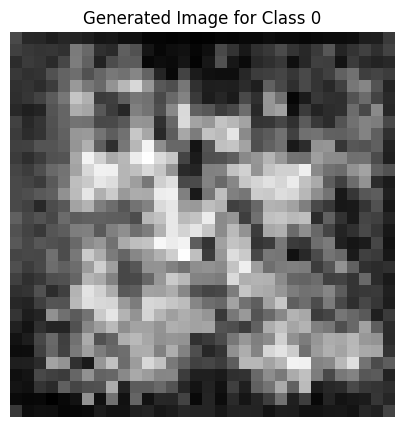

Epoch [224/2500], D_loss: 0.42781370878219604, G_loss: -0.5075358748435974


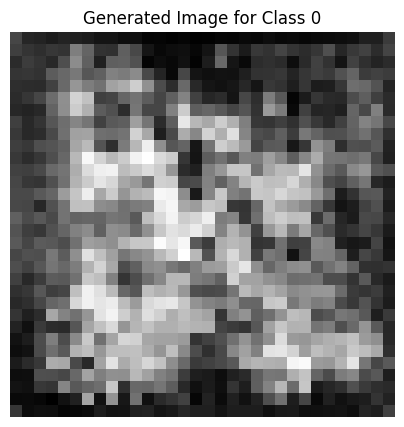

Epoch [225/2500], D_loss: 0.5365516543388367, G_loss: -0.5498917102813721


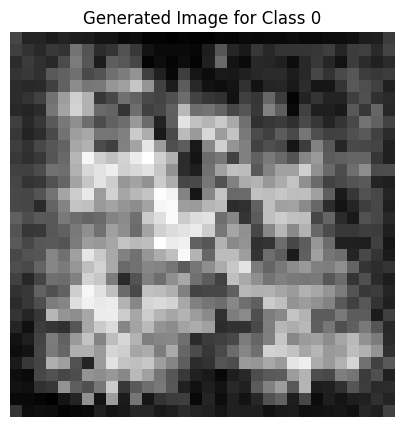

Epoch [226/2500], D_loss: 0.5599867105484009, G_loss: -0.39830854535102844


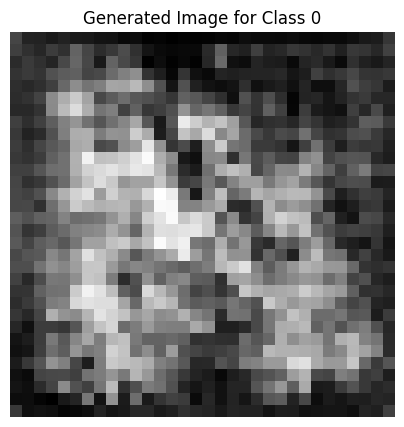

Epoch [227/2500], D_loss: 0.3547620177268982, G_loss: -0.5117126107215881


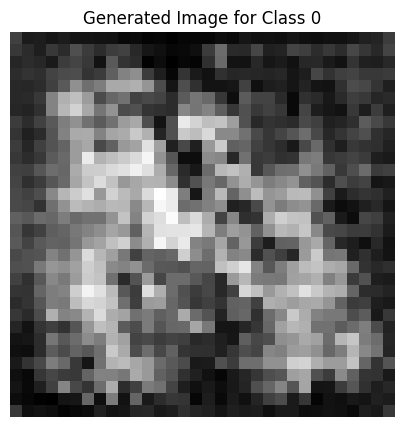

Epoch [228/2500], D_loss: 0.3037703335285187, G_loss: -0.3563087582588196


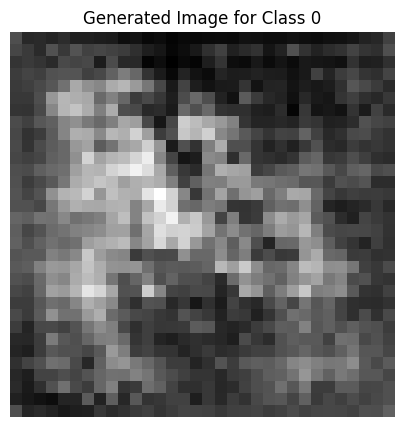

Epoch [229/2500], D_loss: 0.4697802662849426, G_loss: -0.39185506105422974


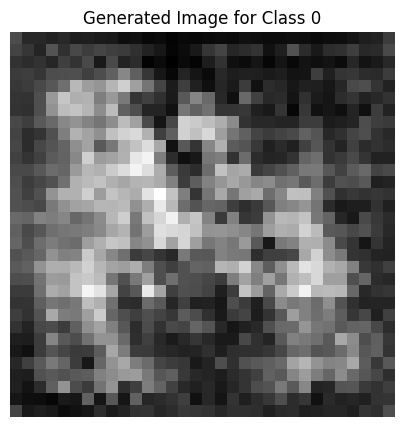

Epoch [230/2500], D_loss: 0.4777359366416931, G_loss: -0.45021307468414307


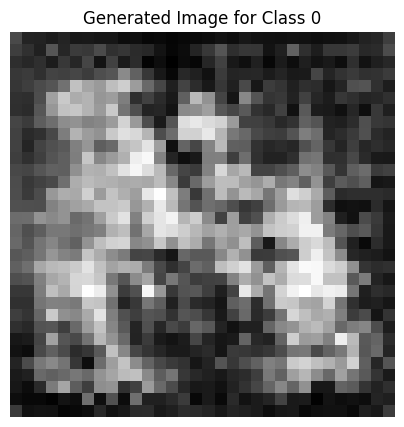

Epoch [231/2500], D_loss: 0.37709563970565796, G_loss: -0.4265534281730652


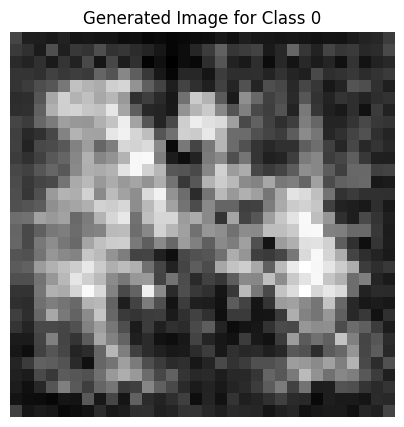

Epoch [232/2500], D_loss: 0.2943572402000427, G_loss: -0.4801262617111206


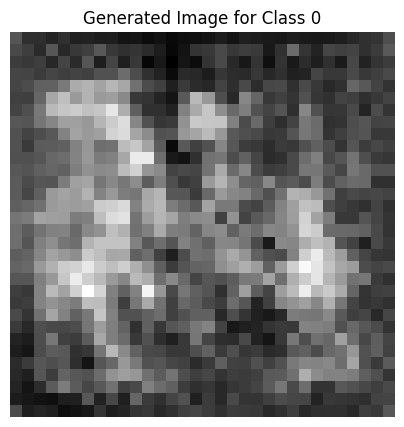

Epoch [233/2500], D_loss: 0.2473583221435547, G_loss: -0.3531992435455322


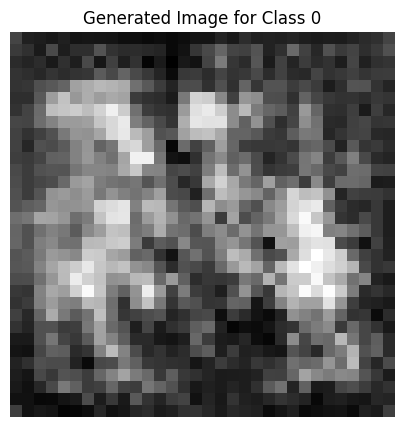

Epoch [234/2500], D_loss: 0.2802647054195404, G_loss: -0.47855839133262634


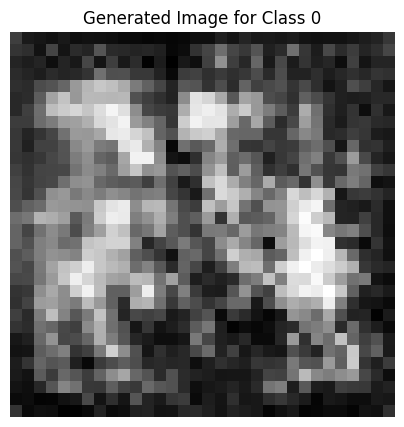

Epoch [235/2500], D_loss: 0.3006535768508911, G_loss: -0.4691937565803528


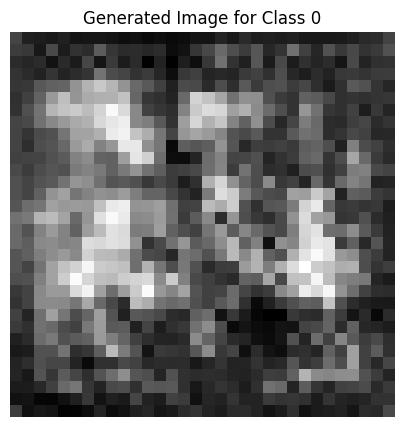

Epoch [236/2500], D_loss: 0.28071102499961853, G_loss: -0.5102660655975342


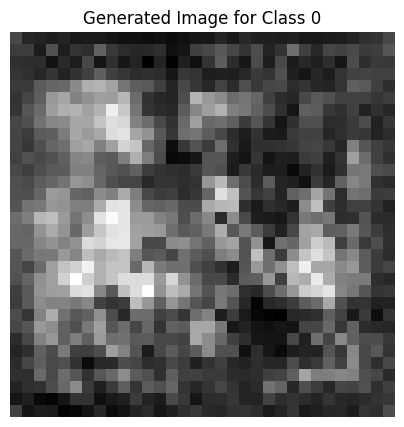

Epoch [237/2500], D_loss: 0.2952834963798523, G_loss: -0.49369367957115173


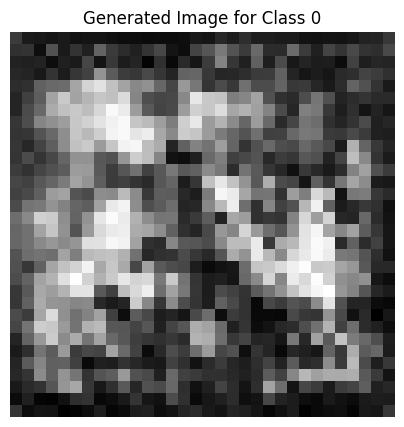

Epoch [238/2500], D_loss: 0.3568979799747467, G_loss: -0.5212396383285522


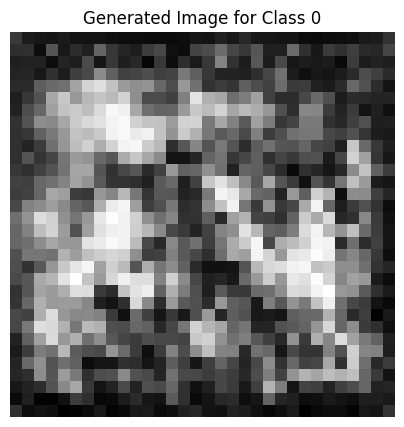

Epoch [239/2500], D_loss: 0.28940045833587646, G_loss: -0.5126672387123108


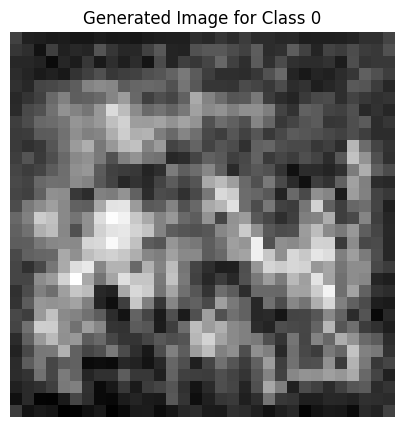

Epoch [240/2500], D_loss: 0.4127521514892578, G_loss: -0.4795531630516052


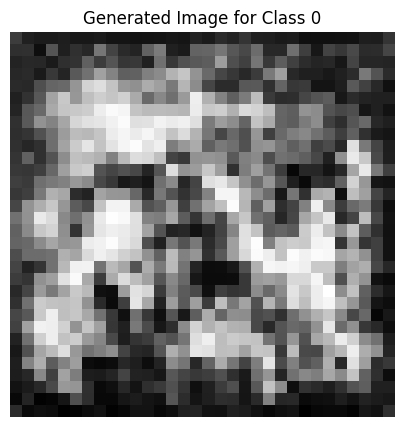

Epoch [241/2500], D_loss: 0.32080787420272827, G_loss: -0.4799889326095581


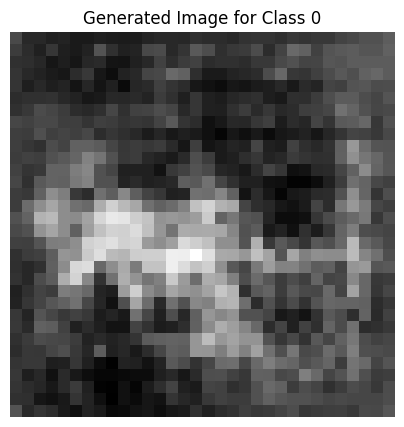

Epoch [242/2500], D_loss: 0.5918129086494446, G_loss: -0.5862319469451904


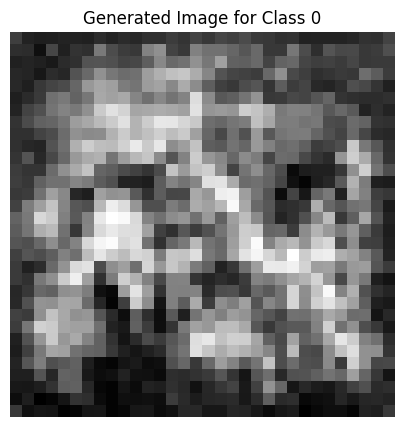

Epoch [243/2500], D_loss: 0.4146357774734497, G_loss: -0.3928348124027252


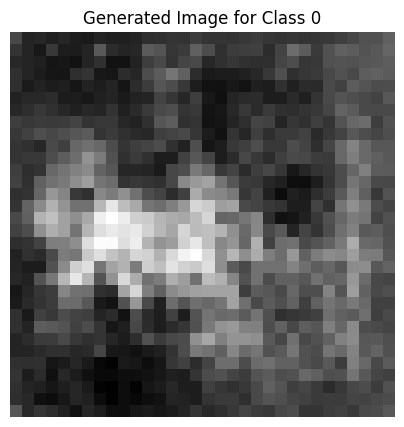

Epoch [244/2500], D_loss: 0.3490426242351532, G_loss: -0.40652790665626526


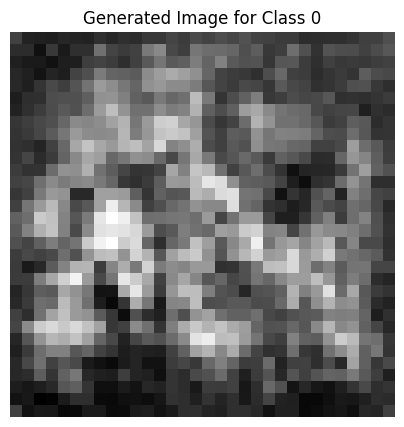

Epoch [245/2500], D_loss: 0.29372265934944153, G_loss: -0.5597408413887024


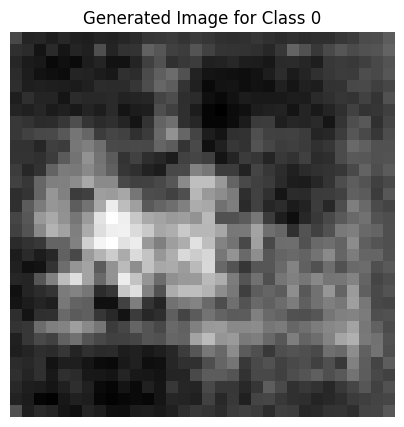

Epoch [246/2500], D_loss: 0.20672446489334106, G_loss: -0.495128333568573


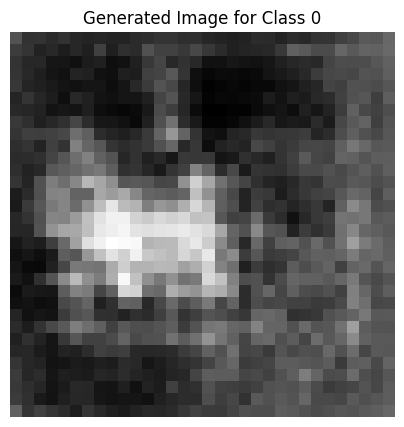

Epoch [247/2500], D_loss: 0.44328606128692627, G_loss: -0.5530356764793396


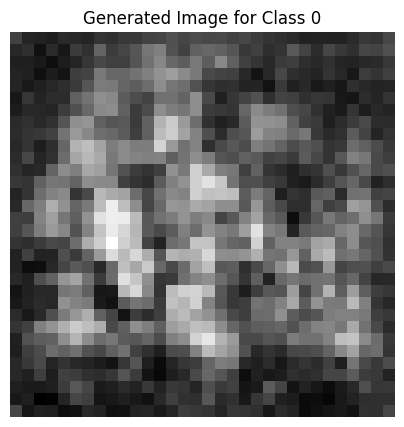

Epoch [248/2500], D_loss: 0.44637900590896606, G_loss: -0.582229495048523


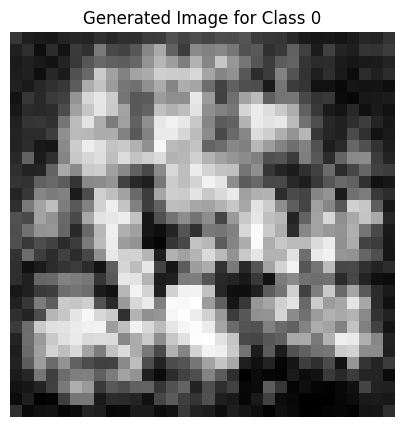

Epoch [249/2500], D_loss: 0.4228779077529907, G_loss: -0.5942387580871582


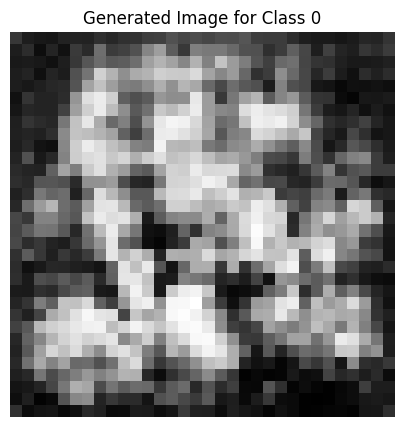

Epoch [250/2500], D_loss: 0.46314936876296997, G_loss: -0.6094112992286682


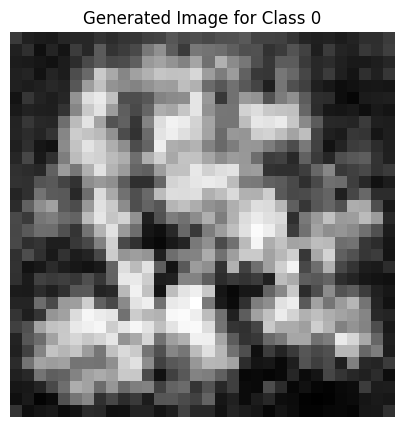

Epoch [251/2500], D_loss: 0.6155940294265747, G_loss: -0.5699025988578796


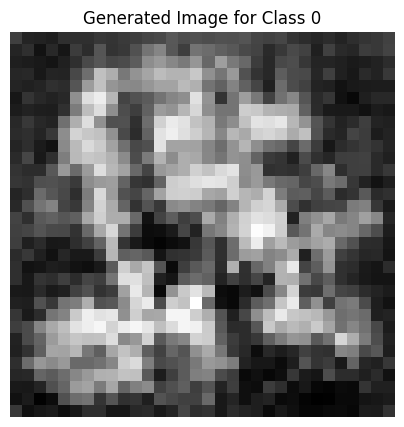

Epoch [252/2500], D_loss: 0.5165691375732422, G_loss: -0.6089544296264648


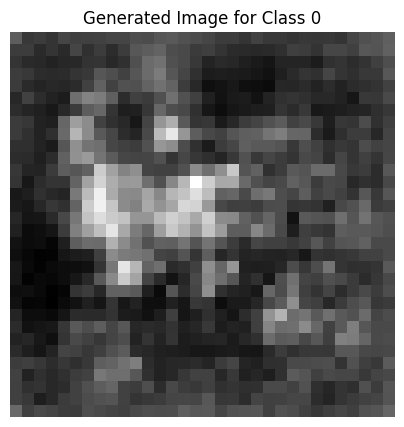

Epoch [253/2500], D_loss: 0.421028196811676, G_loss: -0.6180603504180908


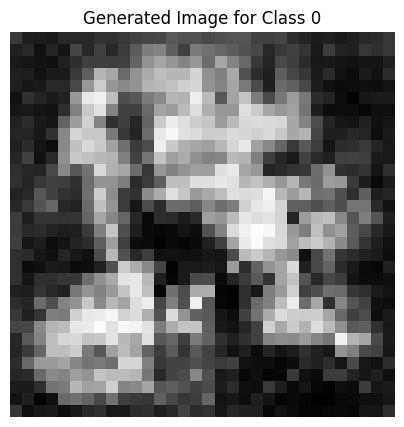

Epoch [254/2500], D_loss: 0.5322019457817078, G_loss: -0.5116015672683716


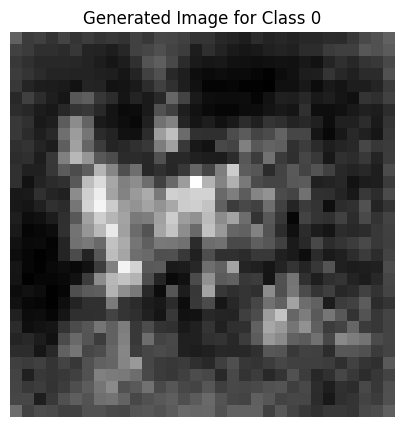

Epoch [255/2500], D_loss: 0.44295111298561096, G_loss: -0.5619281530380249


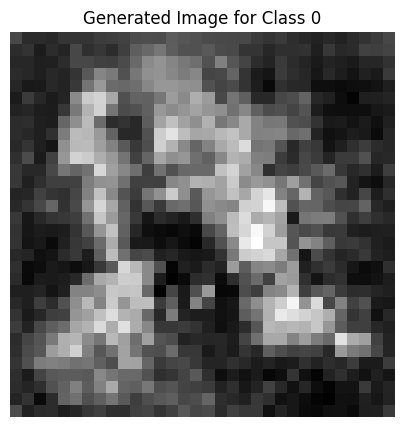

Epoch [256/2500], D_loss: 0.3824543058872223, G_loss: -0.5193386077880859


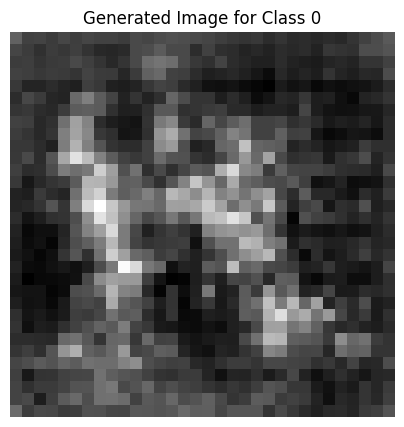

Epoch [257/2500], D_loss: 0.3757108449935913, G_loss: -0.5338184237480164


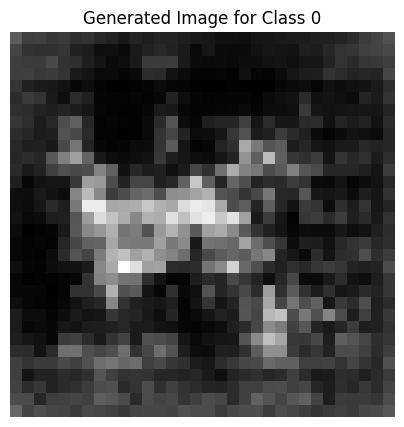

Epoch [258/2500], D_loss: 0.7737940549850464, G_loss: -0.503424882888794


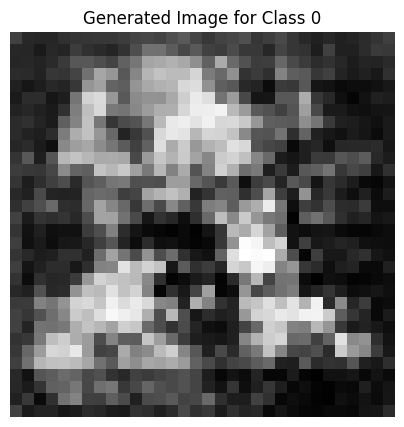

Epoch [259/2500], D_loss: 0.24074828624725342, G_loss: -0.571287214756012


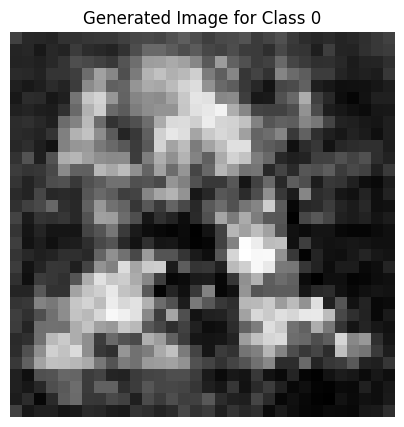

Epoch [260/2500], D_loss: 0.2816498875617981, G_loss: -0.40600448846817017


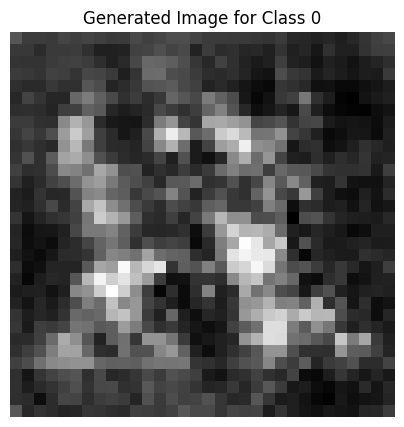

Epoch [261/2500], D_loss: 0.2418108582496643, G_loss: -0.5762526988983154


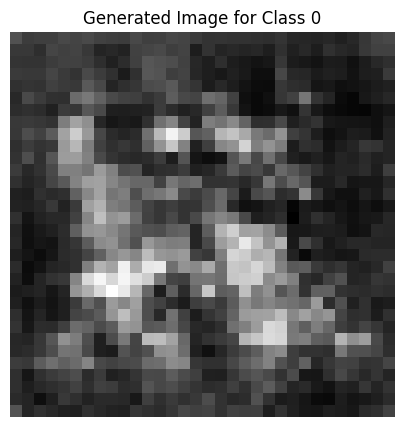

Epoch [262/2500], D_loss: 0.22397059202194214, G_loss: -0.53394615650177


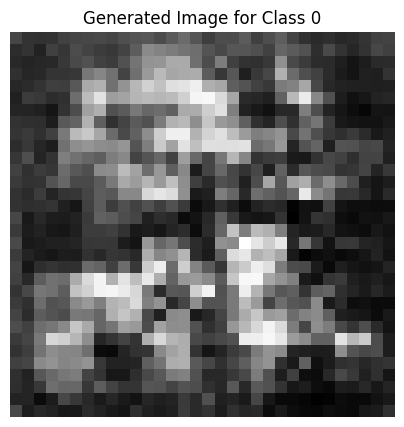

Epoch [263/2500], D_loss: 0.2681716978549957, G_loss: -0.5369164347648621


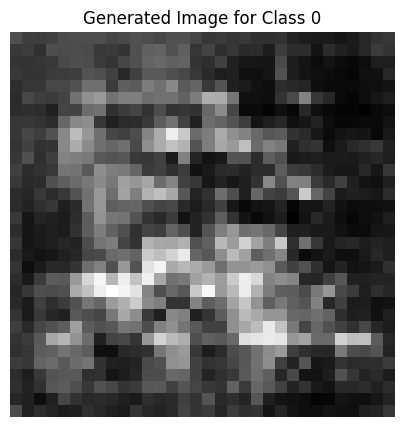

Epoch [264/2500], D_loss: 0.23093539476394653, G_loss: -0.5199999213218689


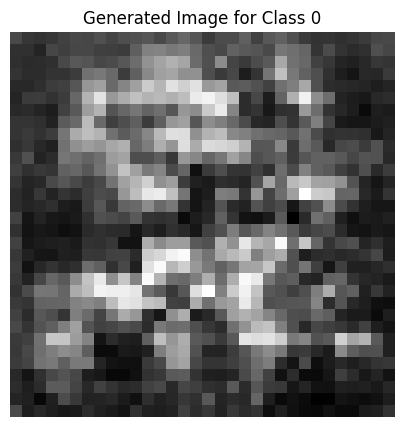

Epoch [265/2500], D_loss: 0.29820287227630615, G_loss: -0.5626766681671143


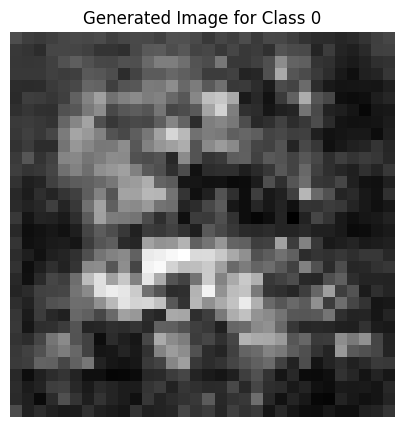

Epoch [266/2500], D_loss: 0.5365444421768188, G_loss: -0.5580675601959229


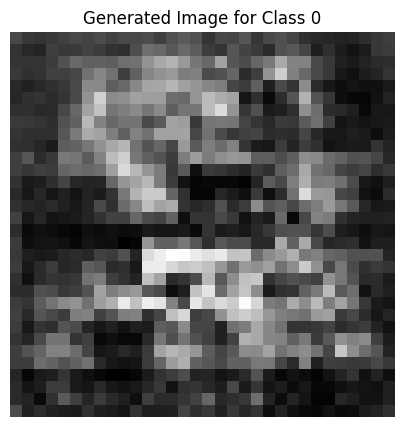

Epoch [267/2500], D_loss: 0.31040096282958984, G_loss: -0.49971914291381836


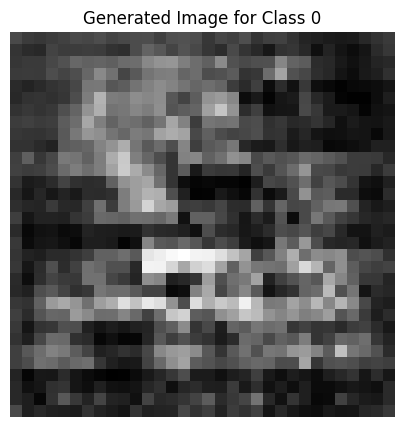

Epoch [268/2500], D_loss: 0.4260932505130768, G_loss: -0.5149390697479248


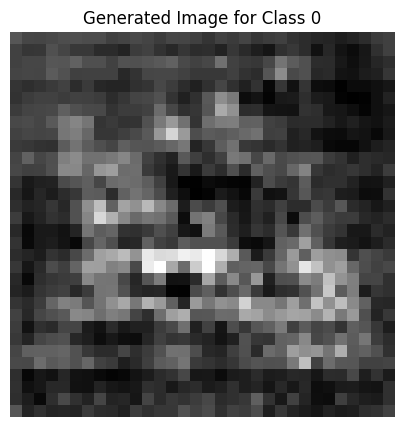

Epoch [269/2500], D_loss: 0.22911116480827332, G_loss: -0.5610623359680176


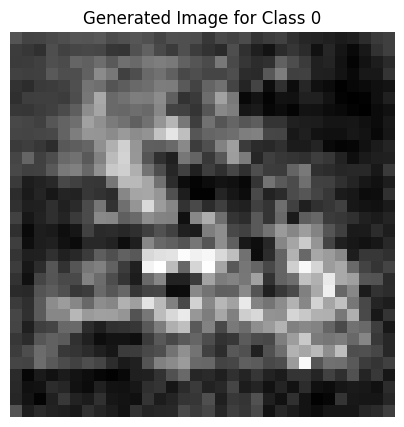

Epoch [270/2500], D_loss: 0.3604664206504822, G_loss: -0.43652743101119995


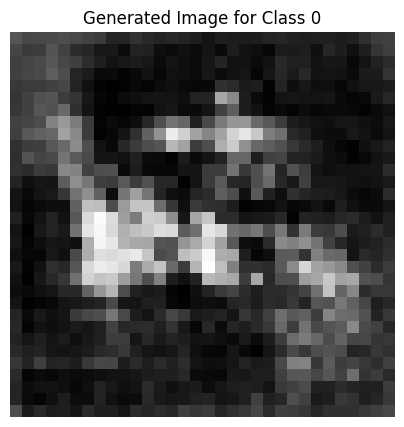

Epoch [271/2500], D_loss: 0.35125410556793213, G_loss: -0.6290442943572998


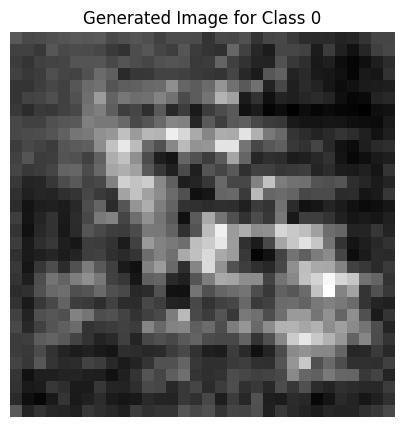

Epoch [272/2500], D_loss: 0.32121193408966064, G_loss: -0.6104636192321777


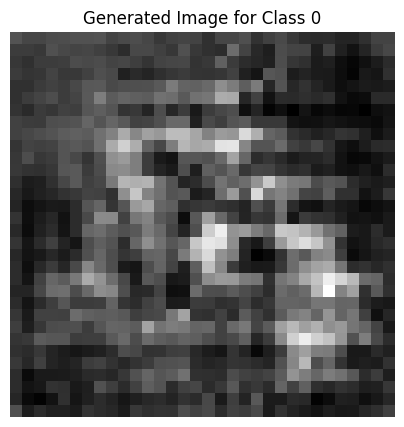

Epoch [273/2500], D_loss: 0.268388032913208, G_loss: -0.5743690729141235


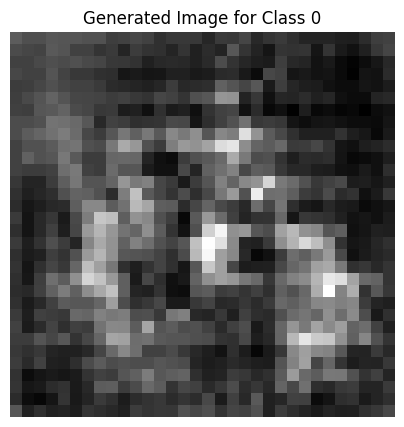

Epoch [274/2500], D_loss: 0.27347561717033386, G_loss: -0.4579950273036957


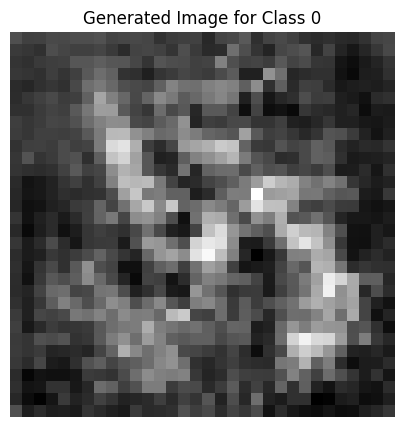

Epoch [275/2500], D_loss: 0.28620681166648865, G_loss: -0.6441012620925903


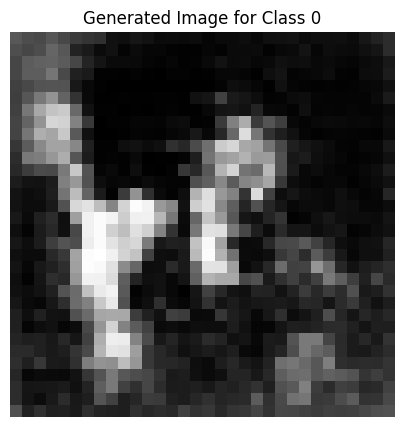

Epoch [276/2500], D_loss: 0.41971731185913086, G_loss: -0.6302523016929626


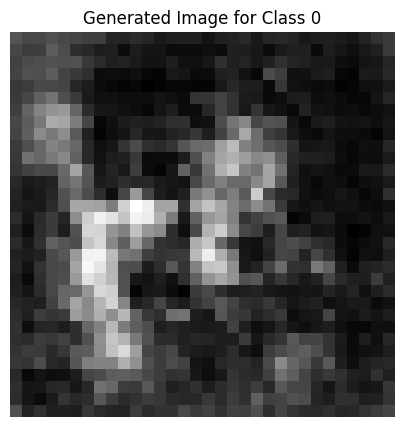

Epoch [277/2500], D_loss: 0.237493634223938, G_loss: -0.5567148923873901


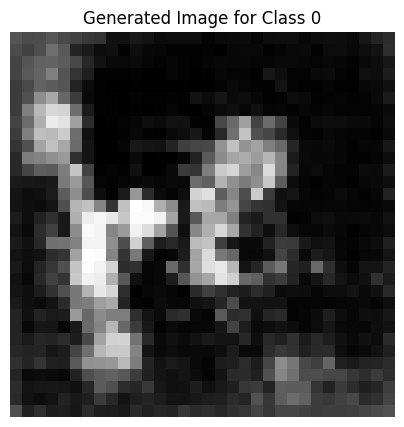

Epoch [278/2500], D_loss: 0.34536832571029663, G_loss: -0.5562856197357178


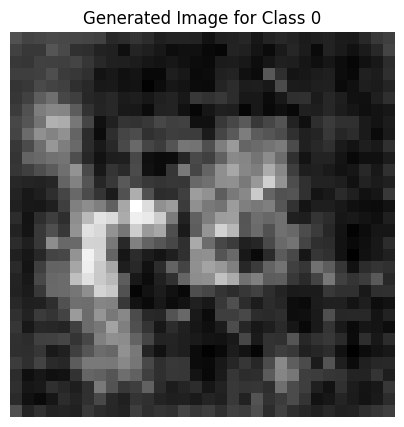

Epoch [279/2500], D_loss: 0.16711226105690002, G_loss: -0.6139973402023315


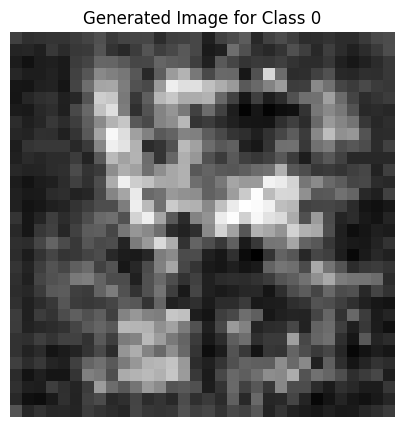

Epoch [280/2500], D_loss: 0.31853097677230835, G_loss: -0.6458724737167358


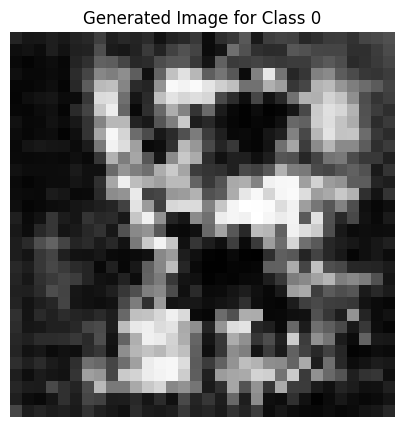

Epoch [281/2500], D_loss: 0.20283767580986023, G_loss: -0.49864277243614197


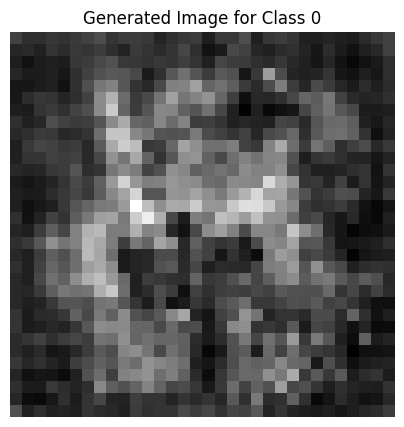

Epoch [282/2500], D_loss: 0.2584526538848877, G_loss: -0.4613102674484253


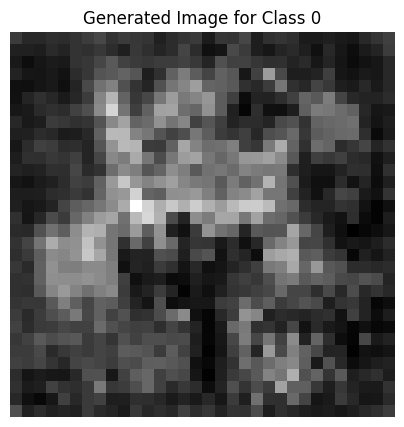

Epoch [283/2500], D_loss: 0.17581066489219666, G_loss: -0.5482884645462036


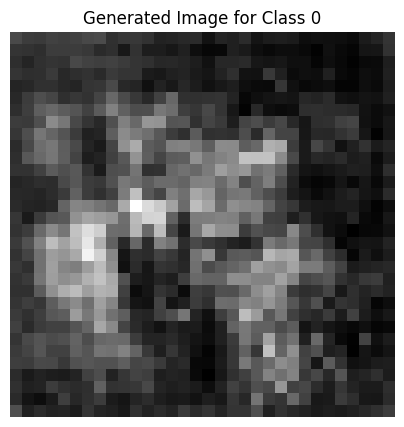

Epoch [284/2500], D_loss: 0.2922576069831848, G_loss: -0.5677220821380615


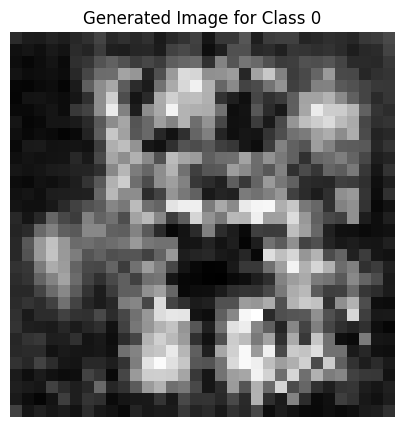

Epoch [285/2500], D_loss: 0.22280722856521606, G_loss: -0.5588372349739075


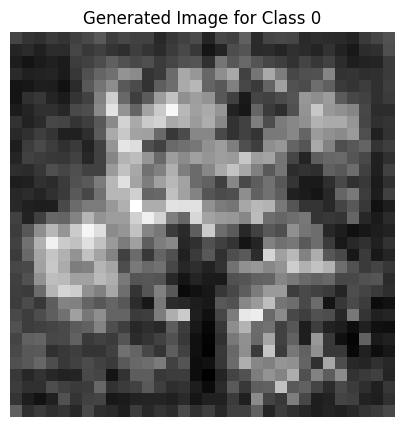

Epoch [286/2500], D_loss: 0.2537098824977875, G_loss: -0.58295738697052


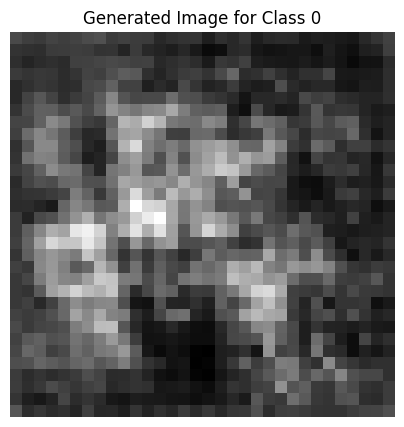

Epoch [287/2500], D_loss: 0.30460599064826965, G_loss: -0.5803496241569519


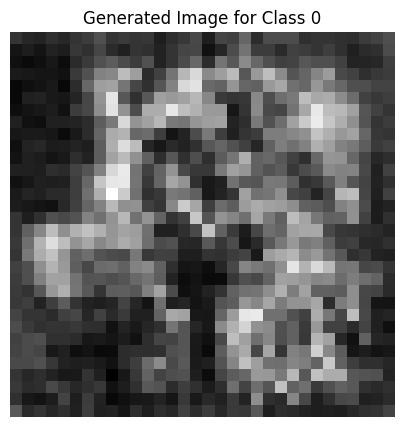

Epoch [288/2500], D_loss: 0.2791109085083008, G_loss: -0.5650762915611267


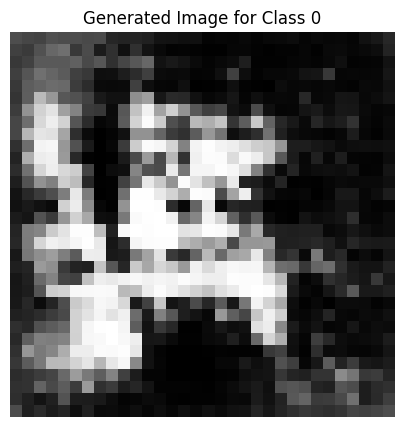

Epoch [289/2500], D_loss: 0.28220611810684204, G_loss: -0.5676835775375366


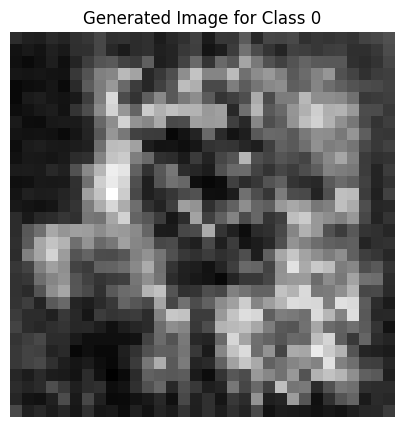

Epoch [290/2500], D_loss: 0.26142847537994385, G_loss: -0.6154759526252747


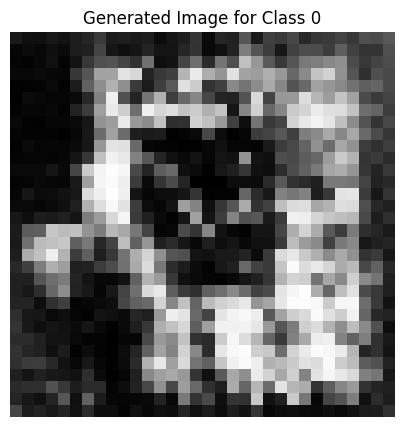

Epoch [291/2500], D_loss: 0.318006306886673, G_loss: -0.5420143604278564


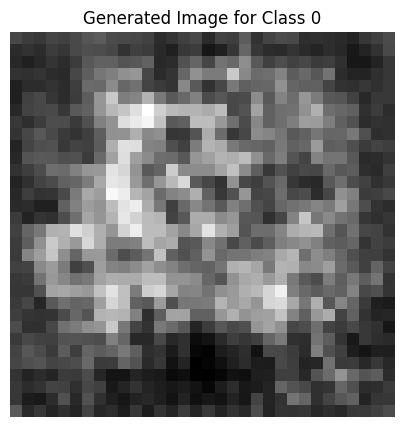

Epoch [292/2500], D_loss: 0.24599984288215637, G_loss: -0.5698356628417969


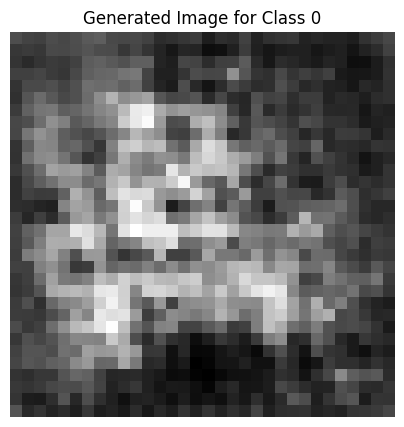

Epoch [293/2500], D_loss: 0.23594573140144348, G_loss: -0.6232559680938721


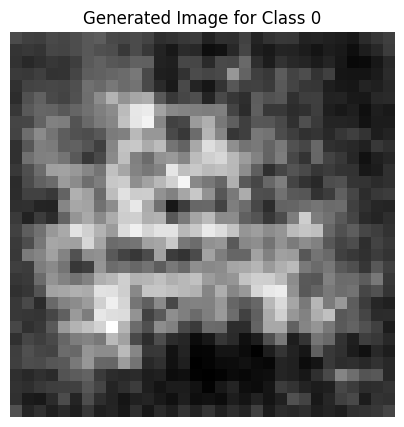

Epoch [294/2500], D_loss: 0.35896021127700806, G_loss: -0.5421142578125


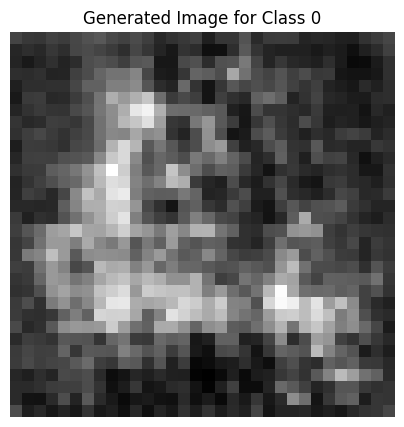

Epoch [295/2500], D_loss: 0.21644800901412964, G_loss: -0.4992963671684265


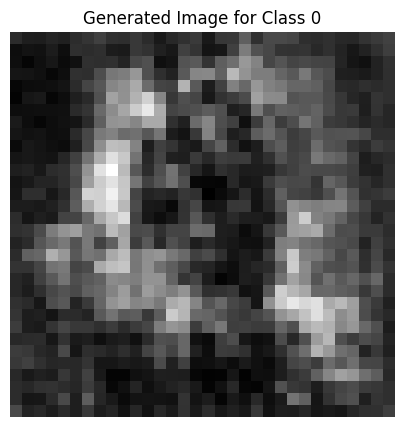

Epoch [296/2500], D_loss: 0.17543262243270874, G_loss: -0.5441032648086548


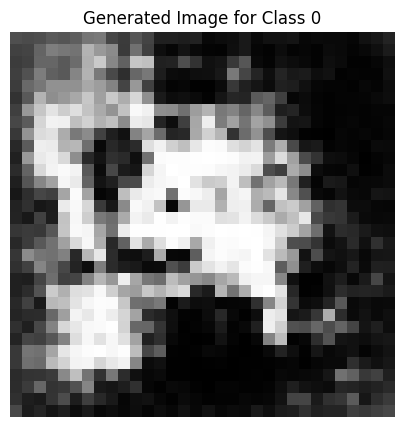

Epoch [297/2500], D_loss: 0.1821245551109314, G_loss: -0.5251786708831787


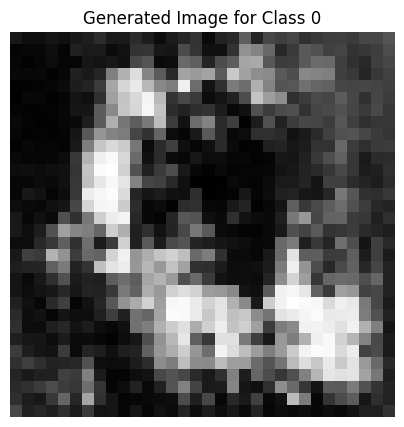

Epoch [298/2500], D_loss: 0.22924017906188965, G_loss: -0.43328365683555603


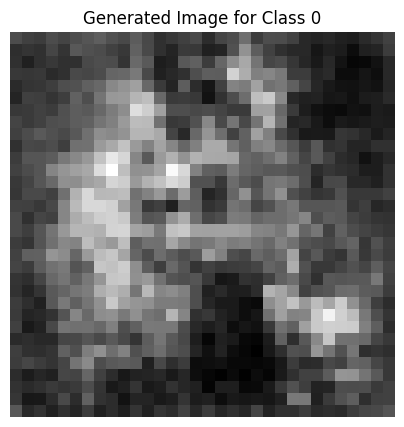

Epoch [299/2500], D_loss: 0.1987023949623108, G_loss: -0.5415084362030029


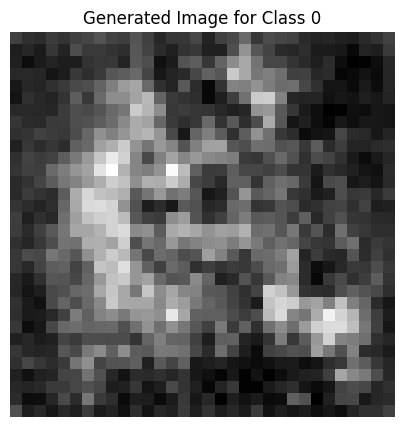

Epoch [300/2500], D_loss: 0.23925131559371948, G_loss: -0.47667375206947327


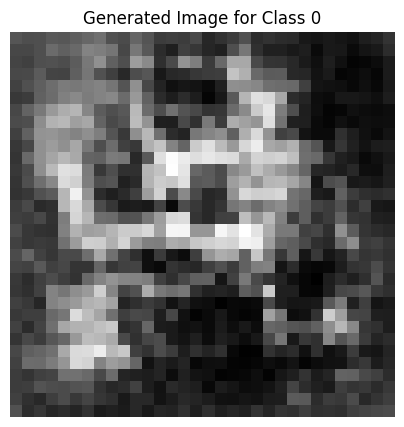

Epoch [301/2500], D_loss: 0.16265073418617249, G_loss: -0.5651177167892456


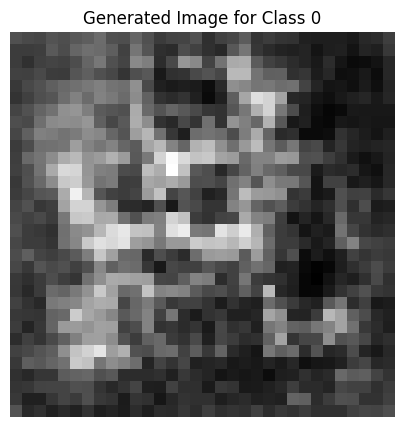

Epoch [302/2500], D_loss: 0.3177592158317566, G_loss: -0.5602651834487915


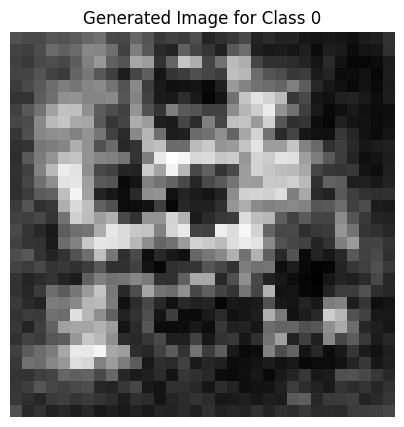

Epoch [303/2500], D_loss: 0.18554502725601196, G_loss: -0.5556408166885376


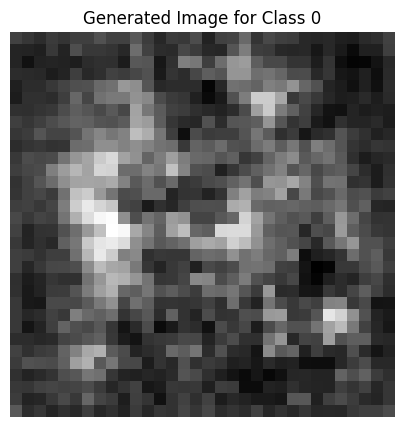

Epoch [304/2500], D_loss: 0.32591935992240906, G_loss: -0.5533407330513


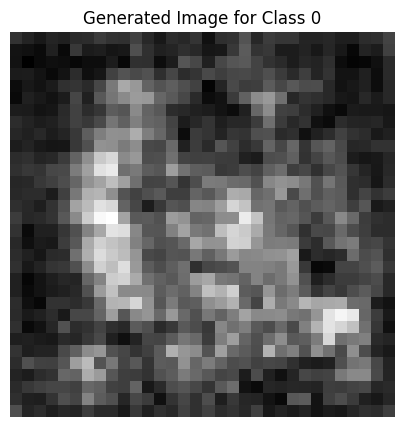

Epoch [305/2500], D_loss: 0.24570688605308533, G_loss: -0.5725163221359253


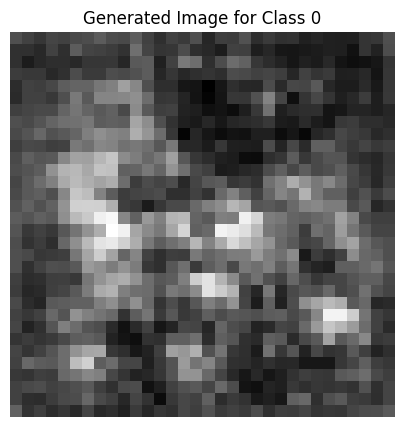

Epoch [306/2500], D_loss: 0.3191225230693817, G_loss: -0.48594051599502563


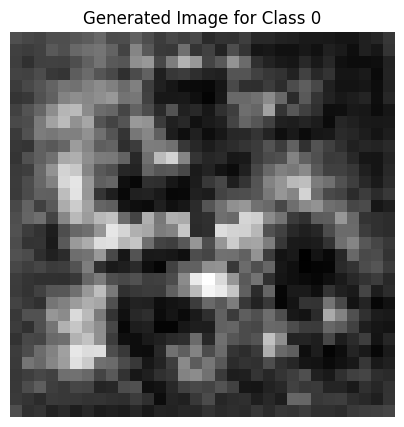

Epoch [307/2500], D_loss: 0.3088972866535187, G_loss: -0.5937085151672363


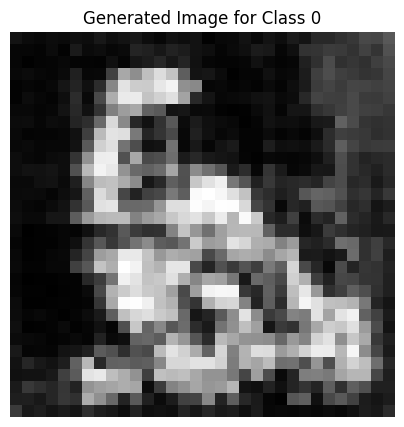

Epoch [308/2500], D_loss: 0.3019280433654785, G_loss: -0.4747386574745178


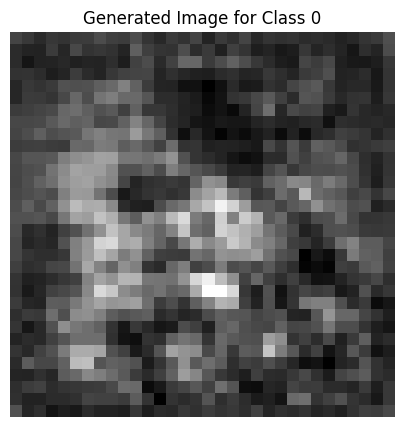

Epoch [309/2500], D_loss: 0.2987787425518036, G_loss: -0.6064653396606445


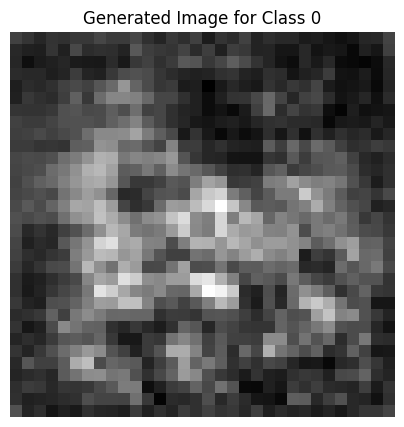

Epoch [310/2500], D_loss: 0.19220319390296936, G_loss: -0.5897602438926697


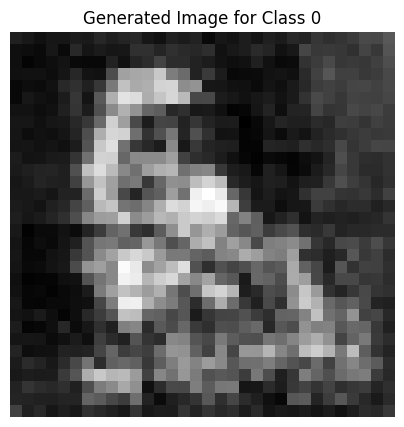

Epoch [311/2500], D_loss: 0.11809980869293213, G_loss: -0.46820658445358276


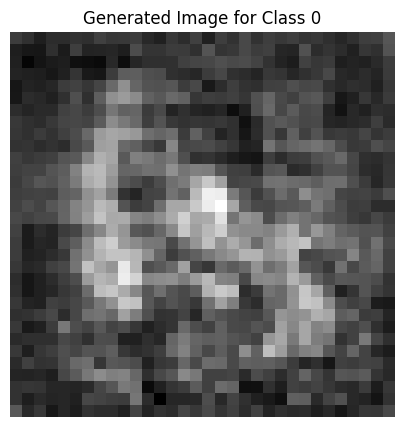

Epoch [312/2500], D_loss: 0.23830163478851318, G_loss: -0.5134388208389282


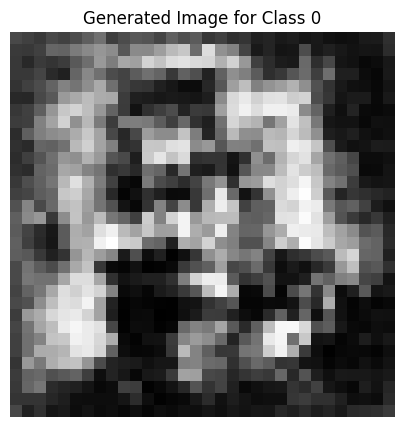

Epoch [313/2500], D_loss: 0.40490204095840454, G_loss: -0.34115803241729736


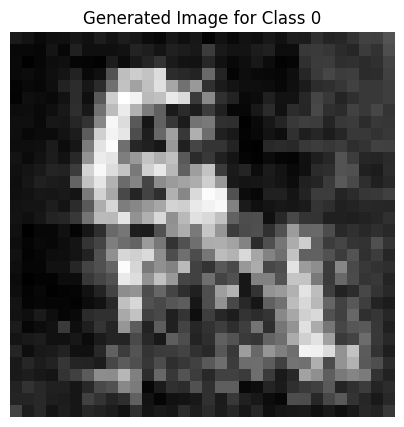

Epoch [314/2500], D_loss: 0.24573364853858948, G_loss: -0.5604466795921326


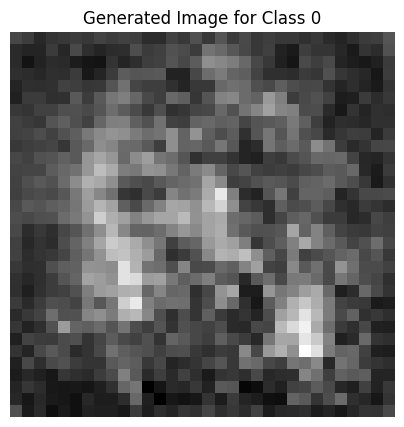

Epoch [315/2500], D_loss: 0.1741068959236145, G_loss: -0.5933272838592529


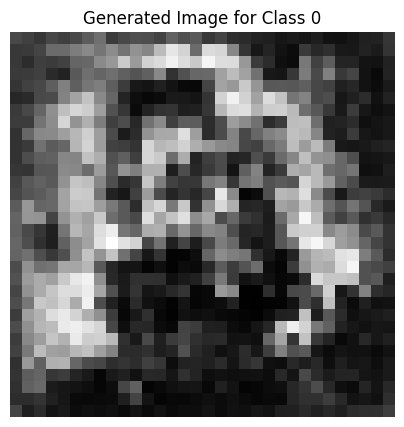

Epoch [316/2500], D_loss: 0.34746700525283813, G_loss: -0.5003200769424438


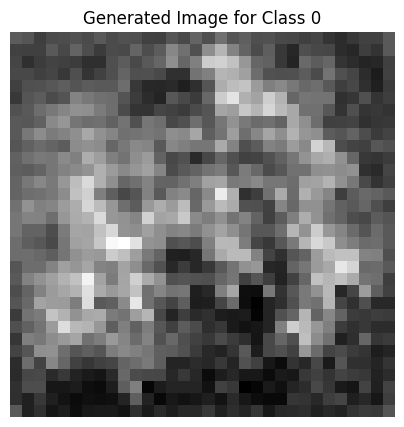

Epoch [317/2500], D_loss: 0.13526448607444763, G_loss: -0.4945310652256012


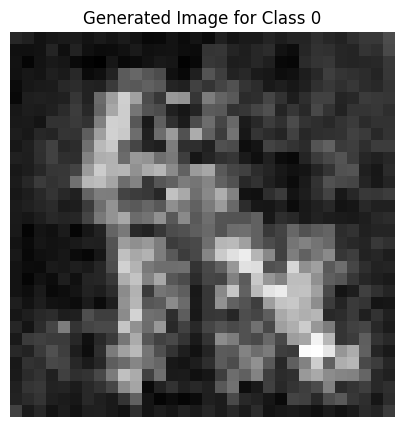

Epoch [318/2500], D_loss: 0.18939387798309326, G_loss: -0.5827220678329468


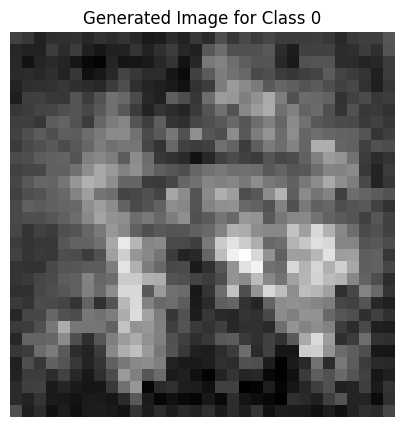

Epoch [319/2500], D_loss: 0.13208380341529846, G_loss: -0.5742639899253845


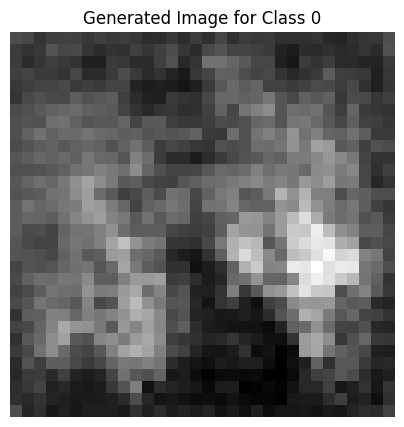

Epoch [320/2500], D_loss: 0.15341699123382568, G_loss: -0.46456092596054077


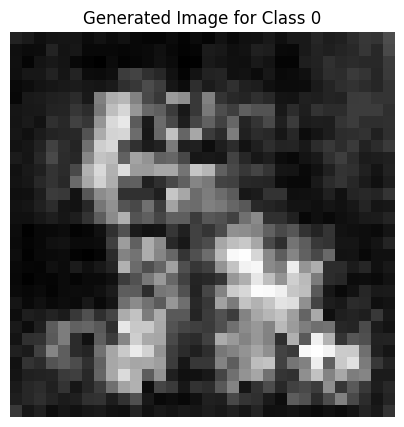

Epoch [321/2500], D_loss: 0.18148475885391235, G_loss: -0.5702369213104248


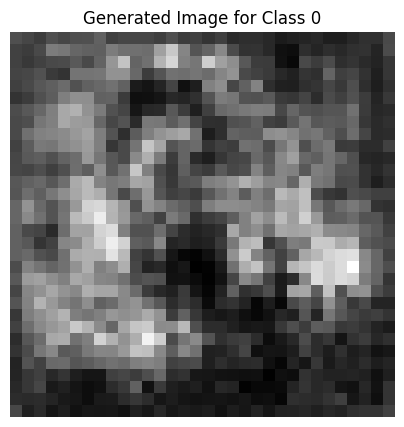

Epoch [322/2500], D_loss: 0.1660386323928833, G_loss: -0.4296821057796478


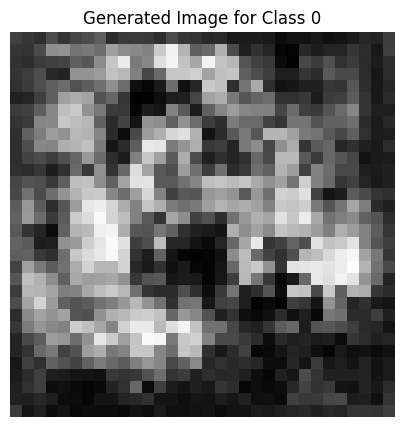

Epoch [323/2500], D_loss: 0.09896315634250641, G_loss: -0.43994998931884766


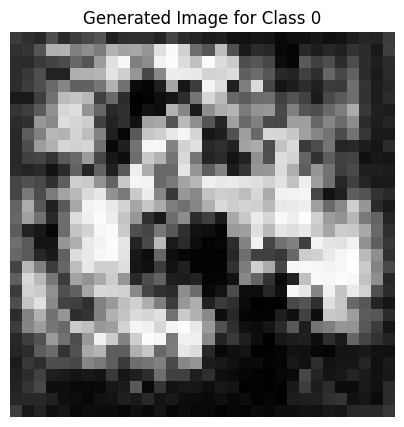

Epoch [324/2500], D_loss: 0.14598387479782104, G_loss: -0.535367488861084


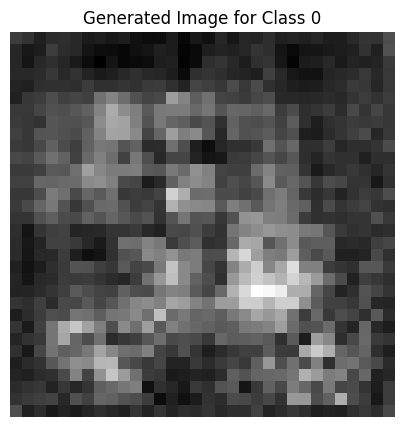

Epoch [325/2500], D_loss: 0.14330527186393738, G_loss: -0.5411759614944458


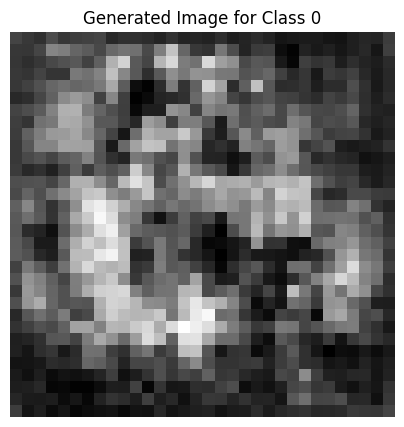

Epoch [326/2500], D_loss: 0.13257856667041779, G_loss: -0.5551266074180603


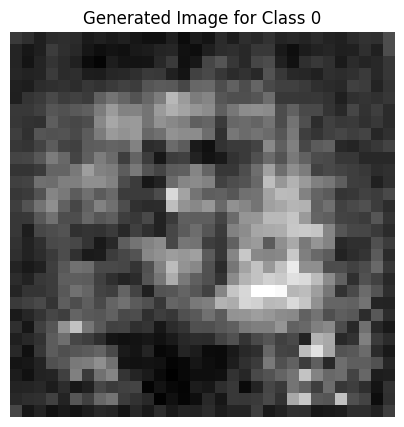

Epoch [327/2500], D_loss: 0.2940821945667267, G_loss: -0.6035873889923096


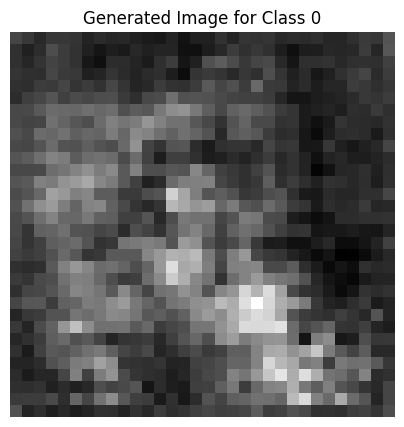

Epoch [328/2500], D_loss: 0.13813751935958862, G_loss: -0.5859325528144836


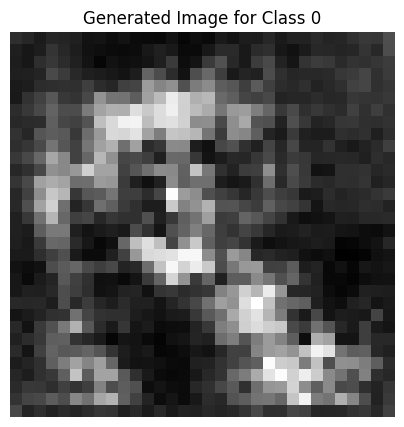

Epoch [329/2500], D_loss: 0.0984627902507782, G_loss: -0.506079912185669


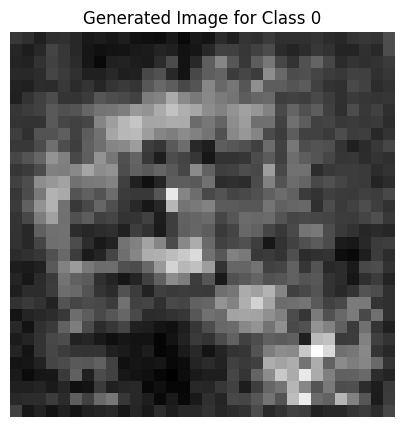

Epoch [330/2500], D_loss: 0.1924775242805481, G_loss: -0.4905303418636322


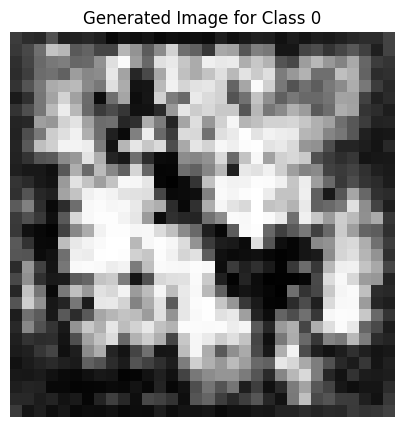

Epoch [331/2500], D_loss: 0.09687185287475586, G_loss: -0.48410022258758545


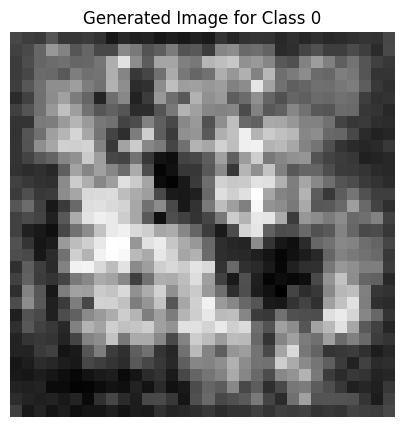

Epoch [332/2500], D_loss: 0.23012065887451172, G_loss: -0.5713627934455872


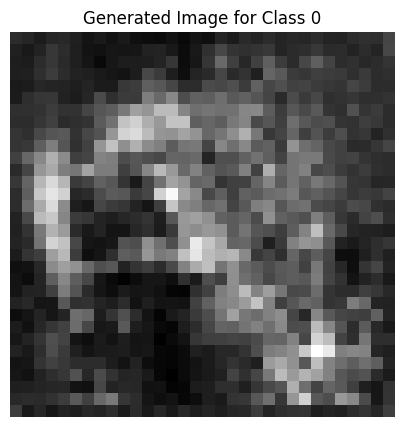

Epoch [333/2500], D_loss: 0.16410350799560547, G_loss: -0.5692436695098877


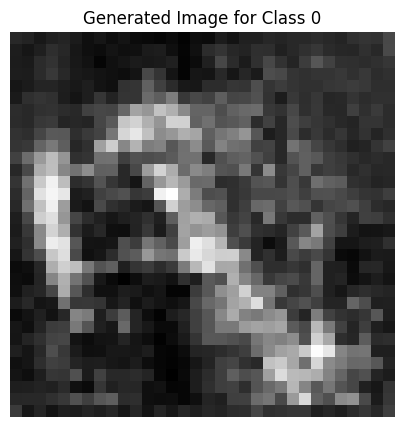

Epoch [334/2500], D_loss: 0.16790437698364258, G_loss: -0.5494316220283508


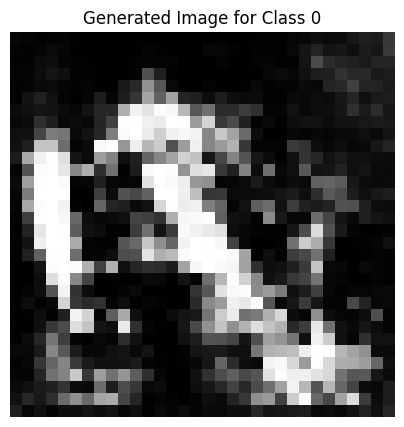

Epoch [335/2500], D_loss: 0.19392129778862, G_loss: -0.5676884651184082


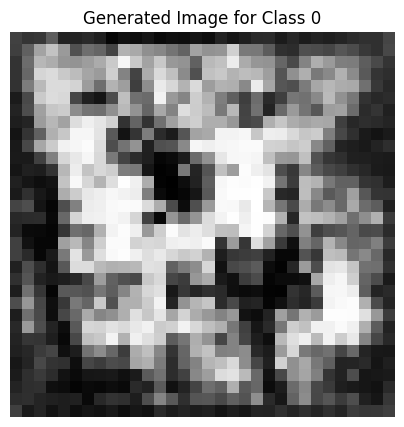

Epoch [336/2500], D_loss: 0.1645449995994568, G_loss: -0.5720889568328857


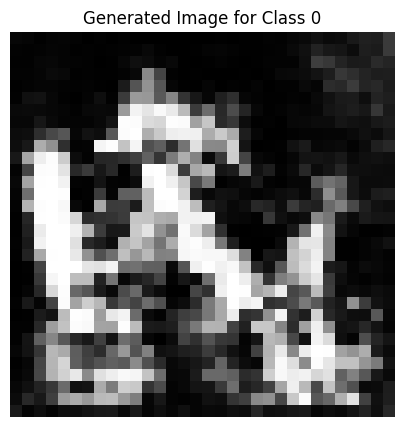

Epoch [337/2500], D_loss: 0.22758281230926514, G_loss: -0.5390216112136841


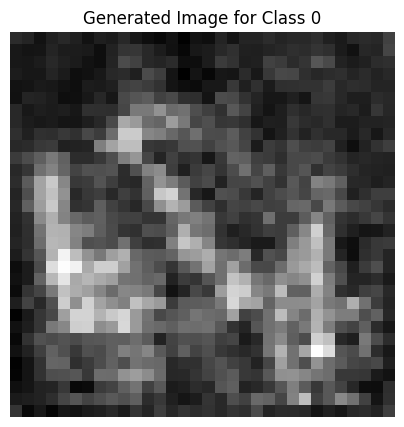

Epoch [338/2500], D_loss: 0.4280955195426941, G_loss: -0.5708193182945251


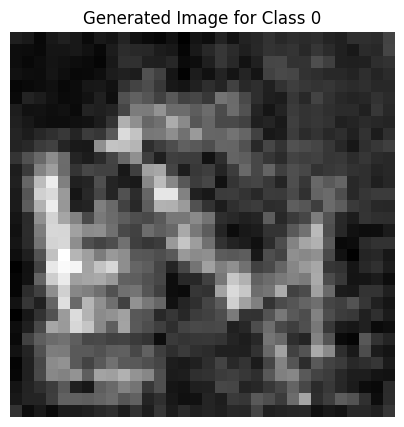

Epoch [339/2500], D_loss: 0.1047590970993042, G_loss: -0.48963305354118347


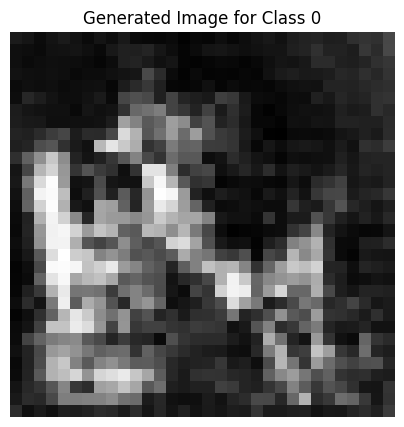

Epoch [340/2500], D_loss: 0.16594550013542175, G_loss: -0.6118905544281006


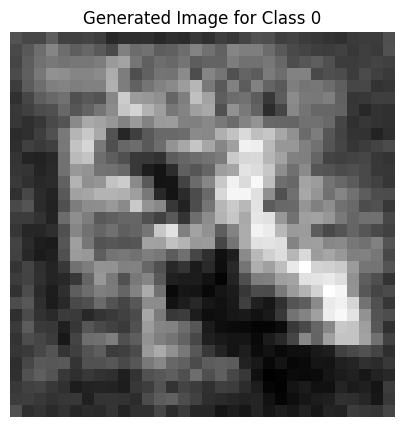

Epoch [341/2500], D_loss: 0.13161960244178772, G_loss: -0.5826025009155273


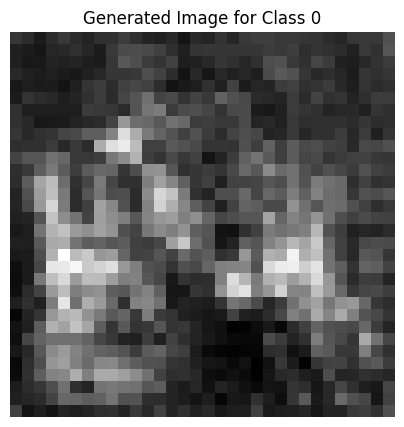

Epoch [342/2500], D_loss: 0.1064024567604065, G_loss: -0.5435301065444946


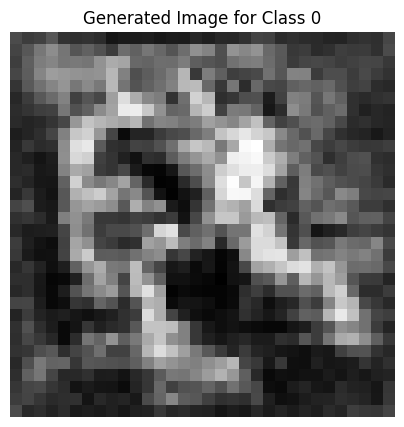

Epoch [343/2500], D_loss: 0.1223885715007782, G_loss: -0.5483713150024414


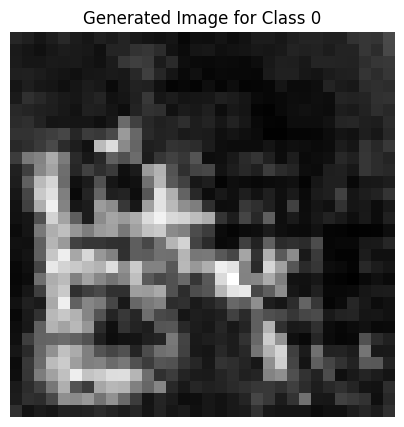

Epoch [344/2500], D_loss: 0.12473130226135254, G_loss: -0.5490734577178955


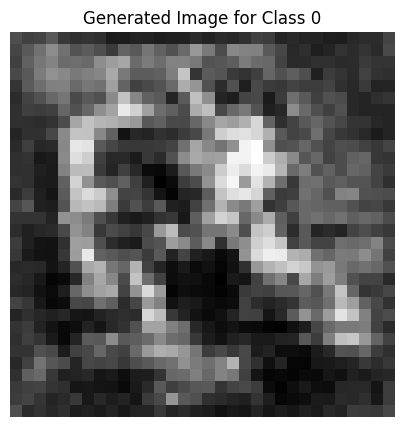

Epoch [345/2500], D_loss: 0.1093844473361969, G_loss: -0.5841245055198669


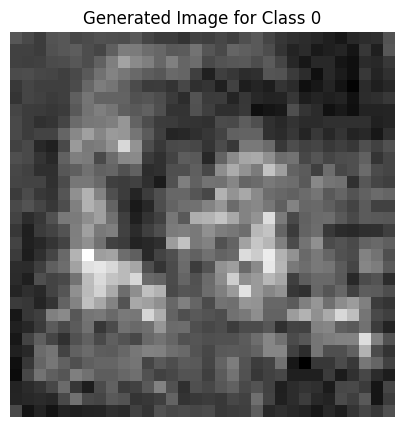

Epoch [346/2500], D_loss: 0.15711703896522522, G_loss: -0.567362904548645


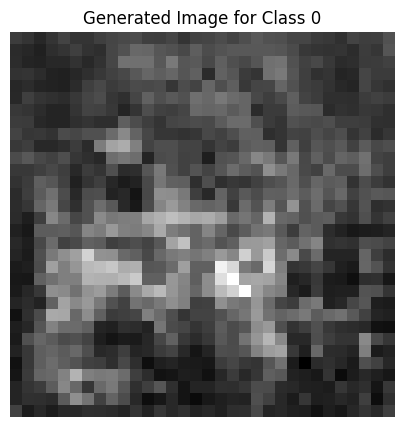

Epoch [347/2500], D_loss: 0.12048037350177765, G_loss: -0.5536100268363953


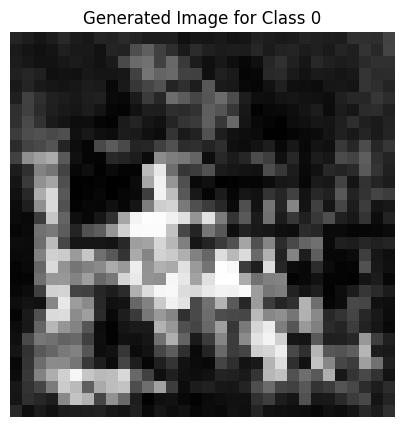

Epoch [348/2500], D_loss: 0.09097230434417725, G_loss: -0.49872100353240967


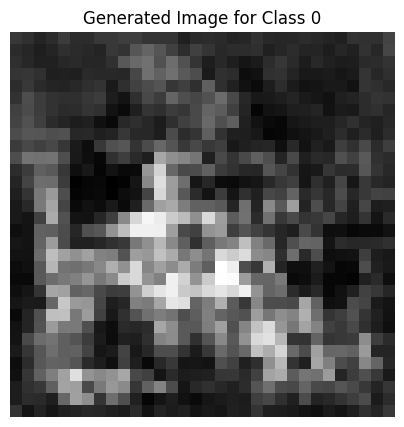

Epoch [349/2500], D_loss: 0.21431055665016174, G_loss: -0.6073274612426758


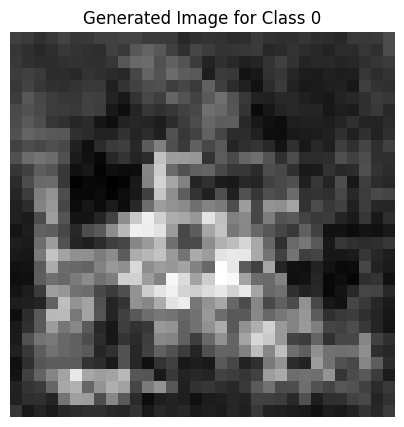

Epoch [350/2500], D_loss: 0.16607990860939026, G_loss: -0.4247285723686218


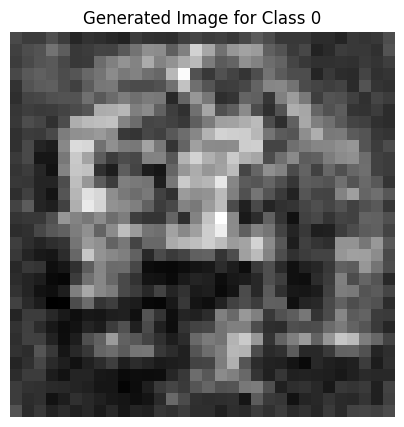

Epoch [351/2500], D_loss: 0.17588090896606445, G_loss: -0.38223040103912354


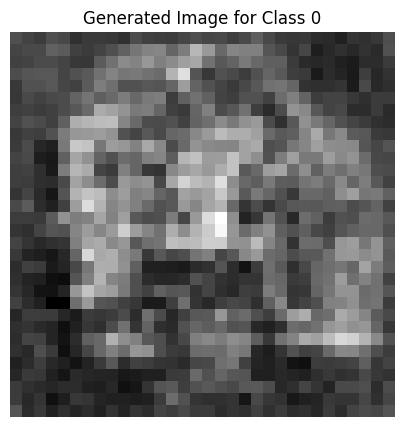

Epoch [352/2500], D_loss: 0.17918908596038818, G_loss: -0.4833853244781494


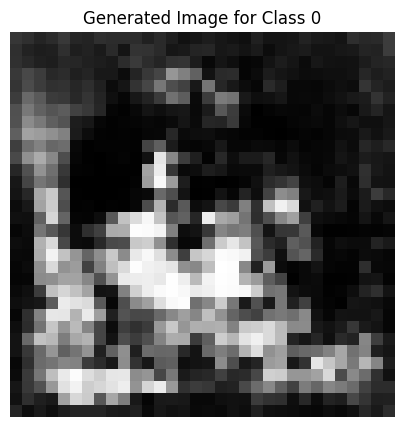

Epoch [353/2500], D_loss: 0.09343734383583069, G_loss: -0.540528416633606


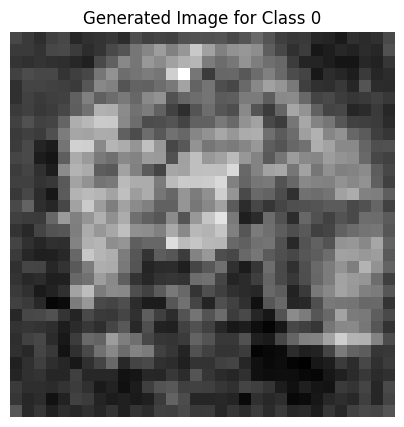

Epoch [354/2500], D_loss: 0.09201931953430176, G_loss: -0.4294741749763489


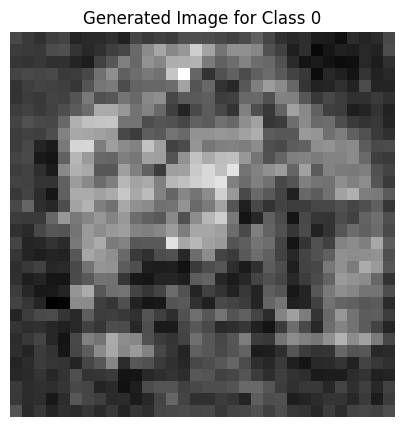

Epoch [355/2500], D_loss: 0.05788537859916687, G_loss: -0.5187802910804749


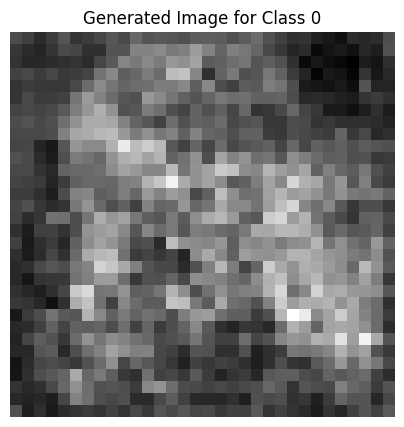

Epoch [356/2500], D_loss: 0.12502852082252502, G_loss: -0.569235622882843


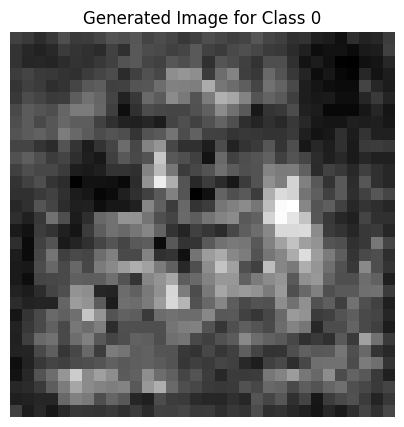

Epoch [357/2500], D_loss: 0.15589120984077454, G_loss: -0.5638098120689392


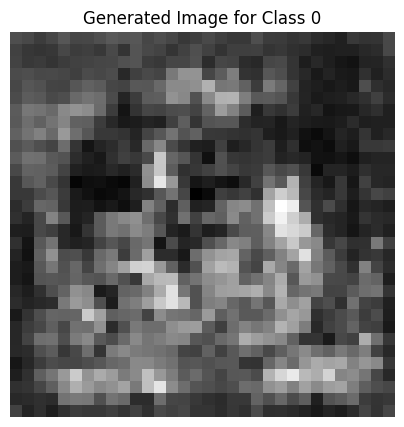

Epoch [358/2500], D_loss: 0.12038740515708923, G_loss: -0.47090697288513184


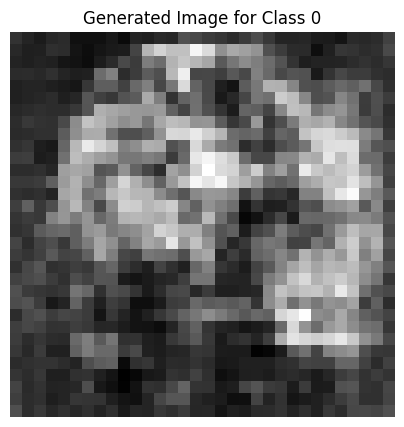

Epoch [359/2500], D_loss: 0.03603595495223999, G_loss: -0.5334181785583496


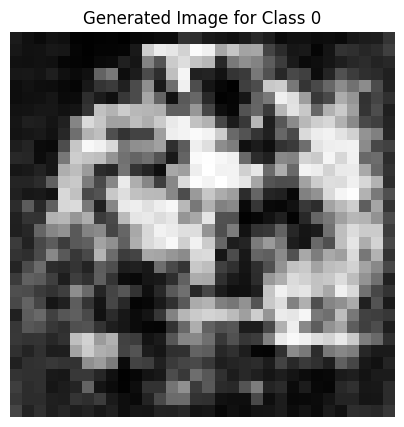

Epoch [360/2500], D_loss: 0.10387210547924042, G_loss: -0.5642211437225342


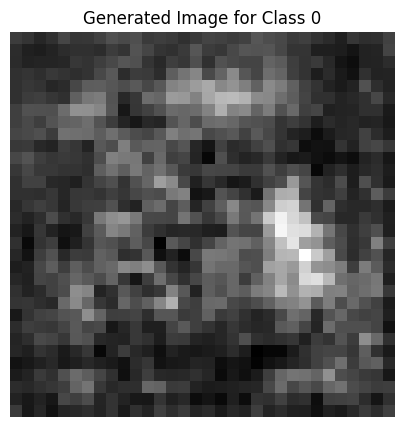

Epoch [361/2500], D_loss: 0.06283631920814514, G_loss: -0.45312586426734924


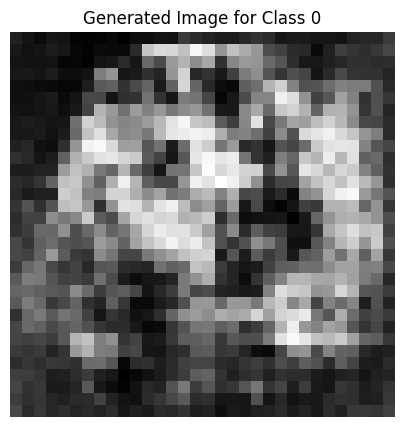

Epoch [362/2500], D_loss: 0.10097998380661011, G_loss: -0.5336518287658691


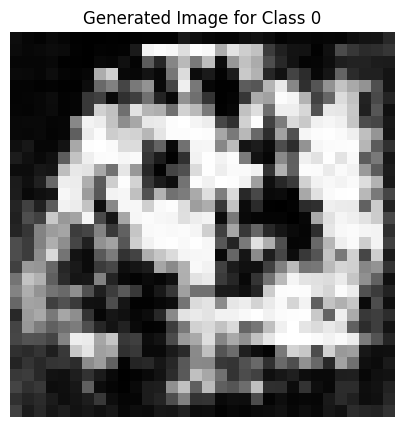

Epoch [363/2500], D_loss: 0.08969661593437195, G_loss: -0.5651460886001587


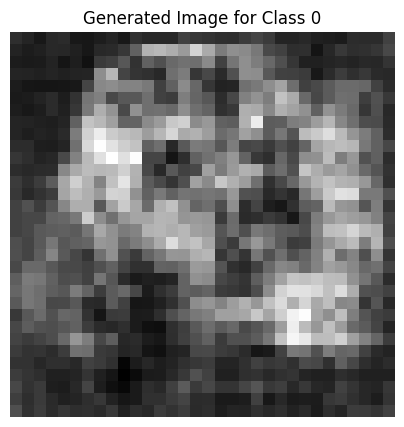

Epoch [364/2500], D_loss: 0.2638407051563263, G_loss: -0.5199811458587646


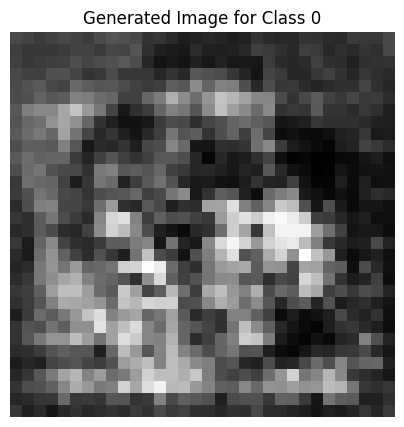

Epoch [365/2500], D_loss: 0.07246260344982147, G_loss: -0.4543094038963318


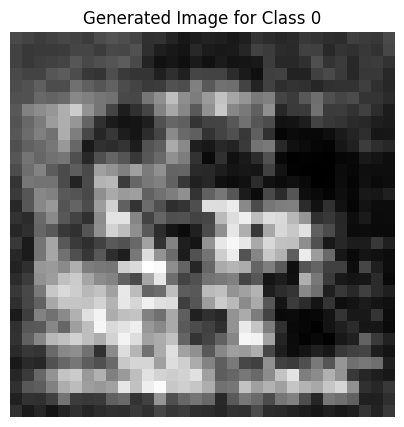

Epoch [366/2500], D_loss: 0.06836959719657898, G_loss: -0.42233040928840637


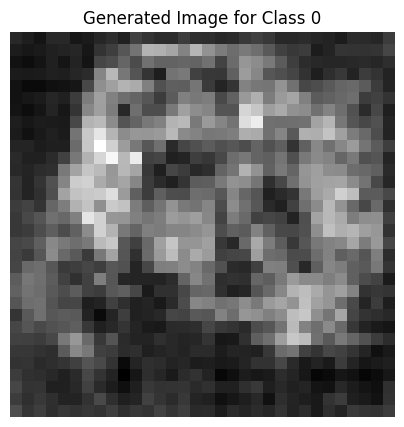

Epoch [367/2500], D_loss: 0.12488055229187012, G_loss: -0.5020071268081665


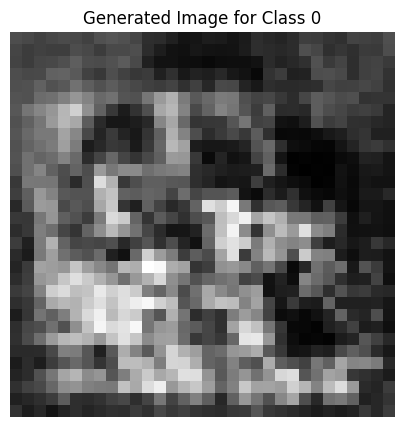

Epoch [368/2500], D_loss: 0.1249144971370697, G_loss: -0.5604137778282166


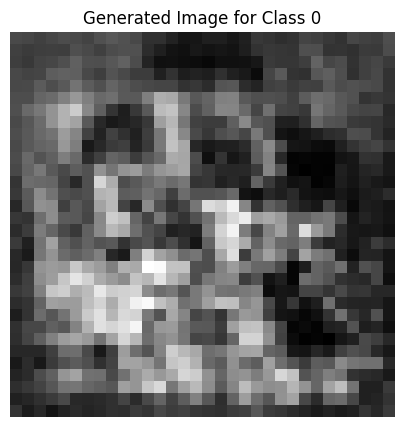

Epoch [369/2500], D_loss: 0.054350435733795166, G_loss: -0.5043529868125916


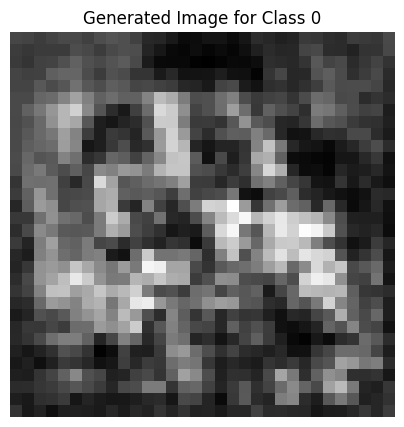

Epoch [370/2500], D_loss: 0.09978476166725159, G_loss: -0.524916410446167


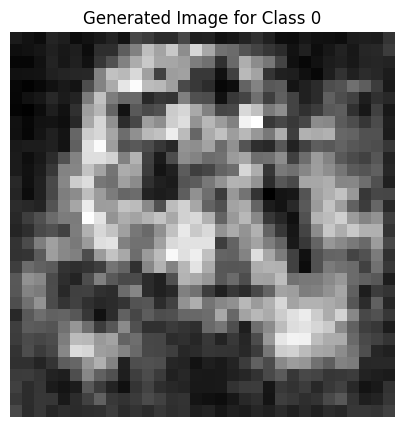

Epoch [371/2500], D_loss: 0.09879355132579803, G_loss: -0.4582262337207794


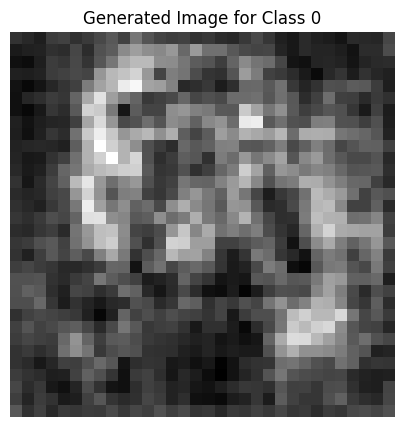

Epoch [372/2500], D_loss: 0.10385160148143768, G_loss: -0.5295732021331787


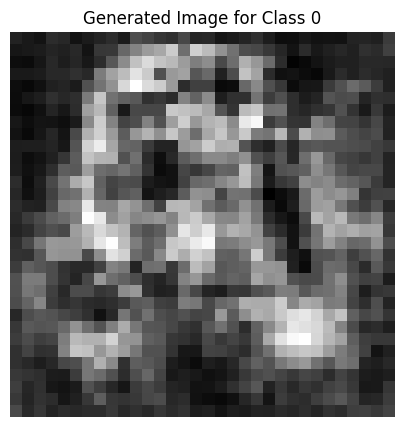

Epoch [373/2500], D_loss: 0.15920758247375488, G_loss: -0.5485179424285889


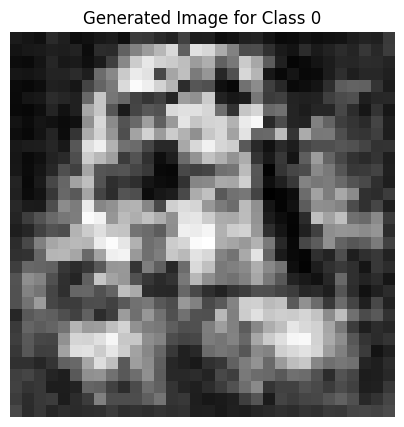

Epoch [374/2500], D_loss: 0.04624301195144653, G_loss: -0.49230051040649414


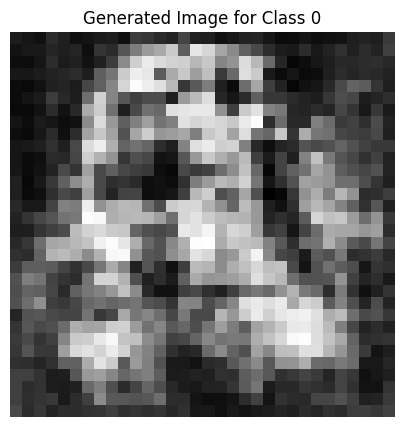

Epoch [375/2500], D_loss: 0.03856325149536133, G_loss: -0.5325291156768799


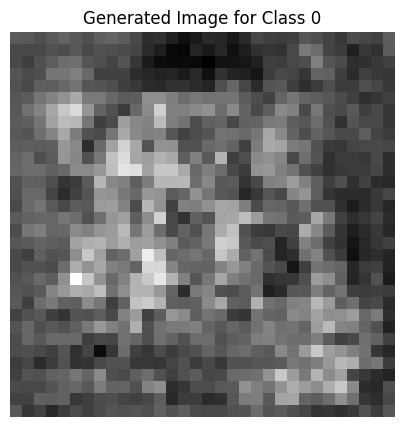

Epoch [376/2500], D_loss: 0.06998386979103088, G_loss: -0.5165843963623047


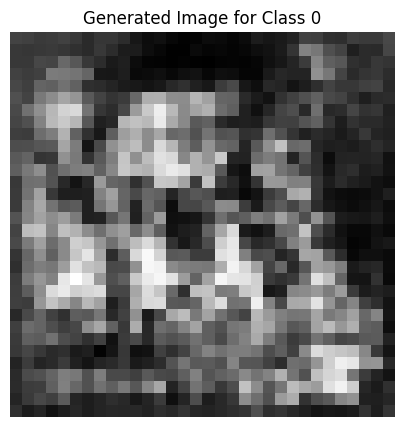

Epoch [377/2500], D_loss: 0.027217090129852295, G_loss: -0.5677509903907776


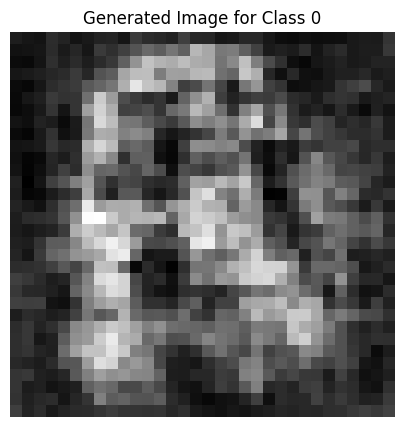

Epoch [378/2500], D_loss: 0.14564891159534454, G_loss: -0.5489535331726074


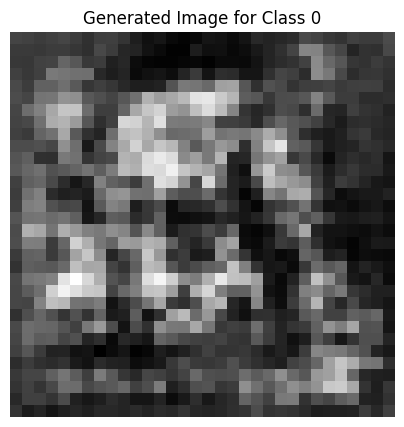

Epoch [379/2500], D_loss: 0.08146846294403076, G_loss: -0.43628472089767456


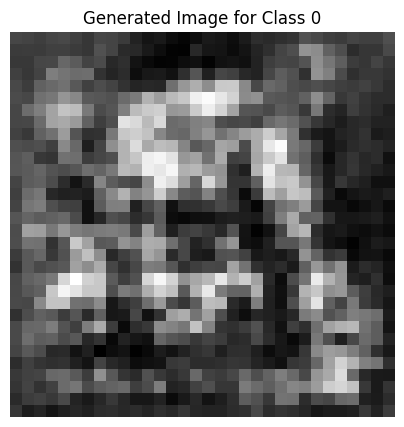

Epoch [380/2500], D_loss: 0.015506833791732788, G_loss: -0.5084525942802429


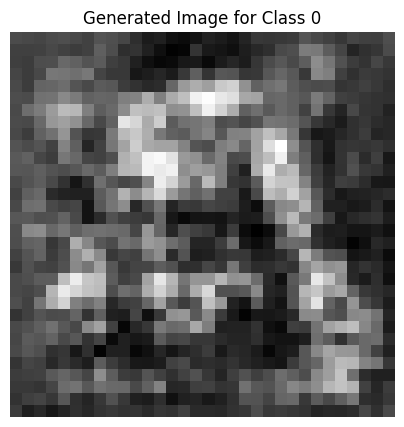

Epoch [381/2500], D_loss: 0.10307508707046509, G_loss: -0.5279607176780701


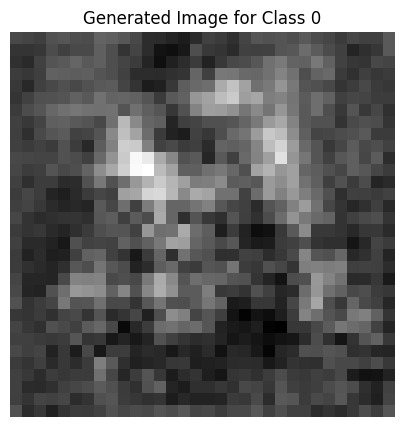

Epoch [382/2500], D_loss: -0.008993223309516907, G_loss: -0.5309373140335083


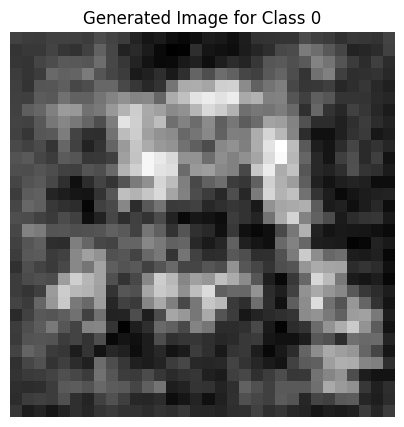

Epoch [383/2500], D_loss: 0.06951694190502167, G_loss: -0.5444823503494263


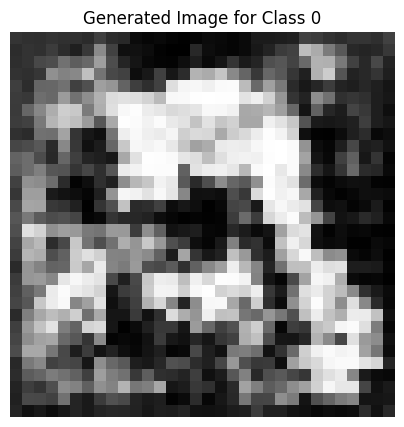

Epoch [384/2500], D_loss: 0.09209269285202026, G_loss: -0.5340750217437744


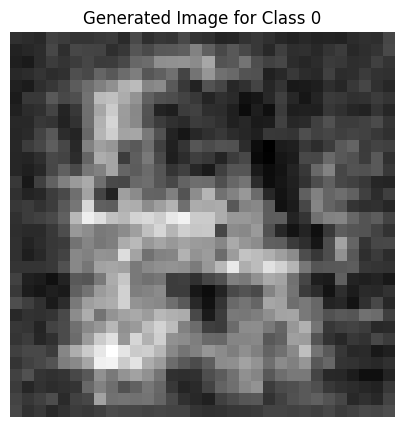

Epoch [385/2500], D_loss: 0.09737798571586609, G_loss: -0.5058192610740662


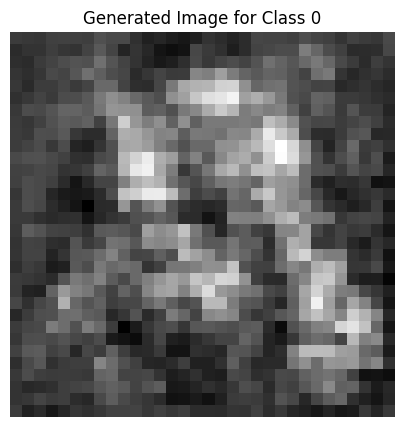

Epoch [386/2500], D_loss: 0.14801663160324097, G_loss: -0.4936016798019409


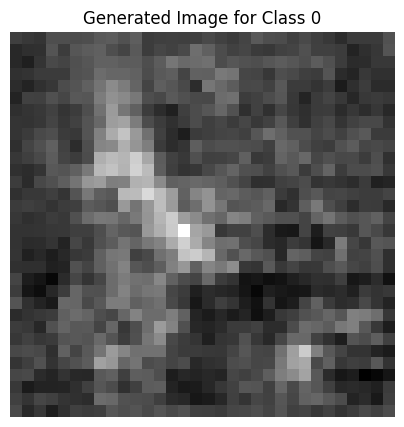

Epoch [387/2500], D_loss: -0.009454876184463501, G_loss: -0.530906081199646


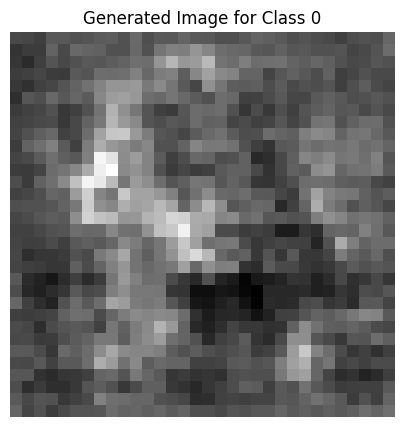

Epoch [388/2500], D_loss: 0.02206745743751526, G_loss: -0.5305991768836975


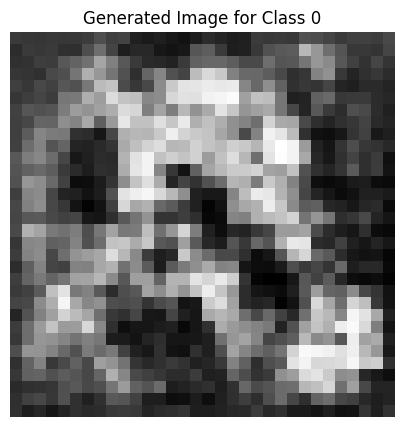

Epoch [389/2500], D_loss: 0.21255061030387878, G_loss: -0.56229567527771


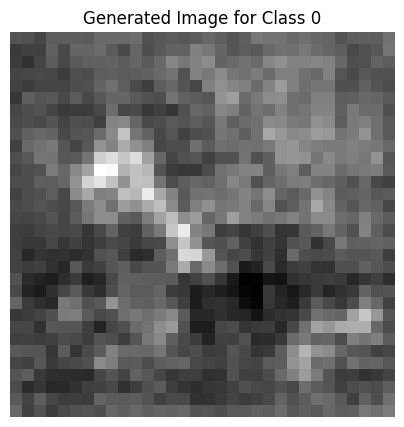

Epoch [390/2500], D_loss: 0.19976571202278137, G_loss: -0.5486292839050293


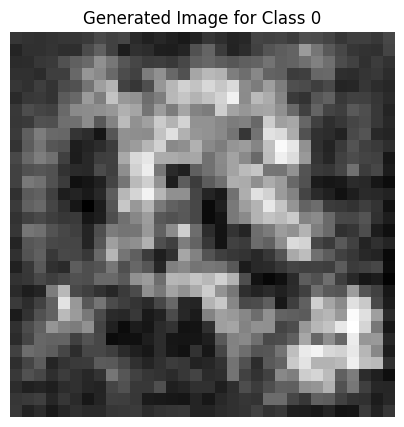

Epoch [391/2500], D_loss: 0.08461341261863708, G_loss: -0.49533477425575256


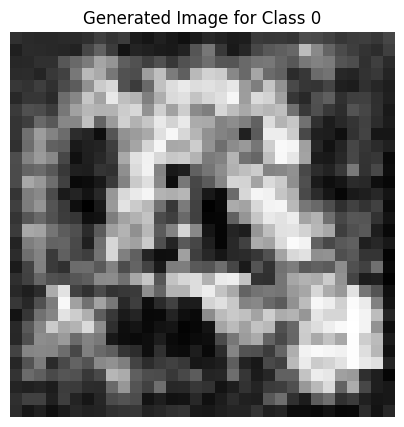

Epoch [392/2500], D_loss: 0.06694315373897552, G_loss: -0.5092244148254395


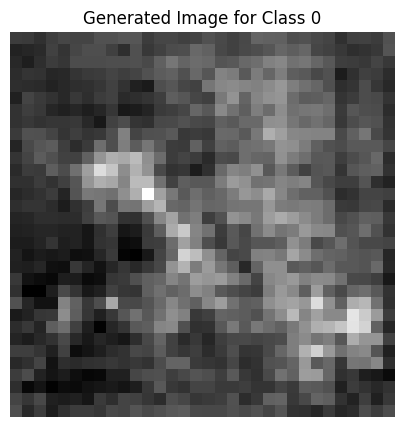

Epoch [393/2500], D_loss: 0.1729869842529297, G_loss: -0.5100809335708618


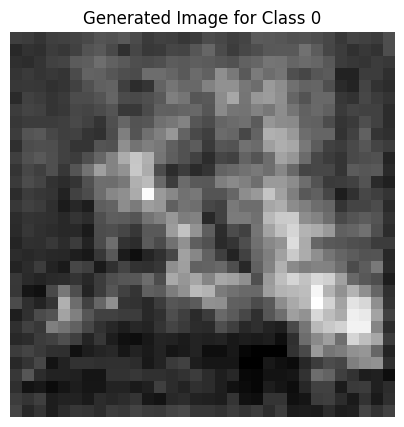

Epoch [394/2500], D_loss: 0.10456764698028564, G_loss: -0.37819409370422363


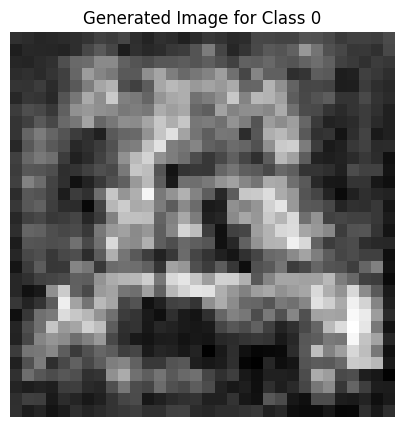

Epoch [395/2500], D_loss: 0.09776628017425537, G_loss: -0.48224565386772156


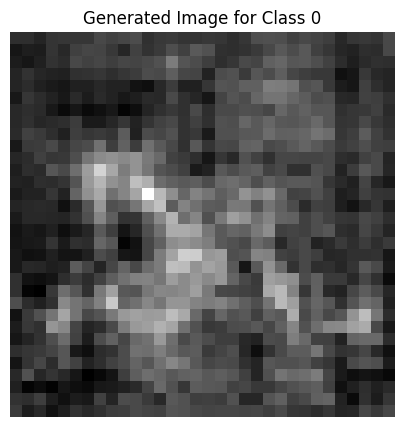

Epoch [396/2500], D_loss: 0.07961811125278473, G_loss: -0.42900773882865906


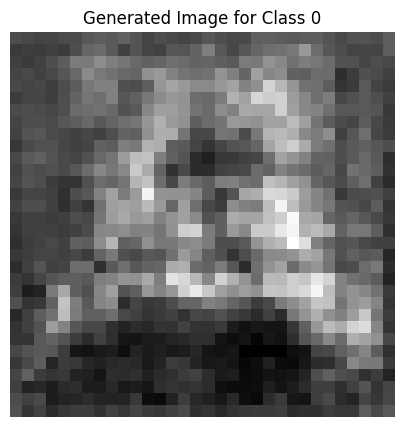

Epoch [397/2500], D_loss: 0.08968058228492737, G_loss: -0.5477518439292908


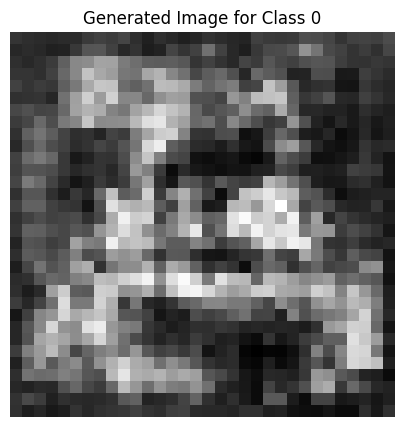

Epoch [398/2500], D_loss: -0.0035531073808670044, G_loss: -0.5194684863090515


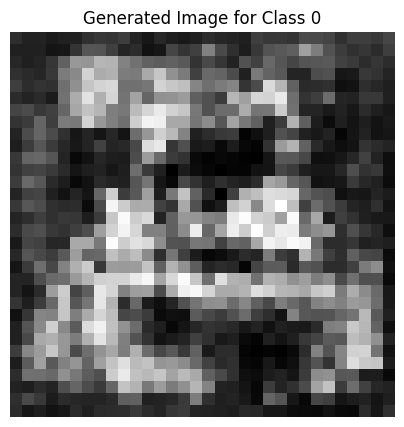

Epoch [399/2500], D_loss: 0.21614104509353638, G_loss: -0.534734845161438


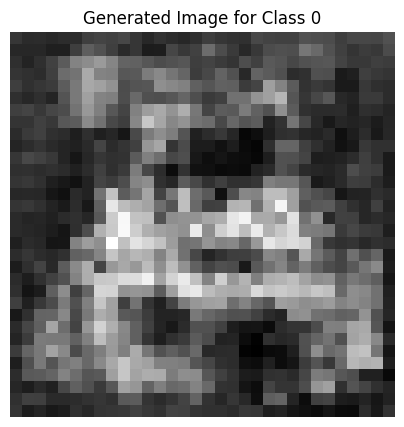

Epoch [400/2500], D_loss: 0.13417458534240723, G_loss: -0.4298626482486725


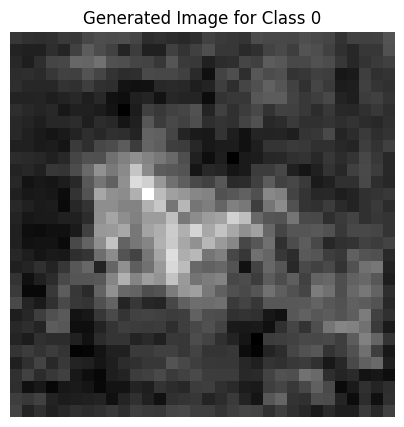

Epoch [401/2500], D_loss: 0.13275927305221558, G_loss: -0.667573869228363


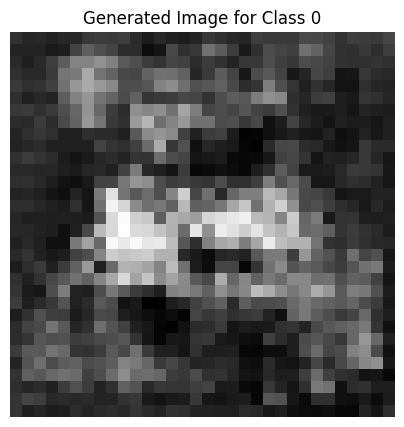

Epoch [402/2500], D_loss: 0.03648349642753601, G_loss: -0.5812326669692993


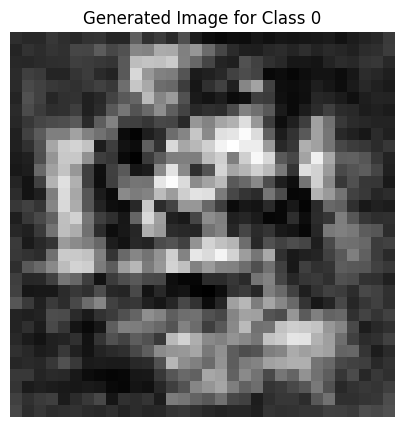

Epoch [403/2500], D_loss: 0.13560695946216583, G_loss: -0.5482801198959351


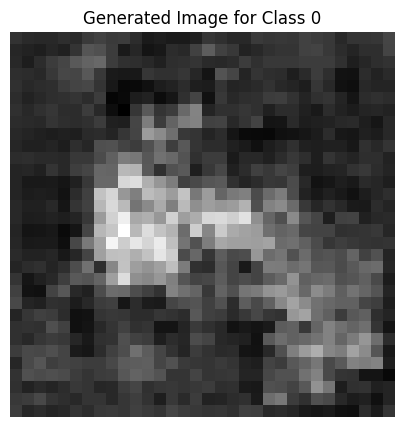

Epoch [404/2500], D_loss: 0.05041508376598358, G_loss: -0.5805022716522217


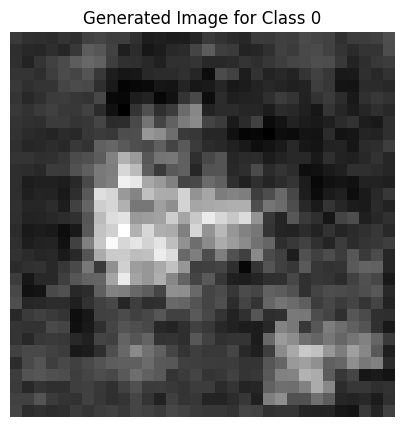

Epoch [405/2500], D_loss: 0.16529211401939392, G_loss: -0.5182746052742004


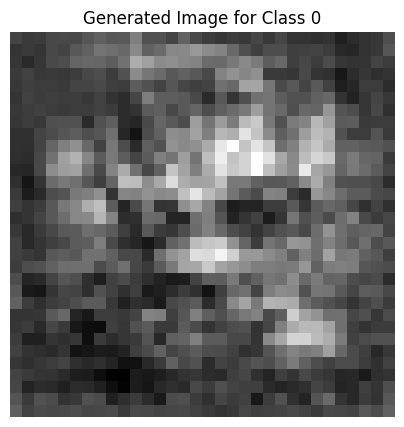

Epoch [406/2500], D_loss: 0.0686107724905014, G_loss: -0.5234026312828064


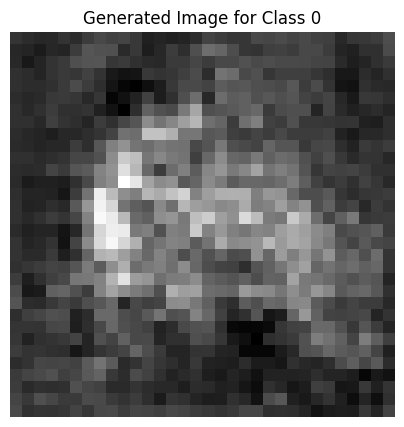

Epoch [407/2500], D_loss: -0.028043687343597412, G_loss: -0.4821676015853882


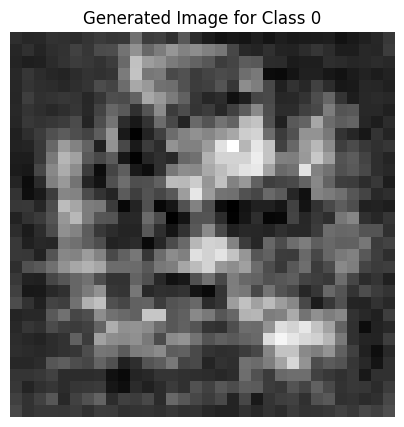

Epoch [408/2500], D_loss: 0.03499917685985565, G_loss: -0.5257724523544312


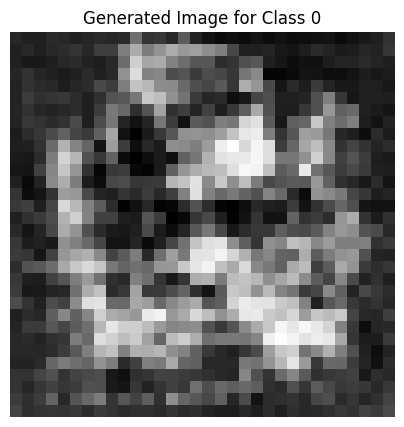

Epoch [409/2500], D_loss: 0.044562265276908875, G_loss: -0.5543326139450073


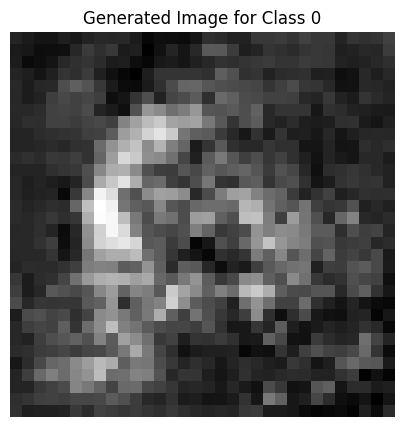

Epoch [410/2500], D_loss: 0.10211354494094849, G_loss: -0.4760240912437439


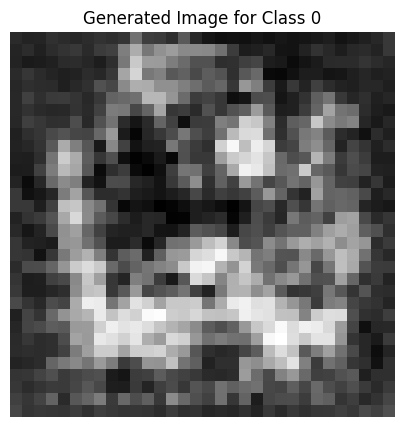

Epoch [411/2500], D_loss: -0.02249951660633087, G_loss: -0.49396294355392456


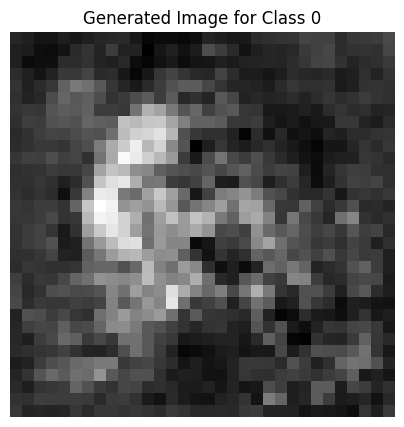

Epoch [412/2500], D_loss: 0.048302873969078064, G_loss: -0.542573869228363


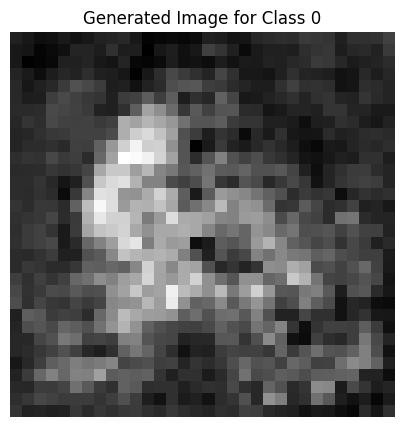

Epoch [413/2500], D_loss: 0.03504383563995361, G_loss: -0.4323817491531372


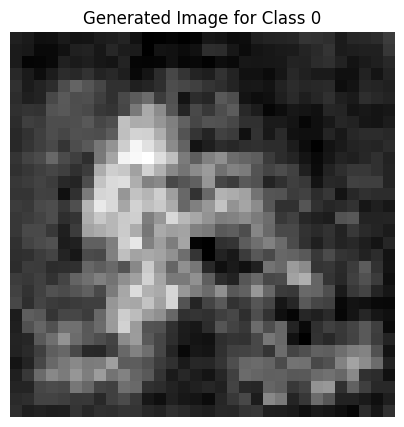

Epoch [414/2500], D_loss: 0.033325761556625366, G_loss: -0.5167864561080933


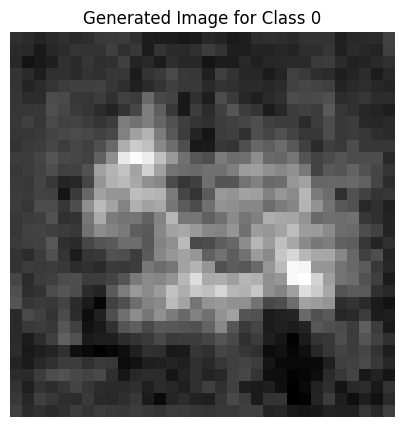

Epoch [415/2500], D_loss: 0.08541734516620636, G_loss: -0.5540429353713989


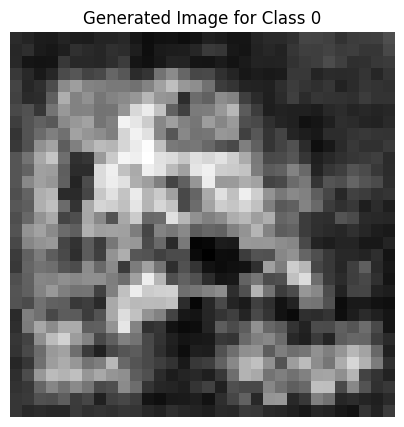

Epoch [416/2500], D_loss: 0.02703678607940674, G_loss: -0.5348950624465942


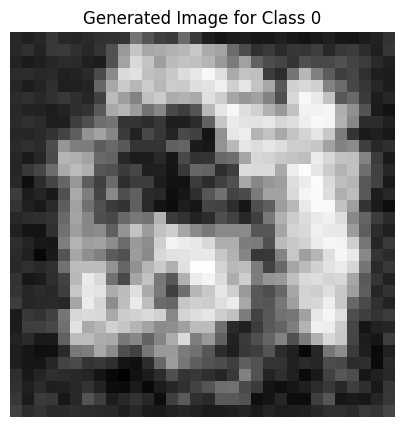

Epoch [417/2500], D_loss: -0.011337518692016602, G_loss: -0.5267624258995056


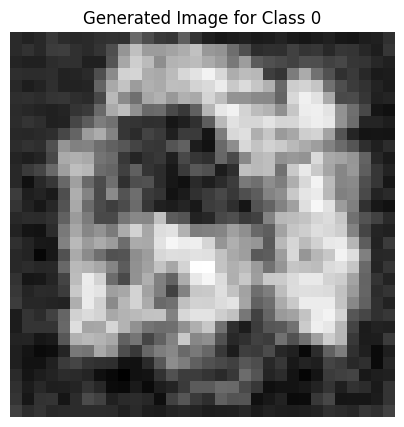

Epoch [418/2500], D_loss: 0.005335479974746704, G_loss: -0.5020484924316406


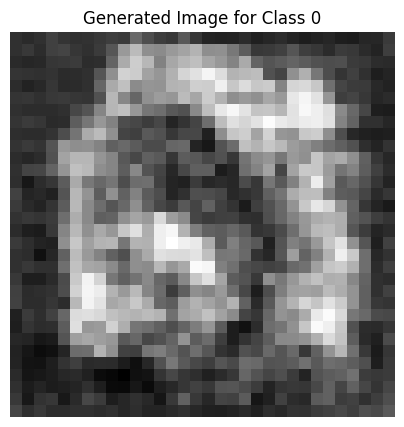

Epoch [419/2500], D_loss: 0.112514927983284, G_loss: -0.4065206050872803


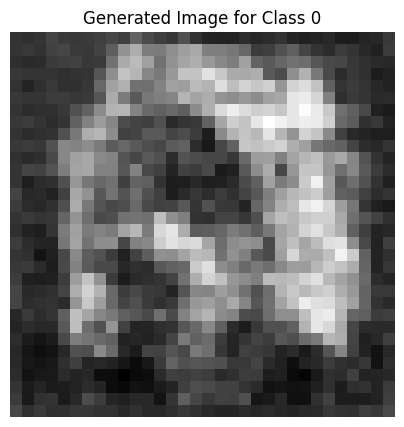

Epoch [420/2500], D_loss: 0.06991450488567352, G_loss: -0.5710253119468689


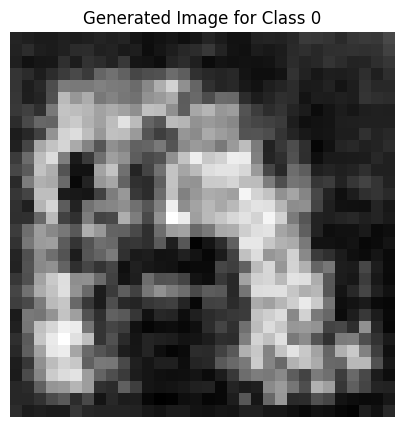

Epoch [421/2500], D_loss: 0.04558864235877991, G_loss: -0.5583075881004333


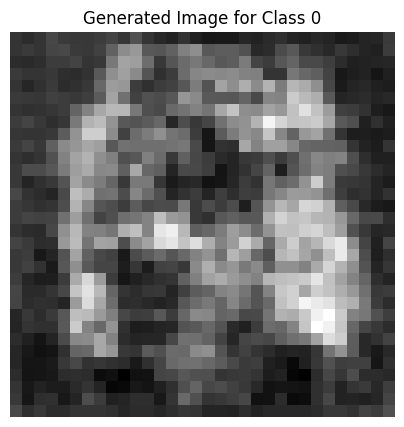

Epoch [422/2500], D_loss: 0.10353720188140869, G_loss: -0.49669086933135986


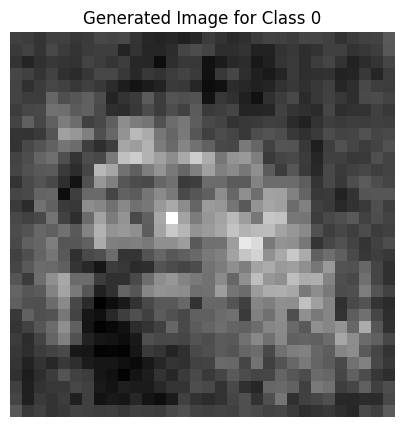

Epoch [423/2500], D_loss: 0.0020055174827575684, G_loss: -0.5526767373085022


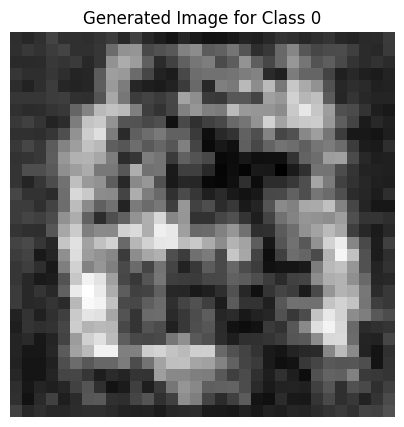

Epoch [424/2500], D_loss: 0.03794167935848236, G_loss: -0.538068950176239


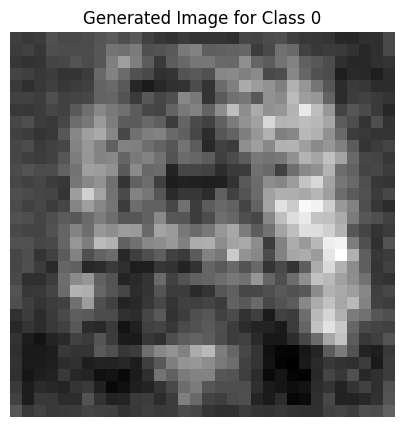

Epoch [425/2500], D_loss: -0.019249826669692993, G_loss: -0.4852946996688843


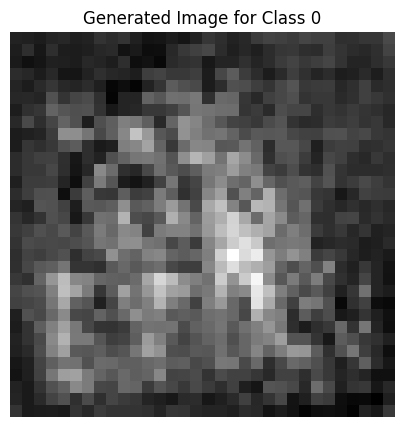

Epoch [426/2500], D_loss: 0.05656304955482483, G_loss: -0.4843604266643524


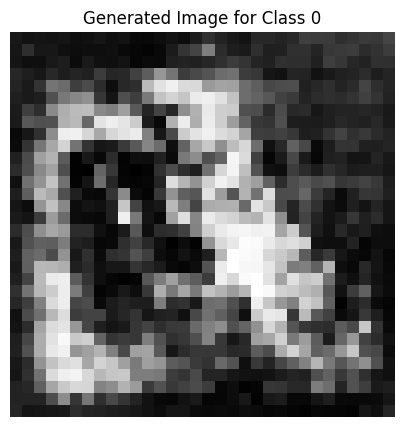

Epoch [427/2500], D_loss: -0.03456026315689087, G_loss: -0.5386136770248413


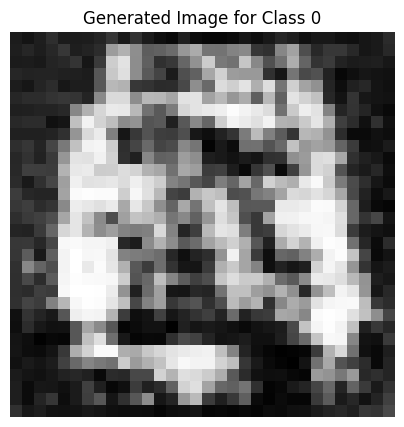

Epoch [428/2500], D_loss: 0.04226906597614288, G_loss: -0.4813982844352722


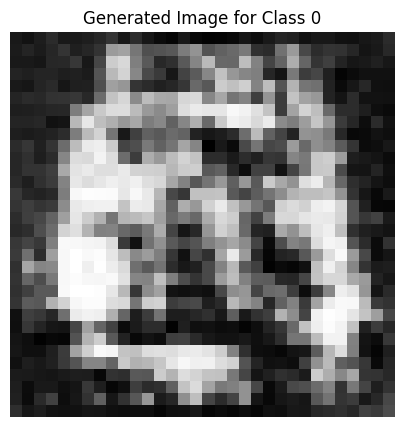

Epoch [429/2500], D_loss: -0.0004946142435073853, G_loss: -0.5588196516036987


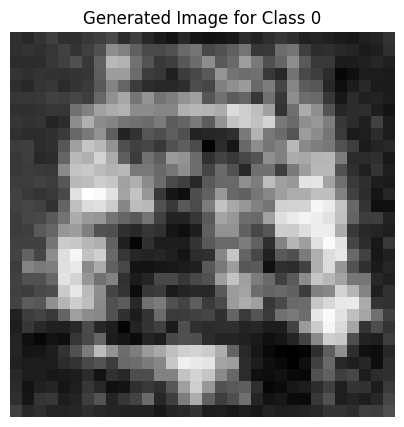

Epoch [430/2500], D_loss: -0.05430611968040466, G_loss: -0.4206916093826294


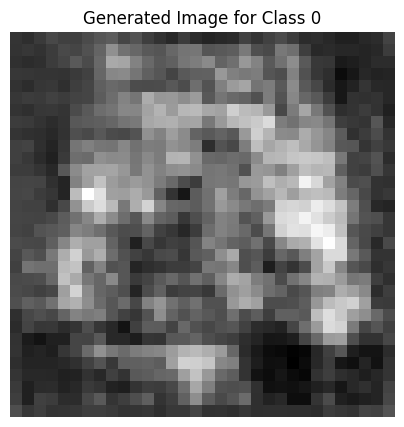

Epoch [431/2500], D_loss: 0.05249777436256409, G_loss: -0.4906415641307831


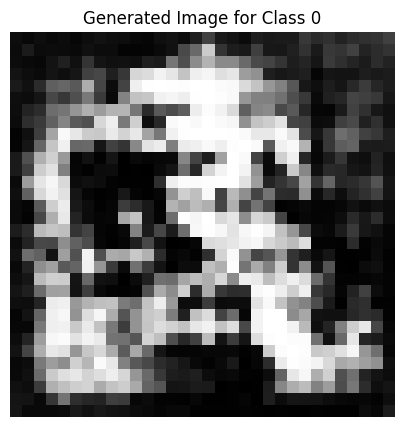

Epoch [432/2500], D_loss: -0.01594434678554535, G_loss: -0.5110612511634827


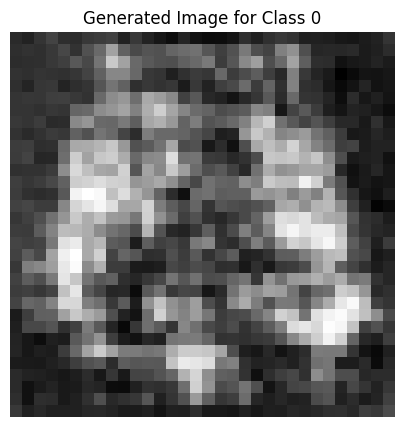

Epoch [433/2500], D_loss: 0.012268126010894775, G_loss: -0.47303882241249084


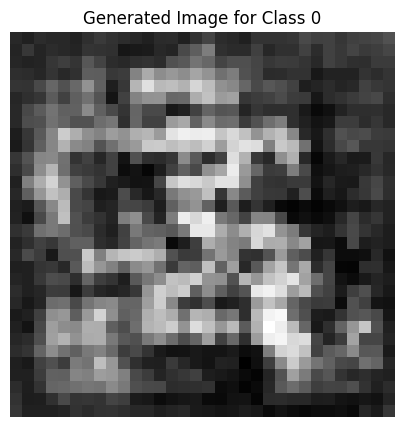

Epoch [434/2500], D_loss: 0.02738398313522339, G_loss: -0.517401397228241


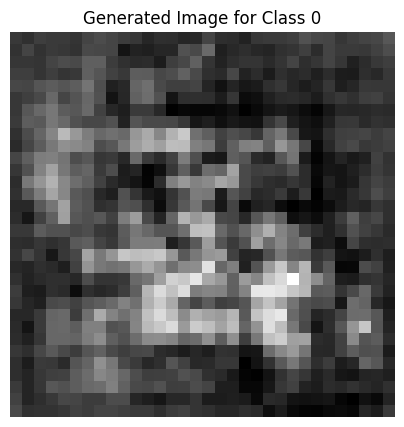

Epoch [435/2500], D_loss: -0.01680275797843933, G_loss: -0.5069013833999634


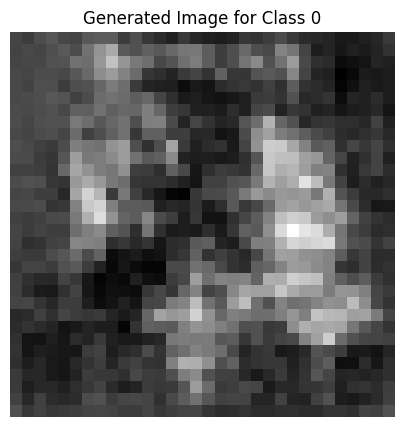

Epoch [436/2500], D_loss: 0.010020077228546143, G_loss: -0.5317755937576294


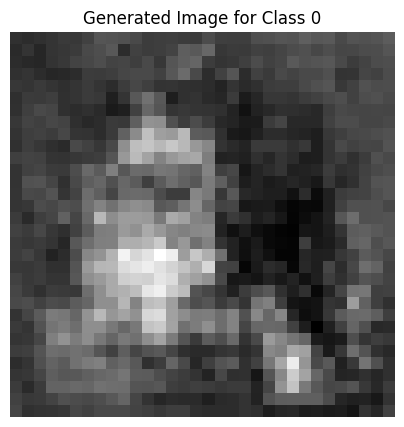

Epoch [437/2500], D_loss: 0.04191119968891144, G_loss: -0.5518697500228882


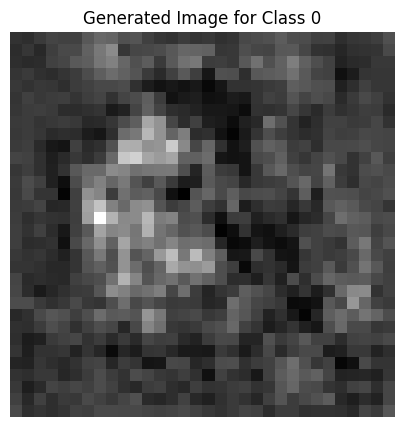

Epoch [438/2500], D_loss: 0.10863888263702393, G_loss: -0.5589561462402344


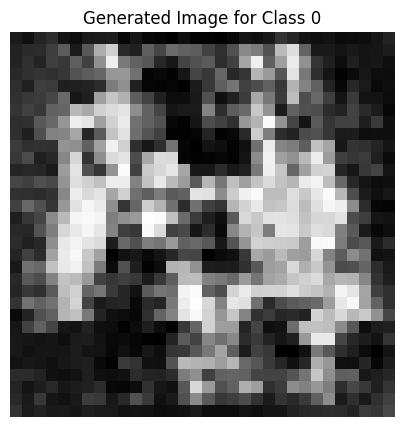

Epoch [439/2500], D_loss: 0.04148662090301514, G_loss: -0.4840905964374542


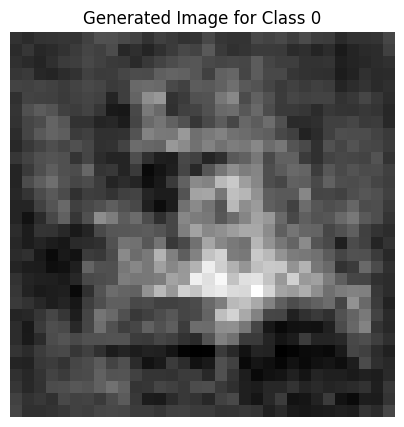

Epoch [440/2500], D_loss: 0.021382182836532593, G_loss: -0.4786488115787506


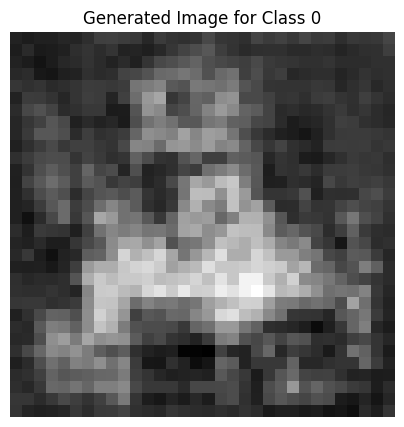

Epoch [441/2500], D_loss: 0.05902348458766937, G_loss: -0.46898818016052246


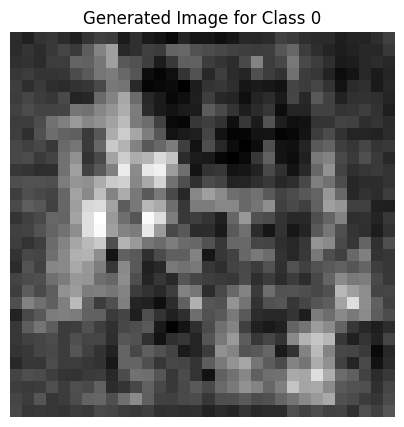

Epoch [442/2500], D_loss: 0.028651505708694458, G_loss: -0.44066178798675537


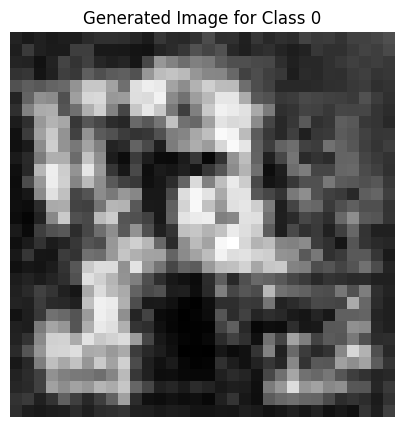

Epoch [443/2500], D_loss: -0.0007830411195755005, G_loss: -0.5275437235832214


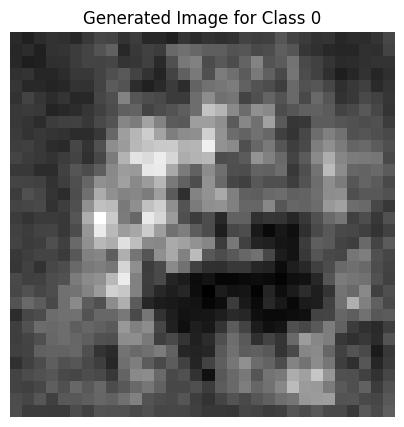

Epoch [444/2500], D_loss: 0.1102648377418518, G_loss: -0.4724811613559723


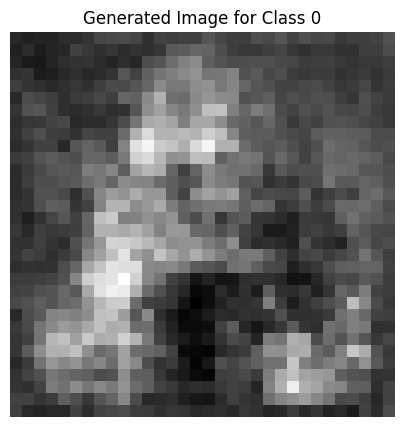

Epoch [445/2500], D_loss: -0.009638875722885132, G_loss: -0.5152204632759094


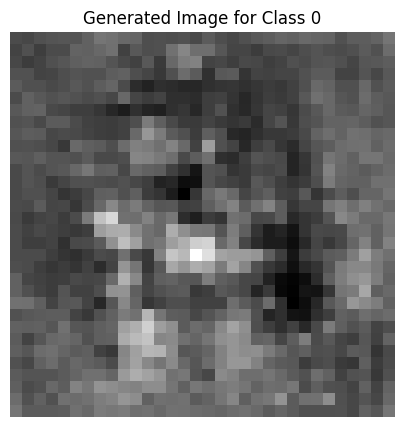

Epoch [446/2500], D_loss: 0.11606967449188232, G_loss: -0.4963834285736084


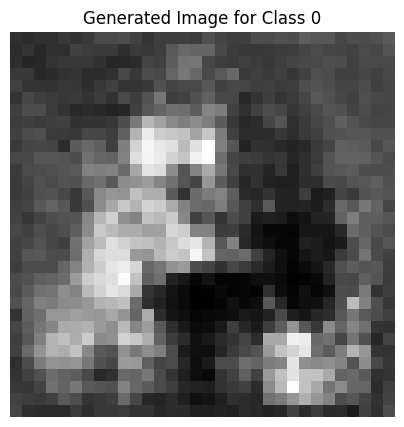

Epoch [447/2500], D_loss: 0.024430200457572937, G_loss: -0.5260839462280273


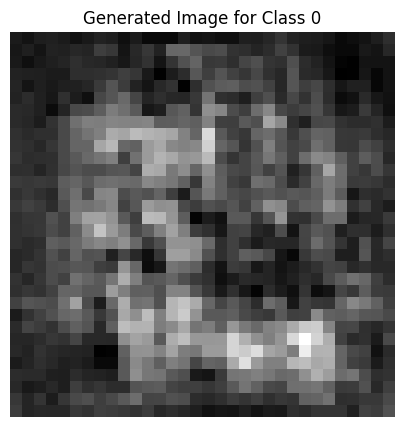

Epoch [448/2500], D_loss: 0.11860361695289612, G_loss: -0.465386301279068


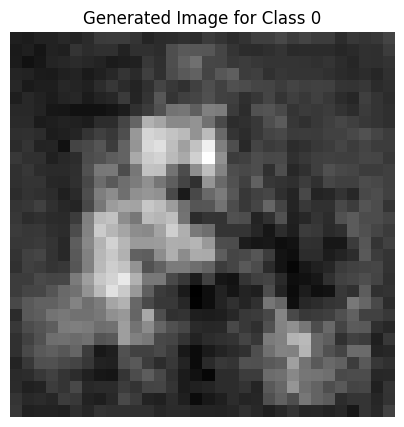

Epoch [449/2500], D_loss: 0.0374167263507843, G_loss: -0.5613793134689331


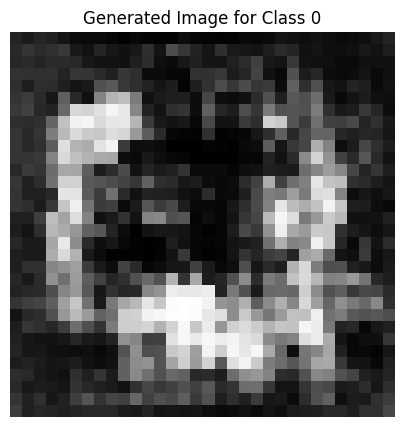

Epoch [450/2500], D_loss: -0.05931982398033142, G_loss: -0.47270840406417847


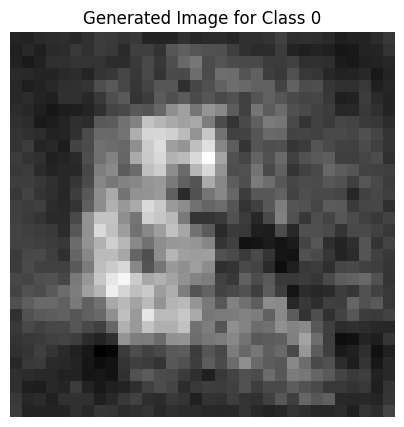

Epoch [451/2500], D_loss: -0.03846906125545502, G_loss: -0.5767590999603271


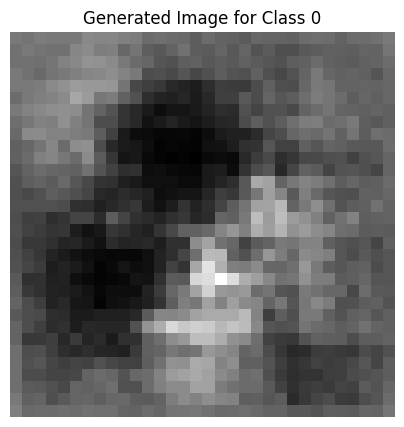

Epoch [452/2500], D_loss: 0.23054322600364685, G_loss: -0.5422502756118774


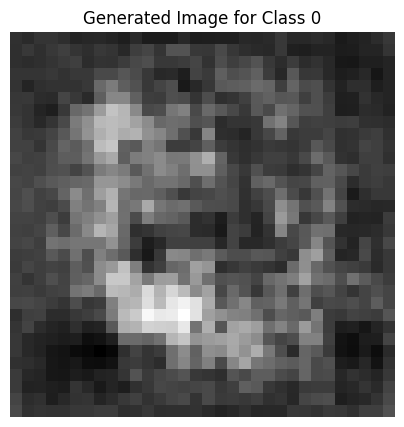

Epoch [453/2500], D_loss: 0.018673360347747803, G_loss: -0.5343502759933472


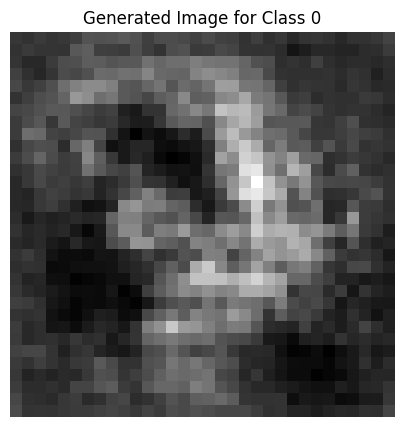

Epoch [454/2500], D_loss: -0.05741944909095764, G_loss: -0.5055975914001465


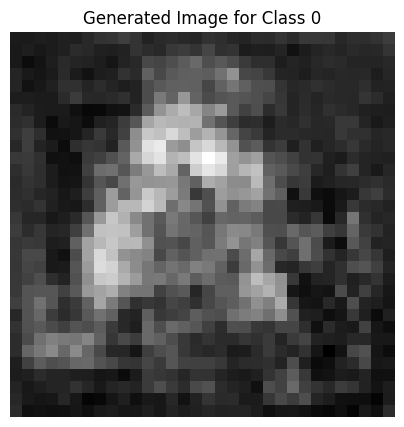

Epoch [455/2500], D_loss: 0.08047792315483093, G_loss: -0.48881176114082336


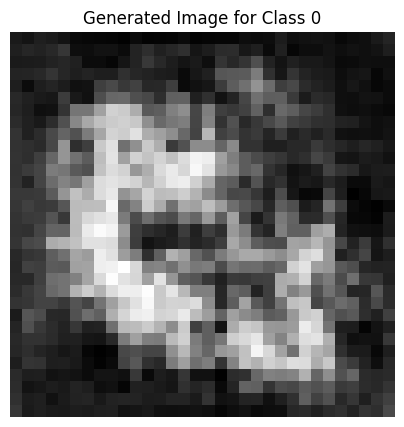

Epoch [456/2500], D_loss: 0.012425094842910767, G_loss: -0.5146380662918091


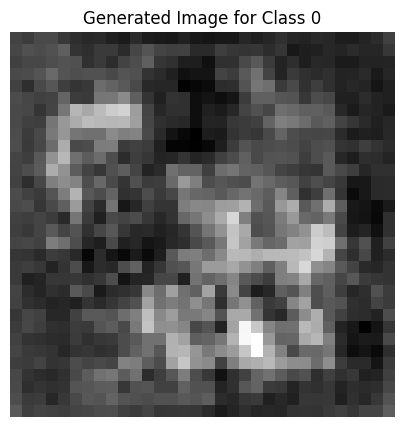

Epoch [457/2500], D_loss: 0.03185397386550903, G_loss: -0.4282875061035156


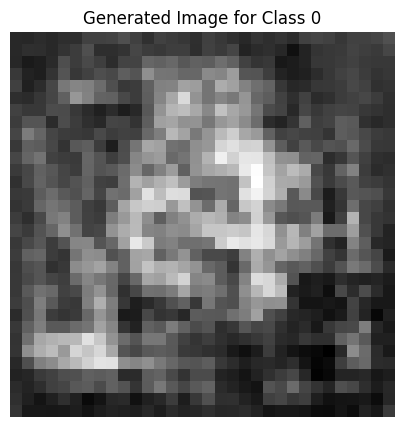

Epoch [458/2500], D_loss: 0.019755616784095764, G_loss: -0.42014241218566895


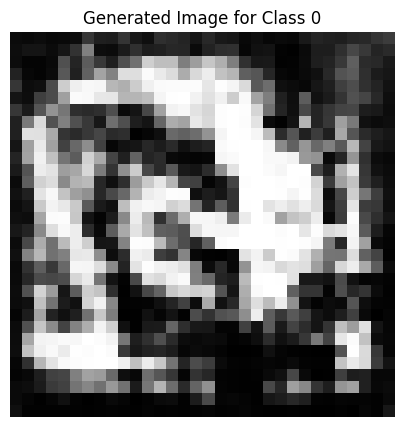

Epoch [459/2500], D_loss: 0.006537154316902161, G_loss: -0.47647958993911743


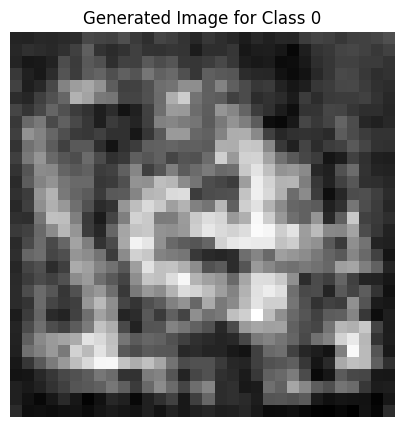

Epoch [460/2500], D_loss: 0.06656016409397125, G_loss: -0.5779205560684204


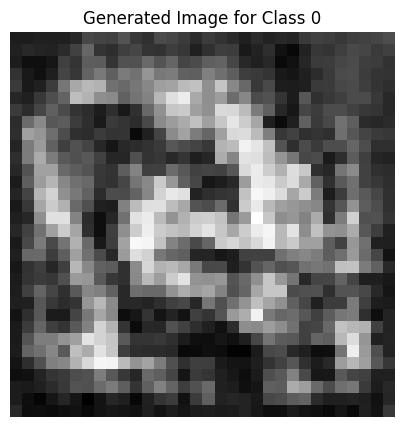

Epoch [461/2500], D_loss: -0.005119264125823975, G_loss: -0.5691531896591187


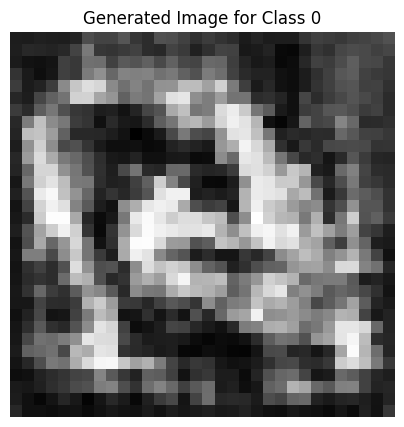

Epoch [462/2500], D_loss: 0.0359019935131073, G_loss: -0.5487815737724304


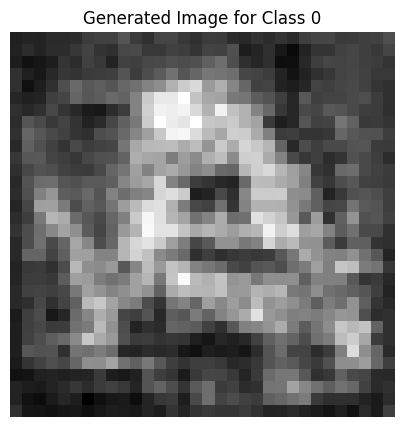

Epoch [463/2500], D_loss: 0.0035342127084732056, G_loss: -0.4192425012588501


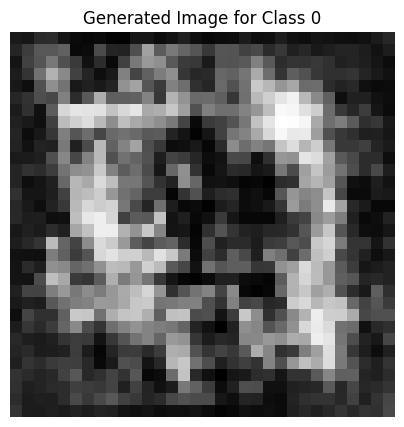

Epoch [464/2500], D_loss: -0.040927574038505554, G_loss: -0.5279262065887451


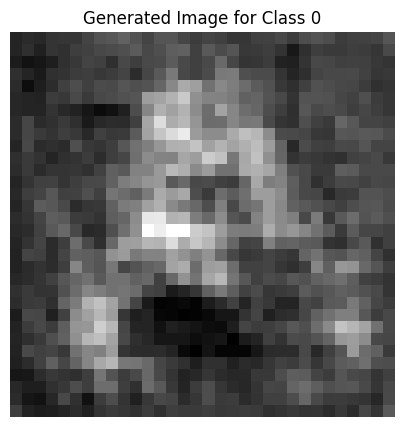

Epoch [465/2500], D_loss: 0.023166075348854065, G_loss: -0.5219219923019409


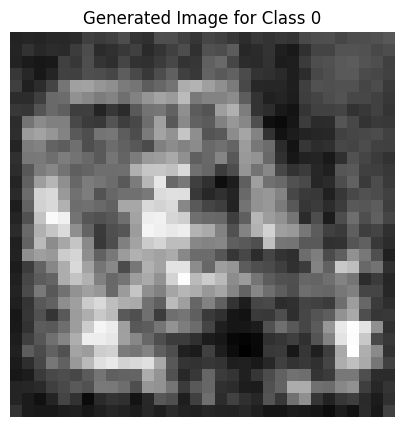

Epoch [466/2500], D_loss: 0.07004037499427795, G_loss: -0.5335898995399475


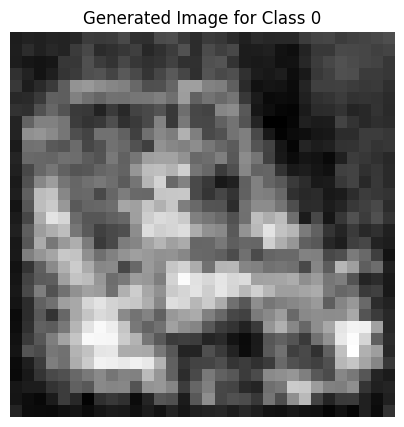

Epoch [467/2500], D_loss: 0.030083701014518738, G_loss: -0.5630731582641602


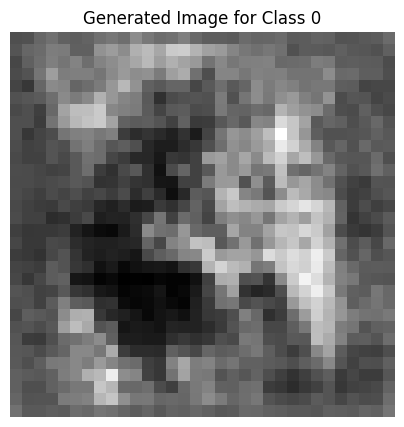

Epoch [468/2500], D_loss: 0.030590176582336426, G_loss: -0.5233684182167053


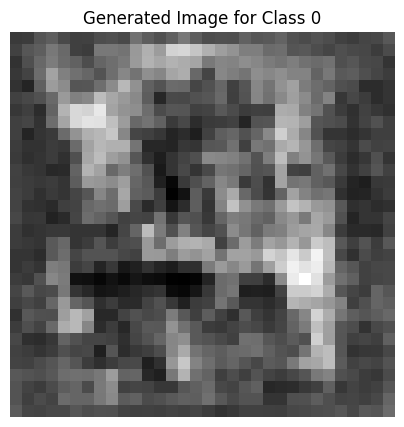

Epoch [469/2500], D_loss: 0.014894455671310425, G_loss: -0.5638920664787292


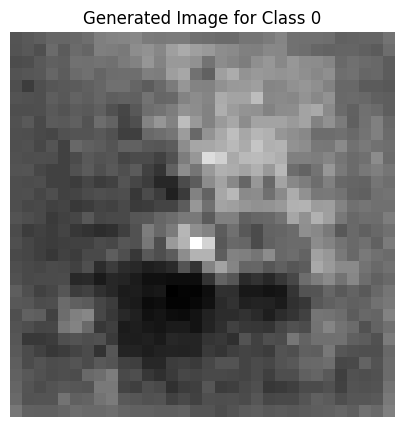

Epoch [470/2500], D_loss: 0.060560762882232666, G_loss: -0.5287415385246277


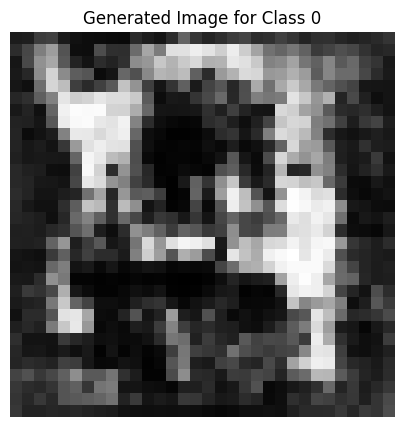

Epoch [471/2500], D_loss: 0.0033218413591384888, G_loss: -0.5206148624420166


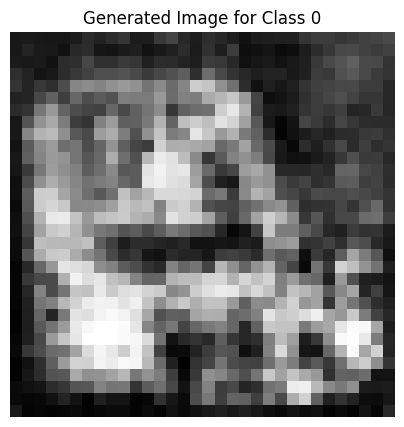

Epoch [472/2500], D_loss: -0.060336560010910034, G_loss: -0.4977900981903076


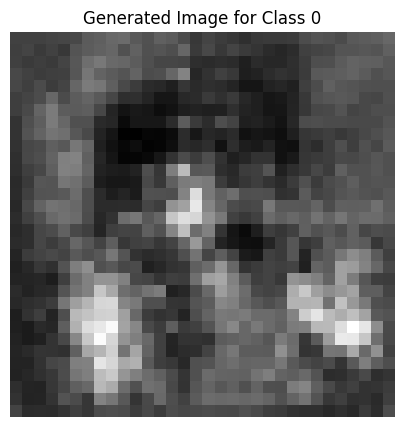

Epoch [473/2500], D_loss: -0.027847349643707275, G_loss: -0.48716241121292114


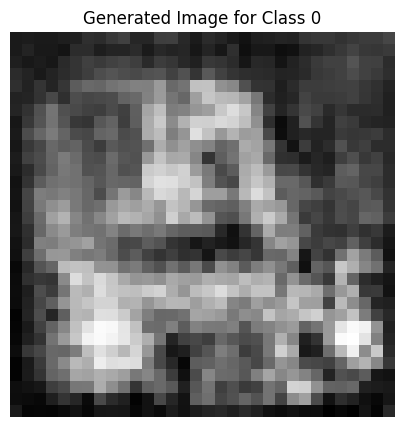

Epoch [474/2500], D_loss: 0.01713775098323822, G_loss: -0.4339284896850586


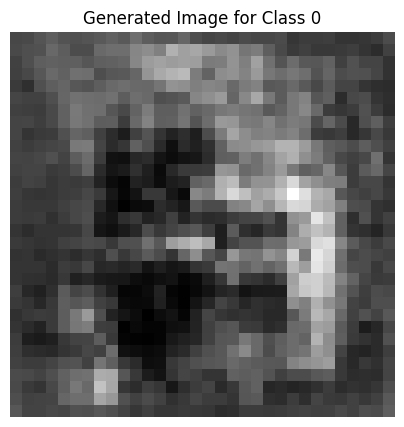

Epoch [475/2500], D_loss: 0.10285636782646179, G_loss: -0.513738751411438


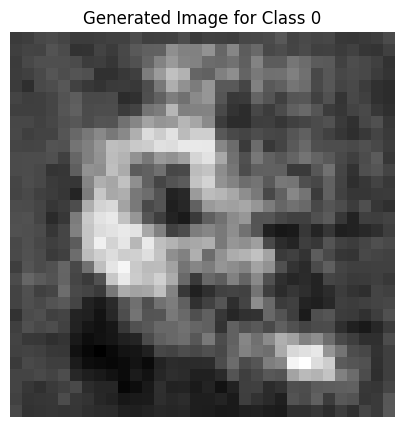

Epoch [476/2500], D_loss: 0.07157684862613678, G_loss: -0.5257235765457153


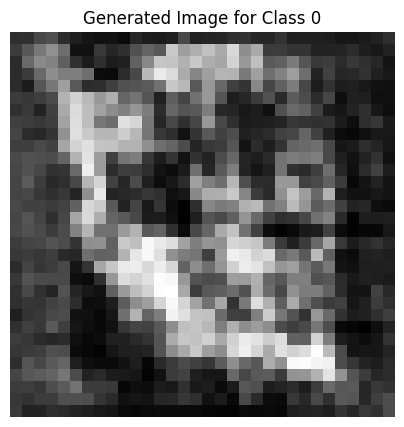

Epoch [477/2500], D_loss: 0.10236504673957825, G_loss: -0.49589771032333374


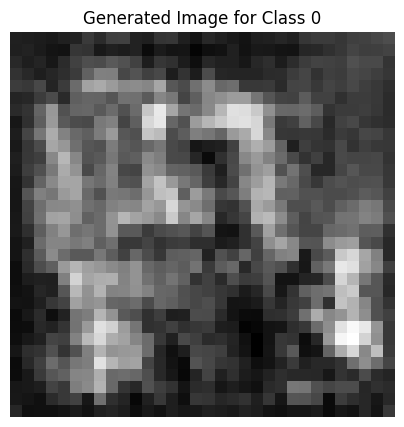

Epoch [478/2500], D_loss: 0.23357856273651123, G_loss: -0.5532528162002563


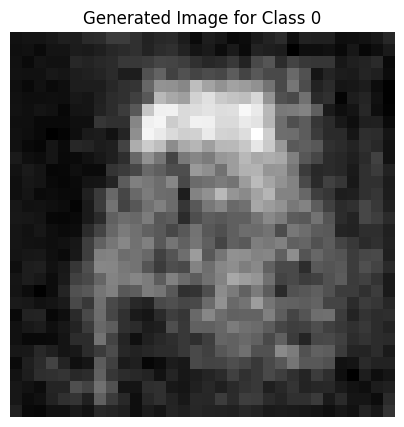

Epoch [479/2500], D_loss: 0.02476578950881958, G_loss: -0.49677443504333496


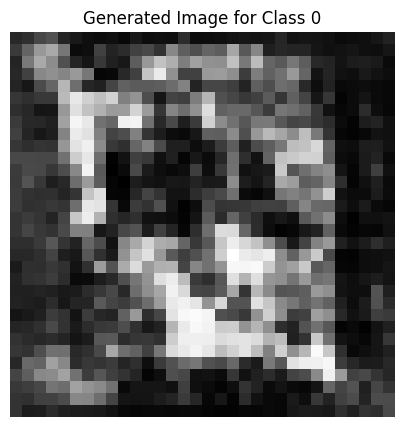

Epoch [480/2500], D_loss: 0.052608102560043335, G_loss: -0.6243840456008911


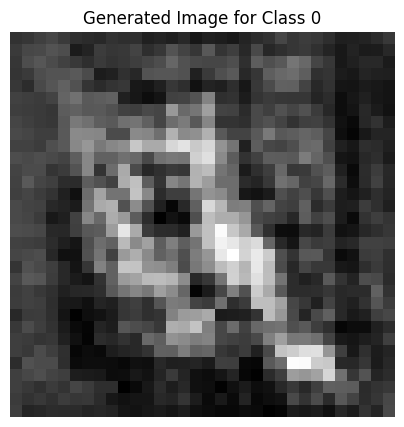

Epoch [481/2500], D_loss: 0.007659122347831726, G_loss: -0.5695095062255859


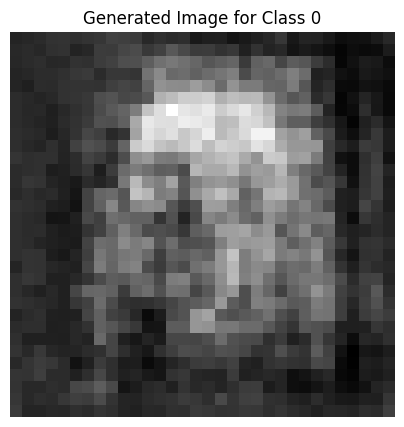

Epoch [482/2500], D_loss: 0.03166377544403076, G_loss: -0.4702855944633484


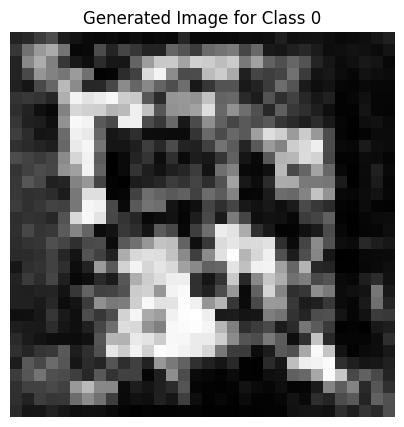

Epoch [483/2500], D_loss: 0.09418067336082458, G_loss: -0.4772999882698059


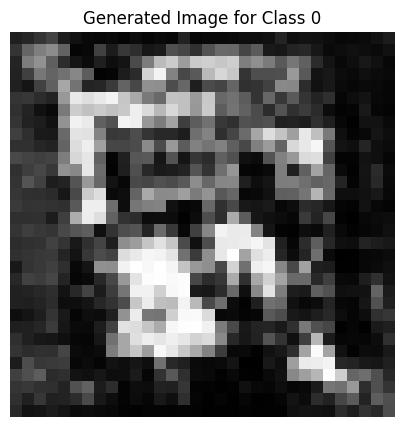

Epoch [484/2500], D_loss: -0.009172320365905762, G_loss: -0.5765732526779175


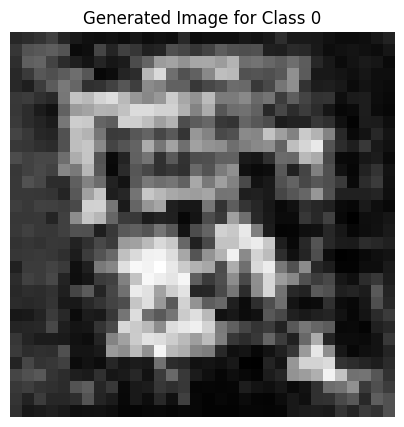

Epoch [485/2500], D_loss: -0.023358911275863647, G_loss: -0.5002590417861938


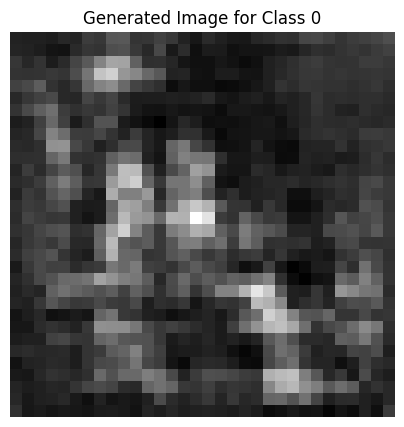

Epoch [486/2500], D_loss: -0.014173939824104309, G_loss: -0.5316604375839233


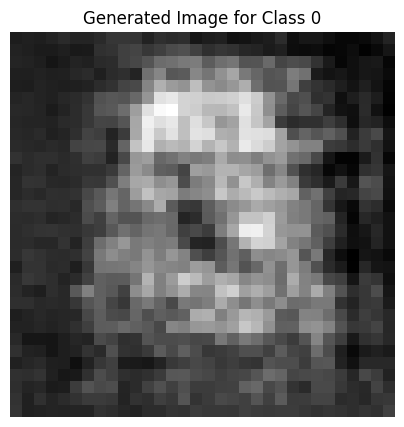

Epoch [487/2500], D_loss: -0.05694679915904999, G_loss: -0.4638533294200897


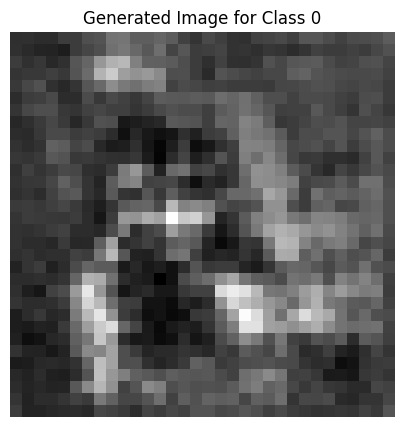

Epoch [488/2500], D_loss: -0.021281689405441284, G_loss: -0.4345651865005493


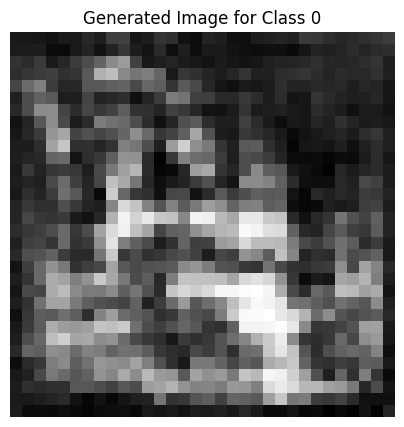

Epoch [489/2500], D_loss: -0.0008495897054672241, G_loss: -0.44053590297698975


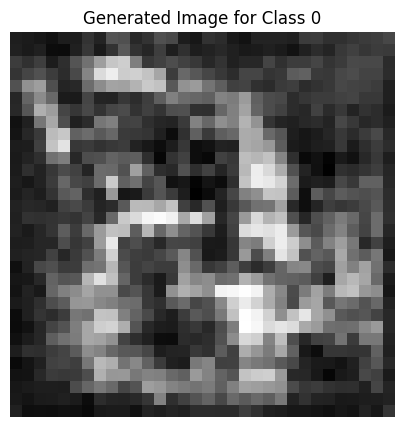

Epoch [490/2500], D_loss: 0.006424605846405029, G_loss: -0.5172388553619385


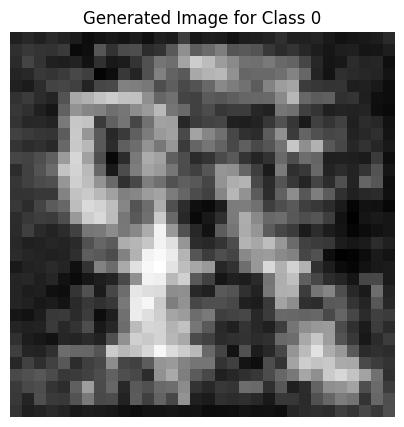

Epoch [491/2500], D_loss: 0.021465018391609192, G_loss: -0.47829002141952515


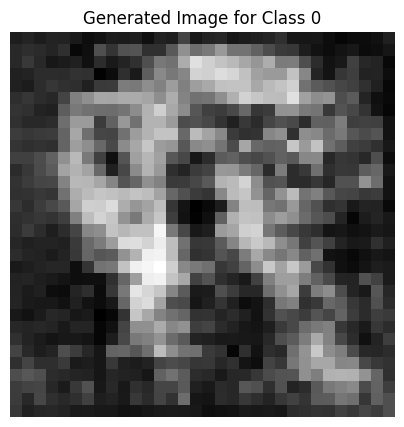

Epoch [492/2500], D_loss: 0.002391904592514038, G_loss: -0.5227470993995667


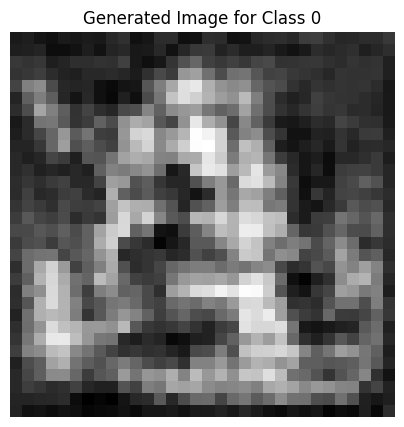

Epoch [493/2500], D_loss: -0.03003716468811035, G_loss: -0.4474005699157715


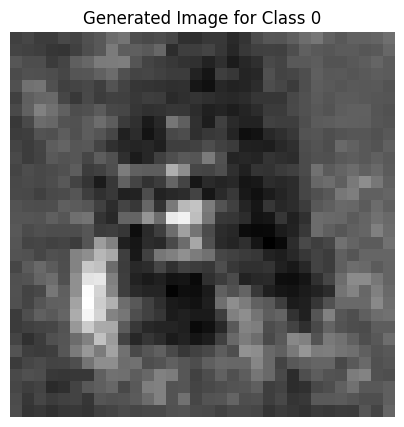

Epoch [494/2500], D_loss: 0.11667659878730774, G_loss: -0.5898014307022095


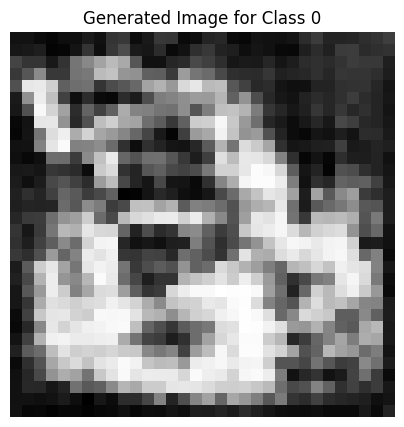

Epoch [495/2500], D_loss: -0.008793354034423828, G_loss: -0.4431880712509155


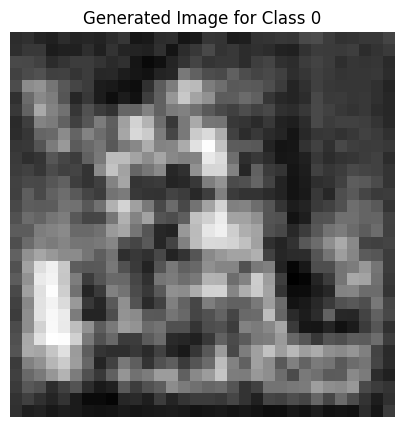

Epoch [496/2500], D_loss: -0.02662225067615509, G_loss: -0.5452826619148254


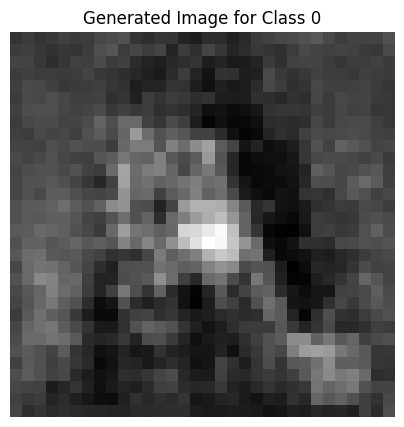

Epoch [497/2500], D_loss: 0.04855796694755554, G_loss: -0.522707462310791


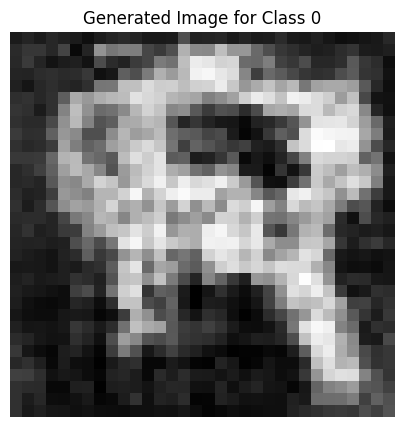

Epoch [498/2500], D_loss: -0.017108798027038574, G_loss: -0.5485025644302368


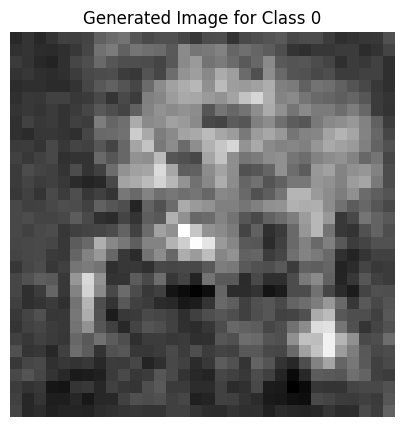

Epoch [499/2500], D_loss: 0.02351251244544983, G_loss: -0.5216389894485474


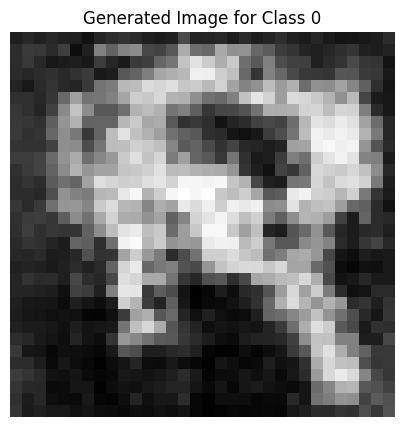

Epoch [500/2500], D_loss: -0.013475492596626282, G_loss: -0.520281195640564


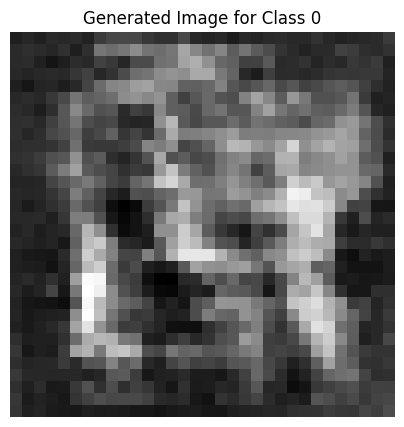

Epoch [501/2500], D_loss: 0.09545654058456421, G_loss: -0.5171462297439575


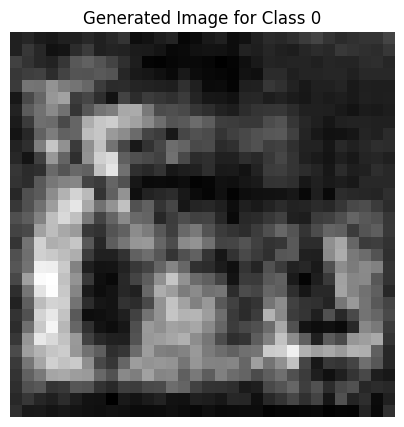

Epoch [502/2500], D_loss: 0.06560221314430237, G_loss: -0.5518521070480347


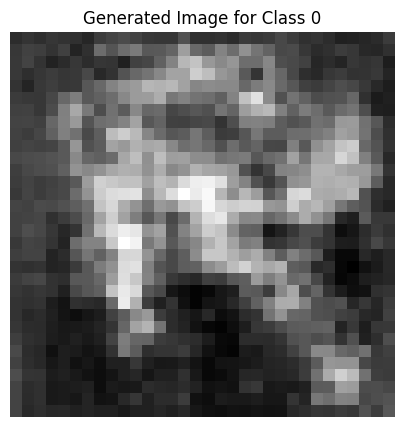

Epoch [503/2500], D_loss: -0.0077842772006988525, G_loss: -0.519429087638855


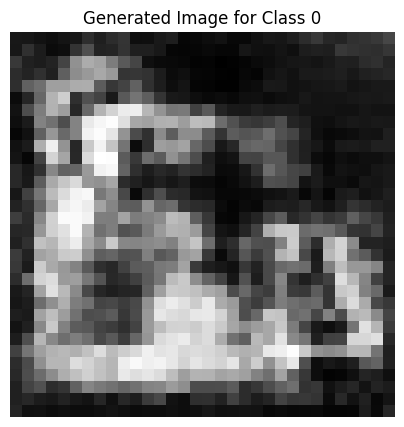

Epoch [504/2500], D_loss: 0.07132159173488617, G_loss: -0.5298116207122803


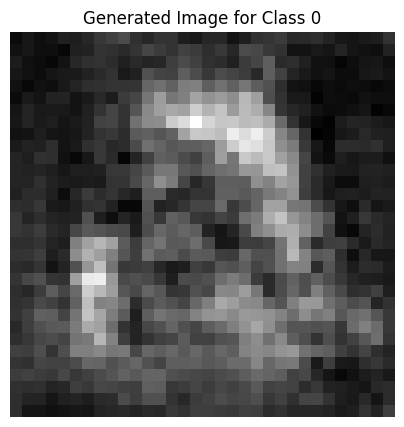

Epoch [505/2500], D_loss: -0.009894460439682007, G_loss: -0.49507784843444824


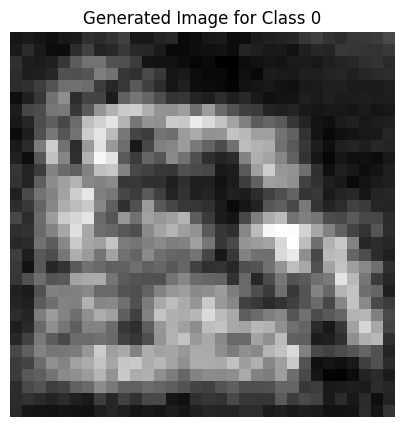

Epoch [506/2500], D_loss: -0.0077838897705078125, G_loss: -0.5442041754722595


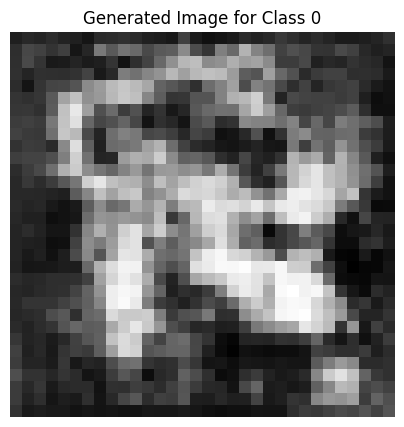

Epoch [507/2500], D_loss: 0.012085959315299988, G_loss: -0.4150671064853668


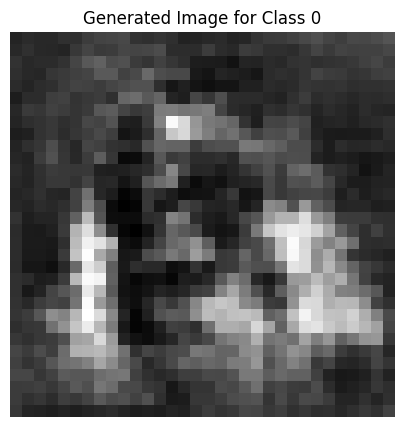

Epoch [508/2500], D_loss: 0.04153141379356384, G_loss: -0.5427342653274536


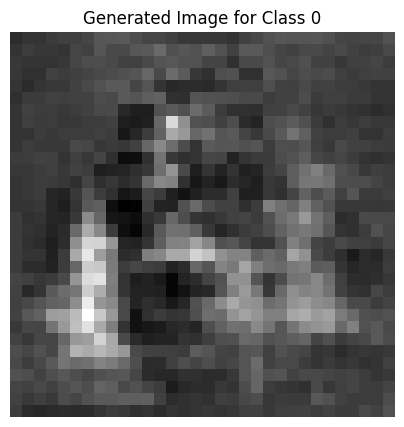

Epoch [509/2500], D_loss: -0.022848010063171387, G_loss: -0.45517995953559875


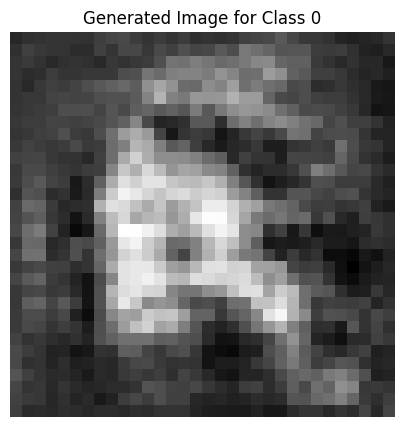

Epoch [510/2500], D_loss: 0.040339693427085876, G_loss: -0.548118531703949


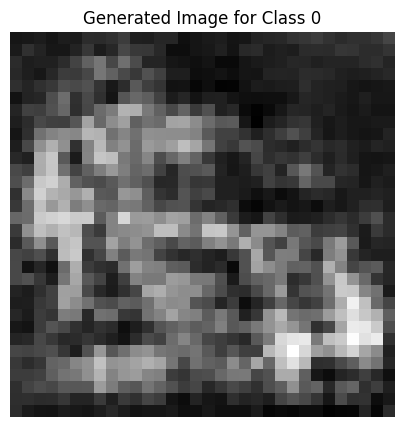

Epoch [511/2500], D_loss: -0.024701163172721863, G_loss: -0.5395568609237671


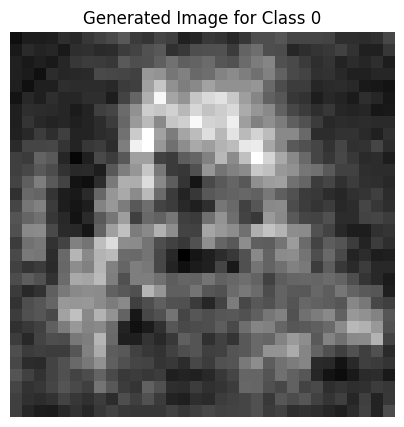

Epoch [512/2500], D_loss: 0.028506875038146973, G_loss: -0.47588372230529785


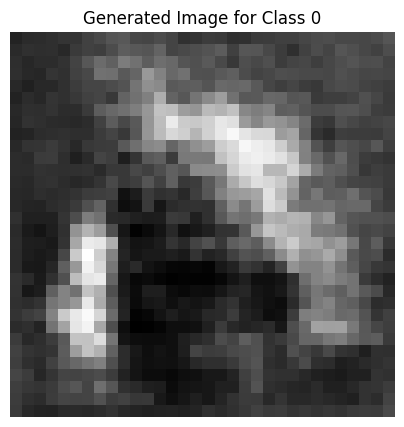

Epoch [513/2500], D_loss: 0.01055920124053955, G_loss: -0.48030760884284973


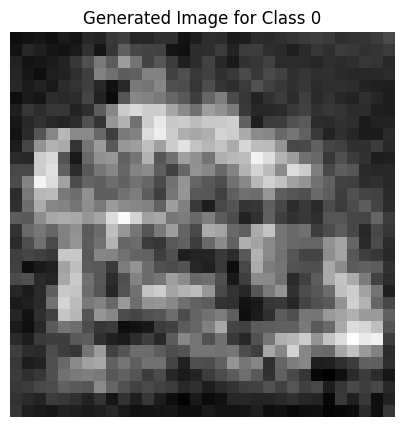

Epoch [514/2500], D_loss: -0.009305447340011597, G_loss: -0.508743166923523


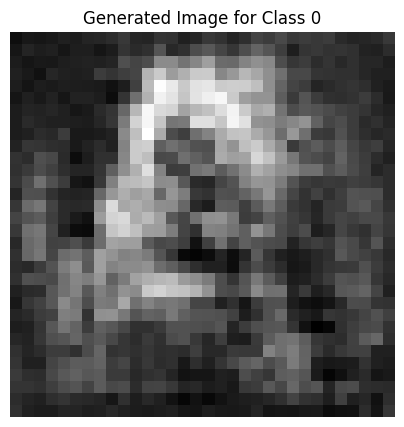

Epoch [515/2500], D_loss: 0.022913962602615356, G_loss: -0.49062204360961914


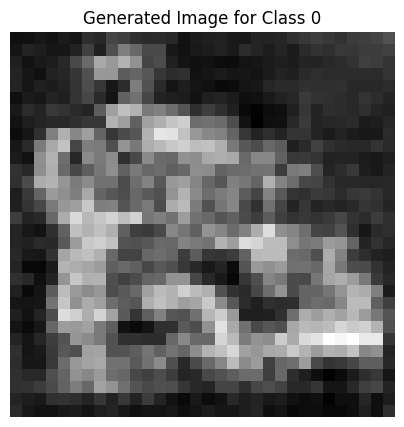

Epoch [516/2500], D_loss: 0.03716541826725006, G_loss: -0.3984624147415161


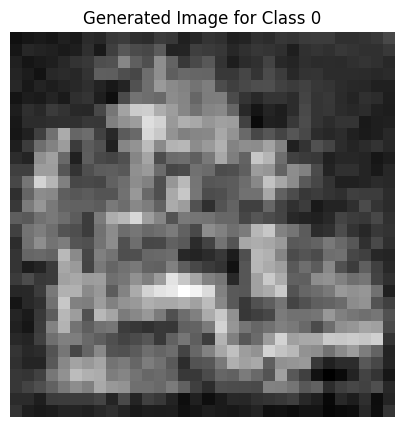

Epoch [517/2500], D_loss: 0.014858409762382507, G_loss: -0.40720435976982117


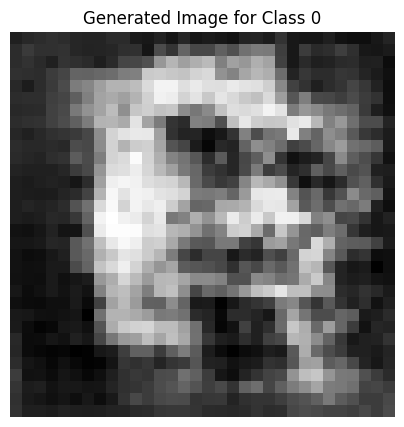

Epoch [518/2500], D_loss: 0.013987958431243896, G_loss: -0.48530420660972595


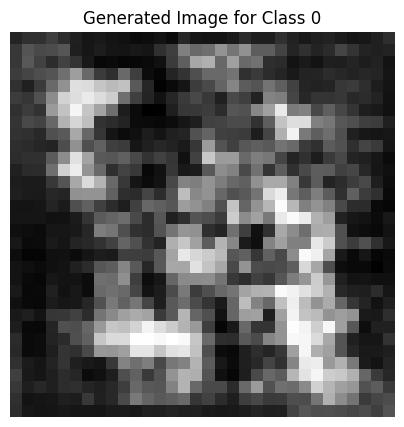

Epoch [519/2500], D_loss: -0.031229287385940552, G_loss: -0.5057649612426758


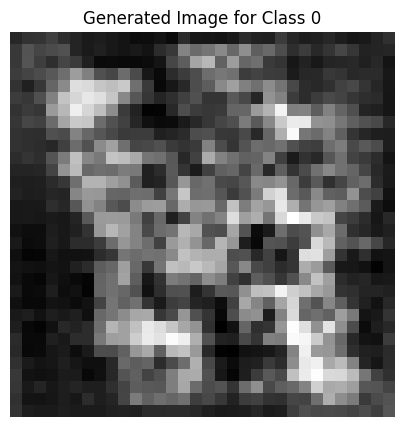

Epoch [520/2500], D_loss: 0.014939039945602417, G_loss: -0.5587097406387329


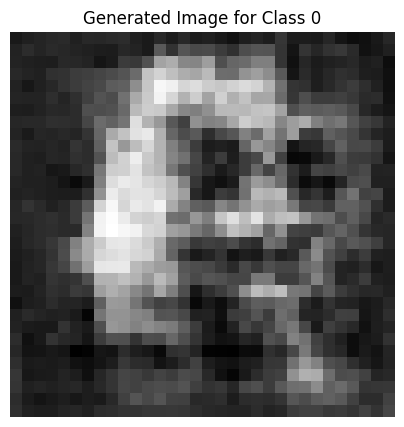

Epoch [521/2500], D_loss: 0.08866198360919952, G_loss: -0.37398821115493774


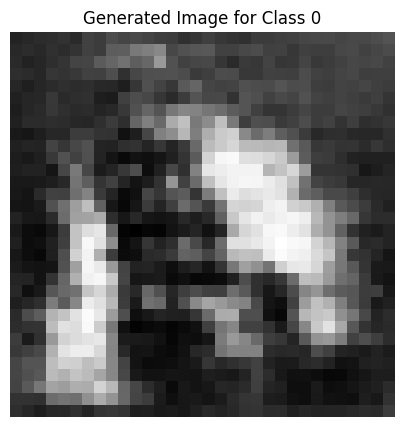

Epoch [522/2500], D_loss: 0.002773180603981018, G_loss: -0.5779572129249573


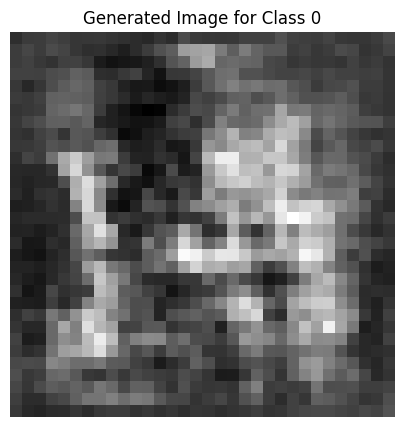

Epoch [523/2500], D_loss: -0.08397825062274933, G_loss: -0.5525010824203491


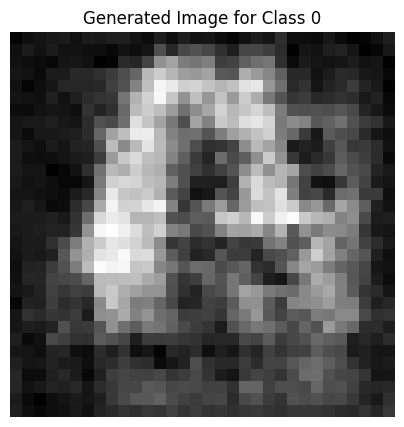

Epoch [524/2500], D_loss: -0.09957559406757355, G_loss: -0.5385936498641968


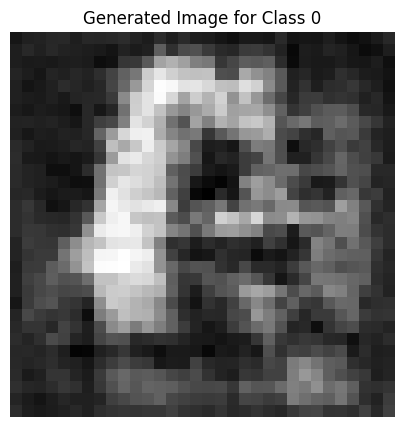

Epoch [525/2500], D_loss: -0.014189109206199646, G_loss: -0.5797045826911926


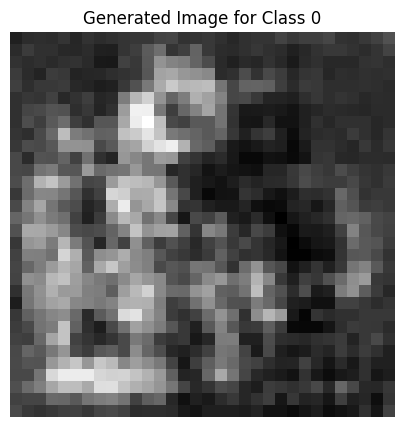

Epoch [526/2500], D_loss: -0.06485776603221893, G_loss: -0.5332204103469849


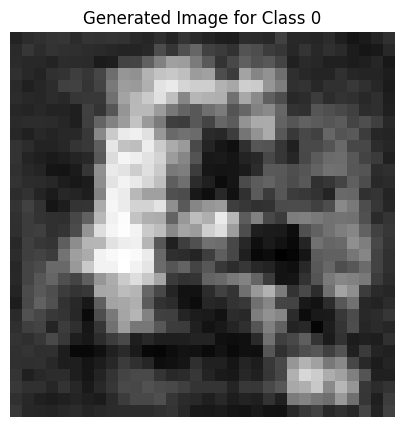

Epoch [527/2500], D_loss: -0.05259224772453308, G_loss: -0.5509347319602966


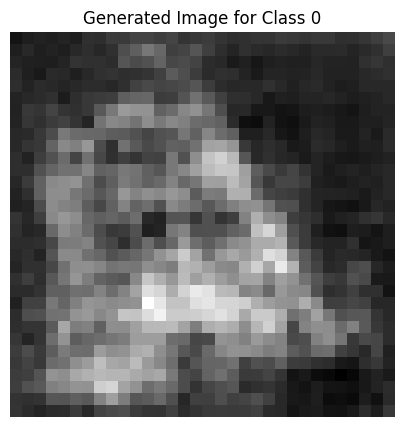

Epoch [528/2500], D_loss: -0.08804608881473541, G_loss: -0.53011554479599


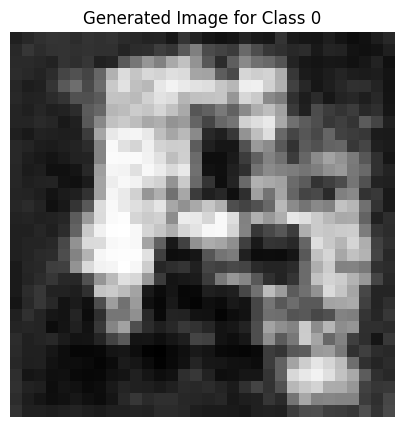

Epoch [529/2500], D_loss: -0.007903605699539185, G_loss: -0.5883070230484009


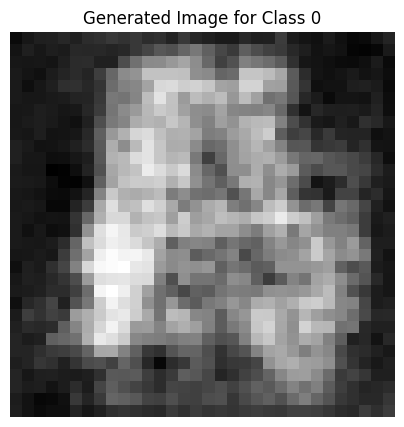

Epoch [530/2500], D_loss: 0.030741363763809204, G_loss: -0.47766613960266113


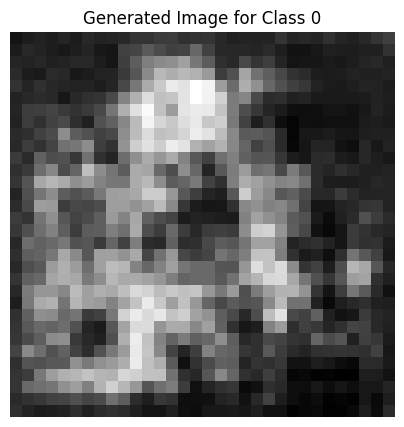

Epoch [531/2500], D_loss: 0.026119351387023926, G_loss: -0.5310925245285034


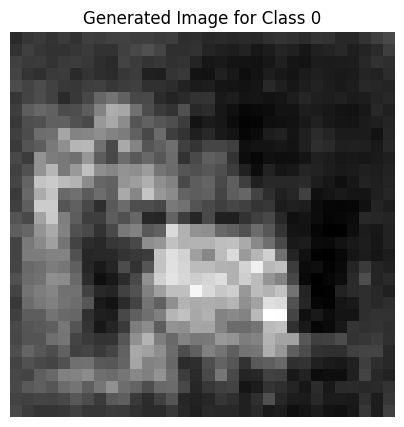

Epoch [532/2500], D_loss: 0.03837469220161438, G_loss: -0.4795781672000885


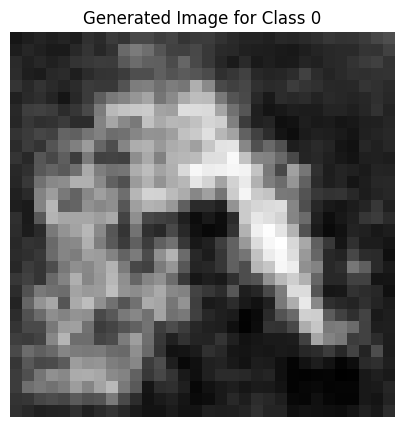

Epoch [533/2500], D_loss: 0.07468914985656738, G_loss: -0.4870908260345459


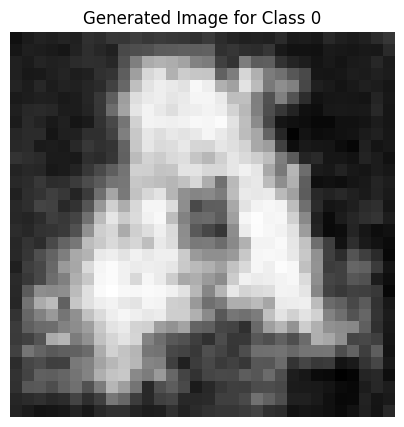

Epoch [534/2500], D_loss: 0.11150676012039185, G_loss: -0.5294246673583984


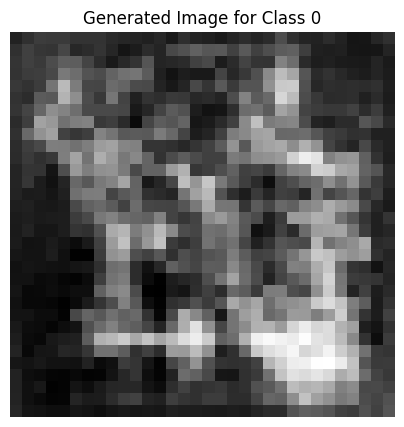

Epoch [535/2500], D_loss: -0.0028037577867507935, G_loss: -0.5111211538314819


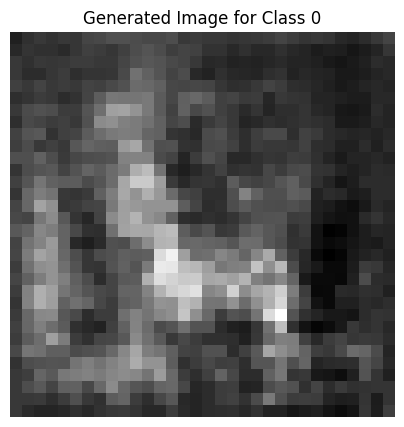

Epoch [536/2500], D_loss: -0.07197952270507812, G_loss: -0.5274163484573364


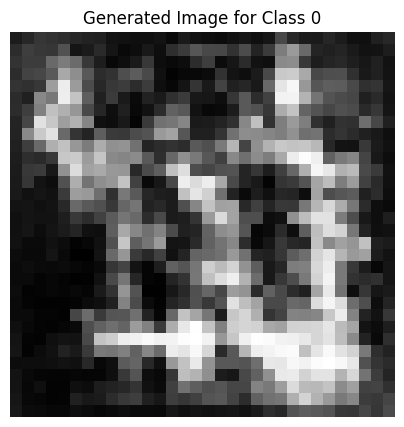

Epoch [537/2500], D_loss: -0.047349944710731506, G_loss: -0.5479778051376343


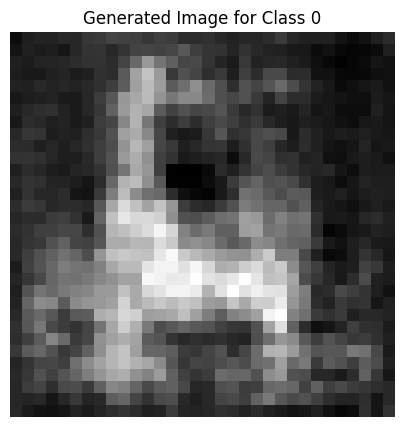

Epoch [538/2500], D_loss: 0.006422102451324463, G_loss: -0.48215094208717346


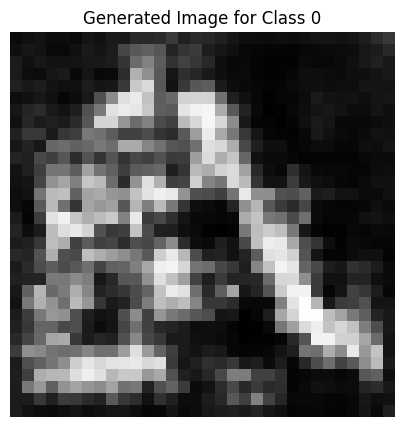

Epoch [539/2500], D_loss: -0.07006144523620605, G_loss: -0.528468132019043


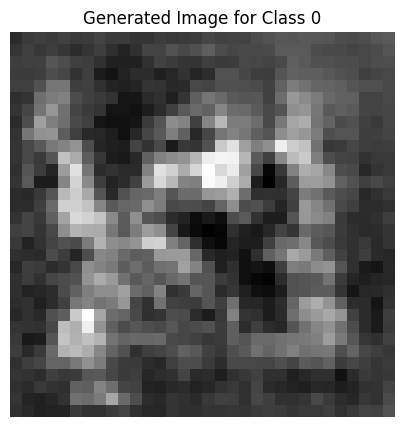

Epoch [540/2500], D_loss: -0.050013214349746704, G_loss: -0.4367830753326416


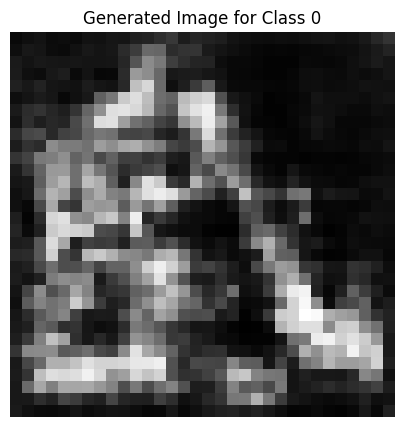

Epoch [541/2500], D_loss: -0.005823180079460144, G_loss: -0.5341333150863647


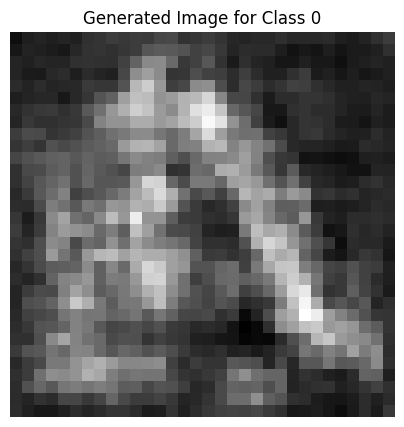

Epoch [542/2500], D_loss: -0.05473776161670685, G_loss: -0.5042508840560913


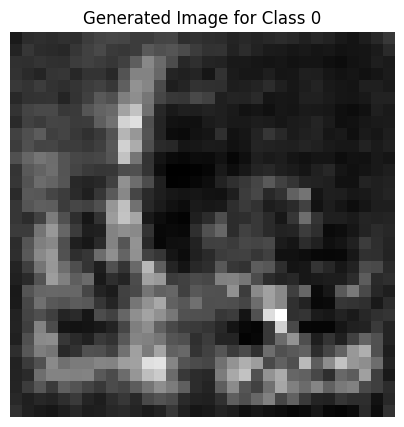

Epoch [543/2500], D_loss: -0.055785633623600006, G_loss: -0.5078120231628418


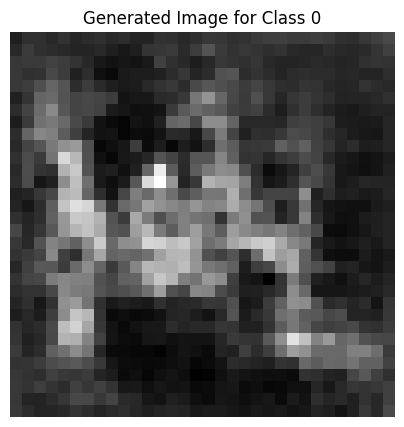

Epoch [544/2500], D_loss: -0.018343031406402588, G_loss: -0.48723745346069336


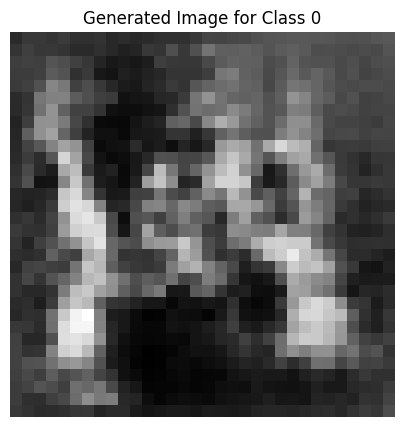

Epoch [545/2500], D_loss: -0.03451603651046753, G_loss: -0.5715135335922241


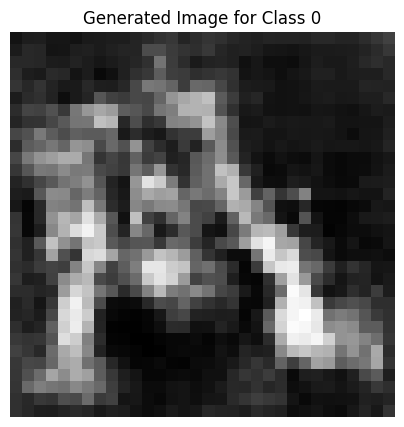

Epoch [546/2500], D_loss: 0.08855804800987244, G_loss: -0.516167163848877


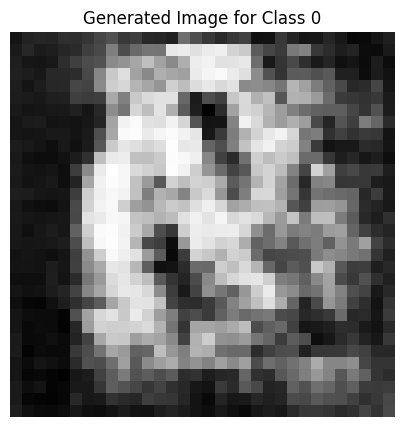

Epoch [547/2500], D_loss: -0.02277866005897522, G_loss: -0.539583683013916


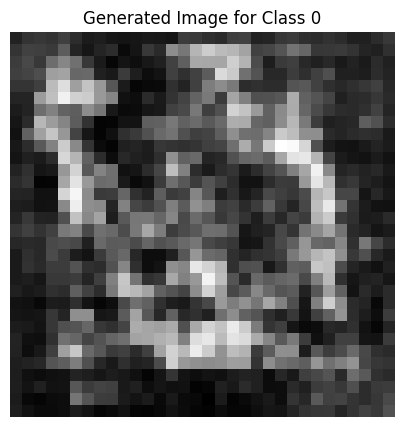

Epoch [548/2500], D_loss: -0.00034290552139282227, G_loss: -0.5619533061981201


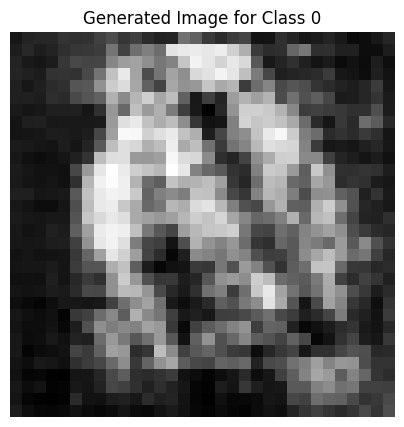

Epoch [549/2500], D_loss: -0.020455211400985718, G_loss: -0.5389509201049805


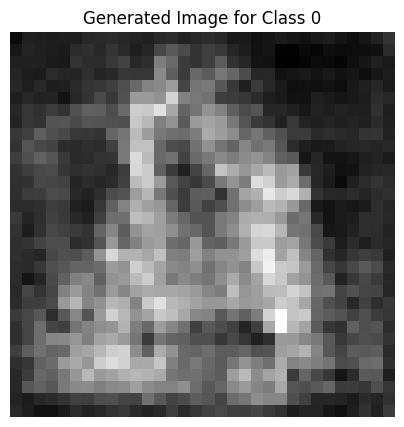

Epoch [550/2500], D_loss: -0.024390608072280884, G_loss: -0.5312516093254089


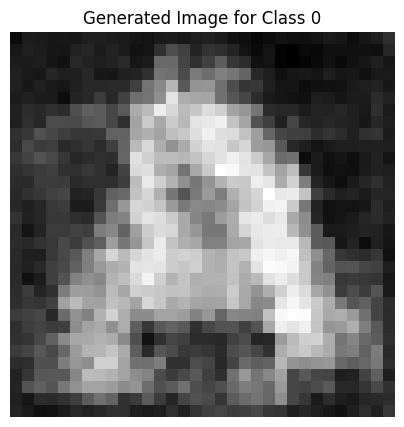

Epoch [551/2500], D_loss: -0.01964491605758667, G_loss: -0.548255205154419


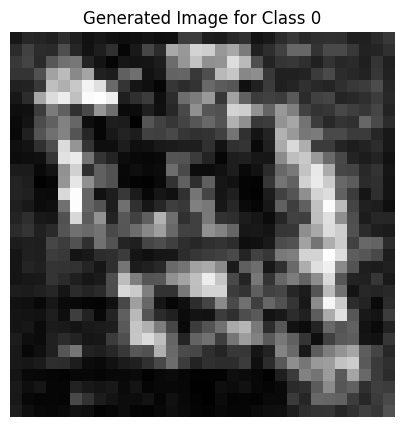

Epoch [552/2500], D_loss: -0.005838662385940552, G_loss: -0.43051454424858093


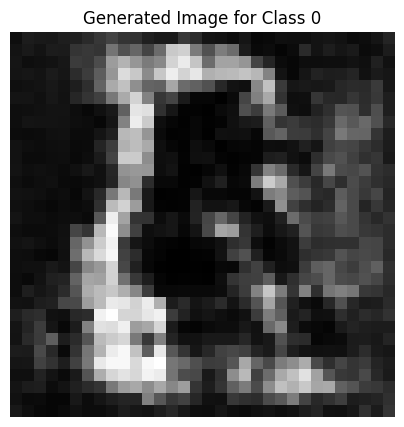

Epoch [553/2500], D_loss: -0.0238981693983078, G_loss: -0.5303163528442383


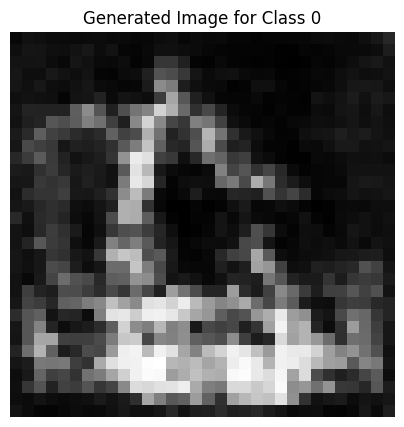

Epoch [554/2500], D_loss: 0.0548199862241745, G_loss: -0.5223482847213745


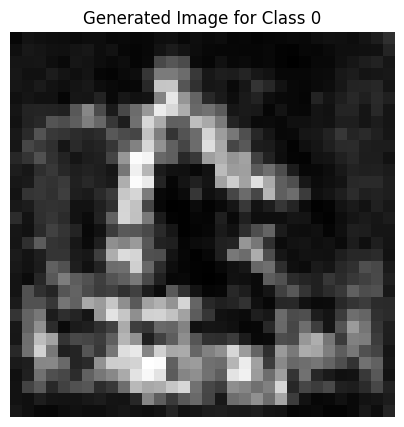

Epoch [555/2500], D_loss: 0.055686354637145996, G_loss: -0.48306095600128174


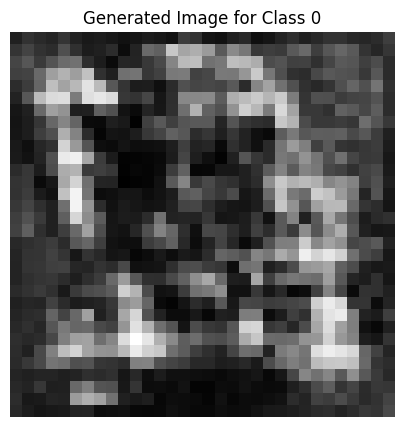

Epoch [556/2500], D_loss: 0.04230557382106781, G_loss: -0.46467554569244385


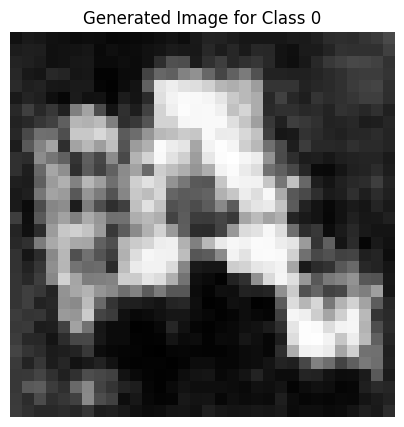

Epoch [557/2500], D_loss: -0.003909945487976074, G_loss: -0.4779664874076843


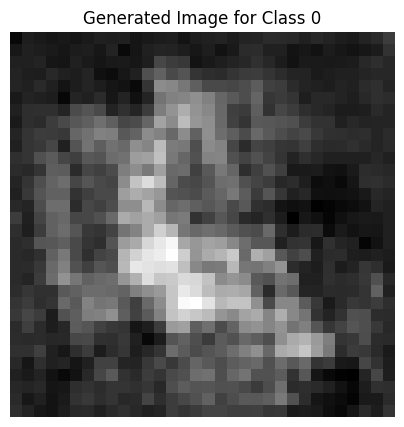

Epoch [558/2500], D_loss: 0.09223282337188721, G_loss: -0.5133635997772217


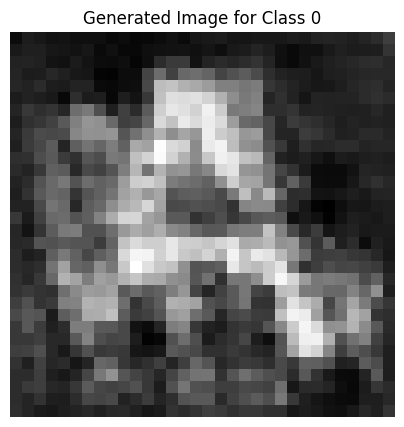

Epoch [559/2500], D_loss: 0.008537471294403076, G_loss: -0.5203350782394409


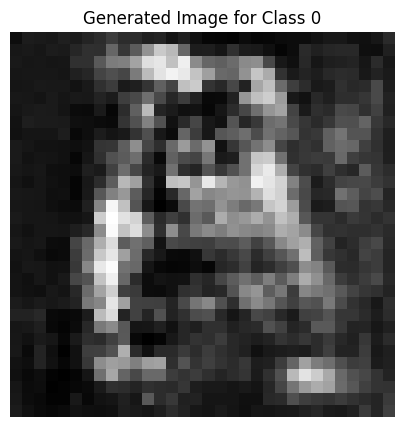

Epoch [560/2500], D_loss: -0.041388556361198425, G_loss: -0.4402102828025818


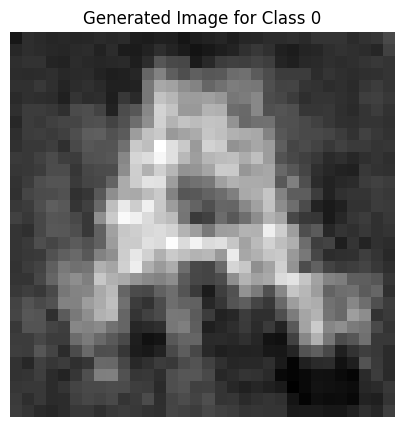

Epoch [561/2500], D_loss: -0.0649283230304718, G_loss: -0.49448707699775696


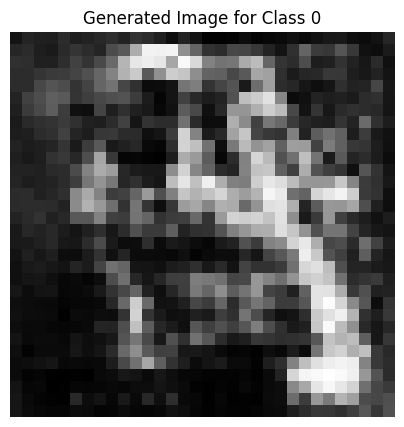

Epoch [562/2500], D_loss: -0.04498481750488281, G_loss: -0.5023754239082336


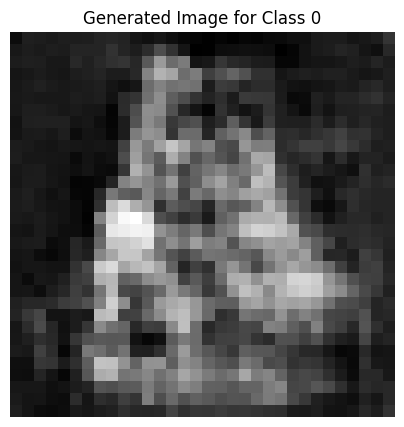

Epoch [563/2500], D_loss: -0.00854259729385376, G_loss: -0.5204312801361084


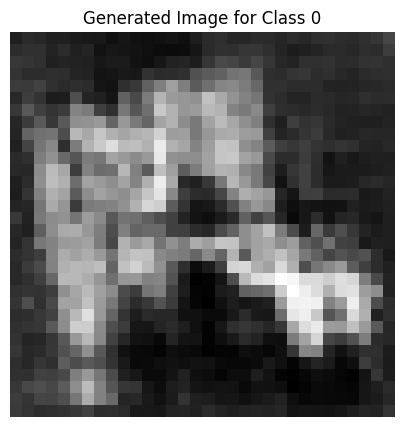

Epoch [564/2500], D_loss: 0.0015369206666946411, G_loss: -0.4542483687400818


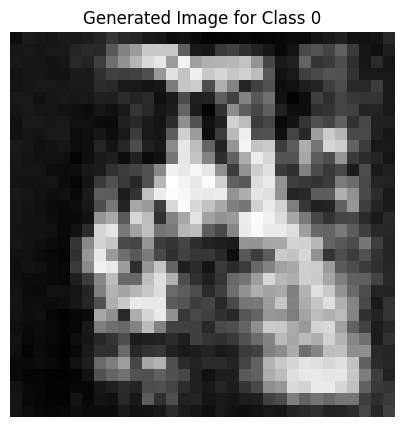

Epoch [565/2500], D_loss: -0.0056601762771606445, G_loss: -0.46493059396743774


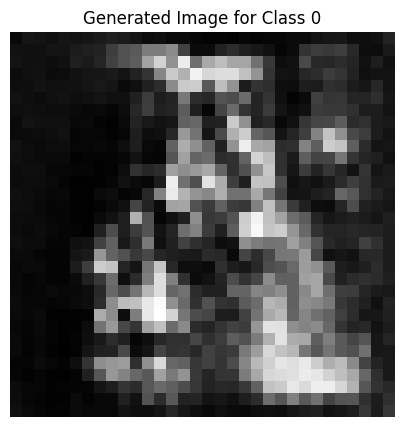

Epoch [566/2500], D_loss: 0.022408872842788696, G_loss: -0.540482223033905


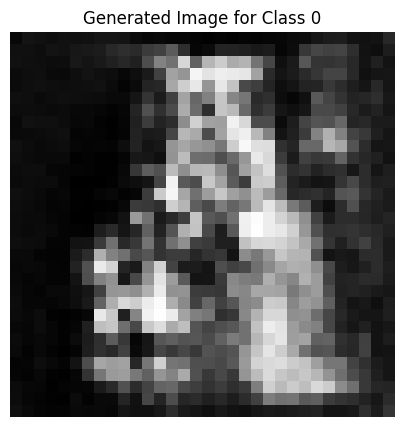

Epoch [567/2500], D_loss: 0.025603413581848145, G_loss: -0.5318461060523987


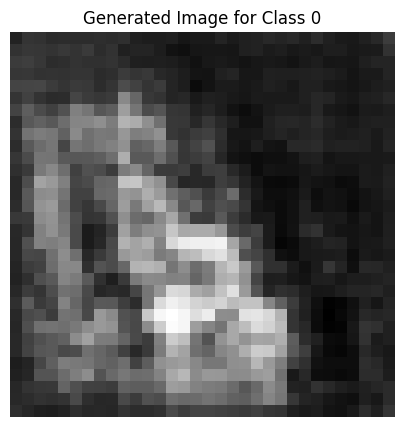

Epoch [568/2500], D_loss: -0.01860031485557556, G_loss: -0.5015550255775452


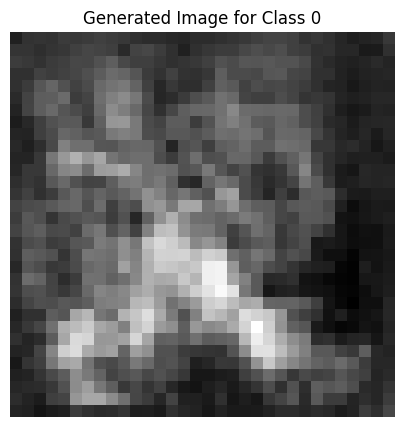

Epoch [569/2500], D_loss: 0.0013537853956222534, G_loss: -0.5731344819068909


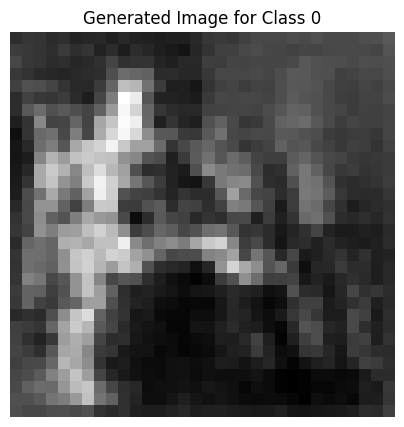

Epoch [570/2500], D_loss: 0.03921331465244293, G_loss: -0.5762050151824951


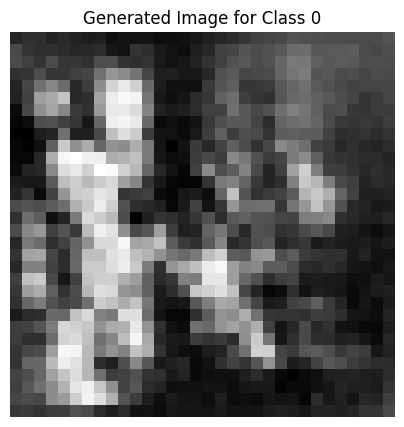

Epoch [571/2500], D_loss: -0.023095175623893738, G_loss: -0.57049161195755


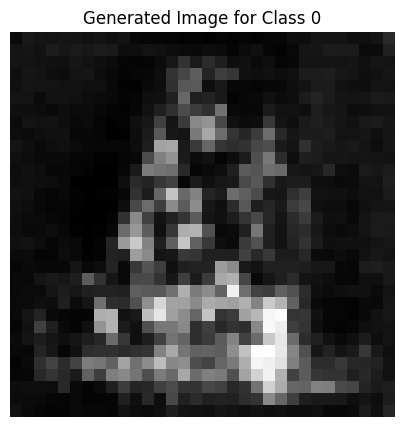

Epoch [572/2500], D_loss: 0.12018465995788574, G_loss: -0.627874493598938


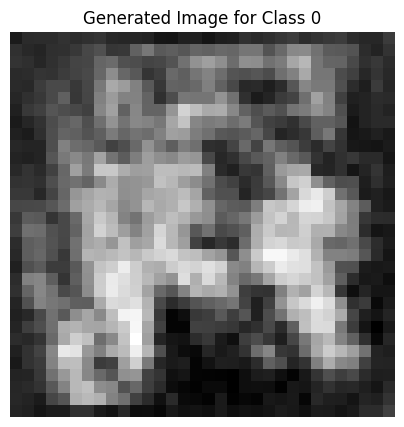

Epoch [573/2500], D_loss: 0.02716173231601715, G_loss: -0.5159353613853455


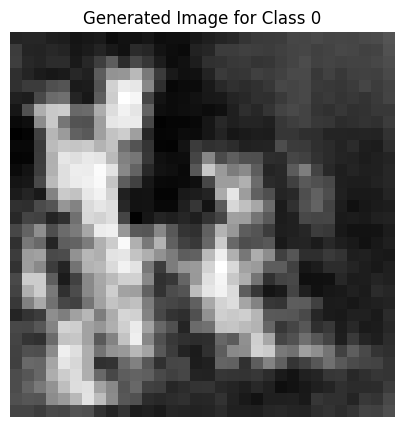

Epoch [574/2500], D_loss: 0.01316574215888977, G_loss: -0.5915915369987488


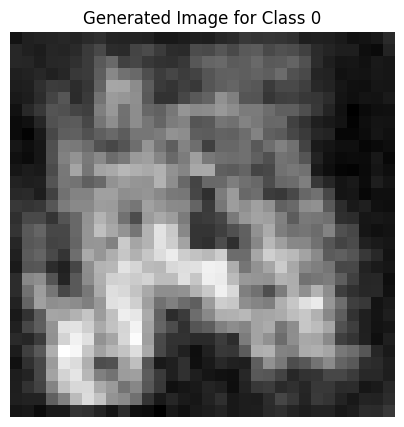

Epoch [575/2500], D_loss: 0.04500998556613922, G_loss: -0.5778446197509766


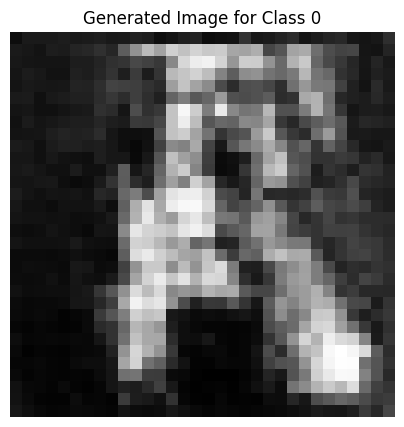

Epoch [576/2500], D_loss: 0.04332190752029419, G_loss: -0.5314856767654419


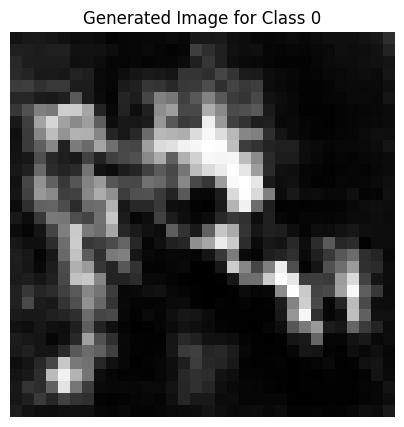

Epoch [577/2500], D_loss: 0.07876832783222198, G_loss: -0.642660915851593


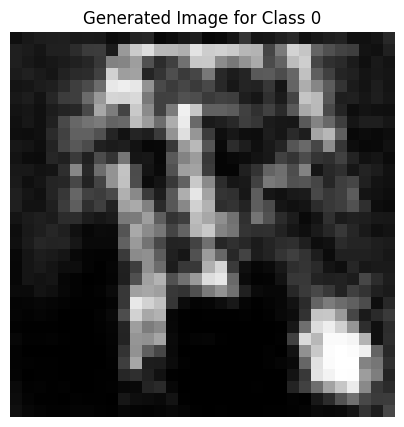

Epoch [578/2500], D_loss: 0.013170883059501648, G_loss: -0.5678285956382751


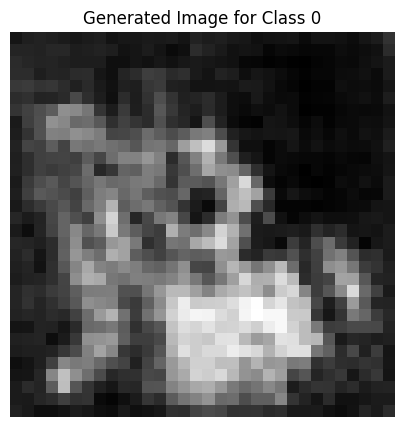

Epoch [579/2500], D_loss: -0.01990973949432373, G_loss: -0.5264757871627808


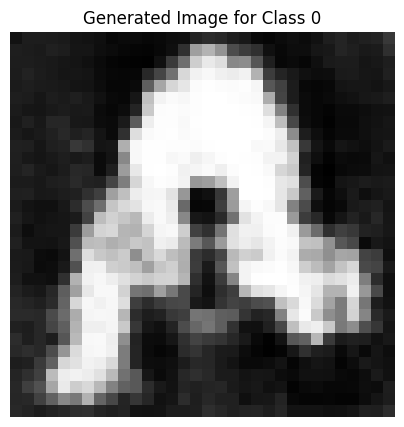

Epoch [580/2500], D_loss: 0.1034180223941803, G_loss: -0.680931031703949


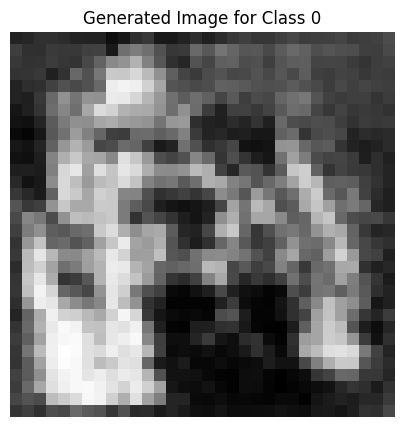

Epoch [581/2500], D_loss: -0.022651955485343933, G_loss: -0.5415935516357422


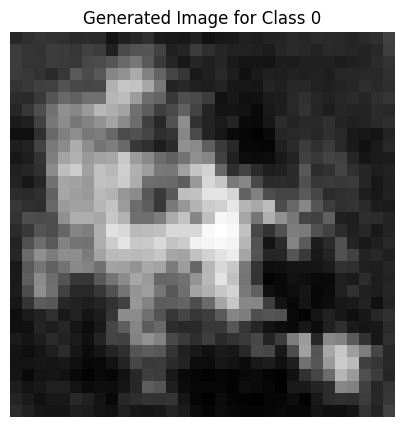

Epoch [582/2500], D_loss: 0.05470298230648041, G_loss: -0.5603690147399902


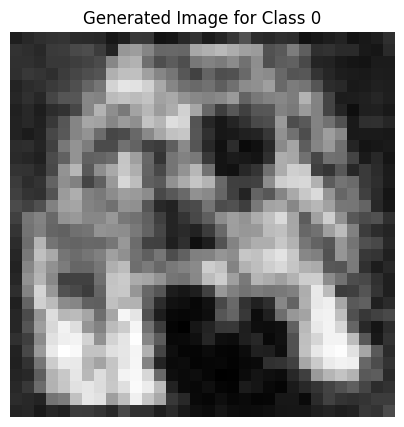

Epoch [583/2500], D_loss: 0.10170209407806396, G_loss: -0.6010035872459412


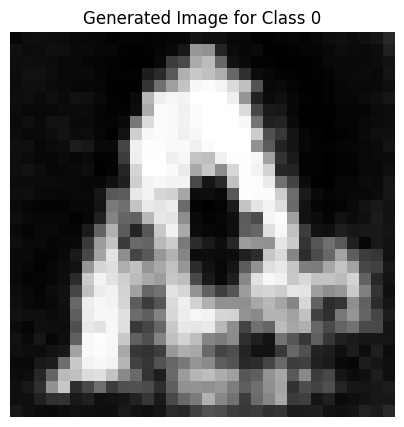

Epoch [584/2500], D_loss: 0.006874054670333862, G_loss: -0.46807706356048584


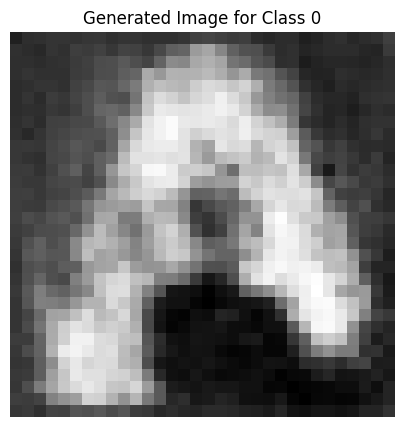

Epoch [585/2500], D_loss: 0.03578600287437439, G_loss: -0.5239818096160889


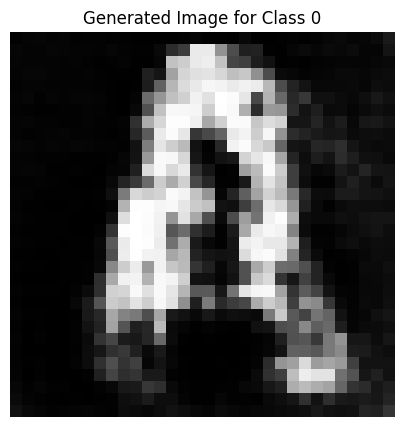

Epoch [586/2500], D_loss: 0.01887226104736328, G_loss: -0.5816546678543091


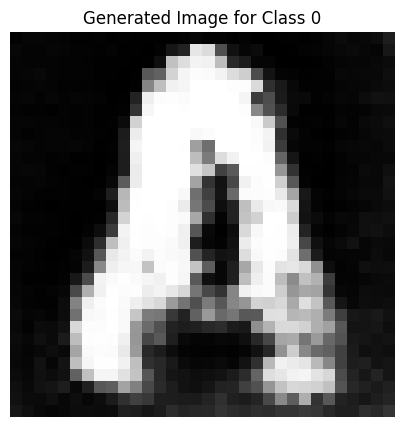

Epoch [587/2500], D_loss: 0.03155183047056198, G_loss: -0.5551080703735352


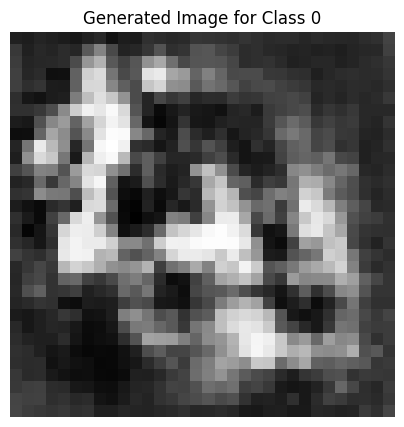

Epoch [588/2500], D_loss: 0.07642942667007446, G_loss: -0.5867171883583069


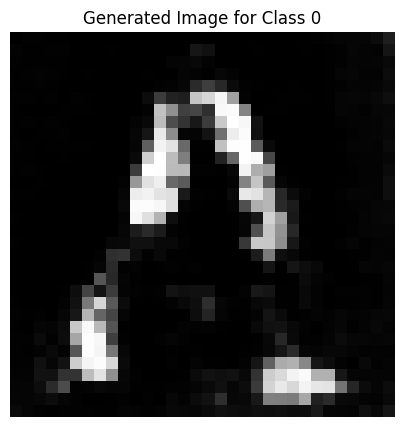

Epoch [589/2500], D_loss: 0.0183282271027565, G_loss: -0.585647702217102


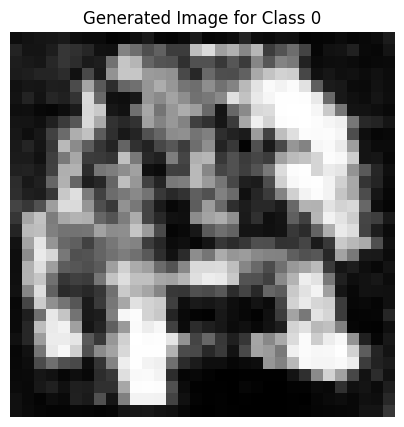

Epoch [590/2500], D_loss: 0.09682539105415344, G_loss: -0.39817577600479126


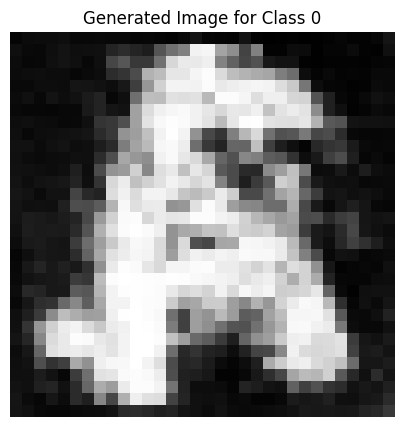

Epoch [591/2500], D_loss: 0.0627235472202301, G_loss: -0.5486094355583191


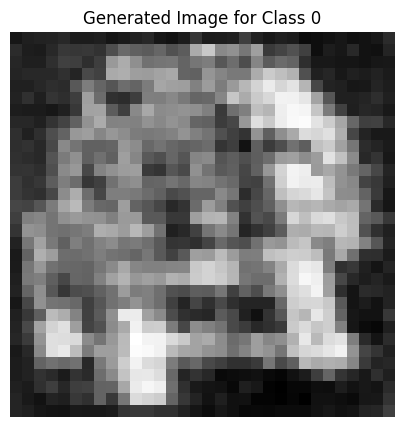

Epoch [592/2500], D_loss: 0.017431259155273438, G_loss: -0.5650322437286377


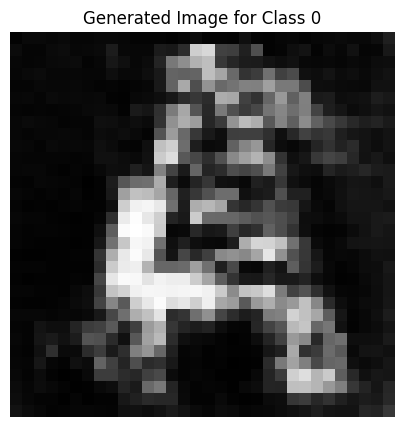

Epoch [593/2500], D_loss: 0.1046140044927597, G_loss: -0.5227828025817871


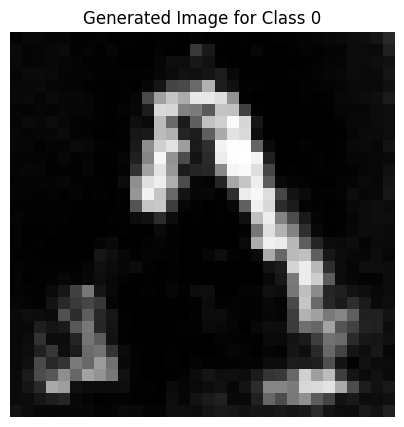

Epoch [594/2500], D_loss: 0.0030837804079055786, G_loss: -0.5456308126449585


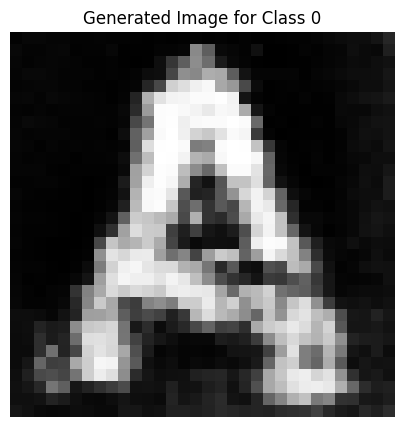

Epoch [595/2500], D_loss: 0.05484546720981598, G_loss: -0.44806182384490967


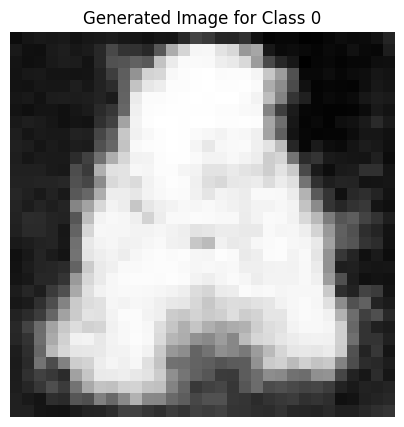

Epoch [596/2500], D_loss: 0.01784437894821167, G_loss: -0.5378397703170776


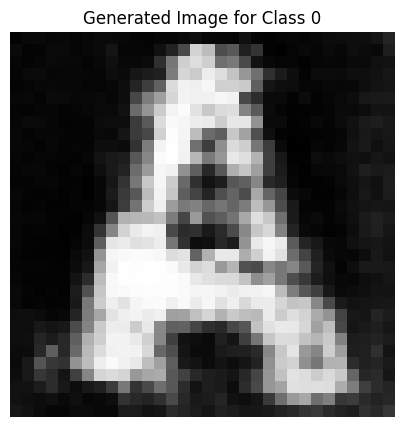

Epoch [597/2500], D_loss: 0.020586363971233368, G_loss: -0.5641015768051147


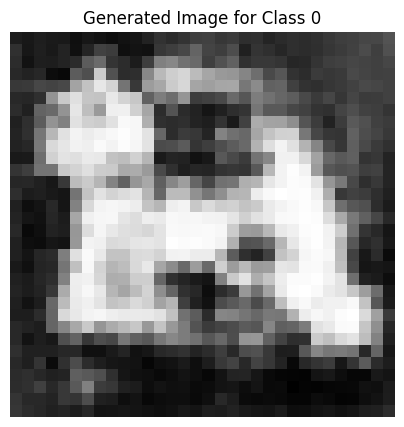

Epoch [598/2500], D_loss: 0.05351170897483826, G_loss: -0.5589587688446045


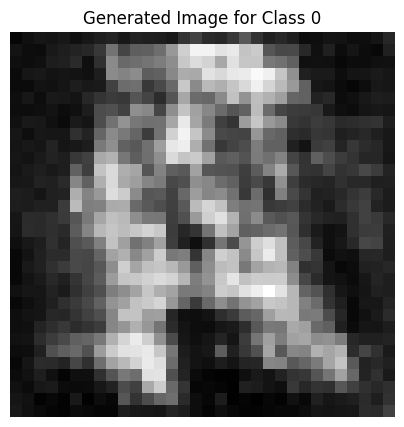

Epoch [599/2500], D_loss: 0.09385313093662262, G_loss: -0.5154298543930054


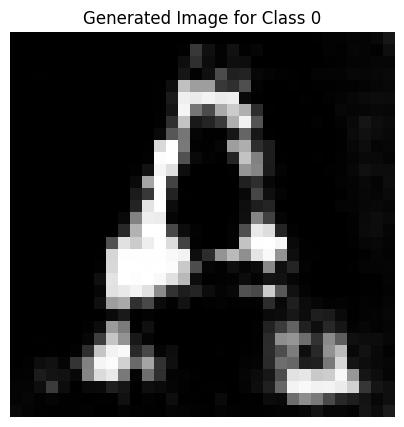

Epoch [600/2500], D_loss: 0.06290982663631439, G_loss: -0.49565455317497253


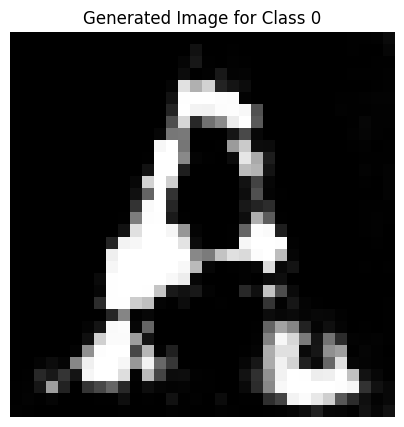

Epoch [601/2500], D_loss: 0.2996535897254944, G_loss: -0.654526948928833


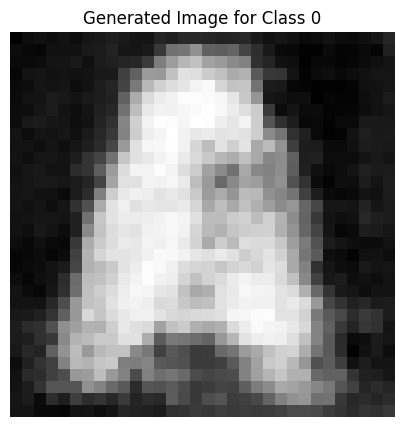

Epoch [602/2500], D_loss: -0.008980080485343933, G_loss: -0.5572878122329712


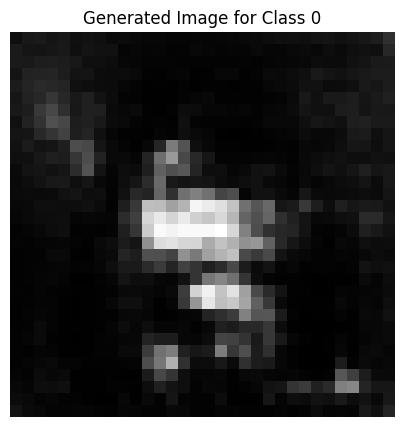

Epoch [603/2500], D_loss: 0.1113685816526413, G_loss: -0.6035125255584717


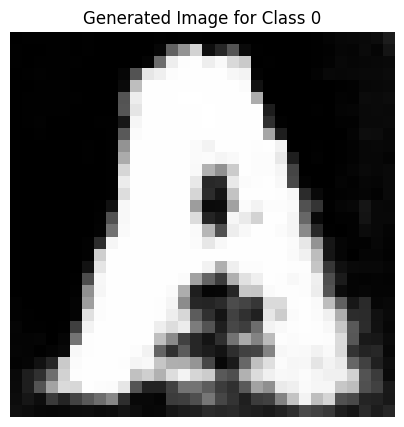

Epoch [604/2500], D_loss: 0.10156282782554626, G_loss: -0.5677073001861572


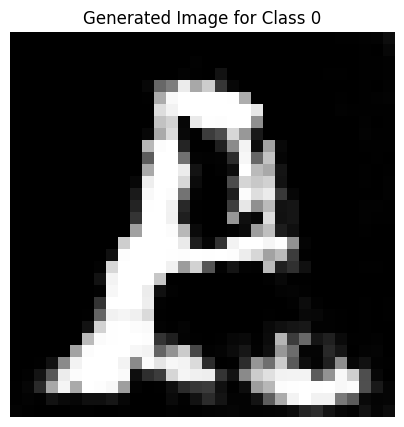

Epoch [605/2500], D_loss: 0.0425640344619751, G_loss: -0.6007709503173828


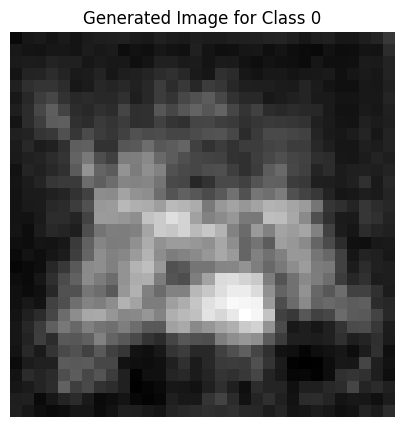

Epoch [606/2500], D_loss: 0.028421714901924133, G_loss: -0.5821380615234375


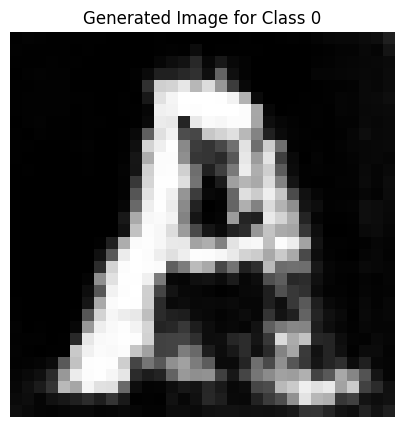

Epoch [607/2500], D_loss: 0.034117236733436584, G_loss: -0.6727088689804077


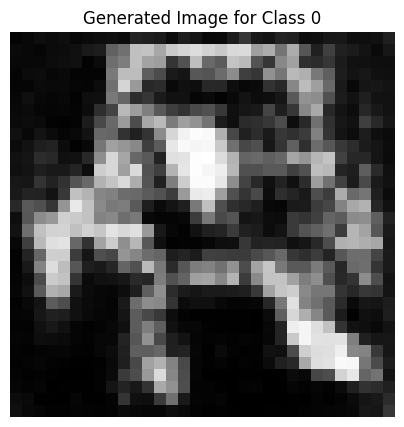

Epoch [608/2500], D_loss: 0.011346101760864258, G_loss: -0.6792398691177368


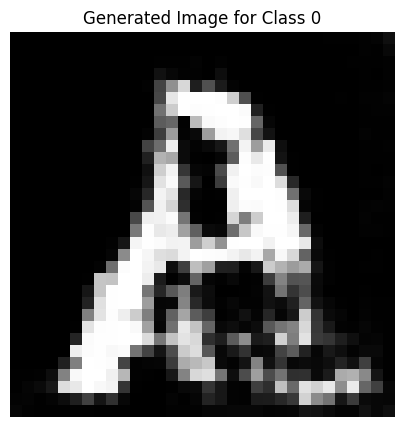

Epoch [609/2500], D_loss: -0.016852349042892456, G_loss: -0.4855942726135254


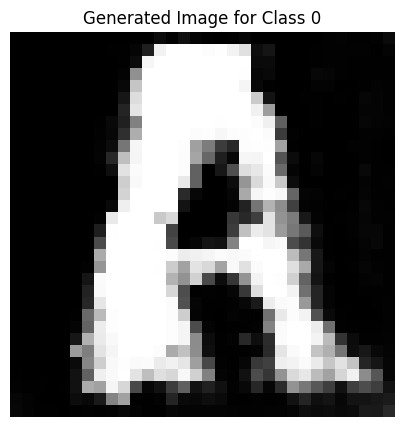

Epoch [610/2500], D_loss: 0.056986890733242035, G_loss: -0.606791079044342


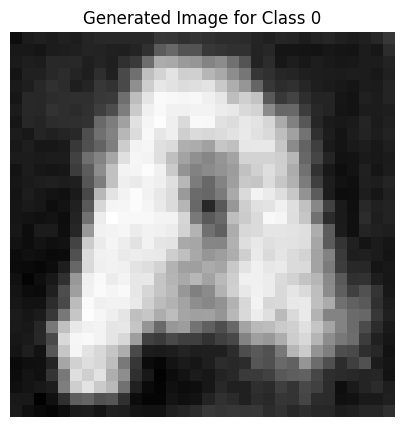

Epoch [611/2500], D_loss: 0.0570288747549057, G_loss: -0.6139623522758484


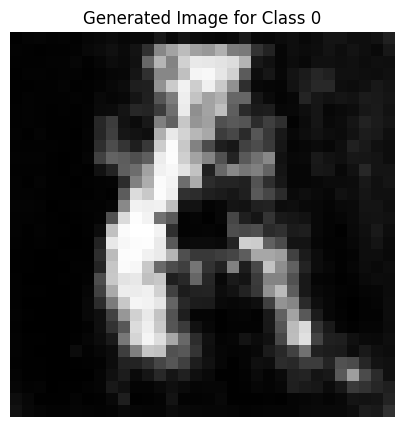

Epoch [612/2500], D_loss: 0.024457618594169617, G_loss: -0.5371193289756775


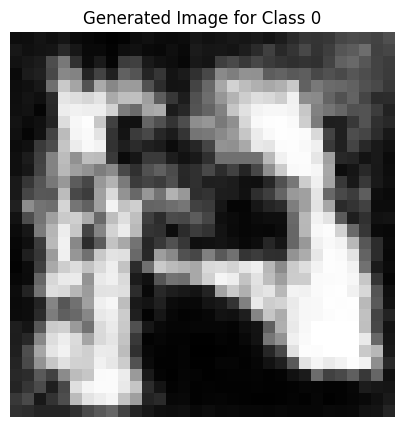

Epoch [613/2500], D_loss: 0.017556585371494293, G_loss: -0.5751370787620544


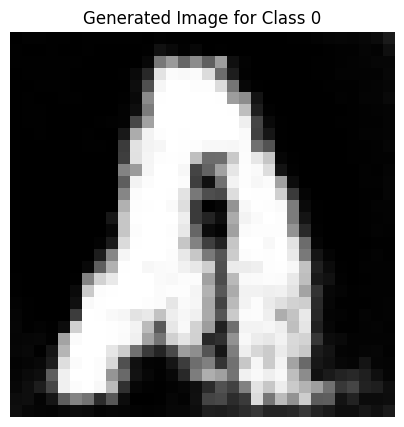

Epoch [614/2500], D_loss: 0.17254965007305145, G_loss: -0.6946871280670166


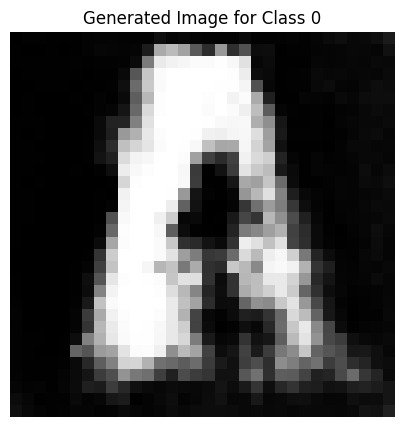

Epoch [615/2500], D_loss: 0.04032102972269058, G_loss: -0.5757339000701904


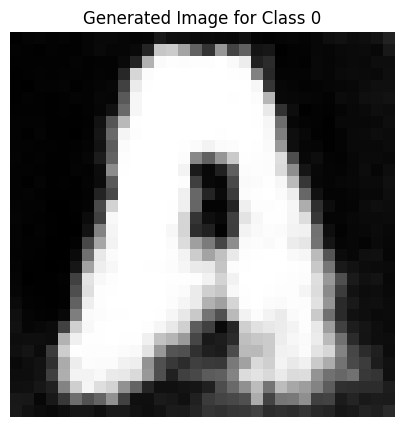

Epoch [616/2500], D_loss: 0.25052496790885925, G_loss: -0.6224035024642944


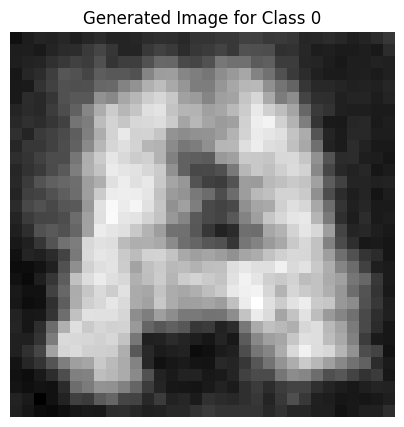

Epoch [617/2500], D_loss: 0.05360601097345352, G_loss: -0.5625707507133484


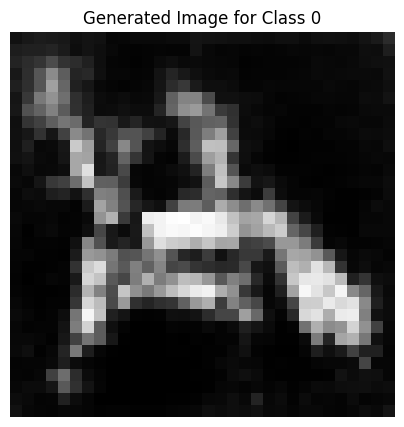

Epoch [618/2500], D_loss: 0.06619063019752502, G_loss: -0.5948660373687744


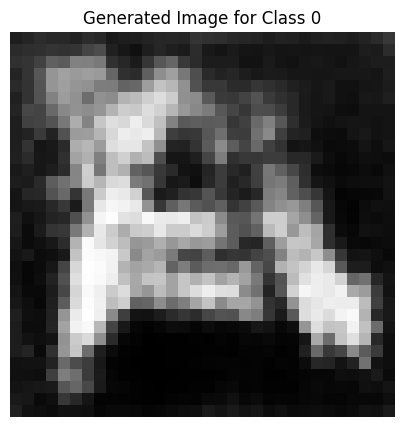

Epoch [619/2500], D_loss: 0.049833059310913086, G_loss: -0.5675692558288574


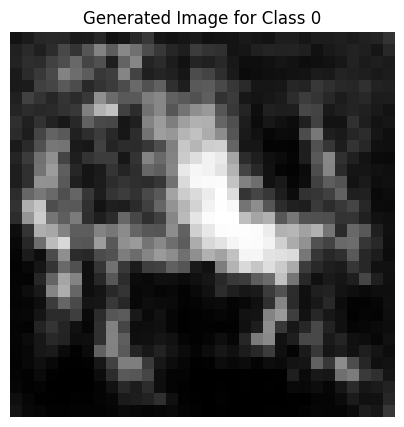

Epoch [620/2500], D_loss: -0.001054905354976654, G_loss: -0.5466282367706299


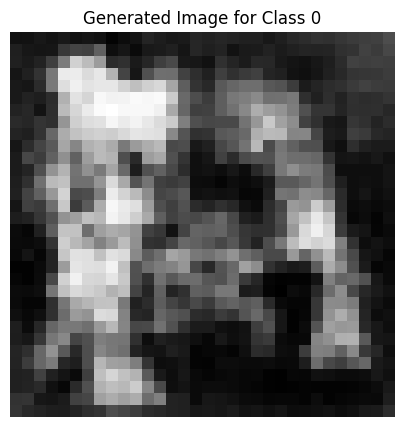

Epoch [621/2500], D_loss: 0.04475228488445282, G_loss: -0.5055147409439087


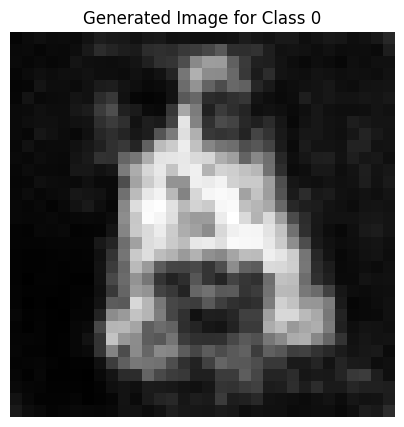

Epoch [622/2500], D_loss: 0.03869728744029999, G_loss: -0.3209131956100464


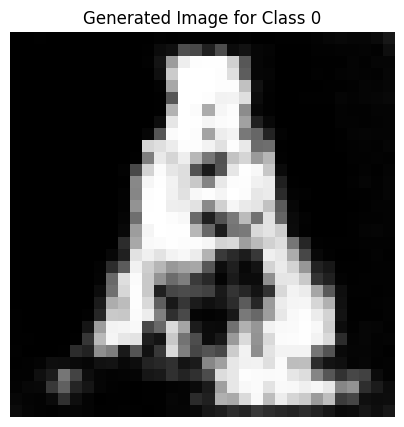

Epoch [623/2500], D_loss: 0.016271263360977173, G_loss: -0.5436307191848755


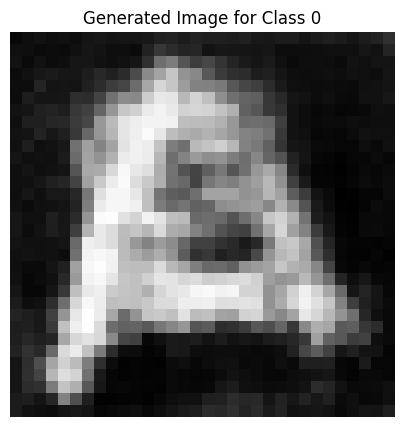

Epoch [624/2500], D_loss: 0.016663432121276855, G_loss: -0.4285353422164917


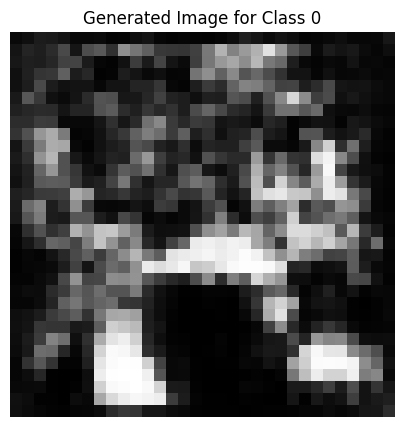

Epoch [625/2500], D_loss: 0.03190252184867859, G_loss: -0.557976484298706


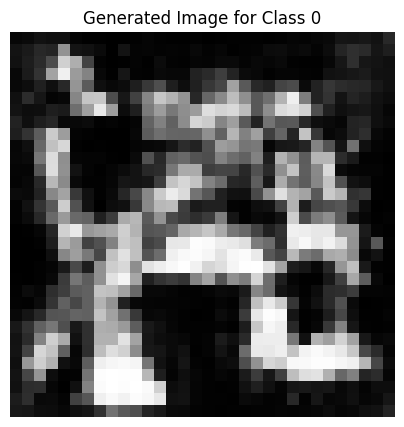

Epoch [626/2500], D_loss: 0.031147494912147522, G_loss: -0.616295337677002


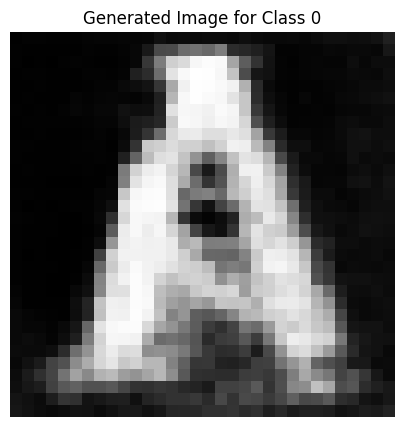

Epoch [627/2500], D_loss: 0.04177775979042053, G_loss: -0.5807034969329834


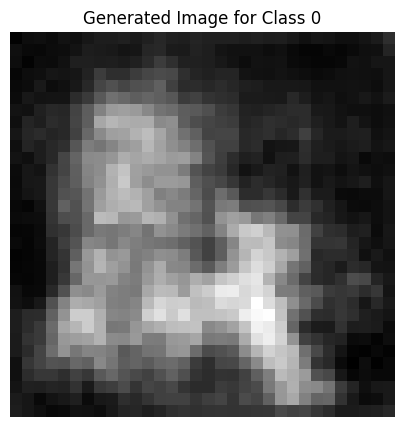

Epoch [628/2500], D_loss: 0.07757297158241272, G_loss: -0.6012847423553467


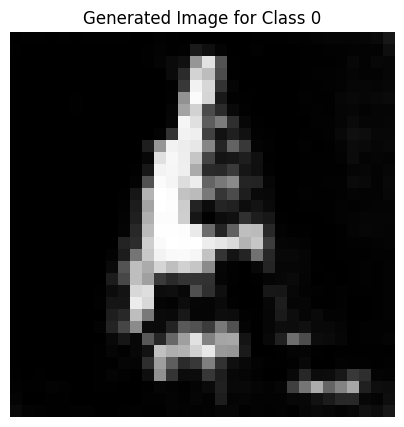

Epoch [629/2500], D_loss: 0.04614371061325073, G_loss: -0.4970233142375946


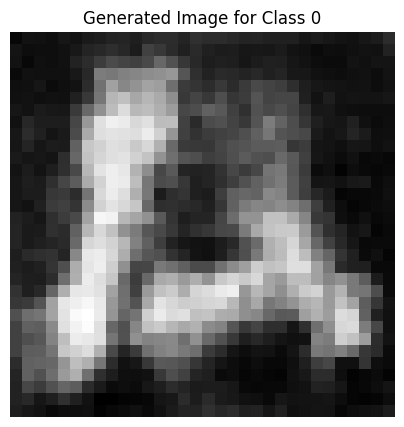

Epoch [630/2500], D_loss: 0.014624714851379395, G_loss: -0.5725969076156616


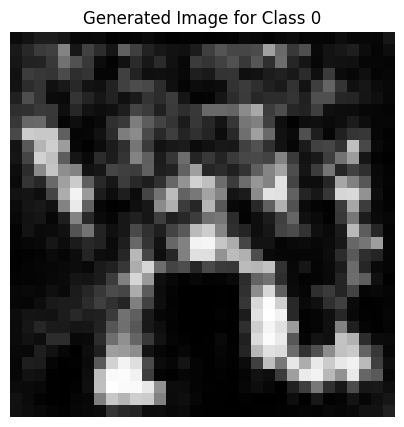

Epoch [631/2500], D_loss: 0.02576432377099991, G_loss: -0.6644183397293091


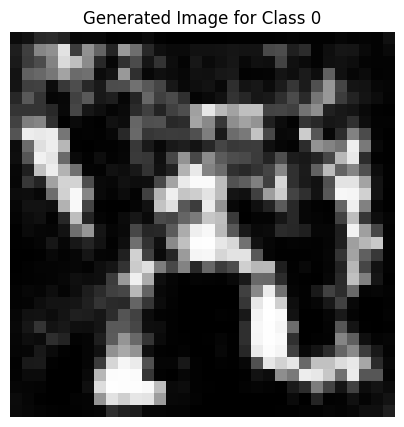

Epoch [632/2500], D_loss: 0.04010599106550217, G_loss: -0.6500930786132812


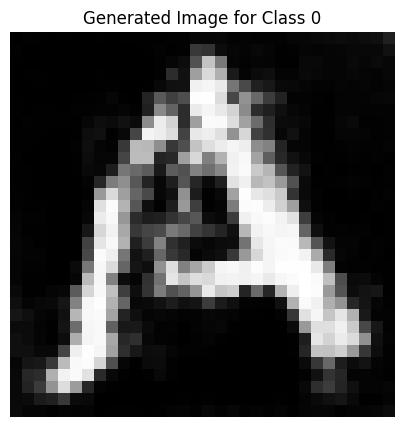

Epoch [633/2500], D_loss: 0.06184644252061844, G_loss: -0.6355451345443726


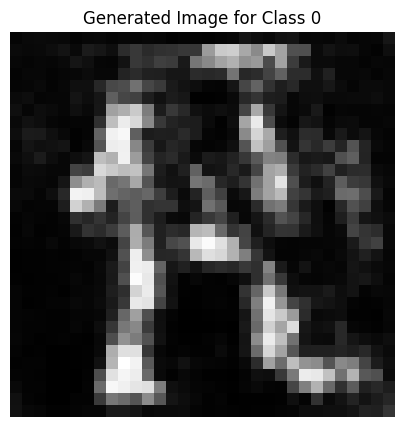

Epoch [634/2500], D_loss: 0.07496148347854614, G_loss: -0.5706565380096436


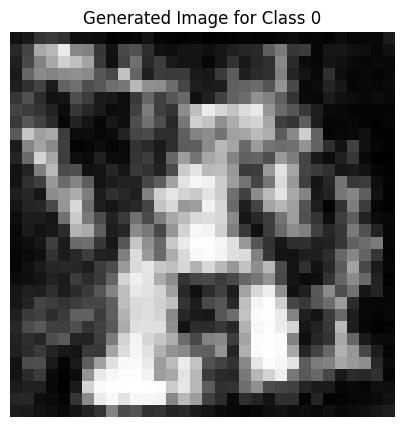

Epoch [635/2500], D_loss: 0.05253137648105621, G_loss: -0.650793194770813


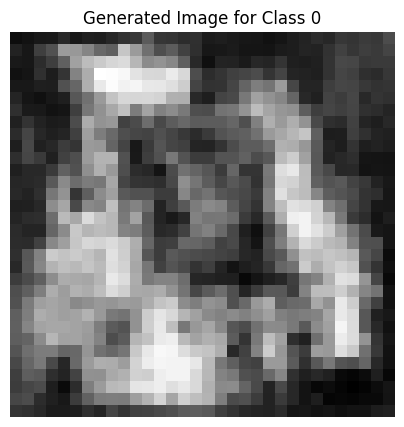

Epoch [636/2500], D_loss: 0.02687184512615204, G_loss: -0.5657821893692017


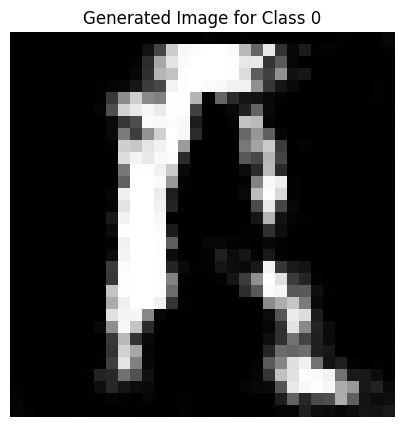

Epoch [637/2500], D_loss: 0.032935477793216705, G_loss: -0.6551257371902466


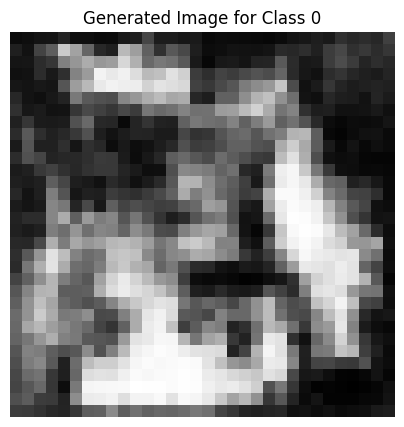

Epoch [638/2500], D_loss: 0.050487667322158813, G_loss: -0.579468309879303


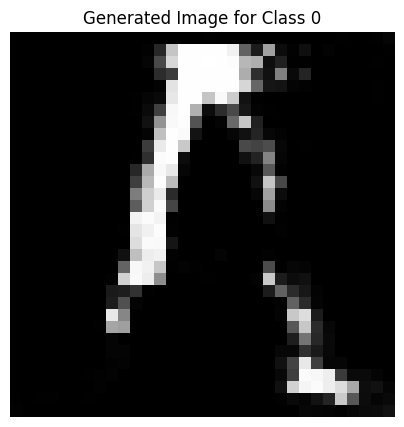

Epoch [639/2500], D_loss: 0.05485476553440094, G_loss: -0.6449536681175232


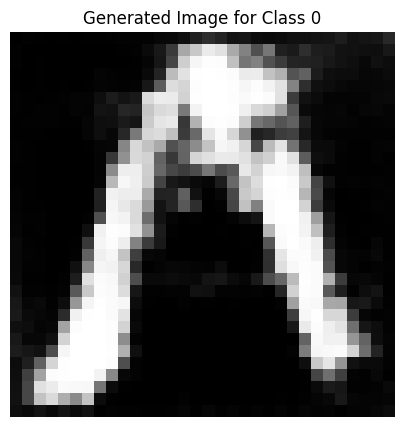

Epoch [640/2500], D_loss: 0.04682980477809906, G_loss: -0.5414994359016418


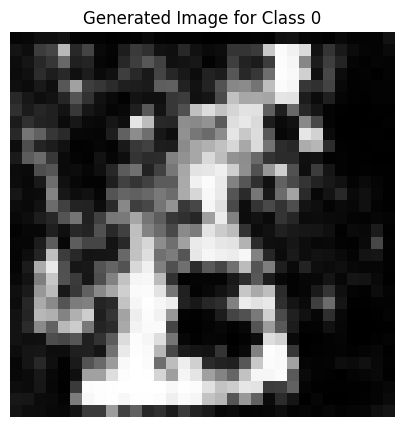

Epoch [641/2500], D_loss: 0.06122012436389923, G_loss: -0.6284999847412109


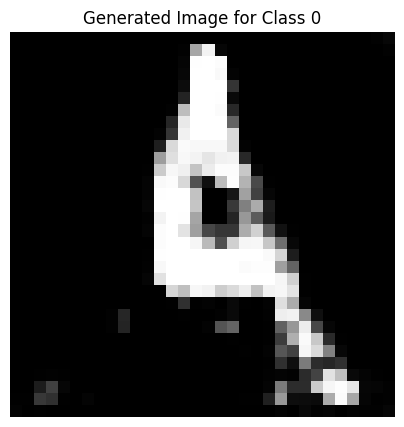

Epoch [642/2500], D_loss: 0.07101906836032867, G_loss: -0.5861316919326782


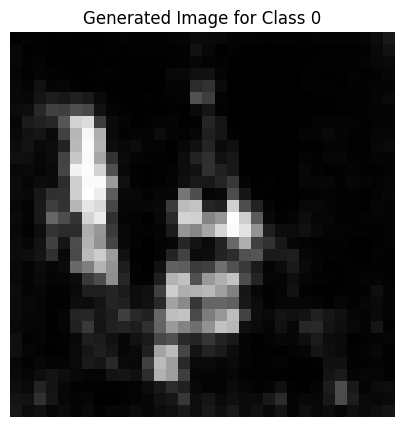

Epoch [643/2500], D_loss: -0.000762060284614563, G_loss: -0.6155244708061218


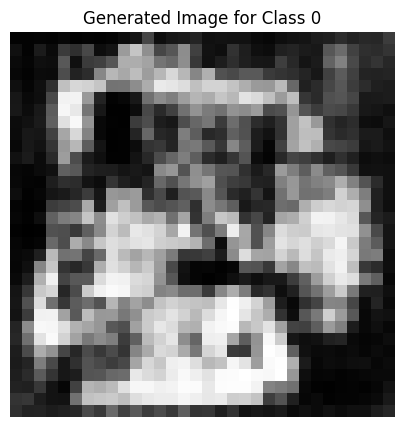

Epoch [644/2500], D_loss: 0.020014114677906036, G_loss: -0.545994758605957


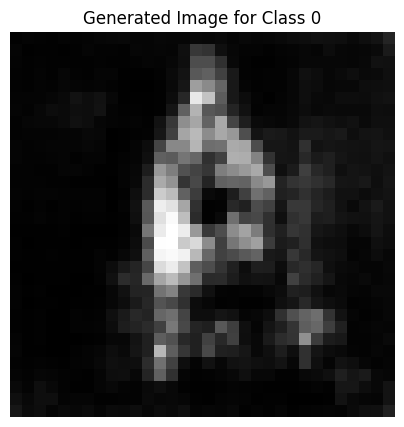

Epoch [645/2500], D_loss: -0.027060218155384064, G_loss: -0.504216194152832


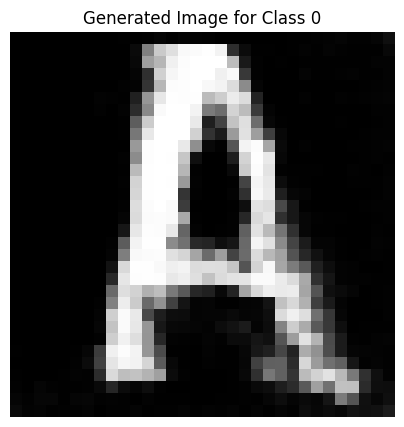

Epoch [646/2500], D_loss: 0.025767989456653595, G_loss: -0.5966757535934448


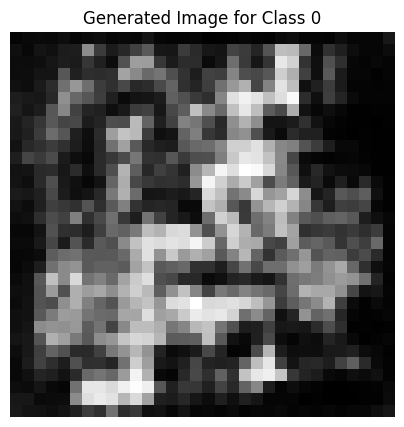

Epoch [647/2500], D_loss: 0.004569508135318756, G_loss: -0.4361380934715271


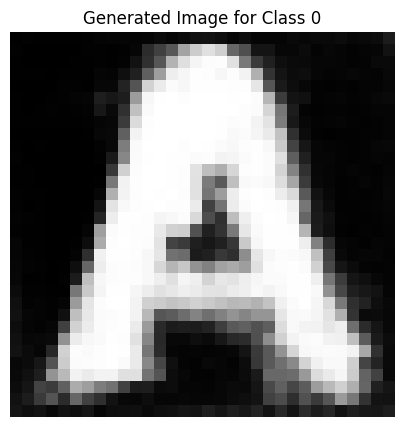

Epoch [648/2500], D_loss: 0.1326359510421753, G_loss: -0.5157317519187927


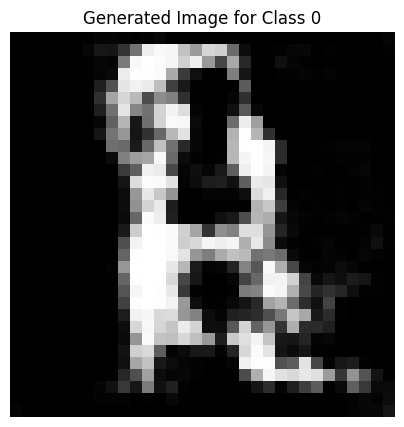

Epoch [649/2500], D_loss: 0.02448144555091858, G_loss: -0.537874698638916


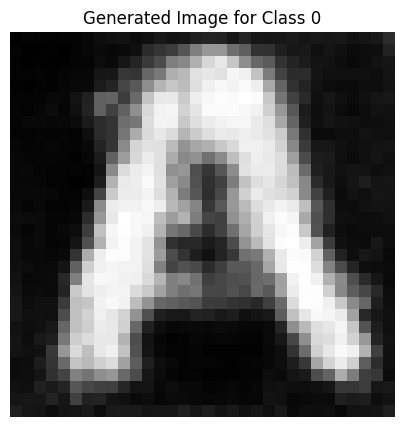

Epoch [650/2500], D_loss: 0.012832455337047577, G_loss: -0.5606120824813843


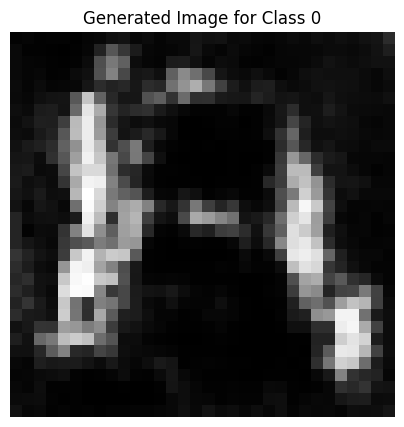

Epoch [651/2500], D_loss: 0.017407074570655823, G_loss: -0.572281002998352


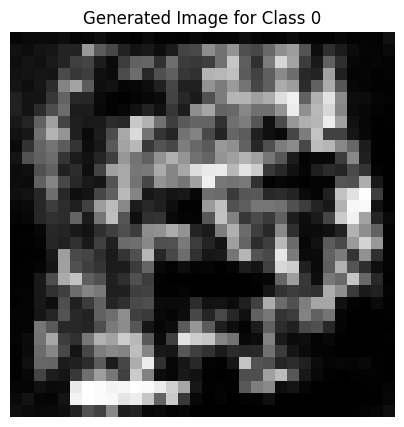

Epoch [652/2500], D_loss: 0.13215094804763794, G_loss: -0.32505977153778076


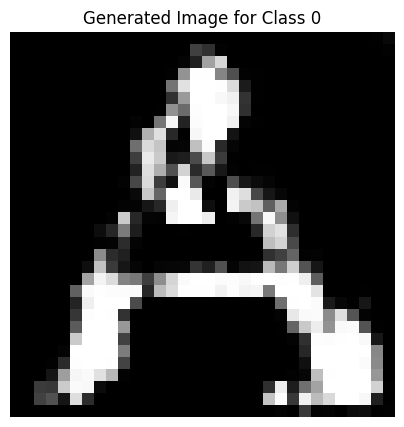

Epoch [653/2500], D_loss: -0.001551598310470581, G_loss: -0.5589579343795776


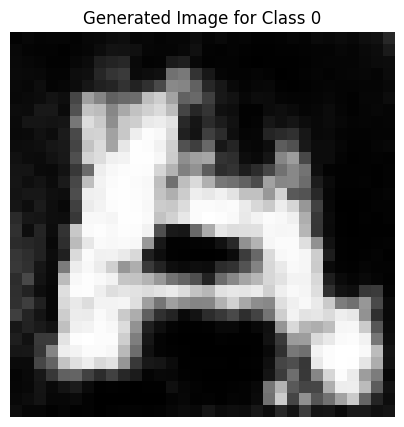

Epoch [654/2500], D_loss: 0.10515360534191132, G_loss: -0.6224616765975952


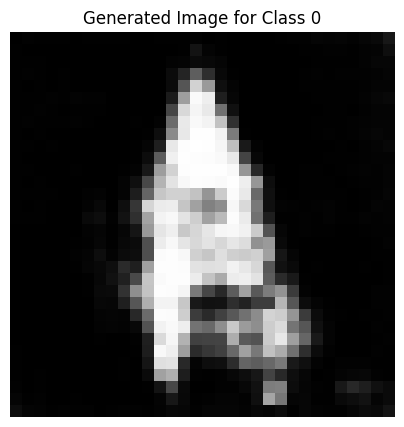

Epoch [655/2500], D_loss: 0.10099494457244873, G_loss: -0.5620579719543457


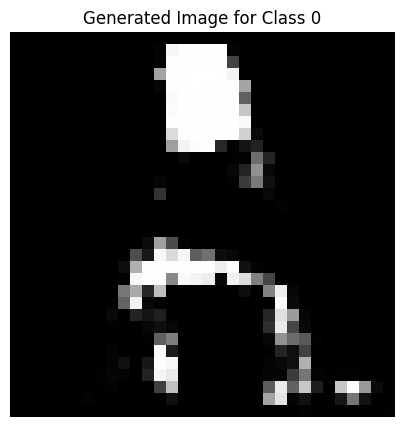

Epoch [656/2500], D_loss: 0.08096983283758163, G_loss: -0.5514458417892456


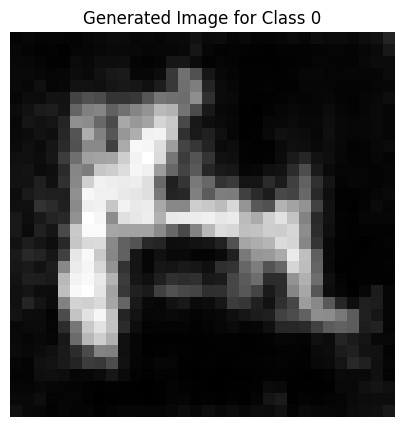

Epoch [657/2500], D_loss: 0.07933522760868073, G_loss: -0.6301752328872681


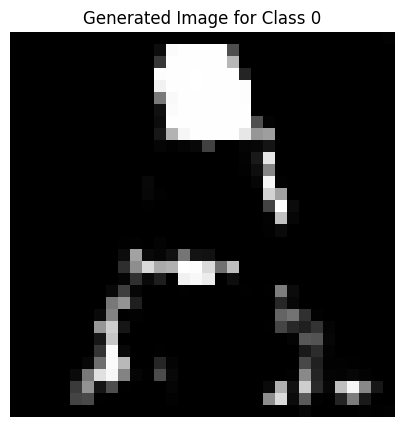

Epoch [658/2500], D_loss: 0.03475995361804962, G_loss: -0.5869427919387817


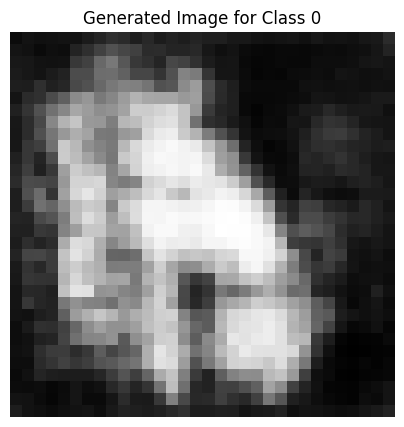

Epoch [659/2500], D_loss: 0.028563886880874634, G_loss: -0.5439442992210388


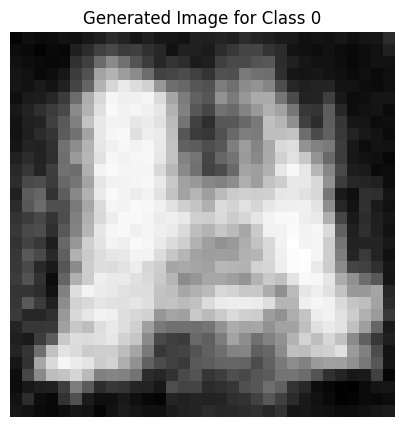

Epoch [660/2500], D_loss: -0.004671536386013031, G_loss: -0.5752285122871399


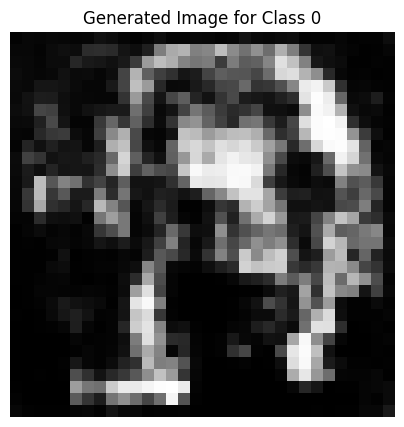

Epoch [661/2500], D_loss: 0.009141102433204651, G_loss: -0.5315921306610107


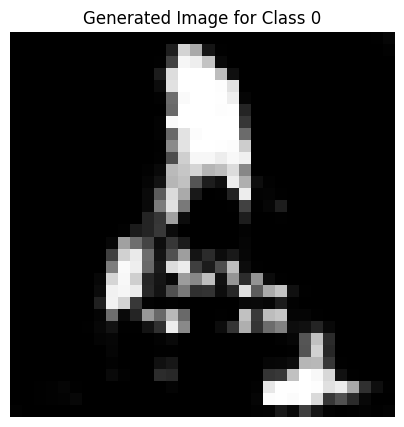

Epoch [662/2500], D_loss: 0.021263882517814636, G_loss: -0.5411555767059326


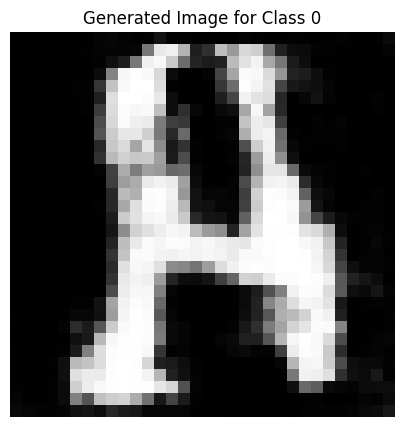

Epoch [663/2500], D_loss: 0.0658339336514473, G_loss: -0.5585098266601562


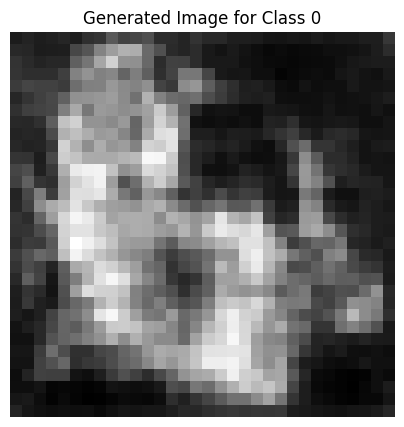

Epoch [664/2500], D_loss: 0.015883877873420715, G_loss: -0.630845308303833


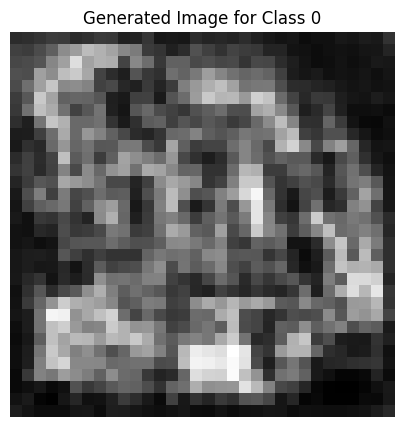

Epoch [665/2500], D_loss: 0.03699560463428497, G_loss: -0.6499260663986206


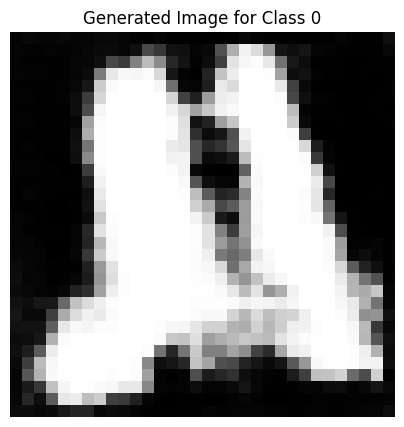

Epoch [666/2500], D_loss: 0.013445921242237091, G_loss: -0.48481035232543945


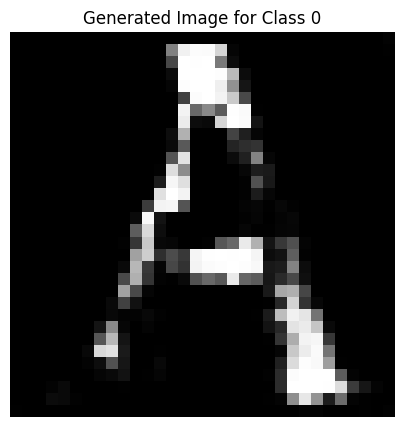

Epoch [667/2500], D_loss: 0.008279751986265182, G_loss: -0.5735430717468262


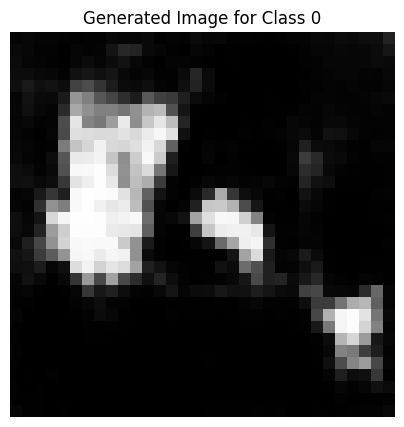

Epoch [668/2500], D_loss: 0.04422170668840408, G_loss: -0.569979190826416


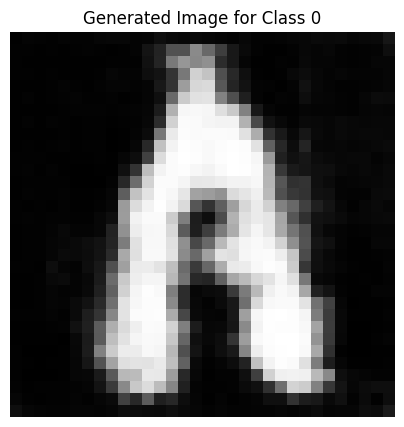

Epoch [669/2500], D_loss: -0.003926202654838562, G_loss: -0.5780534744262695


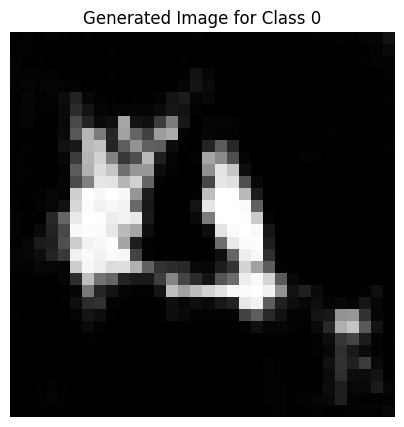

Epoch [670/2500], D_loss: 0.01767628639936447, G_loss: -0.5375328063964844


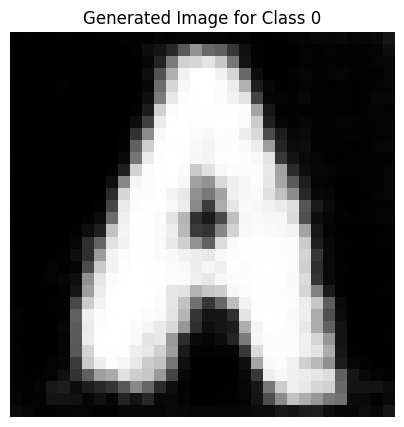

Epoch [671/2500], D_loss: -0.0021071135997772217, G_loss: -0.5679932832717896


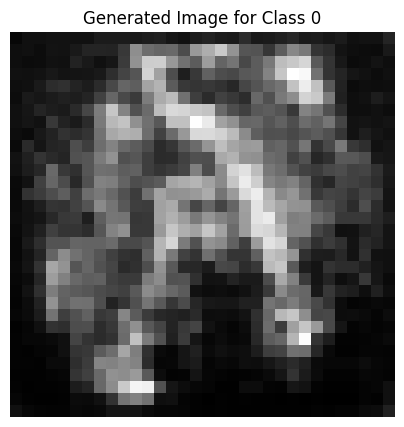

Epoch [672/2500], D_loss: 0.012094326317310333, G_loss: -0.5150557160377502


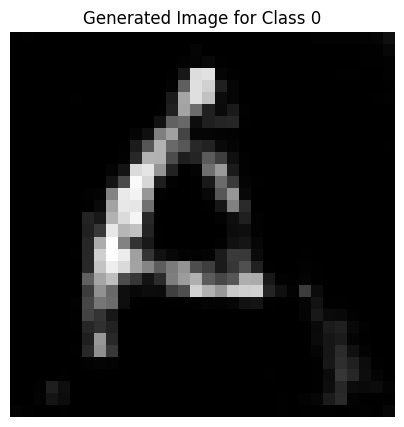

Epoch [673/2500], D_loss: 0.00938975065946579, G_loss: -0.5803316831588745


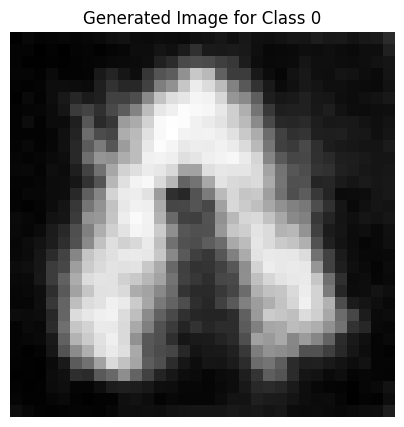

Epoch [674/2500], D_loss: 0.05931392312049866, G_loss: -0.5437197089195251


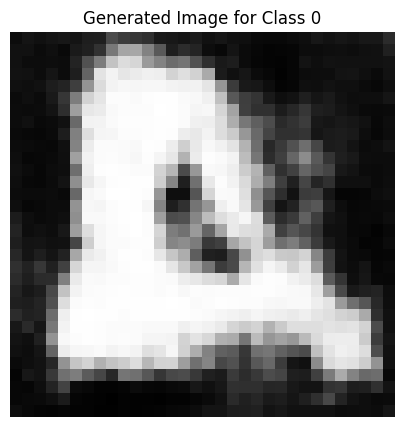

Epoch [675/2500], D_loss: 0.022783860564231873, G_loss: -0.5631012916564941


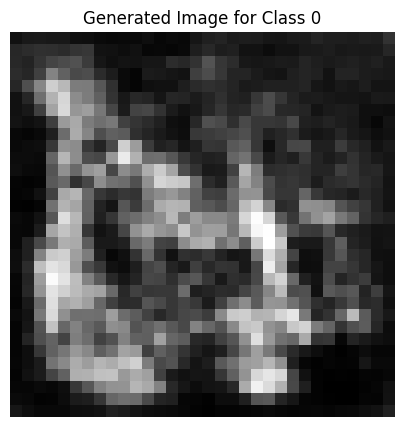

Epoch [676/2500], D_loss: 0.016662627458572388, G_loss: -0.5575071573257446


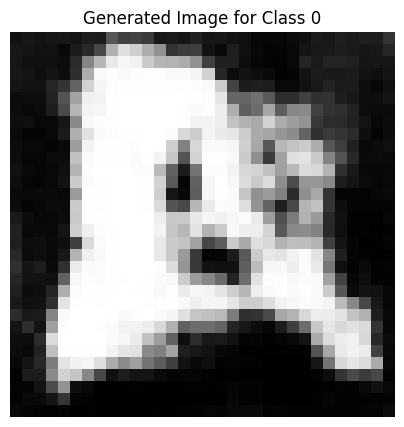

Epoch [677/2500], D_loss: 0.04099304974079132, G_loss: -0.5253318548202515


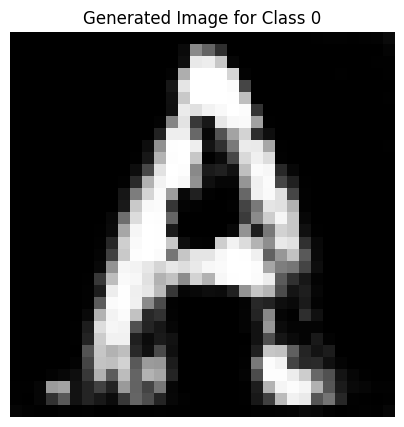

Epoch [678/2500], D_loss: -0.012267477810382843, G_loss: -0.4625045657157898


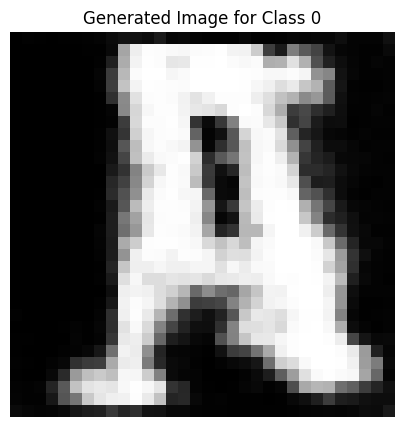

Epoch [679/2500], D_loss: 0.01032567024230957, G_loss: -0.5698522329330444


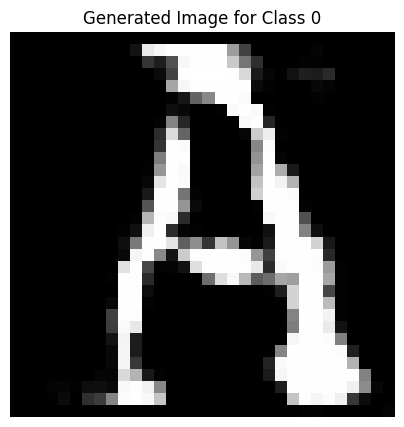

Epoch [680/2500], D_loss: 0.00251132994890213, G_loss: -0.5469529628753662


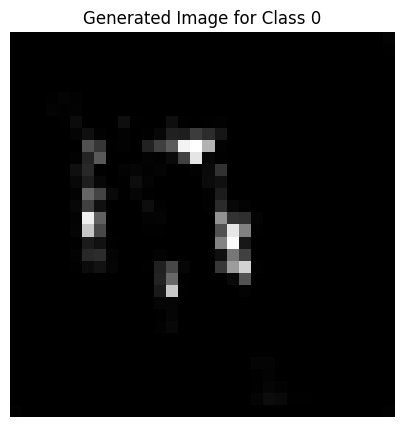

Epoch [681/2500], D_loss: 0.026082679629325867, G_loss: -0.5267909169197083


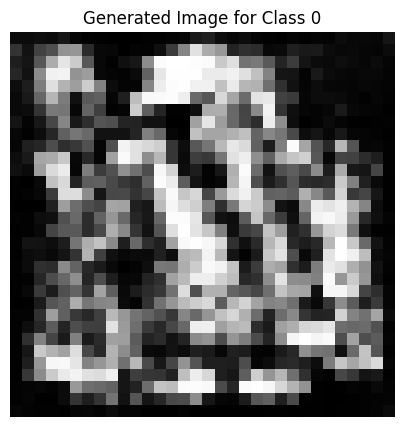

Epoch [682/2500], D_loss: -0.0012237206101417542, G_loss: -0.5519740581512451


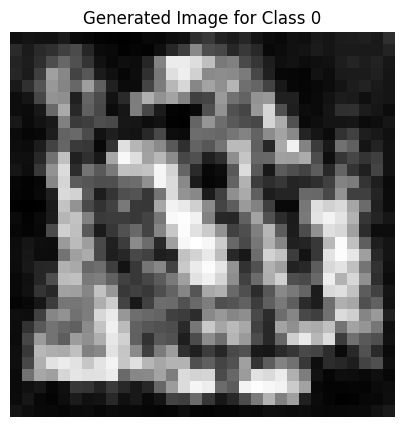

Epoch [683/2500], D_loss: 0.017619267106056213, G_loss: -0.4843416213989258


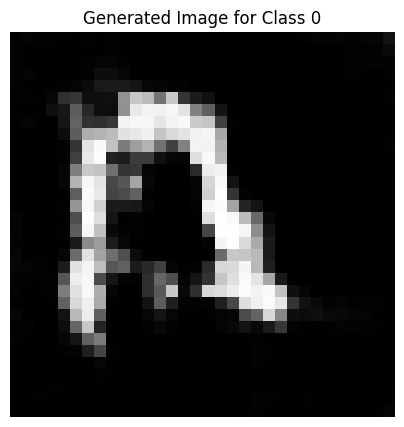

Epoch [684/2500], D_loss: 0.033015795052051544, G_loss: -0.5675851702690125


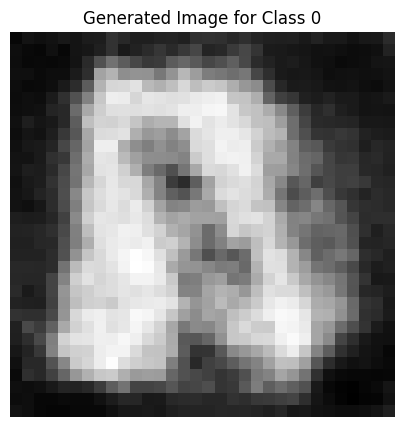

Epoch [685/2500], D_loss: 0.05745196342468262, G_loss: -0.5402801632881165


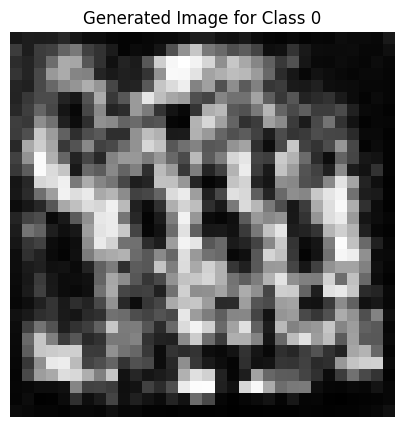

Epoch [686/2500], D_loss: -0.010852940380573273, G_loss: -0.564781904220581


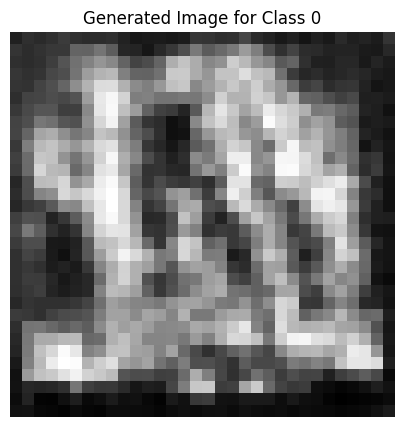

Epoch [687/2500], D_loss: 0.042094871401786804, G_loss: -0.5688817501068115


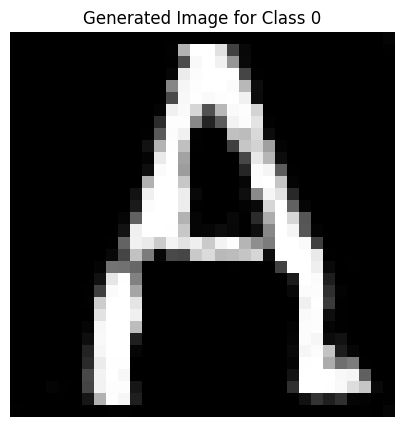

Epoch [688/2500], D_loss: 0.010723970830440521, G_loss: -0.532512903213501


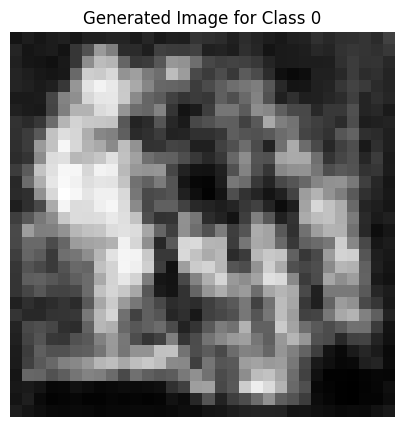

Epoch [689/2500], D_loss: 0.02503826469182968, G_loss: -0.5228821635246277


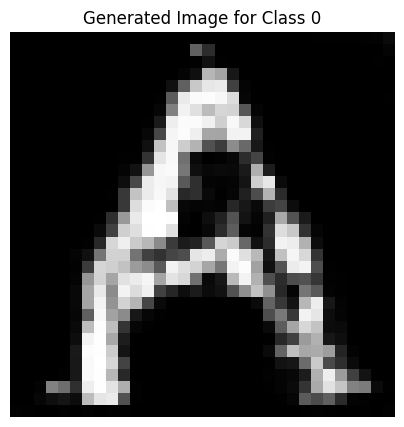

Epoch [690/2500], D_loss: 0.01606001704931259, G_loss: -0.5840544700622559


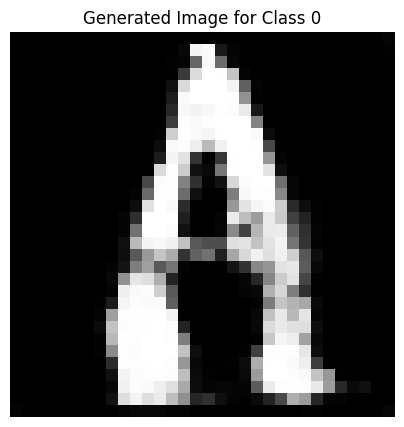

Epoch [691/2500], D_loss: 0.02045723795890808, G_loss: -0.5511767268180847


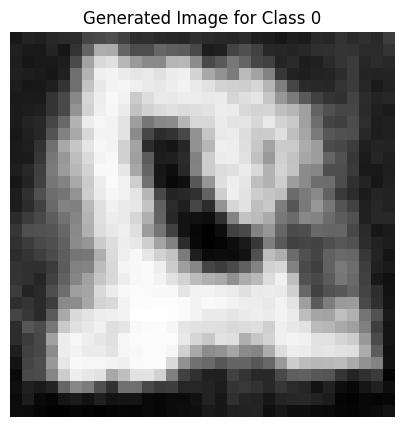

Epoch [692/2500], D_loss: 0.07001067698001862, G_loss: -0.4992823600769043


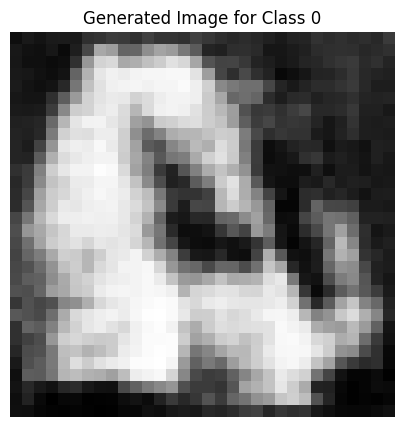

Epoch [693/2500], D_loss: 0.02598273754119873, G_loss: -0.5433192253112793


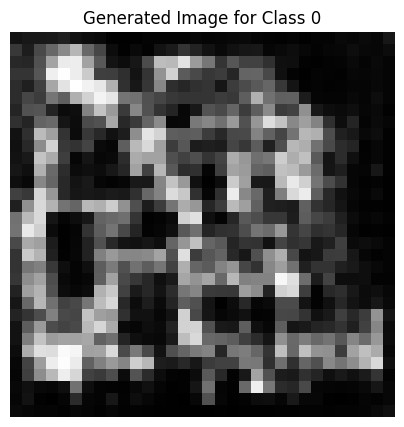

Epoch [694/2500], D_loss: 0.01886957883834839, G_loss: -0.5983033180236816


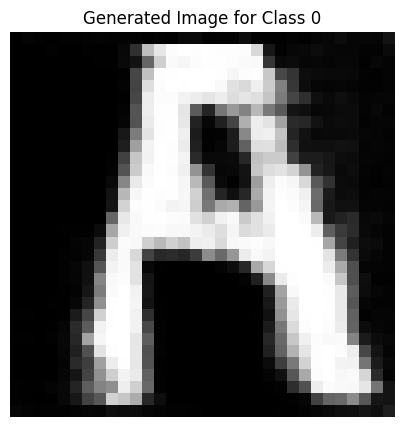

Epoch [695/2500], D_loss: 0.018935024738311768, G_loss: -0.5666332244873047


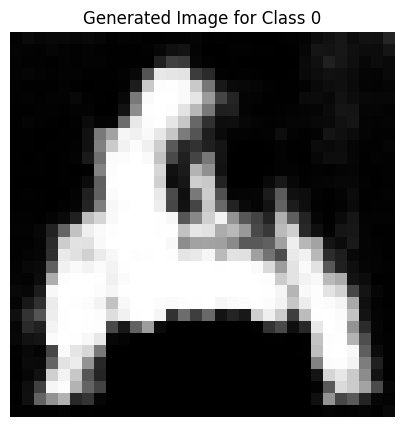

Epoch [696/2500], D_loss: 0.00032545626163482666, G_loss: -0.527070164680481


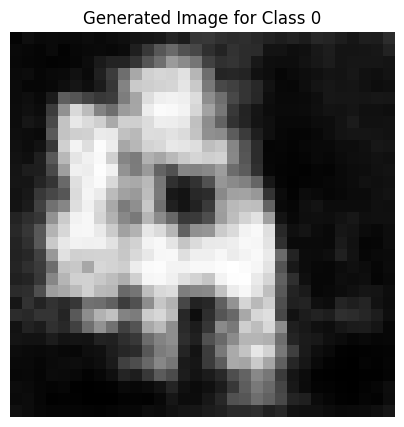

Epoch [697/2500], D_loss: 0.05218544602394104, G_loss: -0.6469653844833374


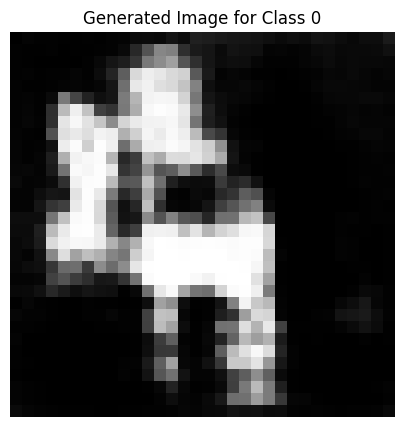

Epoch [698/2500], D_loss: 0.027870528399944305, G_loss: -0.5749757289886475


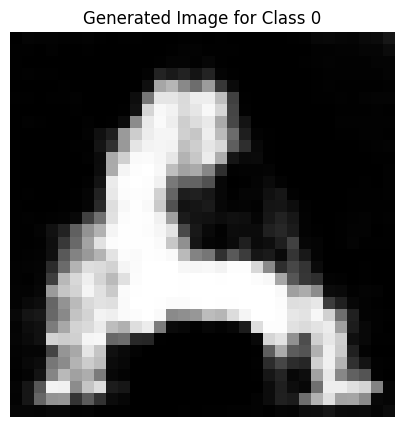

Epoch [699/2500], D_loss: 0.08690705895423889, G_loss: -0.43519267439842224


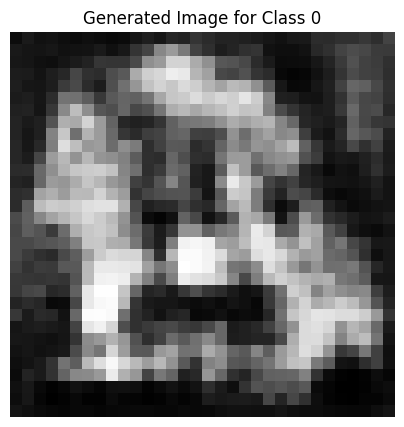

Epoch [700/2500], D_loss: 0.041021205484867096, G_loss: -0.6368737816810608


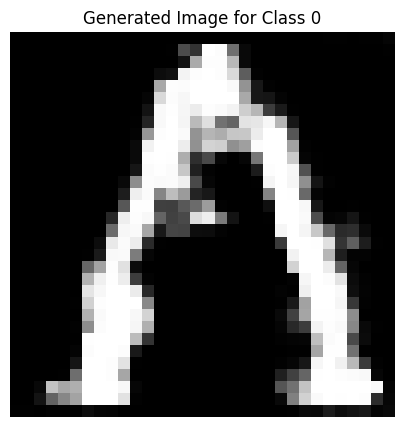

Epoch [701/2500], D_loss: 0.02666901797056198, G_loss: -0.5771099925041199


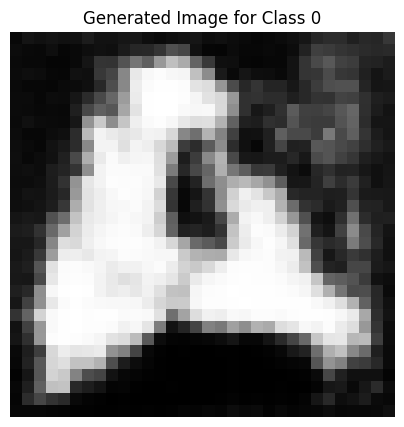

Epoch [702/2500], D_loss: 0.03966765105724335, G_loss: -0.600072979927063


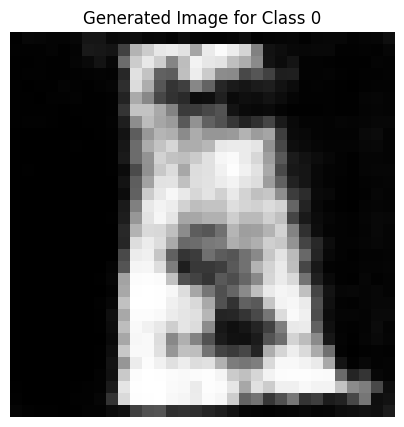

Epoch [703/2500], D_loss: 0.021272897720336914, G_loss: -0.466298371553421


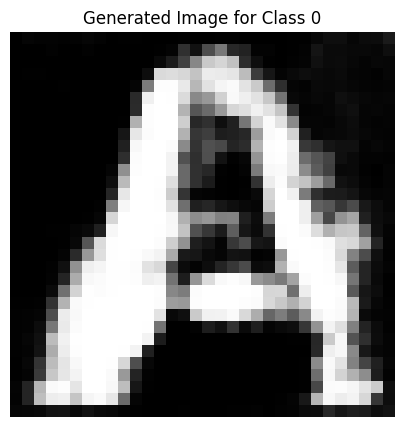

Epoch [704/2500], D_loss: 0.007390826940536499, G_loss: -0.5781149864196777


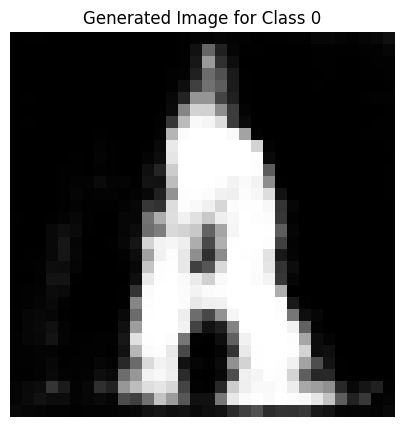

Epoch [705/2500], D_loss: 0.01315154880285263, G_loss: -0.5794419050216675


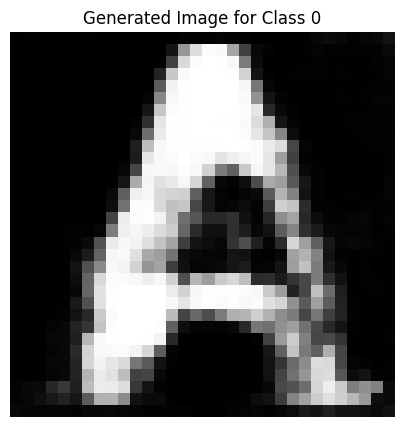

Epoch [706/2500], D_loss: 0.01979423314332962, G_loss: -0.554695725440979


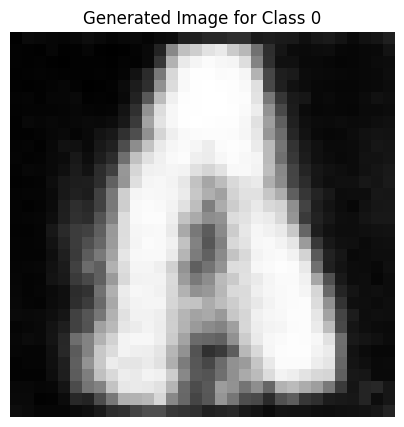

Epoch [707/2500], D_loss: 0.022216245532035828, G_loss: -0.6332439184188843


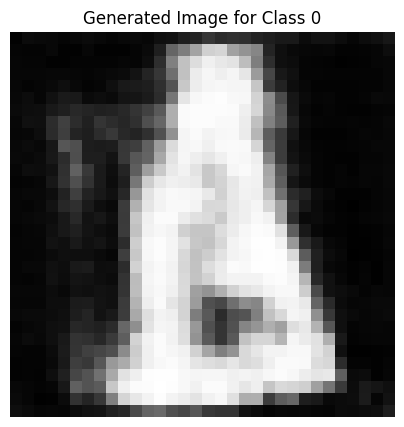

Epoch [708/2500], D_loss: 0.05893389880657196, G_loss: -0.5707948207855225


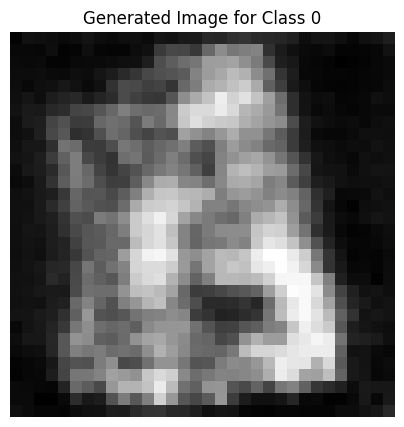

Epoch [709/2500], D_loss: 0.02766381949186325, G_loss: -0.5766063332557678


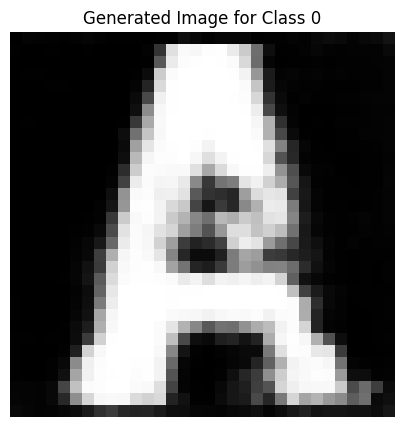

Epoch [710/2500], D_loss: -0.004938900470733643, G_loss: -0.5817254185676575


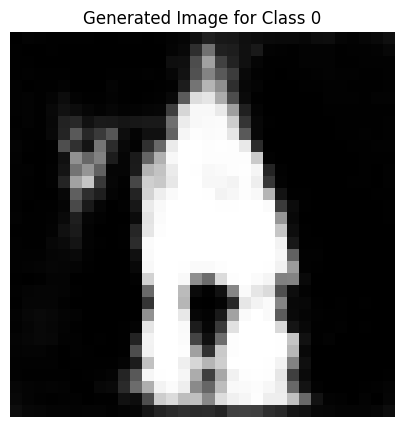

Epoch [711/2500], D_loss: -0.008519098162651062, G_loss: -0.4844076633453369


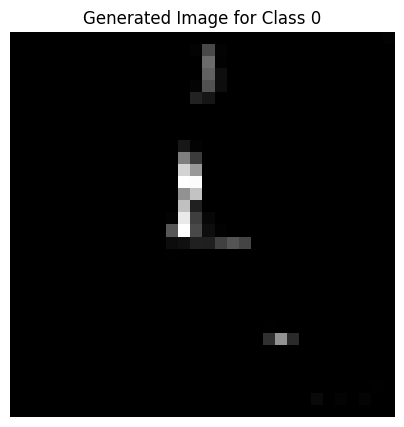

Epoch [712/2500], D_loss: 0.049816034734249115, G_loss: -0.40749645233154297


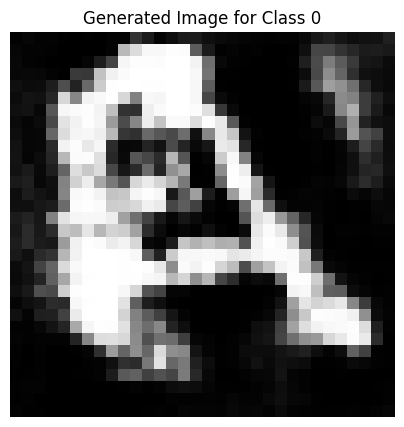

Epoch [713/2500], D_loss: 0.007434174418449402, G_loss: -0.5813290476799011


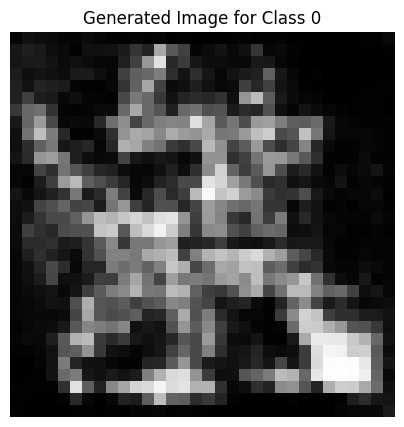

Epoch [714/2500], D_loss: -0.002695441246032715, G_loss: -0.5143356323242188


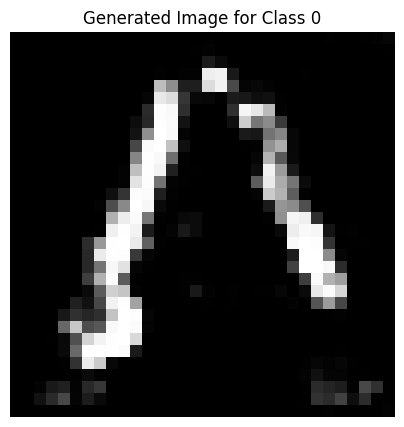

Epoch [715/2500], D_loss: 0.01873907446861267, G_loss: -0.5698415040969849


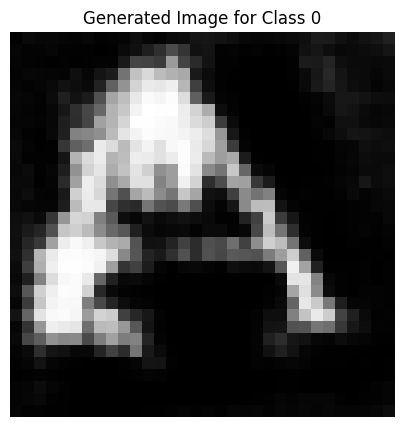

Epoch [716/2500], D_loss: 0.0929185301065445, G_loss: -0.5726374387741089


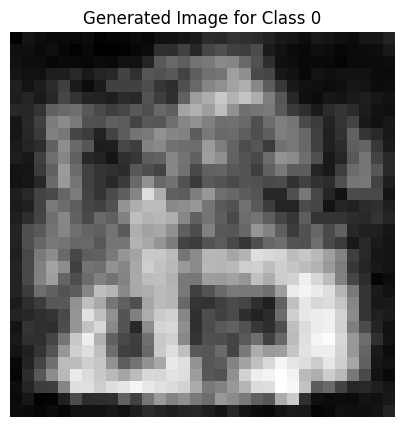

Epoch [717/2500], D_loss: 0.015369966626167297, G_loss: -0.5557857155799866


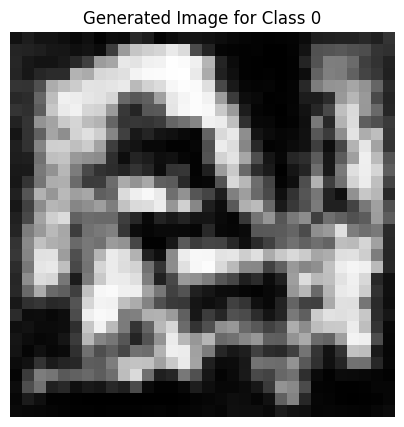

Epoch [718/2500], D_loss: 0.031231790781021118, G_loss: -0.5116618871688843


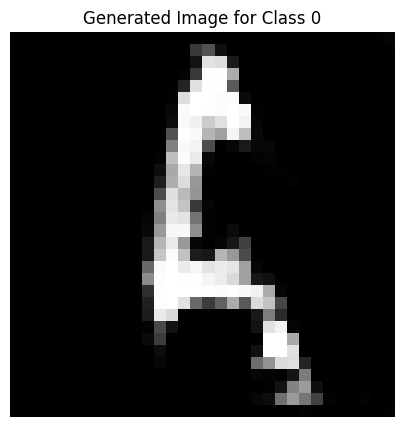

Epoch [719/2500], D_loss: -0.0002723187208175659, G_loss: -0.578658401966095


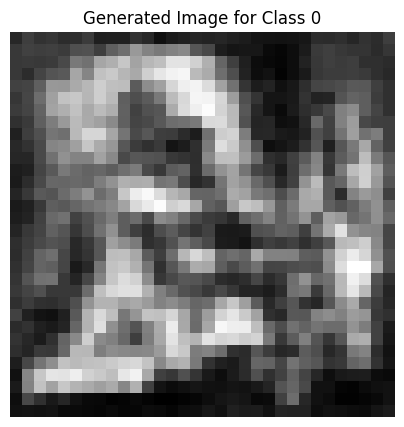

Epoch [720/2500], D_loss: 0.013631045818328857, G_loss: -0.5374321341514587


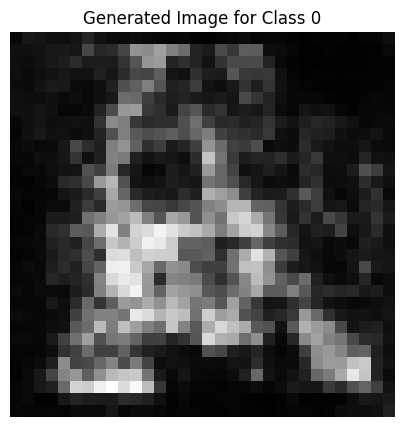

Epoch [721/2500], D_loss: 0.022606581449508667, G_loss: -0.5650005340576172


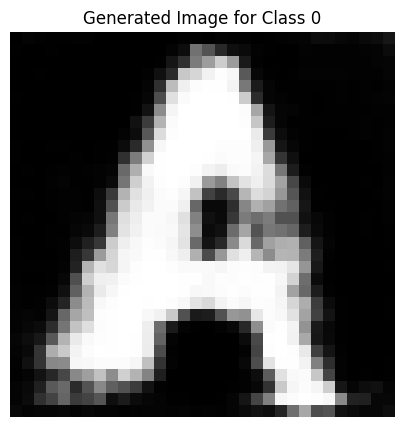

Epoch [722/2500], D_loss: 0.016682691872119904, G_loss: -0.5592543482780457


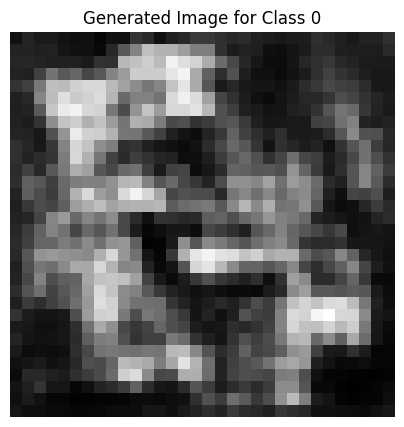

Epoch [723/2500], D_loss: 0.19099438190460205, G_loss: -0.5649315714836121


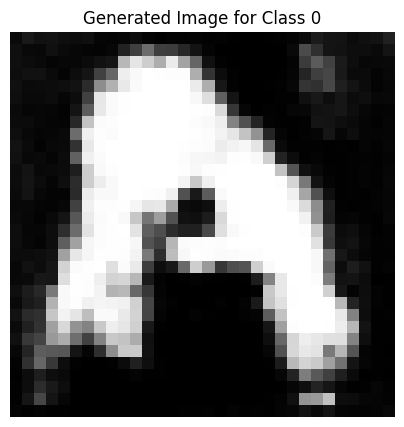

Epoch [724/2500], D_loss: 0.006978735327720642, G_loss: -0.5891562104225159


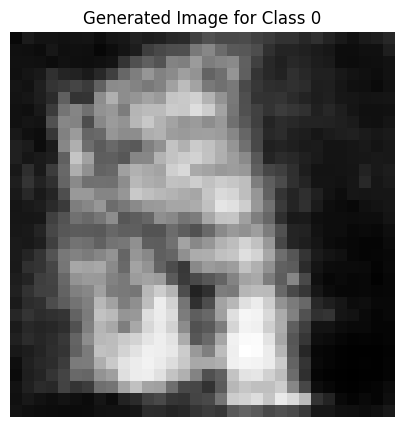

Epoch [725/2500], D_loss: 0.005935922265052795, G_loss: -0.6231147646903992


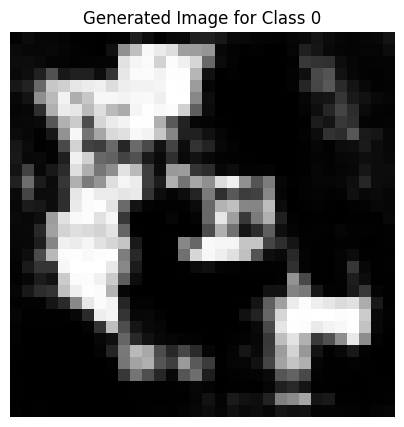

Epoch [726/2500], D_loss: 0.026760905981063843, G_loss: -0.630186140537262


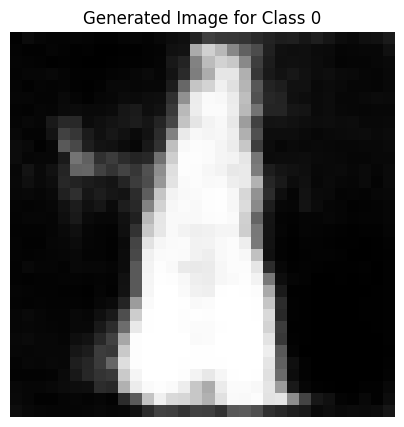

Epoch [727/2500], D_loss: 0.10492199659347534, G_loss: -0.6503350734710693


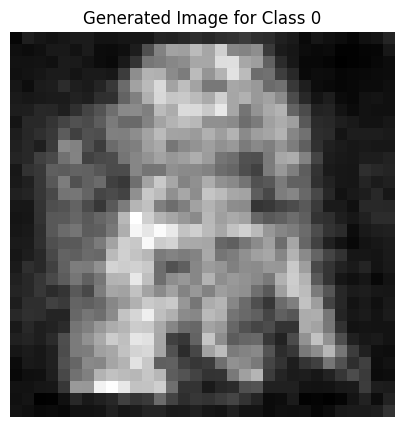

Epoch [728/2500], D_loss: 0.05073578655719757, G_loss: -0.6256181001663208


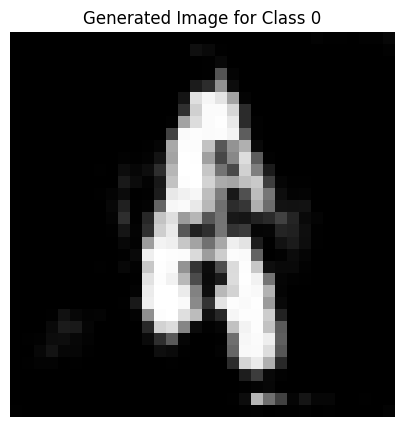

Epoch [729/2500], D_loss: 0.05484050512313843, G_loss: -0.5694743394851685


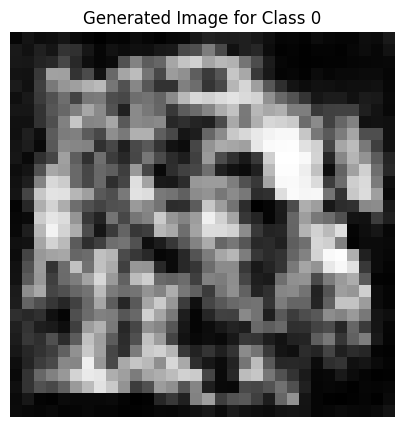

Epoch [730/2500], D_loss: 0.02180437743663788, G_loss: -0.5604459643363953


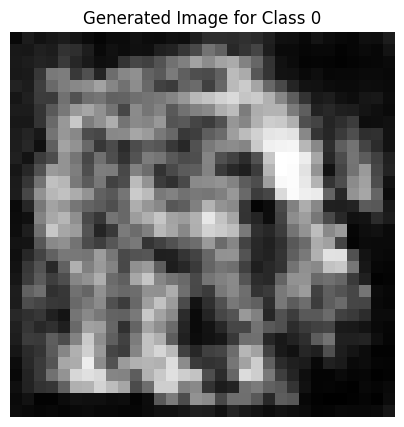

Epoch [731/2500], D_loss: -0.005678236484527588, G_loss: -0.5535644292831421


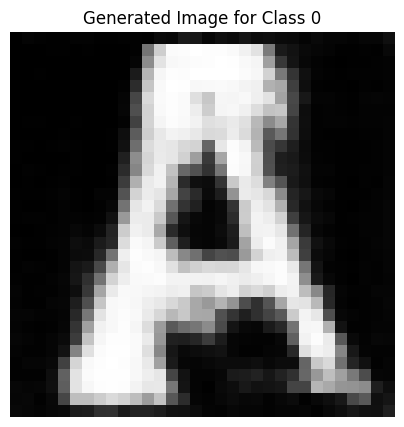

Epoch [732/2500], D_loss: 0.21410566568374634, G_loss: -0.514106035232544


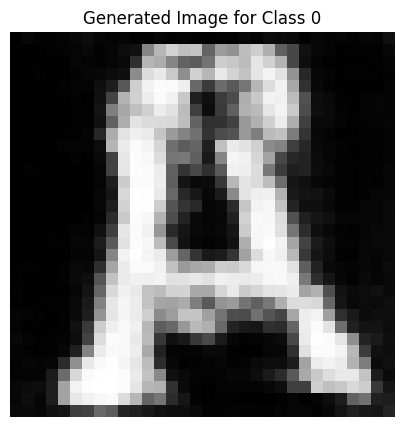

Epoch [733/2500], D_loss: 0.02011827379465103, G_loss: -0.5603600740432739


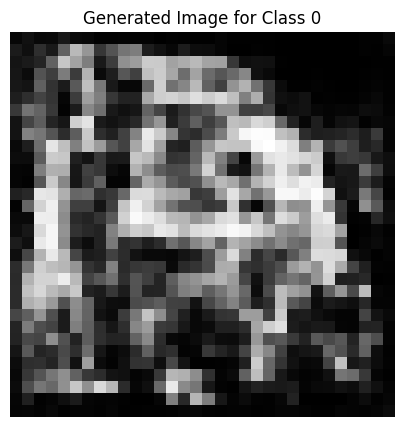

Epoch [734/2500], D_loss: 0.004062384366989136, G_loss: -0.4658931791782379


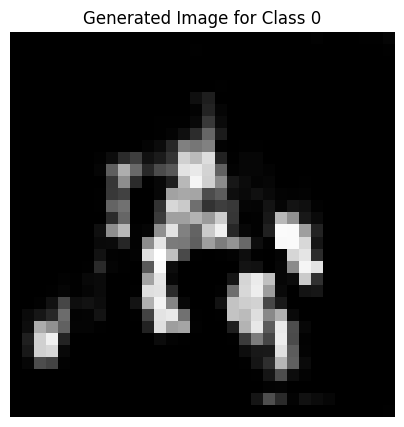

Epoch [735/2500], D_loss: 0.02314983308315277, G_loss: -0.5456840991973877


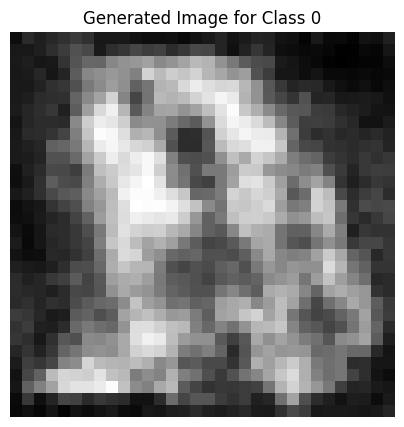

Epoch [736/2500], D_loss: -0.01499301940202713, G_loss: -0.5672199130058289


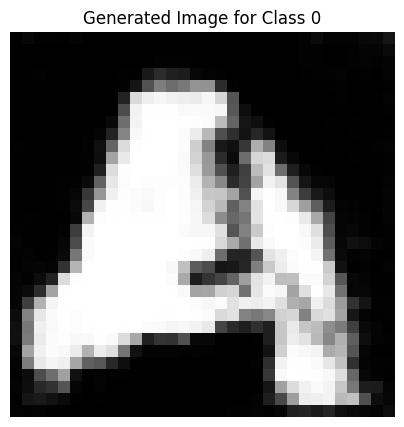

Epoch [737/2500], D_loss: 0.0014251843094825745, G_loss: -0.6249220371246338


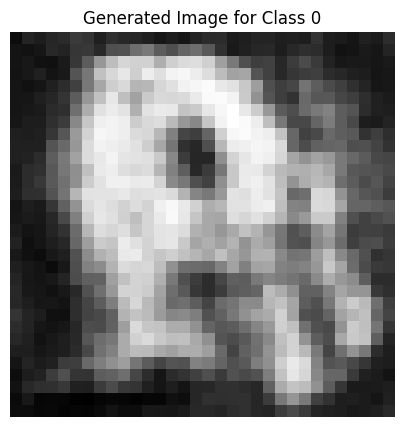

Epoch [738/2500], D_loss: 0.008054584264755249, G_loss: -0.5920943021774292


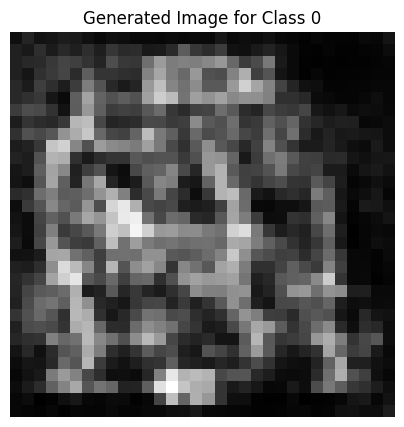

Epoch [739/2500], D_loss: 0.027407214045524597, G_loss: -0.6982768177986145


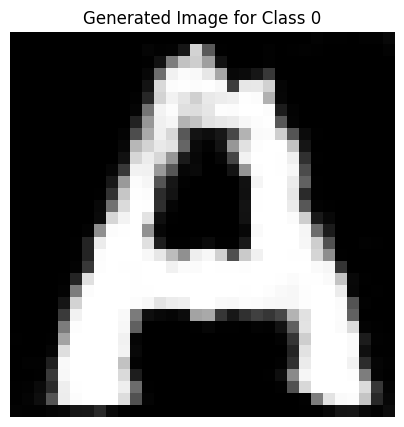

Epoch [740/2500], D_loss: 0.03410805016756058, G_loss: -0.6076488494873047


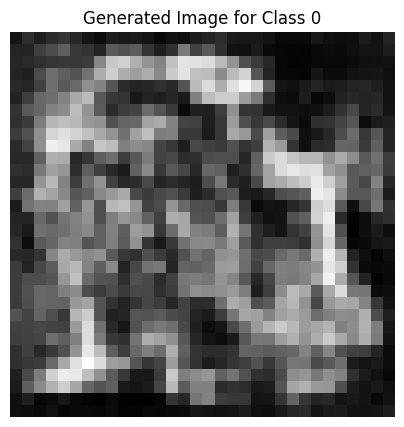

Epoch [741/2500], D_loss: 0.05933818221092224, G_loss: -0.5696960687637329


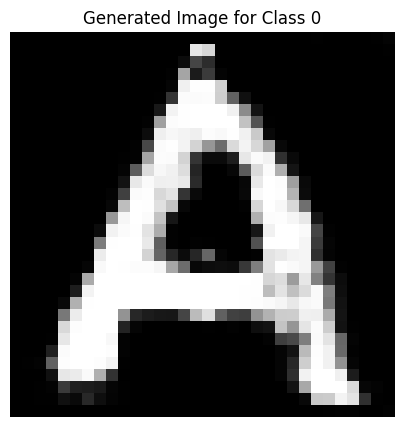

Epoch [742/2500], D_loss: 0.08274605870246887, G_loss: -0.6177973747253418


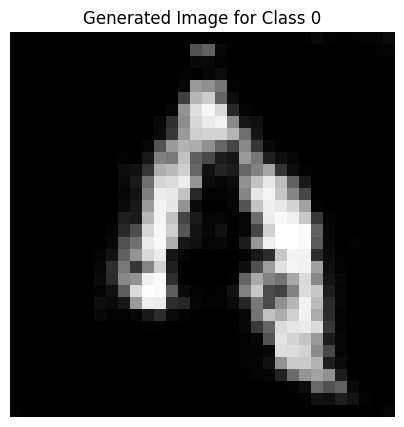

Epoch [743/2500], D_loss: 0.06295226514339447, G_loss: -0.5279719233512878


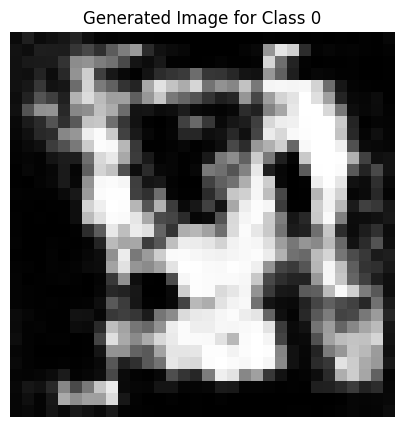

Epoch [744/2500], D_loss: 0.03707948327064514, G_loss: -0.6580796241760254


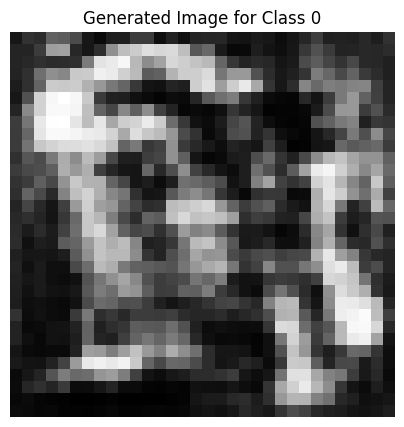

Epoch [745/2500], D_loss: 0.012777000665664673, G_loss: -0.6507338881492615


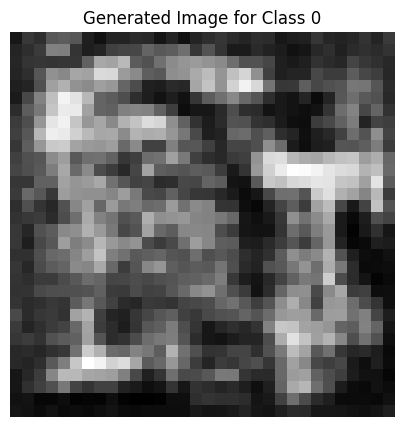

Epoch [746/2500], D_loss: 0.0380251482129097, G_loss: -0.5380032062530518


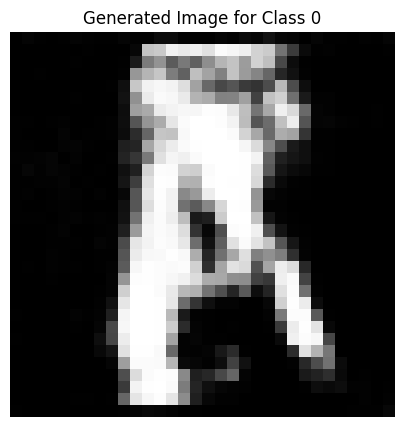

Epoch [747/2500], D_loss: 0.006833843886852264, G_loss: -0.5618569850921631


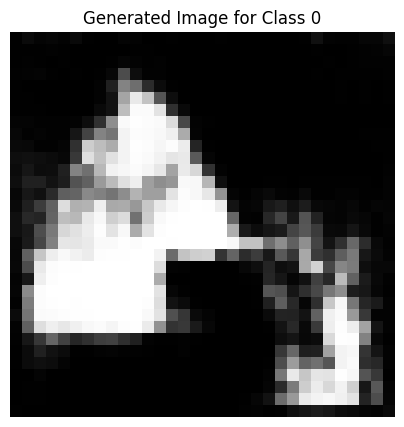

Epoch [748/2500], D_loss: 0.03657093644142151, G_loss: -0.5427553057670593


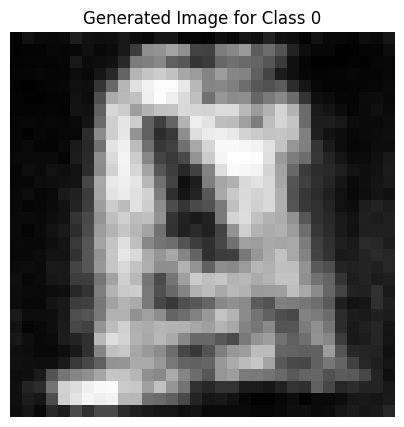

Epoch [749/2500], D_loss: -0.0115700364112854, G_loss: -0.5702669024467468


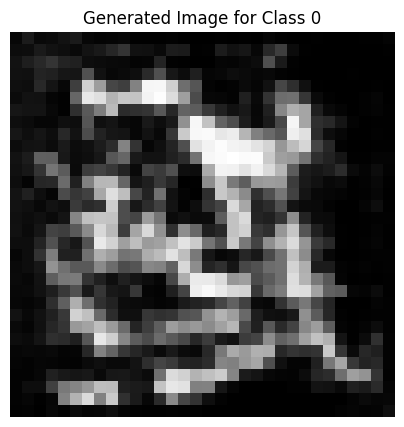

Epoch [750/2500], D_loss: -0.0024837031960487366, G_loss: -0.5871942043304443


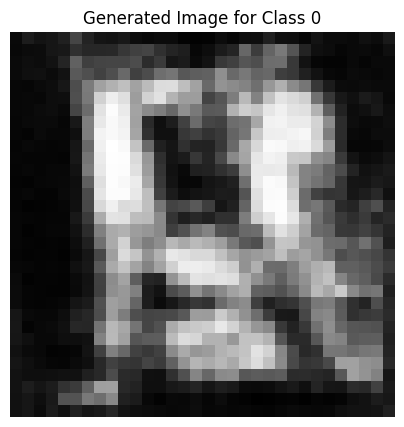

Epoch [751/2500], D_loss: -0.03736551105976105, G_loss: -0.5359575748443604


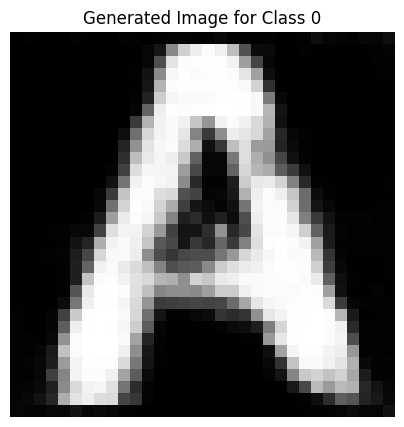

Epoch [752/2500], D_loss: -0.006476864218711853, G_loss: -0.5418621301651001


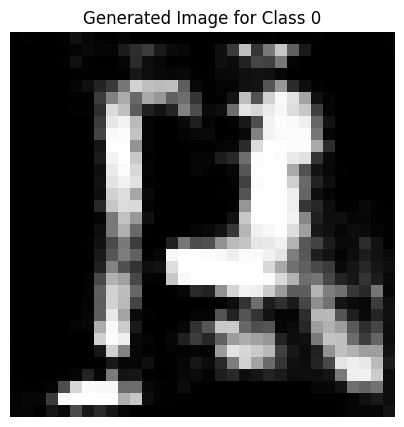

Epoch [753/2500], D_loss: -0.021880395710468292, G_loss: -0.5523250102996826


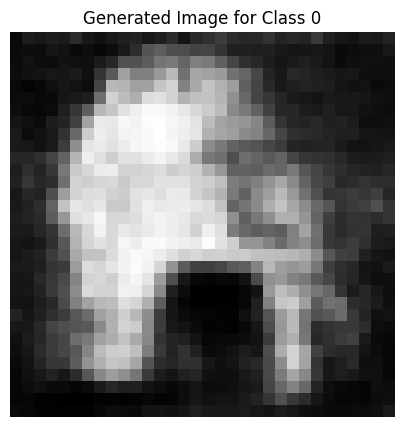

Epoch [754/2500], D_loss: 0.0477561354637146, G_loss: -0.4970870912075043


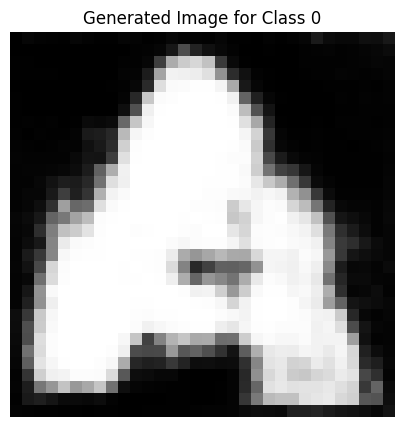

Epoch [755/2500], D_loss: 0.03145238757133484, G_loss: -0.5532078146934509


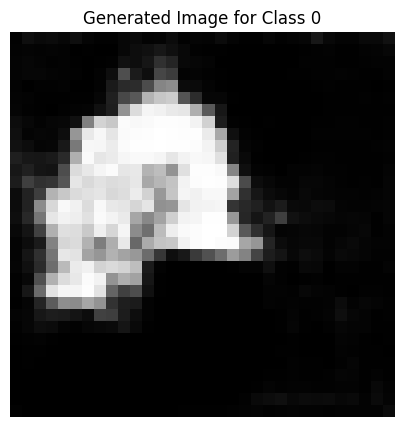

Epoch [756/2500], D_loss: 0.15148226916790009, G_loss: -0.5695425271987915


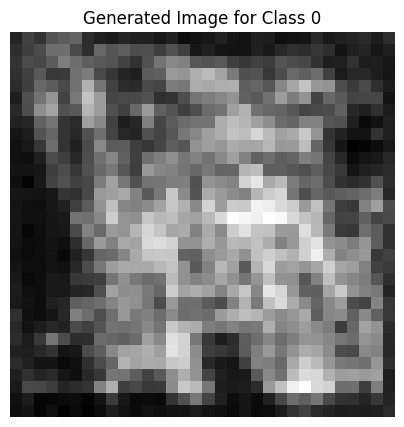

Epoch [757/2500], D_loss: -0.0005392581224441528, G_loss: -0.576684832572937


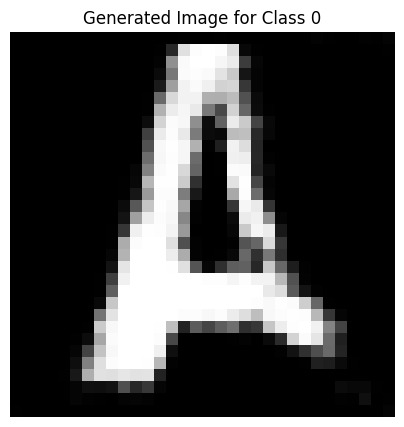

Epoch [758/2500], D_loss: 0.03592891991138458, G_loss: -0.5734270811080933


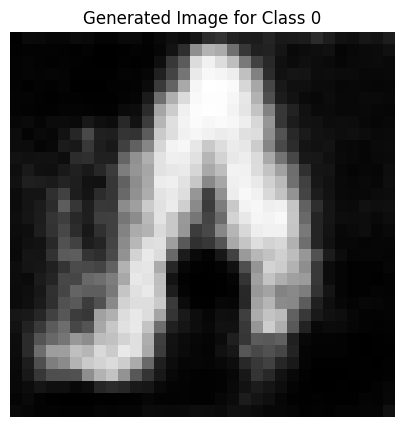

Epoch [759/2500], D_loss: -0.004333332180976868, G_loss: -0.5488823652267456


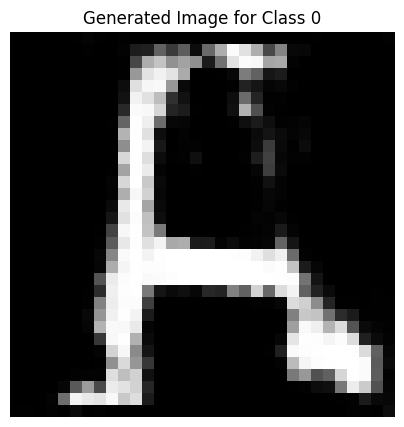

Epoch [760/2500], D_loss: 0.0053630247712135315, G_loss: -0.6007553339004517


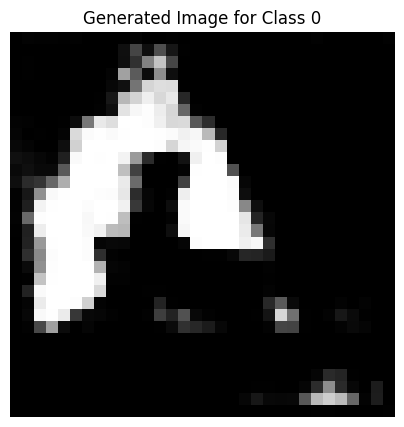

Epoch [761/2500], D_loss: 0.01306268572807312, G_loss: -0.5567345023155212


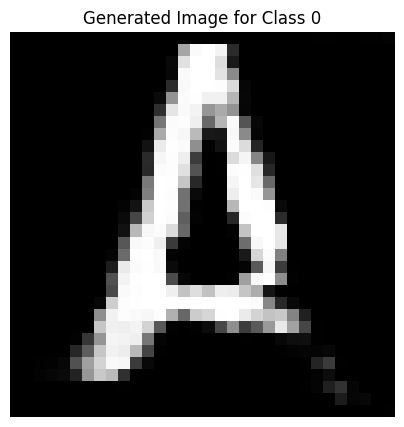

Epoch [762/2500], D_loss: 0.22132837772369385, G_loss: -0.5907354354858398


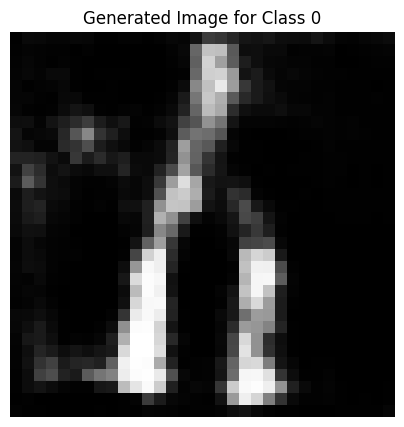

Epoch [763/2500], D_loss: 0.01728568971157074, G_loss: -0.5476956367492676


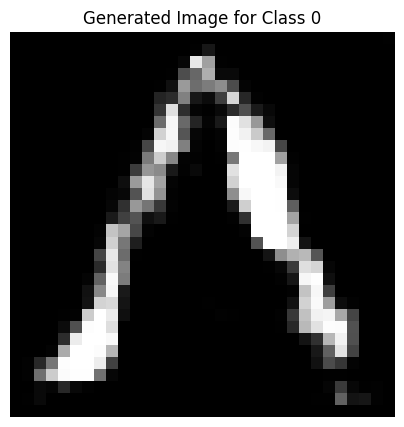

Epoch [764/2500], D_loss: 0.07374587655067444, G_loss: -0.5299831628799438


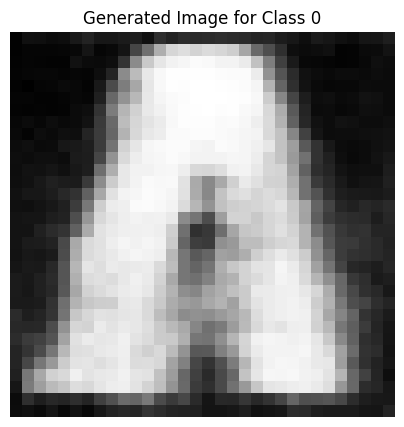

Epoch [765/2500], D_loss: -0.006419539451599121, G_loss: -0.5544558763504028


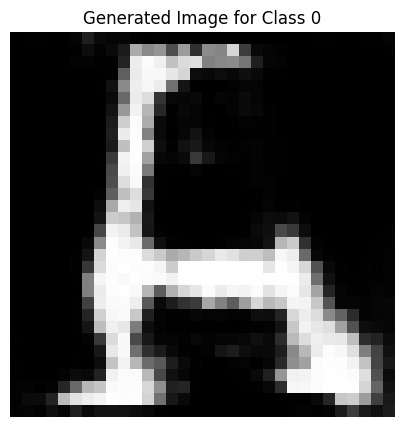

Epoch [766/2500], D_loss: 0.010091513395309448, G_loss: -0.5443283319473267


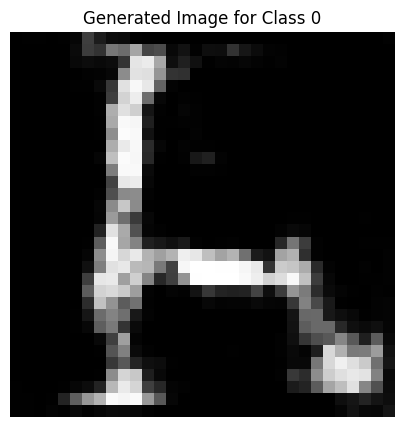

Epoch [767/2500], D_loss: 0.008559934794902802, G_loss: -0.5111491680145264


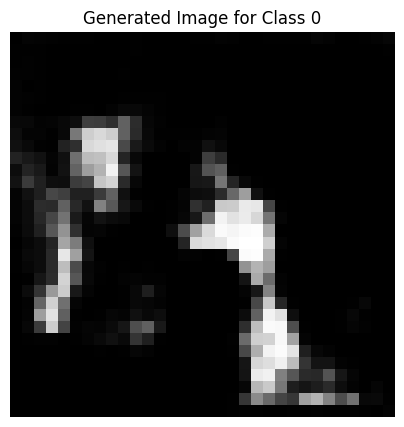

Epoch [768/2500], D_loss: 0.00908178836107254, G_loss: -0.5529308915138245


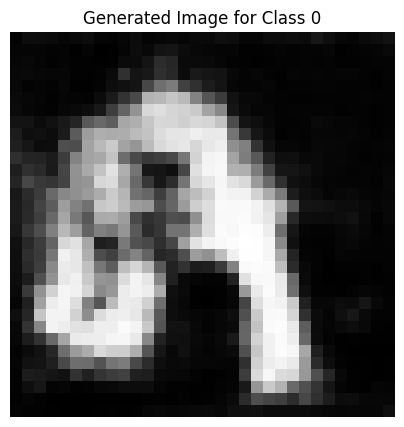

Epoch [769/2500], D_loss: 0.025440439581871033, G_loss: -0.5878751277923584


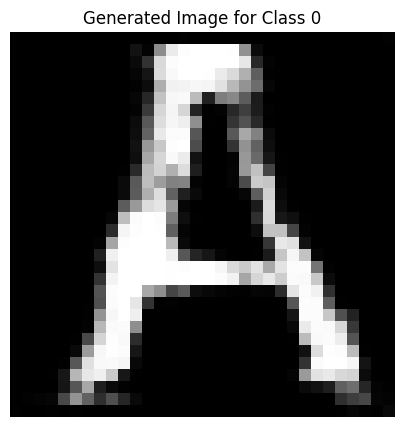

Epoch [770/2500], D_loss: 0.15111717581748962, G_loss: -0.48804986476898193


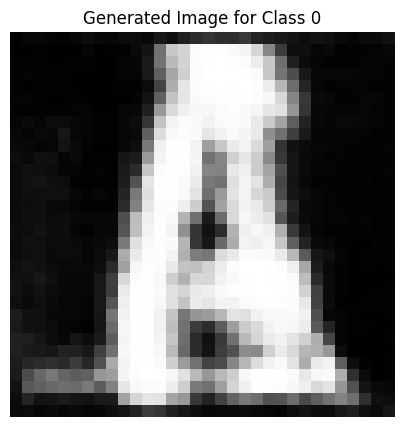

Epoch [771/2500], D_loss: -0.004246748983860016, G_loss: -0.575590968132019


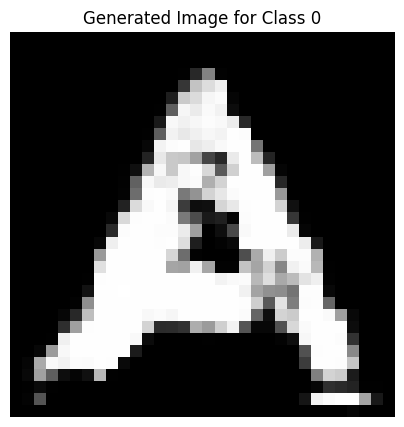

Epoch [772/2500], D_loss: 0.00025134533643722534, G_loss: -0.4754231870174408


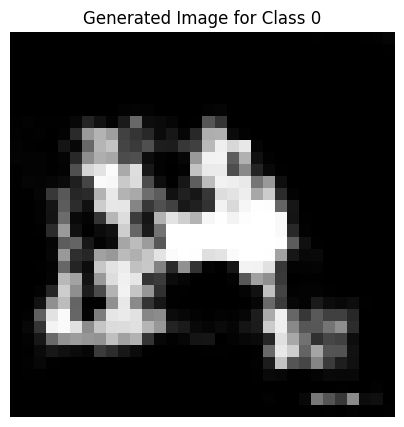

Epoch [773/2500], D_loss: 0.15852366387844086, G_loss: -0.5975158214569092


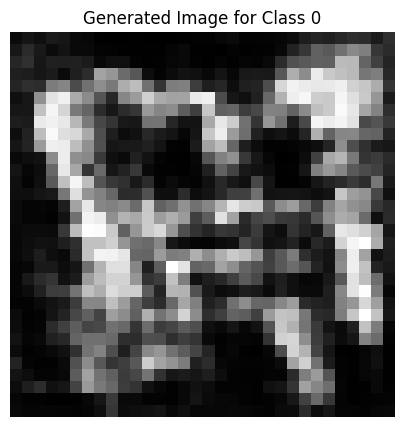

Epoch [774/2500], D_loss: 0.012859389185905457, G_loss: -0.5589919090270996


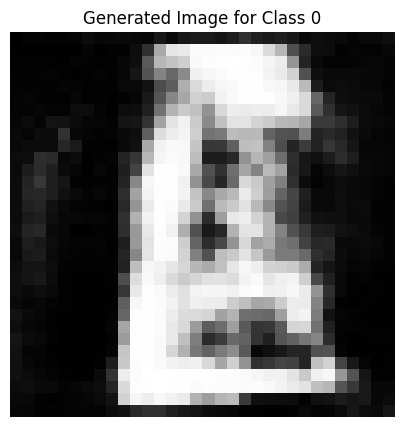

Epoch [775/2500], D_loss: -0.020511329174041748, G_loss: -0.5335842370986938


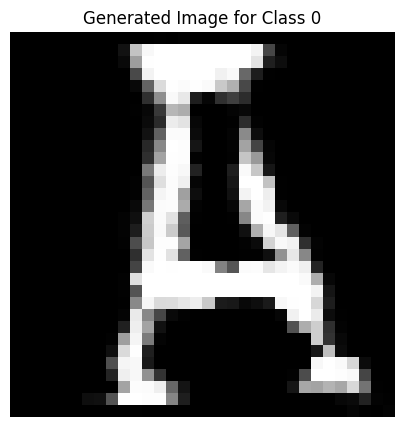

Epoch [776/2500], D_loss: 0.005529090762138367, G_loss: -0.5972882509231567


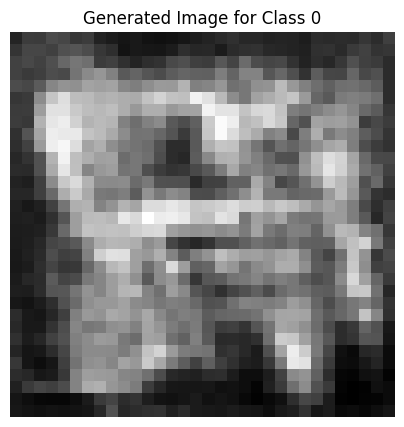

Epoch [777/2500], D_loss: 0.024735167622566223, G_loss: -0.5579335689544678


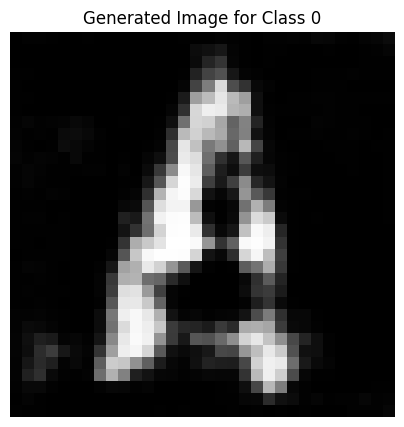

Epoch [778/2500], D_loss: 0.024534888565540314, G_loss: -0.5740776062011719


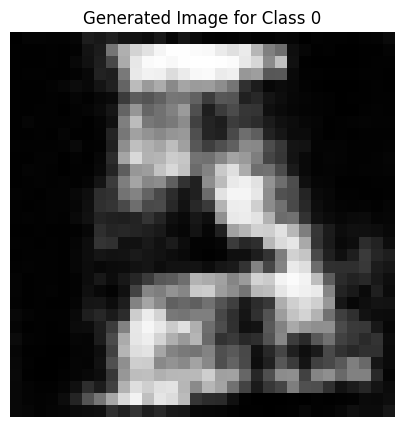

Epoch [779/2500], D_loss: 0.03242173790931702, G_loss: -0.7408187389373779


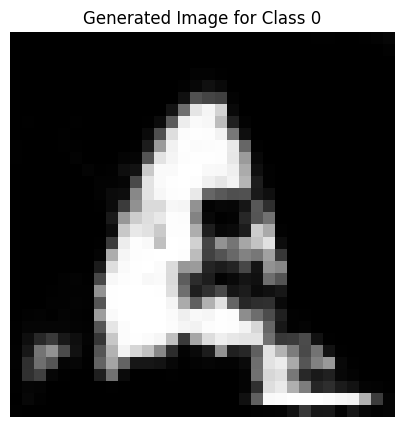

Epoch [780/2500], D_loss: 0.0007767453789710999, G_loss: -0.5595404505729675


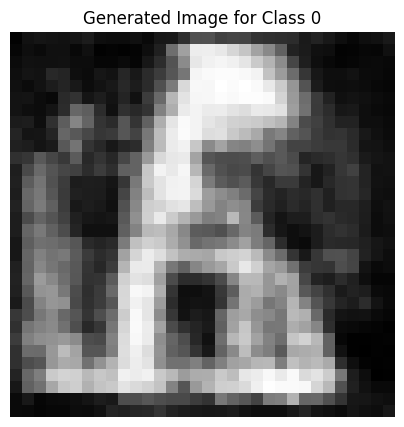

Epoch [781/2500], D_loss: 0.12140654027462006, G_loss: -0.6123331189155579


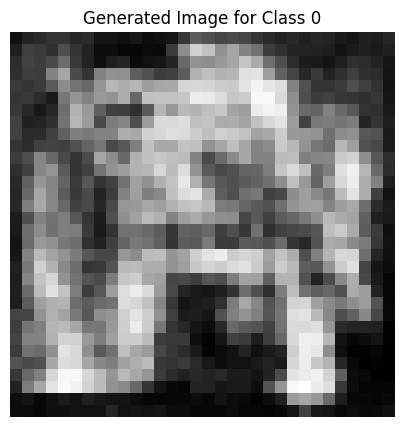

Epoch [782/2500], D_loss: -0.02062876522541046, G_loss: -0.5644328594207764


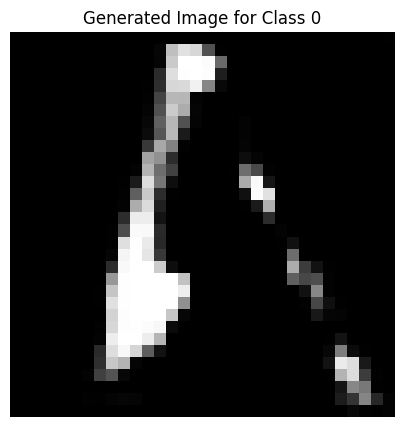

Epoch [783/2500], D_loss: -0.008247658610343933, G_loss: -0.43906211853027344


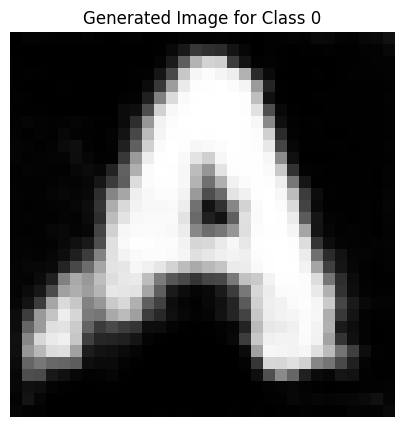

Epoch [784/2500], D_loss: -0.015197686851024628, G_loss: -0.53592449426651


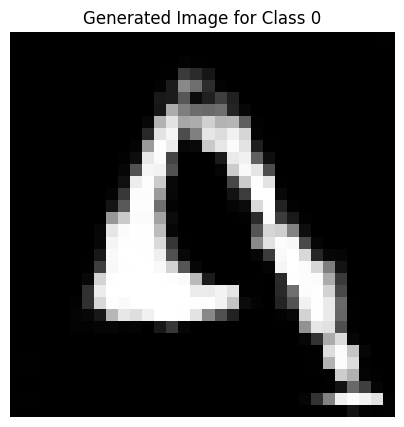

Epoch [785/2500], D_loss: -0.005966350436210632, G_loss: -0.5658001899719238


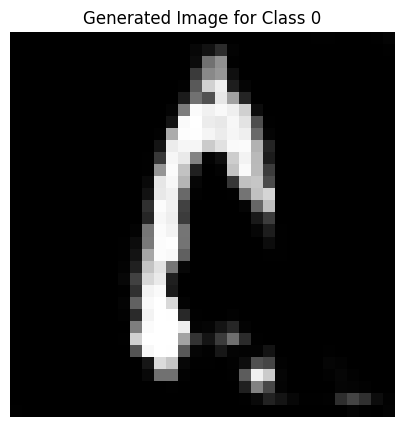

Epoch [786/2500], D_loss: -0.0386081337928772, G_loss: -0.4954928755760193


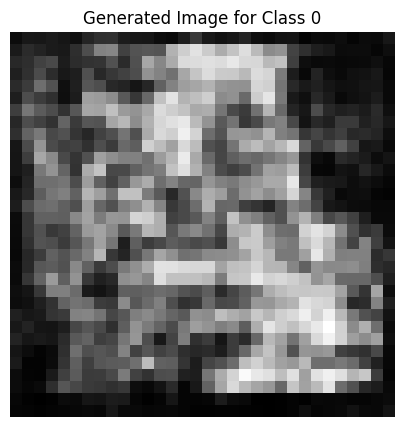

Epoch [787/2500], D_loss: -0.008543767035007477, G_loss: -0.5663582682609558


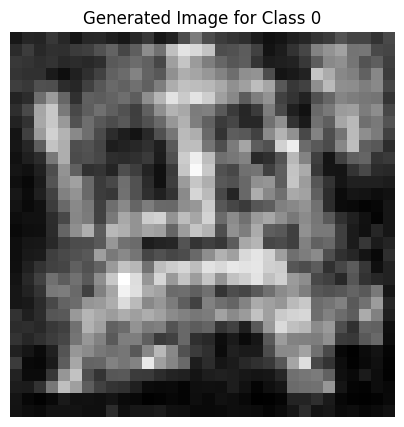

Epoch [788/2500], D_loss: -0.0002099350094795227, G_loss: -0.6009179353713989


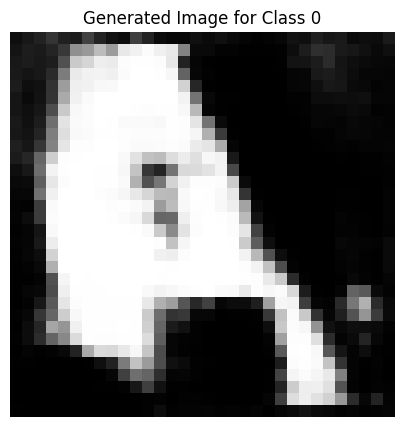

Epoch [789/2500], D_loss: 0.013002738356590271, G_loss: -0.5450818538665771


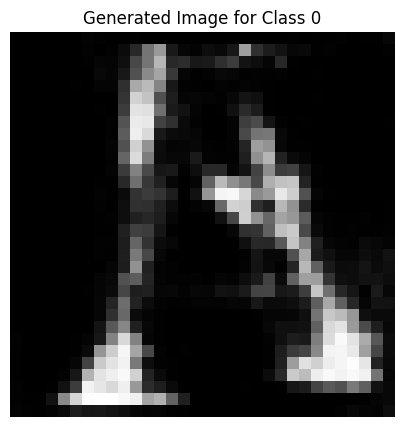

Epoch [790/2500], D_loss: -0.0404801219701767, G_loss: -0.5504098534584045


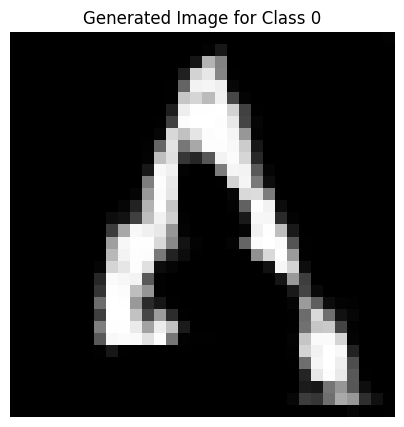

Epoch [791/2500], D_loss: 0.037395402789115906, G_loss: -0.484774649143219


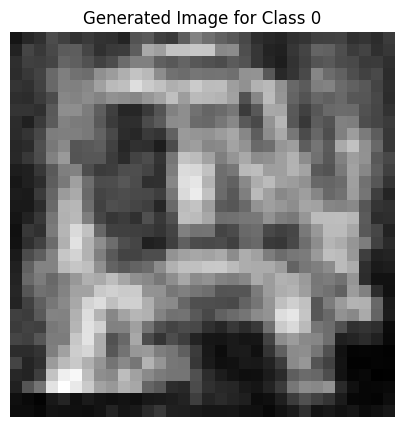

Epoch [792/2500], D_loss: 0.039181701838970184, G_loss: -0.6150593757629395


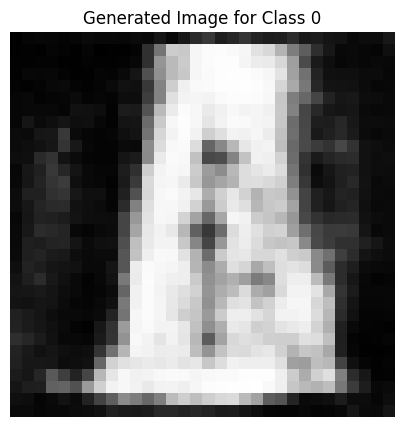

Epoch [793/2500], D_loss: 0.05165863037109375, G_loss: -0.5681660175323486


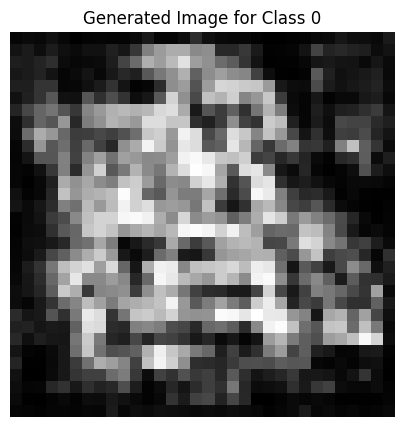

Epoch [794/2500], D_loss: 0.014563500881195068, G_loss: -0.5119515061378479


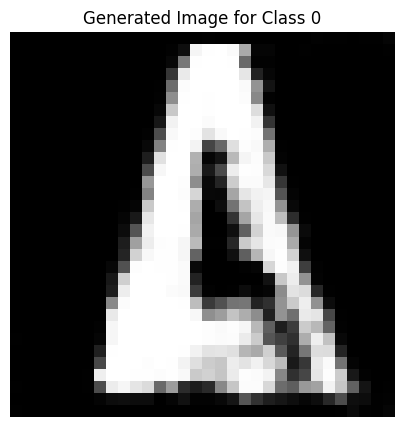

Epoch [795/2500], D_loss: -0.014486189931631088, G_loss: -0.6428059935569763


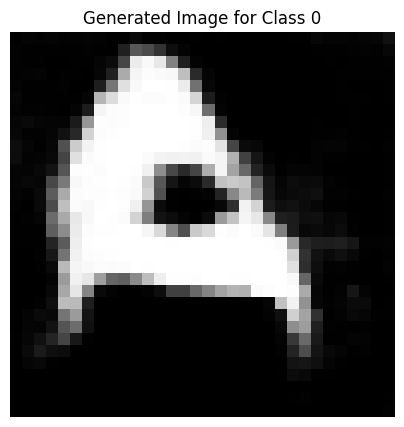

Epoch [796/2500], D_loss: -0.001264713704586029, G_loss: -0.5752453804016113


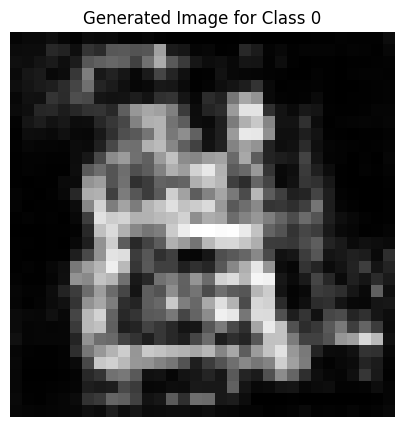

Epoch [797/2500], D_loss: -0.027988847345113754, G_loss: -0.5271321535110474


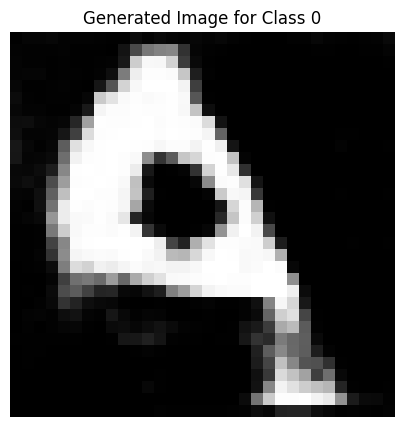

Epoch [798/2500], D_loss: -0.022898569703102112, G_loss: -0.5825716257095337


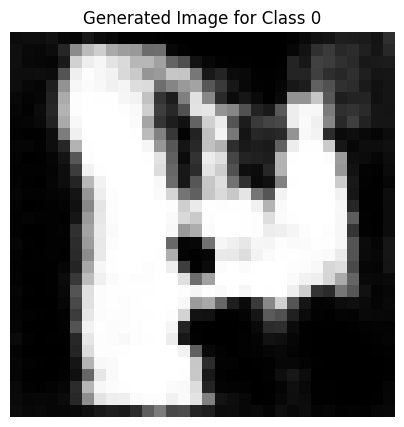

Epoch [799/2500], D_loss: -0.018447913229465485, G_loss: -0.4934607744216919


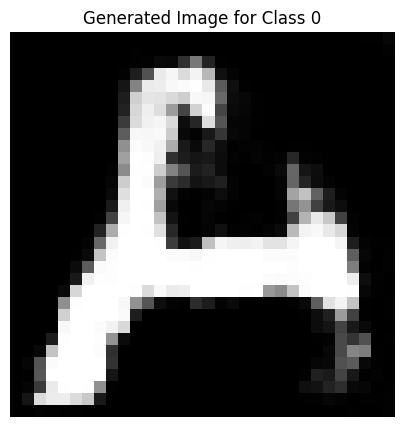

Epoch [800/2500], D_loss: 0.047707974910736084, G_loss: -0.5527074337005615


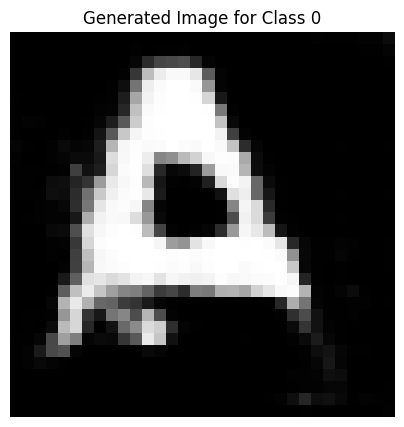

Epoch [801/2500], D_loss: -0.013930939137935638, G_loss: -0.5537049174308777


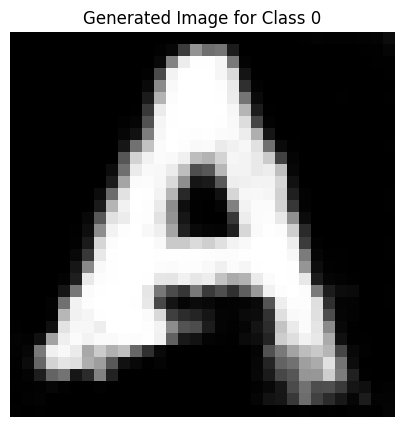

Epoch [802/2500], D_loss: -0.028868496417999268, G_loss: -0.6376190781593323


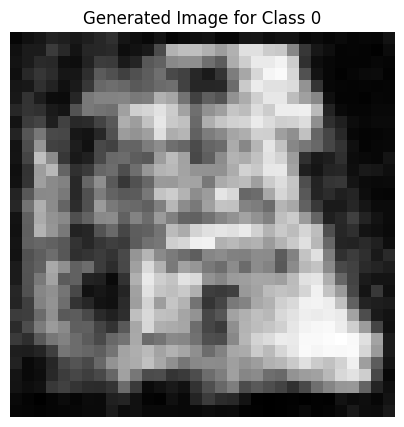

Epoch [803/2500], D_loss: -0.006060339510440826, G_loss: -0.5421172976493835


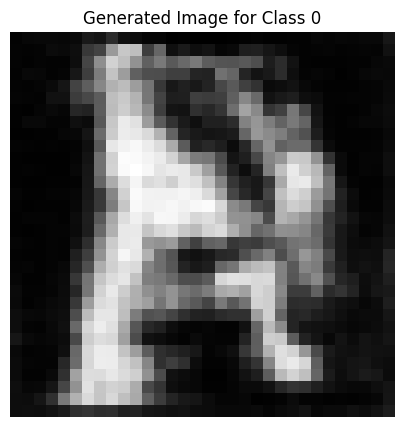

Epoch [804/2500], D_loss: 0.00942818820476532, G_loss: -0.5737951993942261


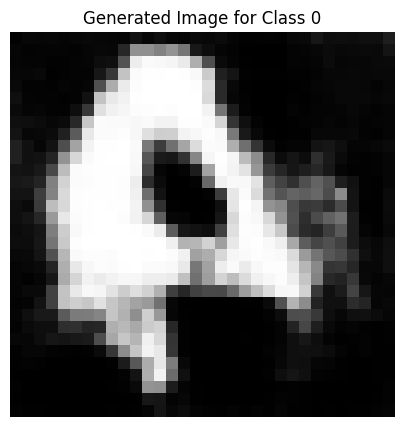

Epoch [805/2500], D_loss: 0.016979292035102844, G_loss: -0.5452734231948853


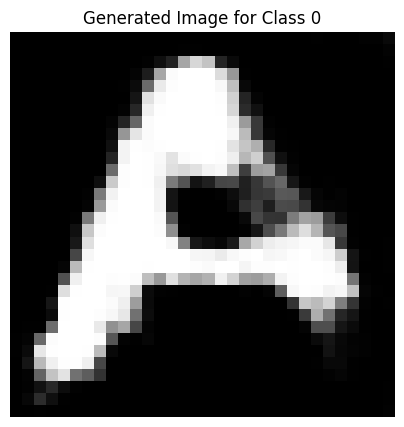

Epoch [806/2500], D_loss: -0.01030442863702774, G_loss: -0.5508679151535034


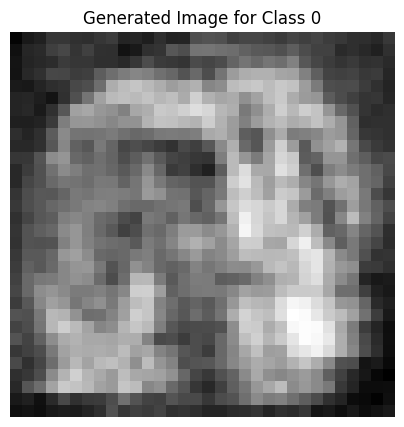

Epoch [807/2500], D_loss: 0.0016325786709785461, G_loss: -0.6856670379638672


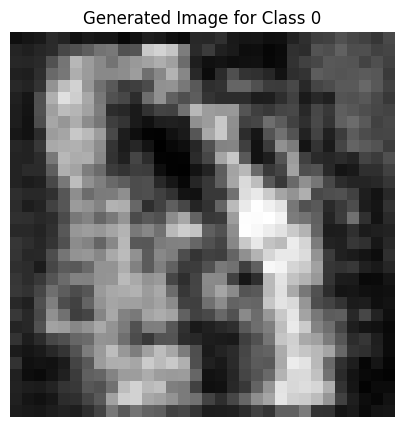

Epoch [808/2500], D_loss: -0.02242322266101837, G_loss: -0.5160841941833496


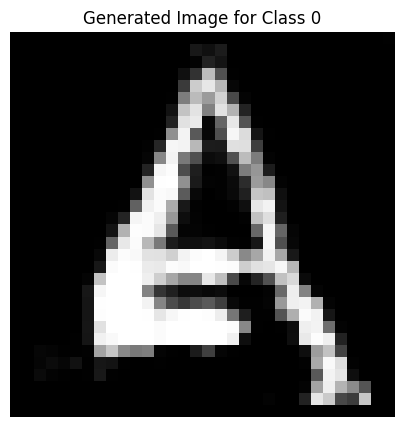

Epoch [809/2500], D_loss: -0.009635761380195618, G_loss: -0.6323831081390381


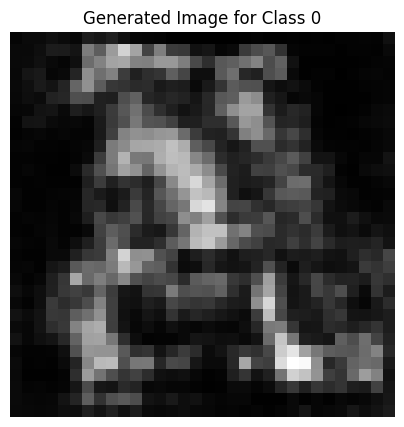

Epoch [810/2500], D_loss: -0.023232176899909973, G_loss: -0.6103697419166565


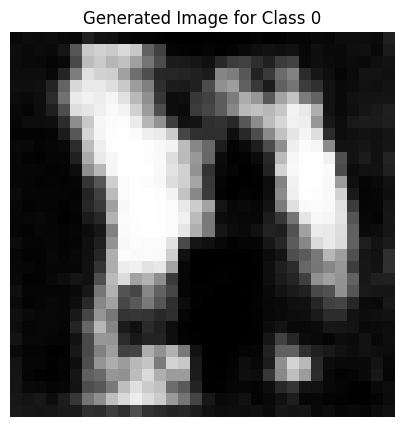

Epoch [811/2500], D_loss: 0.013754330575466156, G_loss: -0.5634526610374451


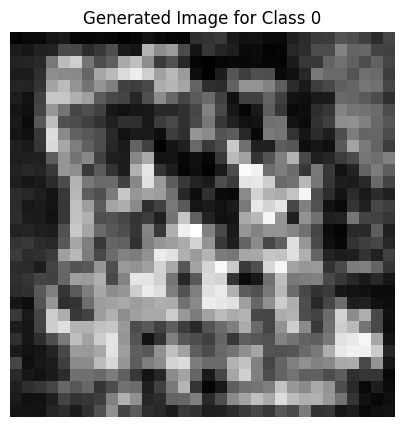

Epoch [812/2500], D_loss: 0.002692118287086487, G_loss: -0.5348196029663086


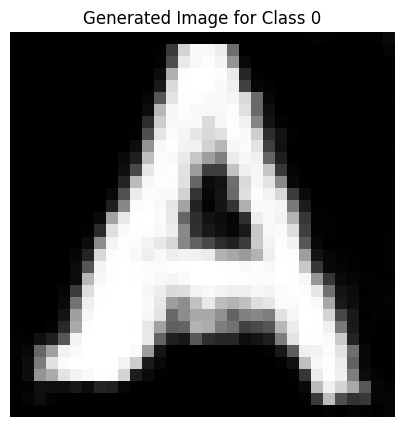

Epoch [813/2500], D_loss: 0.005263730883598328, G_loss: -0.5789116621017456


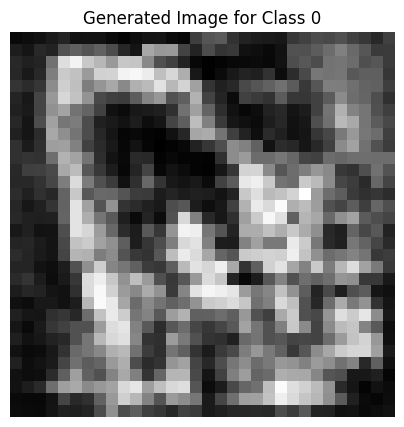

Epoch [814/2500], D_loss: 0.03596679866313934, G_loss: -0.6688423156738281


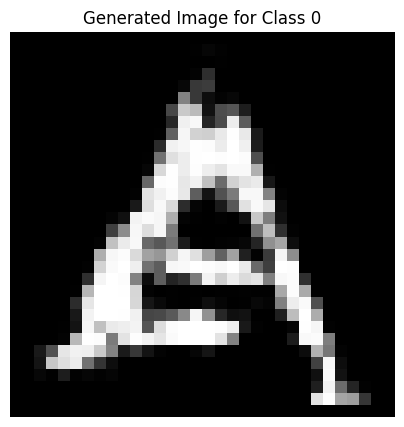

Epoch [815/2500], D_loss: -0.015906214714050293, G_loss: -0.5666654706001282


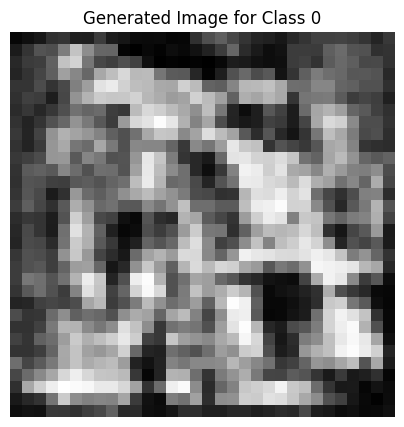

Epoch [816/2500], D_loss: 0.027546986937522888, G_loss: -0.6437479257583618


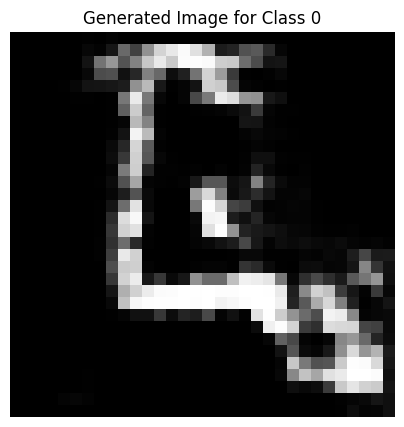

Epoch [817/2500], D_loss: 0.14387181401252747, G_loss: -0.6539873480796814


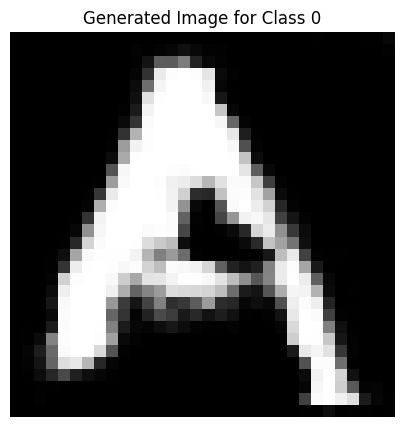

Epoch [818/2500], D_loss: 0.01683882623910904, G_loss: -0.585063099861145


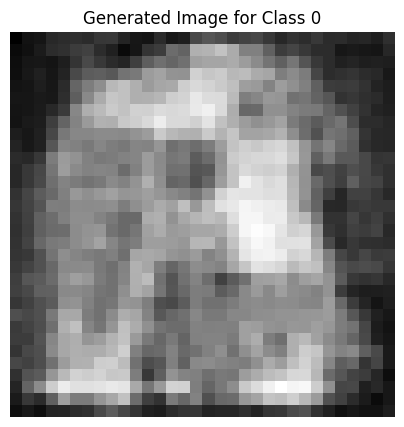

Epoch [819/2500], D_loss: 0.04869002848863602, G_loss: -0.5876558423042297


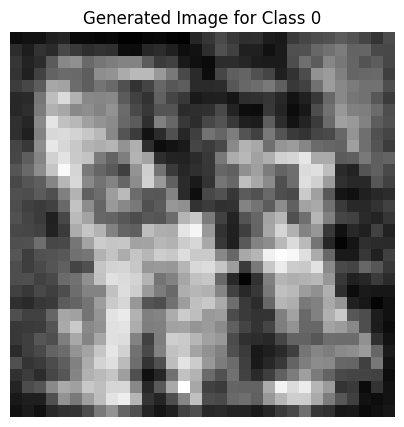

Epoch [820/2500], D_loss: -0.0018925368785858154, G_loss: -0.6304865479469299


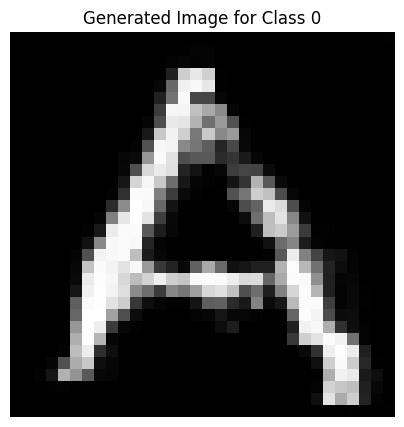

Epoch [821/2500], D_loss: -0.01345159113407135, G_loss: -0.5271987318992615


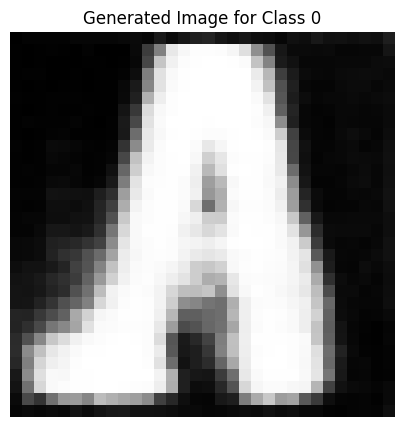

Epoch [822/2500], D_loss: 0.015283271670341492, G_loss: -0.5598945617675781


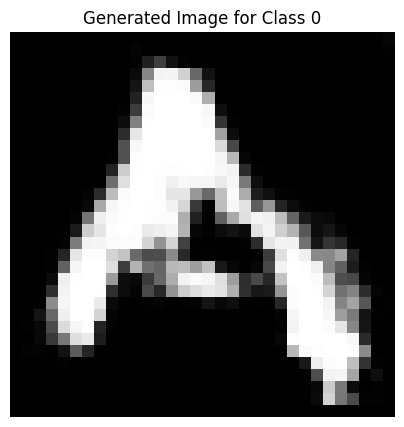

Epoch [823/2500], D_loss: 0.02099817991256714, G_loss: -0.5690361261367798


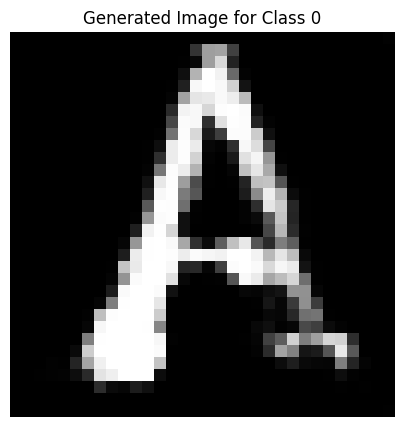

Epoch [824/2500], D_loss: 0.02958545833826065, G_loss: -0.5955252051353455


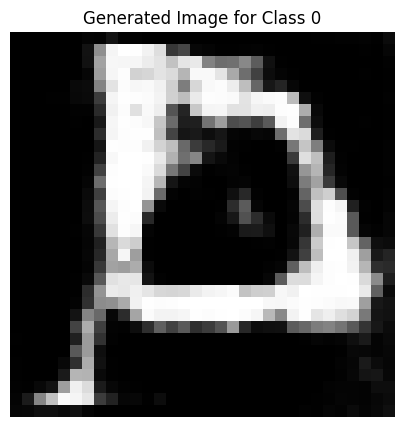

Epoch [825/2500], D_loss: 0.02987845242023468, G_loss: -0.49293190240859985


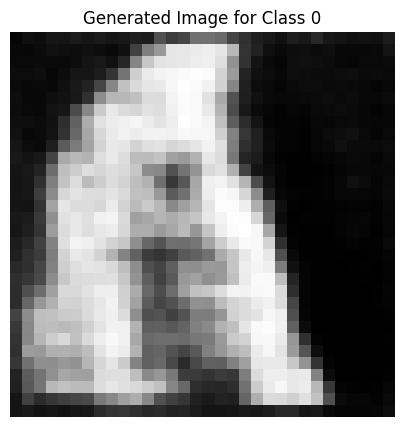

Epoch [826/2500], D_loss: 0.005614615976810455, G_loss: -0.6028726100921631


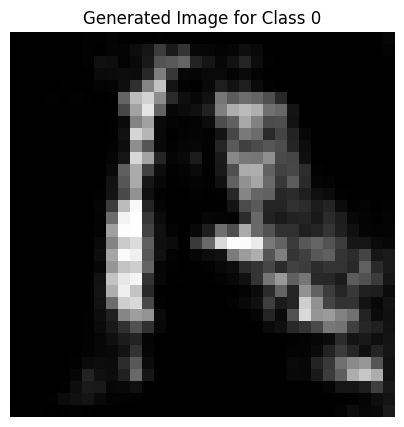

Epoch [827/2500], D_loss: 0.17936250567436218, G_loss: -0.5728810429573059


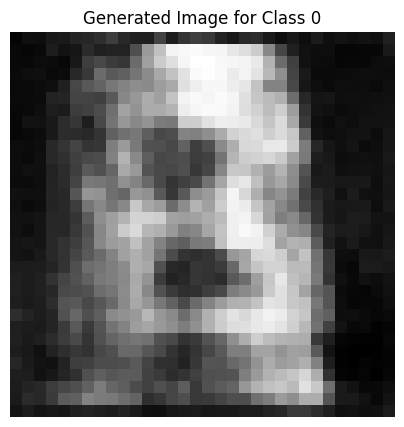

Epoch [828/2500], D_loss: -0.021717537194490433, G_loss: -0.5636622905731201


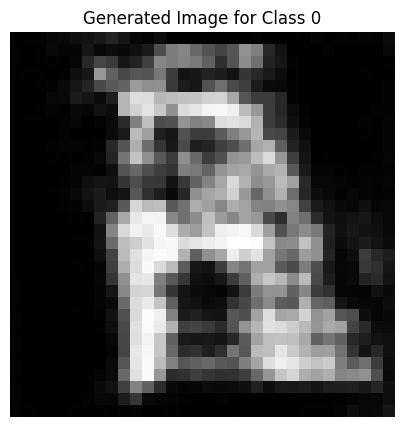

Epoch [829/2500], D_loss: 0.0021909475326538086, G_loss: -0.5937778353691101


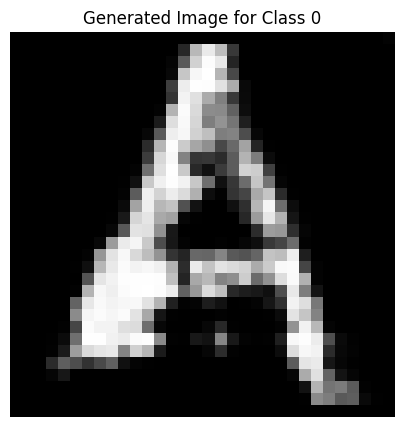

Epoch [830/2500], D_loss: 0.013407208025455475, G_loss: -0.4933975338935852


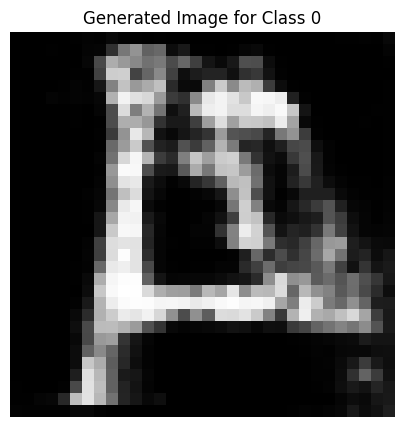

Epoch [831/2500], D_loss: 0.021969400346279144, G_loss: -0.5519000887870789


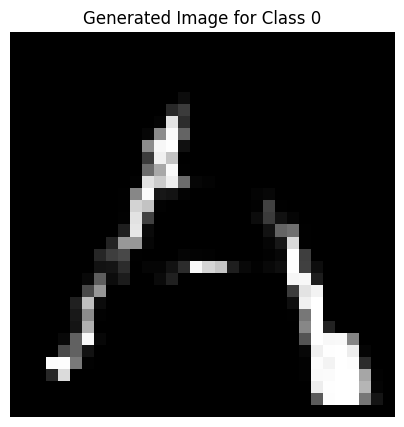

Epoch [832/2500], D_loss: -0.01769155263900757, G_loss: -0.5318965911865234


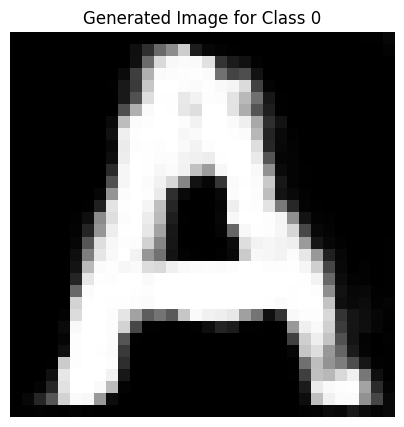

Epoch [833/2500], D_loss: -0.009284980595111847, G_loss: -0.5996969938278198


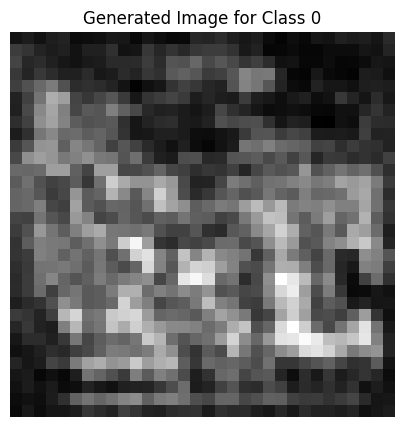

Epoch [834/2500], D_loss: 0.006565108895301819, G_loss: -0.5728163719177246


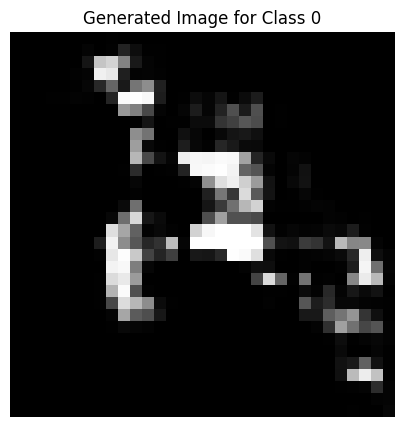

Epoch [835/2500], D_loss: 0.00677865743637085, G_loss: -0.609527587890625


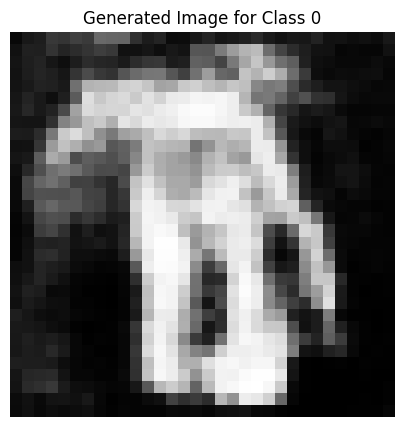

Epoch [836/2500], D_loss: 0.027533814311027527, G_loss: -0.5700945854187012


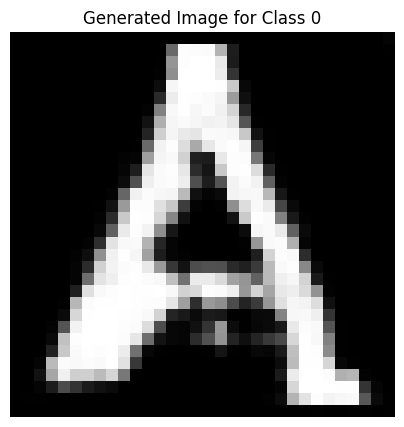

Epoch [837/2500], D_loss: 0.04772549122571945, G_loss: -0.5918273329734802


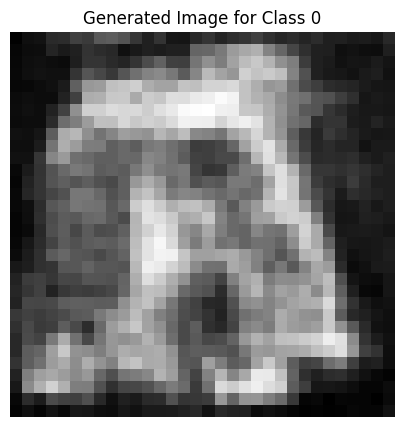

Epoch [838/2500], D_loss: -0.0285404771566391, G_loss: -0.5342742800712585


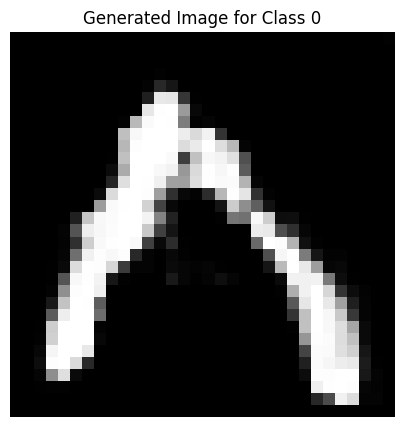

Epoch [839/2500], D_loss: -0.0049666836857795715, G_loss: -0.3797425925731659


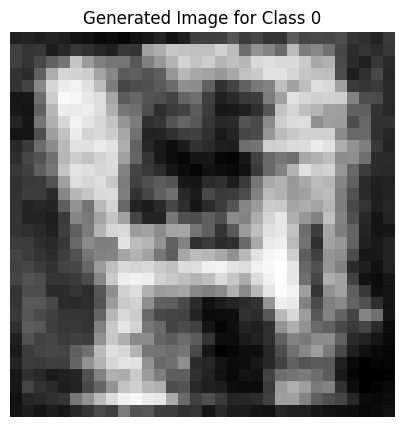

Epoch [840/2500], D_loss: -0.012601703405380249, G_loss: -0.5989437699317932


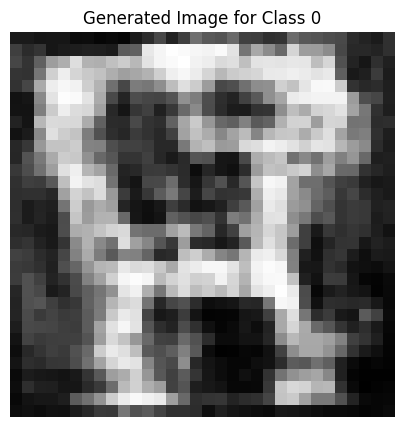

Epoch [841/2500], D_loss: 0.016361743211746216, G_loss: -0.5654655694961548


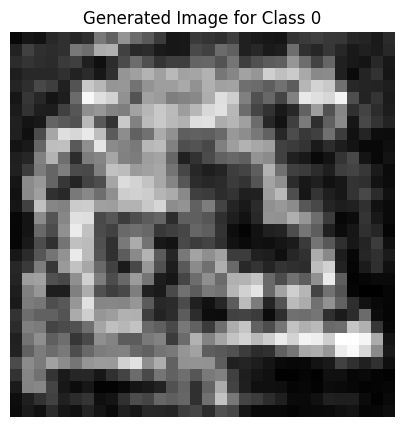

Epoch [842/2500], D_loss: 0.016164980828762054, G_loss: -0.45669811964035034


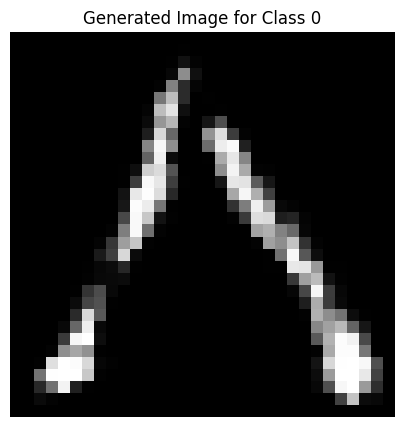

Epoch [843/2500], D_loss: -0.04145436733961105, G_loss: -0.5725533366203308


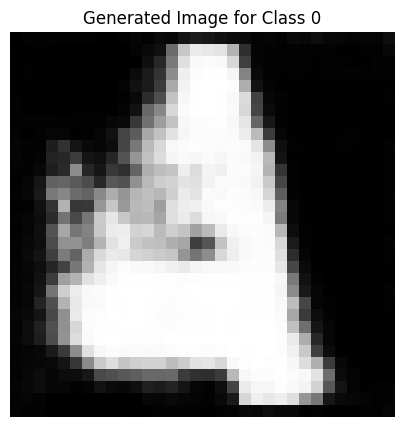

Epoch [844/2500], D_loss: -0.0042297691106796265, G_loss: -0.5249221920967102


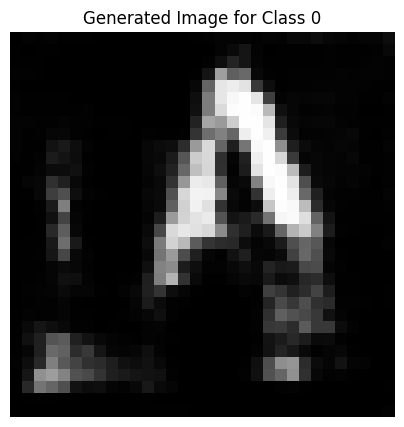

Epoch [845/2500], D_loss: -0.003867015242576599, G_loss: -0.5920462608337402


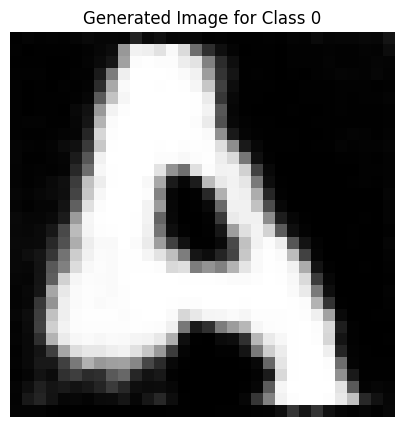

Epoch [846/2500], D_loss: -0.021163076162338257, G_loss: -0.5762369632720947


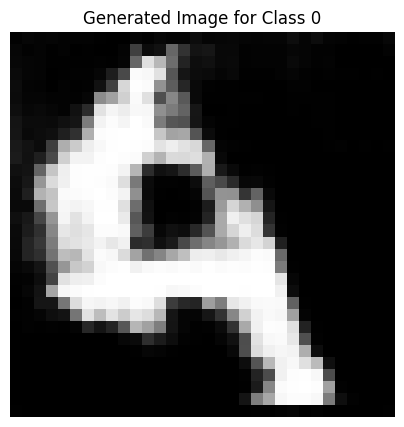

Epoch [847/2500], D_loss: 0.00897768884897232, G_loss: -0.5708602070808411


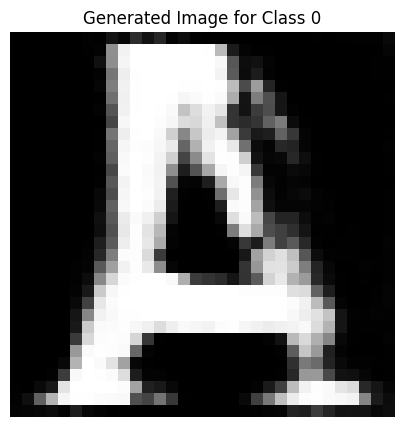

Epoch [848/2500], D_loss: 0.007550060749053955, G_loss: -0.5382540225982666


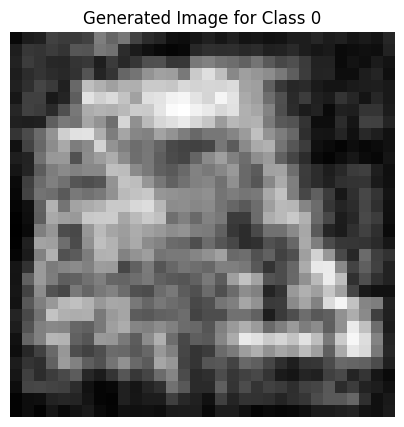

Epoch [849/2500], D_loss: 0.0011060014367103577, G_loss: -0.6088144183158875


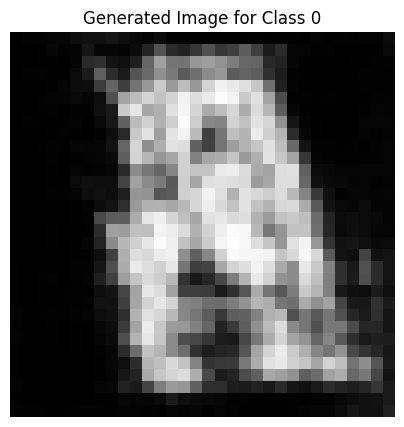

Epoch [850/2500], D_loss: 0.023835256695747375, G_loss: -0.5910159349441528


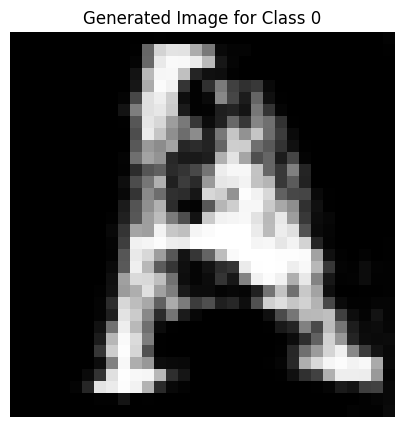

Epoch [851/2500], D_loss: 0.03440301865339279, G_loss: -0.5683852434158325


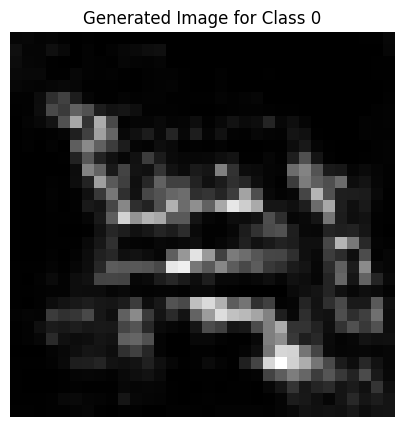

Epoch [852/2500], D_loss: 0.09543485939502716, G_loss: -0.5563032627105713


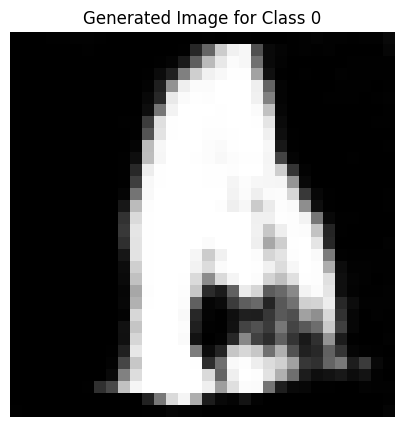

Epoch [853/2500], D_loss: 0.004746675491333008, G_loss: -0.5891286134719849


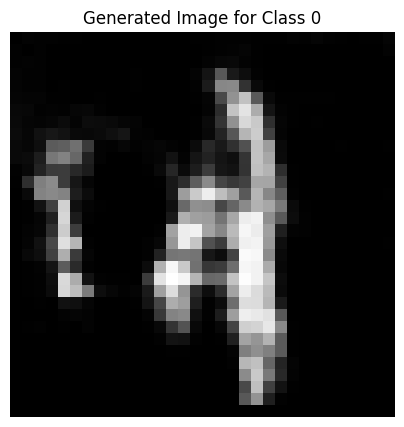

Epoch [854/2500], D_loss: 0.05559399724006653, G_loss: -0.4196575880050659


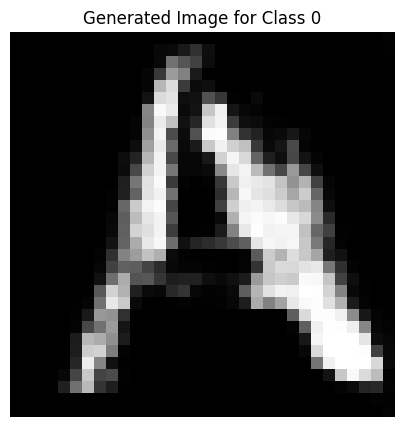

Epoch [855/2500], D_loss: -0.011902429163455963, G_loss: -0.5731621384620667


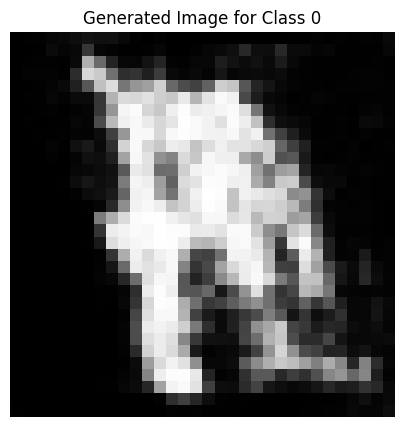

Epoch [856/2500], D_loss: 0.02191770076751709, G_loss: -0.6280460953712463


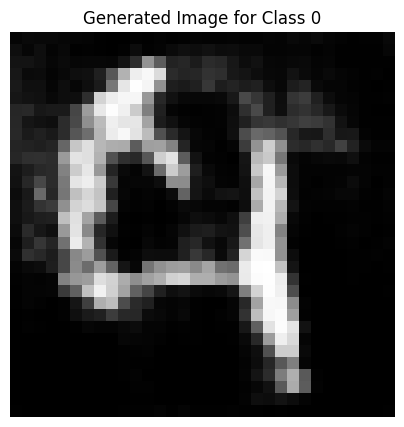

Epoch [857/2500], D_loss: 0.15115784108638763, G_loss: -0.520832896232605


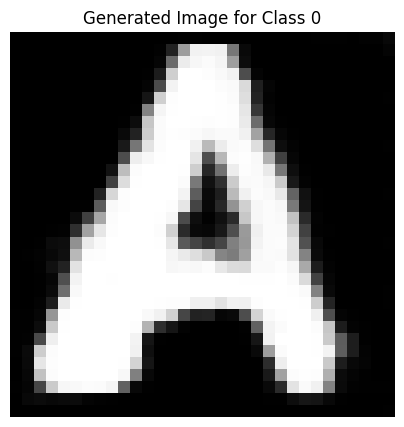

Epoch [858/2500], D_loss: -0.0243014395236969, G_loss: -0.561873197555542


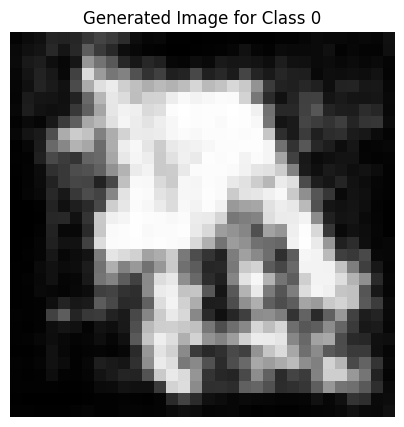

Epoch [859/2500], D_loss: -0.02071245014667511, G_loss: -0.5851118564605713


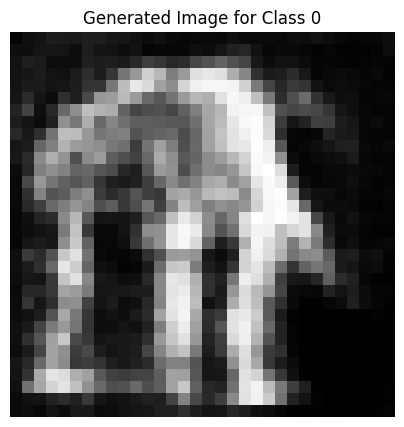

Epoch [860/2500], D_loss: -0.019938603043556213, G_loss: -0.519681990146637


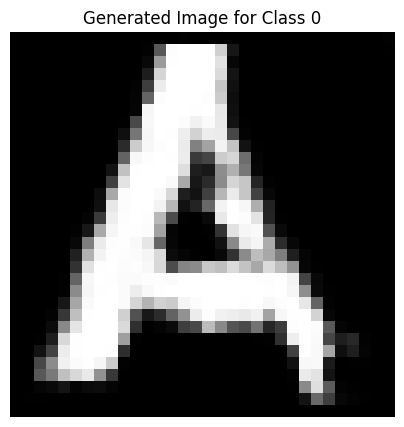

Epoch [861/2500], D_loss: -0.011859886348247528, G_loss: -0.5813725590705872


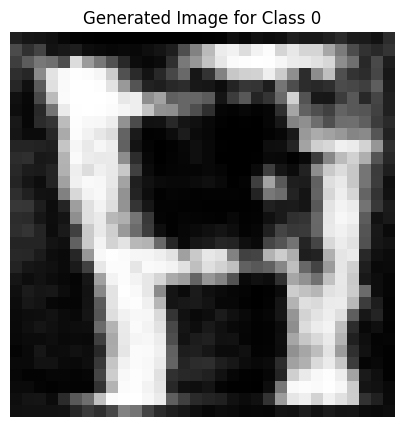

Epoch [862/2500], D_loss: -0.010825704783201218, G_loss: -0.5457183122634888


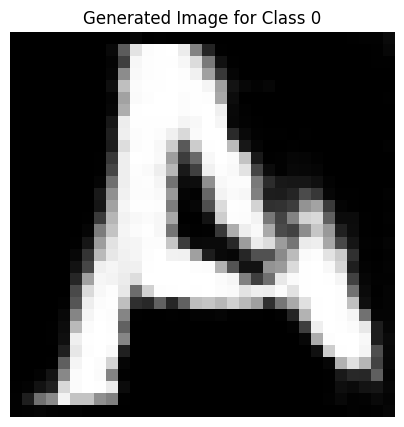

Epoch [863/2500], D_loss: 0.011124186217784882, G_loss: -0.5632977485656738


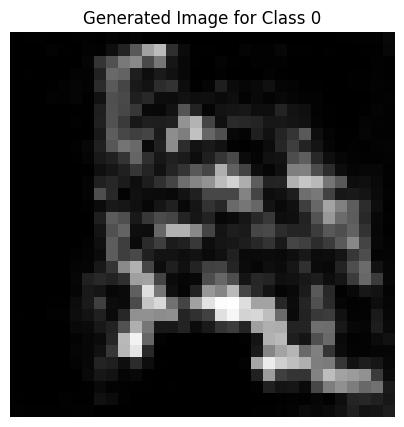

Epoch [864/2500], D_loss: 0.16793613135814667, G_loss: -0.4966939687728882


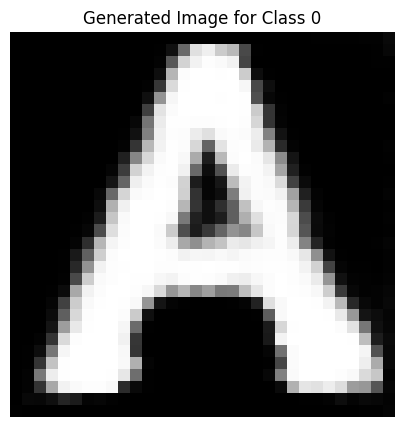

Epoch [865/2500], D_loss: -0.007465735077857971, G_loss: -0.5681687593460083


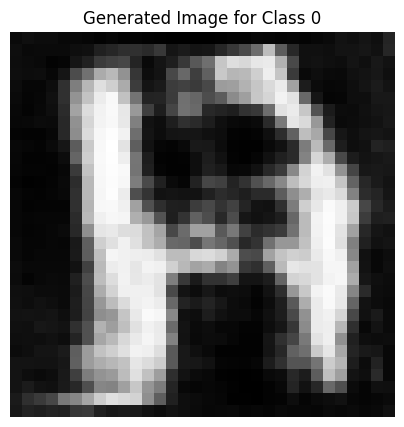

Epoch [866/2500], D_loss: 0.006692118942737579, G_loss: -0.5890458822250366


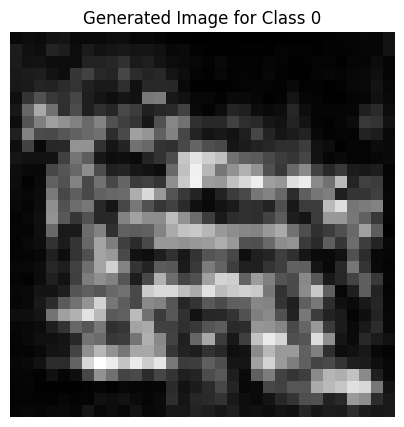

Epoch [867/2500], D_loss: 0.008240319788455963, G_loss: -0.6353167295455933


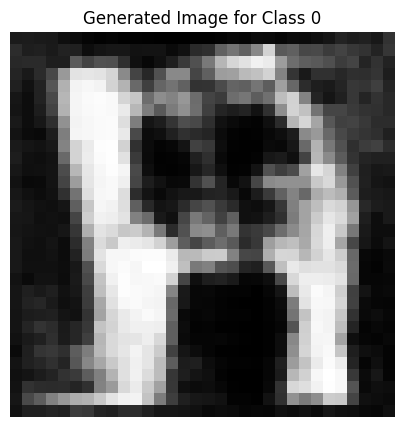

Epoch [868/2500], D_loss: -0.018816664814949036, G_loss: -0.5653170347213745


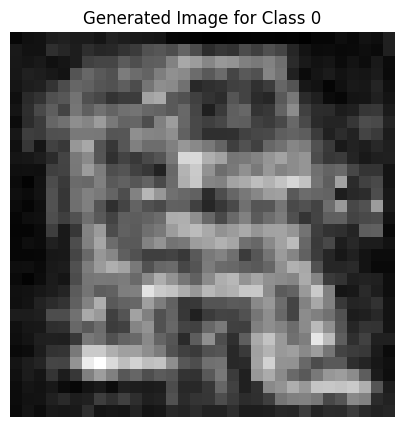

Epoch [869/2500], D_loss: -0.0057373568415641785, G_loss: -0.5618778467178345


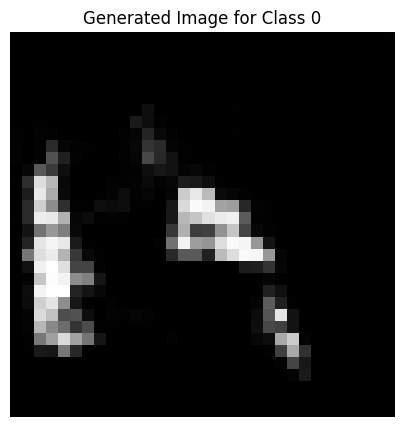

Epoch [870/2500], D_loss: 0.004476375877857208, G_loss: -0.5508012771606445


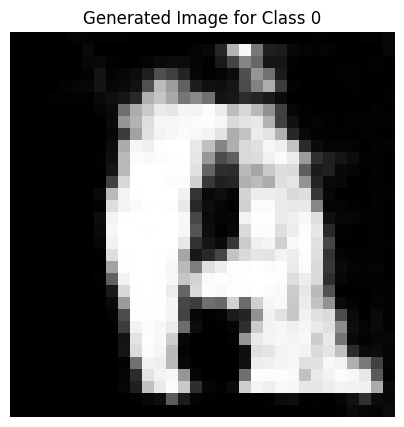

Epoch [871/2500], D_loss: 0.04182727634906769, G_loss: -0.5370314717292786


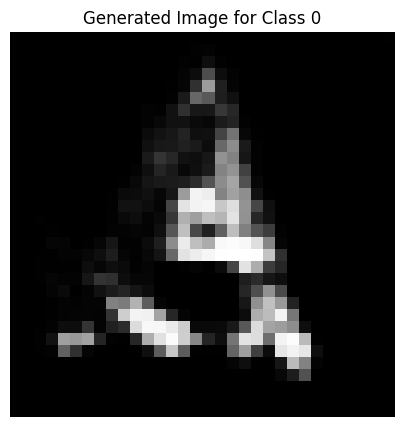

Epoch [872/2500], D_loss: 0.024192027747631073, G_loss: -0.5374326705932617


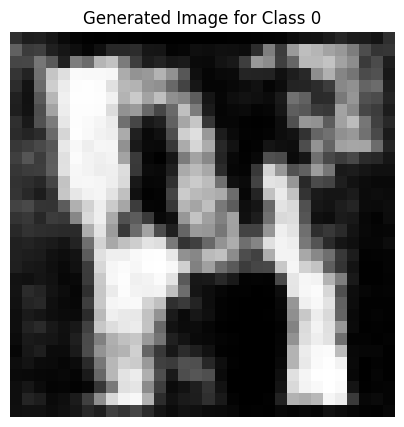

Epoch [873/2500], D_loss: 0.011017069220542908, G_loss: -0.6505703330039978


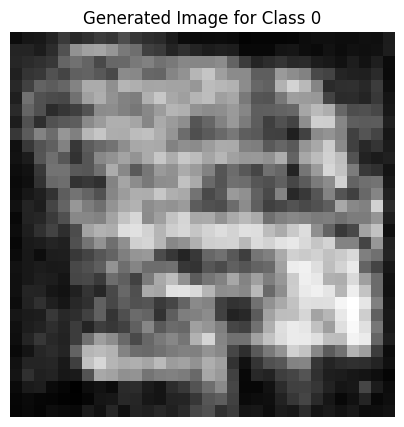

Epoch [874/2500], D_loss: -7.468461990356445e-05, G_loss: -0.5340985059738159


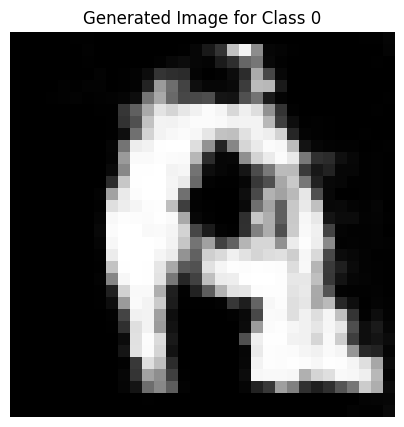

Epoch [875/2500], D_loss: 0.003738589584827423, G_loss: -0.5598212480545044


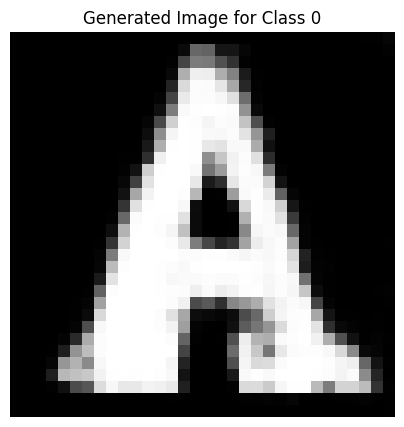

Epoch [876/2500], D_loss: 0.29216620326042175, G_loss: -0.7280207872390747


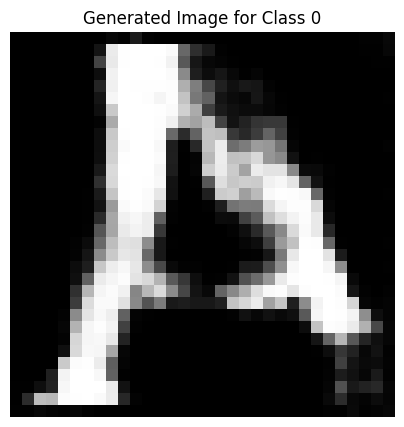

Epoch [877/2500], D_loss: 0.053553469479084015, G_loss: -0.5889039635658264


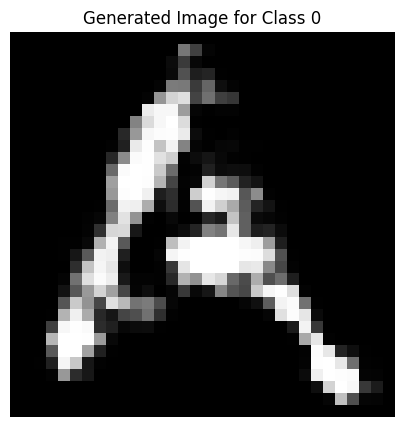

Epoch [878/2500], D_loss: 0.012533590197563171, G_loss: -0.6128348708152771


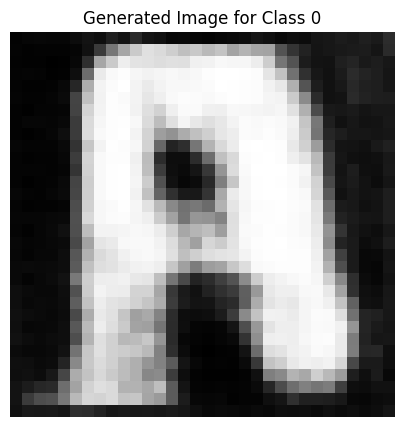

Epoch [879/2500], D_loss: 0.019633054733276367, G_loss: -0.5487047433853149


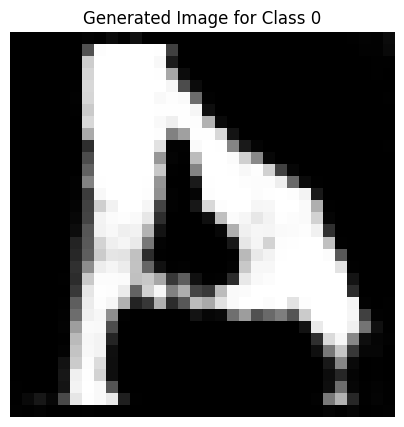

Epoch [880/2500], D_loss: 0.020078256726264954, G_loss: -0.6733890771865845


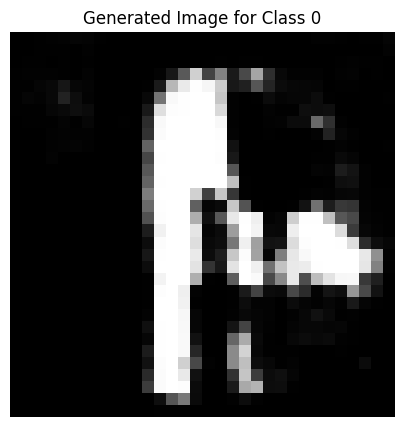

Epoch [881/2500], D_loss: 0.02009546011686325, G_loss: -0.5969973802566528


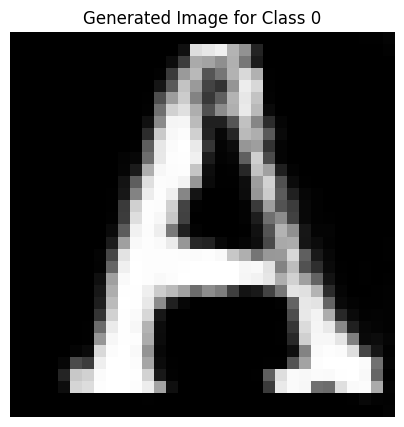

Epoch [882/2500], D_loss: 0.006311129778623581, G_loss: -0.5653658509254456


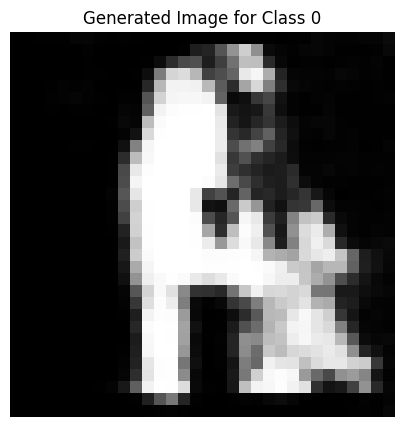

Epoch [883/2500], D_loss: 0.04687739163637161, G_loss: -0.576420783996582


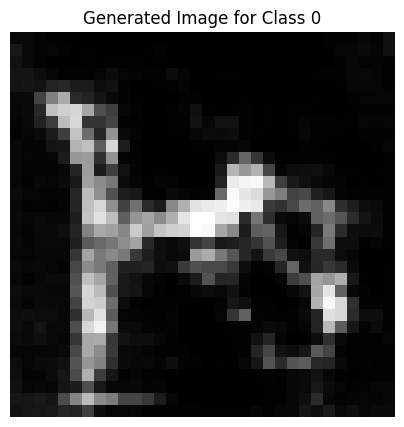

Epoch [884/2500], D_loss: 0.01348145306110382, G_loss: -0.6164759993553162


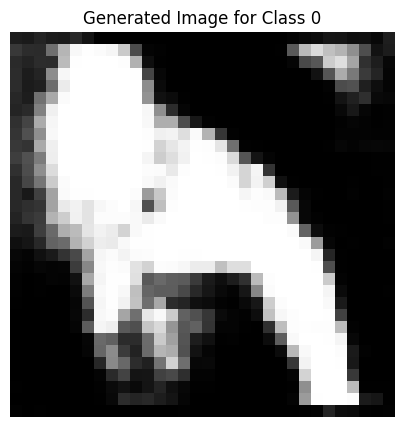

Epoch [885/2500], D_loss: 0.008904919028282166, G_loss: -0.5926728248596191


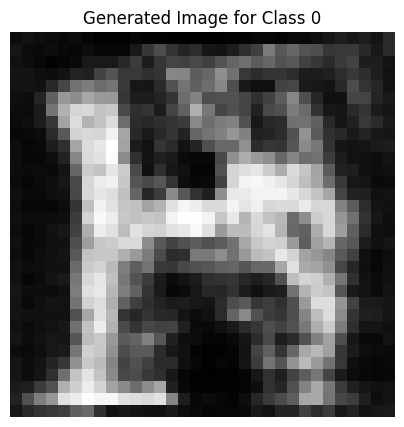

Epoch [886/2500], D_loss: 0.01697739213705063, G_loss: -0.6045293807983398


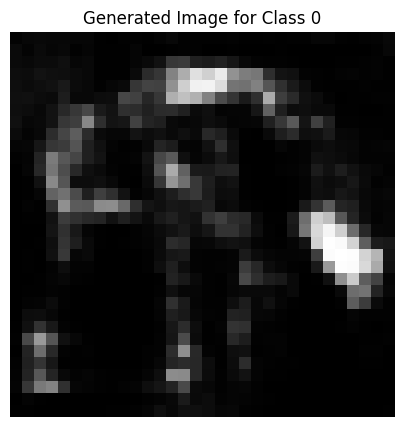

Epoch [887/2500], D_loss: 0.004300713539123535, G_loss: -0.6078426241874695


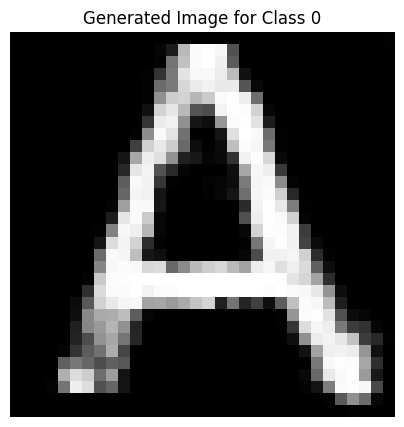

Epoch [888/2500], D_loss: 0.0017939284443855286, G_loss: -0.646506130695343


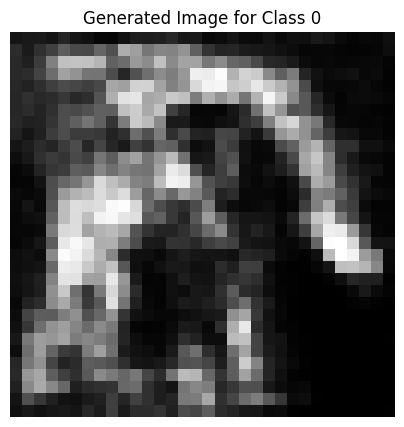

Epoch [889/2500], D_loss: 0.05006072670221329, G_loss: -0.5954619646072388


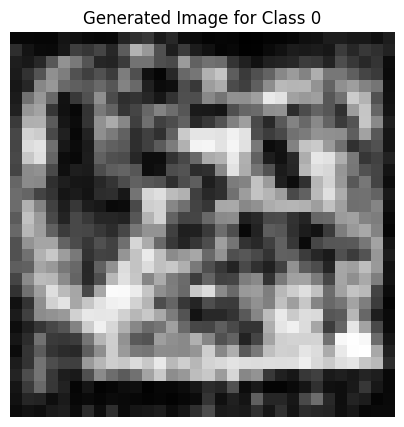

Epoch [890/2500], D_loss: -0.007387049496173859, G_loss: -0.5981683731079102


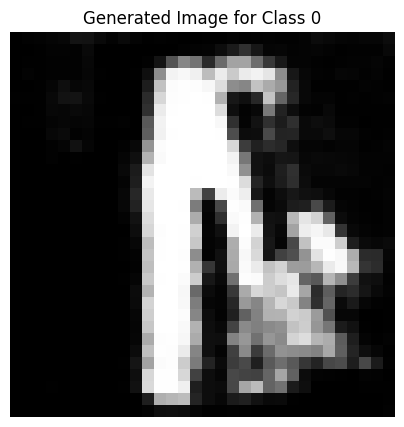

Epoch [891/2500], D_loss: 0.021148502826690674, G_loss: -0.45343413949012756


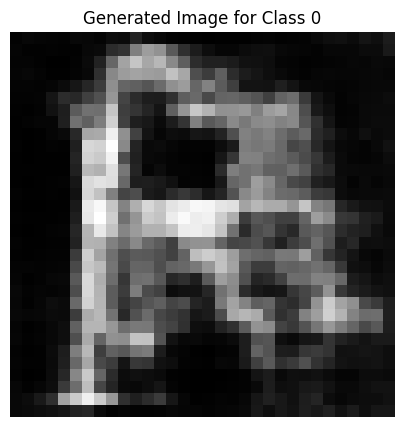

Epoch [892/2500], D_loss: -0.009016968309879303, G_loss: -0.5689830780029297


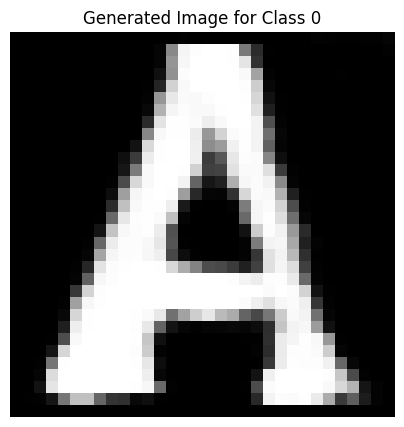

Epoch [893/2500], D_loss: -0.0026503726840019226, G_loss: -0.5397217273712158


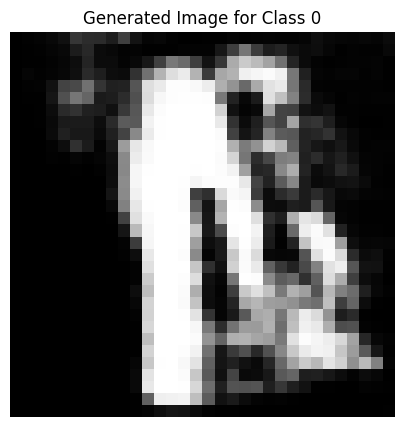

Epoch [894/2500], D_loss: 0.056025534868240356, G_loss: -0.40233829617500305


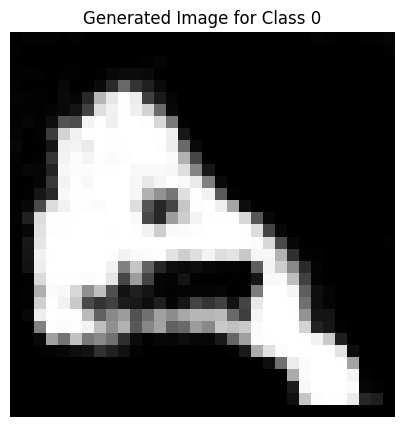

Epoch [895/2500], D_loss: -0.006053492426872253, G_loss: -0.5884549021720886


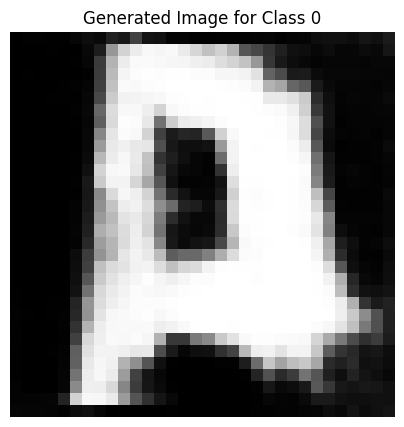

Epoch [896/2500], D_loss: 0.014326021075248718, G_loss: -0.5949297547340393


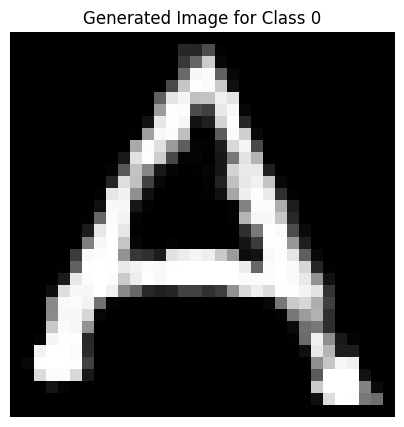

Epoch [897/2500], D_loss: 0.012446798384189606, G_loss: -0.5690315365791321


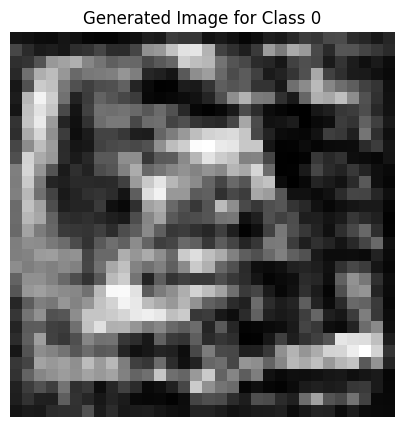

Epoch [898/2500], D_loss: 0.00062522292137146, G_loss: -0.5961757898330688


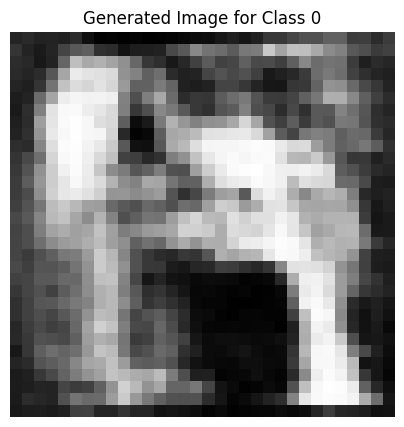

Epoch [899/2500], D_loss: 0.0028662607073783875, G_loss: -0.6275651454925537


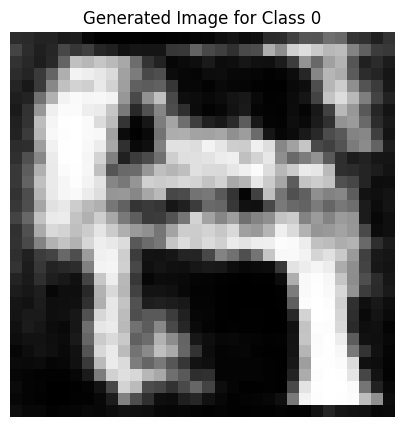

Epoch [900/2500], D_loss: 0.012689828872680664, G_loss: -0.5828282833099365


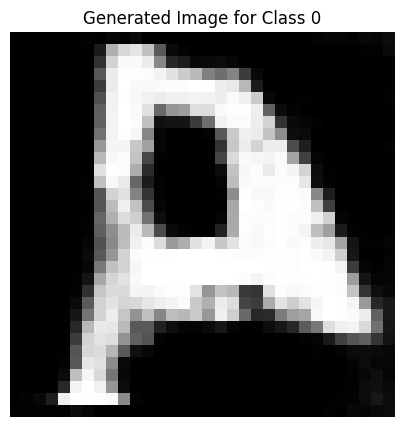

Epoch [901/2500], D_loss: -0.014941588044166565, G_loss: -0.5819576978683472


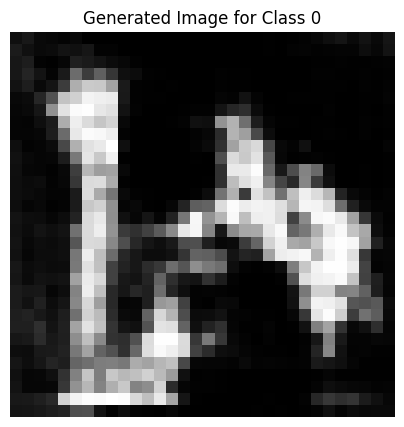

Epoch [902/2500], D_loss: -0.027274854481220245, G_loss: -0.5573312044143677


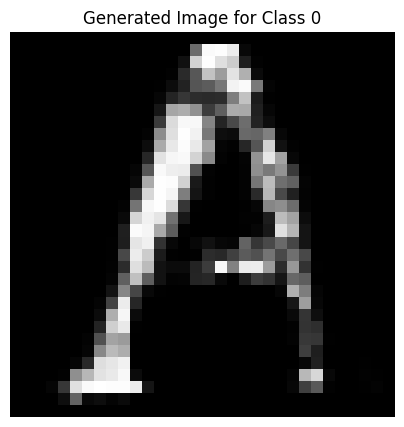

Epoch [903/2500], D_loss: -0.02980537712574005, G_loss: -0.5332942008972168


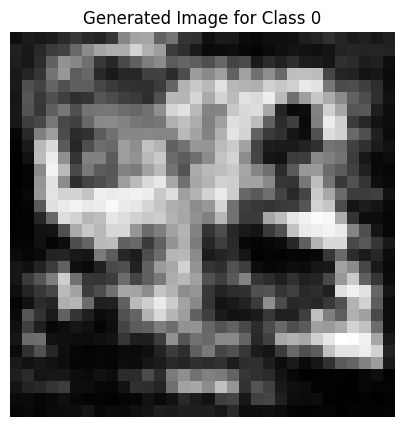

Epoch [904/2500], D_loss: -0.019963480532169342, G_loss: -0.5238223075866699


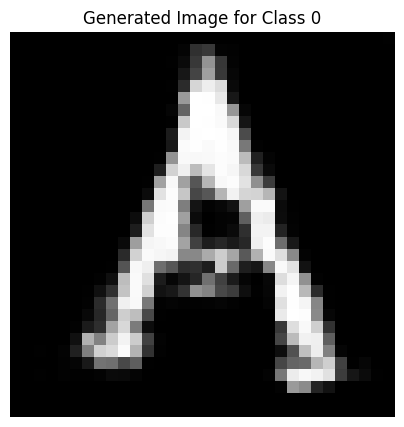

Epoch [905/2500], D_loss: 0.027419716119766235, G_loss: -0.4882689416408539


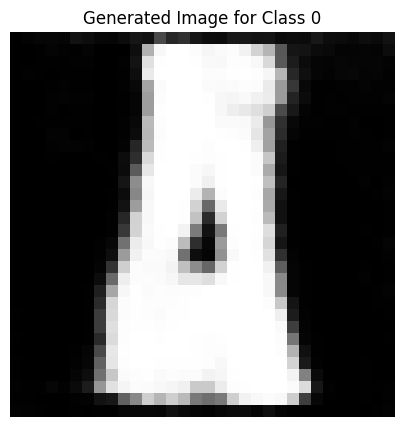

Epoch [906/2500], D_loss: -0.025748729705810547, G_loss: -0.5705459117889404


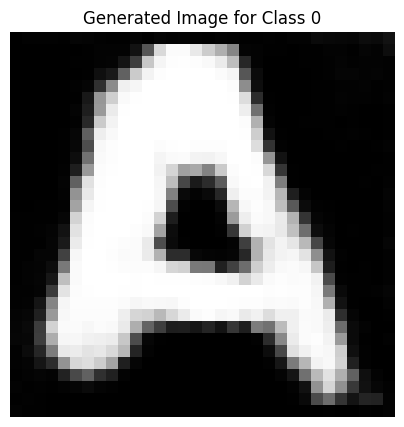

Epoch [907/2500], D_loss: -0.029005296528339386, G_loss: -0.7577600479125977


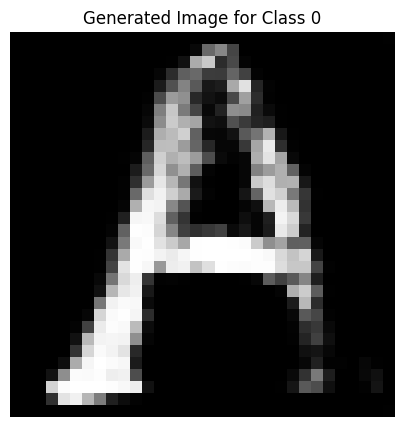

Epoch [908/2500], D_loss: -0.012386128306388855, G_loss: -0.5461435317993164


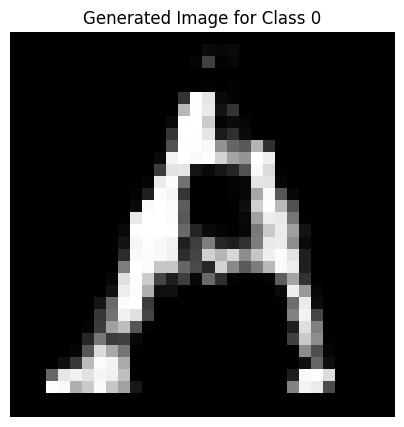

Epoch [909/2500], D_loss: 0.007334314286708832, G_loss: -0.5518462657928467


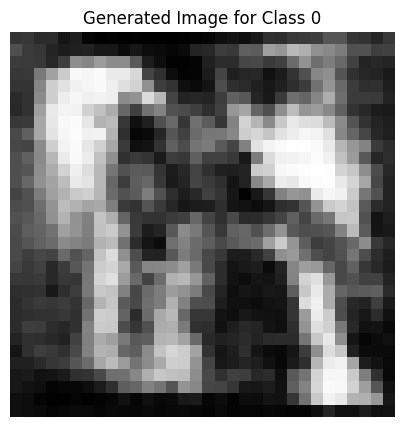

Epoch [910/2500], D_loss: -0.026961706578731537, G_loss: -0.5532116889953613


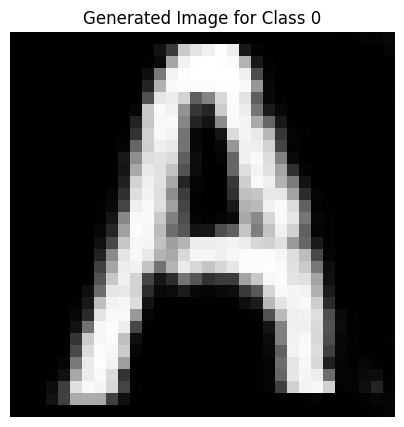

Epoch [911/2500], D_loss: 0.03661982715129852, G_loss: -0.6099729537963867


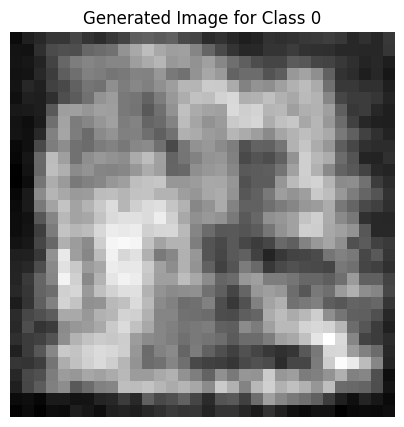

Epoch [912/2500], D_loss: 0.01574472337961197, G_loss: -0.6003015637397766


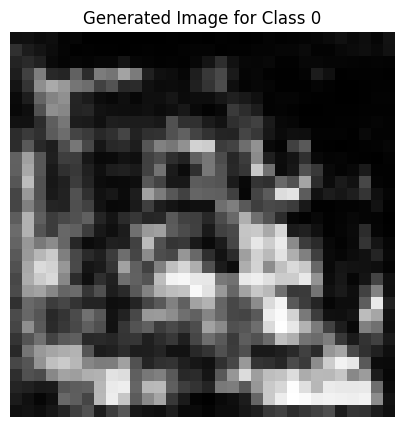

Epoch [913/2500], D_loss: -0.011248677968978882, G_loss: -0.5715622901916504


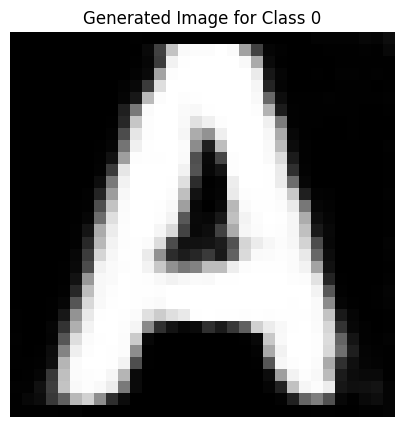

Epoch [914/2500], D_loss: -0.029718242585659027, G_loss: -0.5715407729148865


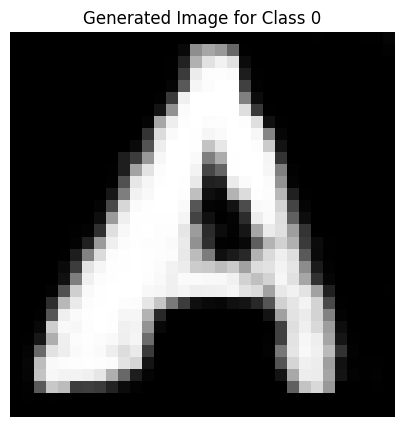

Epoch [915/2500], D_loss: -0.007951736450195312, G_loss: -0.556941032409668


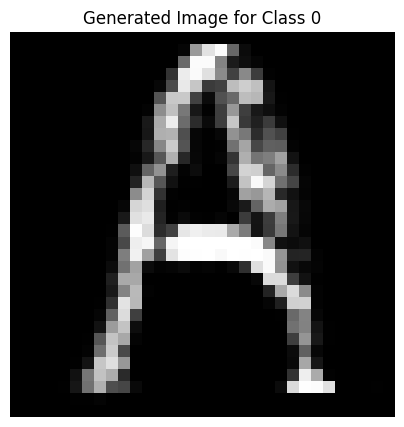

Epoch [916/2500], D_loss: 0.02064777910709381, G_loss: -0.6043573617935181


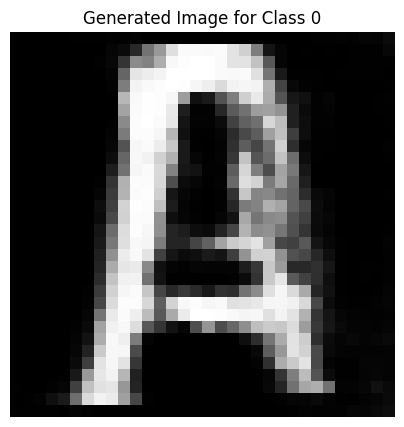

Epoch [917/2500], D_loss: 0.023320704698562622, G_loss: -0.5459145307540894


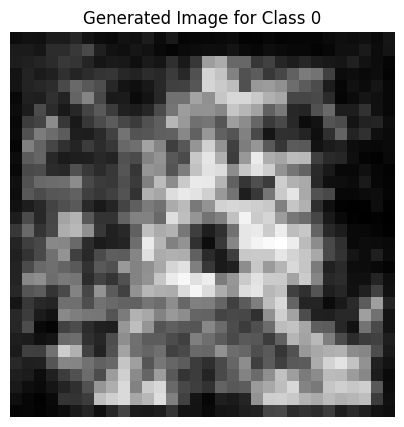

Epoch [918/2500], D_loss: 0.04045940935611725, G_loss: -0.5720564126968384


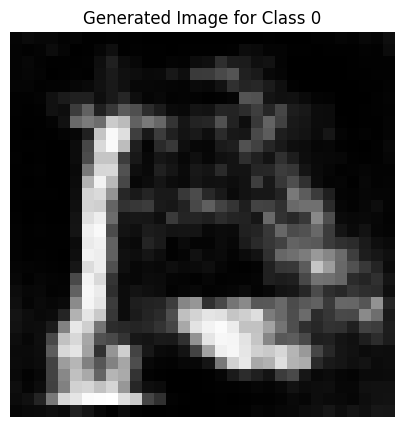

Epoch [919/2500], D_loss: 0.03669261932373047, G_loss: -0.5577482581138611


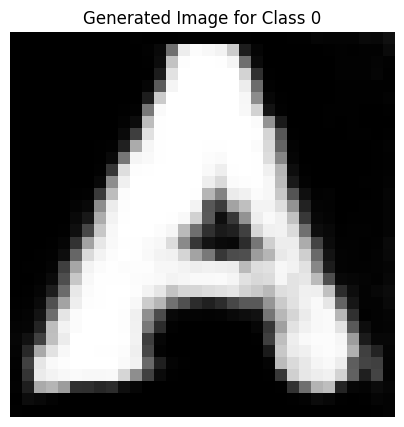

Epoch [920/2500], D_loss: 0.007140591740608215, G_loss: -0.5277870893478394


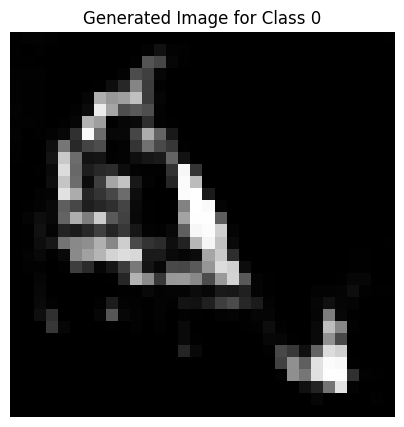

Epoch [921/2500], D_loss: 0.016406826674938202, G_loss: -0.6672192215919495


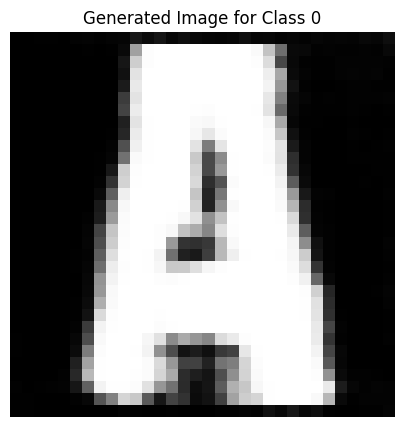

Epoch [922/2500], D_loss: 0.0076013654470443726, G_loss: -0.5210236310958862


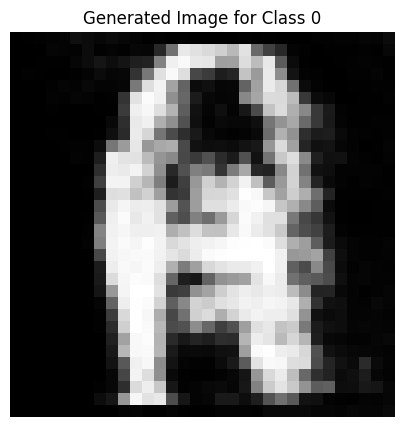

Epoch [923/2500], D_loss: 0.3790605664253235, G_loss: -0.5829957723617554


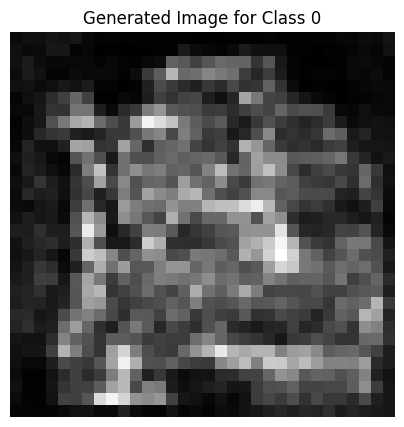

Epoch [924/2500], D_loss: 0.0024932026863098145, G_loss: -0.5513578057289124


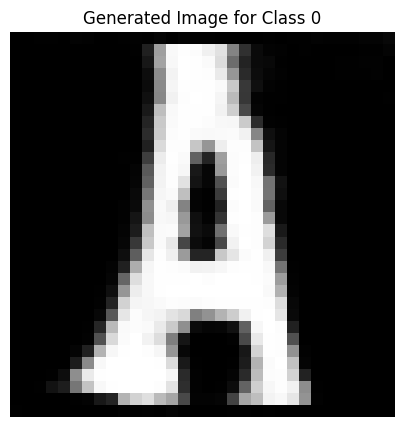

Epoch [925/2500], D_loss: 0.00010950863361358643, G_loss: -0.48687583208084106


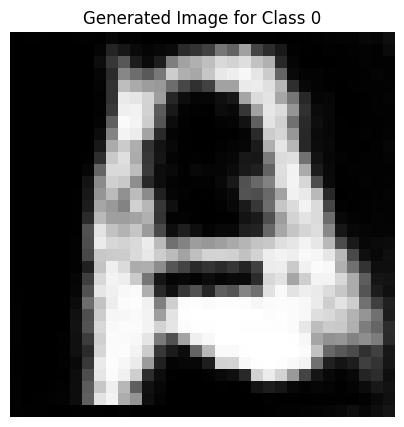

Epoch [926/2500], D_loss: -0.006689637899398804, G_loss: -0.593430757522583


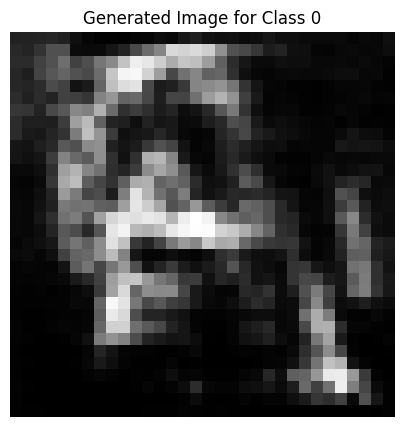

Epoch [927/2500], D_loss: -0.012484326958656311, G_loss: -0.43248146772384644


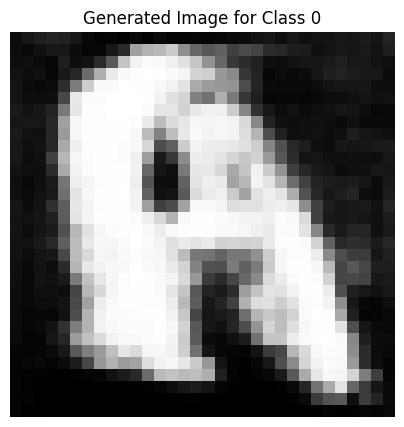

Epoch [928/2500], D_loss: -0.039134539663791656, G_loss: -0.49130475521087646


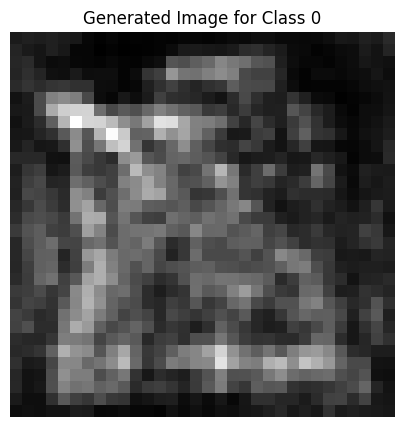

Epoch [929/2500], D_loss: -0.0121469646692276, G_loss: -0.46204081177711487


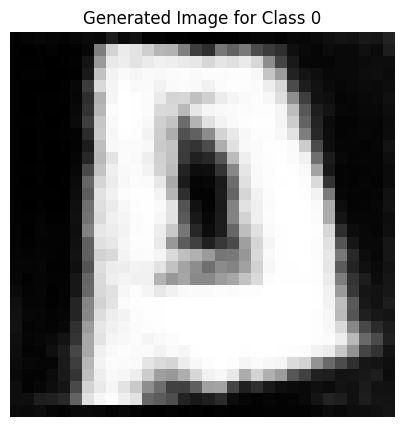

Epoch [930/2500], D_loss: -0.006262242794036865, G_loss: -0.5603822469711304


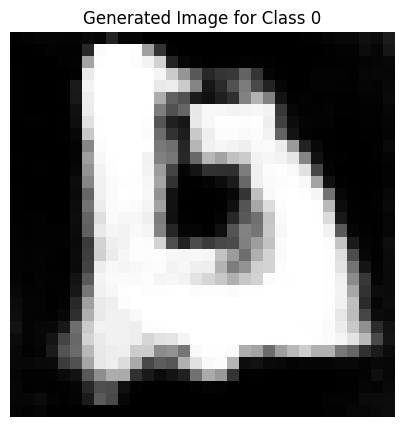

Epoch [931/2500], D_loss: 0.0036268681287765503, G_loss: -0.5550445318222046


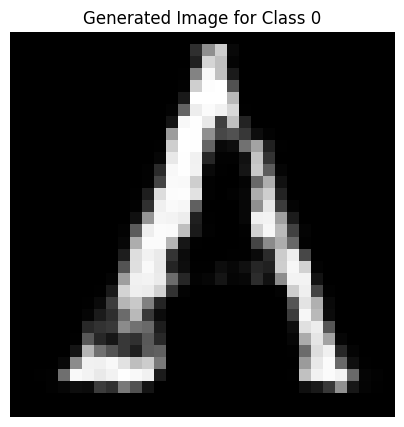

Epoch [932/2500], D_loss: 0.08802081644535065, G_loss: -0.5983373522758484


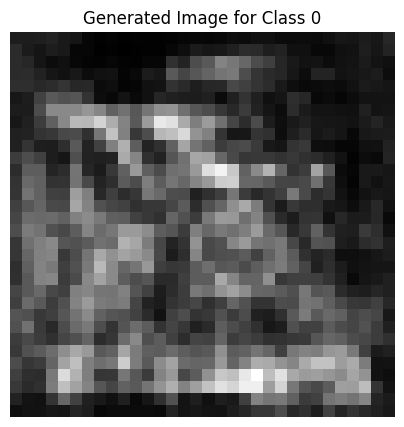

Epoch [933/2500], D_loss: 0.0015319809317588806, G_loss: -0.5929762125015259


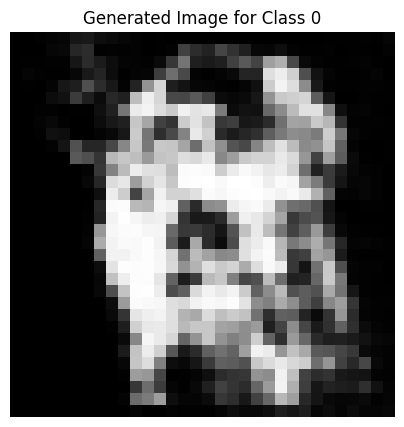

Epoch [934/2500], D_loss: -6.56023621559143e-05, G_loss: -0.42592620849609375


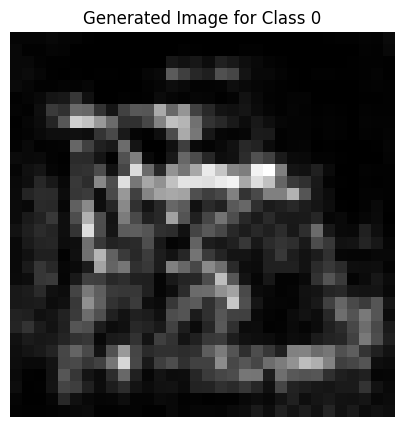

Epoch [935/2500], D_loss: -0.02472628653049469, G_loss: -0.4499184489250183


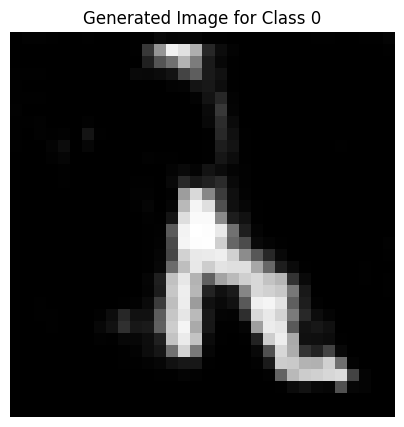

Epoch [936/2500], D_loss: 0.04464089870452881, G_loss: -0.5920999646186829


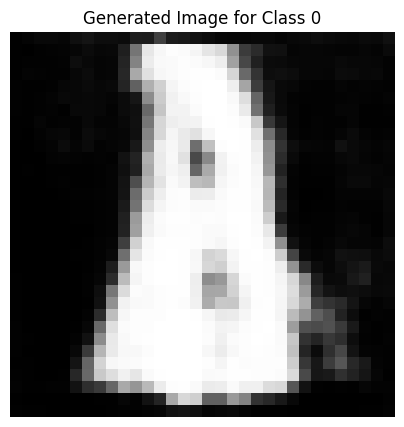

Epoch [937/2500], D_loss: 0.020804032683372498, G_loss: -0.586428701877594


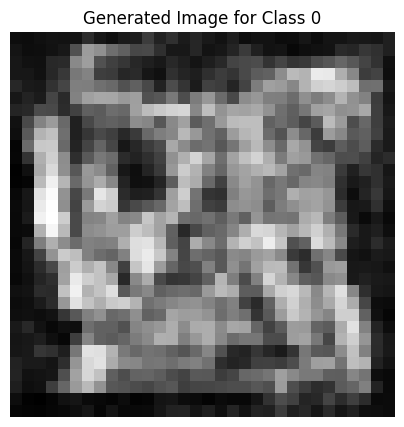

Epoch [938/2500], D_loss: -0.0003259703516960144, G_loss: -0.611775279045105


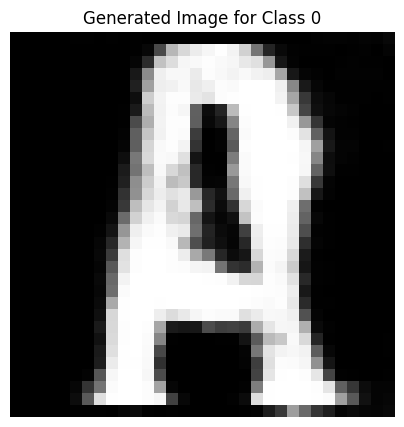

Epoch [939/2500], D_loss: 0.011468589305877686, G_loss: -0.5409542322158813


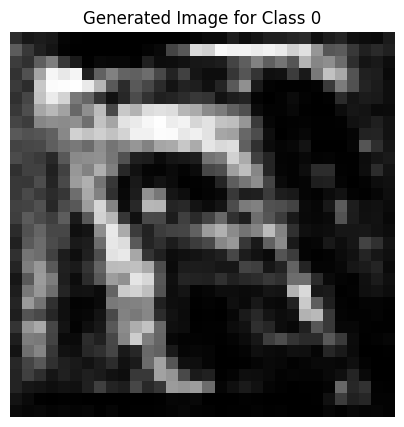

Epoch [940/2500], D_loss: -0.0091804638504982, G_loss: -0.6255055069923401


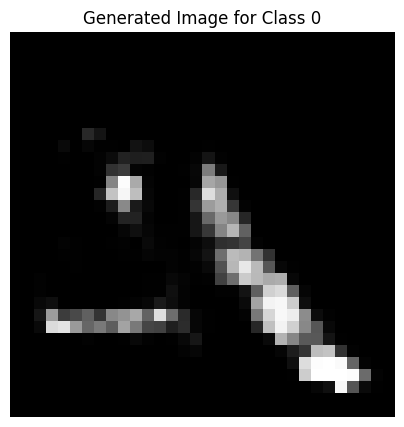

Epoch [941/2500], D_loss: 0.014814049005508423, G_loss: -0.47621041536331177


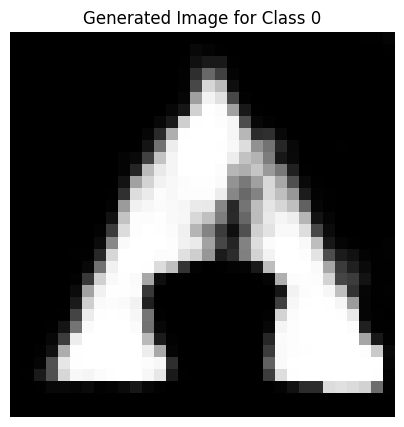

Epoch [942/2500], D_loss: 0.046788379549980164, G_loss: -0.5905376076698303


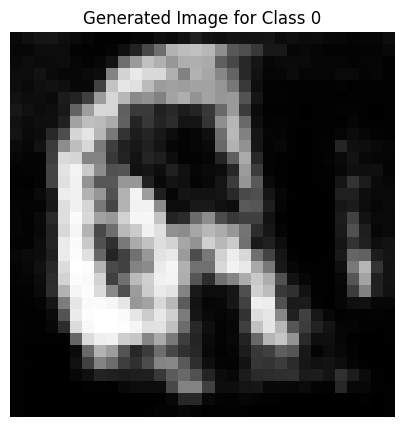

Epoch [943/2500], D_loss: -0.0008474141359329224, G_loss: -0.5769538283348083


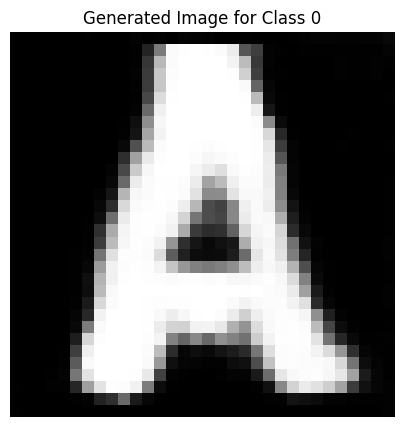

Epoch [944/2500], D_loss: 0.01106598973274231, G_loss: -0.4716755747795105


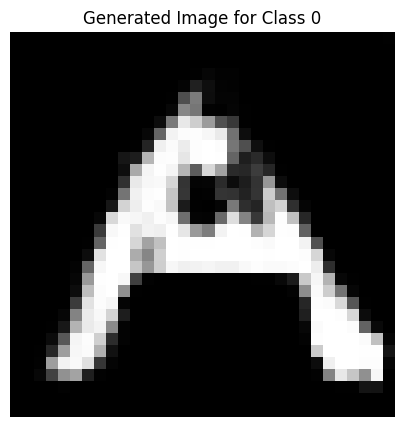

Epoch [945/2500], D_loss: 0.020164526998996735, G_loss: -0.5754494667053223


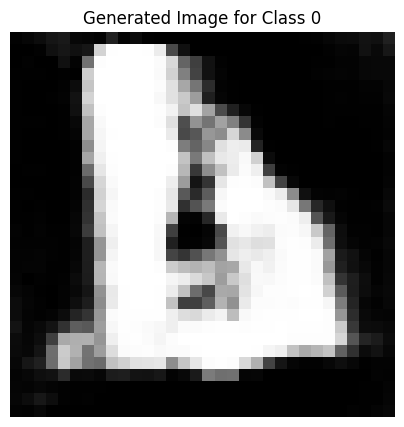

Epoch [946/2500], D_loss: -0.01581548899412155, G_loss: -0.574336588382721


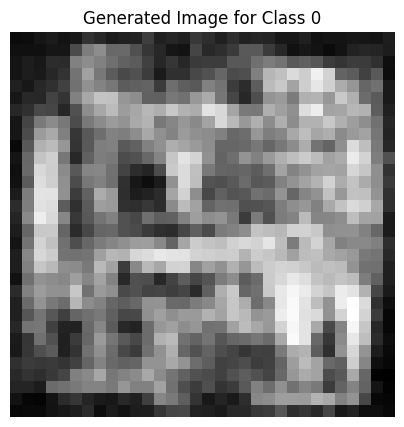

Epoch [947/2500], D_loss: -0.0032785609364509583, G_loss: -0.5615614652633667


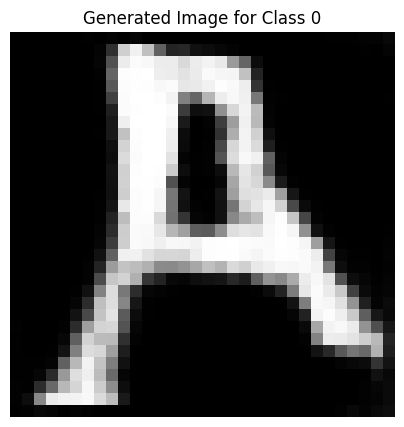

Epoch [948/2500], D_loss: 0.020068928599357605, G_loss: -0.6584902405738831


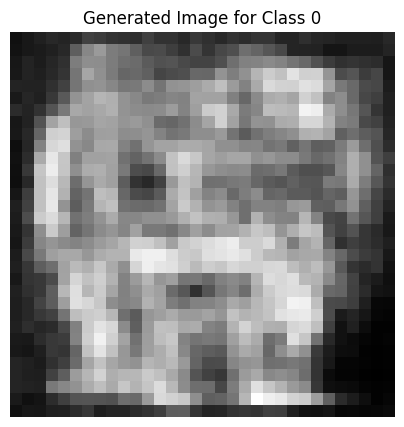

Epoch [949/2500], D_loss: -0.008618749678134918, G_loss: -0.5661475658416748


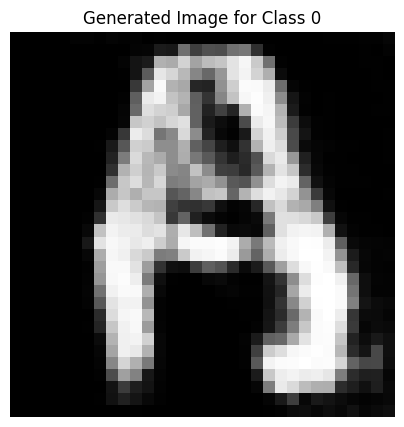

Epoch [950/2500], D_loss: -0.01709241420030594, G_loss: -0.6255835294723511


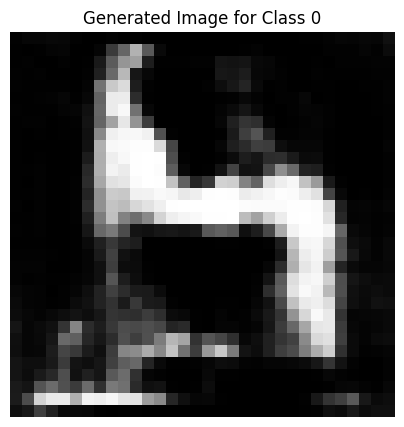

Epoch [951/2500], D_loss: -0.0009819716215133667, G_loss: -0.7258639335632324


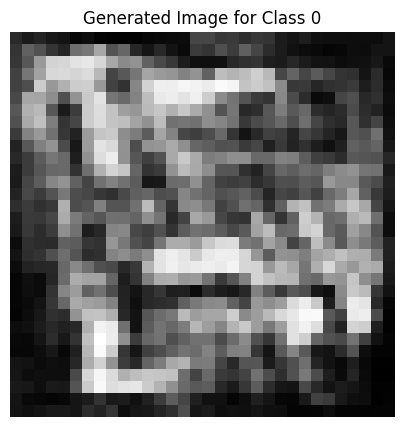

Epoch [952/2500], D_loss: 0.013455167412757874, G_loss: -0.5852196216583252


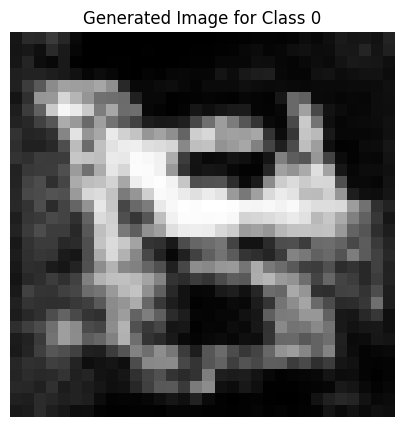

Epoch [953/2500], D_loss: 0.01952066272497177, G_loss: -0.511581540107727


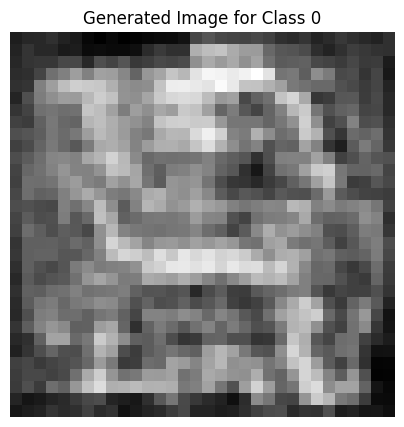

Epoch [954/2500], D_loss: -0.01286742091178894, G_loss: -0.5511764287948608


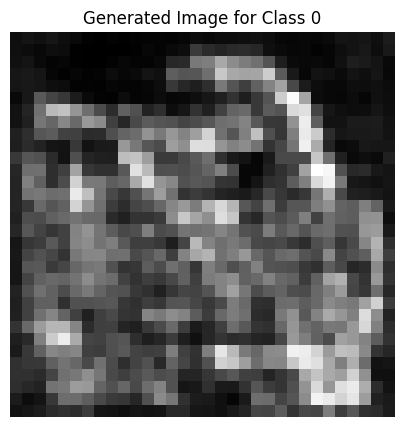

Epoch [955/2500], D_loss: -0.01902853697538376, G_loss: -0.5415254831314087


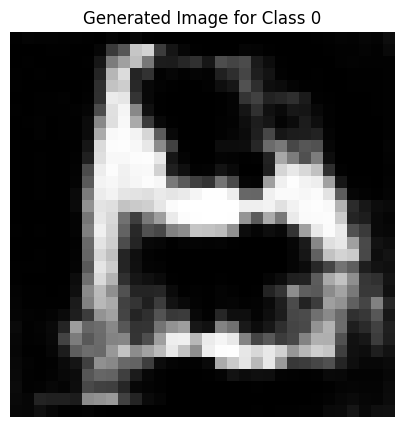

Epoch [956/2500], D_loss: -0.008361011743545532, G_loss: -0.5922287702560425


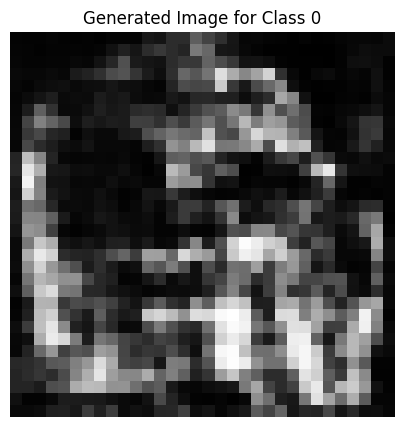

Epoch [957/2500], D_loss: -0.03145437687635422, G_loss: -0.6381374597549438


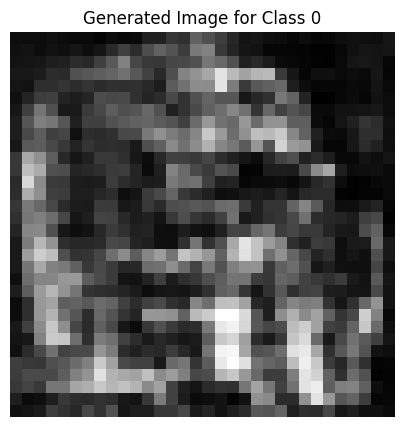

Epoch [958/2500], D_loss: -0.03577693551778793, G_loss: -0.5892469882965088


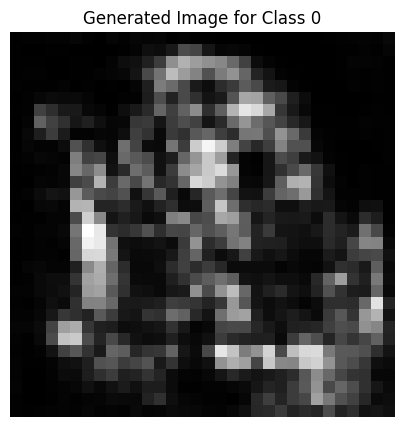

Epoch [959/2500], D_loss: 0.006345219910144806, G_loss: -0.5310394763946533


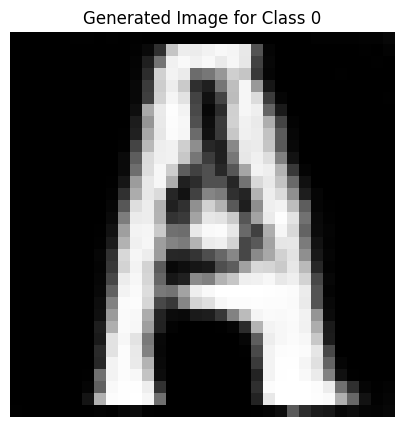

Epoch [960/2500], D_loss: -0.03386025130748749, G_loss: -0.5695695877075195


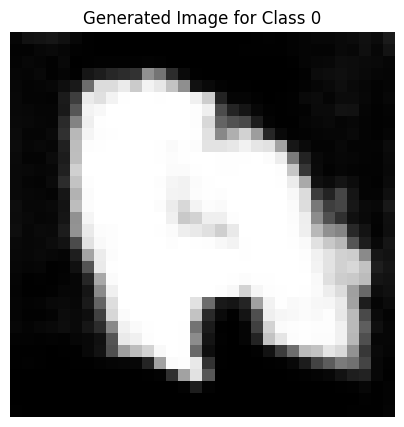

Epoch [961/2500], D_loss: -0.04547366499900818, G_loss: -0.5539212226867676


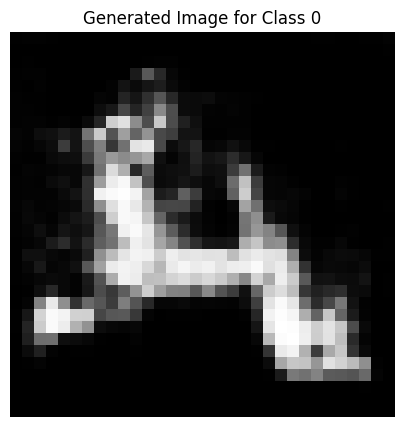

Epoch [962/2500], D_loss: -0.02375296875834465, G_loss: -0.6662030220031738


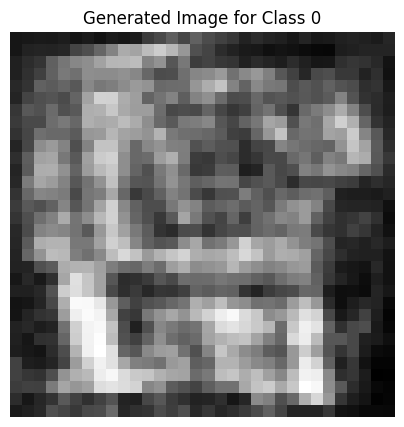

Epoch [963/2500], D_loss: -0.03366893529891968, G_loss: -0.562405526638031


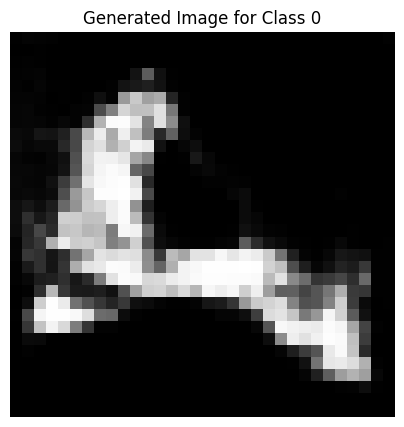

Epoch [964/2500], D_loss: 0.007269188761711121, G_loss: -0.7342315316200256


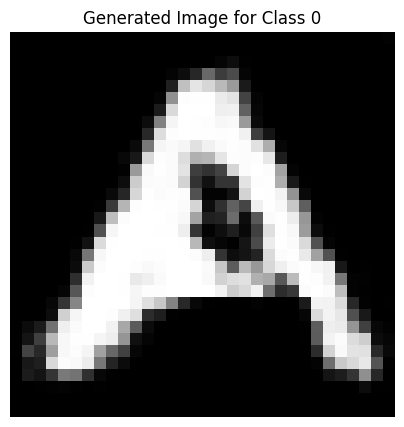

Epoch [965/2500], D_loss: -0.02760019153356552, G_loss: -0.5338608026504517


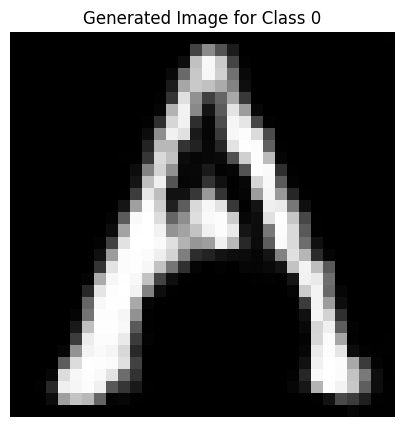

Epoch [966/2500], D_loss: 0.0015740394592285156, G_loss: -0.617525041103363


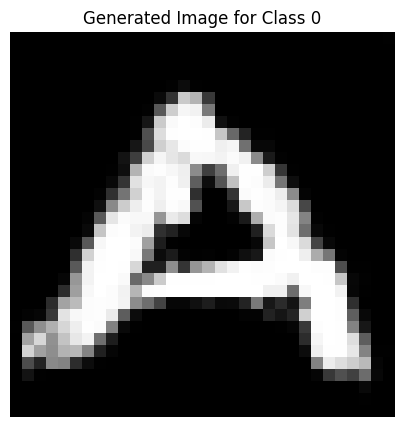

Epoch [967/2500], D_loss: -0.016478627920150757, G_loss: -0.565687894821167


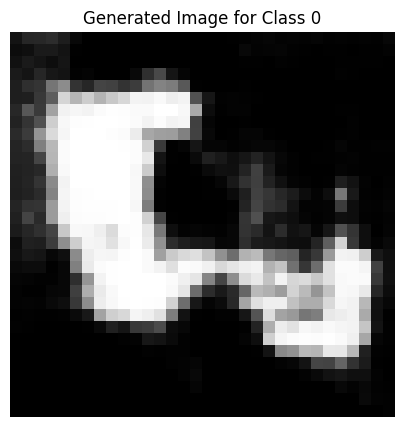

Epoch [968/2500], D_loss: -0.033150672912597656, G_loss: -0.5336464643478394


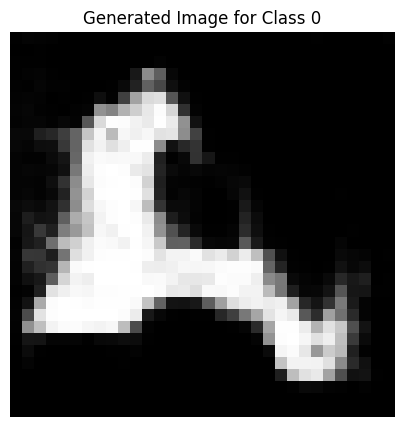

Epoch [969/2500], D_loss: -0.02239992469549179, G_loss: -0.5441591739654541


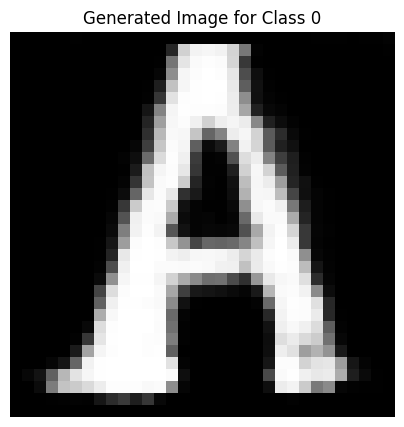

Epoch [970/2500], D_loss: -0.002363920211791992, G_loss: -0.5562519431114197


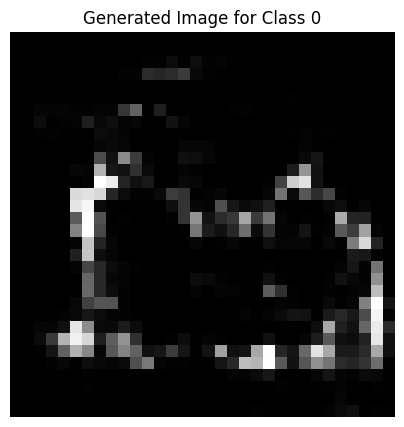

Epoch [971/2500], D_loss: -0.004812762141227722, G_loss: -0.5580538511276245


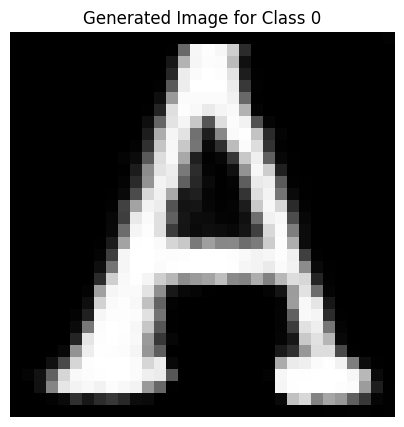

Epoch [972/2500], D_loss: -0.006695777177810669, G_loss: -0.5765709280967712


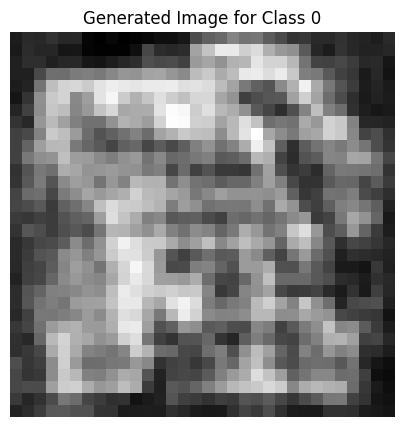

Epoch [973/2500], D_loss: -0.02186332643032074, G_loss: -0.587710976600647


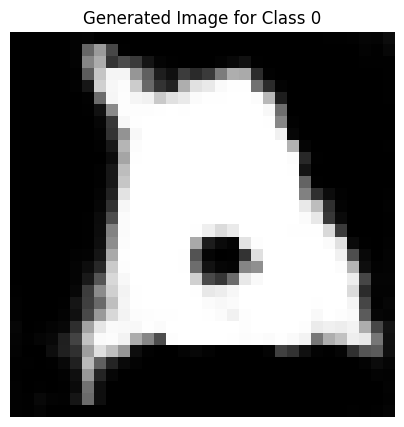

Epoch [974/2500], D_loss: -0.008197382092475891, G_loss: -0.5833438038825989


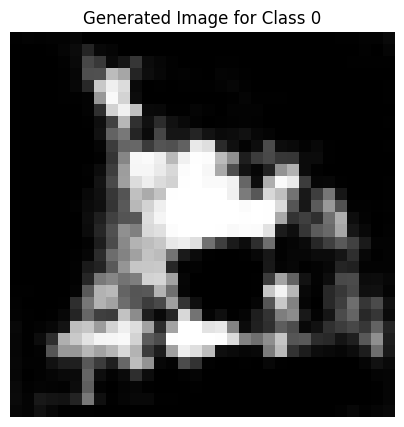

Epoch [975/2500], D_loss: 0.2598881125450134, G_loss: -0.5670017004013062


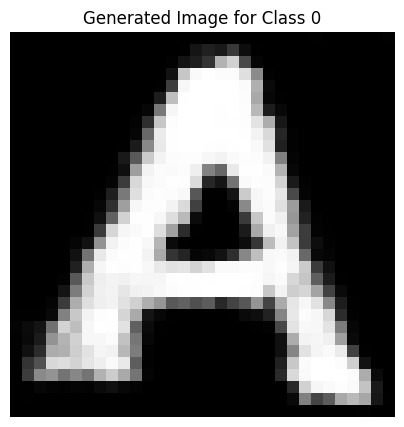

Epoch [976/2500], D_loss: -0.021964579820632935, G_loss: -0.5677489638328552


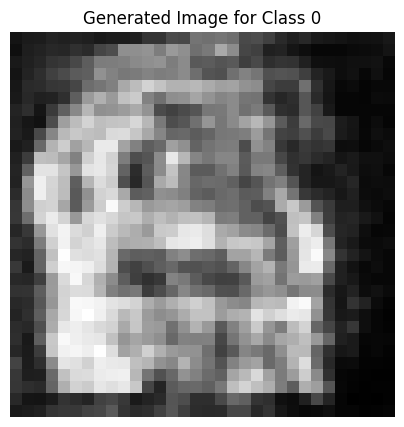

Epoch [977/2500], D_loss: 0.1248159408569336, G_loss: -0.5544158816337585


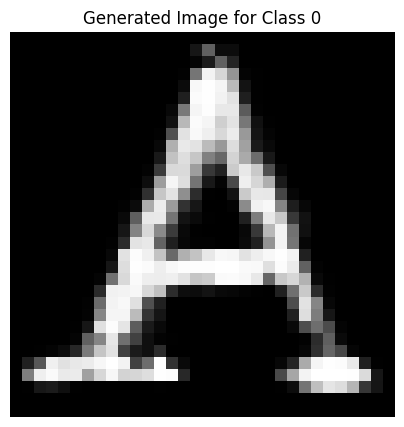

Epoch [978/2500], D_loss: -0.026573359966278076, G_loss: -0.5500773191452026


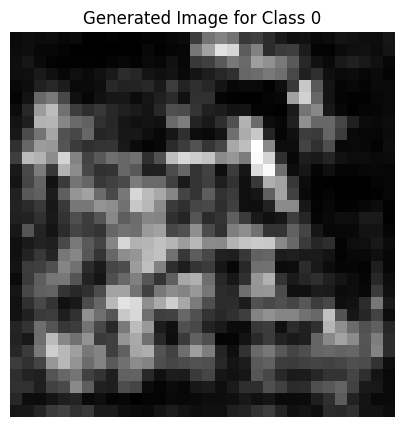

Epoch [979/2500], D_loss: -0.04667048528790474, G_loss: -0.5651895999908447


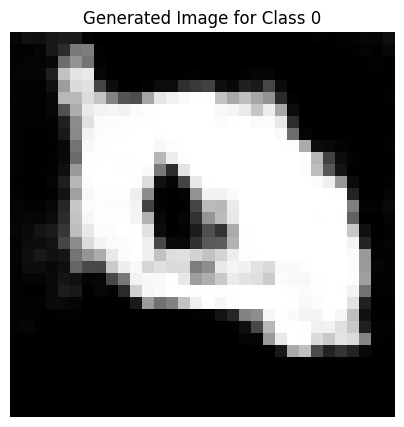

Epoch [980/2500], D_loss: -0.03619886189699173, G_loss: -0.6348886489868164


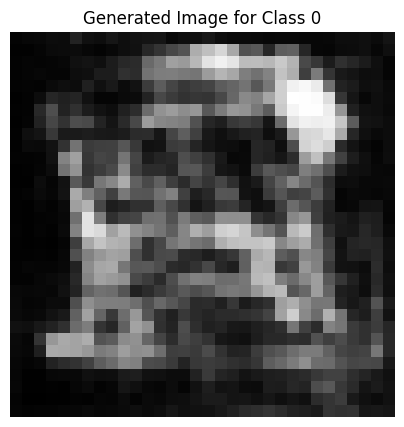

Epoch [981/2500], D_loss: -0.03279254958033562, G_loss: -0.5611283779144287


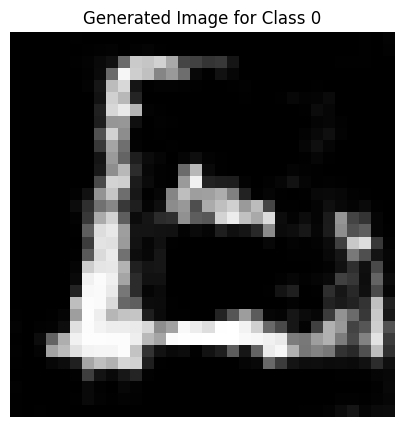

Epoch [982/2500], D_loss: -0.028854411095380783, G_loss: -0.5221468210220337


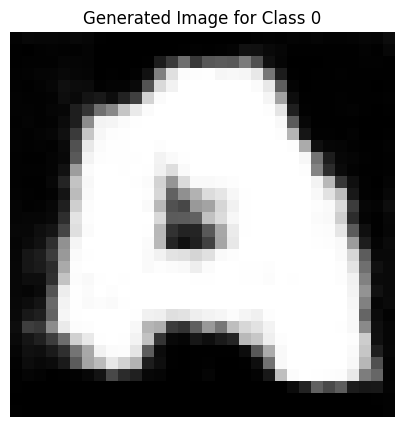

Epoch [983/2500], D_loss: -0.03763306140899658, G_loss: -0.5172429084777832


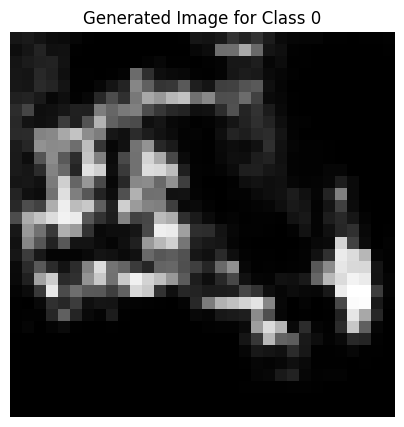

Epoch [984/2500], D_loss: -0.01690070331096649, G_loss: -0.39572155475616455


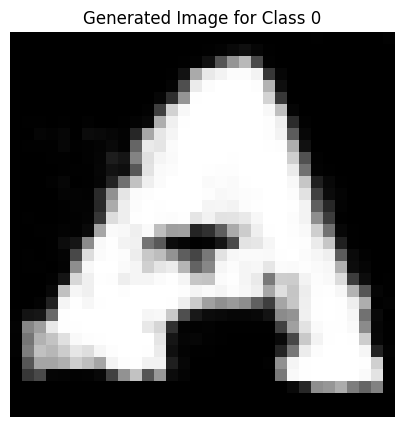

Epoch [985/2500], D_loss: -0.02404463291168213, G_loss: -0.5646563768386841


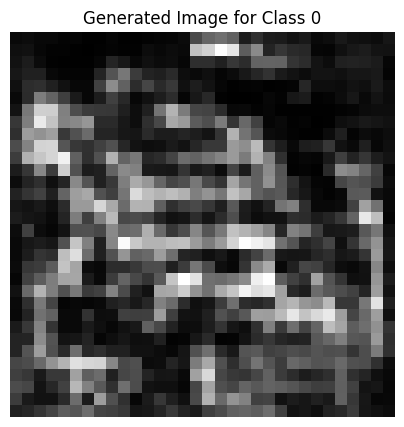

Epoch [986/2500], D_loss: -0.010331466794013977, G_loss: -0.6488814353942871


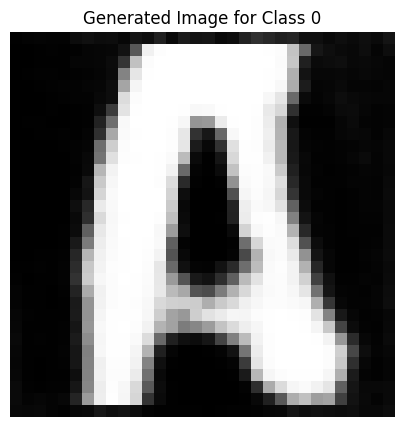

Epoch [987/2500], D_loss: -0.043448299169540405, G_loss: -0.5549851655960083


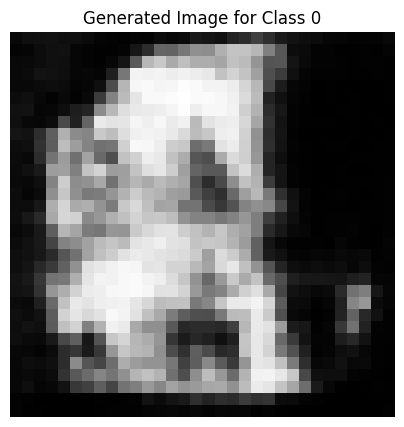

Epoch [988/2500], D_loss: -0.021472908556461334, G_loss: -0.5378583669662476


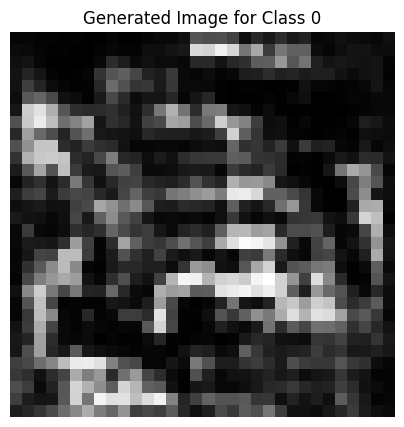

Epoch [989/2500], D_loss: -0.035466358065605164, G_loss: -0.550257682800293


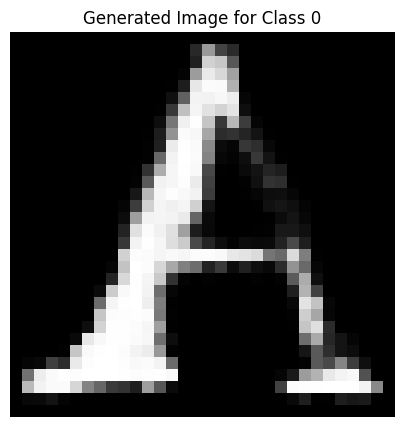

Epoch [990/2500], D_loss: 0.029022209346294403, G_loss: -0.6140458583831787


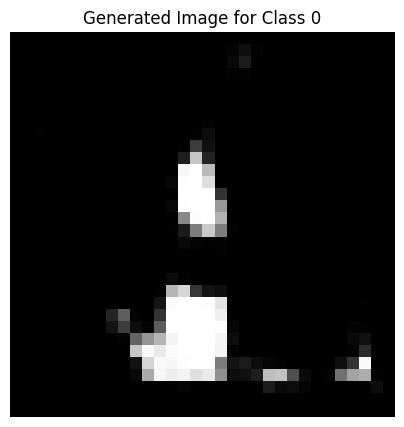

Epoch [991/2500], D_loss: -0.004959762096405029, G_loss: -0.4902108907699585


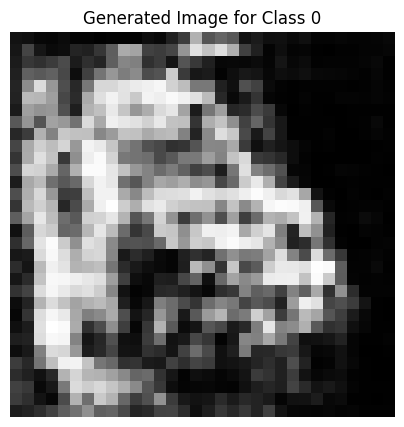

Epoch [992/2500], D_loss: -0.033126331865787506, G_loss: -0.5176368951797485


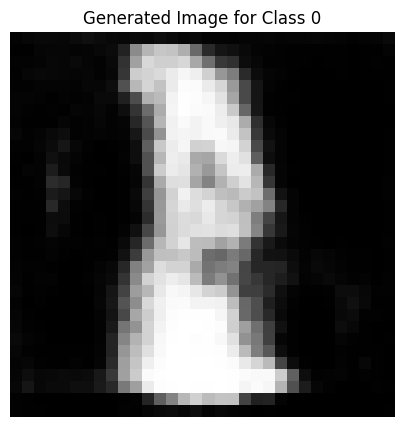

Epoch [993/2500], D_loss: -0.029069557785987854, G_loss: -0.5294241905212402


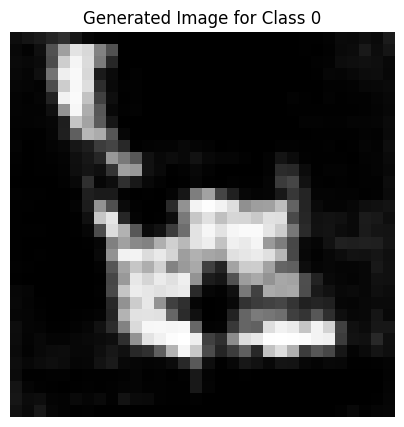

Epoch [994/2500], D_loss: -0.024620570242404938, G_loss: -0.5502544641494751


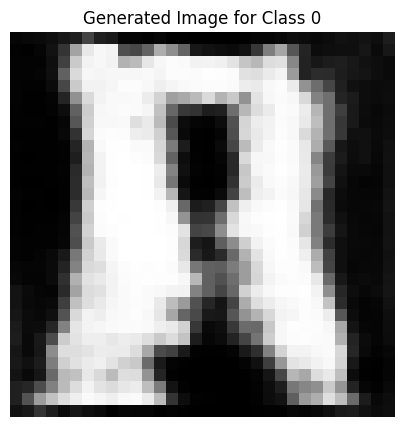

Epoch [995/2500], D_loss: 0.001244284212589264, G_loss: -0.547127366065979


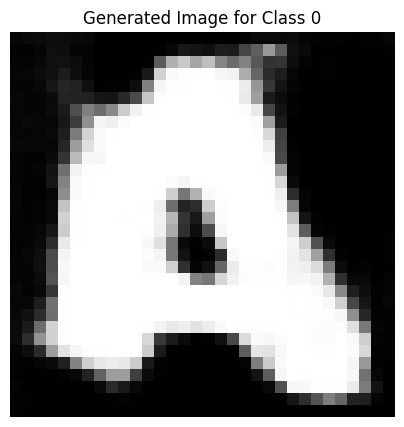

Epoch [996/2500], D_loss: -0.011062636971473694, G_loss: -0.569411039352417


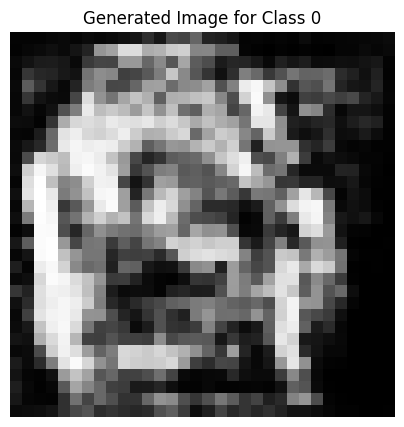

Epoch [997/2500], D_loss: -0.023500017821788788, G_loss: -0.4800894260406494


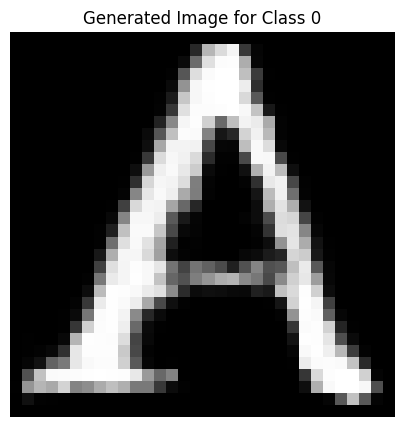

Epoch [998/2500], D_loss: 0.009285904467105865, G_loss: -0.6732194423675537


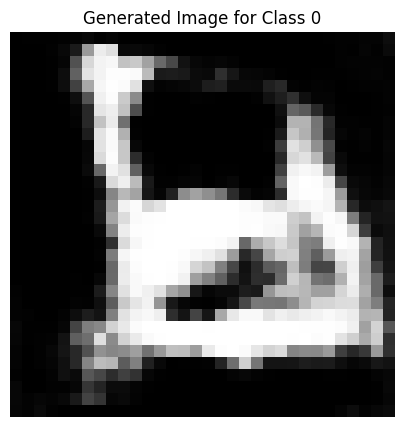

Epoch [999/2500], D_loss: -0.034545332193374634, G_loss: -0.5743058919906616


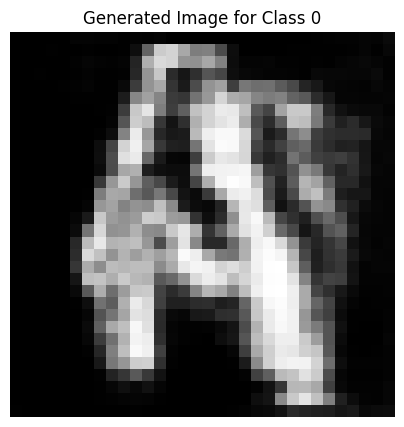

Epoch [1000/2500], D_loss: -0.023194875568151474, G_loss: -0.5217892527580261


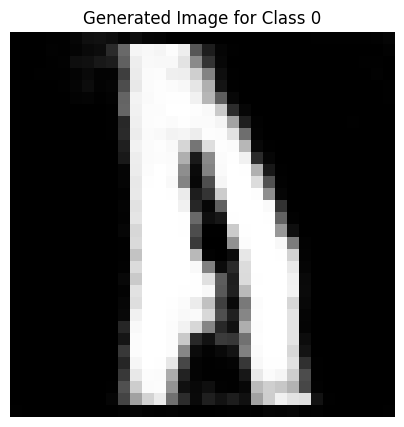

Epoch [1001/2500], D_loss: -0.005058661103248596, G_loss: -0.5581590533256531


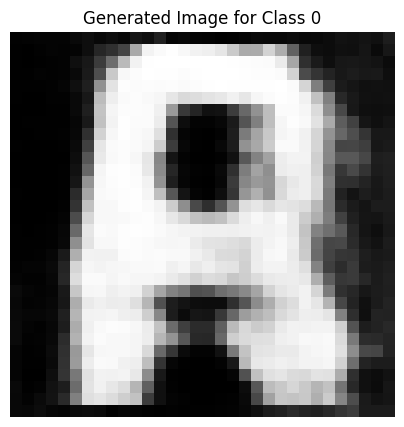

Epoch [1002/2500], D_loss: -0.021713286638259888, G_loss: -0.5723178386688232


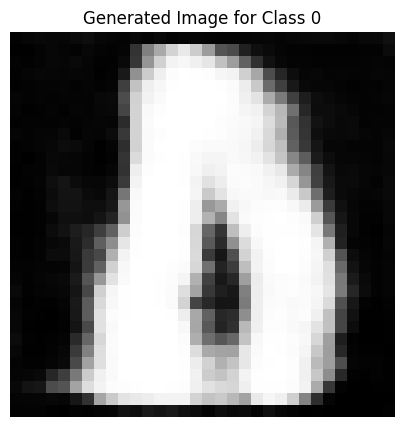

Epoch [1003/2500], D_loss: -0.00840982049703598, G_loss: -0.585343062877655


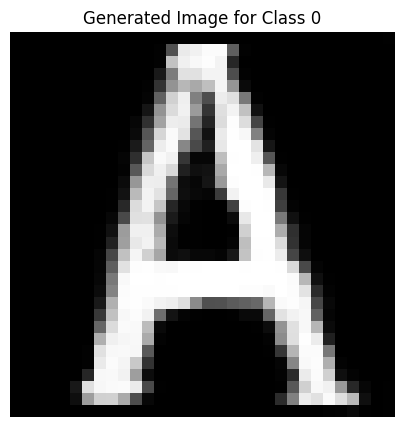

Epoch [1004/2500], D_loss: -0.029988233000040054, G_loss: -0.5501711368560791


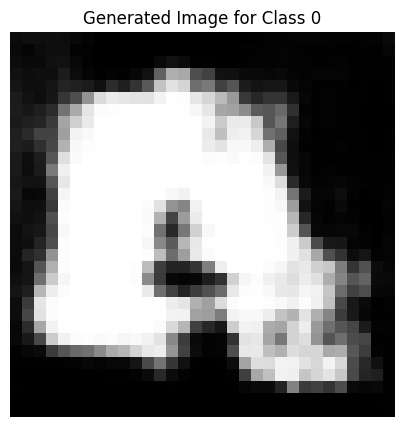

Epoch [1005/2500], D_loss: -0.012653425335884094, G_loss: -0.5466558933258057


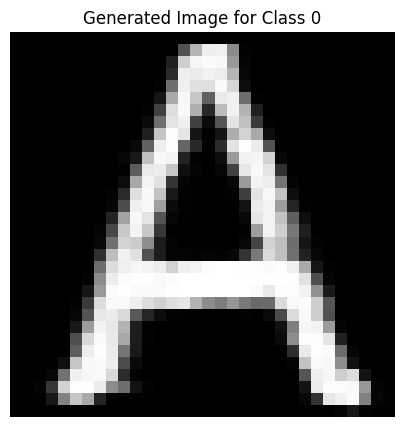

Epoch [1006/2500], D_loss: -0.008330091834068298, G_loss: -0.5763576030731201


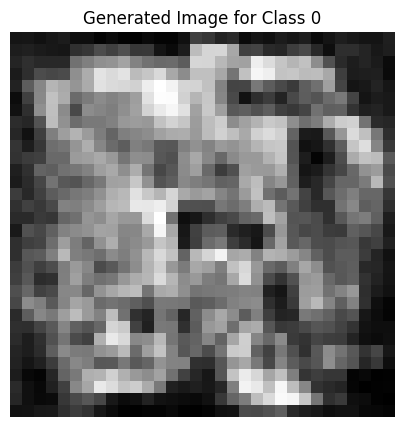

Epoch [1007/2500], D_loss: -0.012530326843261719, G_loss: -0.5562029480934143


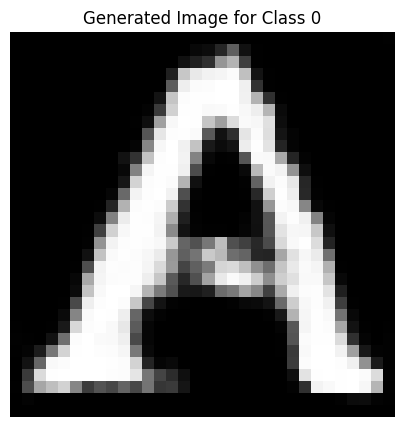

Epoch [1008/2500], D_loss: 0.015224680304527283, G_loss: -0.4656805992126465


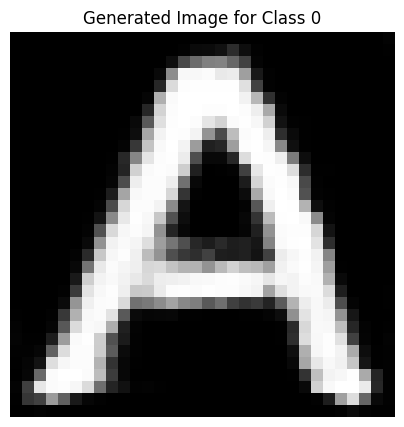

Epoch [1009/2500], D_loss: 0.021305039525032043, G_loss: -0.493510365486145


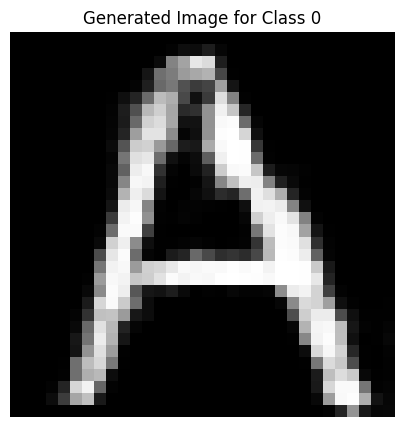

Epoch [1010/2500], D_loss: -9.740889072418213e-05, G_loss: -0.5159648656845093


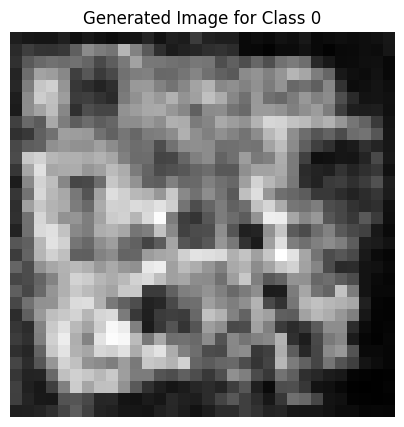

Epoch [1011/2500], D_loss: 0.013300664722919464, G_loss: -0.5461463928222656


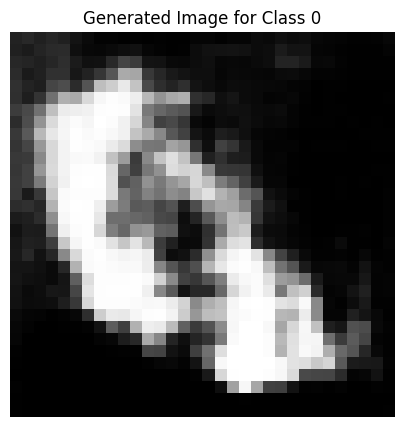

Epoch [1012/2500], D_loss: -0.03552348166704178, G_loss: -0.5510907173156738


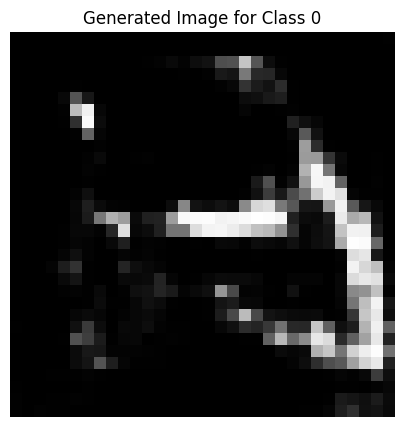

Epoch [1013/2500], D_loss: 0.011035829782485962, G_loss: -0.4811307191848755


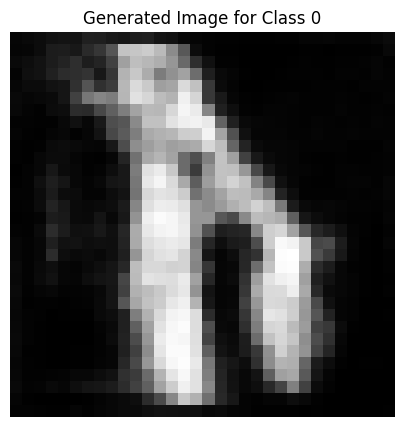

Epoch [1014/2500], D_loss: -0.017648570239543915, G_loss: -0.513841986656189


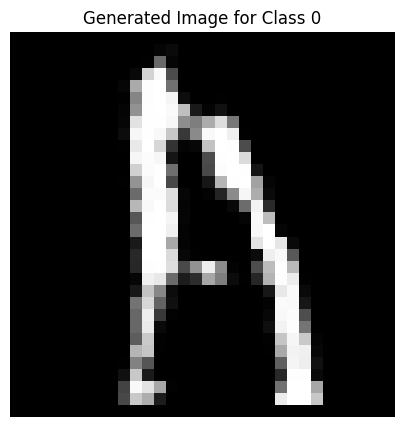

Epoch [1015/2500], D_loss: 0.0033400654792785645, G_loss: -0.5860460996627808


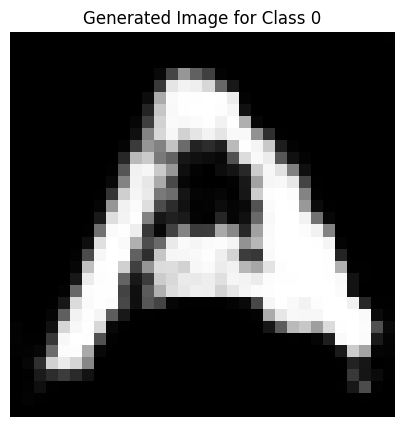

Epoch [1016/2500], D_loss: -0.02413400262594223, G_loss: -0.5066206455230713


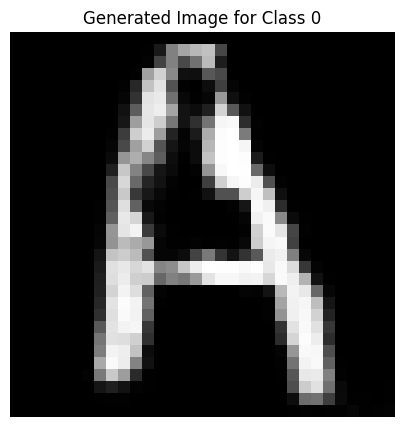

Epoch [1017/2500], D_loss: -0.010298170149326324, G_loss: -0.4640035629272461


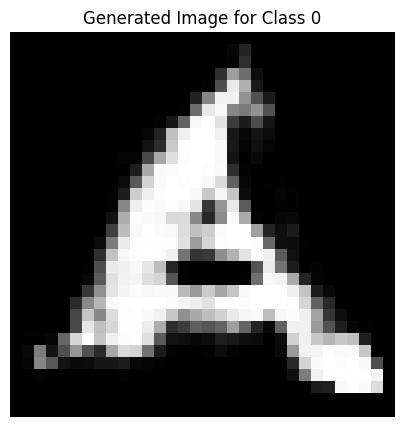

Epoch [1018/2500], D_loss: -0.01938430219888687, G_loss: -0.576156735420227


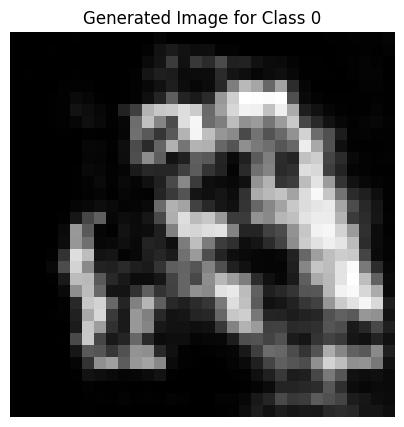

Epoch [1019/2500], D_loss: 0.012992724776268005, G_loss: -0.5052414536476135


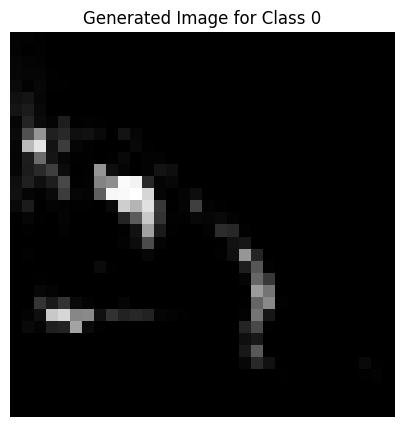

Epoch [1020/2500], D_loss: 0.06073777377605438, G_loss: -0.5872689485549927


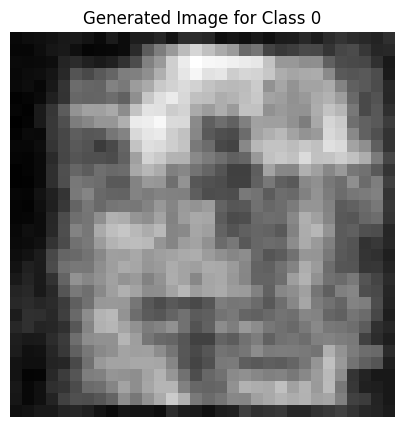

Epoch [1021/2500], D_loss: 0.007440537214279175, G_loss: -0.6121676564216614


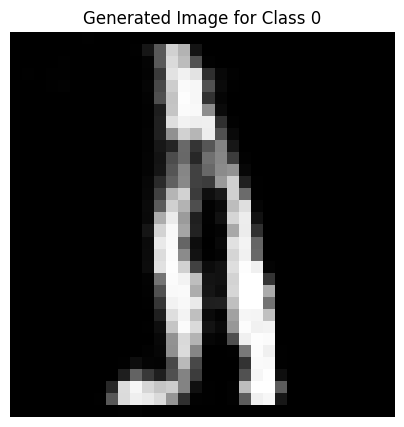

Epoch [1022/2500], D_loss: 0.015314429998397827, G_loss: -0.5533782243728638


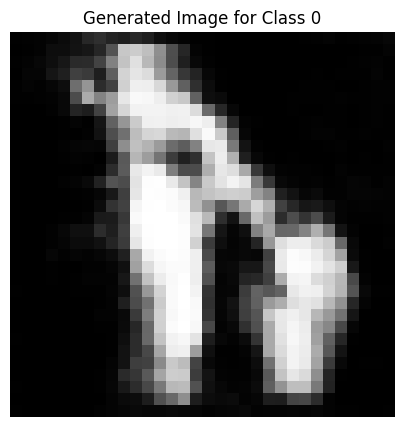

Epoch [1023/2500], D_loss: -0.001576840877532959, G_loss: -0.5090081691741943


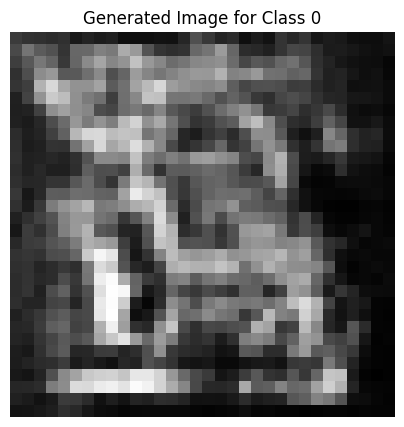

Epoch [1024/2500], D_loss: 0.013091698288917542, G_loss: -0.5844730734825134


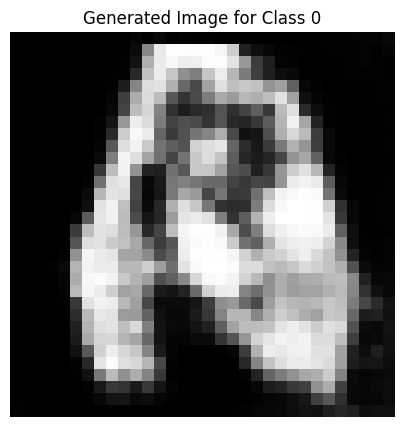

Epoch [1025/2500], D_loss: 0.004540890455245972, G_loss: -0.5717745423316956


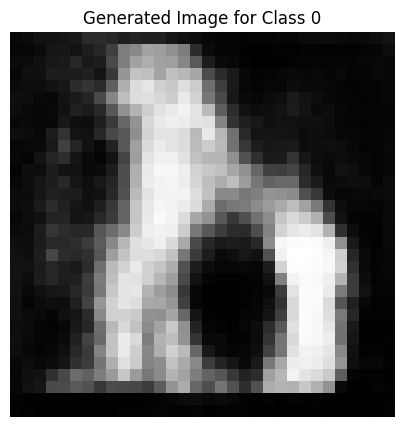

Epoch [1026/2500], D_loss: 0.02612236887216568, G_loss: -0.5910024642944336


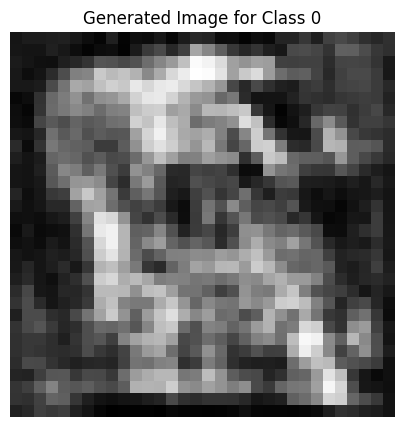

Epoch [1027/2500], D_loss: 0.029640011489391327, G_loss: -0.6225275993347168


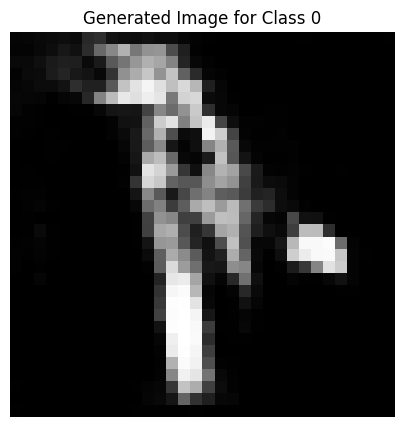

Epoch [1028/2500], D_loss: 0.014347612857818604, G_loss: -0.6066020727157593


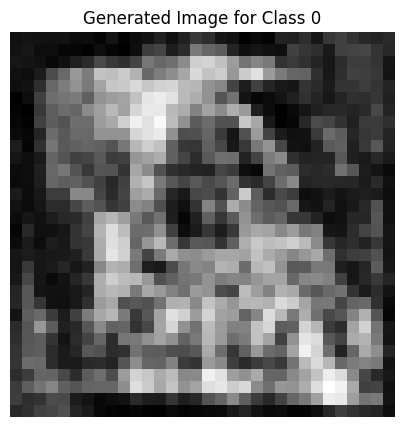

Epoch [1029/2500], D_loss: -0.0232841819524765, G_loss: -0.61212158203125


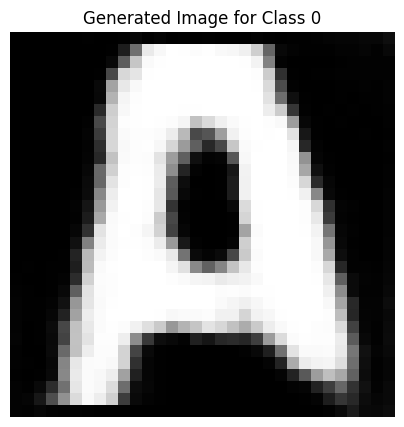

Epoch [1030/2500], D_loss: 0.019694164395332336, G_loss: -0.5783753395080566


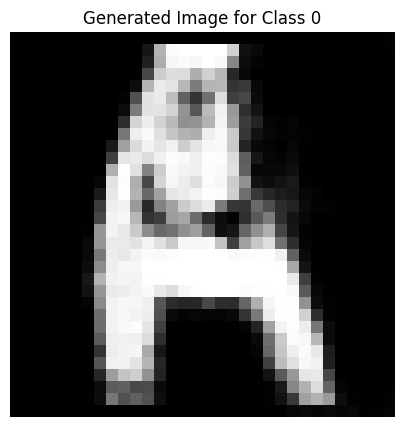

Epoch [1031/2500], D_loss: 0.01095271110534668, G_loss: -0.5929702520370483


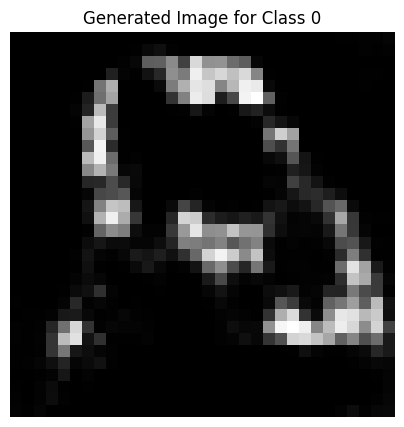

Epoch [1032/2500], D_loss: 0.007984660565853119, G_loss: -0.5383462905883789


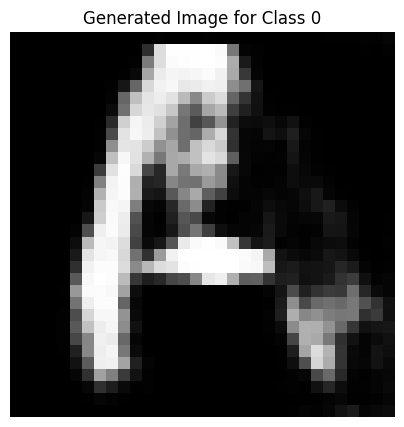

Epoch [1033/2500], D_loss: -0.024283140897750854, G_loss: -0.5354883670806885


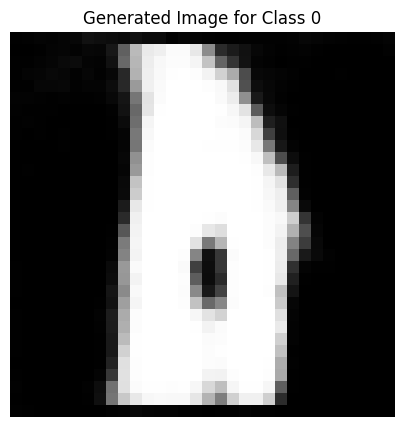

Epoch [1034/2500], D_loss: -0.0005819424986839294, G_loss: -0.5605045557022095


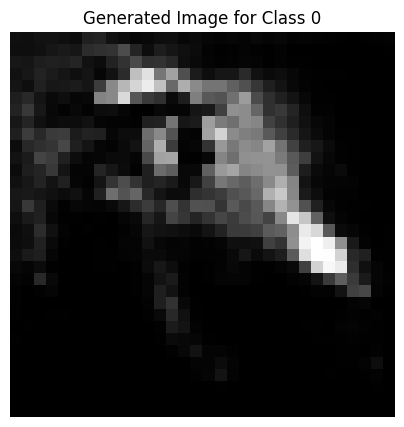

Epoch [1035/2500], D_loss: -0.01866081729531288, G_loss: -0.570168137550354


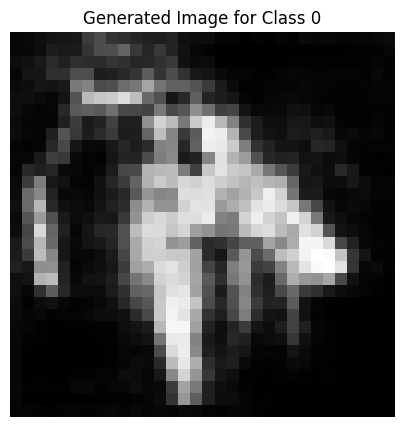

Epoch [1036/2500], D_loss: -0.001161426305770874, G_loss: -0.5341796278953552


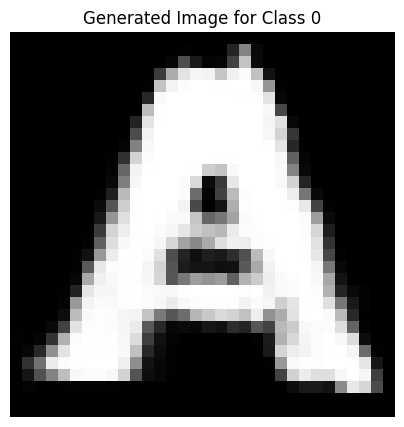

Epoch [1037/2500], D_loss: -0.021244727075099945, G_loss: -0.6494369506835938


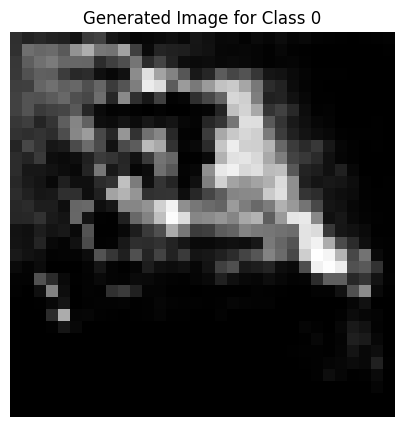

Epoch [1038/2500], D_loss: -0.012823954224586487, G_loss: -0.5745040774345398


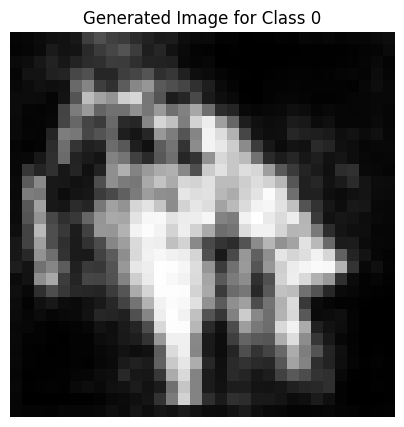

Epoch [1039/2500], D_loss: -0.043766479939222336, G_loss: -0.5403658151626587


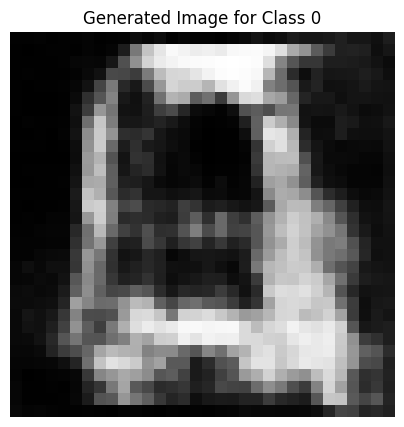

Epoch [1040/2500], D_loss: -0.005830742418766022, G_loss: -0.532200813293457


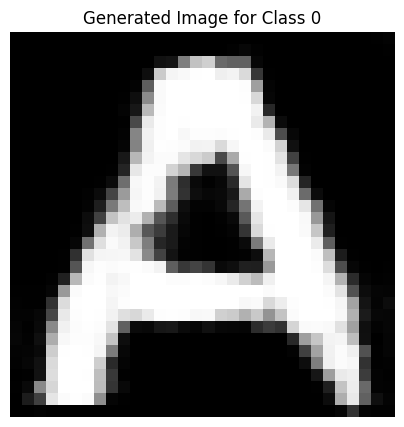

Epoch [1041/2500], D_loss: -0.0009118393063545227, G_loss: -0.5606366991996765


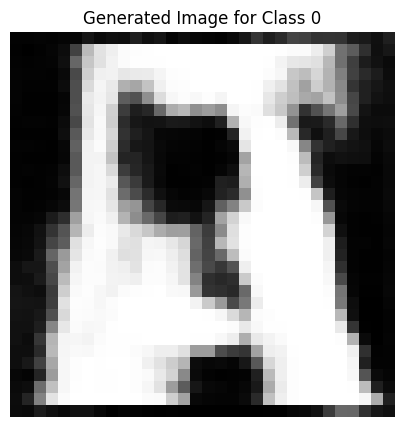

Epoch [1042/2500], D_loss: 0.0008338987827301025, G_loss: -0.5556157827377319


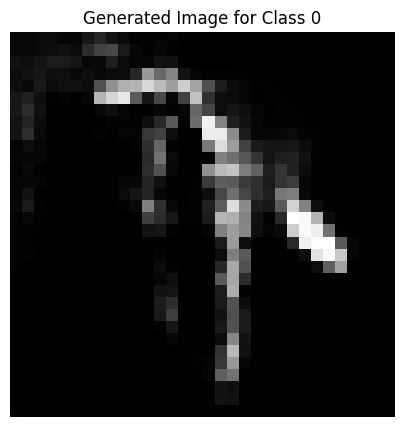

Epoch [1043/2500], D_loss: -0.005487650632858276, G_loss: -0.5992975234985352


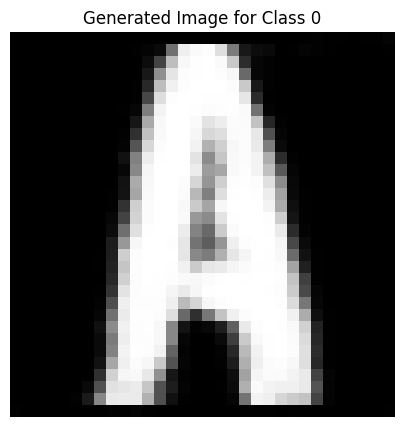

Epoch [1044/2500], D_loss: 0.01948101818561554, G_loss: -0.4878779649734497


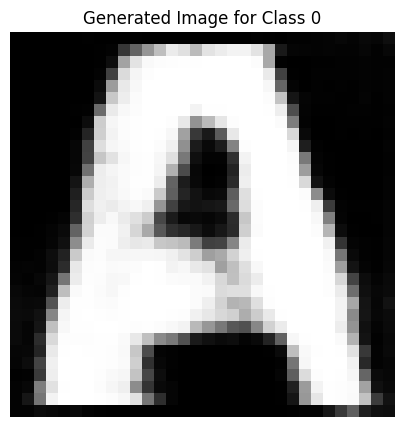

Epoch [1045/2500], D_loss: -0.004083707928657532, G_loss: -0.5513412356376648


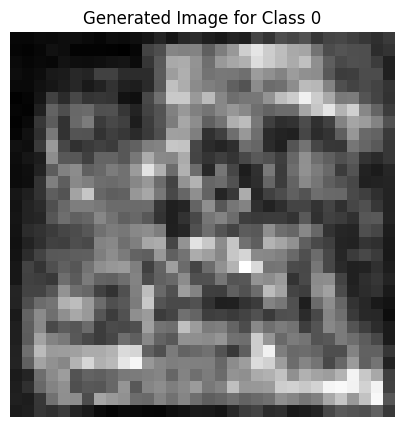

Epoch [1046/2500], D_loss: -0.016095377504825592, G_loss: -0.5720366835594177


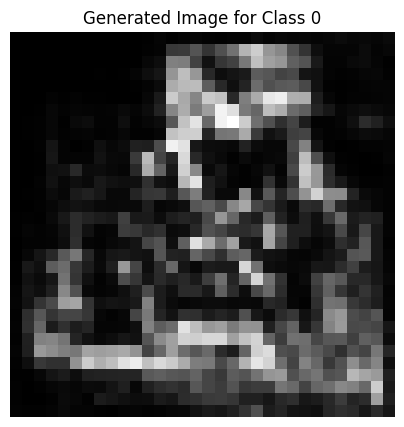

Epoch [1047/2500], D_loss: 0.07742144912481308, G_loss: -0.4092707633972168


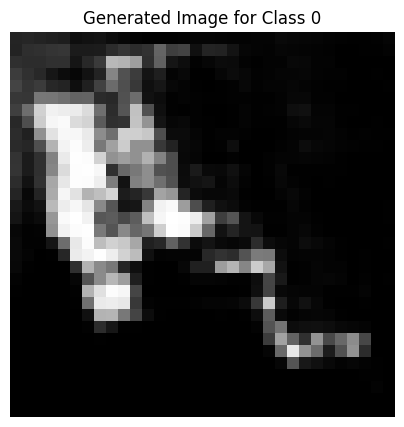

Epoch [1048/2500], D_loss: -0.010996997356414795, G_loss: -0.5820590257644653


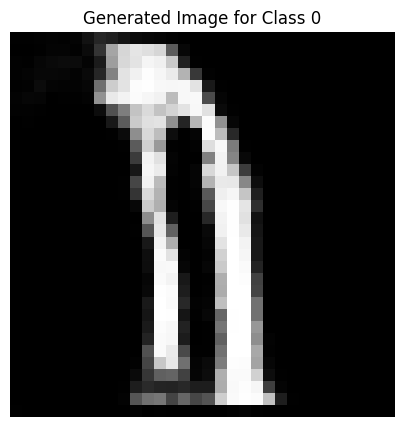

Epoch [1049/2500], D_loss: -0.0012430846691131592, G_loss: -0.5859884023666382


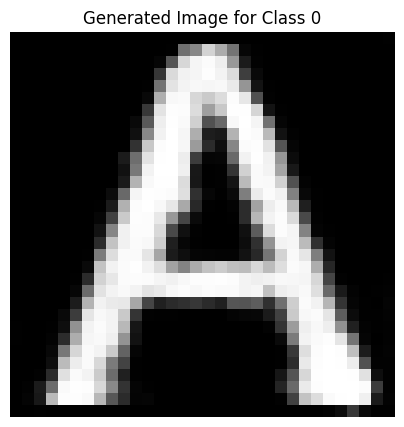

Epoch [1050/2500], D_loss: 0.14325840771198273, G_loss: -0.5930055379867554


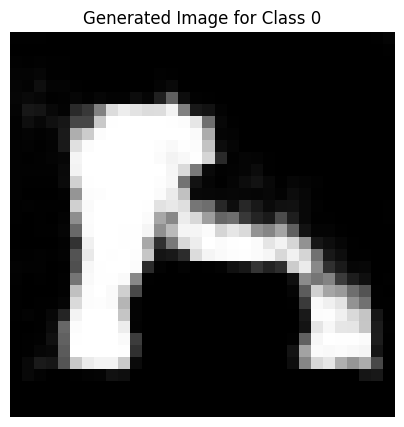

Epoch [1051/2500], D_loss: -0.002758324146270752, G_loss: -0.5787025094032288


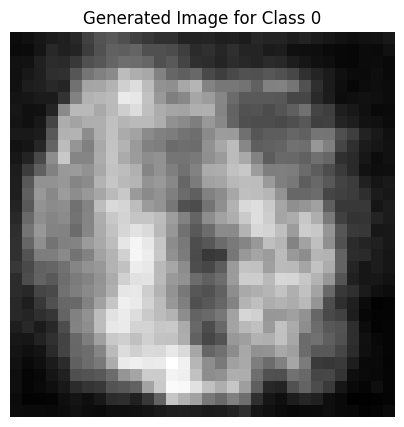

Epoch [1052/2500], D_loss: 0.015902608633041382, G_loss: -0.5289686918258667


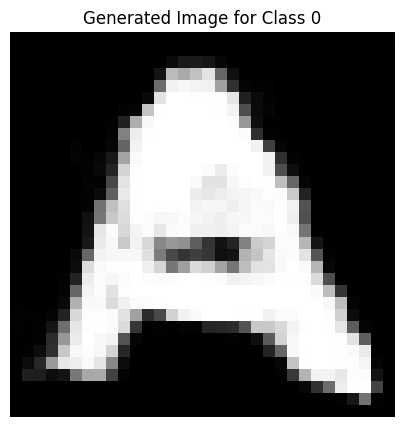

Epoch [1053/2500], D_loss: 0.021094441413879395, G_loss: -0.5776786804199219


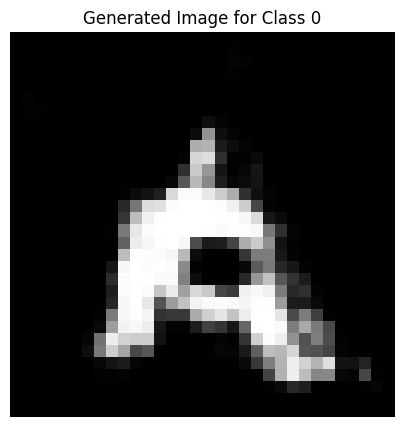

Epoch [1054/2500], D_loss: 0.04899021238088608, G_loss: -0.5953173637390137


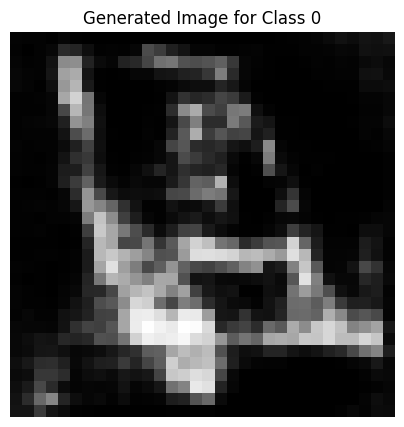

Epoch [1055/2500], D_loss: 0.03200746327638626, G_loss: -0.6042009592056274


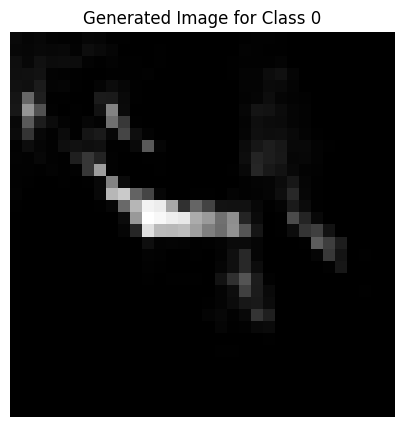

Epoch [1056/2500], D_loss: 0.05236253887414932, G_loss: -0.5841366052627563


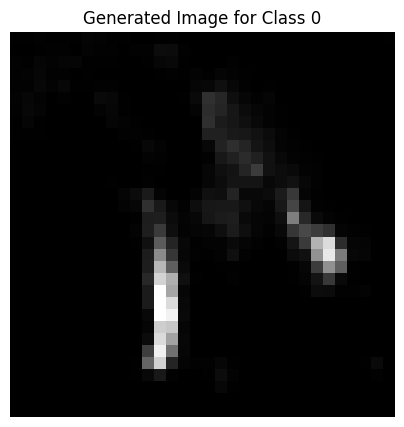

Epoch [1057/2500], D_loss: 0.04988383501768112, G_loss: -0.6242883801460266


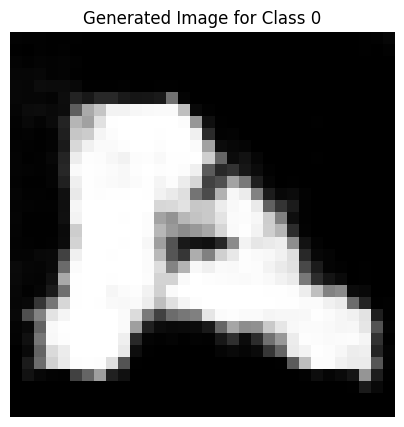

Epoch [1058/2500], D_loss: 0.028511330485343933, G_loss: -0.5444537401199341


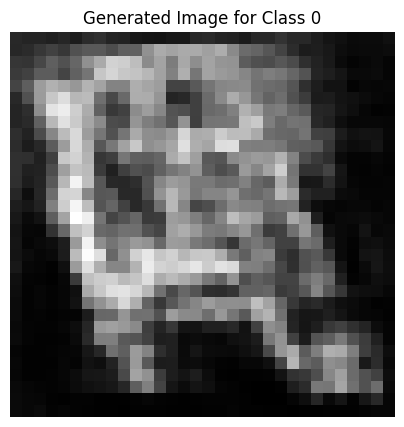

Epoch [1059/2500], D_loss: 0.016774579882621765, G_loss: -0.5247398018836975


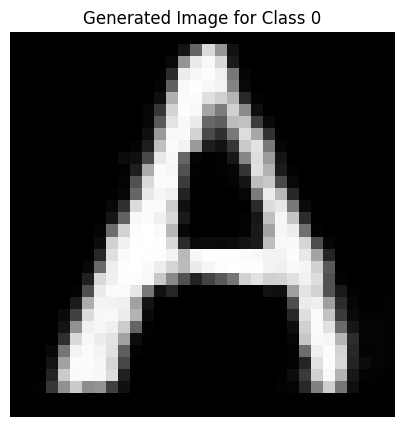

Epoch [1060/2500], D_loss: 0.022276639938354492, G_loss: -0.5372668504714966


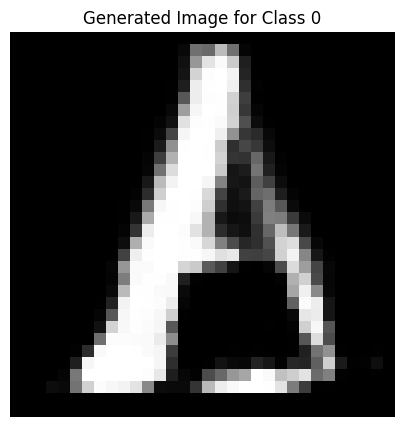

Epoch [1061/2500], D_loss: 0.011423543095588684, G_loss: -0.5169634819030762


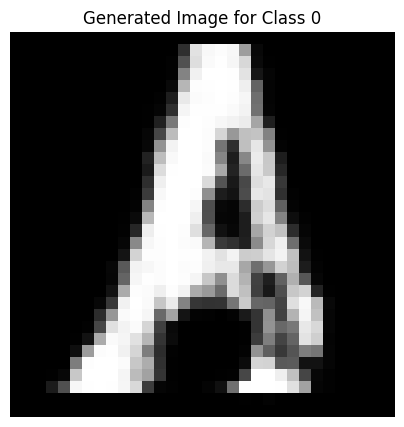

Epoch [1062/2500], D_loss: 0.05392441898584366, G_loss: -0.6503270864486694


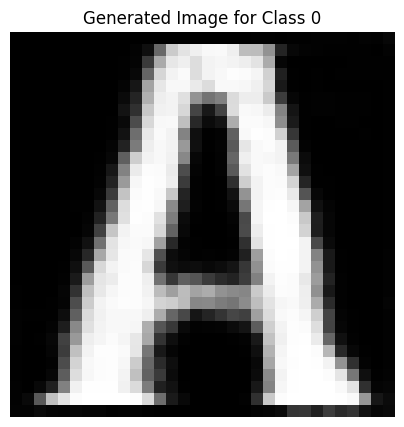

Epoch [1063/2500], D_loss: 0.024066448211669922, G_loss: -0.5846427083015442


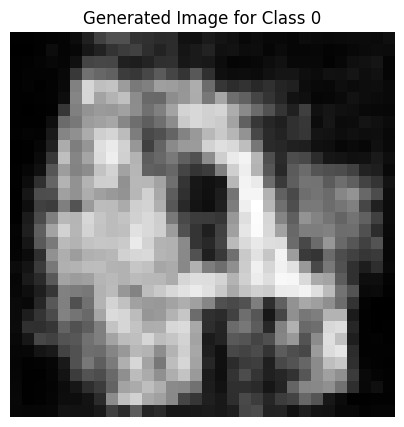

Epoch [1064/2500], D_loss: 0.019920825958251953, G_loss: -0.5910967588424683


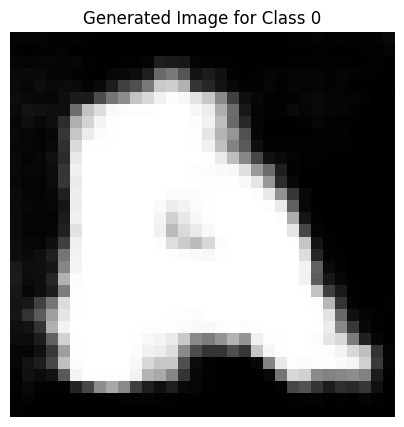

Epoch [1065/2500], D_loss: 0.009596213698387146, G_loss: -0.5997914671897888


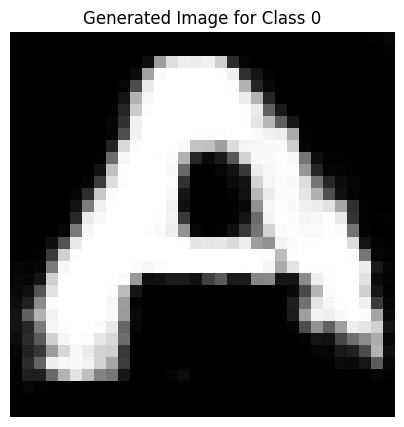

Epoch [1066/2500], D_loss: -0.004373304545879364, G_loss: -0.6056879758834839


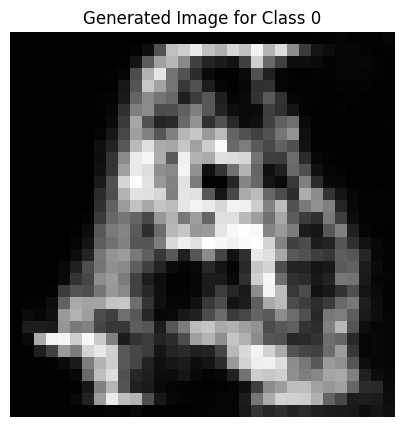

Epoch [1067/2500], D_loss: 0.0044929832220077515, G_loss: -0.5696648955345154


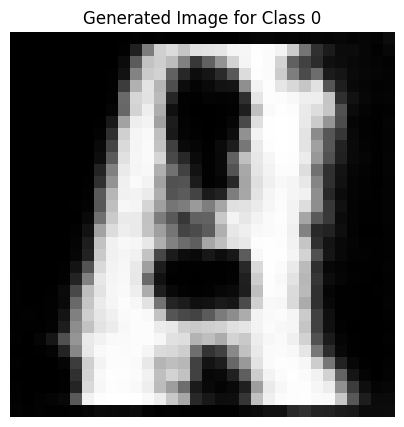

Epoch [1068/2500], D_loss: -0.021657243371009827, G_loss: -0.5806846022605896


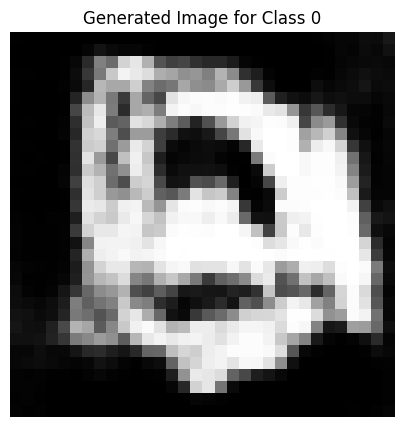

Epoch [1069/2500], D_loss: -0.004503883421421051, G_loss: -0.5422438383102417


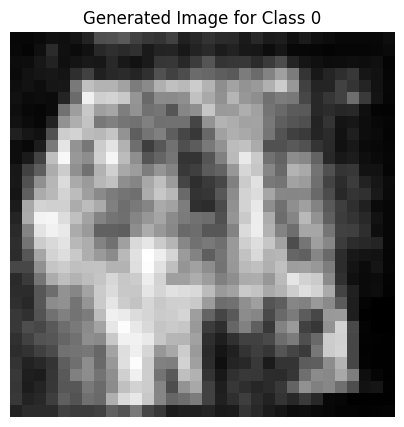

Epoch [1070/2500], D_loss: -0.013550922274589539, G_loss: -0.5628700256347656


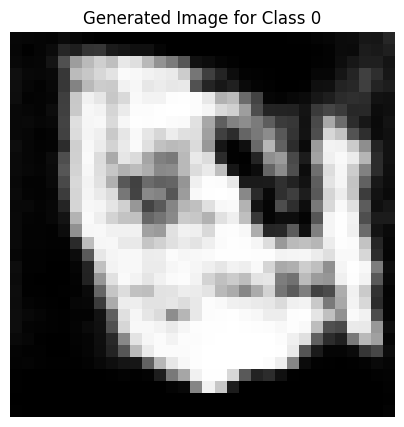

Epoch [1071/2500], D_loss: -0.02757035195827484, G_loss: -0.47040683031082153


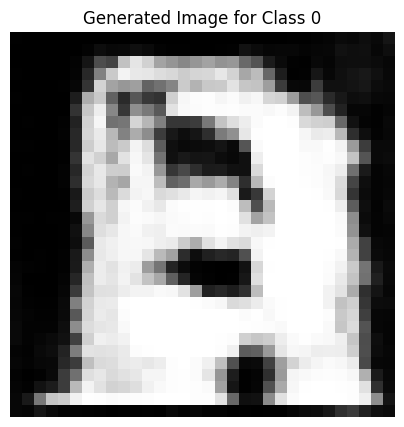

Epoch [1072/2500], D_loss: -0.016966409981250763, G_loss: -0.5234359502792358


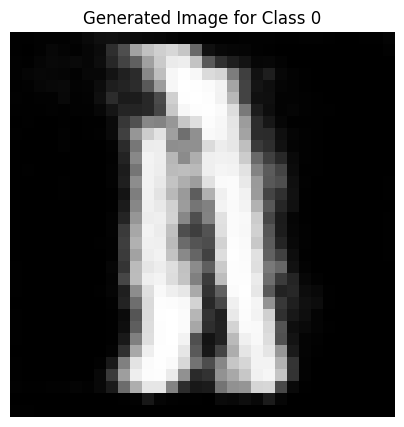

Epoch [1073/2500], D_loss: -0.009683080017566681, G_loss: -0.5134104490280151


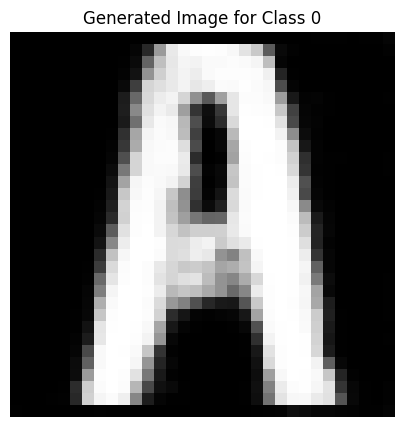

Epoch [1074/2500], D_loss: 0.007990166544914246, G_loss: -0.5646748542785645


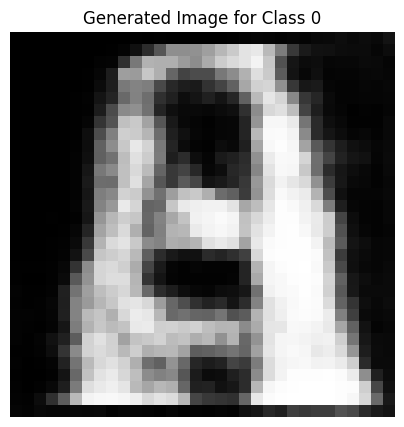

Epoch [1075/2500], D_loss: -0.01956014335155487, G_loss: -0.5541172027587891


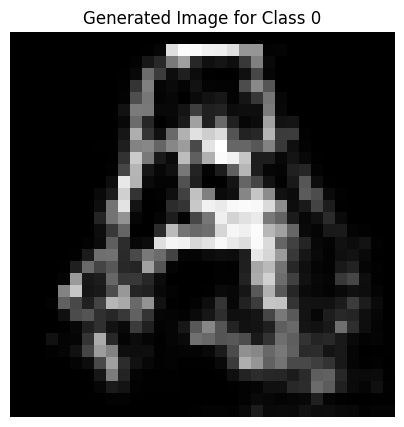

Epoch [1076/2500], D_loss: 0.010850585997104645, G_loss: -0.5504910945892334


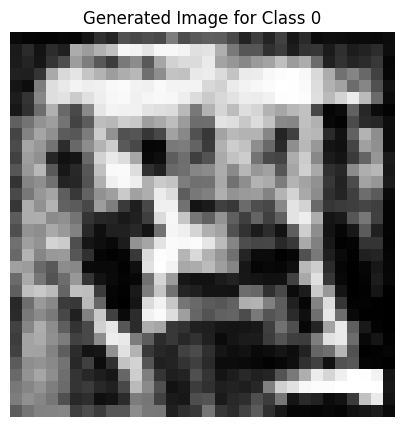

Epoch [1077/2500], D_loss: -0.017320461571216583, G_loss: -0.5408989191055298


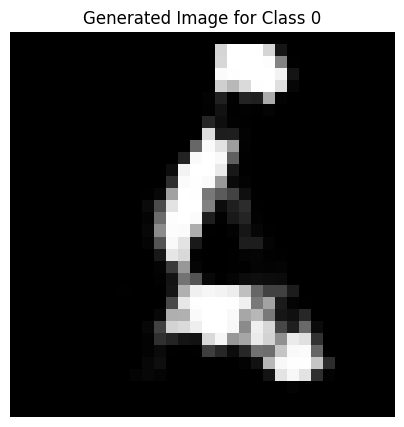

Epoch [1078/2500], D_loss: 0.17106744647026062, G_loss: -0.5171875953674316


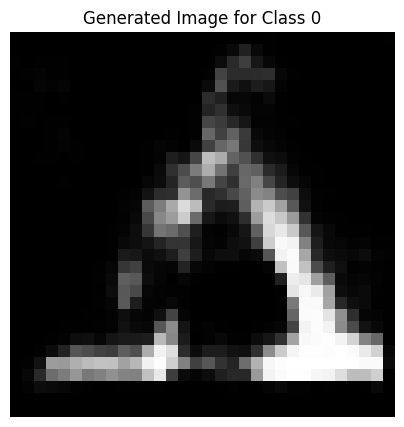

Epoch [1079/2500], D_loss: 0.016989730298519135, G_loss: -0.5817774534225464


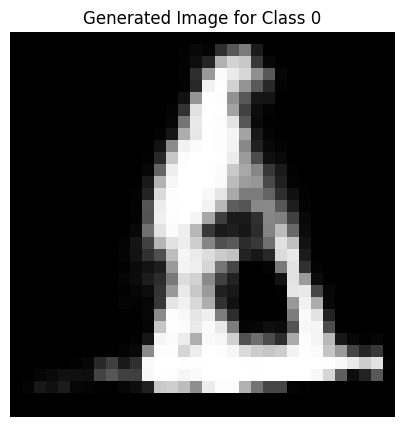

Epoch [1080/2500], D_loss: 0.009951099753379822, G_loss: -0.4410002827644348


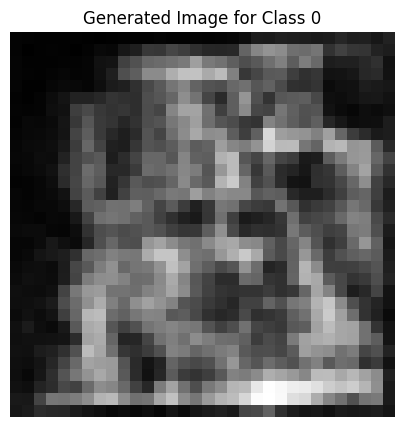

Epoch [1081/2500], D_loss: 0.025567322969436646, G_loss: -0.5934618711471558


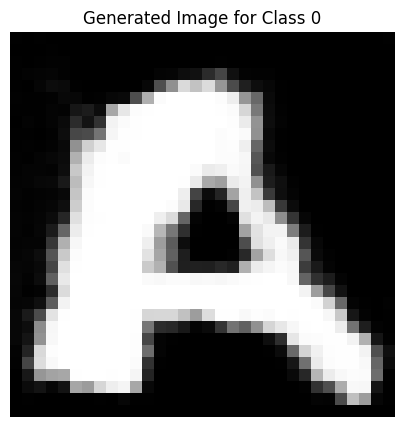

Epoch [1082/2500], D_loss: 0.013950839638710022, G_loss: -0.6141442656517029


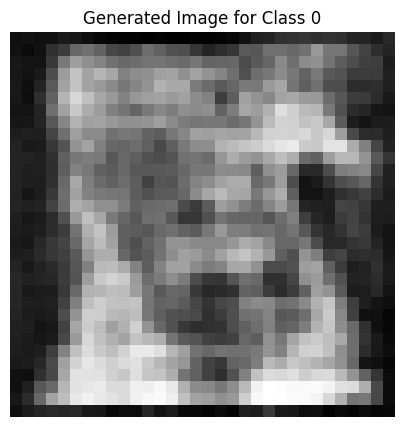

Epoch [1083/2500], D_loss: 0.04124660789966583, G_loss: -0.5934248566627502


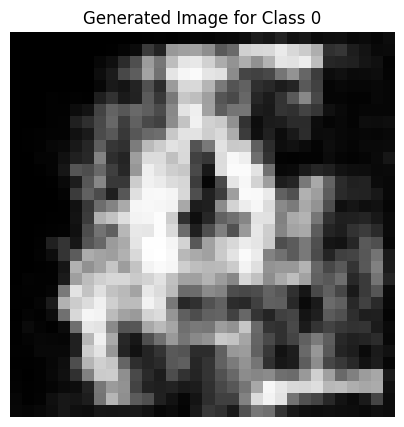

Epoch [1084/2500], D_loss: -1.7784535884857178e-05, G_loss: -0.5687205791473389


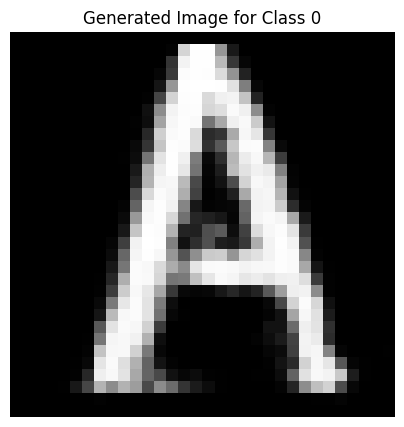

Epoch [1085/2500], D_loss: 0.03990580141544342, G_loss: -0.5759094953536987


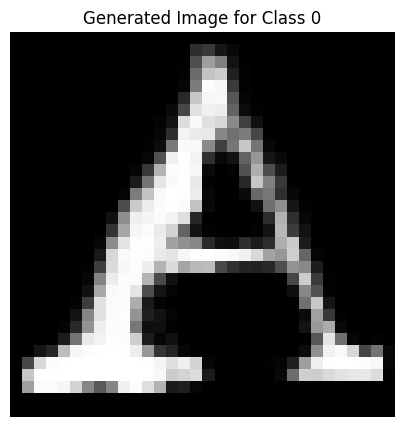

Epoch [1086/2500], D_loss: 0.0087428018450737, G_loss: -0.5663454532623291


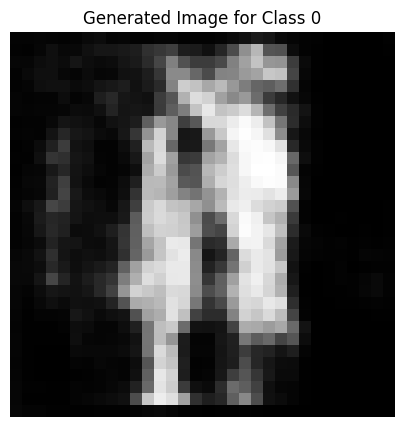

Epoch [1087/2500], D_loss: 0.03659676015377045, G_loss: -0.5998711585998535


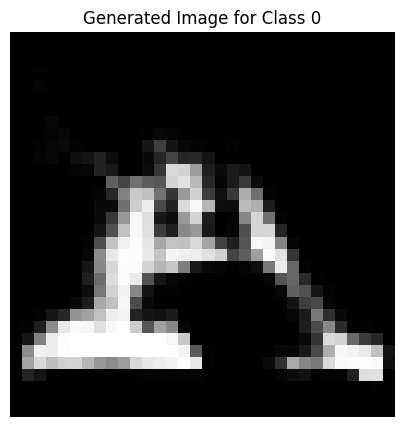

Epoch [1088/2500], D_loss: 0.007364444434642792, G_loss: -0.5809235572814941


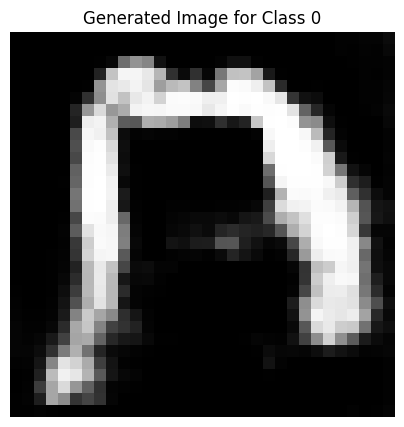

Epoch [1089/2500], D_loss: -0.009765513241291046, G_loss: -0.5850006341934204


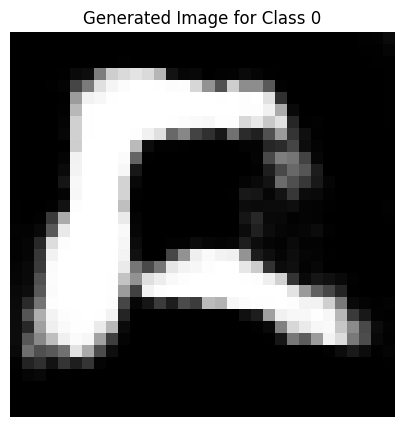

Epoch [1090/2500], D_loss: -0.007452227175235748, G_loss: -0.5911023616790771


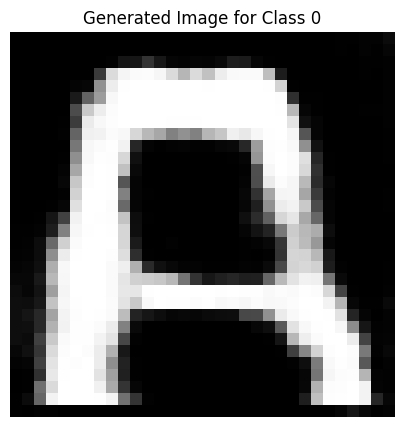

Epoch [1091/2500], D_loss: -0.00222817063331604, G_loss: -0.5475319623947144


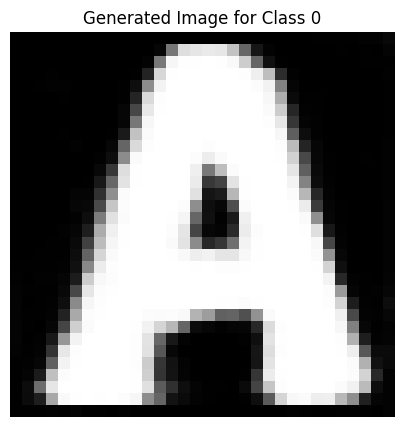

Epoch [1092/2500], D_loss: -0.006050311028957367, G_loss: -0.5472760200500488


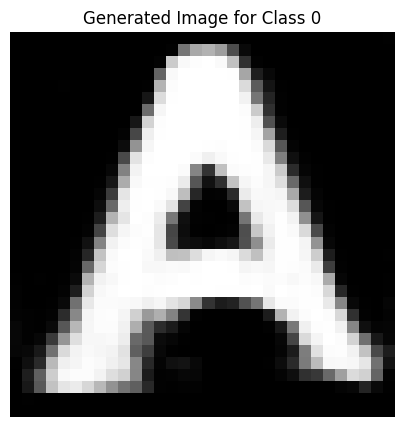

Epoch [1093/2500], D_loss: -0.018042191863059998, G_loss: -0.5617077350616455


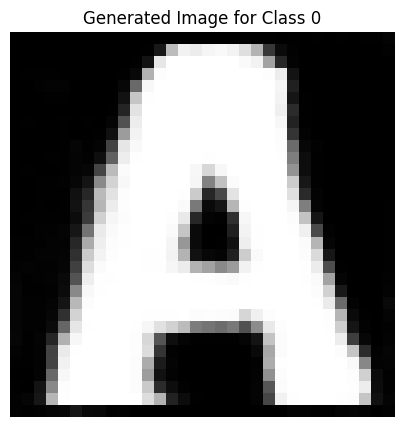

Epoch [1094/2500], D_loss: -0.005063854157924652, G_loss: -0.48973551392555237


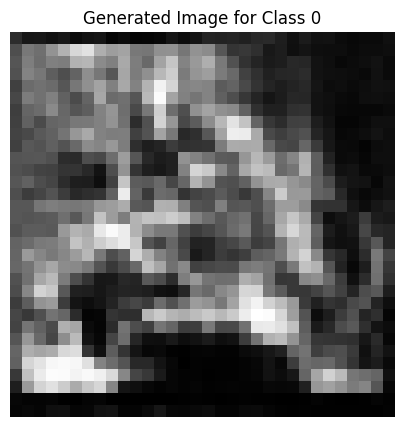

Epoch [1095/2500], D_loss: -0.009514346718788147, G_loss: -0.5597328543663025


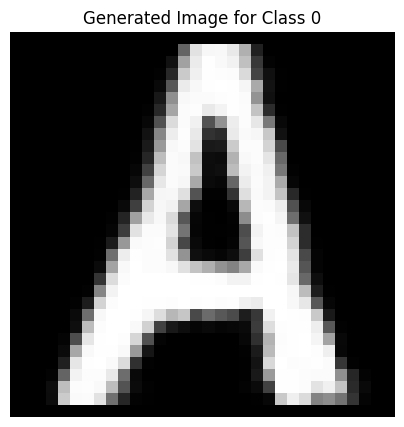

Epoch [1096/2500], D_loss: -0.006022125482559204, G_loss: -0.5396020412445068


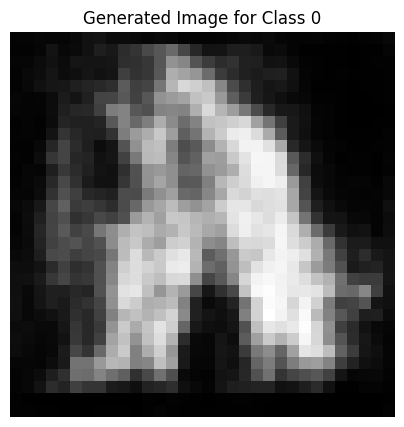

Epoch [1097/2500], D_loss: -0.015692412853240967, G_loss: -0.5533550977706909


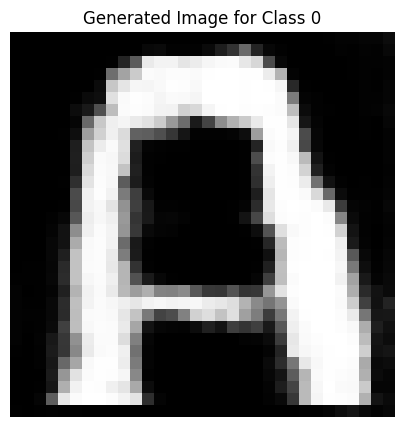

Epoch [1098/2500], D_loss: 0.006498262286186218, G_loss: -0.5532183647155762


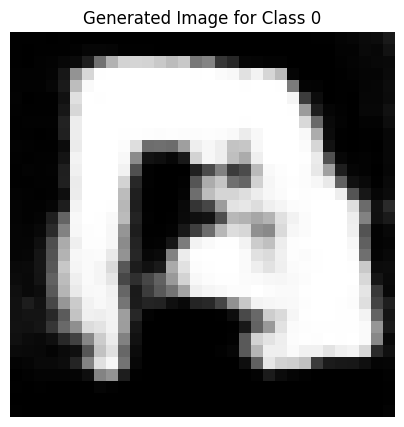

Epoch [1099/2500], D_loss: -0.0128868967294693, G_loss: -0.5362688899040222


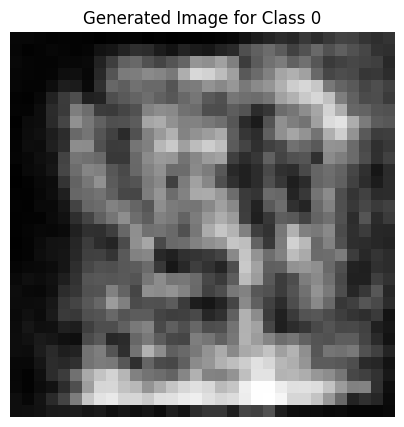

Epoch [1100/2500], D_loss: -0.016192734241485596, G_loss: -0.5730323791503906


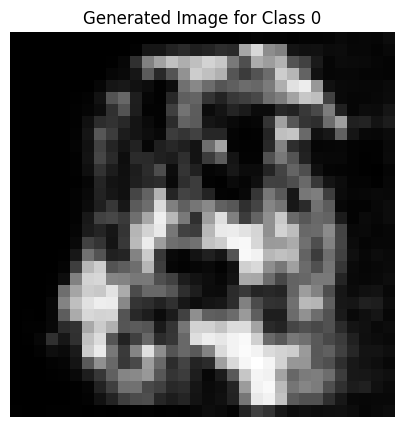

Epoch [1101/2500], D_loss: -0.023271024227142334, G_loss: -0.6137748956680298


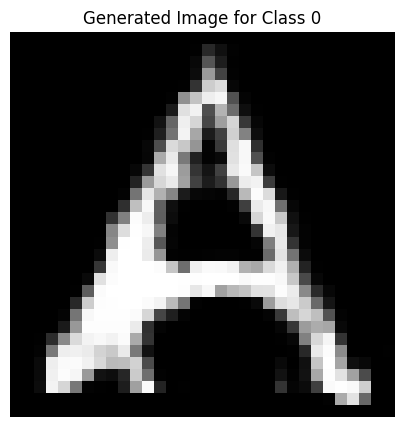

Epoch [1102/2500], D_loss: -0.026349101215600967, G_loss: -0.553534746170044


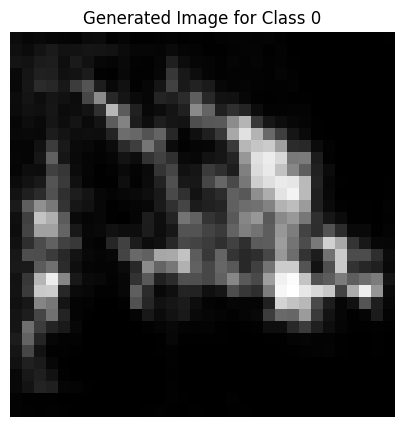

Epoch [1103/2500], D_loss: -0.0032501891255378723, G_loss: -0.5111550092697144


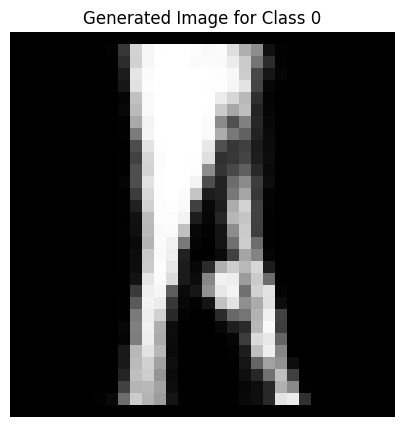

Epoch [1104/2500], D_loss: -0.00847800076007843, G_loss: -0.6265395283699036


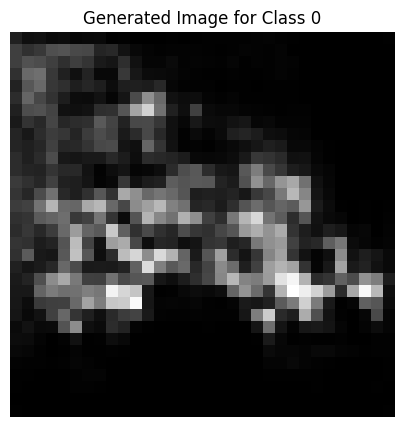

Epoch [1105/2500], D_loss: -0.014400392770767212, G_loss: -0.5672420859336853


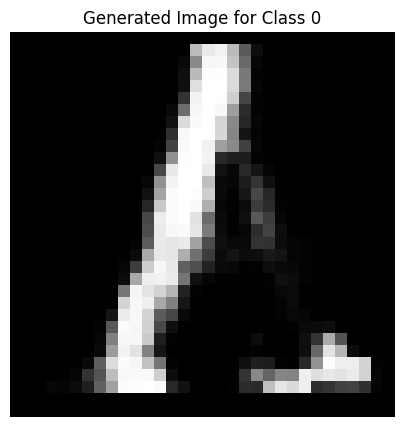

Epoch [1106/2500], D_loss: -0.02509491890668869, G_loss: -0.6042866706848145


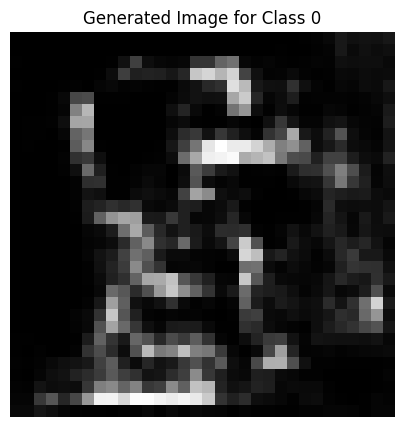

Epoch [1107/2500], D_loss: -0.0006722062826156616, G_loss: -0.6512451171875


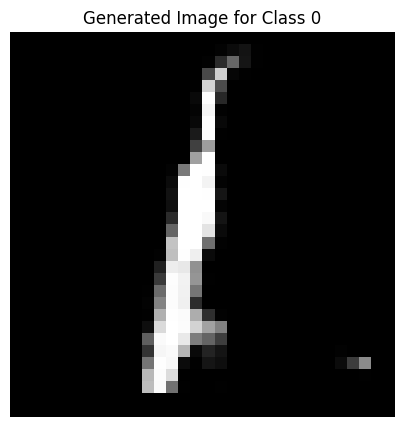

Epoch [1108/2500], D_loss: -0.028175808489322662, G_loss: -0.5806993246078491


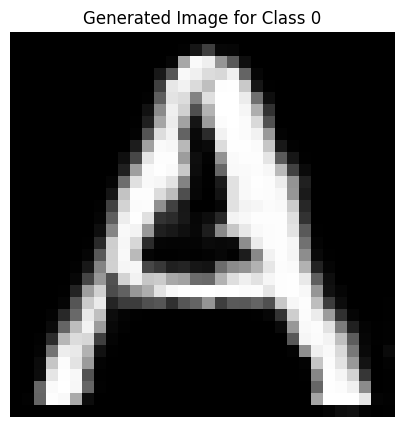

Epoch [1109/2500], D_loss: 0.025860600173473358, G_loss: -0.5216920971870422


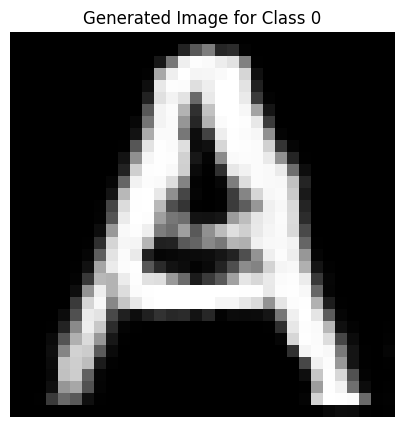

Epoch [1110/2500], D_loss: -0.0140790194272995, G_loss: -0.5906937122344971


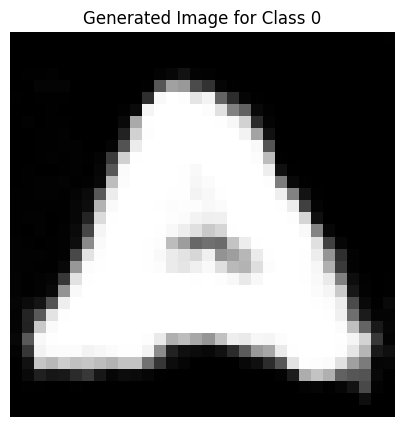

Epoch [1111/2500], D_loss: -0.01998467743396759, G_loss: -0.5142112970352173


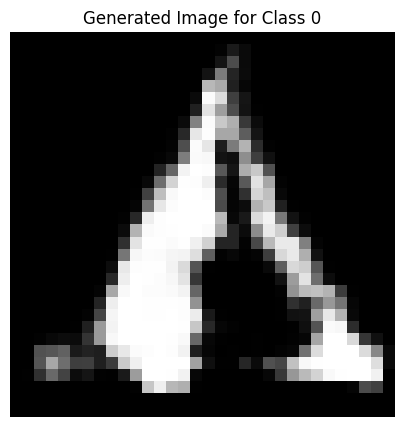

Epoch [1112/2500], D_loss: -0.008772037923336029, G_loss: -0.4552481472492218


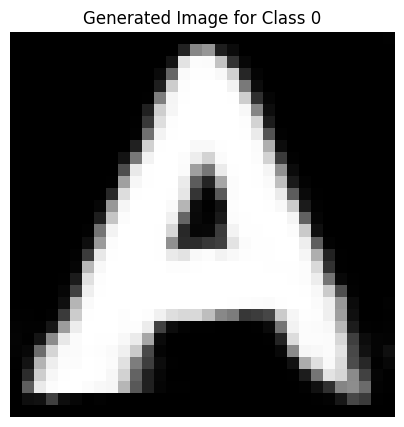

Epoch [1113/2500], D_loss: -0.029129594564437866, G_loss: -0.640520453453064


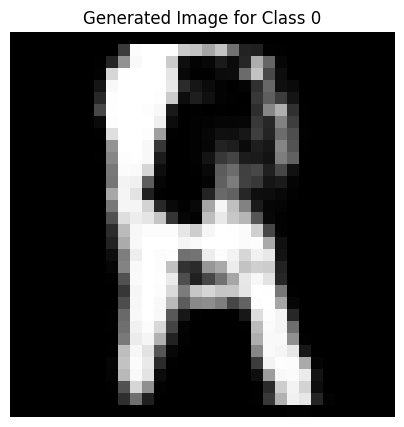

Epoch [1114/2500], D_loss: 0.018792584538459778, G_loss: -0.5582267642021179


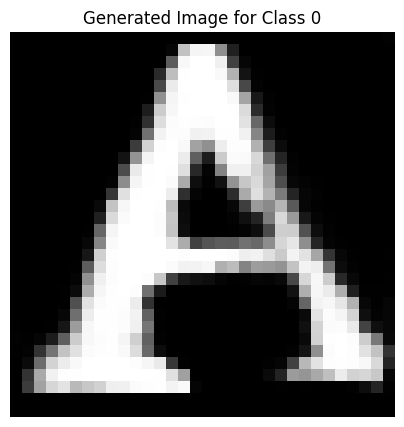

Epoch [1115/2500], D_loss: -0.01529160887002945, G_loss: -0.5670763254165649


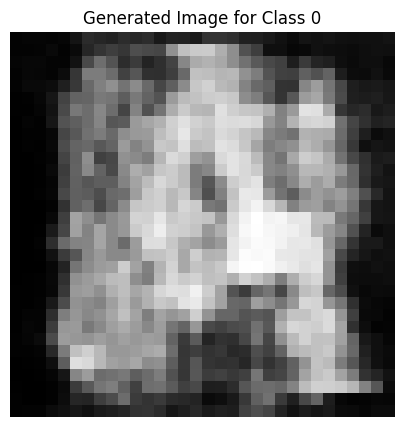

Epoch [1116/2500], D_loss: -0.00942133367061615, G_loss: -0.4997183680534363


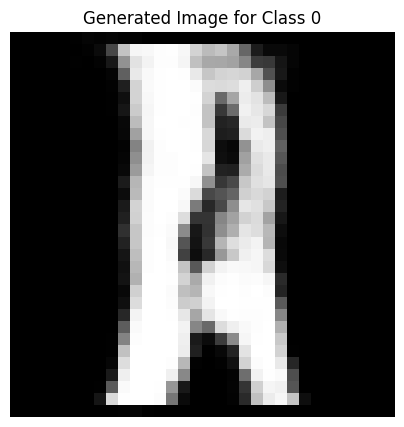

Epoch [1117/2500], D_loss: -0.006958365440368652, G_loss: -0.5693811178207397


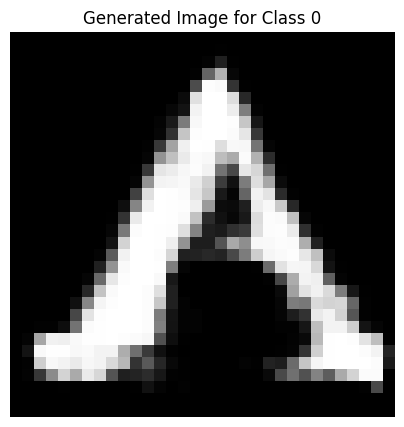

Epoch [1118/2500], D_loss: 0.0007825493812561035, G_loss: -0.5709253549575806


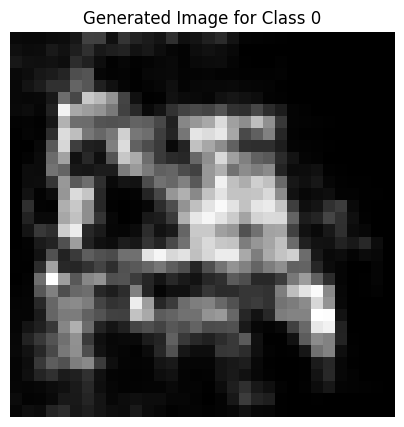

Epoch [1119/2500], D_loss: -0.017356134951114655, G_loss: -0.5678185820579529


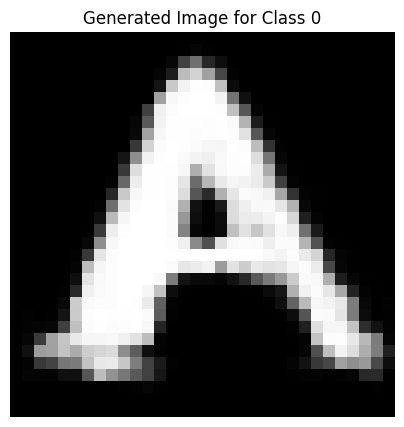

Epoch [1120/2500], D_loss: 0.008511431515216827, G_loss: -0.5809003710746765


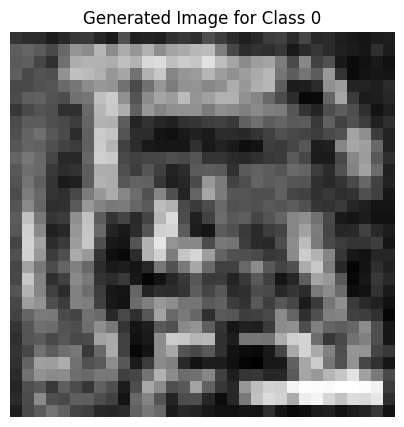

Epoch [1121/2500], D_loss: 0.01896839588880539, G_loss: -0.6134710311889648


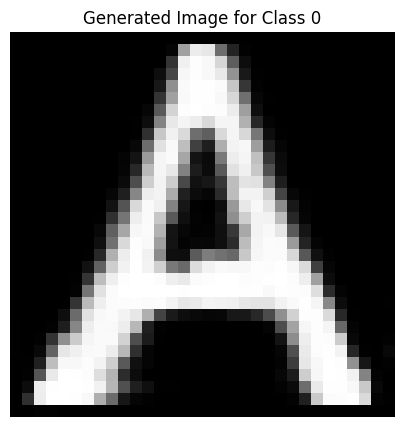

Epoch [1122/2500], D_loss: -0.00920175015926361, G_loss: -0.6035205721855164


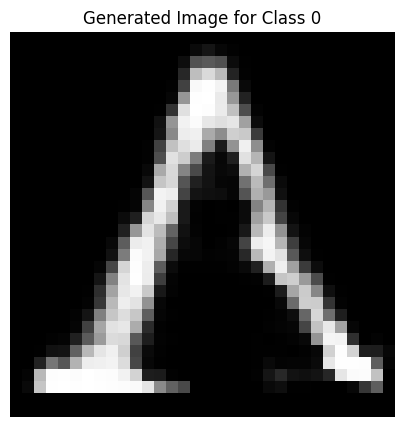

Epoch [1123/2500], D_loss: -0.009028360247612, G_loss: -0.5396677255630493


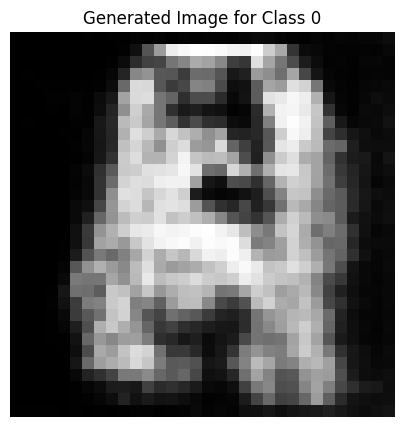

Epoch [1124/2500], D_loss: -0.0002900660037994385, G_loss: -0.5724479556083679


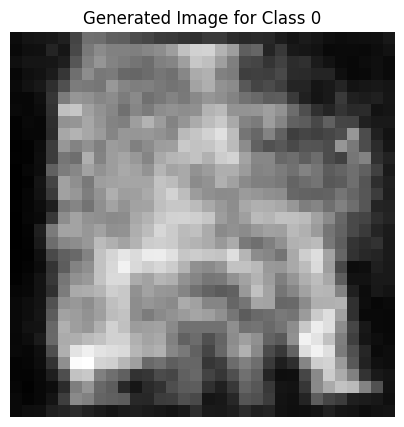

Epoch [1125/2500], D_loss: 0.014865249395370483, G_loss: -0.5708051919937134


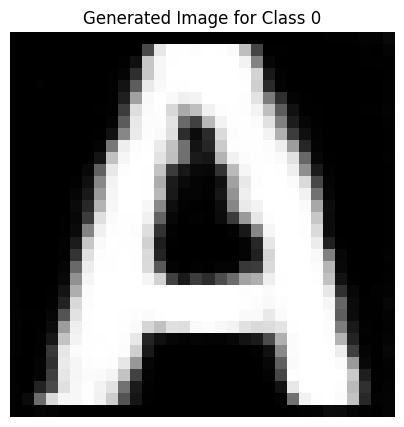

Epoch [1126/2500], D_loss: 0.0012448206543922424, G_loss: -0.5457059144973755


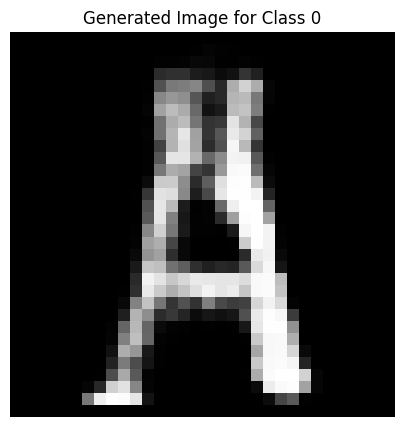

Epoch [1127/2500], D_loss: 0.002153061330318451, G_loss: -0.6374434232711792


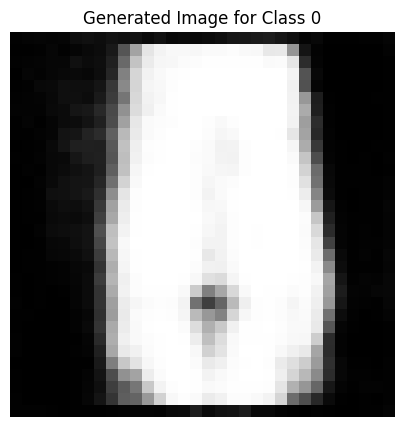

Epoch [1128/2500], D_loss: -0.015813417732715607, G_loss: -0.6022436618804932


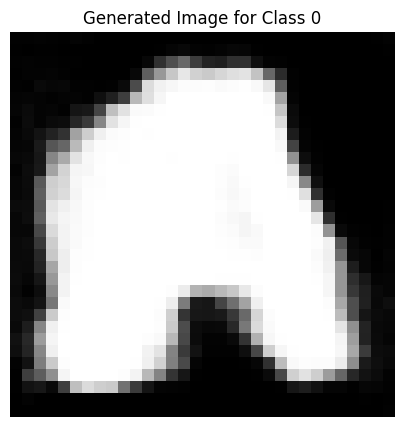

Epoch [1129/2500], D_loss: -0.018455591052770615, G_loss: -0.6304872035980225


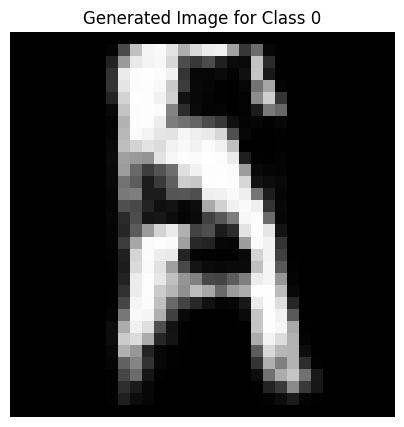

Epoch [1130/2500], D_loss: -0.001554638147354126, G_loss: -0.36249545216560364


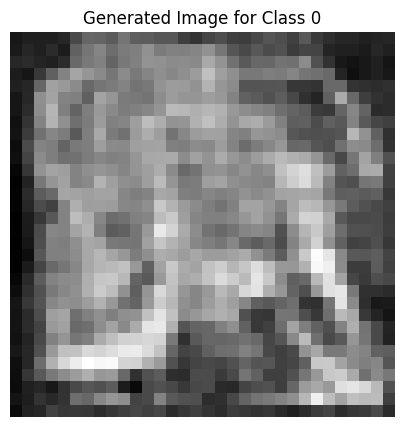

Epoch [1131/2500], D_loss: -0.017893627285957336, G_loss: -0.6195758581161499


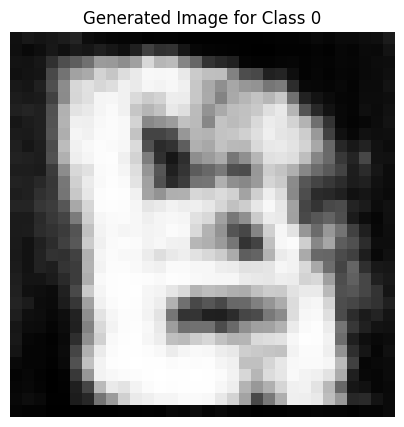

Epoch [1132/2500], D_loss: -0.021978408098220825, G_loss: -0.4981713593006134


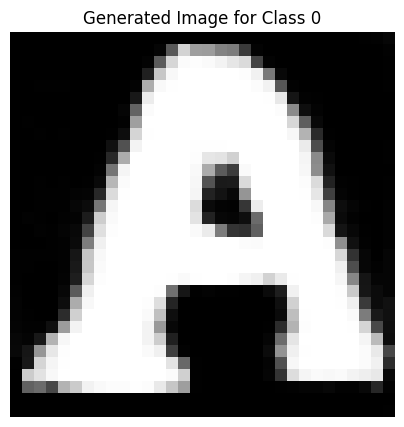

Epoch [1133/2500], D_loss: -0.0008673593401908875, G_loss: -0.44564104080200195


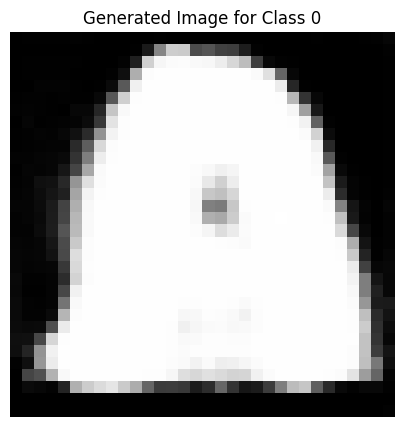

Epoch [1134/2500], D_loss: 0.014783307909965515, G_loss: -0.548637866973877


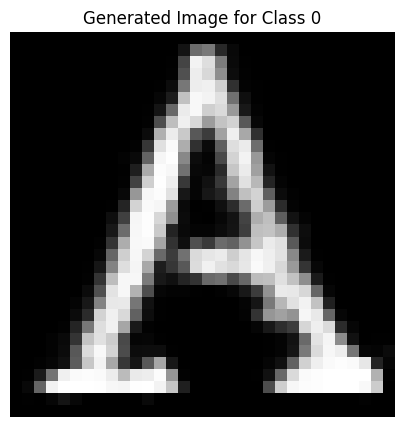

Epoch [1135/2500], D_loss: -0.014768034219741821, G_loss: -0.6172888278961182


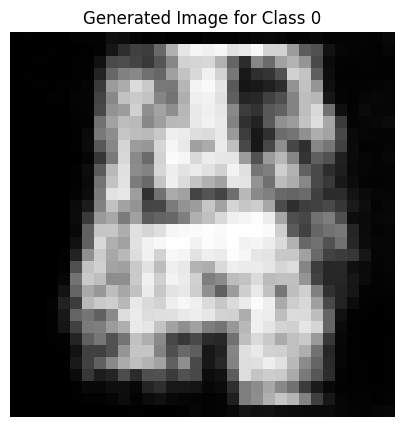

Epoch [1136/2500], D_loss: 0.016739383339881897, G_loss: -0.6260315179824829


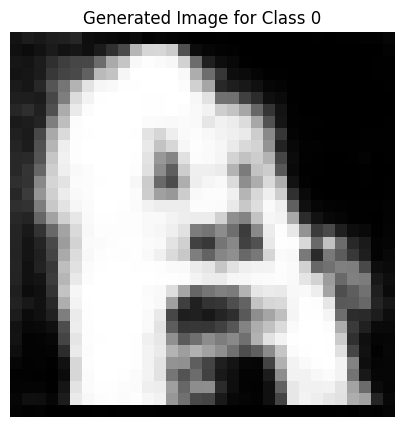

Epoch [1137/2500], D_loss: 0.01185094565153122, G_loss: -0.6863727569580078


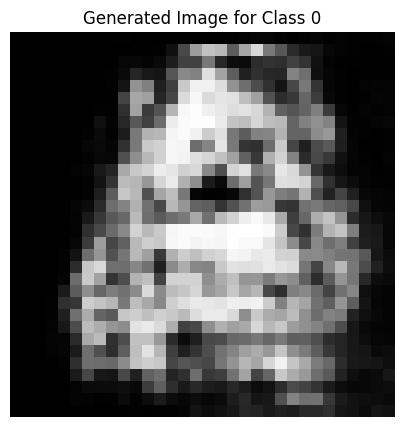

Epoch [1138/2500], D_loss: 0.022472791373729706, G_loss: -0.5708022117614746


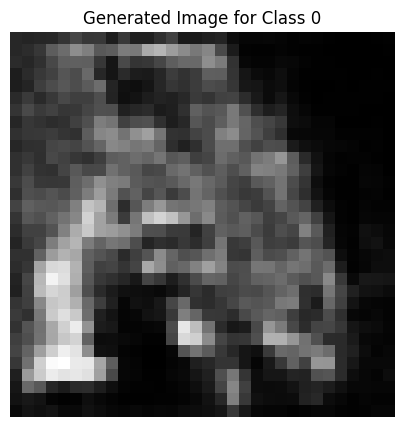

Epoch [1139/2500], D_loss: -0.013608396053314209, G_loss: -0.5582656860351562


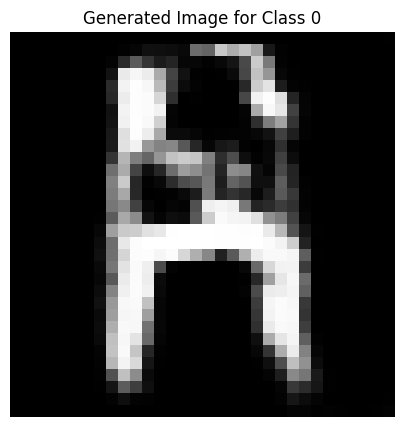

Epoch [1140/2500], D_loss: 0.0005240142345428467, G_loss: -0.599665641784668


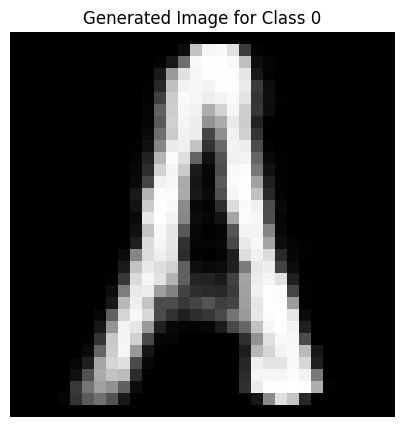

Epoch [1141/2500], D_loss: 0.0038612186908721924, G_loss: -0.5745857357978821


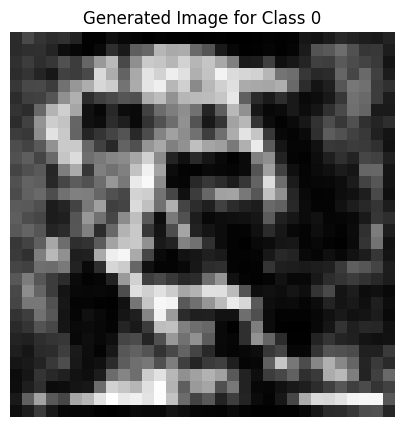

Epoch [1142/2500], D_loss: 0.008228972554206848, G_loss: -0.5828074216842651


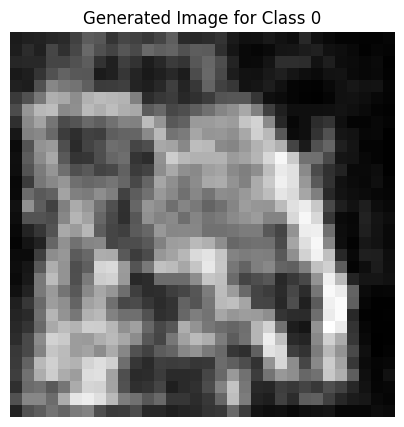

Epoch [1143/2500], D_loss: -0.01177717000246048, G_loss: -0.565674901008606


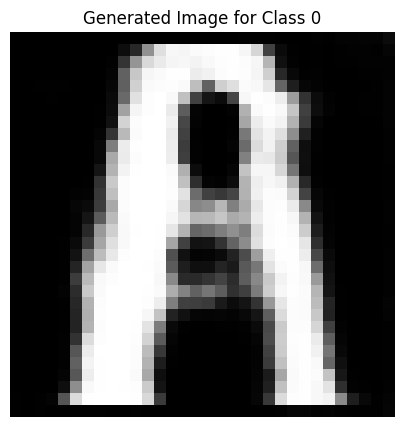

Epoch [1144/2500], D_loss: -0.0219135545194149, G_loss: -0.5515047311782837


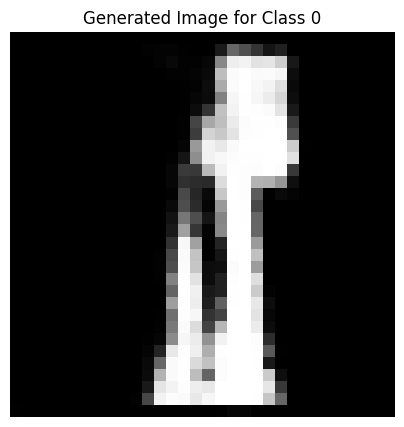

Epoch [1145/2500], D_loss: -0.007259294390678406, G_loss: -0.46937572956085205


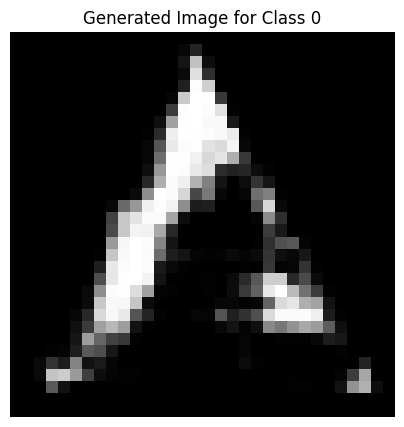

Epoch [1146/2500], D_loss: -0.02501428872346878, G_loss: -0.6070961952209473


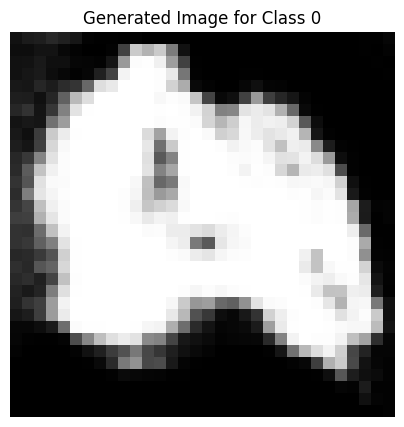

Epoch [1147/2500], D_loss: -0.021870985627174377, G_loss: -0.5508130788803101


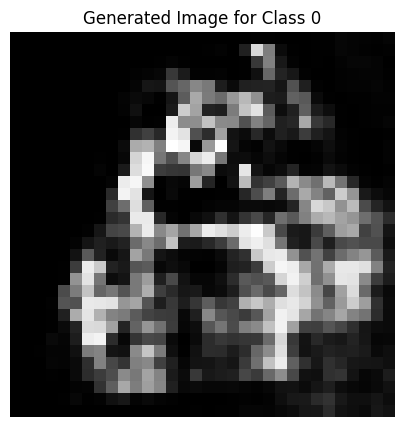

Epoch [1148/2500], D_loss: -0.023173950612545013, G_loss: -0.549036979675293


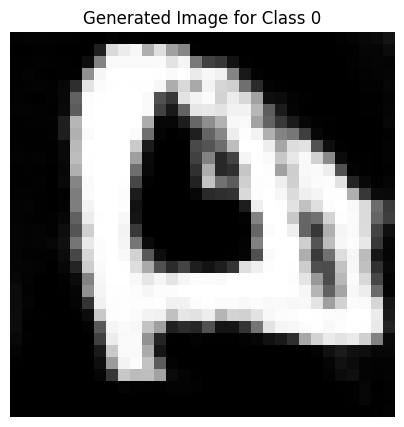

Epoch [1149/2500], D_loss: -0.031024761497974396, G_loss: -0.593242883682251


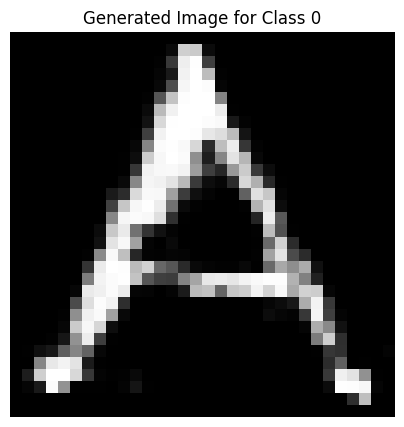

Epoch [1150/2500], D_loss: -0.0347871333360672, G_loss: -0.5831706523895264


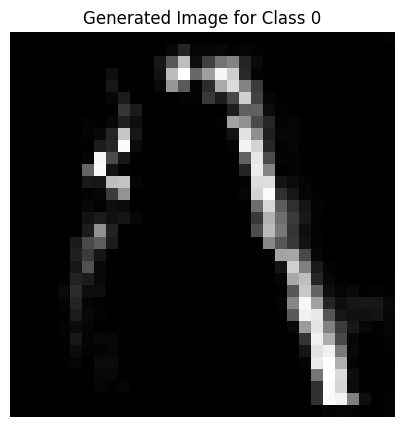

Epoch [1151/2500], D_loss: -0.006650418043136597, G_loss: -0.7170819044113159


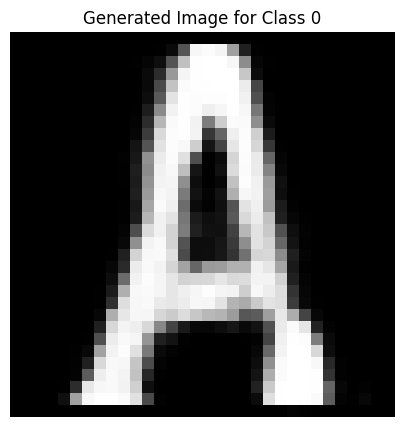

Epoch [1152/2500], D_loss: -0.015047505497932434, G_loss: -0.592587947845459


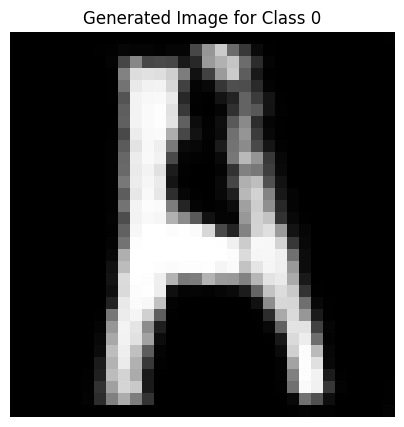

Epoch [1153/2500], D_loss: -0.0025062784552574158, G_loss: -0.6762487888336182


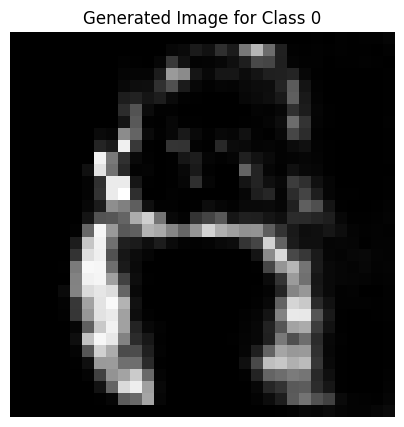

Epoch [1154/2500], D_loss: -0.03063533827662468, G_loss: -0.5399218201637268


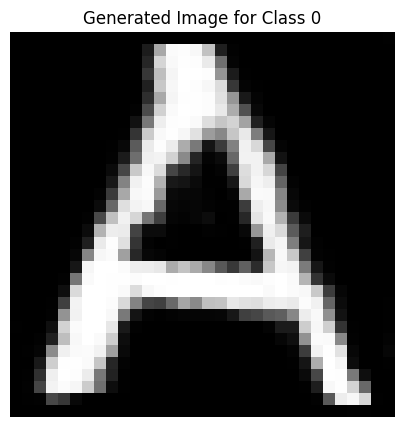

Epoch [1155/2500], D_loss: -0.03711038827896118, G_loss: -0.5790802836418152


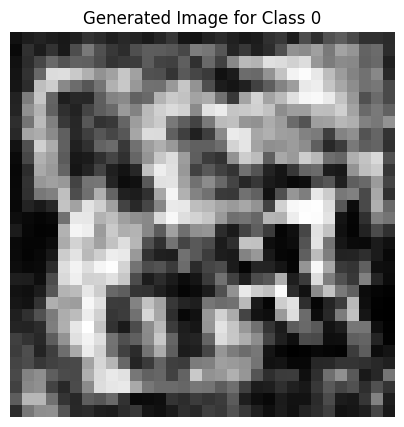

Epoch [1156/2500], D_loss: -0.005629256367683411, G_loss: -0.6382662057876587


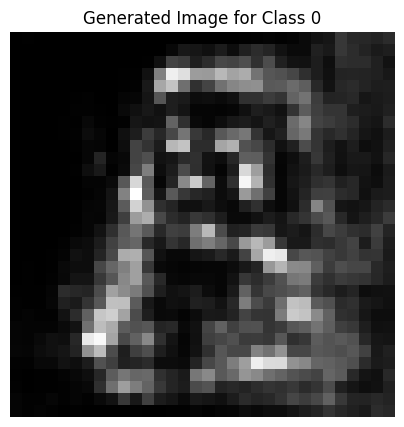

Epoch [1157/2500], D_loss: 0.23913627862930298, G_loss: -0.5931607484817505


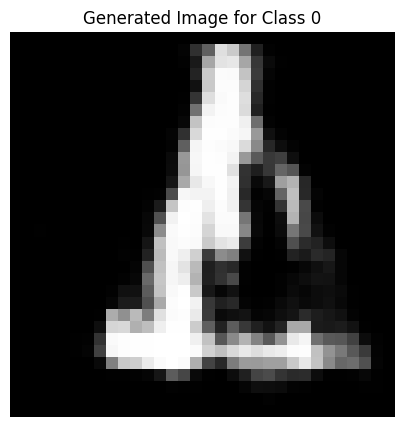

Epoch [1158/2500], D_loss: -0.026677191257476807, G_loss: -0.5345888137817383


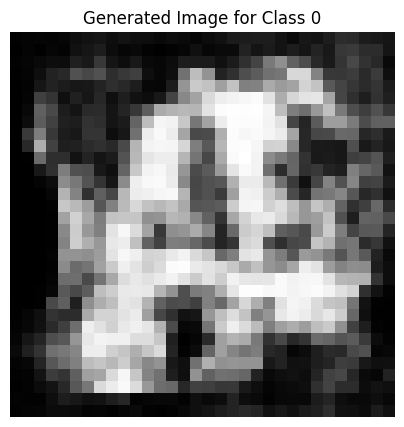

Epoch [1159/2500], D_loss: -0.022286638617515564, G_loss: -0.5602009296417236


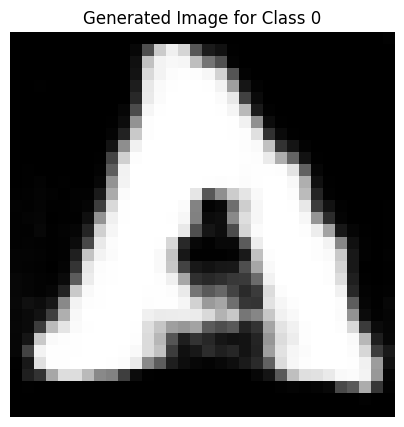

Epoch [1160/2500], D_loss: -0.03331772983074188, G_loss: -0.555770993232727


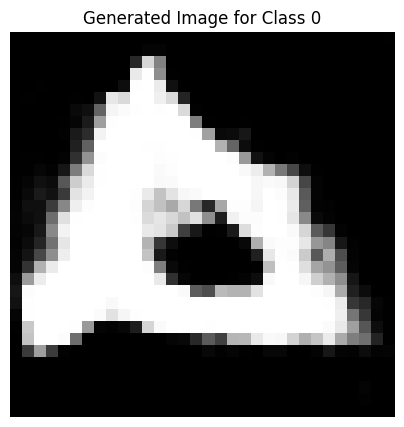

Epoch [1161/2500], D_loss: 0.01921587437391281, G_loss: -0.4120568335056305


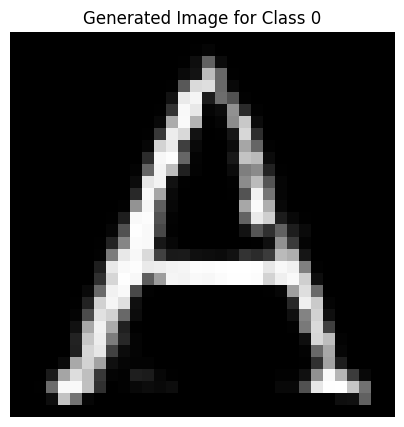

Epoch [1162/2500], D_loss: -0.040215201675891876, G_loss: -0.5391765236854553


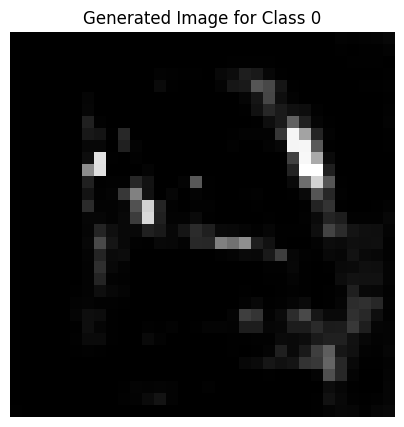

Epoch [1163/2500], D_loss: -0.025531969964504242, G_loss: -0.5674000382423401


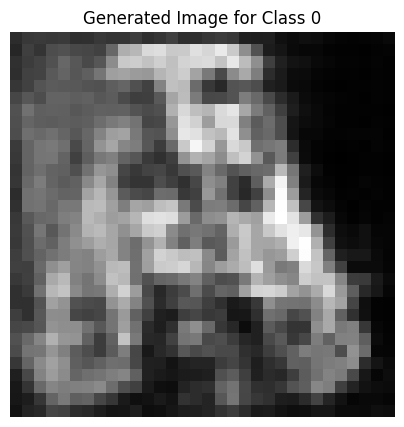

Epoch [1164/2500], D_loss: -0.005178593099117279, G_loss: -0.4894193410873413


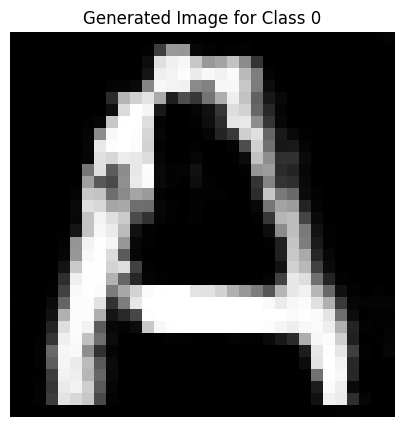

Epoch [1165/2500], D_loss: -0.03538452833890915, G_loss: -0.519323468208313


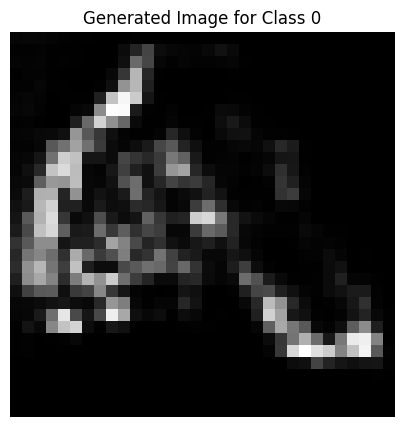

Epoch [1166/2500], D_loss: -0.02548529952764511, G_loss: -0.5261576771736145


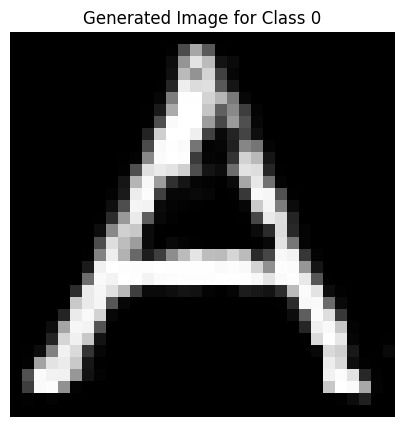

Epoch [1167/2500], D_loss: 0.033980123698711395, G_loss: -0.5729960203170776


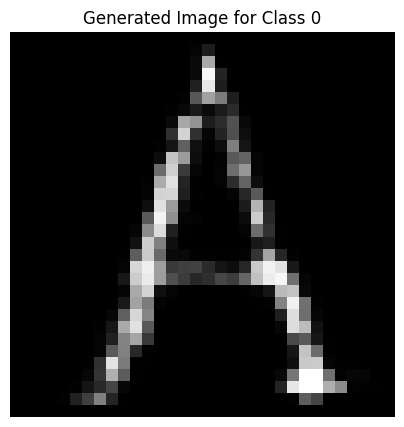

Epoch [1168/2500], D_loss: 0.010360628366470337, G_loss: -0.5388917922973633


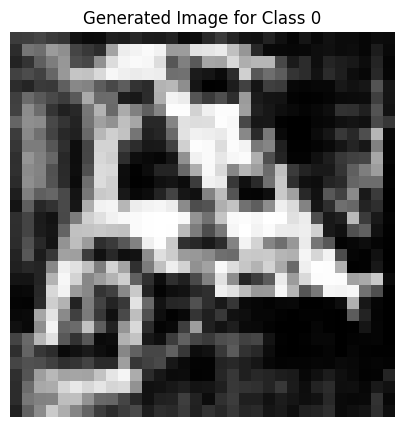

Epoch [1169/2500], D_loss: -0.032380297780036926, G_loss: -0.5589221715927124


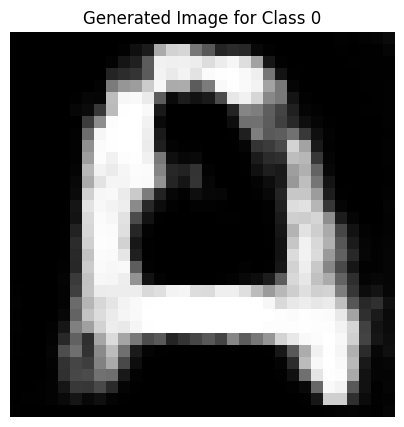

Epoch [1170/2500], D_loss: -0.049177564680576324, G_loss: -0.496783584356308


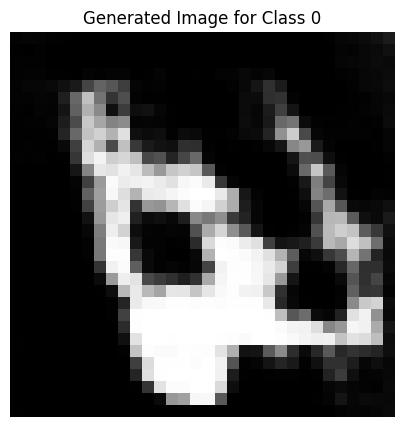

Epoch [1171/2500], D_loss: -0.019255749881267548, G_loss: -0.5461575984954834


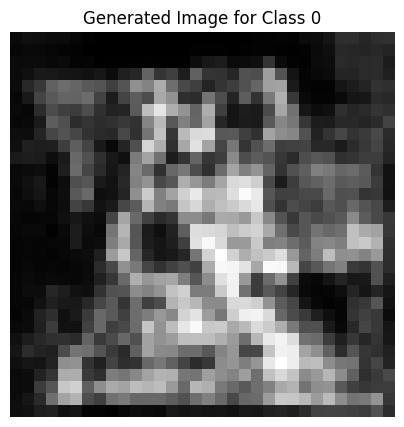

Epoch [1172/2500], D_loss: -0.03823261708021164, G_loss: -0.5021882653236389


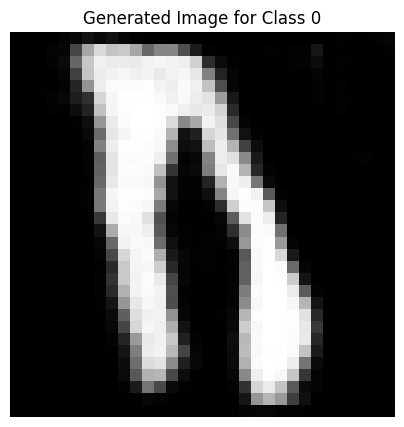

Epoch [1173/2500], D_loss: -0.039771951735019684, G_loss: -0.5137216448783875


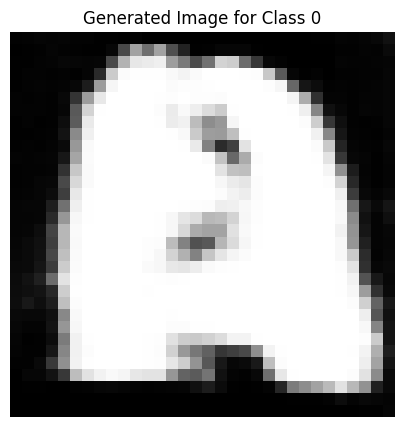

Epoch [1174/2500], D_loss: 0.00373271107673645, G_loss: -0.5585957765579224


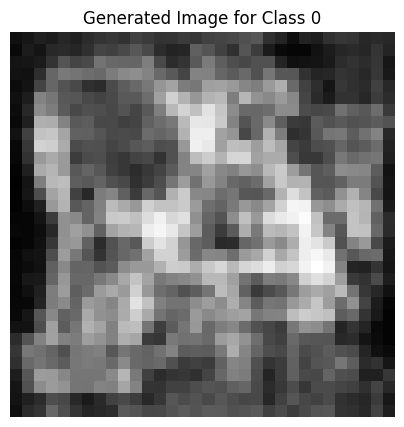

Epoch [1175/2500], D_loss: -0.040927059948444366, G_loss: -0.5597901344299316


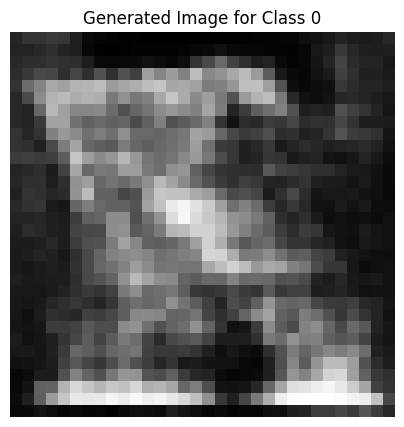

Epoch [1176/2500], D_loss: -0.03415298089385033, G_loss: -0.5233078598976135


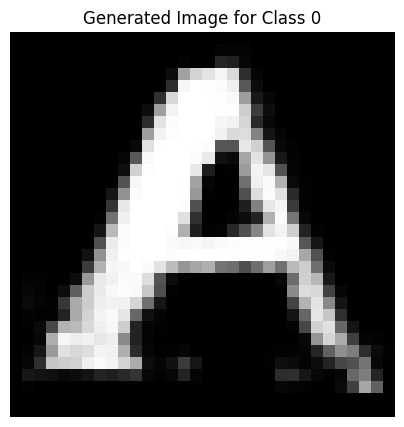

Epoch [1177/2500], D_loss: -0.02546245977282524, G_loss: -0.5245344042778015


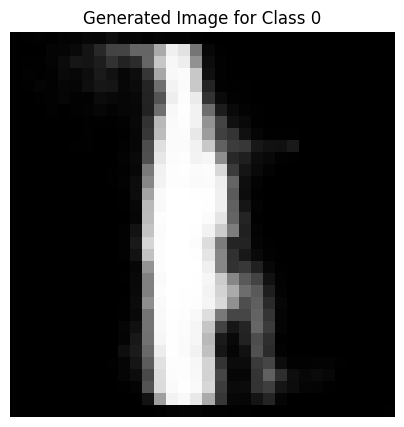

Epoch [1178/2500], D_loss: -0.00397954136133194, G_loss: -0.5175982713699341


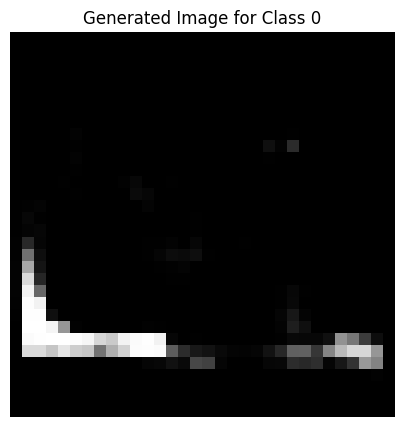

Epoch [1179/2500], D_loss: -0.04264058172702789, G_loss: -0.5469270944595337


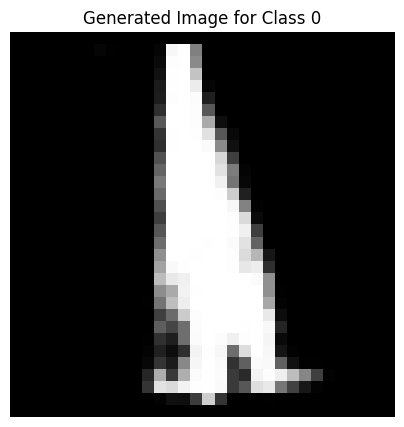

Epoch [1180/2500], D_loss: -0.042547281831502914, G_loss: -0.5470134615898132


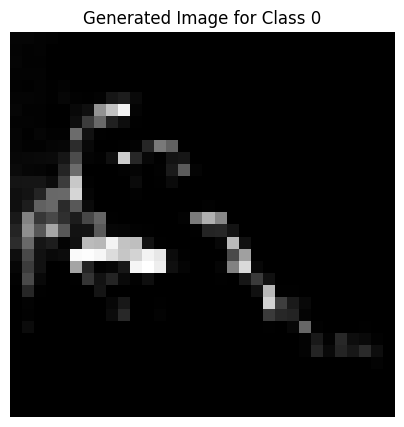

Epoch [1181/2500], D_loss: -0.05123782902956009, G_loss: -0.5586506128311157


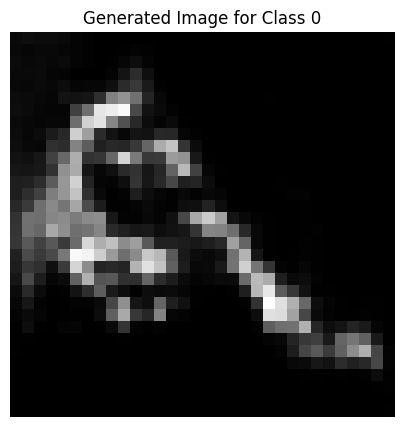

Epoch [1182/2500], D_loss: -0.024685557931661606, G_loss: -0.68404221534729


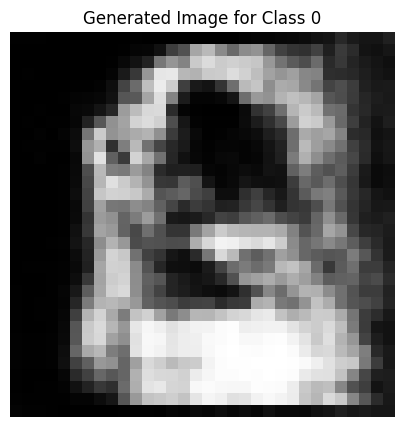

Epoch [1183/2500], D_loss: -0.025955602526664734, G_loss: -0.524264931678772


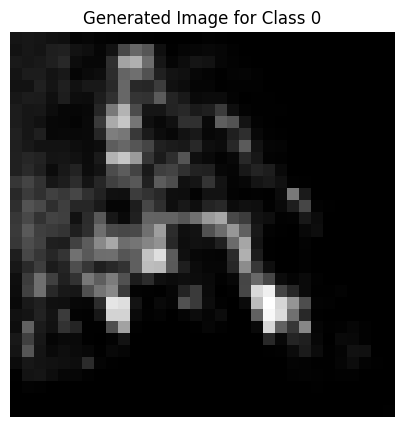

Epoch [1184/2500], D_loss: 0.04468423128128052, G_loss: -0.5733947157859802


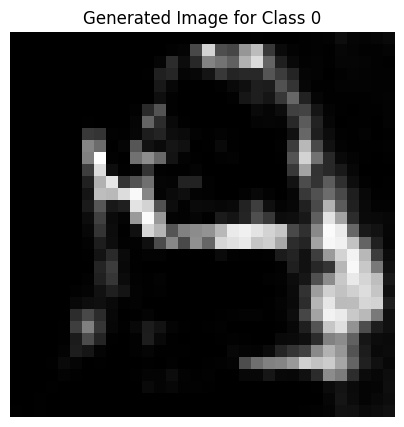

Epoch [1185/2500], D_loss: 0.0017761141061782837, G_loss: -0.5498730540275574


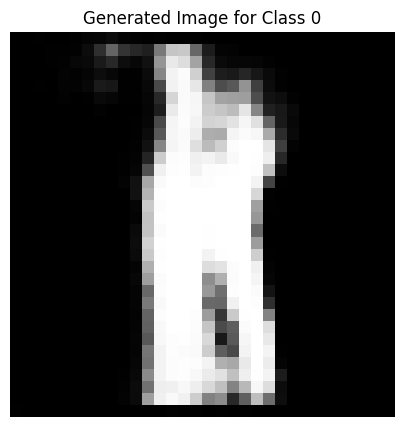

Epoch [1186/2500], D_loss: -0.004809975624084473, G_loss: -0.6021583080291748


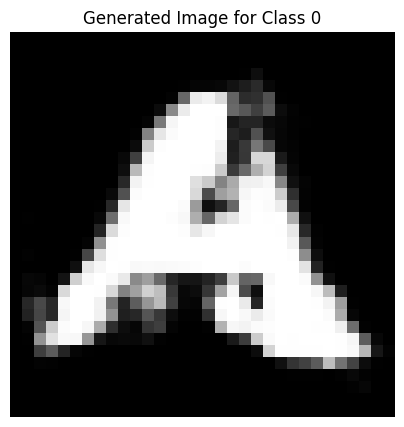

Epoch [1187/2500], D_loss: -0.012118309736251831, G_loss: -0.5158678889274597


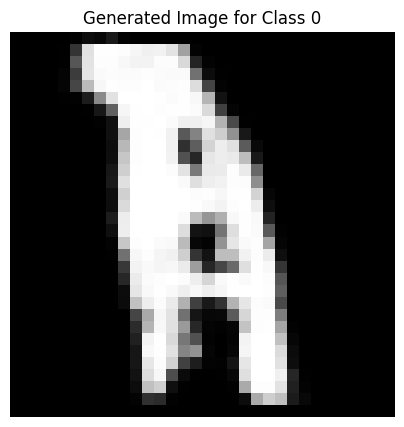

Epoch [1188/2500], D_loss: 0.012780651450157166, G_loss: -0.5395253300666809


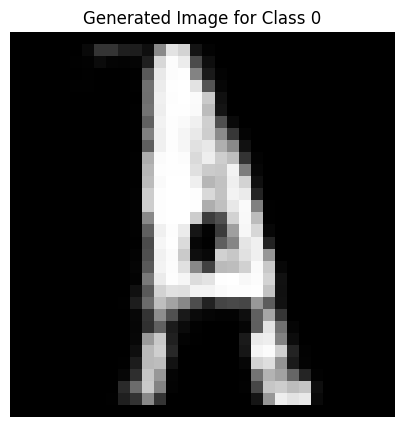

Epoch [1189/2500], D_loss: -0.03767993301153183, G_loss: -0.534105658531189


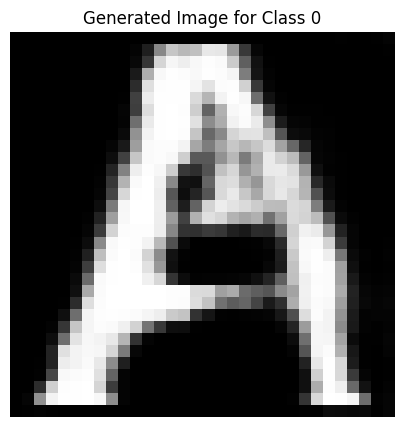

Epoch [1190/2500], D_loss: 0.00022442638874053955, G_loss: -0.6461153030395508


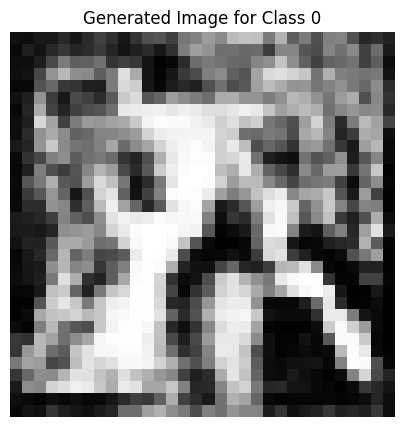

Epoch [1191/2500], D_loss: -0.012137427926063538, G_loss: -0.5308387279510498


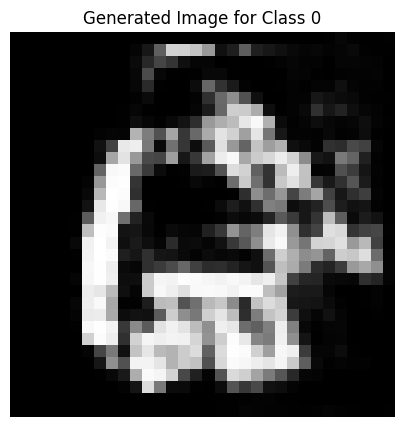

Epoch [1192/2500], D_loss: -0.019602350890636444, G_loss: -0.6062153577804565


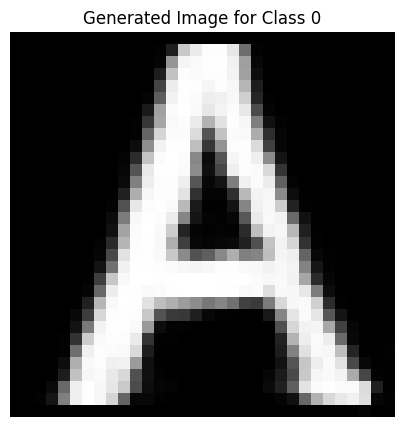

Epoch [1193/2500], D_loss: -0.049243226647377014, G_loss: -0.5024181008338928


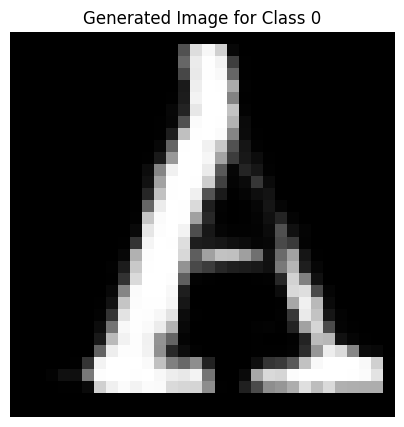

Epoch [1194/2500], D_loss: -0.05487853288650513, G_loss: -0.546310544013977


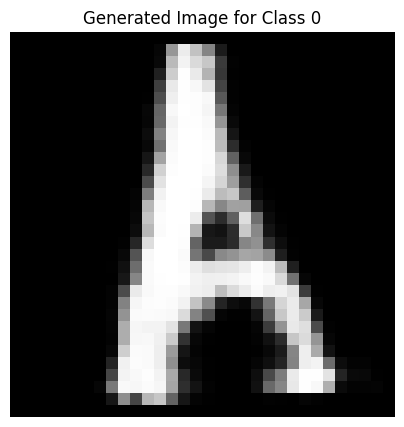

Epoch [1195/2500], D_loss: -0.019795410335063934, G_loss: -0.5065993070602417


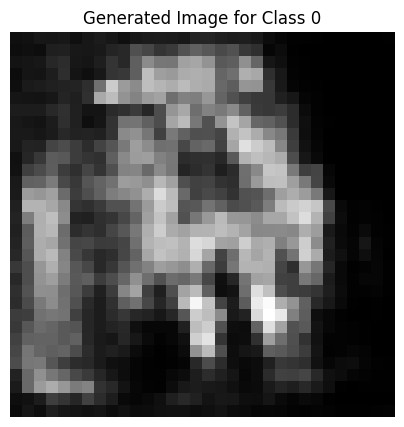

Epoch [1196/2500], D_loss: -0.040657490491867065, G_loss: -0.5693556666374207


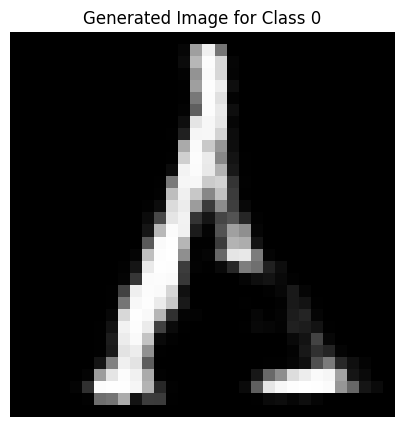

Epoch [1197/2500], D_loss: -0.03910354897379875, G_loss: -0.5139470100402832


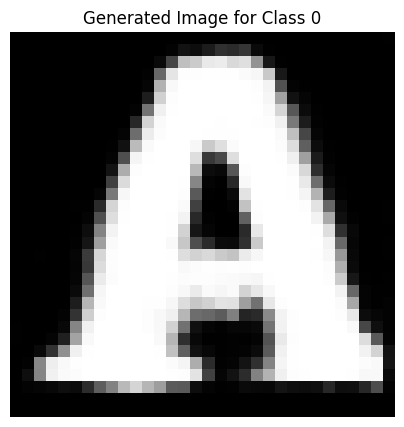

Epoch [1198/2500], D_loss: -0.02672336995601654, G_loss: -0.561084508895874


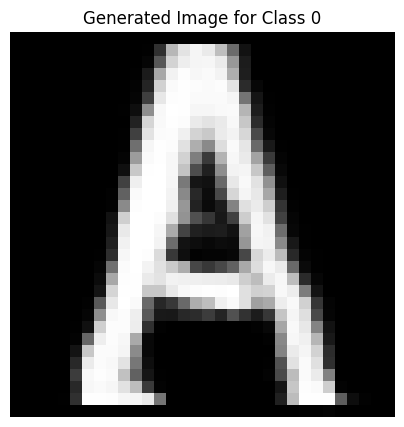

Epoch [1199/2500], D_loss: -0.03971228748559952, G_loss: -0.5697920322418213


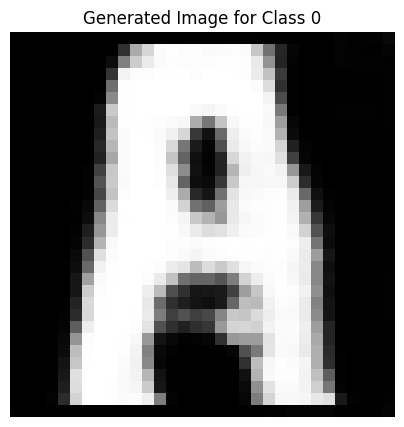

Epoch [1200/2500], D_loss: -0.02151462435722351, G_loss: -0.5204965472221375


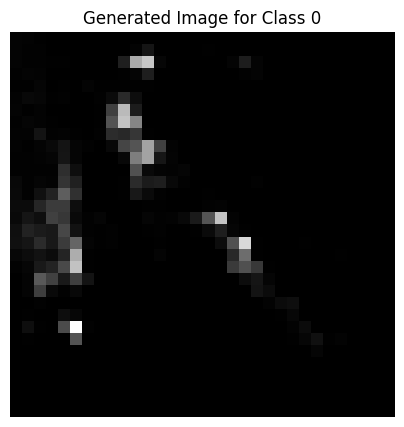

Epoch [1201/2500], D_loss: -0.04409728944301605, G_loss: -0.5368064641952515


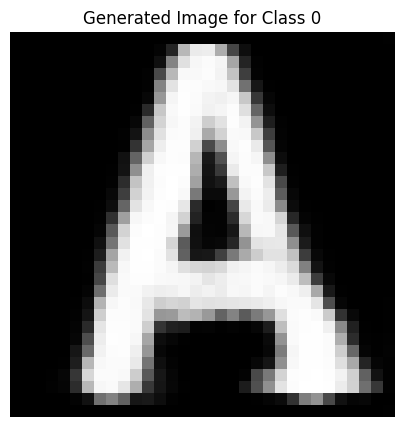

Epoch [1202/2500], D_loss: -0.030994437634944916, G_loss: -0.45424944162368774


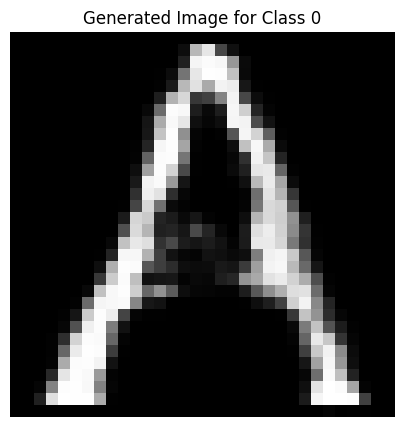

Epoch [1203/2500], D_loss: -0.05055499076843262, G_loss: -0.526650607585907


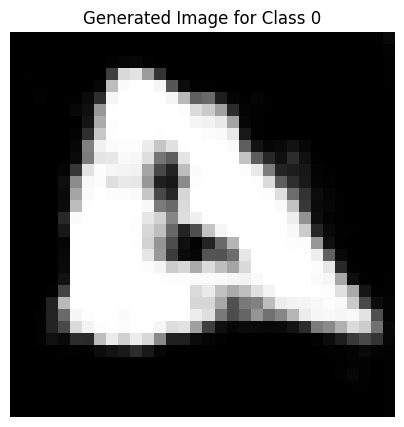

Epoch [1204/2500], D_loss: 0.09798328578472137, G_loss: -0.5413457155227661


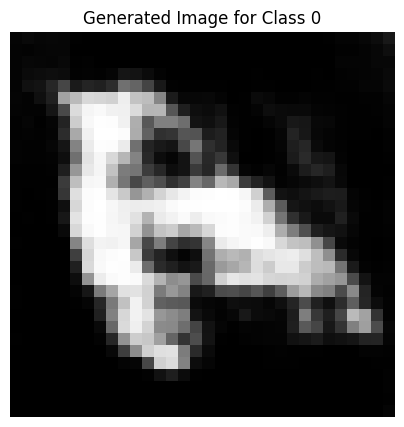

Epoch [1205/2500], D_loss: -0.03678736090660095, G_loss: -0.5754019618034363


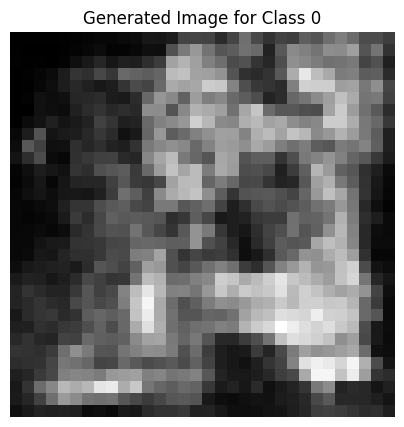

Epoch [1206/2500], D_loss: -0.024547606706619263, G_loss: -0.5696520805358887


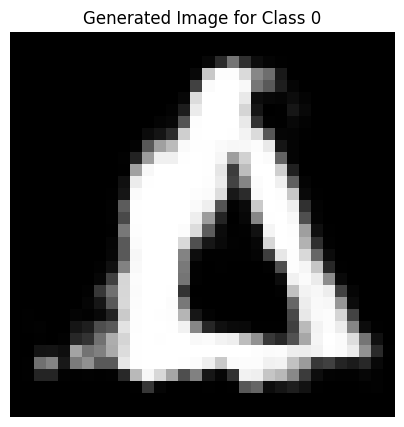

Epoch [1207/2500], D_loss: -0.005561962723731995, G_loss: -0.5326409339904785


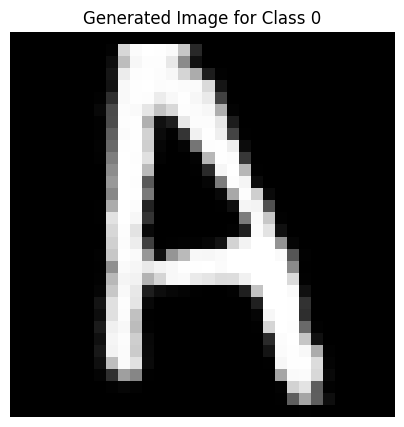

Epoch [1208/2500], D_loss: -0.04841320961713791, G_loss: -0.5193515419960022


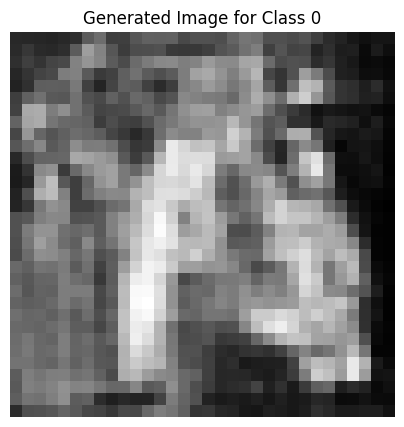

Epoch [1209/2500], D_loss: -0.04708888381719589, G_loss: -0.5408128499984741


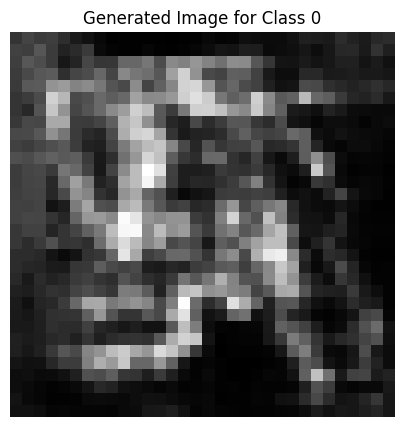

Epoch [1210/2500], D_loss: -0.03614388778805733, G_loss: -0.4165360927581787


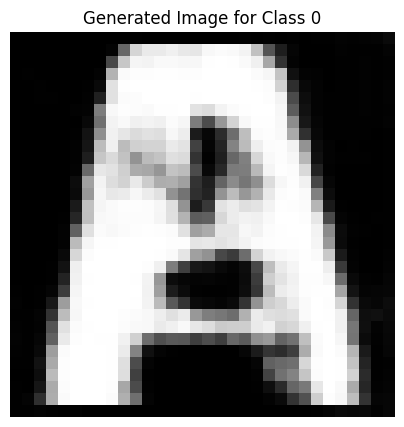

Epoch [1211/2500], D_loss: -0.009313046932220459, G_loss: -0.5766862630844116


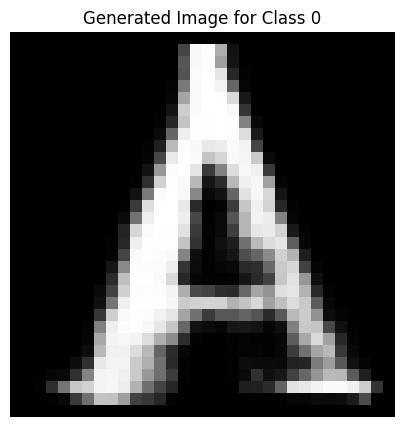

Epoch [1212/2500], D_loss: -0.034359708428382874, G_loss: -0.5532895922660828


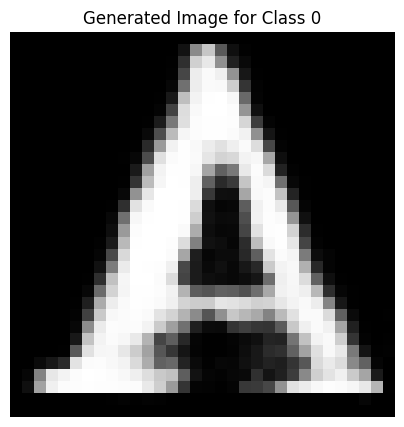

Epoch [1213/2500], D_loss: -0.023338213562965393, G_loss: -0.5678331255912781


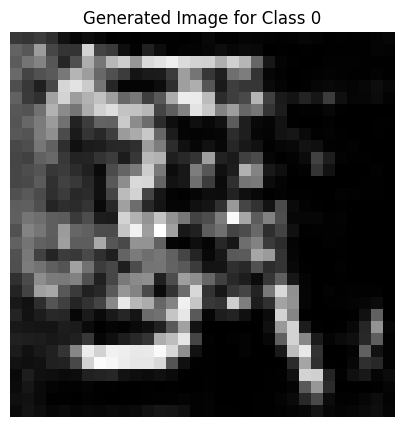

Epoch [1214/2500], D_loss: -0.021516554057598114, G_loss: -0.5313313603401184


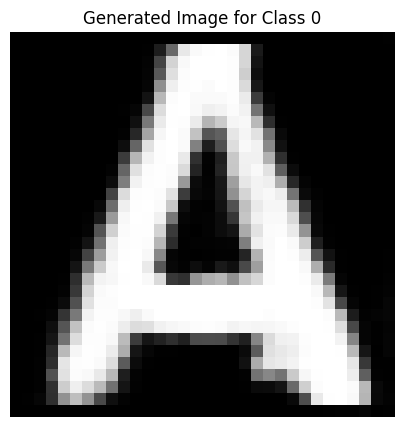

Epoch [1215/2500], D_loss: -0.04515312239527702, G_loss: -0.5424368381500244


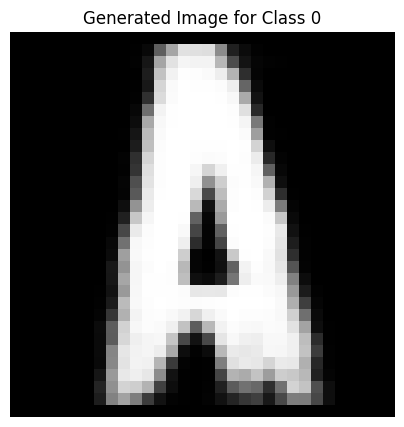

Epoch [1216/2500], D_loss: -0.033438920974731445, G_loss: -0.5261479020118713


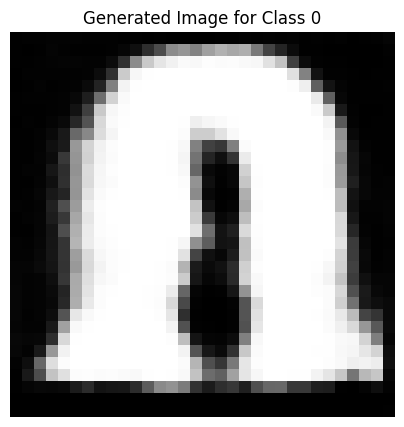

Epoch [1217/2500], D_loss: -0.03091319650411606, G_loss: -0.5520637631416321


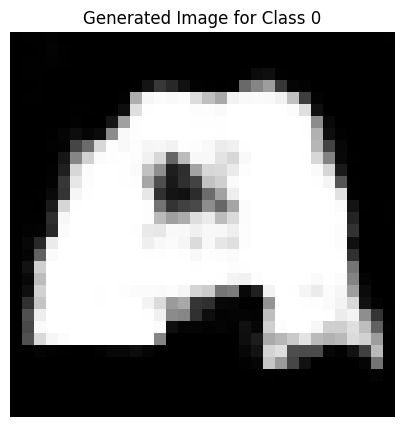

Epoch [1218/2500], D_loss: -0.05060523375868797, G_loss: -0.5863641500473022


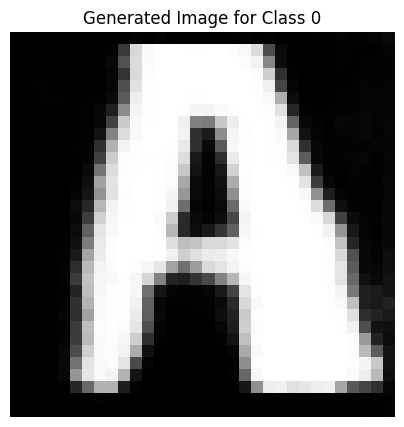

Epoch [1219/2500], D_loss: -0.0375000536441803, G_loss: -0.5420399308204651


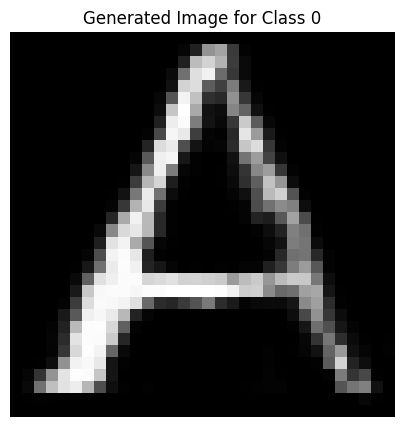

Epoch [1220/2500], D_loss: -0.03662443906068802, G_loss: -0.6147139072418213


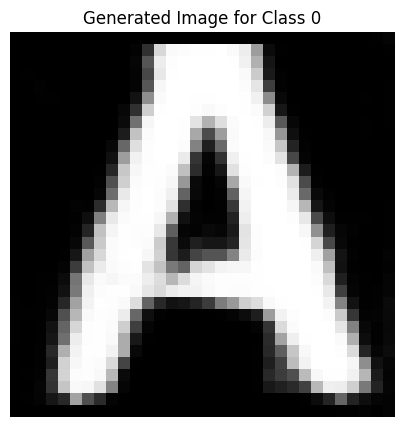

Epoch [1221/2500], D_loss: -0.023628607392311096, G_loss: -0.5211238861083984


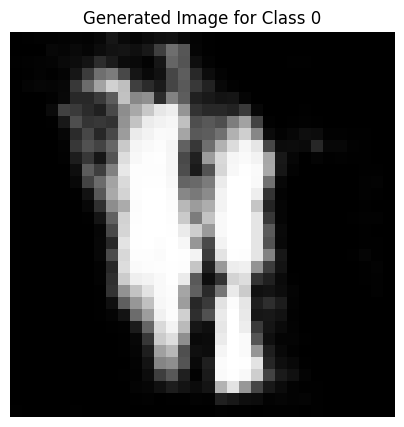

Epoch [1222/2500], D_loss: -0.016756124794483185, G_loss: -0.3814041018486023


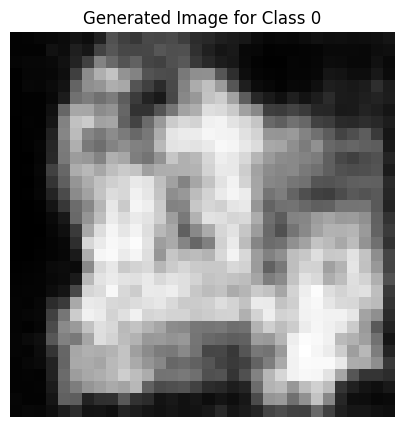

Epoch [1223/2500], D_loss: -0.03788959980010986, G_loss: -0.543297529220581


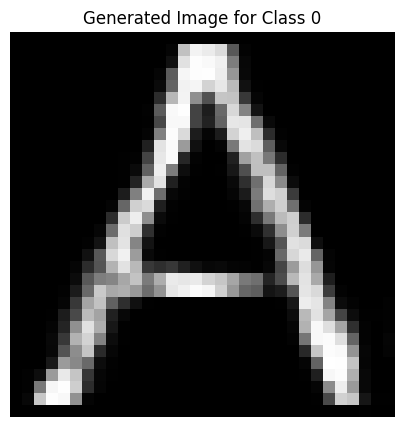

Epoch [1224/2500], D_loss: -0.01074046641588211, G_loss: -0.5921077728271484


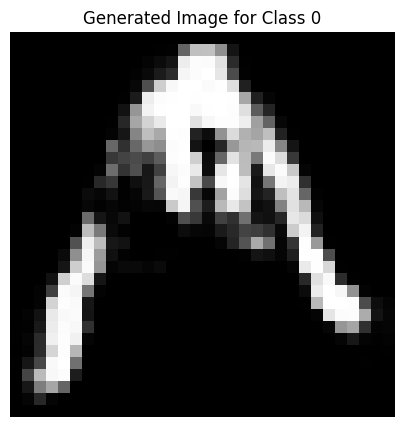

Epoch [1225/2500], D_loss: -0.05645006150007248, G_loss: -0.5475233793258667


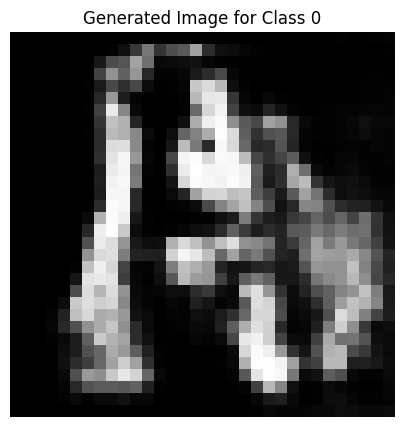

Epoch [1226/2500], D_loss: -0.061642345041036606, G_loss: -0.5354485511779785


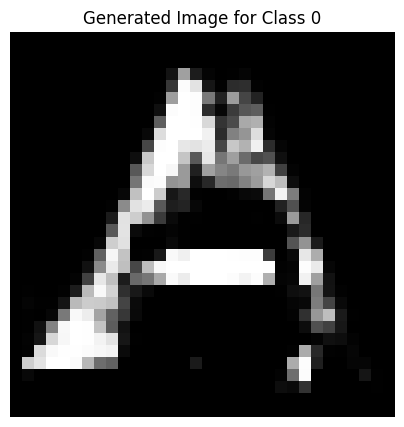

Epoch [1227/2500], D_loss: -0.04086773842573166, G_loss: -0.5436422824859619


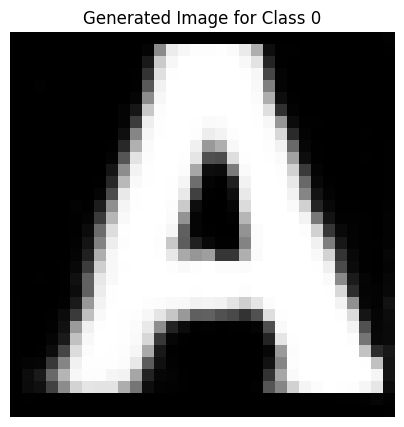

Epoch [1228/2500], D_loss: -0.03926192969083786, G_loss: -0.578502893447876


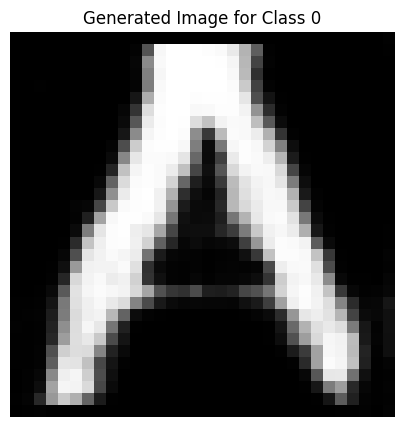

Epoch [1229/2500], D_loss: -0.05599677562713623, G_loss: -0.5196792483329773


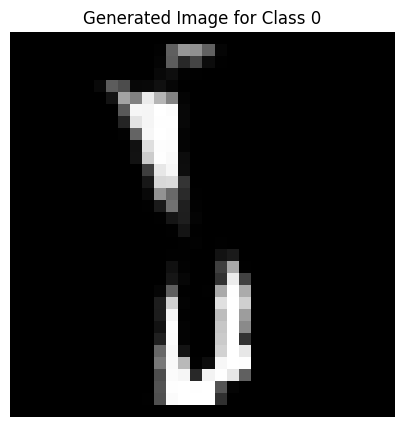

Epoch [1230/2500], D_loss: -0.048506807535886765, G_loss: -0.523922324180603


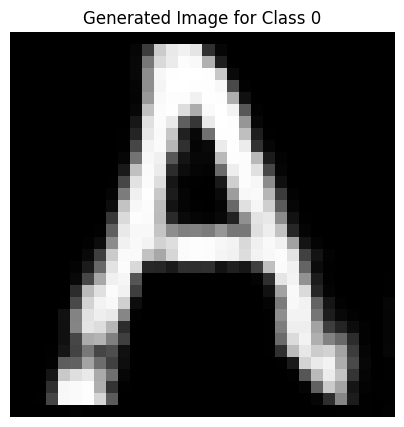

Epoch [1231/2500], D_loss: -0.02597241848707199, G_loss: -0.6905581951141357


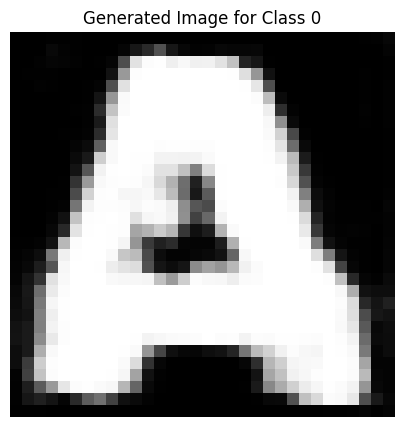

Epoch [1232/2500], D_loss: -0.035885415971279144, G_loss: -0.563102662563324


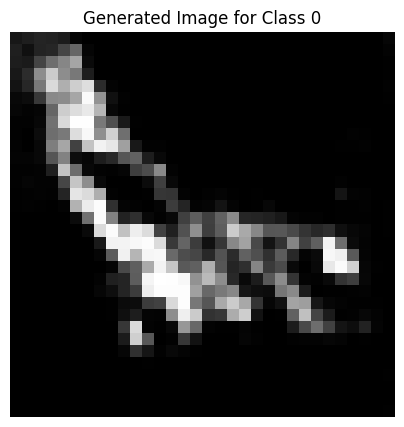

Epoch [1233/2500], D_loss: -0.034288108348846436, G_loss: -0.5884716510772705


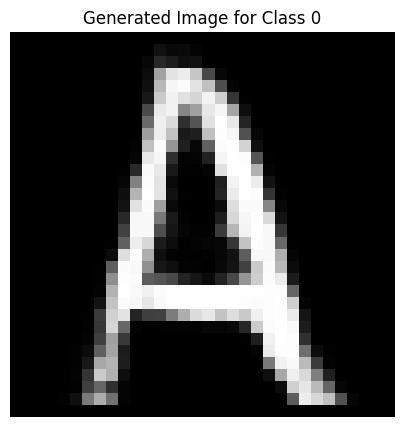

Epoch [1234/2500], D_loss: -0.05034999921917915, G_loss: -0.5118679404258728


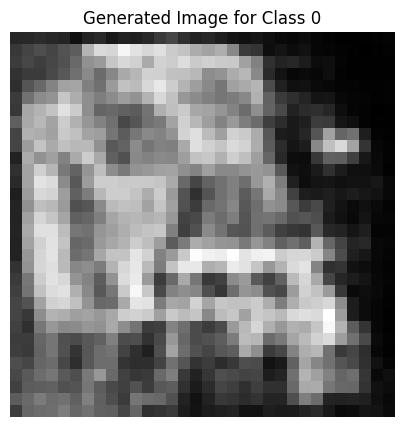

Epoch [1235/2500], D_loss: -0.03788084536790848, G_loss: -0.5259313583374023


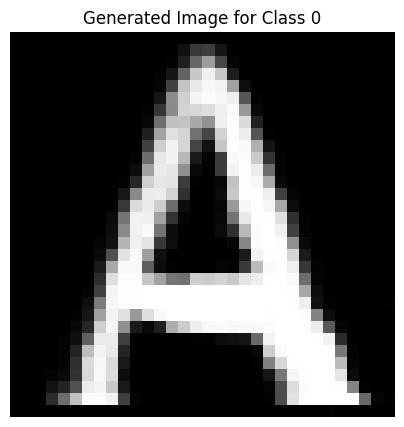

Epoch [1236/2500], D_loss: -0.041748546063899994, G_loss: -0.5517494082450867


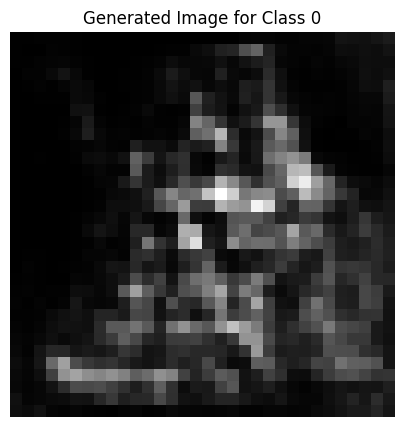

Epoch [1237/2500], D_loss: -0.0317007452249527, G_loss: -0.5026940107345581


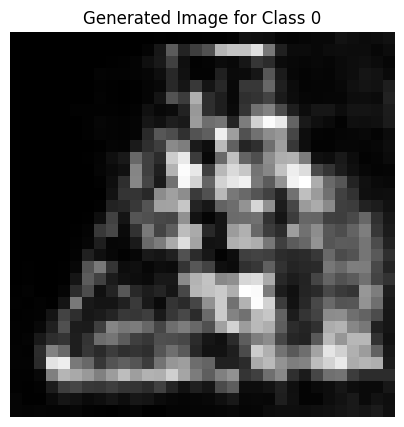

Epoch [1238/2500], D_loss: -0.03538618981838226, G_loss: -0.39155372977256775


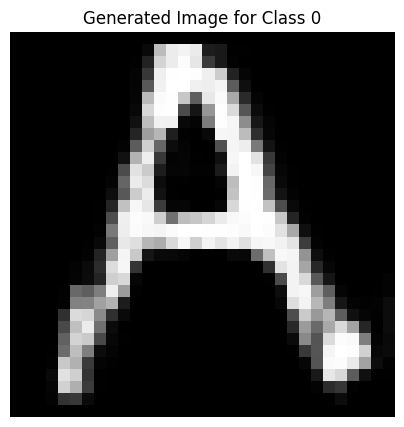

Epoch [1239/2500], D_loss: -0.0201316699385643, G_loss: -0.4858131408691406


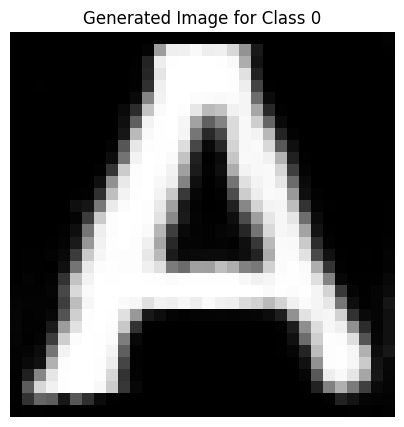

Epoch [1240/2500], D_loss: -0.020988762378692627, G_loss: -0.4986245036125183


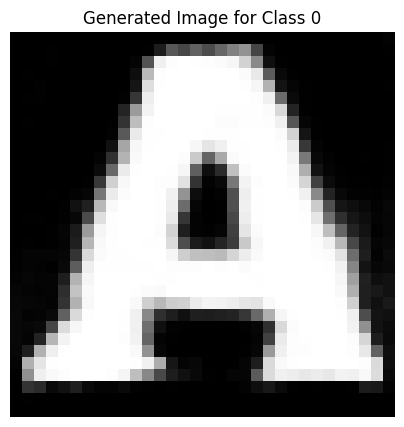

Epoch [1241/2500], D_loss: -0.0393146276473999, G_loss: -0.531685471534729


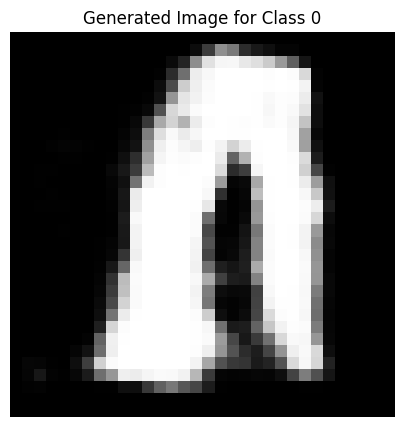

Epoch [1242/2500], D_loss: 0.012975327670574188, G_loss: -0.5758858323097229


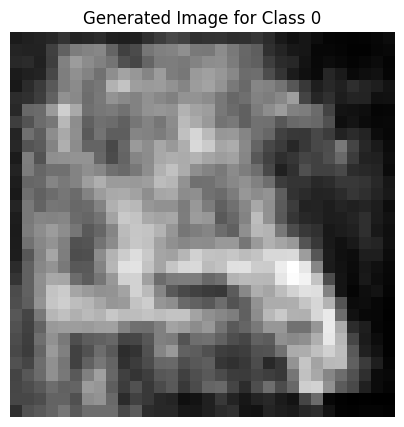

Epoch [1243/2500], D_loss: -0.047431621700525284, G_loss: -0.6207460761070251


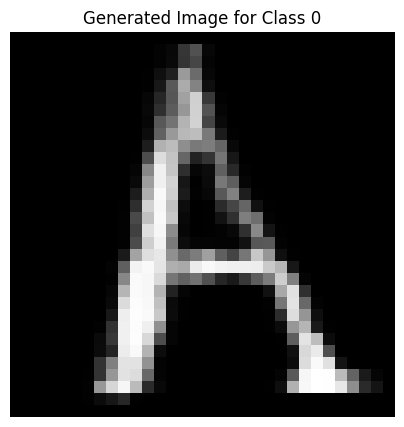

Epoch [1244/2500], D_loss: -0.014903917908668518, G_loss: -0.46414250135421753


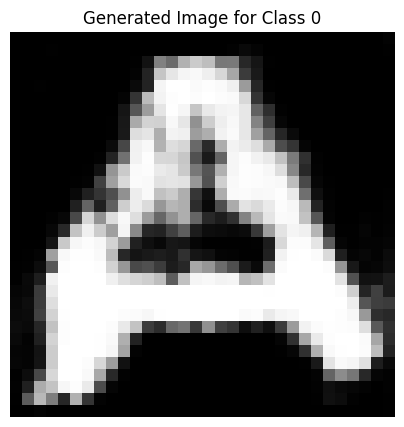

Epoch [1245/2500], D_loss: -0.04449348896741867, G_loss: -0.5294842720031738


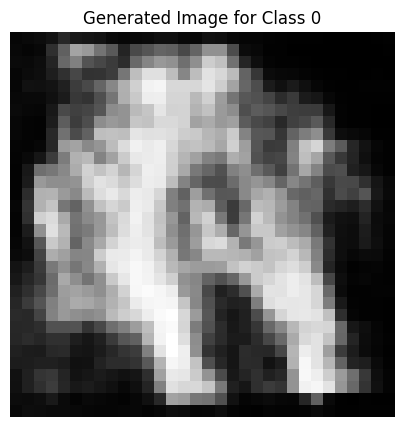

Epoch [1246/2500], D_loss: -0.041038691997528076, G_loss: -0.5085127353668213


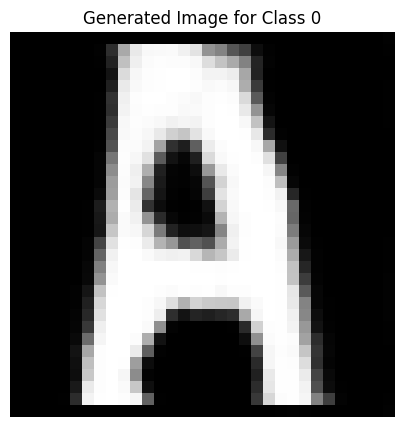

Epoch [1247/2500], D_loss: -0.03442446142435074, G_loss: -0.5432007908821106


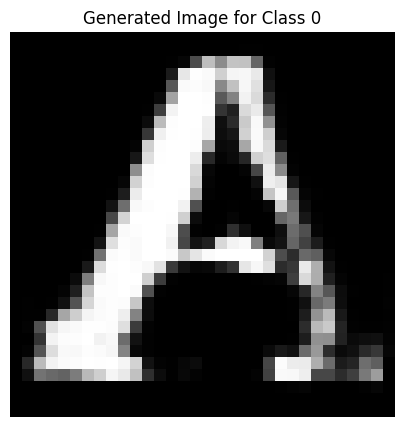

Epoch [1248/2500], D_loss: -0.058834221214056015, G_loss: -0.535206139087677


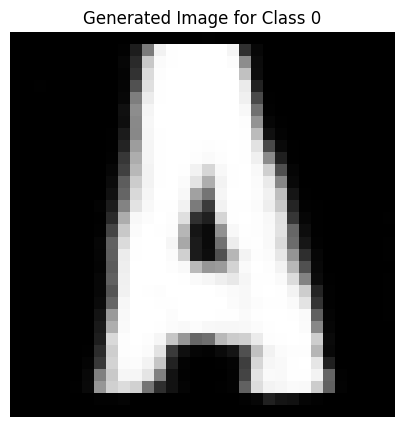

Epoch [1249/2500], D_loss: -0.04838038235902786, G_loss: -0.5225587487220764


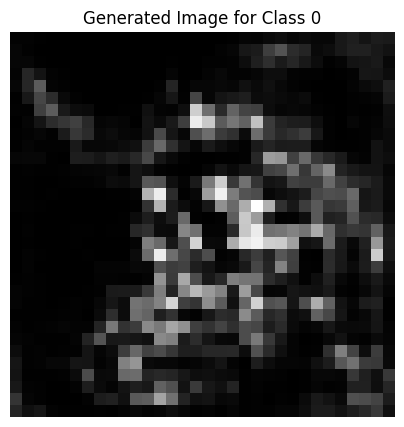

Epoch [1250/2500], D_loss: -0.04702375829219818, G_loss: -0.6034817695617676


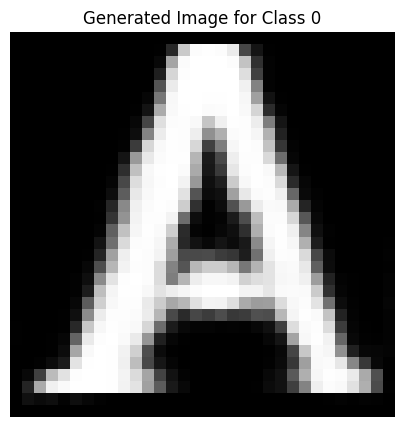

Epoch [1251/2500], D_loss: -0.043143853545188904, G_loss: -0.5205593705177307


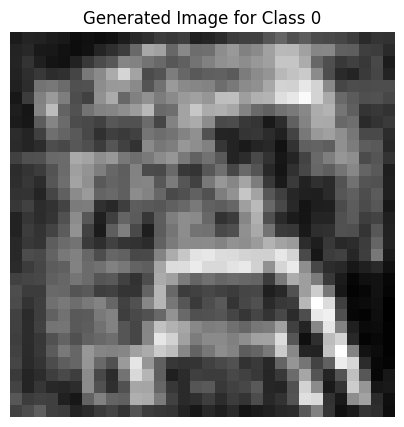

Epoch [1252/2500], D_loss: -0.0275069922208786, G_loss: -0.5349087715148926


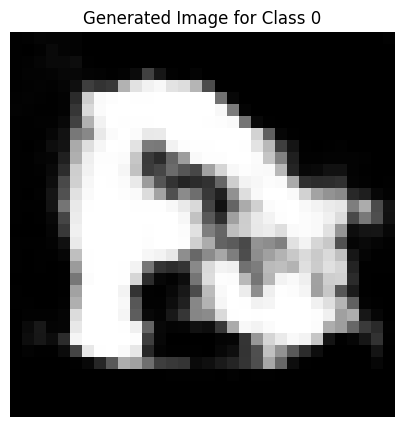

Epoch [1253/2500], D_loss: -0.054790813475847244, G_loss: -0.5511394739151001


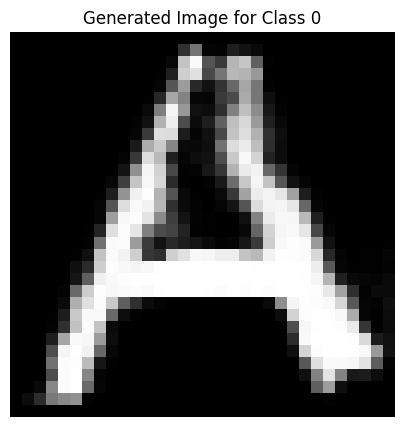

Epoch [1254/2500], D_loss: -0.057100825011730194, G_loss: -0.5216014981269836


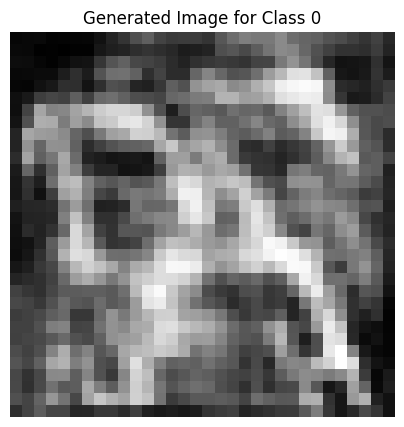

Epoch [1255/2500], D_loss: -0.048556964844465256, G_loss: -0.5446223616600037


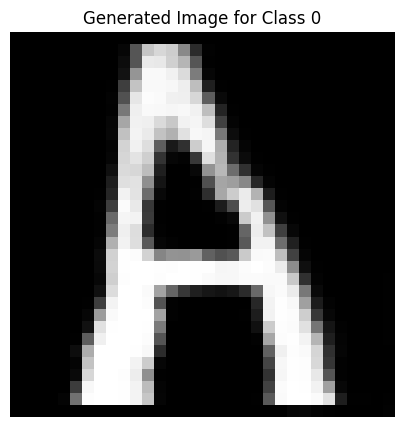

Epoch [1256/2500], D_loss: -0.053311869502067566, G_loss: -0.43923747539520264


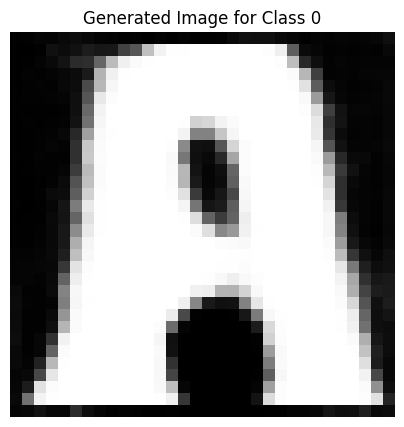

Epoch [1257/2500], D_loss: -0.04154784977436066, G_loss: -0.42849624156951904


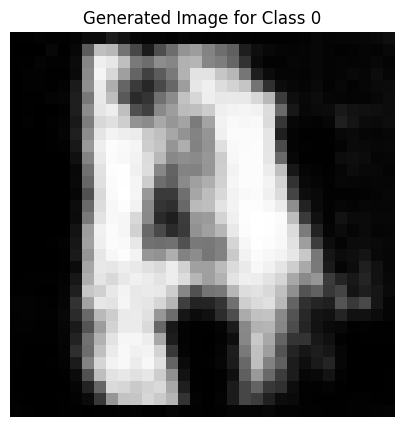

Epoch [1258/2500], D_loss: -0.04783228784799576, G_loss: -0.5672625303268433


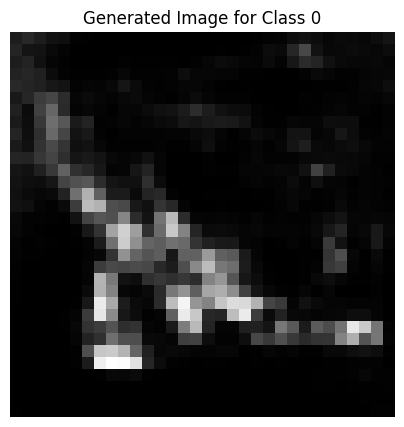

Epoch [1259/2500], D_loss: -0.062492888420820236, G_loss: -0.5710859298706055


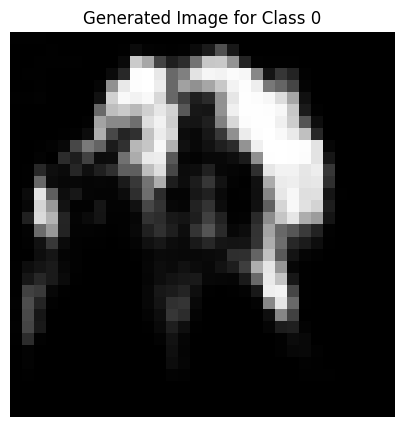

Epoch [1260/2500], D_loss: -0.047219157218933105, G_loss: -0.43446236848831177


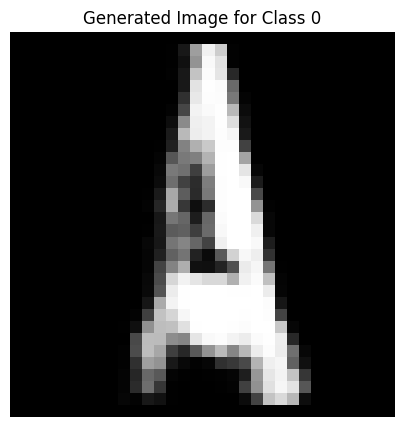

Epoch [1261/2500], D_loss: -0.04574555158615112, G_loss: -0.531308114528656


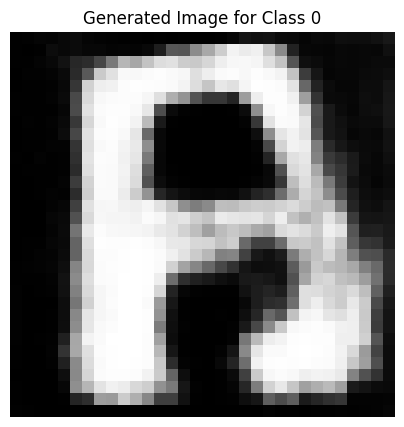

Epoch [1262/2500], D_loss: -0.041291192173957825, G_loss: -0.7220632433891296


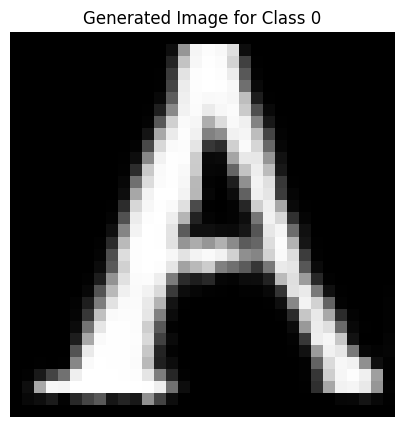

Epoch [1263/2500], D_loss: -0.052154604345560074, G_loss: -0.5276098847389221


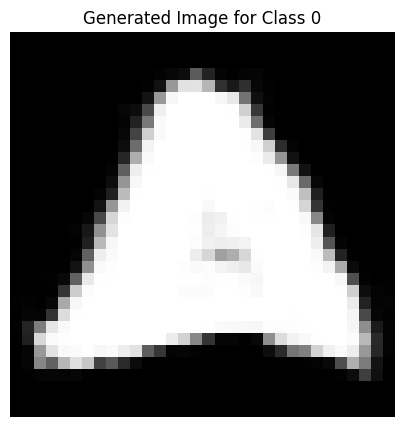

Epoch [1264/2500], D_loss: -0.00043664127588272095, G_loss: -0.5345228314399719


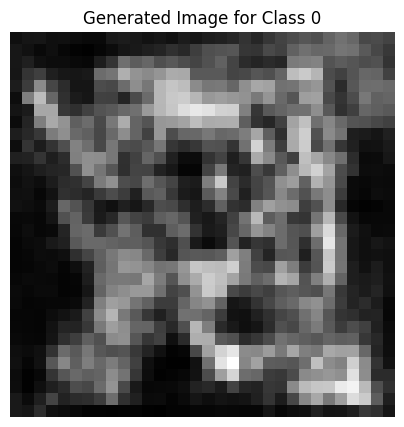

Epoch [1265/2500], D_loss: -0.052518583834171295, G_loss: -0.5220420360565186


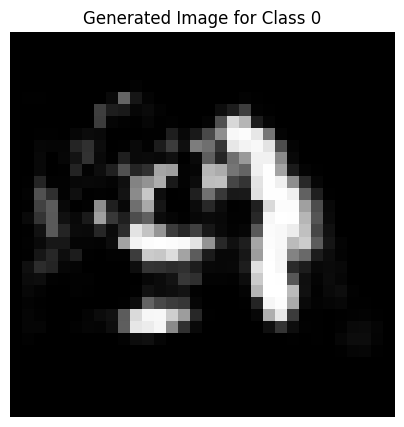

Epoch [1266/2500], D_loss: -0.03505999594926834, G_loss: -0.5681065917015076


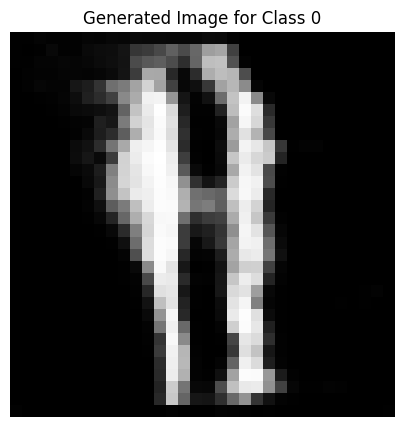

Epoch [1267/2500], D_loss: -0.036850832402706146, G_loss: -0.6308029890060425


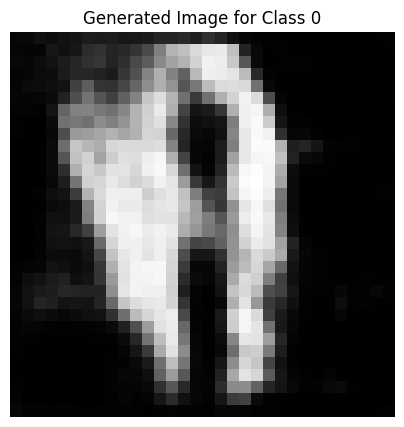

Epoch [1268/2500], D_loss: -0.04255975782871246, G_loss: -0.5401840806007385


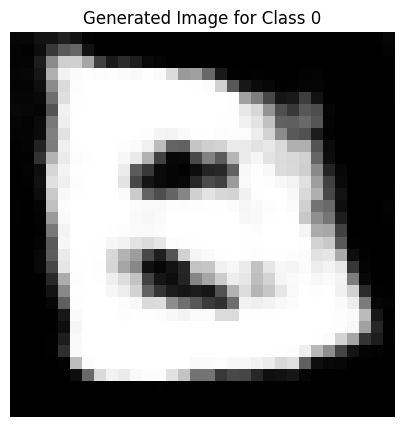

Epoch [1269/2500], D_loss: -0.04934302717447281, G_loss: -0.6905728578567505


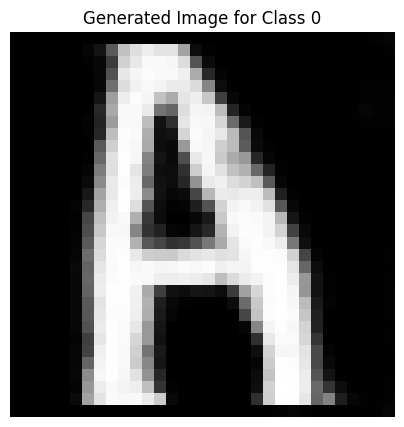

Epoch [1270/2500], D_loss: -0.04833430051803589, G_loss: -0.5343981385231018


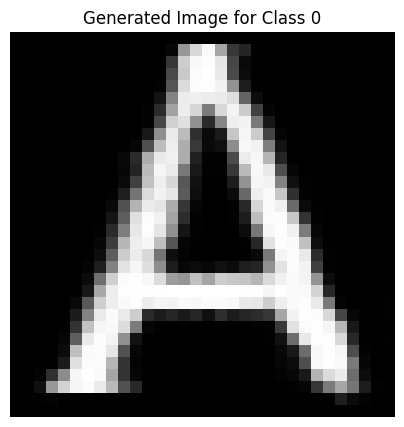

Epoch [1271/2500], D_loss: -0.05544055998325348, G_loss: -0.5421713590621948


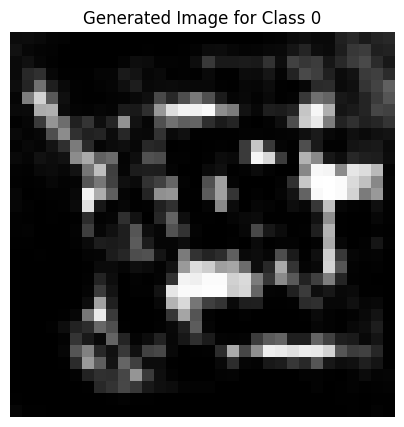

Epoch [1272/2500], D_loss: -0.05626426264643669, G_loss: -0.49597233533859253


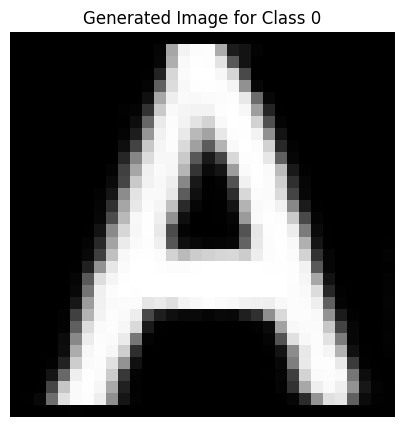

Epoch [1273/2500], D_loss: -0.07838369905948639, G_loss: -0.5526270270347595


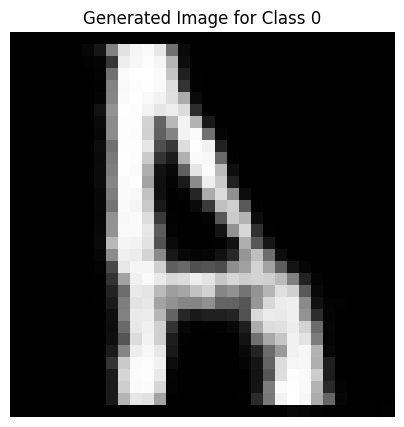

Epoch [1274/2500], D_loss: -0.016695484519004822, G_loss: -0.543025016784668


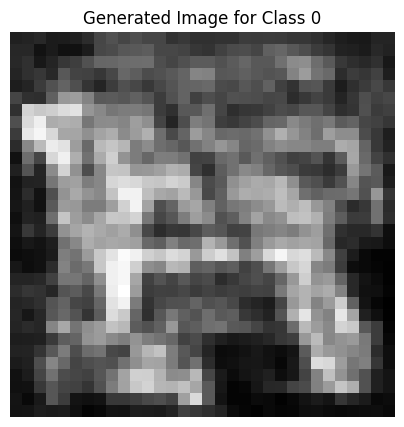

Epoch [1275/2500], D_loss: 0.07372242212295532, G_loss: -0.46755558252334595


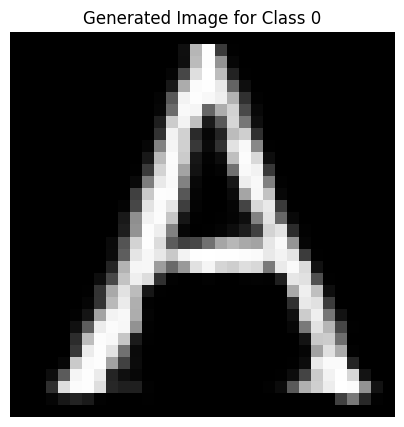

Epoch [1276/2500], D_loss: -0.03743637353181839, G_loss: -0.5328028202056885


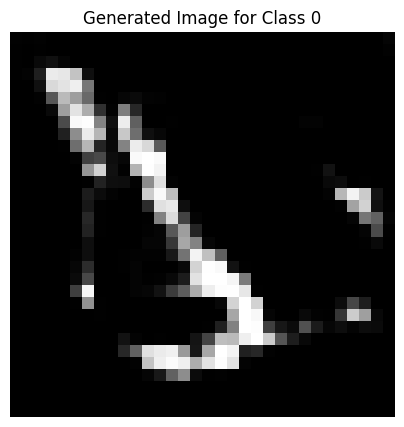

Epoch [1277/2500], D_loss: -0.03450728952884674, G_loss: -0.5069562196731567


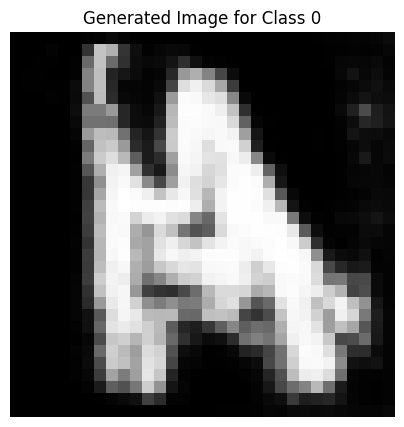

Epoch [1278/2500], D_loss: -0.06652943044900894, G_loss: -0.4858522415161133


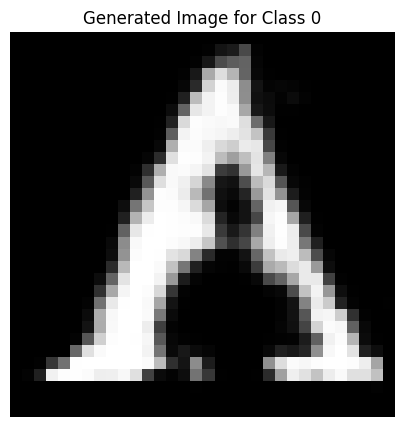

Epoch [1279/2500], D_loss: -0.04366256296634674, G_loss: -0.5395991206169128


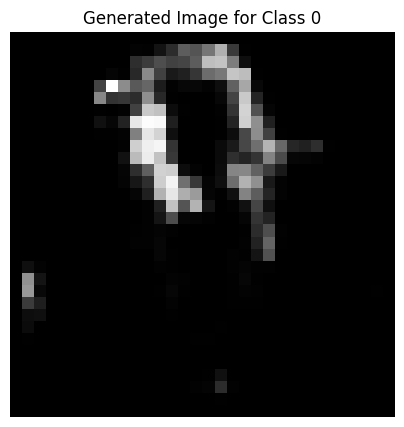

Epoch [1280/2500], D_loss: -0.05131283402442932, G_loss: -0.5446711778640747


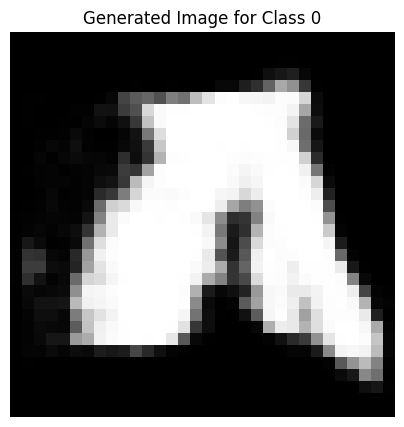

Epoch [1281/2500], D_loss: -0.053015440702438354, G_loss: -0.5623548030853271


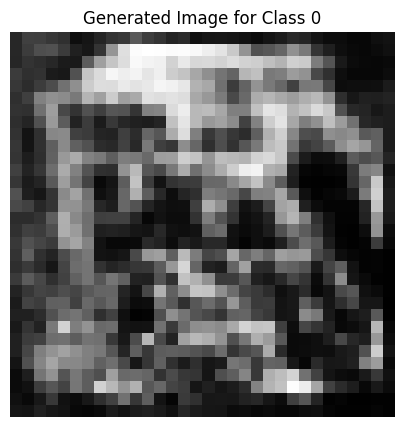

Epoch [1282/2500], D_loss: -0.05554162710905075, G_loss: -0.5474740266799927


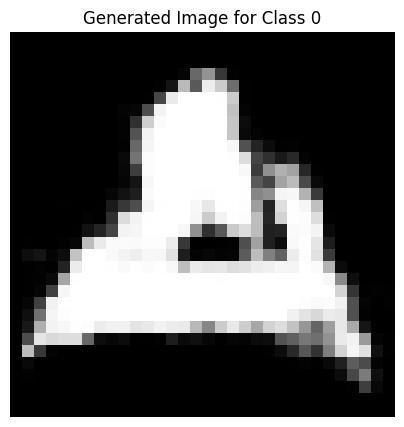

Epoch [1283/2500], D_loss: -0.0421682745218277, G_loss: -0.5095239877700806


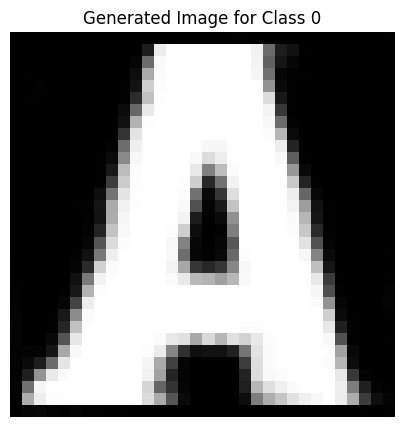

Epoch [1284/2500], D_loss: -0.046165913343429565, G_loss: -0.557145893573761


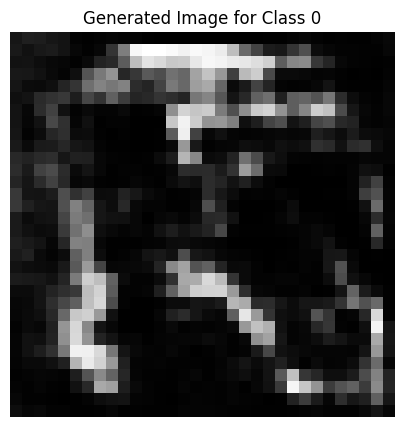

Epoch [1285/2500], D_loss: -0.042295798659324646, G_loss: -0.5390051603317261


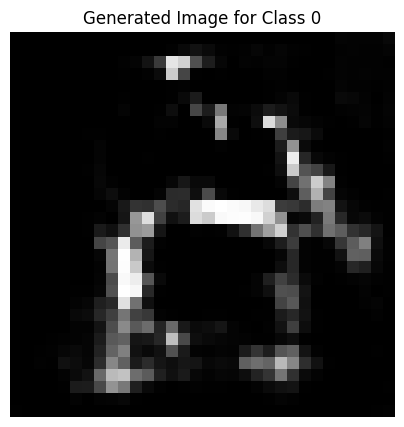

Epoch [1286/2500], D_loss: -0.0617930106818676, G_loss: -0.5102794170379639


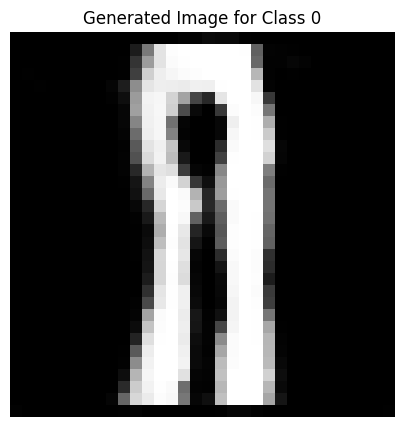

Epoch [1287/2500], D_loss: -0.03170064091682434, G_loss: -0.554772138595581


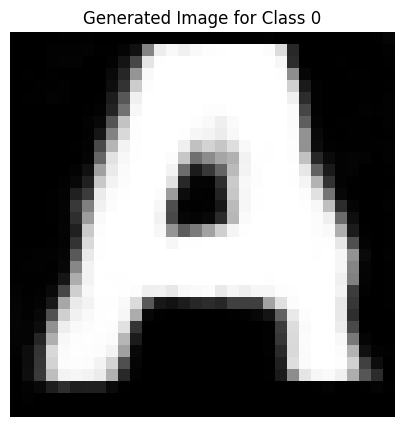

Epoch [1288/2500], D_loss: -0.06276778876781464, G_loss: -0.5855439901351929


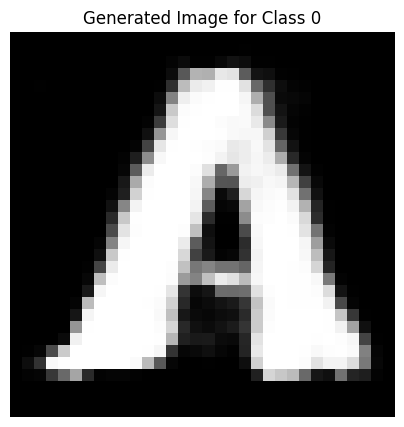

Epoch [1289/2500], D_loss: -0.04228919744491577, G_loss: -0.5530011653900146


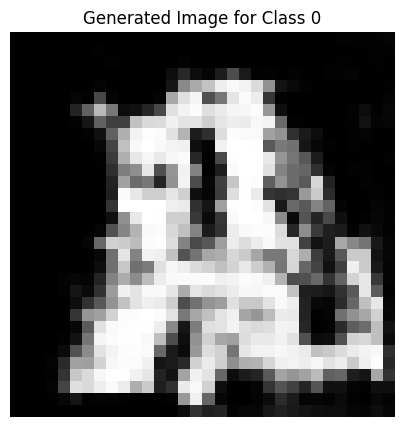

Epoch [1290/2500], D_loss: -0.04889826104044914, G_loss: -0.5505938529968262


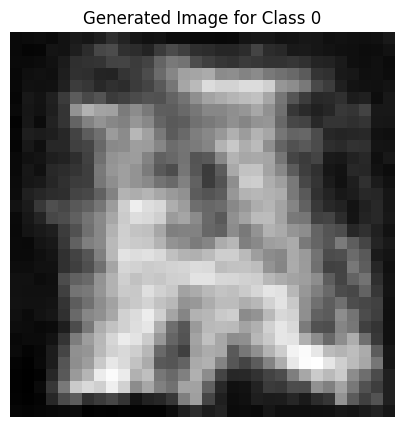

Epoch [1291/2500], D_loss: -0.031911253929138184, G_loss: -0.4944259524345398


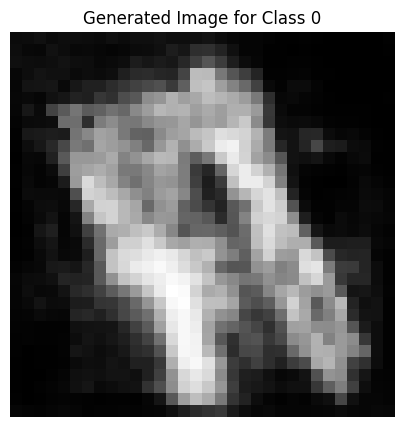

Epoch [1292/2500], D_loss: -0.00643487274646759, G_loss: -0.4139043390750885


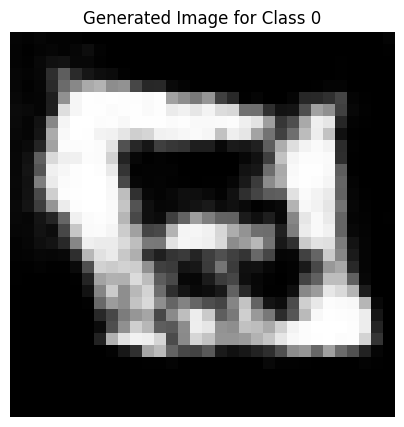

Epoch [1293/2500], D_loss: -0.04376094043254852, G_loss: -0.5283616185188293


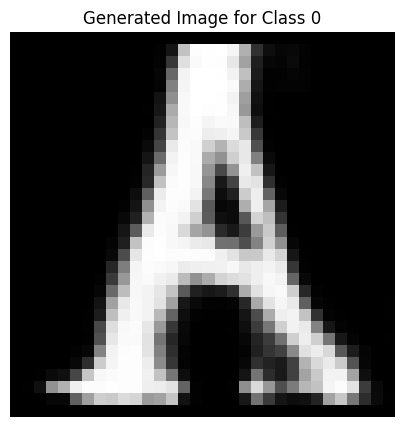

Epoch [1294/2500], D_loss: -0.00833294540643692, G_loss: -0.40484756231307983


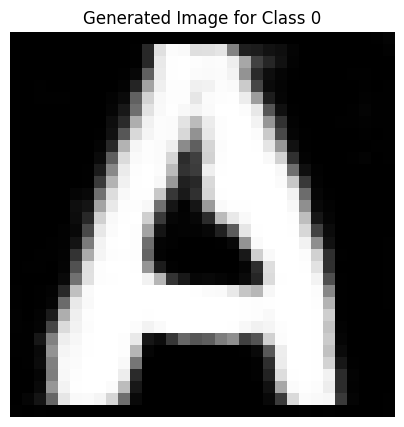

Epoch [1295/2500], D_loss: -0.05593228340148926, G_loss: -0.5104689002037048


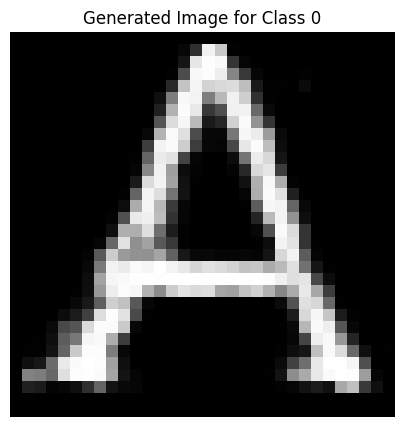

Epoch [1296/2500], D_loss: -0.03155700862407684, G_loss: -0.6372734308242798


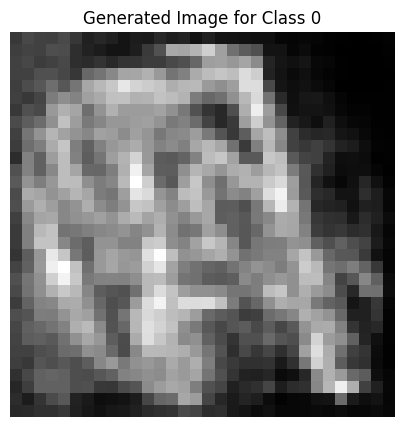

Epoch [1297/2500], D_loss: -0.052589453756809235, G_loss: -0.5327807664871216


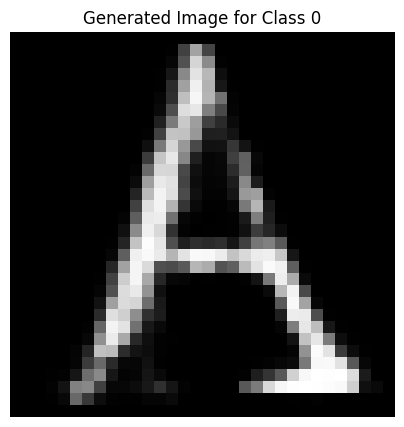

Epoch [1298/2500], D_loss: -0.0808355063199997, G_loss: -0.5281393527984619


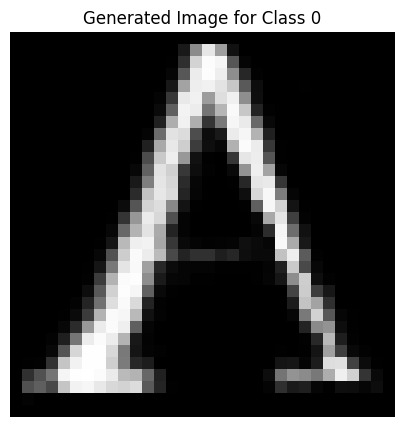

Epoch [1299/2500], D_loss: -0.060101158916950226, G_loss: -0.5814012885093689


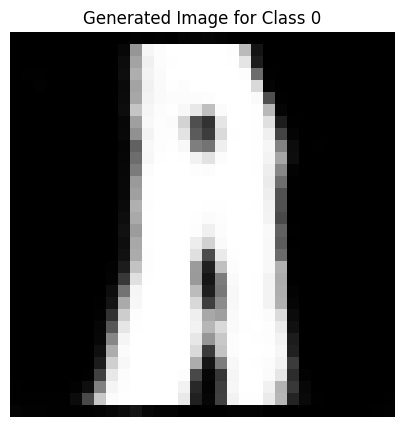

Epoch [1300/2500], D_loss: -0.06567355990409851, G_loss: -0.5357179641723633


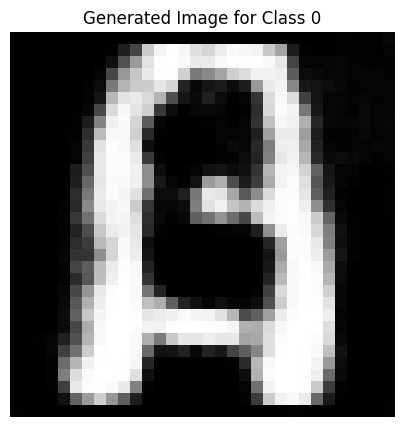

Epoch [1301/2500], D_loss: -0.04682270437479019, G_loss: -0.5105042457580566


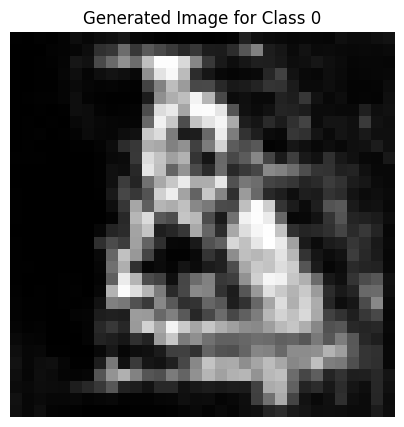

Epoch [1302/2500], D_loss: -0.02524988353252411, G_loss: -0.4456532597541809


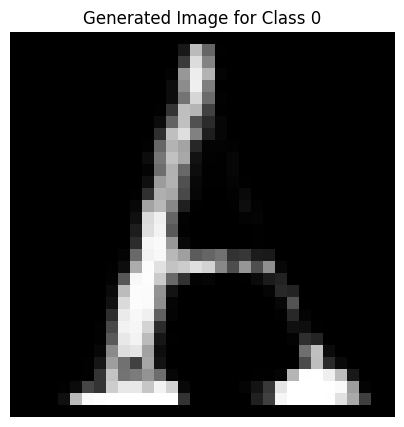

Epoch [1303/2500], D_loss: -0.06256023049354553, G_loss: -0.5439900159835815


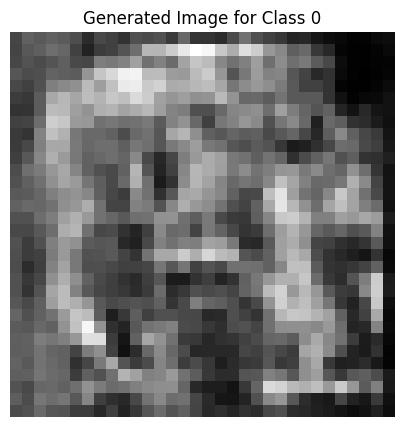

Epoch [1304/2500], D_loss: -0.05173283815383911, G_loss: -0.4744855463504791


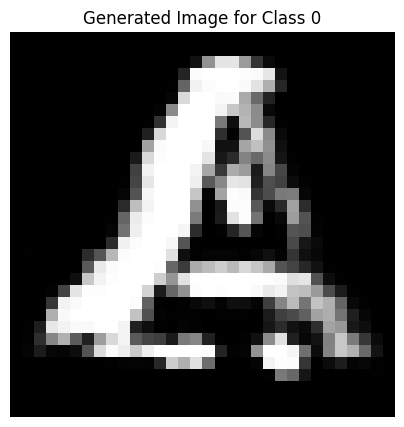

Epoch [1305/2500], D_loss: -0.04742926359176636, G_loss: -0.5263028144836426


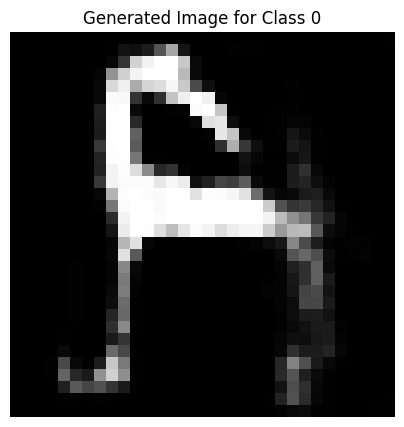

Epoch [1306/2500], D_loss: -0.03187064081430435, G_loss: -0.5148328542709351


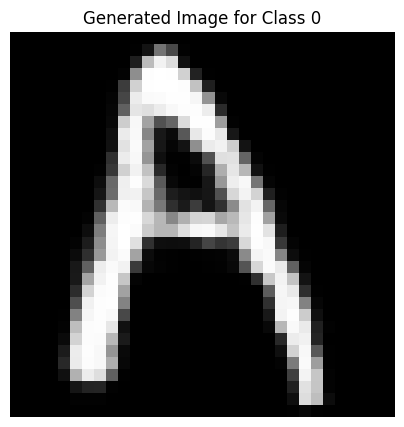

Epoch [1307/2500], D_loss: -0.04664907604455948, G_loss: -0.45911335945129395


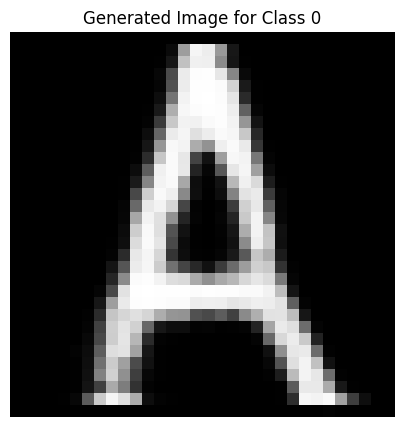

Epoch [1308/2500], D_loss: -0.036766260862350464, G_loss: -0.545279324054718


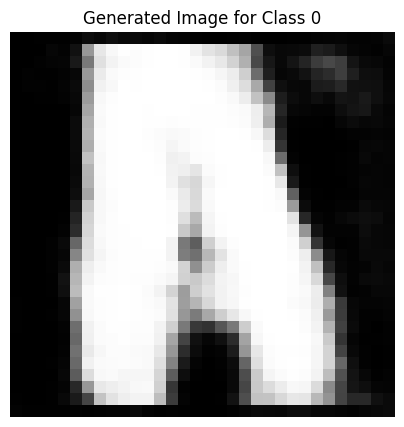

Epoch [1309/2500], D_loss: -0.056394271552562714, G_loss: -0.5017260313034058


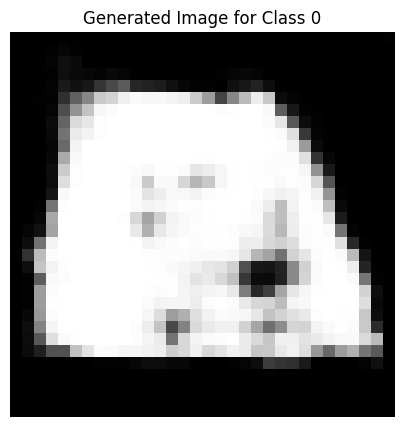

Epoch [1310/2500], D_loss: -0.05591868609189987, G_loss: -0.5450939536094666


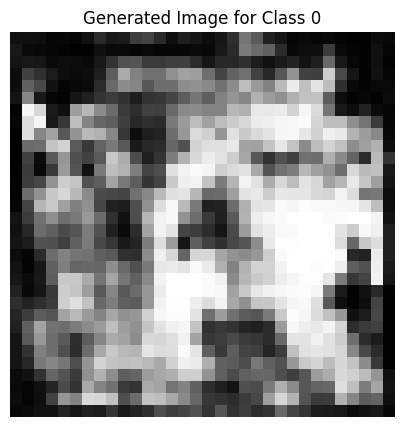

Epoch [1311/2500], D_loss: -0.0439615361392498, G_loss: -0.5921136736869812


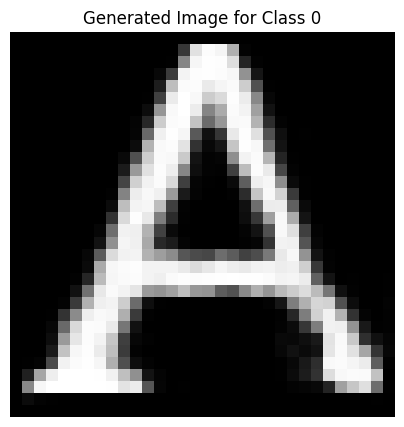

Epoch [1312/2500], D_loss: 0.021021977066993713, G_loss: -0.48500633239746094


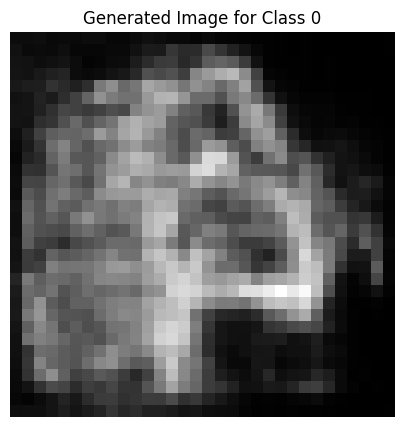

Epoch [1313/2500], D_loss: -0.03895039111375809, G_loss: -0.5334123373031616


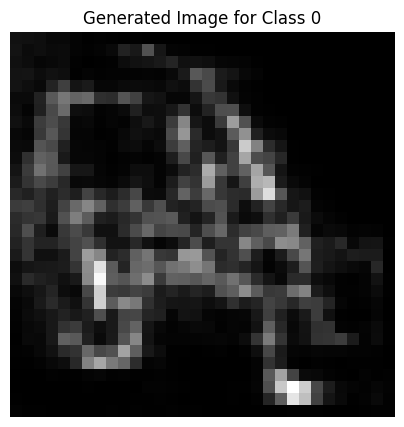

Epoch [1314/2500], D_loss: -0.06834530830383301, G_loss: -0.49290457367897034


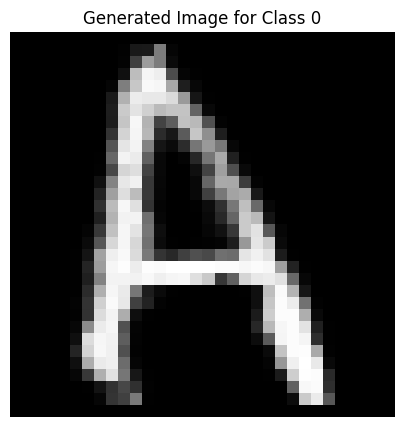

Epoch [1315/2500], D_loss: -0.01601509004831314, G_loss: -0.5251219272613525


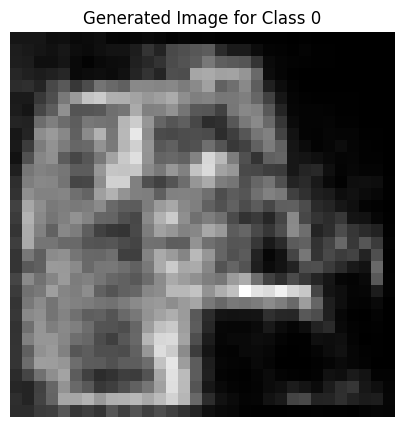

Epoch [1316/2500], D_loss: 0.08618834614753723, G_loss: -0.5593711137771606


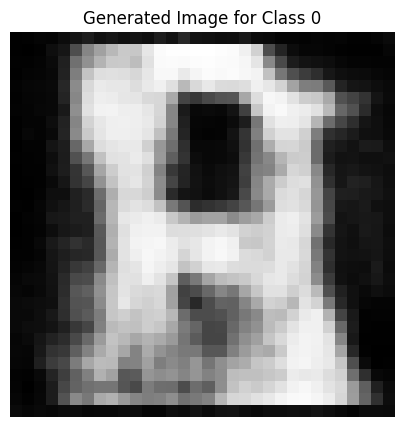

Epoch [1317/2500], D_loss: -0.04178781062364578, G_loss: -0.4993631839752197


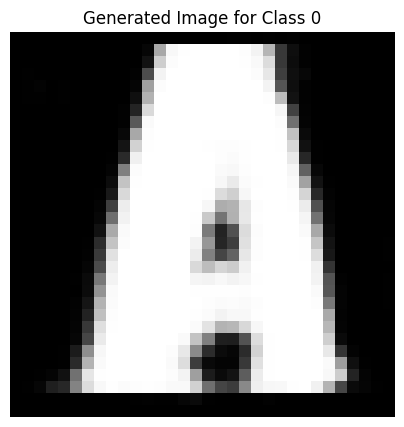

Epoch [1318/2500], D_loss: -0.049706704914569855, G_loss: -0.5820344686508179


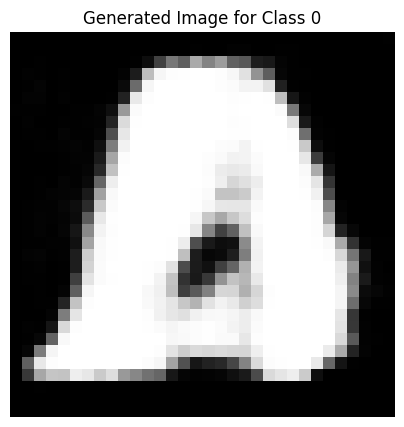

Epoch [1319/2500], D_loss: -0.0523066371679306, G_loss: -0.5715892314910889


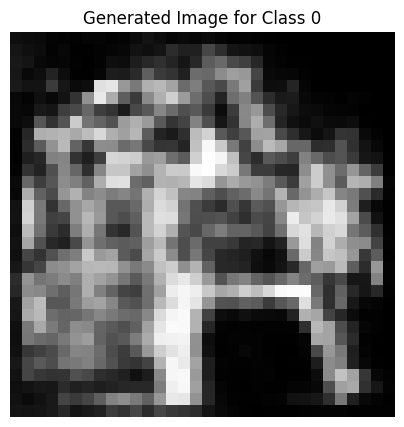

Epoch [1320/2500], D_loss: -0.04344310611486435, G_loss: -0.5532817840576172


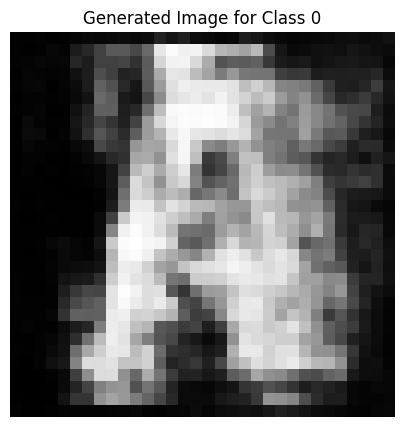

Epoch [1321/2500], D_loss: -0.03375135362148285, G_loss: -0.555896520614624


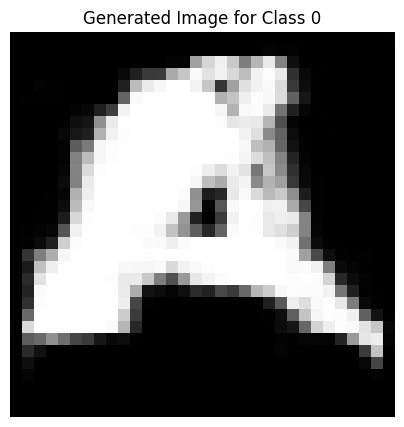

Epoch [1322/2500], D_loss: -0.04486943781375885, G_loss: -0.5340355038642883


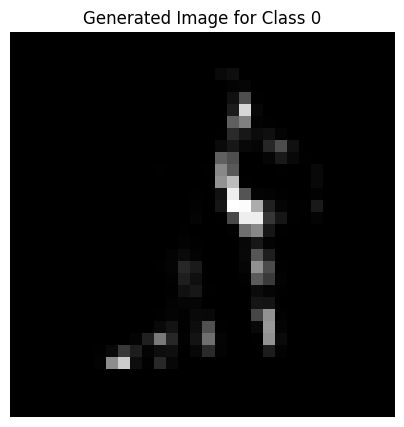

Epoch [1323/2500], D_loss: -0.0662551075220108, G_loss: -0.5289832353591919


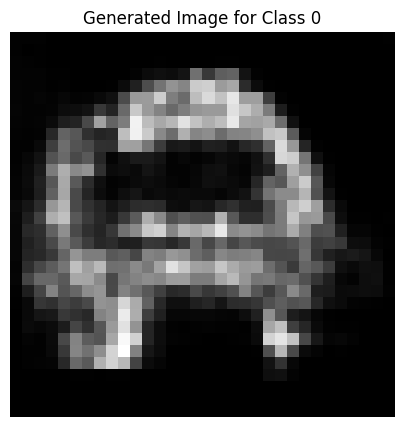

Epoch [1324/2500], D_loss: -0.059739530086517334, G_loss: -0.5922185778617859


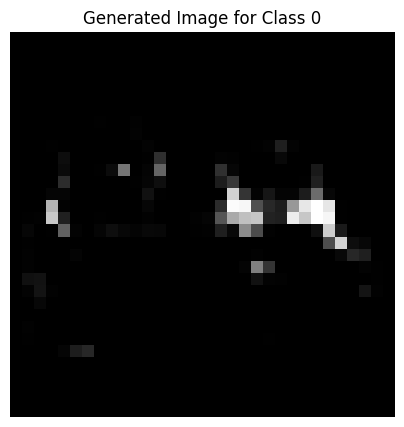

Epoch [1325/2500], D_loss: -0.047406069934368134, G_loss: -0.5937361717224121


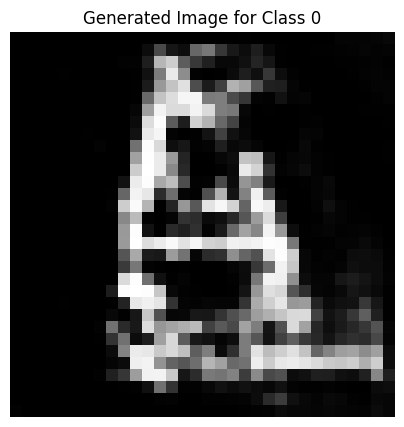

Epoch [1326/2500], D_loss: -0.04373177886009216, G_loss: -0.4395417273044586


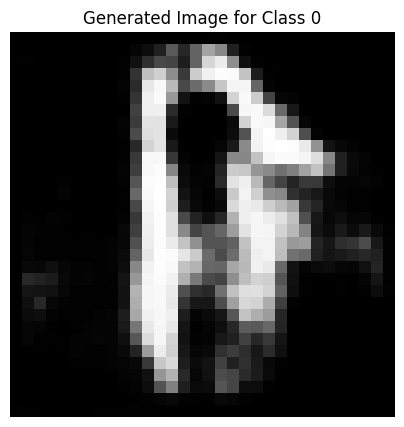

Epoch [1327/2500], D_loss: 0.25813841819763184, G_loss: -0.5387020111083984


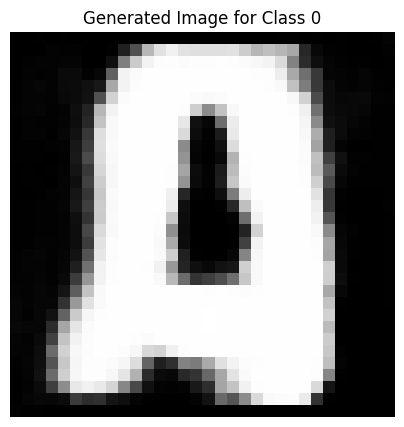

Epoch [1328/2500], D_loss: -0.05738032981753349, G_loss: -0.5423561334609985


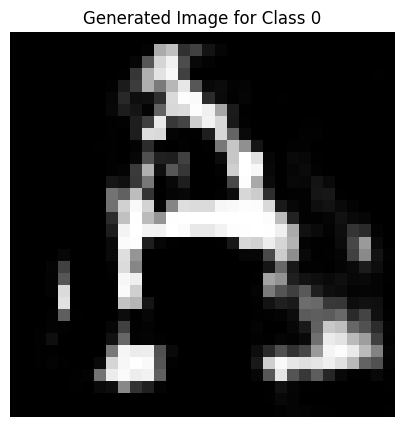

Epoch [1329/2500], D_loss: -0.023595161736011505, G_loss: -0.5691529512405396


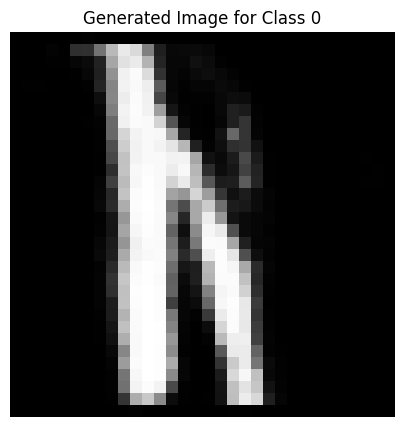

Epoch [1330/2500], D_loss: -0.043681420385837555, G_loss: -0.39451920986175537


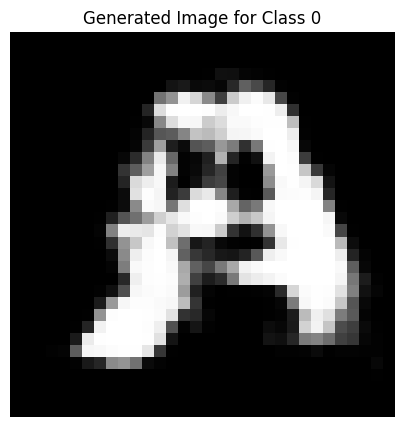

Epoch [1331/2500], D_loss: -0.0386187806725502, G_loss: -0.5422641634941101


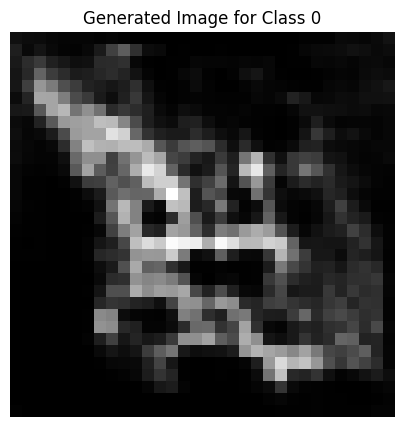

Epoch [1332/2500], D_loss: -0.04603981971740723, G_loss: -0.5545151829719543


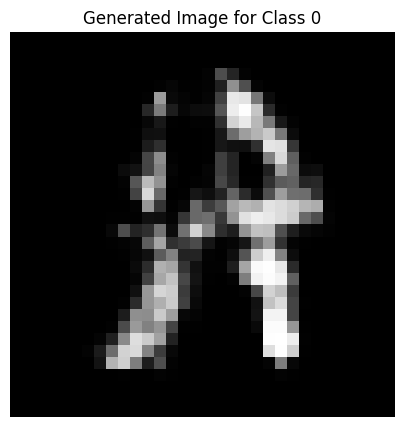

Epoch [1333/2500], D_loss: -0.03610321879386902, G_loss: -0.5752407908439636


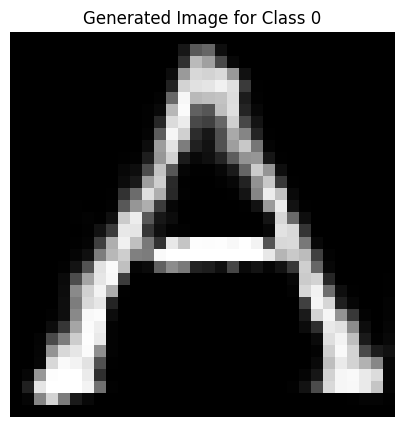

Epoch [1334/2500], D_loss: -0.05523516610264778, G_loss: -0.5185787677764893


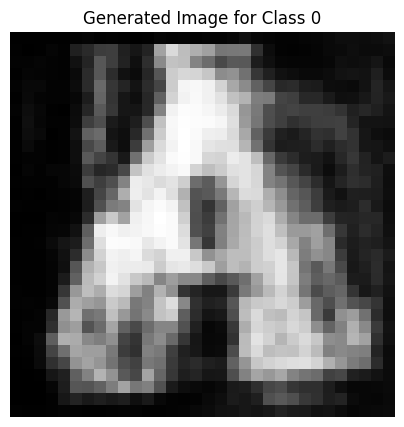

Epoch [1335/2500], D_loss: -0.05343574285507202, G_loss: -0.5441309213638306


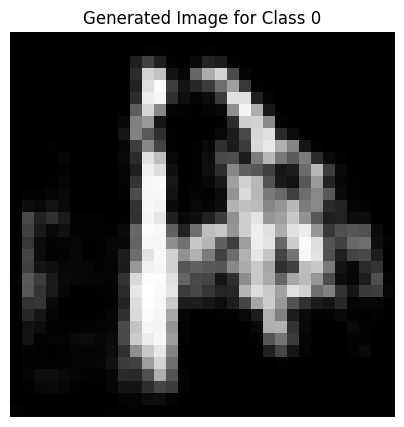

Epoch [1336/2500], D_loss: -0.03457837551832199, G_loss: -0.5335140228271484


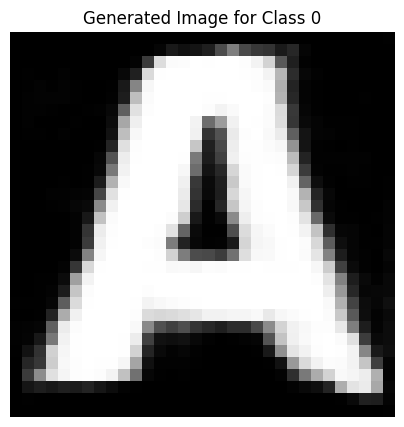

Epoch [1337/2500], D_loss: -0.05034961551427841, G_loss: -0.5622150301933289


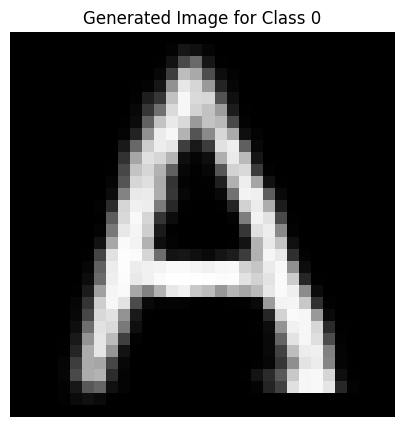

Epoch [1338/2500], D_loss: -0.0037411898374557495, G_loss: -0.5534921884536743


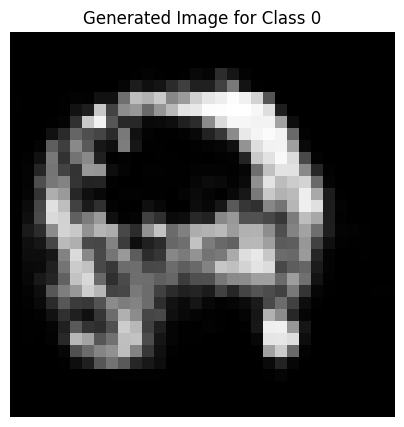

Epoch [1339/2500], D_loss: -0.024234026670455933, G_loss: -0.5203952789306641


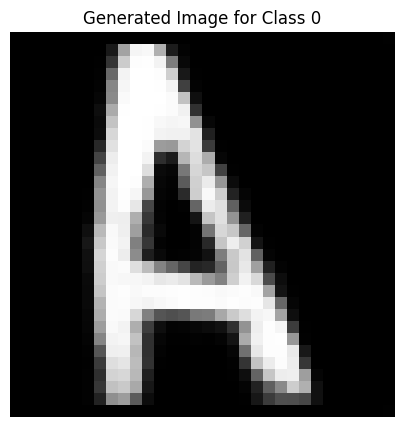

Epoch [1340/2500], D_loss: -0.04179718717932701, G_loss: -0.480895459651947


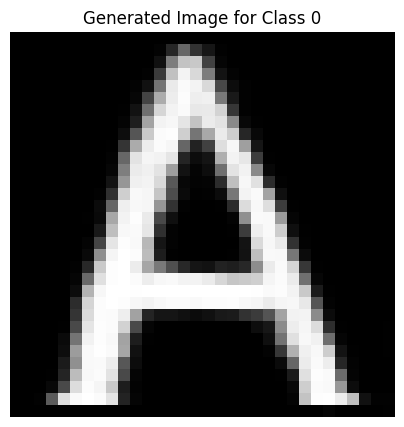

Epoch [1341/2500], D_loss: -0.018920302391052246, G_loss: -0.5343325138092041


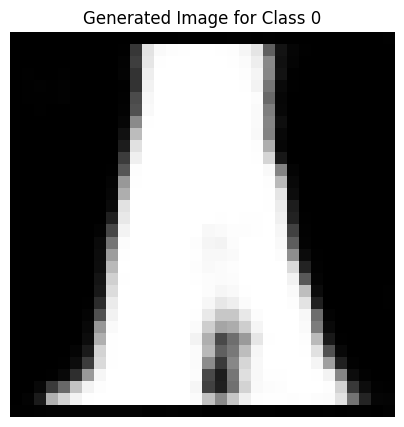

Epoch [1342/2500], D_loss: -0.03739169239997864, G_loss: -0.5393854379653931


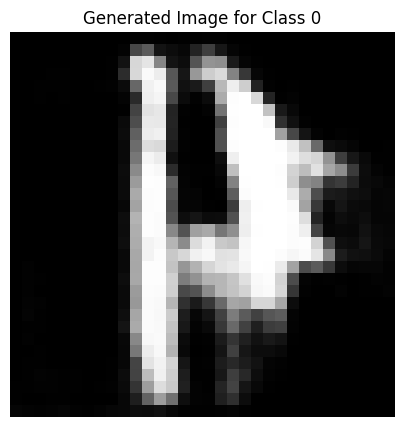

Epoch [1343/2500], D_loss: -0.06047867238521576, G_loss: -0.508569598197937


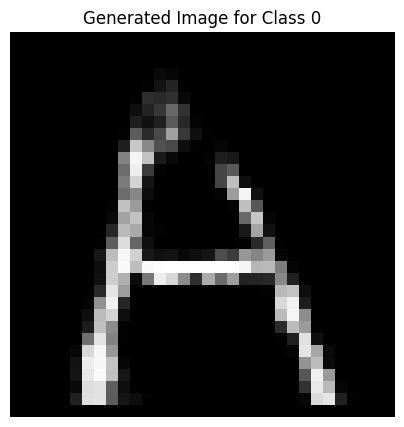

Epoch [1344/2500], D_loss: -0.043184034526348114, G_loss: -0.49705660343170166


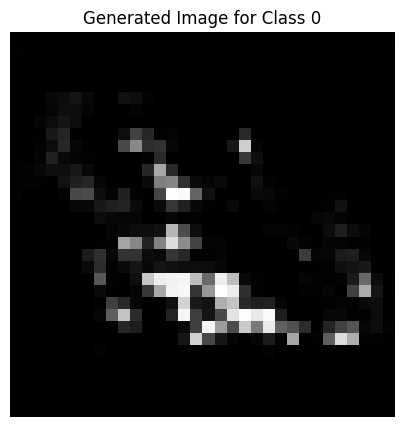

Epoch [1345/2500], D_loss: -0.0536770224571228, G_loss: -0.49069833755493164


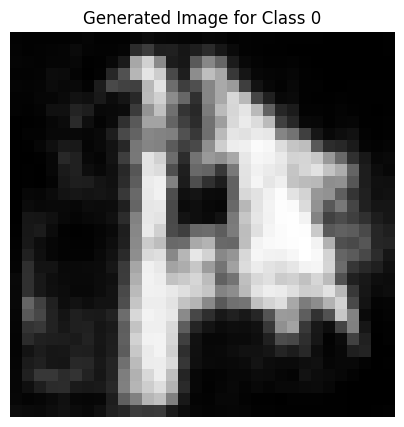

Epoch [1346/2500], D_loss: -0.03552684932947159, G_loss: -0.4907931685447693


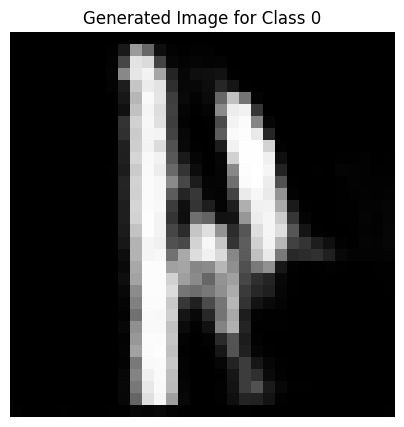

Epoch [1347/2500], D_loss: -0.02190577983856201, G_loss: -0.5804896950721741


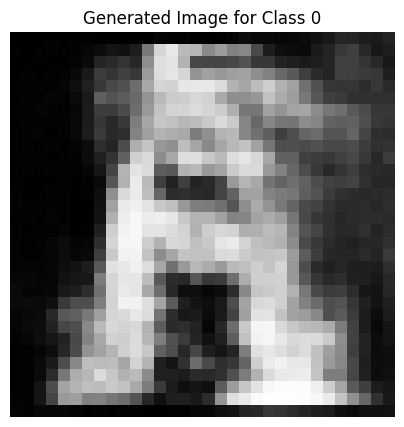

Epoch [1348/2500], D_loss: -0.06155511736869812, G_loss: -0.5209535360336304


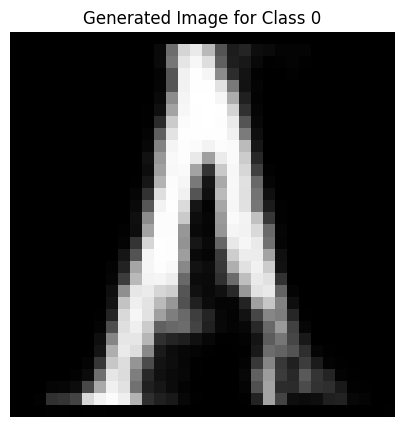

Epoch [1349/2500], D_loss: -0.0543951690196991, G_loss: -0.566633939743042


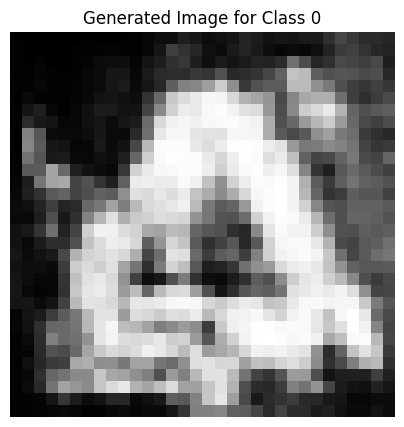

Epoch [1350/2500], D_loss: -0.056118808686733246, G_loss: -0.566292405128479


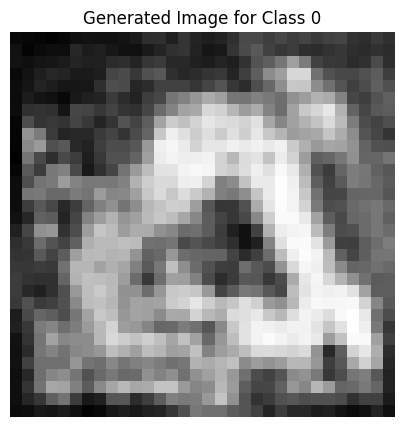

Epoch [1351/2500], D_loss: -0.060481078922748566, G_loss: -0.5016118288040161


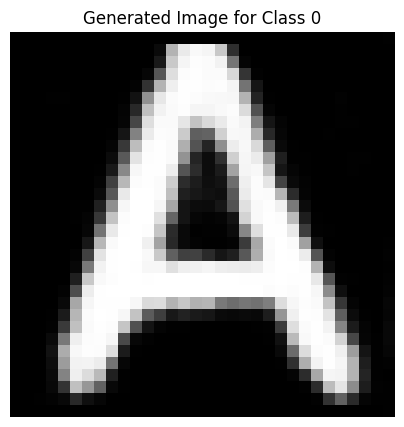

Epoch [1352/2500], D_loss: -0.05187145620584488, G_loss: -0.5276415348052979


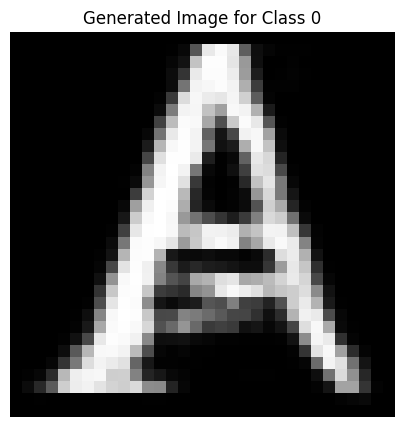

Epoch [1353/2500], D_loss: -0.03780582547187805, G_loss: -0.5450887084007263


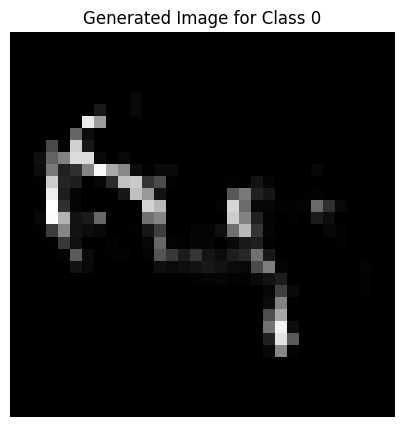

Epoch [1354/2500], D_loss: -0.055888574570417404, G_loss: -0.4287636876106262


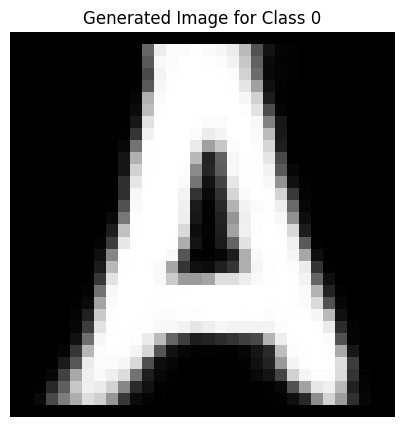

Epoch [1355/2500], D_loss: -0.011134453117847443, G_loss: -0.49542006850242615


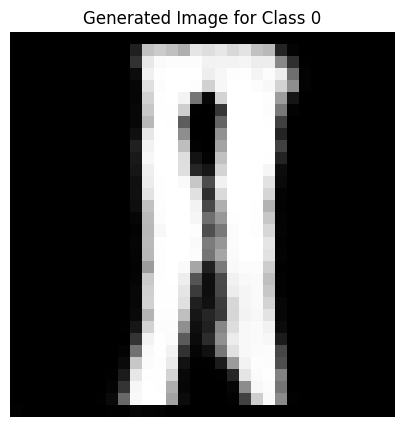

Epoch [1356/2500], D_loss: -0.05878742039203644, G_loss: -0.5297601222991943


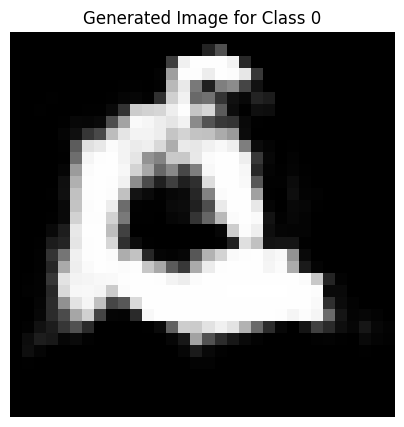

Epoch [1357/2500], D_loss: -0.05079659819602966, G_loss: -0.5761444568634033


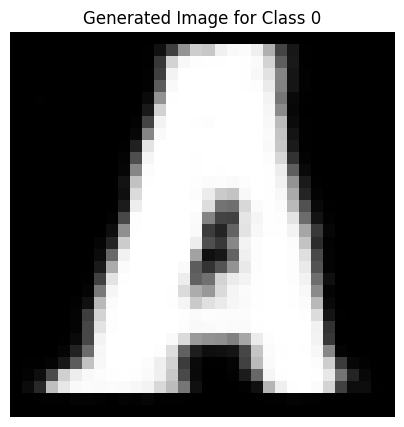

Epoch [1358/2500], D_loss: -0.05400116741657257, G_loss: -0.5277575254440308


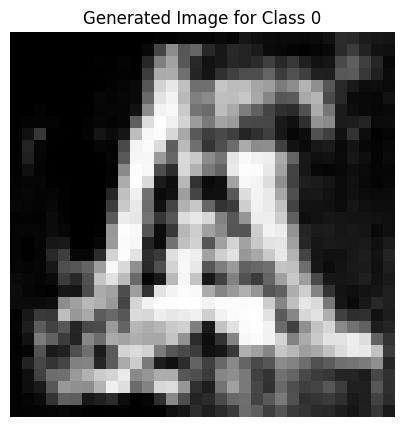

Epoch [1359/2500], D_loss: -0.05665002763271332, G_loss: -0.5641968846321106


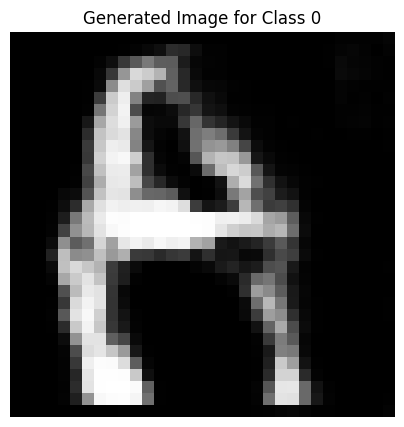

Epoch [1360/2500], D_loss: -0.030492037534713745, G_loss: -0.44340234994888306


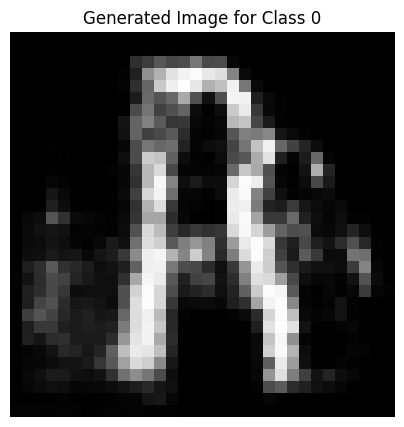

Epoch [1361/2500], D_loss: -0.05096057802438736, G_loss: -0.5683245658874512


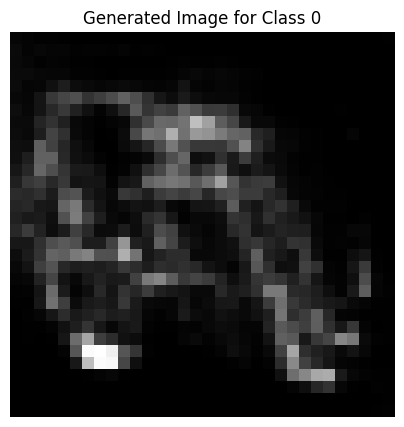

Epoch [1362/2500], D_loss: -0.009075924754142761, G_loss: -0.6105497479438782


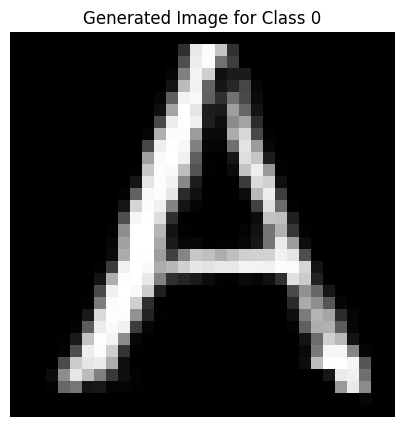

Epoch [1363/2500], D_loss: -0.05490667372941971, G_loss: -0.475941002368927


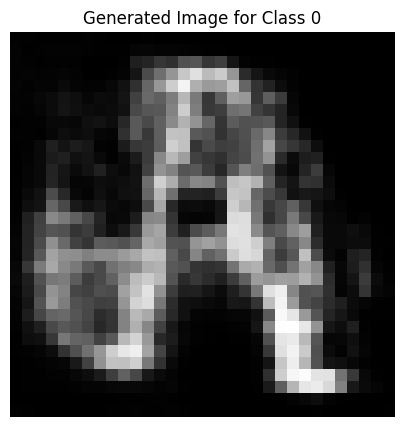

Epoch [1364/2500], D_loss: -0.008567437529563904, G_loss: -0.49323248863220215


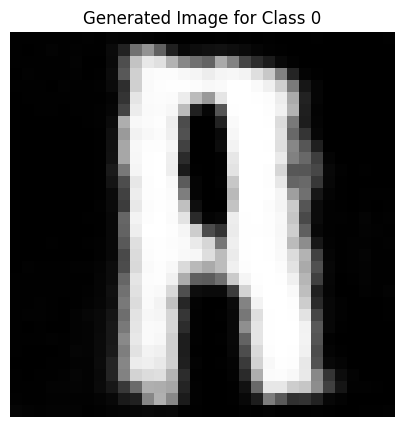

Epoch [1365/2500], D_loss: -0.06534992158412933, G_loss: -0.5068225860595703


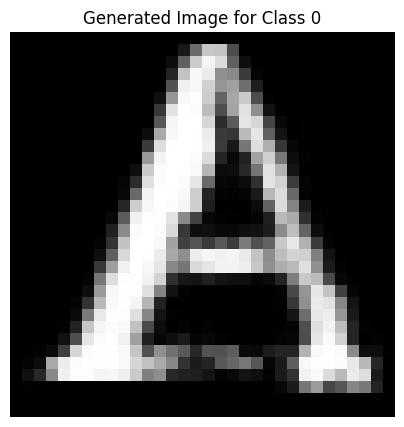

Epoch [1366/2500], D_loss: -0.04042718559503555, G_loss: -0.5241565108299255


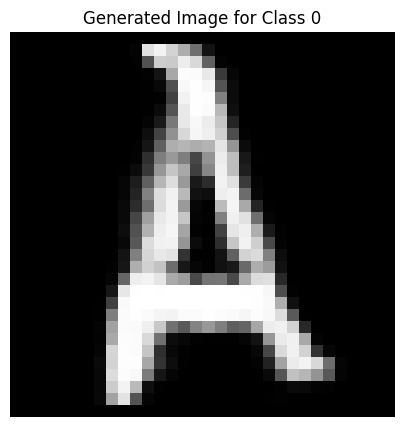

Epoch [1367/2500], D_loss: -0.035238124430179596, G_loss: -0.3993449807167053


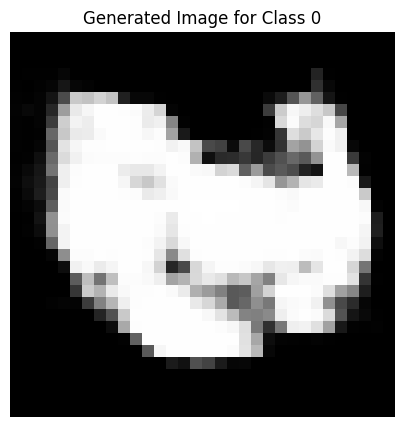

Epoch [1368/2500], D_loss: -0.07662206888198853, G_loss: -0.5322766900062561


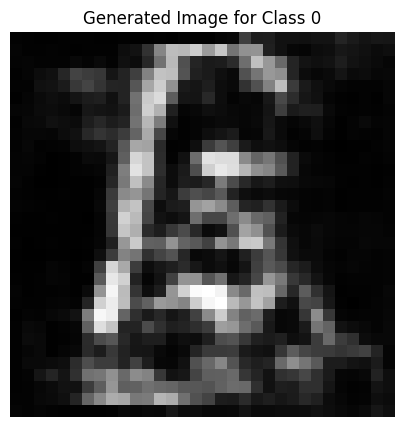

Epoch [1369/2500], D_loss: -0.05872626602649689, G_loss: -0.5053727030754089


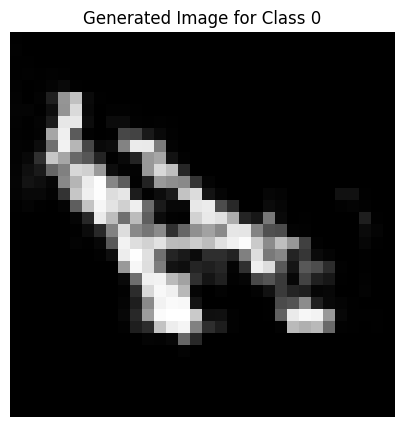

Epoch [1370/2500], D_loss: -0.040112853050231934, G_loss: -0.5205032229423523


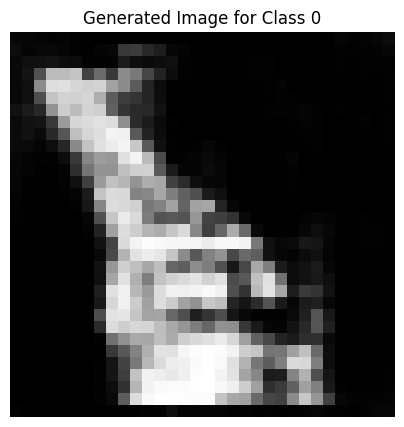

Epoch [1371/2500], D_loss: -0.037691839039325714, G_loss: -0.5708168148994446


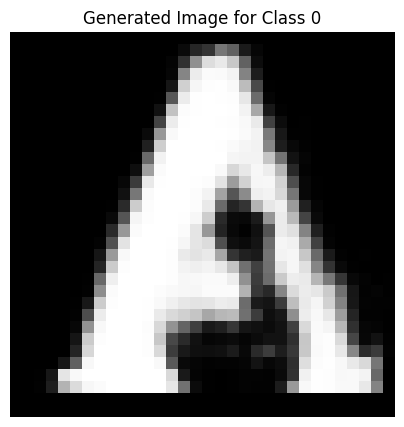

Epoch [1372/2500], D_loss: -0.051340386271476746, G_loss: -0.5898089408874512


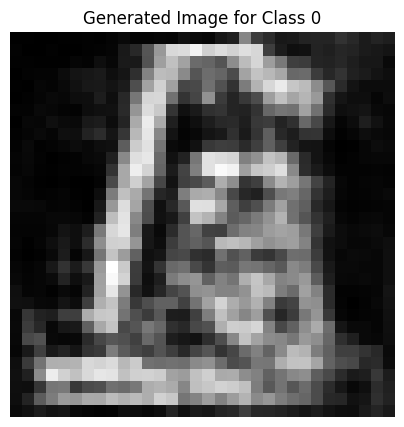

Epoch [1373/2500], D_loss: -0.05834927409887314, G_loss: -0.5102696418762207


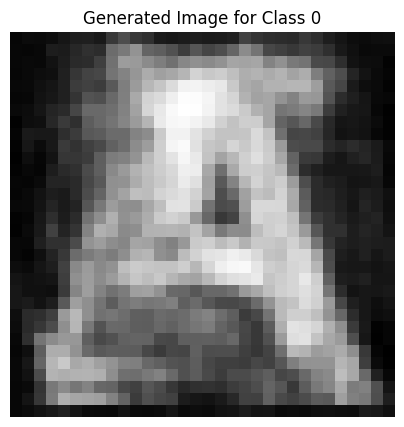

Epoch [1374/2500], D_loss: -0.009261086583137512, G_loss: -0.47963348031044006


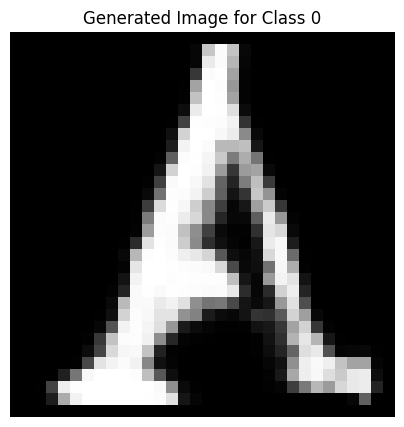

Epoch [1375/2500], D_loss: -0.0733848512172699, G_loss: -0.4717140793800354


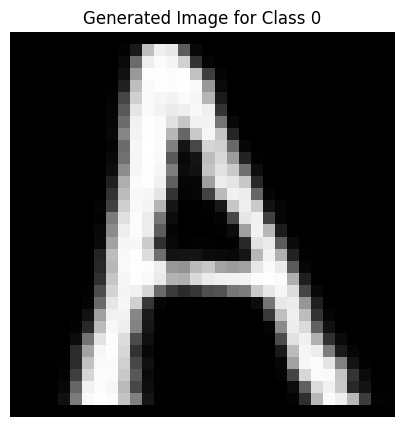

Epoch [1376/2500], D_loss: -0.049281828105449677, G_loss: -0.5310618877410889


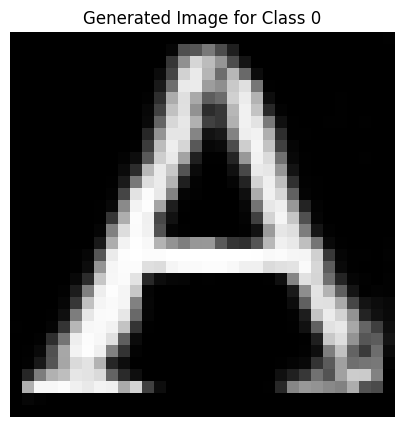

Epoch [1377/2500], D_loss: -0.023607507348060608, G_loss: -0.6655236482620239


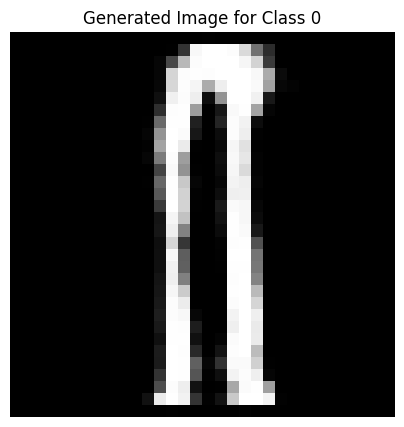

Epoch [1378/2500], D_loss: -0.031662315130233765, G_loss: -0.5141781568527222


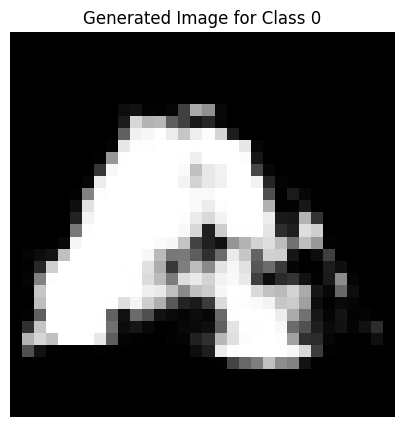

Epoch [1379/2500], D_loss: -0.05233349651098251, G_loss: -0.516486644744873


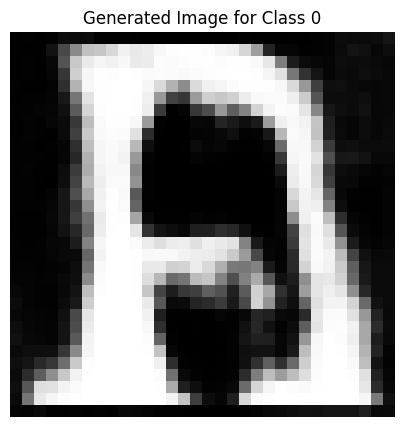

Epoch [1380/2500], D_loss: -0.05161839723587036, G_loss: -0.4717974364757538


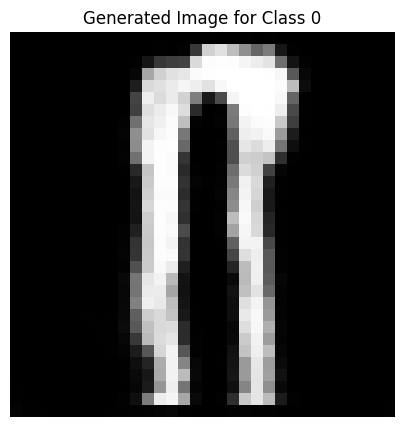

Epoch [1381/2500], D_loss: -0.04867875576019287, G_loss: -0.4810299873352051


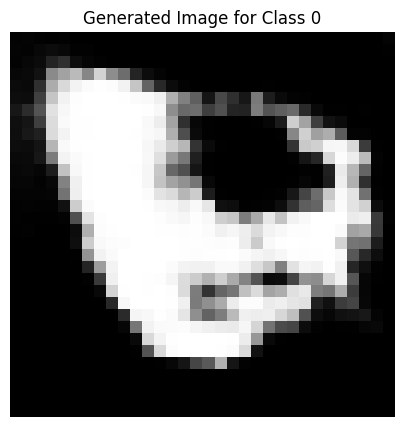

Epoch [1382/2500], D_loss: -0.02368384599685669, G_loss: -0.5260745882987976


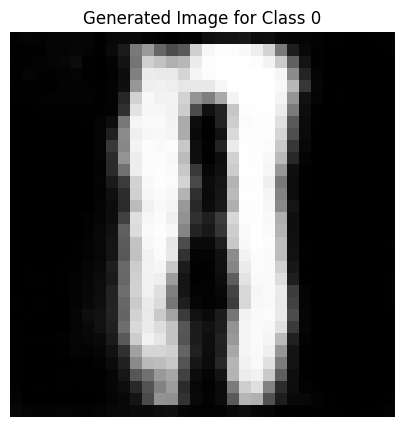

Epoch [1383/2500], D_loss: -0.029470250010490417, G_loss: -0.517554759979248


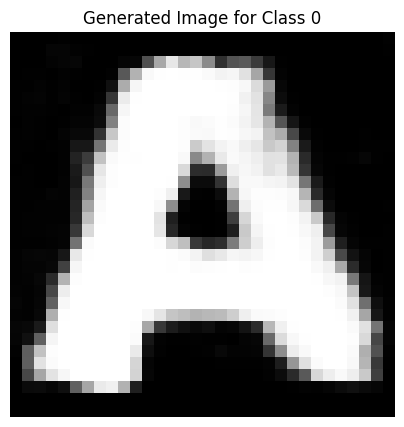

Epoch [1384/2500], D_loss: -0.011491954326629639, G_loss: -0.5149925351142883


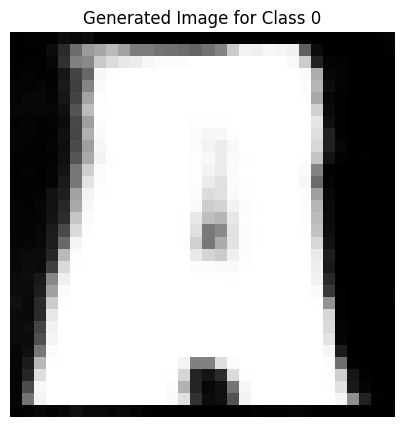

Epoch [1385/2500], D_loss: -0.04291217029094696, G_loss: -0.5434023141860962


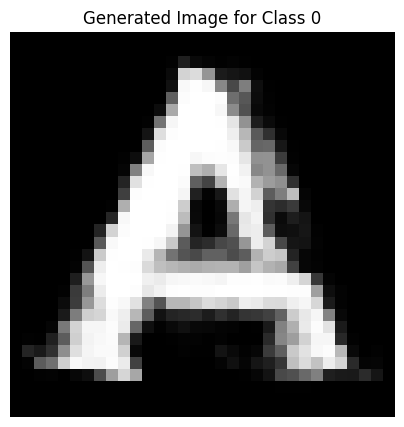

Epoch [1386/2500], D_loss: -0.030545085668563843, G_loss: -0.47262269258499146


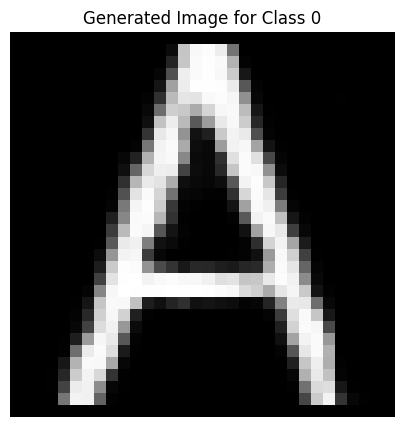

Epoch [1387/2500], D_loss: -0.05699259042739868, G_loss: -0.5349620580673218


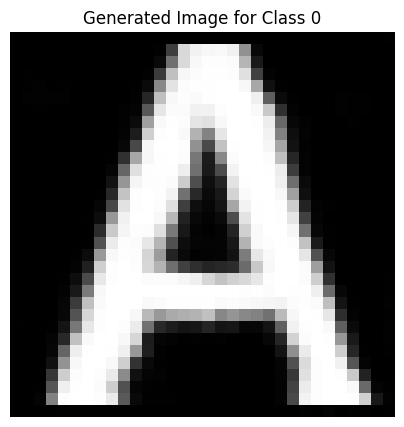

Epoch [1388/2500], D_loss: -0.017770536243915558, G_loss: -0.5791904926300049


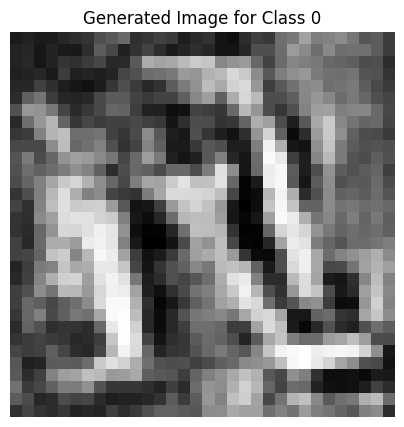

Epoch [1389/2500], D_loss: -0.03443761169910431, G_loss: -0.5237067937850952


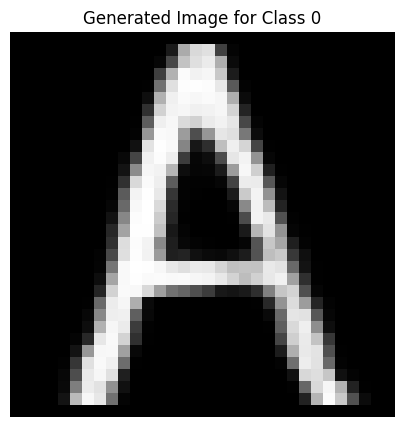

Epoch [1390/2500], D_loss: -0.03442850708961487, G_loss: -0.5639361143112183


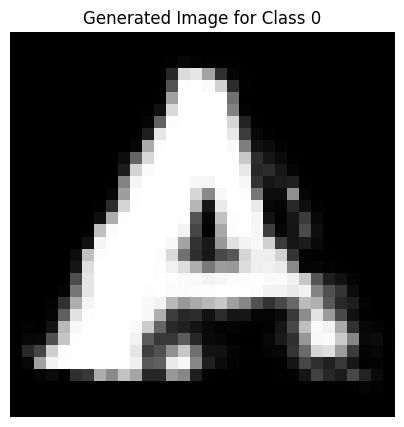

Epoch [1391/2500], D_loss: -0.0504276379942894, G_loss: -0.4887353777885437


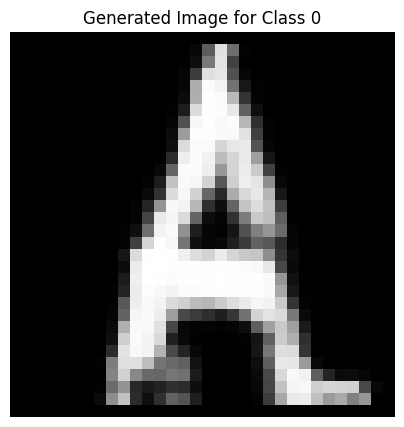

Epoch [1392/2500], D_loss: -0.03807356208562851, G_loss: -0.519072413444519


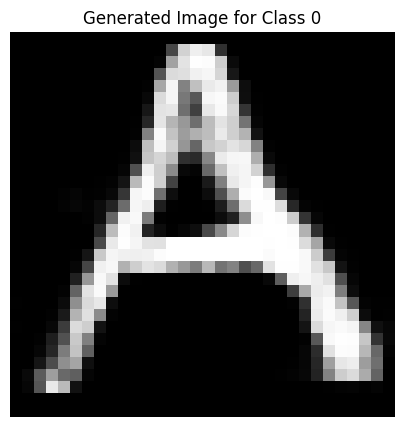

Epoch [1393/2500], D_loss: -0.03486064821481705, G_loss: -0.5161762237548828


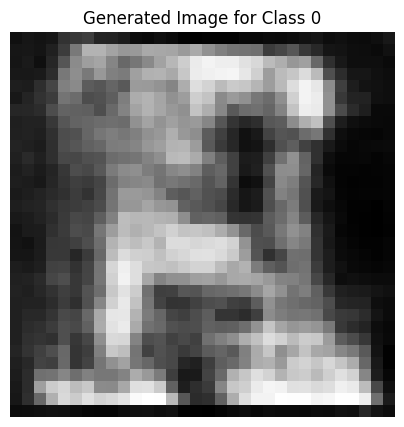

Epoch [1394/2500], D_loss: -0.037865087389945984, G_loss: -0.5237528085708618


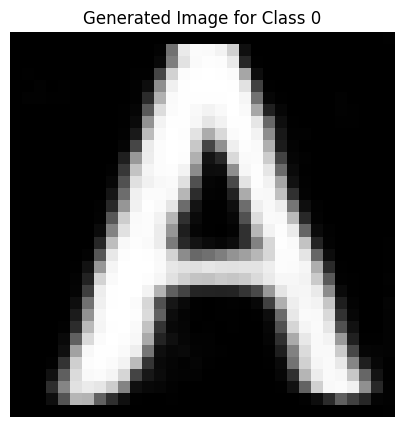

Epoch [1395/2500], D_loss: -0.027933716773986816, G_loss: -0.5228257179260254


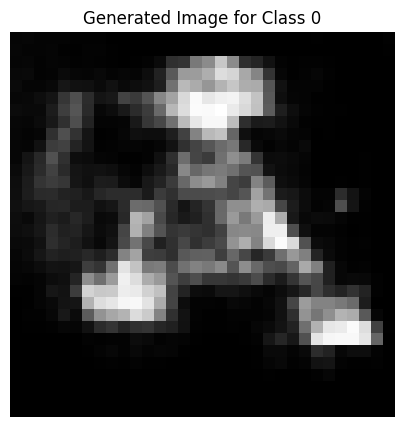

Epoch [1396/2500], D_loss: -0.04905217885971069, G_loss: -0.5935320258140564


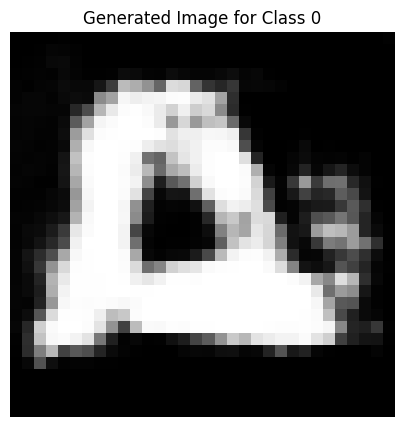

Epoch [1397/2500], D_loss: -0.06308858841657639, G_loss: -0.5638637542724609


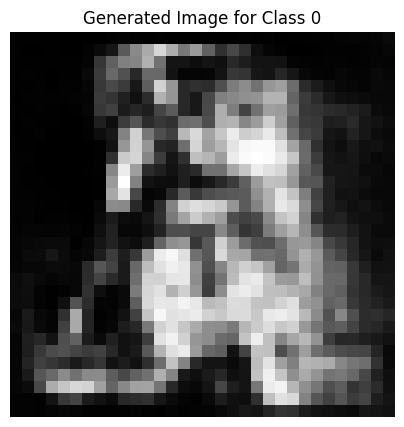

Epoch [1398/2500], D_loss: -0.06547176837921143, G_loss: -0.5400997400283813


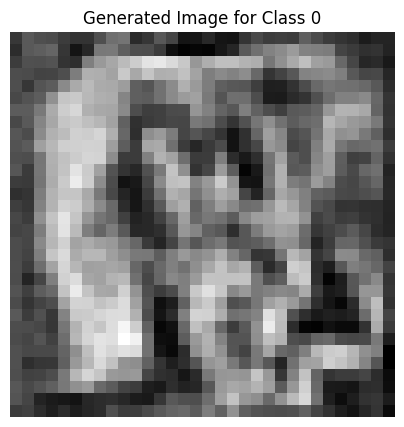

Epoch [1399/2500], D_loss: -0.04073280841112137, G_loss: -0.5517768859863281


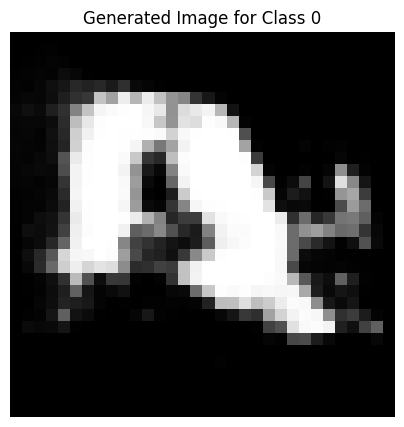

Epoch [1400/2500], D_loss: -0.054693616926670074, G_loss: -0.5175048112869263


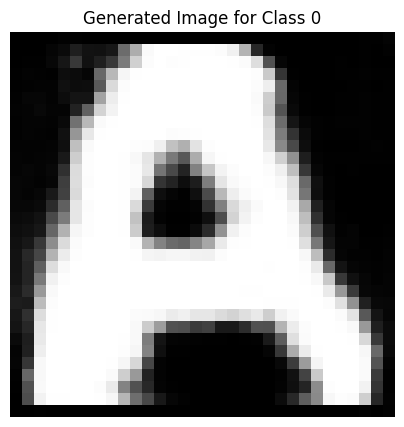

Epoch [1401/2500], D_loss: -0.03378742188215256, G_loss: -0.4008427858352661


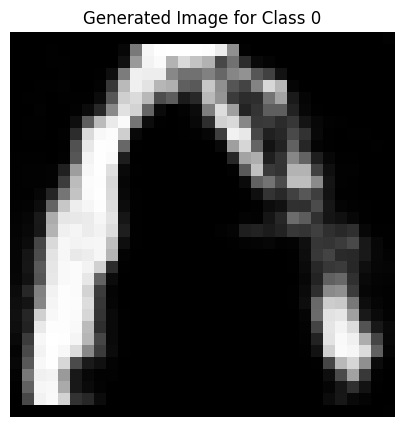

Epoch [1402/2500], D_loss: -0.04158535599708557, G_loss: -0.4625065326690674


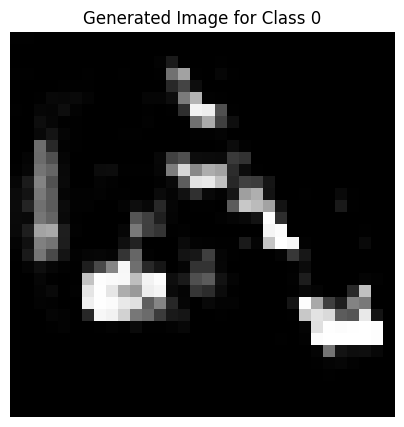

Epoch [1403/2500], D_loss: -0.060490407049655914, G_loss: -0.5774612426757812


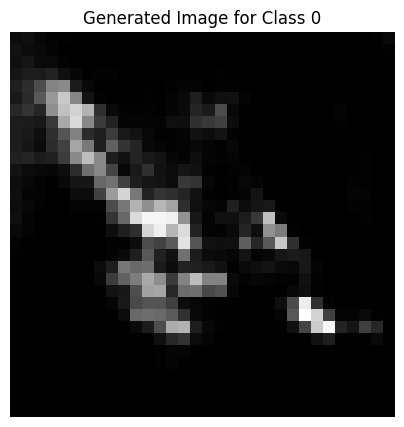

Epoch [1404/2500], D_loss: -0.028731435537338257, G_loss: -0.515326738357544


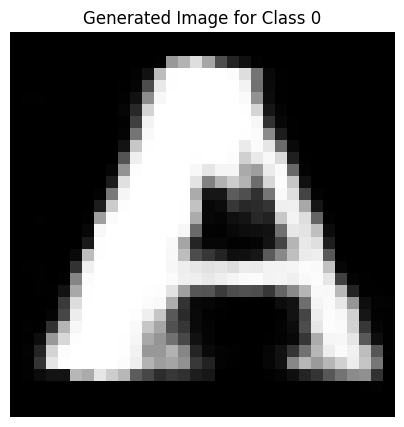

Epoch [1405/2500], D_loss: -0.05965455621480942, G_loss: -0.5537499189376831


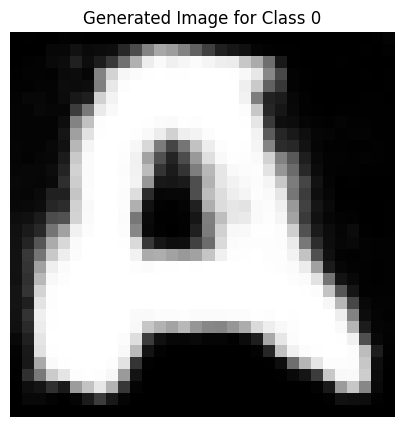

Epoch [1406/2500], D_loss: -0.017139270901679993, G_loss: -0.5727423429489136


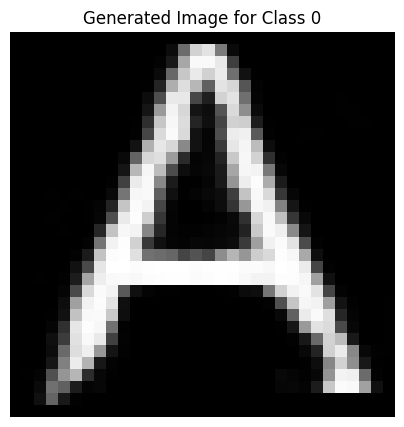

Epoch [1407/2500], D_loss: -0.06365659832954407, G_loss: -0.5364702343940735


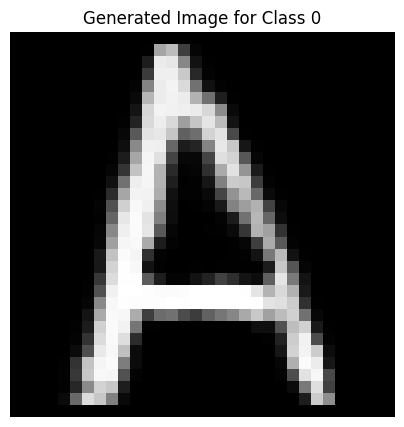

Epoch [1408/2500], D_loss: -0.0347626656293869, G_loss: -0.5211892127990723


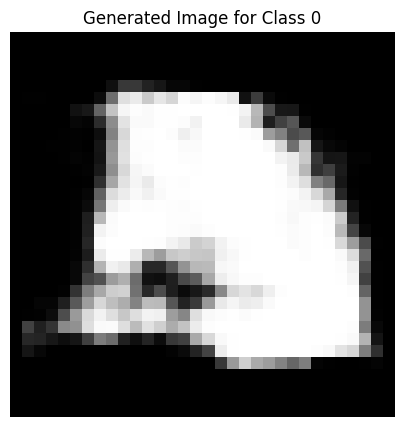

Epoch [1409/2500], D_loss: -0.054234497249126434, G_loss: -0.51700359582901


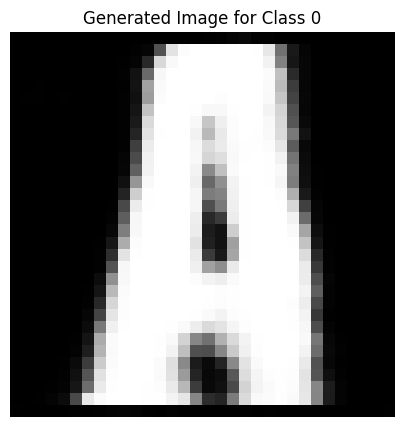

Epoch [1410/2500], D_loss: -0.05934397876262665, G_loss: -0.5370057821273804


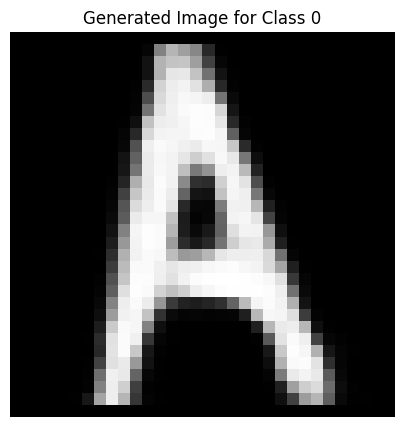

Epoch [1411/2500], D_loss: -0.012854821979999542, G_loss: -0.5621901750564575


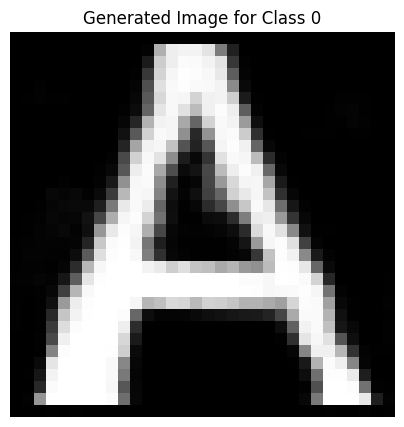

Epoch [1412/2500], D_loss: -0.07801717519760132, G_loss: -0.5844271183013916


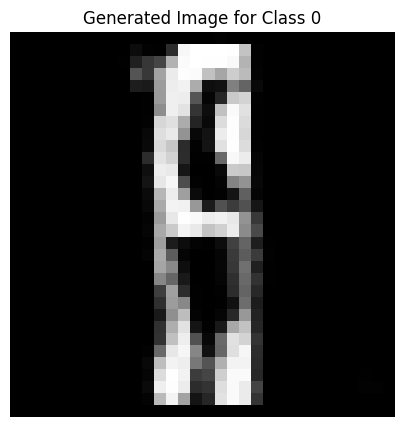

Epoch [1413/2500], D_loss: -0.05305546522140503, G_loss: -0.3518030643463135


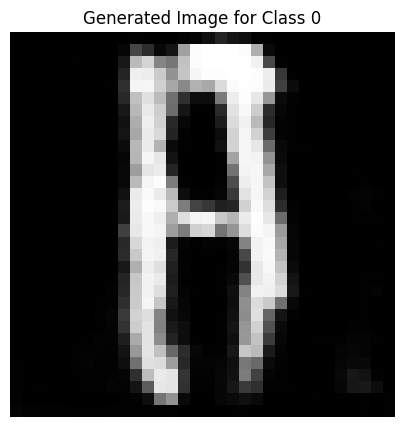

Epoch [1414/2500], D_loss: -0.0669873058795929, G_loss: -0.5361769795417786


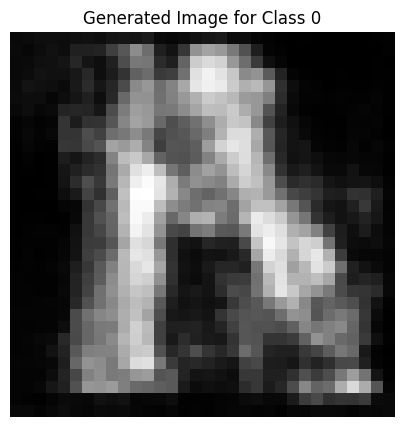

Epoch [1415/2500], D_loss: -0.052580833435058594, G_loss: -0.49883776903152466


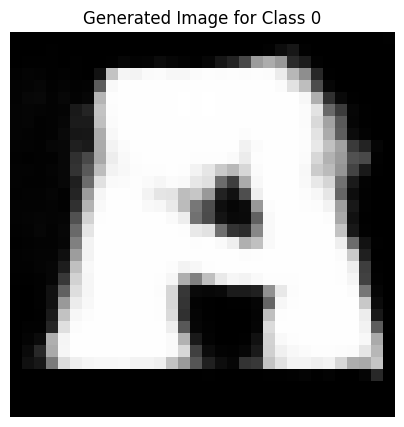

Epoch [1416/2500], D_loss: -0.018456384539604187, G_loss: -0.6731566190719604


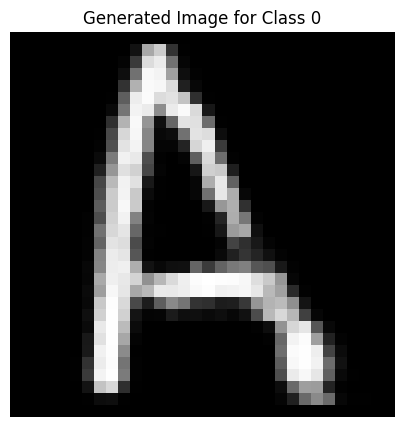

Epoch [1417/2500], D_loss: -0.035568058490753174, G_loss: -0.5444958209991455


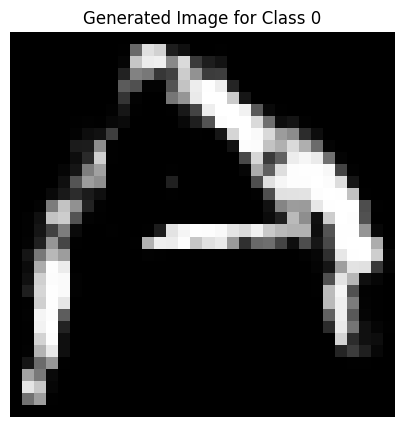

Epoch [1418/2500], D_loss: -0.003943361341953278, G_loss: -0.4841359257698059


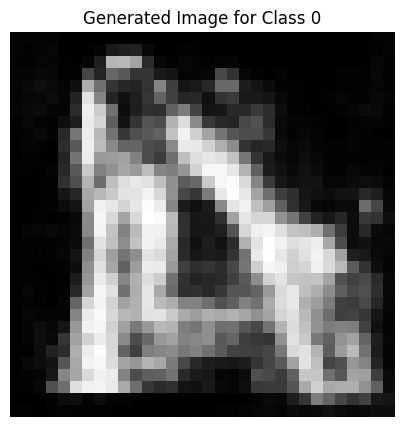

Epoch [1419/2500], D_loss: -0.06471174955368042, G_loss: -0.5419116020202637


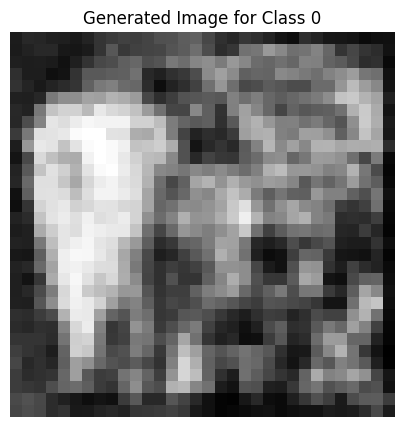

Epoch [1420/2500], D_loss: -0.057230859994888306, G_loss: -0.4812641441822052


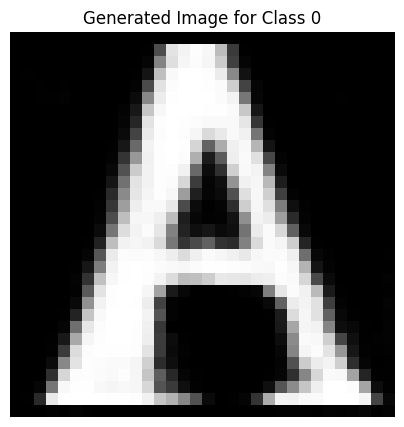

Epoch [1421/2500], D_loss: -0.052895158529281616, G_loss: -0.517791748046875


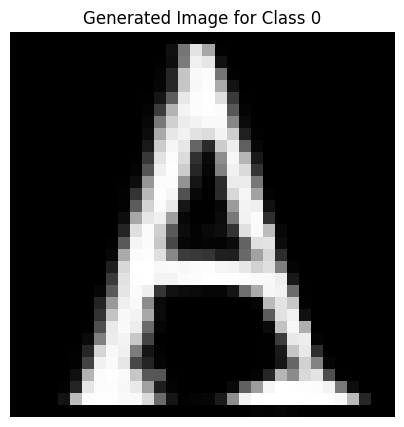

Epoch [1422/2500], D_loss: -0.053285352885723114, G_loss: -0.5417066812515259


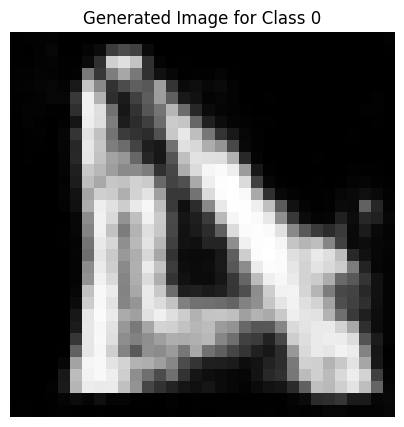

Epoch [1423/2500], D_loss: -0.06724192947149277, G_loss: -0.4885472357273102


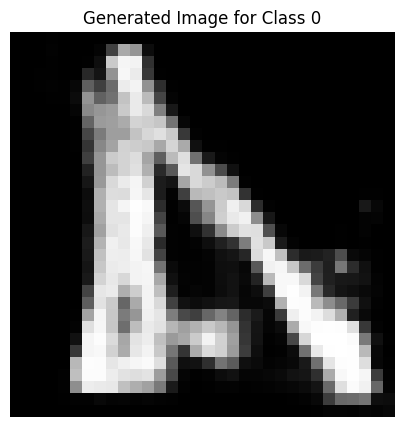

Epoch [1424/2500], D_loss: -0.048885807394981384, G_loss: -0.5351908802986145


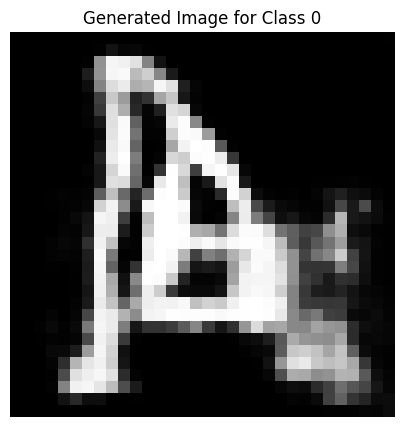

Epoch [1425/2500], D_loss: -0.06579160690307617, G_loss: -0.456792950630188


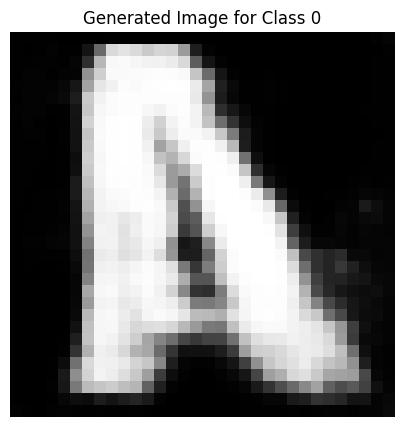

Epoch [1426/2500], D_loss: -0.023996911942958832, G_loss: -0.49334806203842163


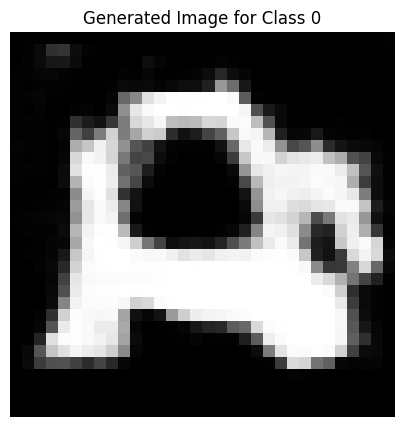

Epoch [1427/2500], D_loss: -0.05321137607097626, G_loss: -0.5249935984611511


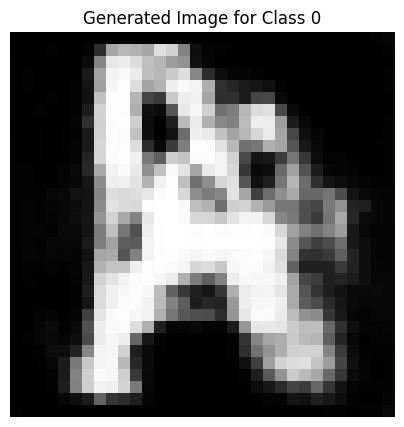

Epoch [1428/2500], D_loss: -0.04779275506734848, G_loss: -0.522763192653656


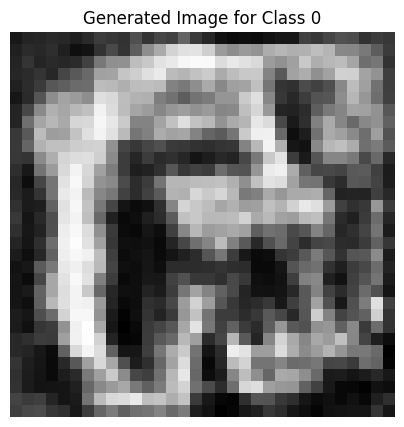

Epoch [1429/2500], D_loss: -0.06386056542396545, G_loss: -0.5497190952301025


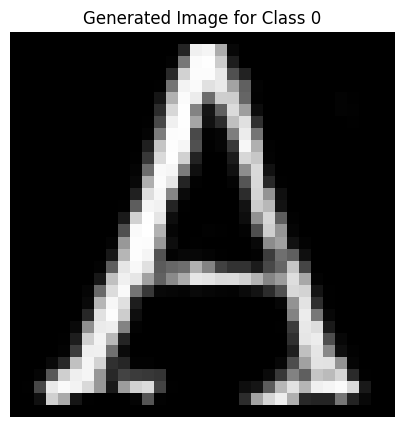

Epoch [1430/2500], D_loss: -0.05881400406360626, G_loss: -0.5438127517700195


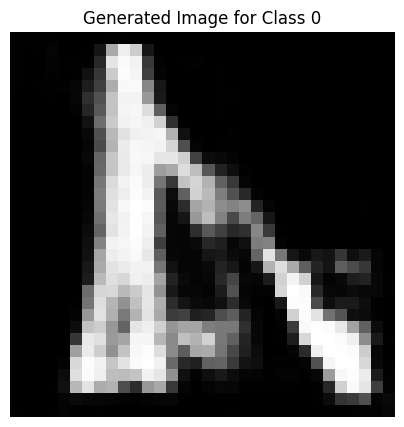

Epoch [1431/2500], D_loss: -0.010611087083816528, G_loss: -0.526071310043335


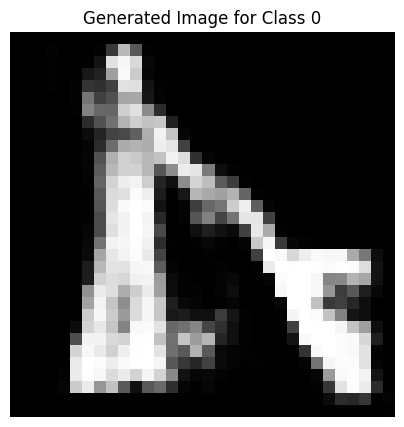

Epoch [1432/2500], D_loss: -0.06006619334220886, G_loss: -0.5468686819076538


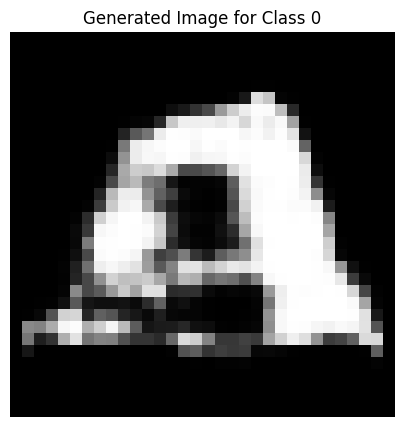

Epoch [1433/2500], D_loss: -0.003435872495174408, G_loss: -0.539792001247406


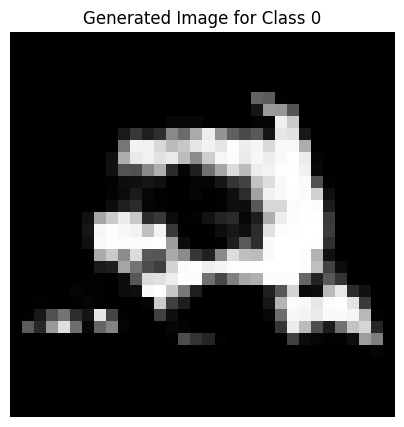

Epoch [1434/2500], D_loss: -0.06869277358055115, G_loss: -0.46280765533447266


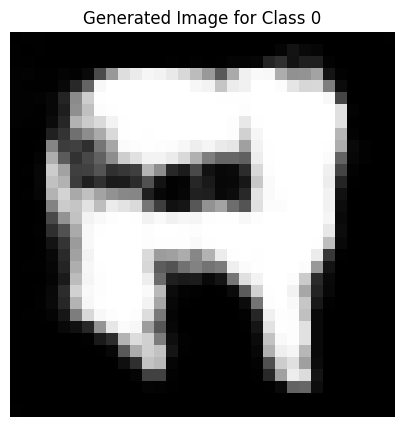

Epoch [1435/2500], D_loss: -0.06551031768321991, G_loss: -0.4767377972602844


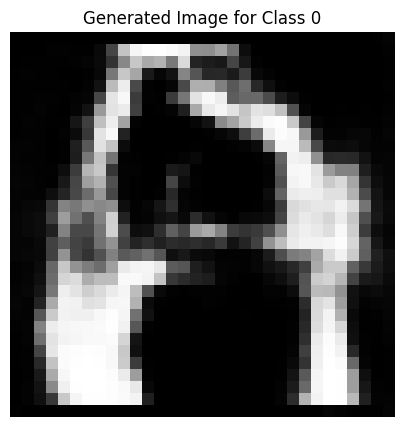

Epoch [1436/2500], D_loss: -0.016556695103645325, G_loss: -0.48996925354003906


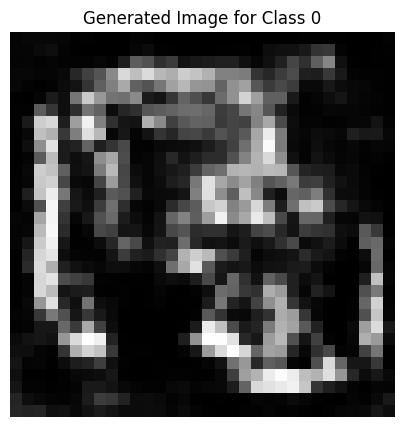

Epoch [1437/2500], D_loss: -0.060539789497852325, G_loss: -0.49425676465034485


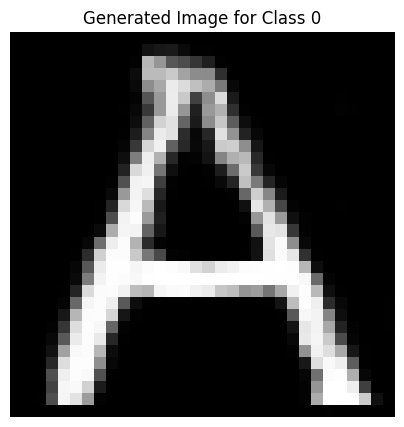

Epoch [1438/2500], D_loss: -0.06992495059967041, G_loss: -0.4379594027996063


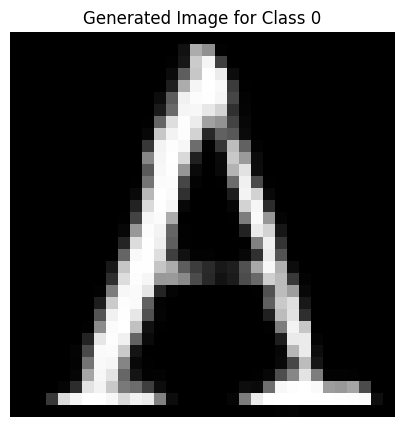

Epoch [1439/2500], D_loss: -0.06254221498966217, G_loss: -0.4743925929069519


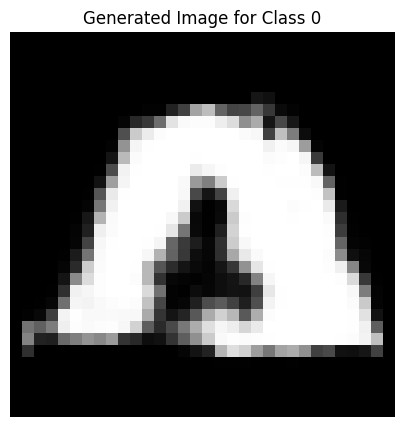

Epoch [1440/2500], D_loss: -0.07760506868362427, G_loss: -0.4349272549152374


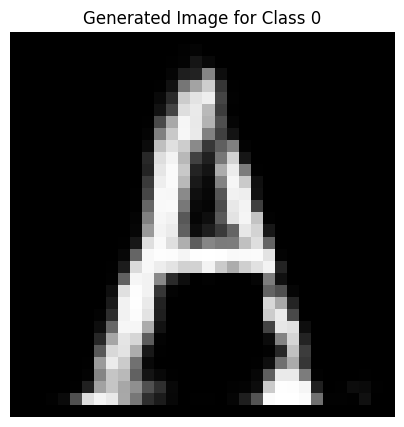

Epoch [1441/2500], D_loss: -0.06498020887374878, G_loss: -0.5484330654144287


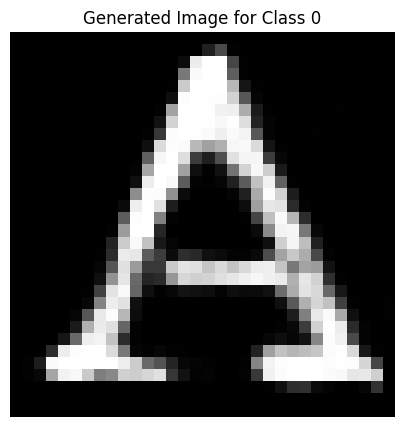

Epoch [1442/2500], D_loss: -0.05527897924184799, G_loss: -0.5234144330024719


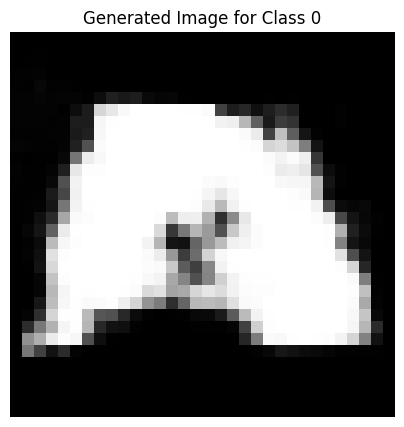

Epoch [1443/2500], D_loss: -0.06910089403390884, G_loss: -0.5179752111434937


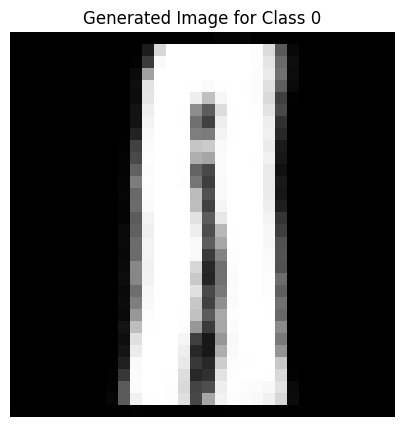

Epoch [1444/2500], D_loss: -0.06030258536338806, G_loss: -0.4476739764213562


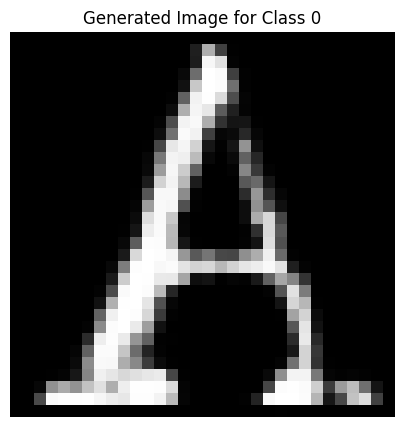

Epoch [1445/2500], D_loss: -0.07874482870101929, G_loss: -0.5358719825744629


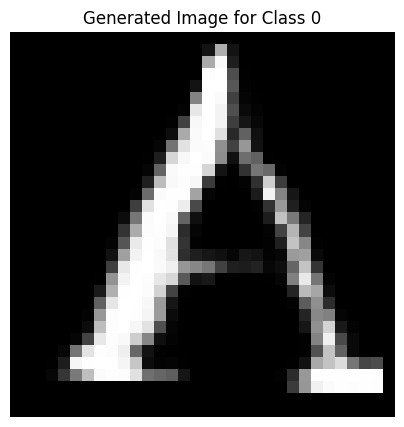

Epoch [1446/2500], D_loss: -0.06744298338890076, G_loss: -0.4355854392051697


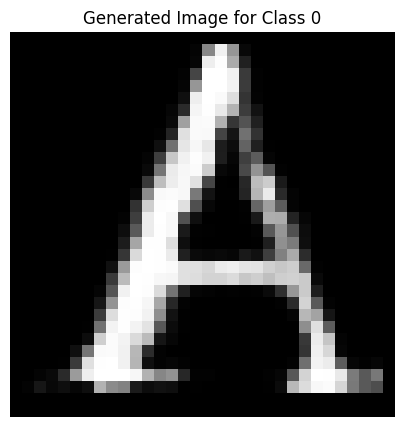

Epoch [1447/2500], D_loss: -0.06909012049436569, G_loss: -0.4918504059314728


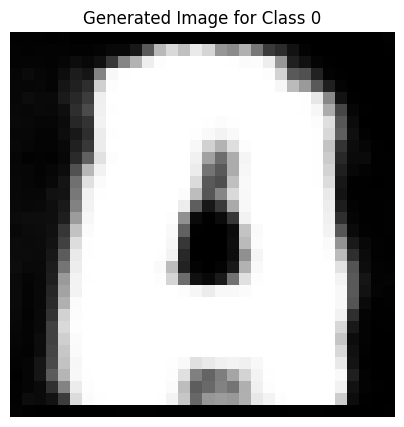

Epoch [1448/2500], D_loss: -0.04364251345396042, G_loss: -0.510411262512207


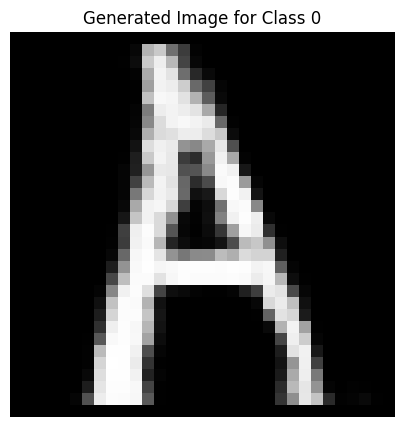

Epoch [1449/2500], D_loss: -0.04629421979188919, G_loss: -0.5923846960067749


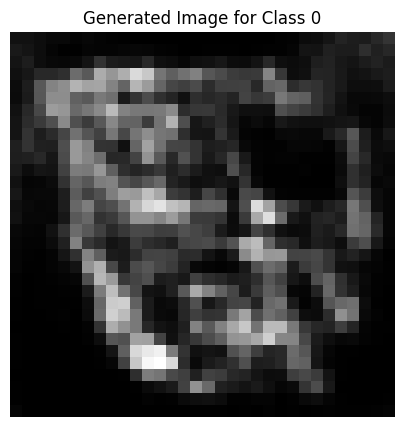

Epoch [1450/2500], D_loss: -0.04441959410905838, G_loss: -0.5204002857208252


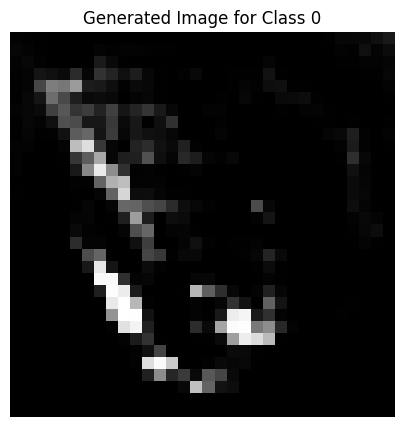

Epoch [1451/2500], D_loss: -0.024323880672454834, G_loss: -0.7076146006584167


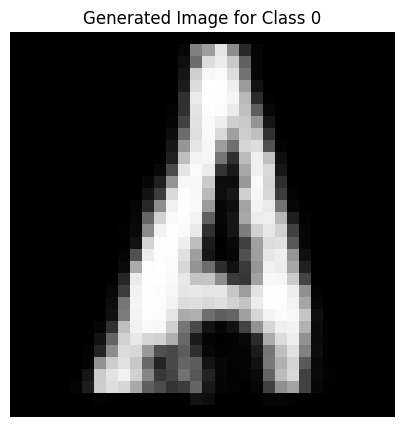

Epoch [1452/2500], D_loss: -0.013934016227722168, G_loss: -0.5491278171539307


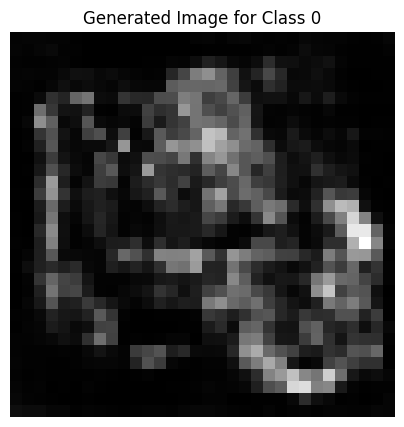

Epoch [1453/2500], D_loss: -0.057085178792476654, G_loss: -0.5582449436187744


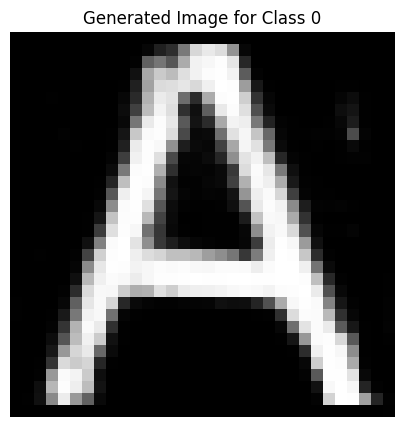

Epoch [1454/2500], D_loss: -0.016338162124156952, G_loss: -0.6031674742698669


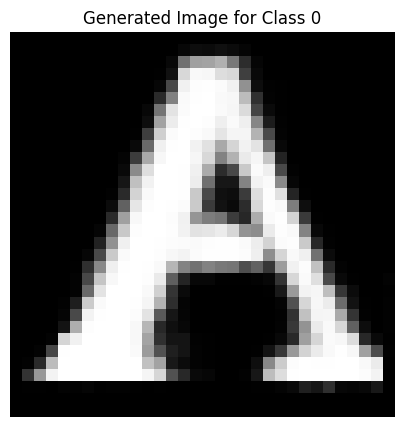

Epoch [1455/2500], D_loss: 0.015540704131126404, G_loss: -0.5888423919677734


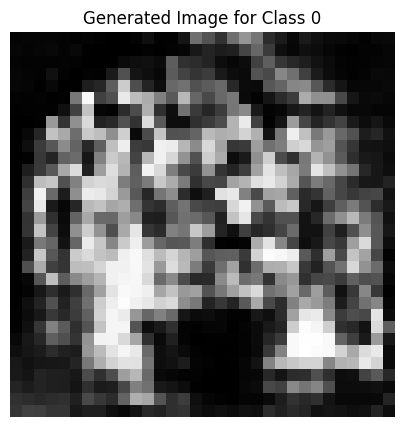

Epoch [1456/2500], D_loss: -0.07354672253131866, G_loss: -0.47768789529800415


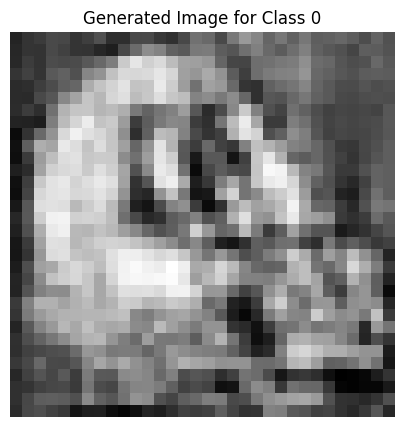

Epoch [1457/2500], D_loss: -0.031315699219703674, G_loss: -0.5871961712837219


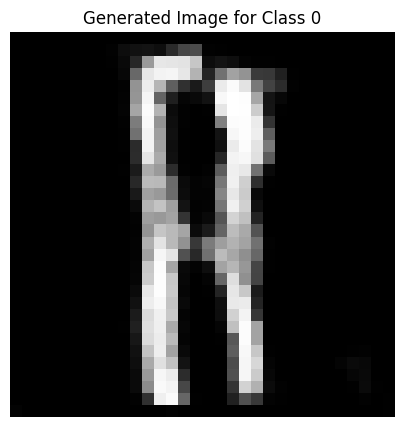

Epoch [1458/2500], D_loss: -0.02860337495803833, G_loss: -0.5208697319030762


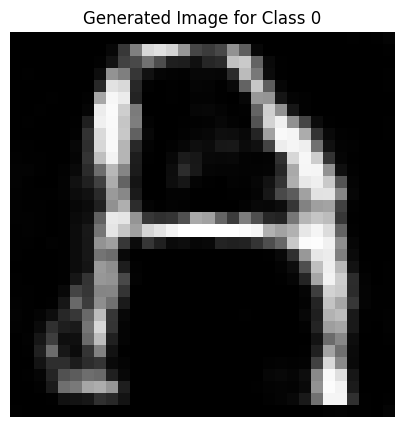

Epoch [1459/2500], D_loss: -0.0440327450633049, G_loss: -0.6204702854156494


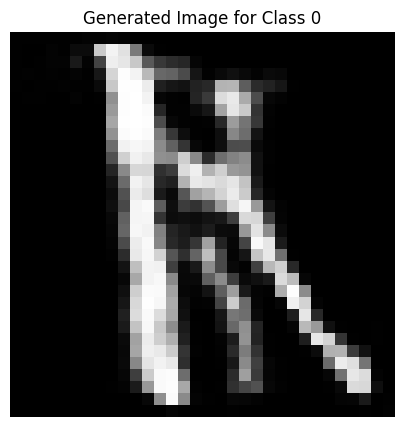

Epoch [1460/2500], D_loss: -0.042276568710803986, G_loss: -0.5309078693389893


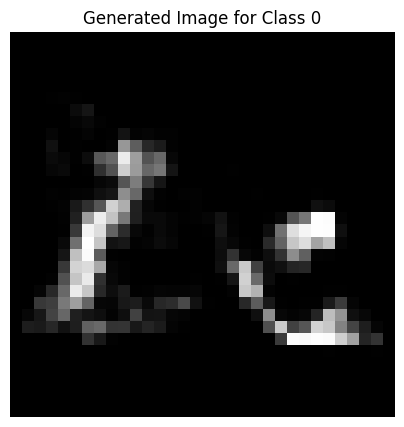

Epoch [1461/2500], D_loss: 0.009791679680347443, G_loss: -0.5992733240127563


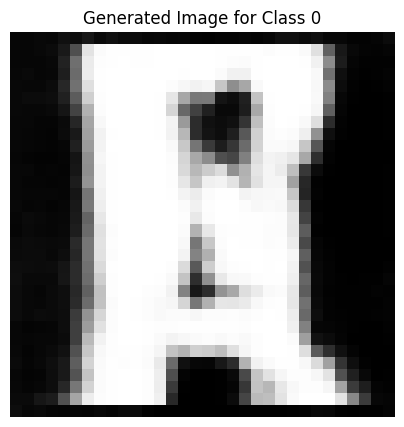

Epoch [1462/2500], D_loss: -0.03155679255723953, G_loss: -0.5328208804130554


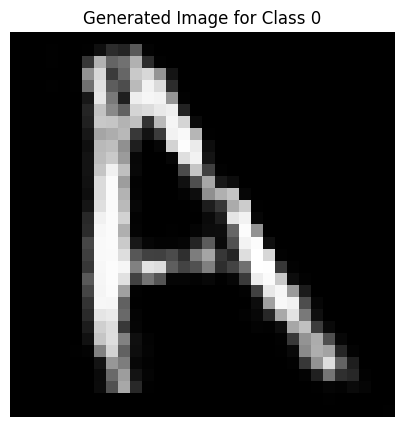

Epoch [1463/2500], D_loss: -0.07115831226110458, G_loss: -0.5711371898651123


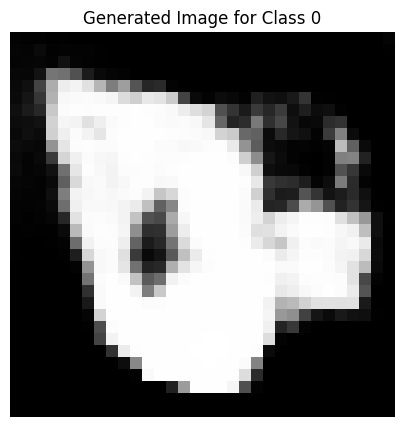

Epoch [1464/2500], D_loss: -0.07987461984157562, G_loss: -0.4638834595680237


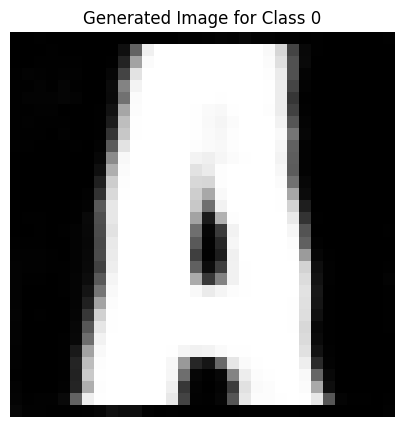

Epoch [1465/2500], D_loss: -0.03999476134777069, G_loss: -0.5108044147491455


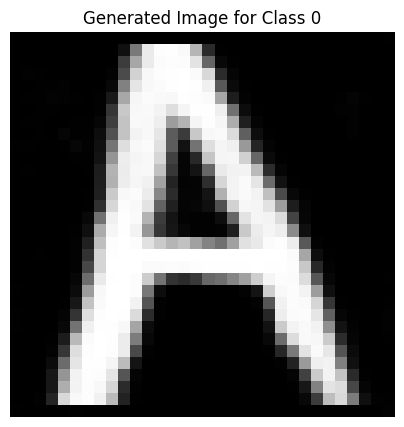

Epoch [1466/2500], D_loss: -0.044770918786525726, G_loss: -0.6775350570678711


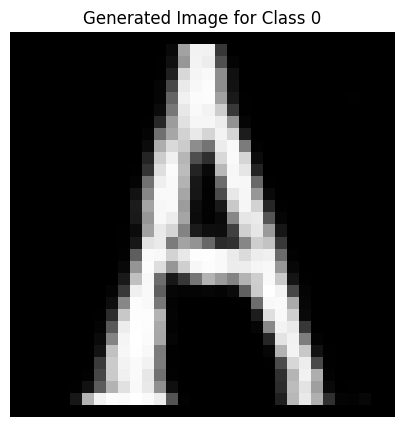

Epoch [1467/2500], D_loss: -0.04923194646835327, G_loss: -0.5757254362106323


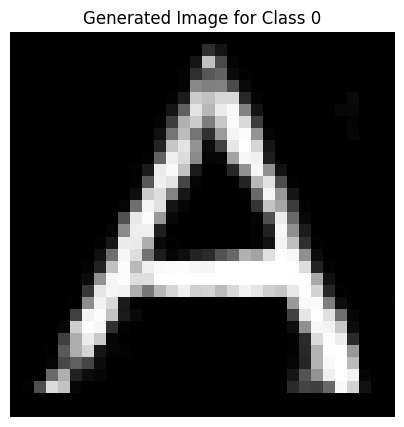

Epoch [1468/2500], D_loss: -0.04140542447566986, G_loss: -0.5224707722663879


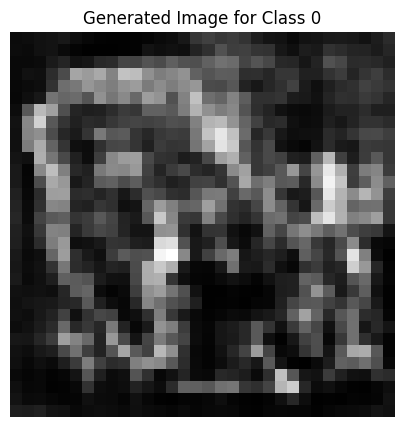

Epoch [1469/2500], D_loss: -0.036185018718242645, G_loss: -0.45163899660110474


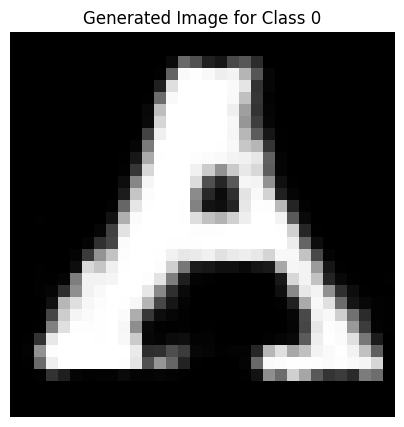

Epoch [1470/2500], D_loss: -0.07156401127576828, G_loss: -0.5884749293327332


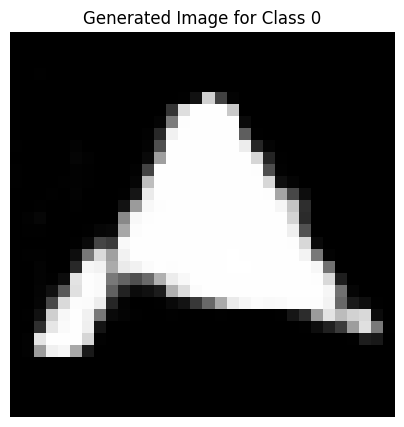

Epoch [1471/2500], D_loss: -0.053166598081588745, G_loss: -0.5722581148147583


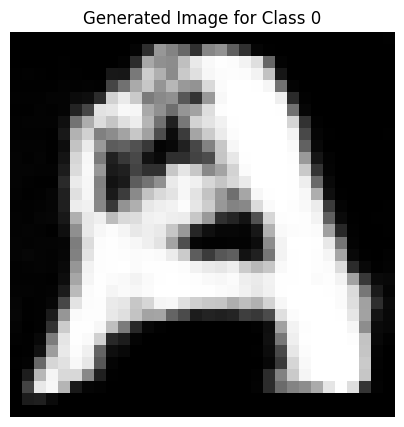

Epoch [1472/2500], D_loss: -0.07080595940351486, G_loss: -0.5103142857551575


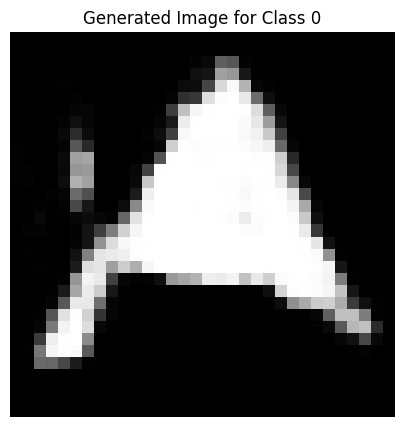

Epoch [1473/2500], D_loss: -0.06154225394129753, G_loss: -0.6096004843711853


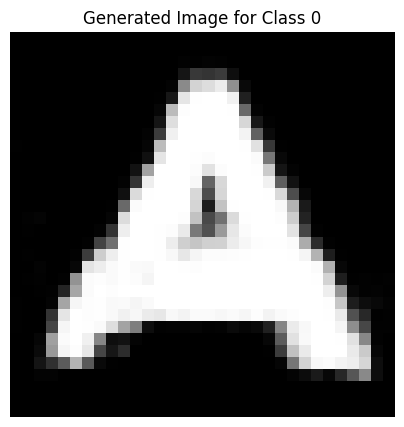

Epoch [1474/2500], D_loss: -0.05927004665136337, G_loss: -0.44935375452041626


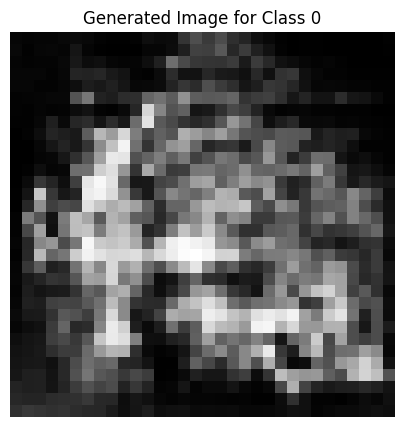

Epoch [1475/2500], D_loss: -0.06900554895401001, G_loss: -0.38332414627075195


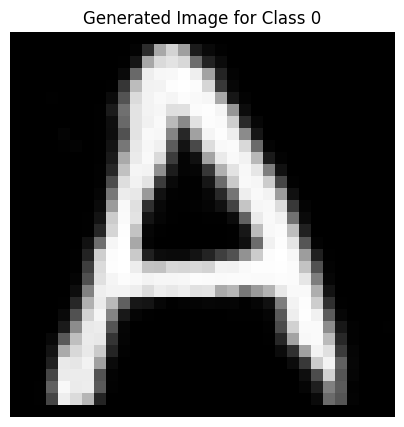

Epoch [1476/2500], D_loss: -0.06050992012023926, G_loss: -0.47948330640792847


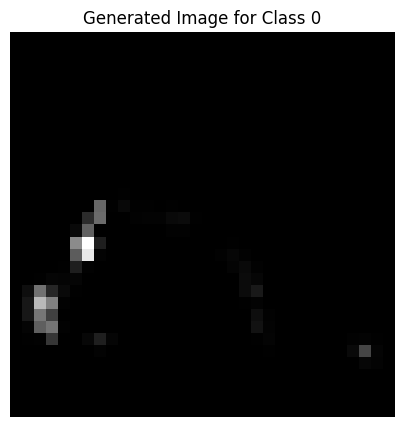

Epoch [1477/2500], D_loss: -0.054023630917072296, G_loss: -0.415628582239151


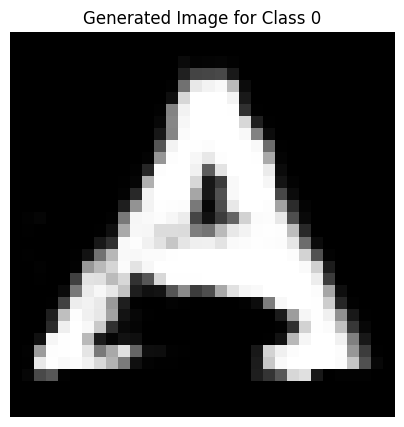

Epoch [1478/2500], D_loss: -0.06636019796133041, G_loss: -0.5837515592575073


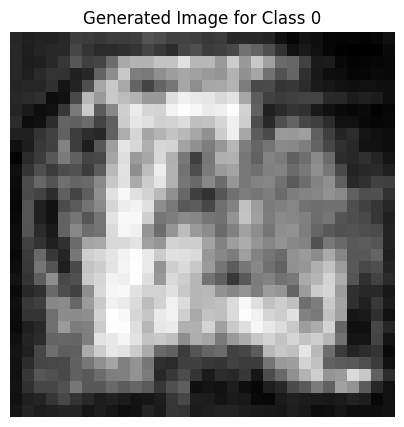

Epoch [1479/2500], D_loss: -0.05438680201768875, G_loss: -0.5508109331130981


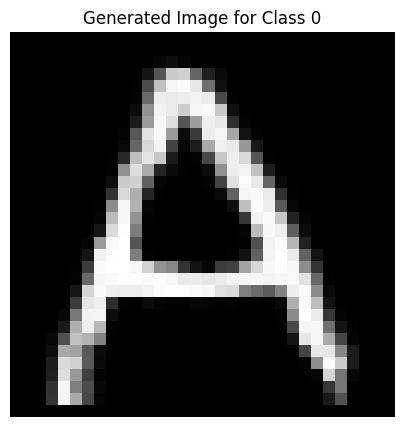

Epoch [1480/2500], D_loss: -0.05481915920972824, G_loss: -0.4449969232082367


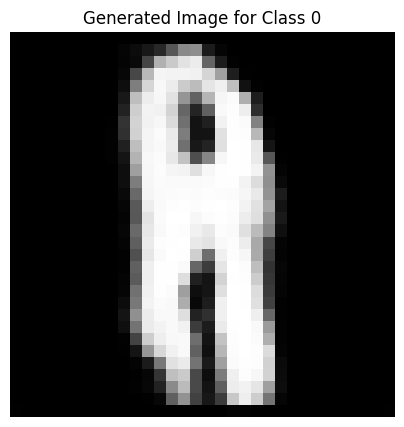

Epoch [1481/2500], D_loss: -0.05635856091976166, G_loss: -0.5204952955245972


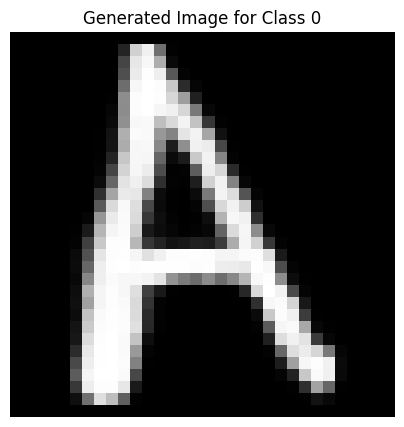

Epoch [1482/2500], D_loss: -0.05729314684867859, G_loss: -0.4177303612232208


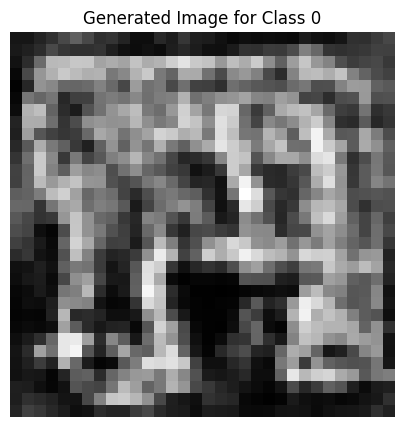

Epoch [1483/2500], D_loss: -0.02626320719718933, G_loss: -0.4686795473098755


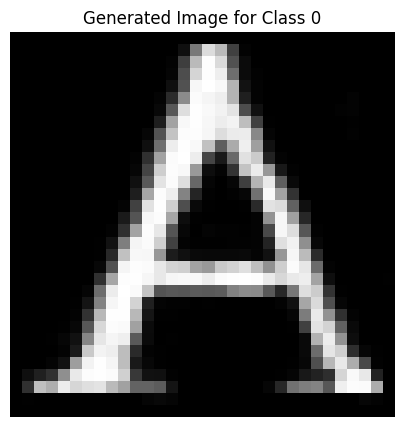

Epoch [1484/2500], D_loss: -0.0637979805469513, G_loss: -0.4558538496494293


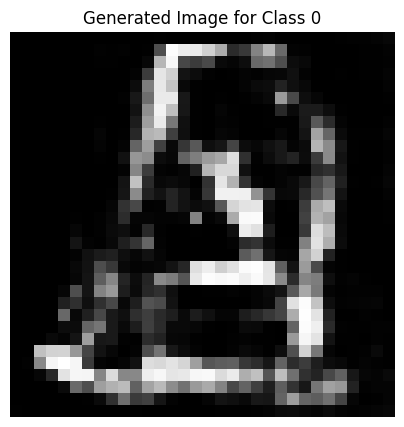

Epoch [1485/2500], D_loss: -0.07286810129880905, G_loss: -0.5163766145706177


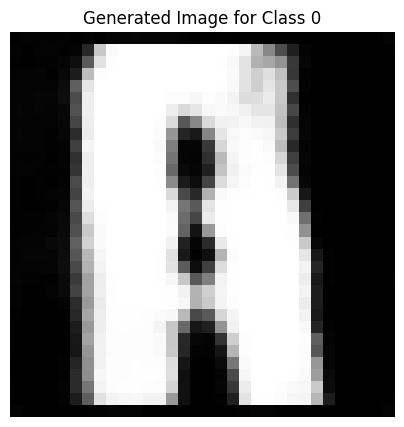

Epoch [1486/2500], D_loss: -0.03984888643026352, G_loss: -0.5007669925689697


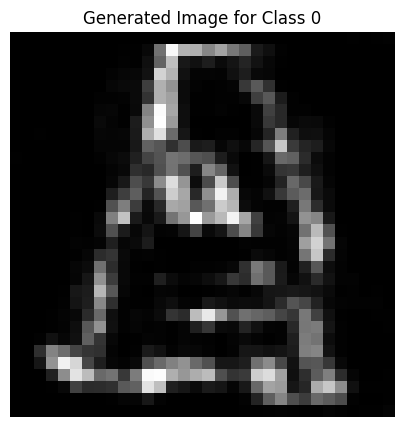

Epoch [1487/2500], D_loss: -0.06355193257331848, G_loss: -0.478512167930603


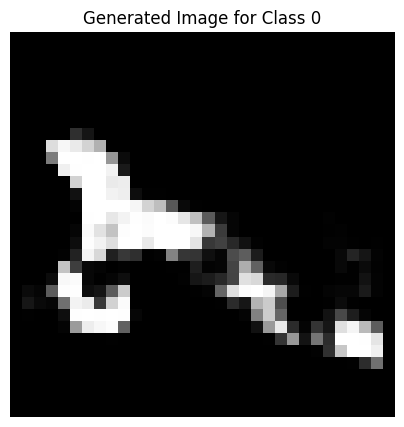

Epoch [1488/2500], D_loss: -0.08323850482702255, G_loss: -0.5406861305236816


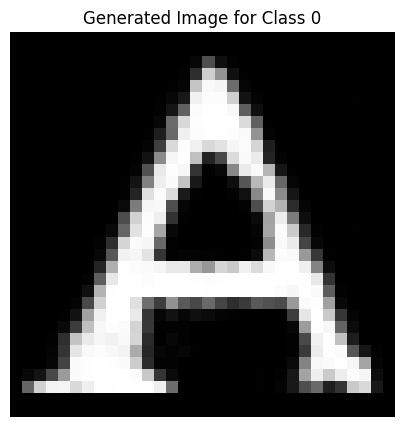

Epoch [1489/2500], D_loss: -0.03901570290327072, G_loss: -0.5003364086151123


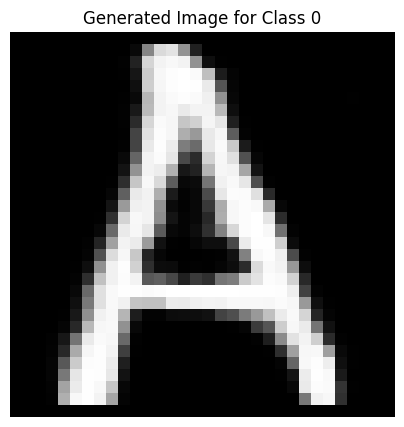

Epoch [1490/2500], D_loss: -0.05874326080083847, G_loss: -0.7179446220397949


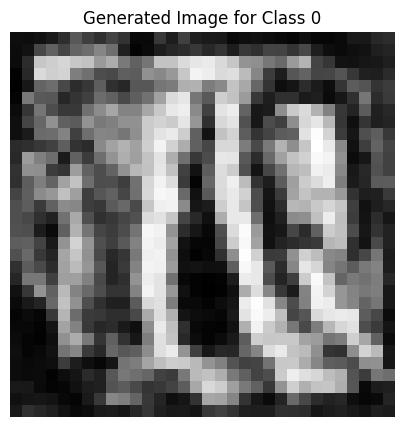

Epoch [1491/2500], D_loss: -0.04705752432346344, G_loss: -0.5435802936553955


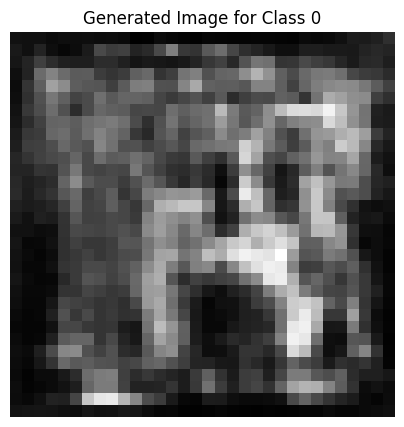

Epoch [1492/2500], D_loss: -0.04607865959405899, G_loss: -0.5663908123970032


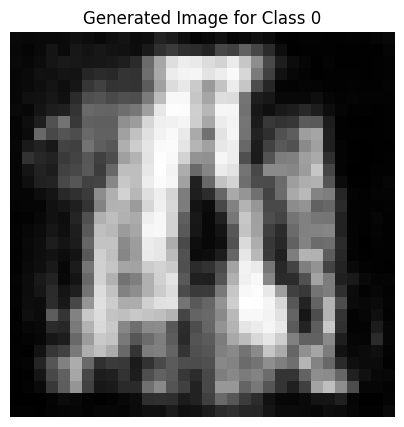

Epoch [1493/2500], D_loss: -0.06121833622455597, G_loss: -0.6149725914001465


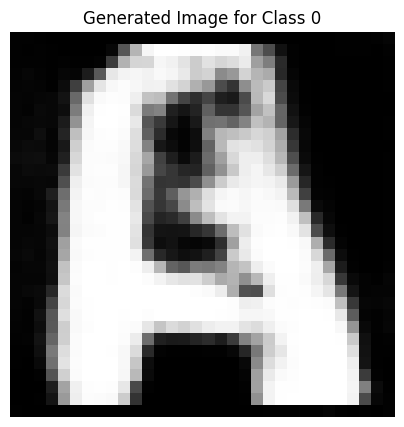

Epoch [1494/2500], D_loss: 0.13986654579639435, G_loss: -0.5607055425643921


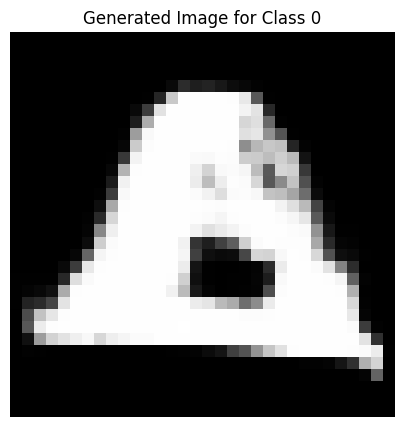

Epoch [1495/2500], D_loss: -0.03574453294277191, G_loss: -0.5191272497177124


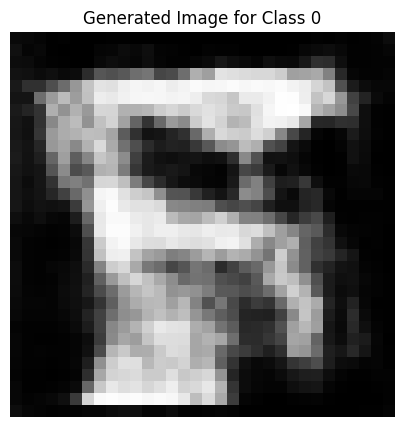

Epoch [1496/2500], D_loss: -0.0694146528840065, G_loss: -0.587726354598999


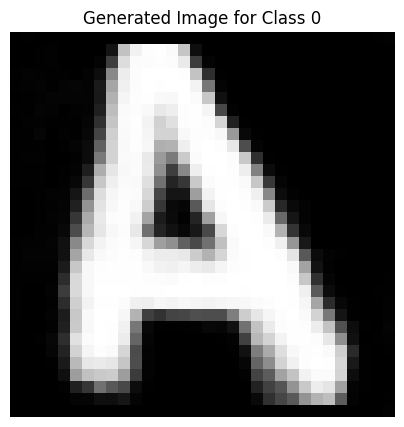

Epoch [1497/2500], D_loss: -0.035609401762485504, G_loss: -0.49100109934806824


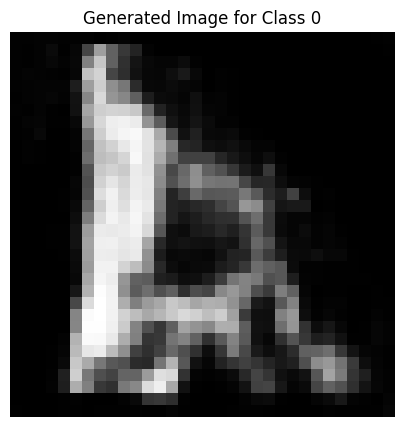

Epoch [1498/2500], D_loss: -0.04462941735982895, G_loss: -0.49794089794158936


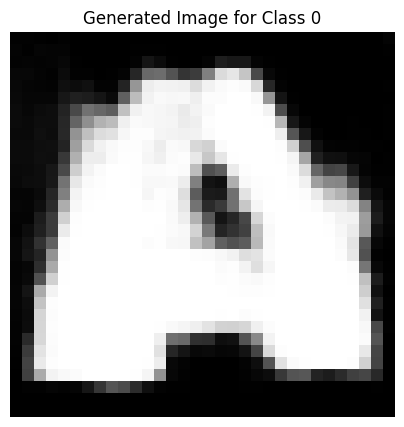

Epoch [1499/2500], D_loss: -0.04836307093501091, G_loss: -0.6974214911460876


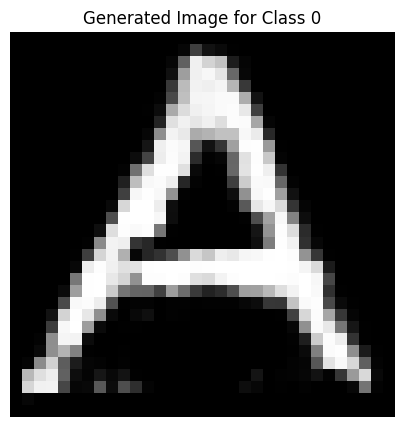

Epoch [1500/2500], D_loss: -0.051293402910232544, G_loss: -0.5152980089187622


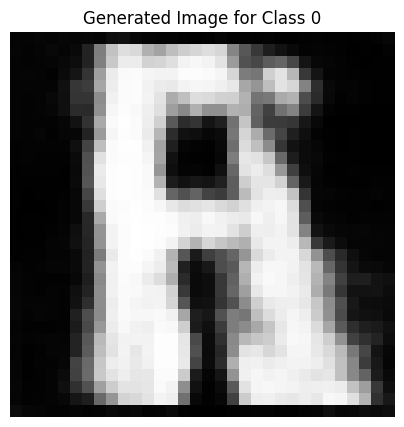

Epoch [1501/2500], D_loss: -0.034841664135456085, G_loss: -0.499004602432251


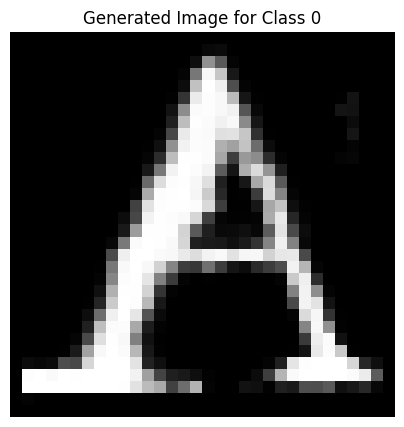

Epoch [1502/2500], D_loss: -0.04453958570957184, G_loss: -0.535420835018158


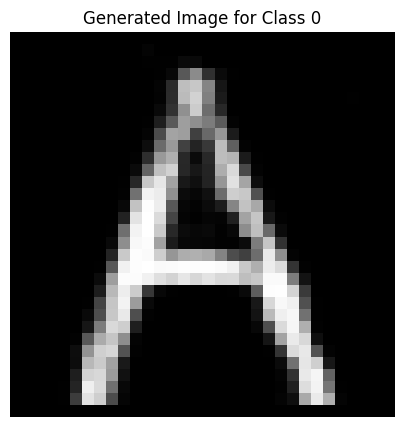

Epoch [1503/2500], D_loss: -0.0647319108247757, G_loss: -0.5606074929237366


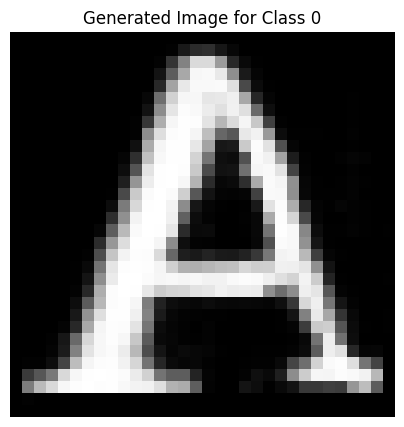

Epoch [1504/2500], D_loss: -0.031928226351737976, G_loss: -0.5617154240608215


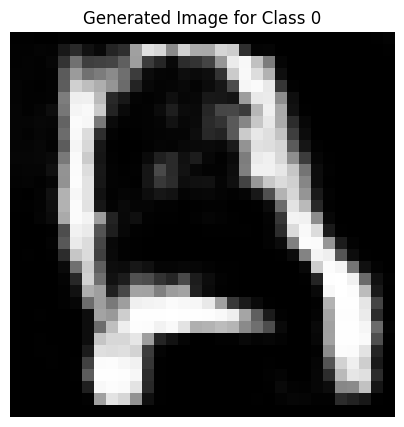

Epoch [1505/2500], D_loss: -0.05245577543973923, G_loss: -0.501496434211731


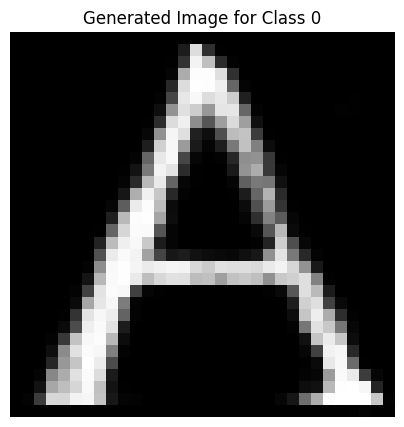

Epoch [1506/2500], D_loss: -0.06507381796836853, G_loss: -0.5296746492385864


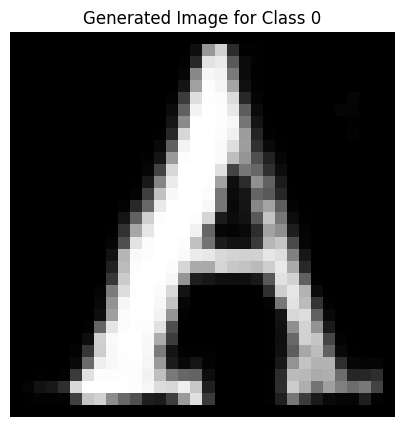

Epoch [1507/2500], D_loss: -0.03887771815061569, G_loss: -0.4988688826560974


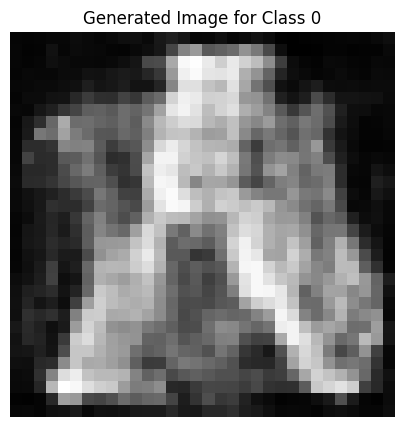

Epoch [1508/2500], D_loss: -0.05300656706094742, G_loss: -0.5619606971740723


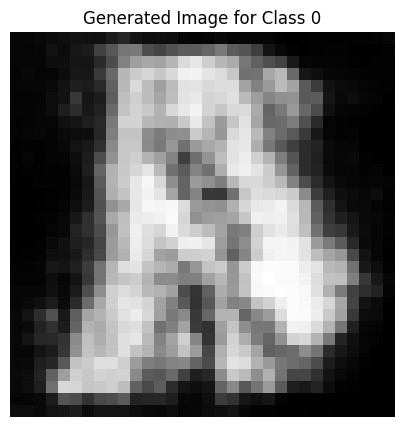

Epoch [1509/2500], D_loss: -0.05172980576753616, G_loss: -0.49959659576416016


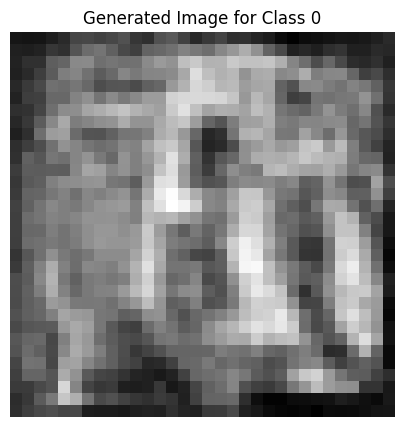

Epoch [1510/2500], D_loss: -0.04466146230697632, G_loss: -0.46105700731277466


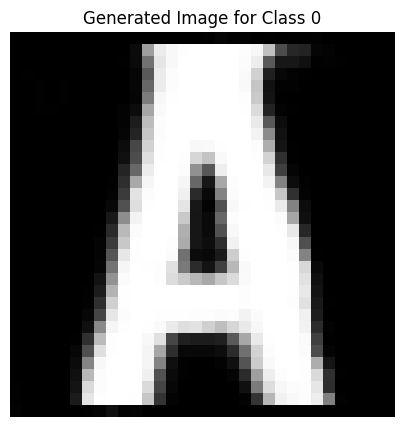

Epoch [1511/2500], D_loss: -0.06974795460700989, G_loss: -0.5899673700332642


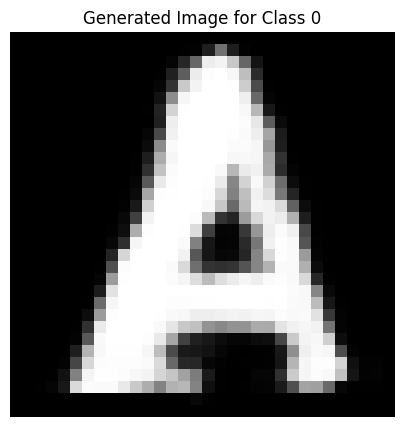

Epoch [1512/2500], D_loss: -0.05712547153234482, G_loss: -0.498546838760376


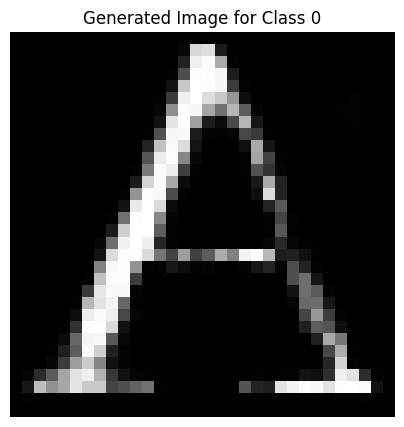

Epoch [1513/2500], D_loss: -0.06778602302074432, G_loss: -0.5322698950767517


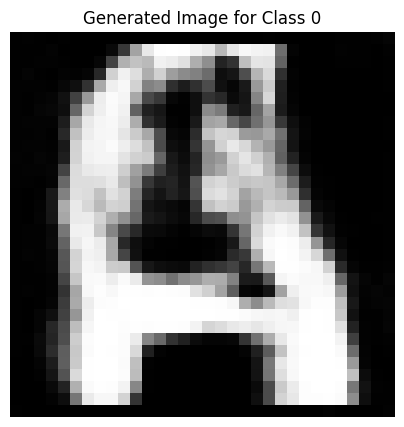

Epoch [1514/2500], D_loss: -0.06606777757406235, G_loss: -0.5463250279426575


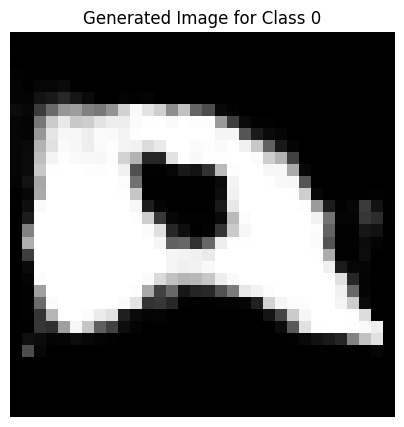

Epoch [1515/2500], D_loss: -0.06980403512716293, G_loss: -0.5470634698867798


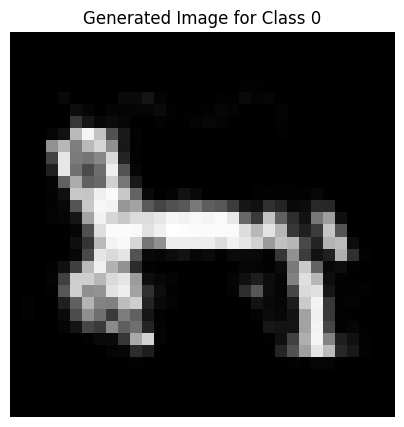

Epoch [1516/2500], D_loss: -0.06110150367021561, G_loss: -0.5699774026870728


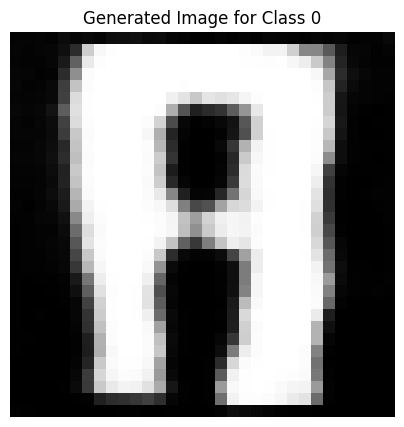

Epoch [1517/2500], D_loss: -0.048614174127578735, G_loss: -0.4796367585659027


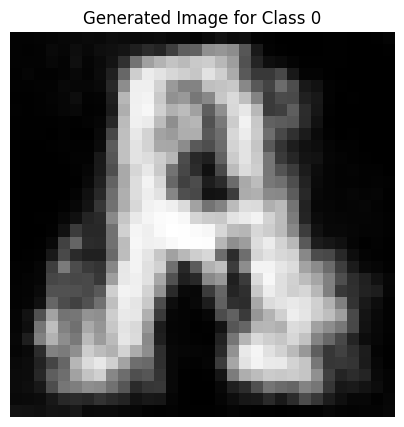

Epoch [1518/2500], D_loss: -0.035304345190525055, G_loss: -0.49706244468688965


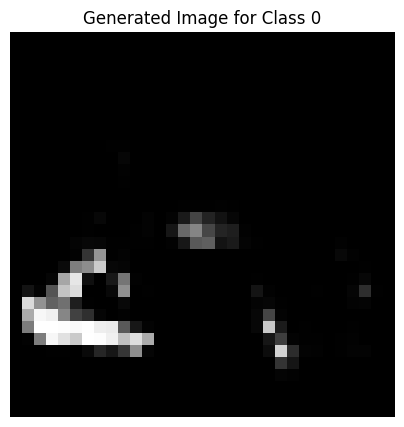

Epoch [1519/2500], D_loss: -0.0007836595177650452, G_loss: -0.5156562328338623


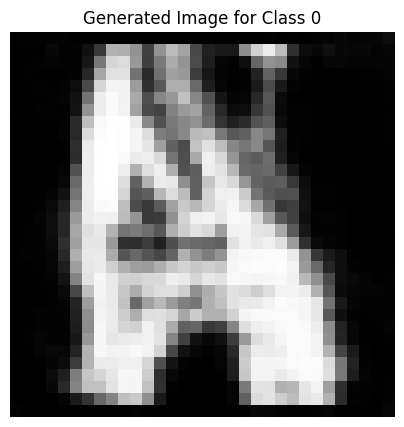

Epoch [1520/2500], D_loss: -0.06735877692699432, G_loss: -0.48796147108078003


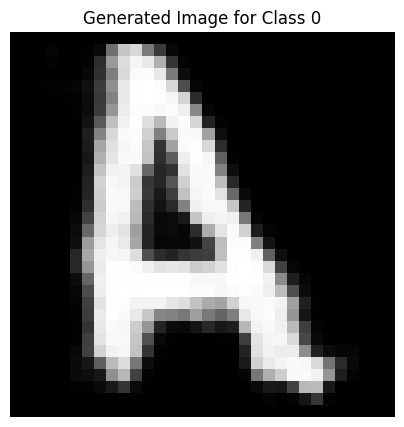

Epoch [1521/2500], D_loss: -0.06002900004386902, G_loss: -0.5319308042526245


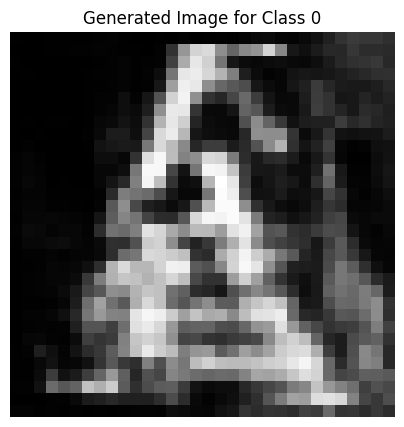

Epoch [1522/2500], D_loss: -0.06239422410726547, G_loss: -0.46162644028663635


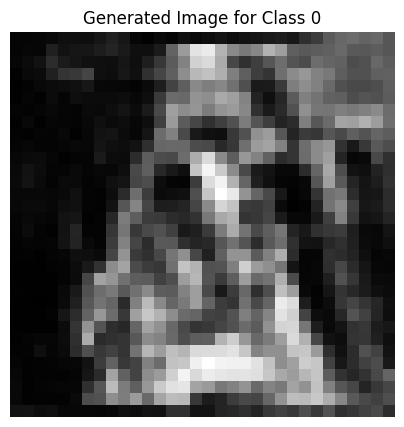

Epoch [1523/2500], D_loss: -0.0688551664352417, G_loss: -0.4973788559436798


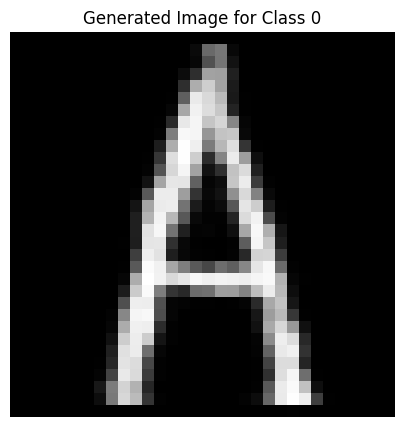

Epoch [1524/2500], D_loss: -0.07662813365459442, G_loss: -0.5636529922485352


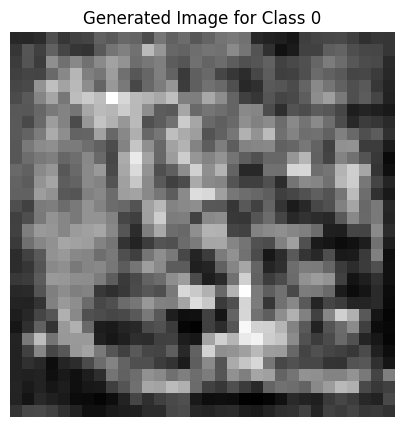

Epoch [1525/2500], D_loss: -0.05557176470756531, G_loss: -0.4479188323020935


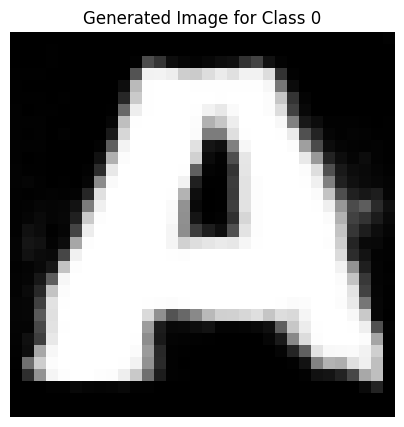

Epoch [1526/2500], D_loss: -0.05444654822349548, G_loss: -0.5063630938529968


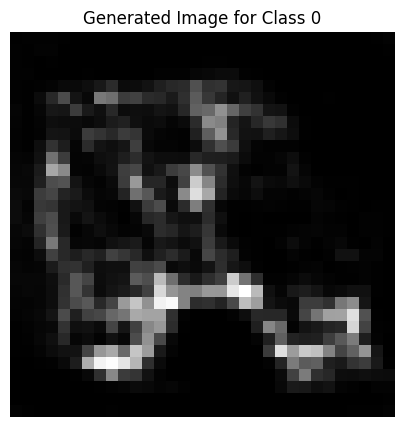

Epoch [1527/2500], D_loss: -0.026800692081451416, G_loss: -0.5528656244277954


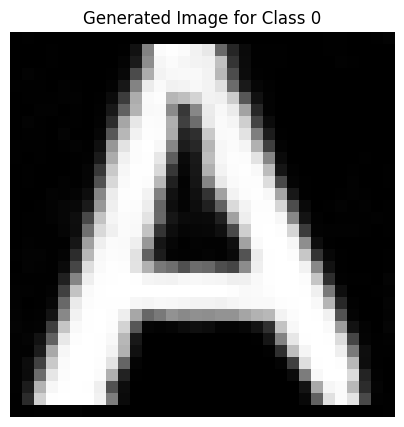

Epoch [1528/2500], D_loss: -0.0640636682510376, G_loss: -0.4290642738342285


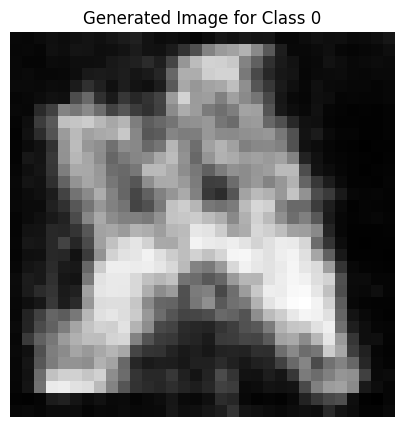

Epoch [1529/2500], D_loss: -0.039150774478912354, G_loss: -0.5378671288490295


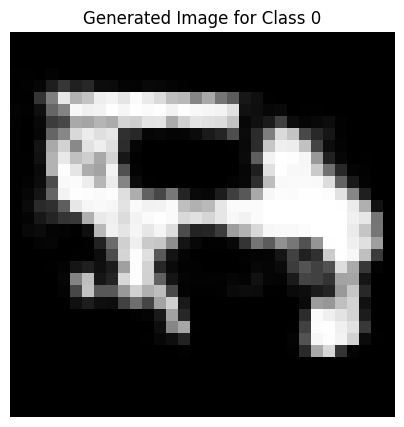

Epoch [1530/2500], D_loss: -0.0603417307138443, G_loss: -0.553977906703949


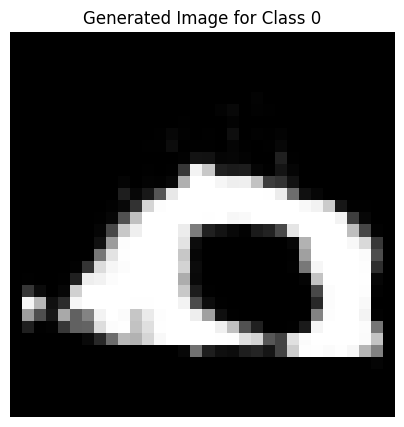

Epoch [1531/2500], D_loss: -0.04684548079967499, G_loss: -0.4694148600101471


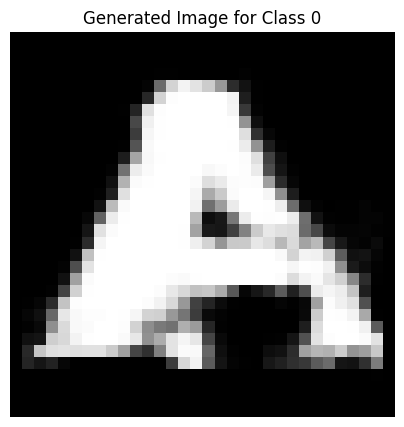

Epoch [1532/2500], D_loss: -0.07360421121120453, G_loss: -0.4770548343658447


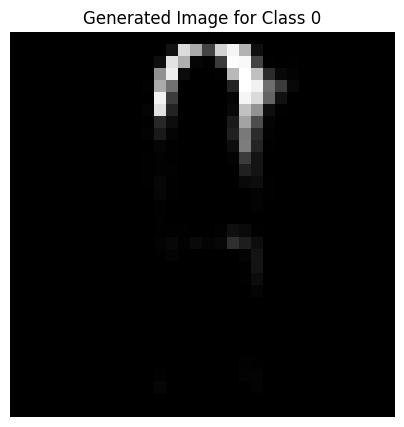

Epoch [1533/2500], D_loss: -0.07629507780075073, G_loss: -0.5513285994529724


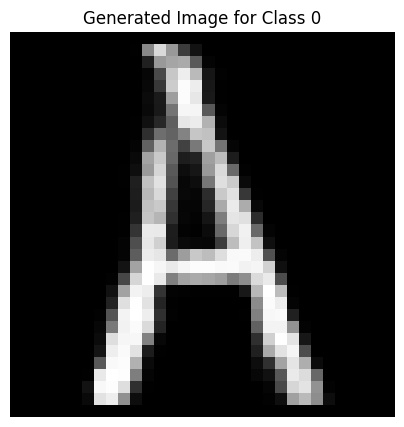

Epoch [1534/2500], D_loss: -0.07663605362176895, G_loss: -0.5101191401481628


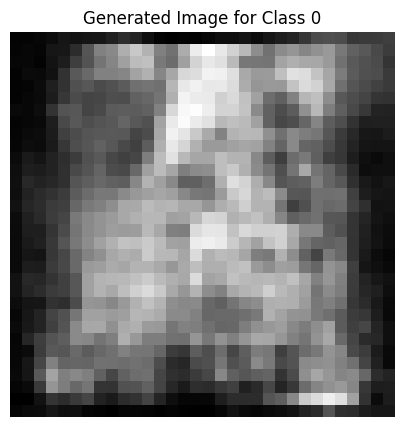

Epoch [1535/2500], D_loss: -0.0613030344247818, G_loss: -0.534895658493042


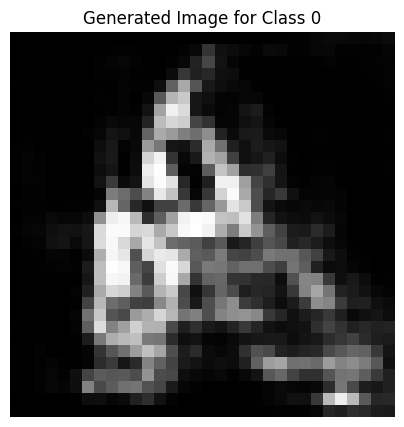

Epoch [1536/2500], D_loss: -0.04182282090187073, G_loss: -0.5425959229469299


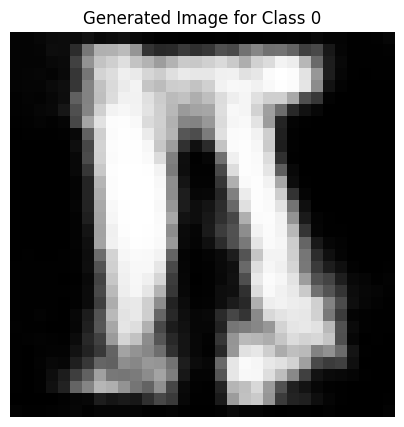

Epoch [1537/2500], D_loss: -0.05111458897590637, G_loss: -0.49697619676589966


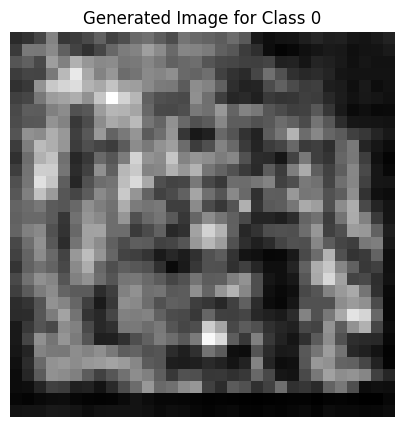

Epoch [1538/2500], D_loss: -0.04910823702812195, G_loss: -0.5449963212013245


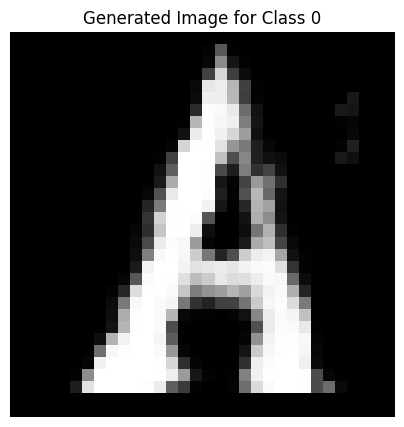

Epoch [1539/2500], D_loss: -0.06361238658428192, G_loss: -0.48547840118408203


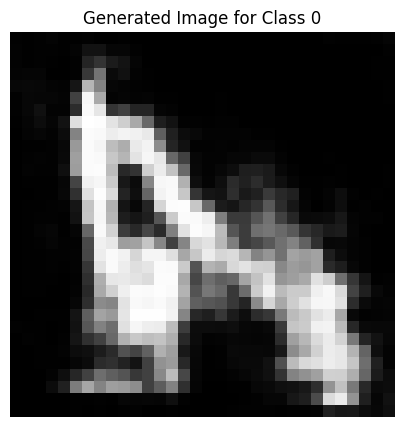

Epoch [1540/2500], D_loss: -0.04165760427713394, G_loss: -0.45945557951927185


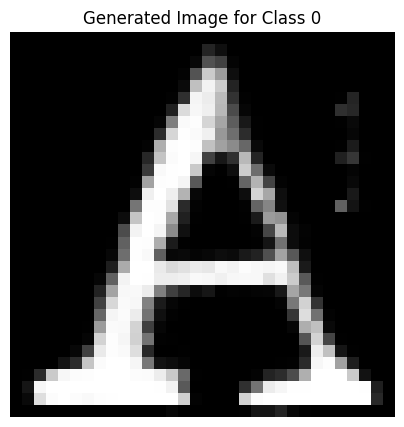

Epoch [1541/2500], D_loss: -0.06560871750116348, G_loss: -0.48306113481521606


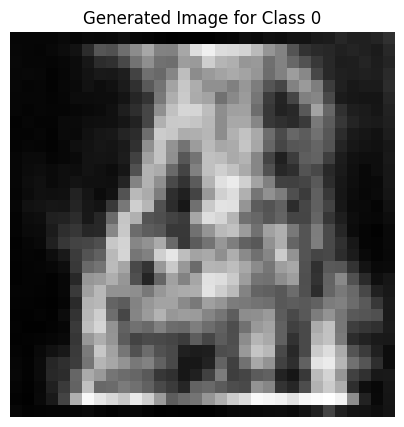

Epoch [1542/2500], D_loss: -0.052659809589385986, G_loss: -0.5307228565216064


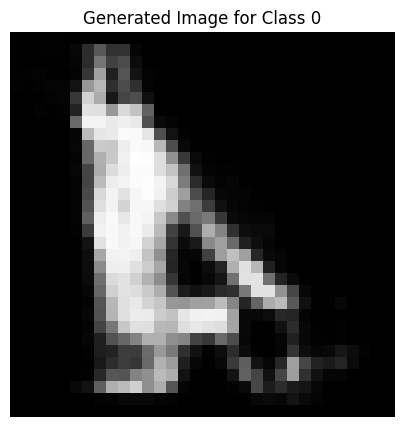

Epoch [1543/2500], D_loss: -0.06132979691028595, G_loss: -0.522674560546875


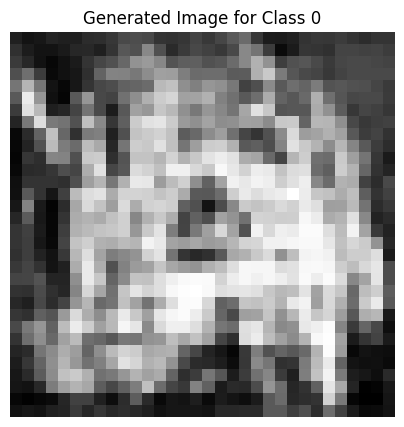

Epoch [1544/2500], D_loss: -0.055726125836372375, G_loss: -0.5702691078186035


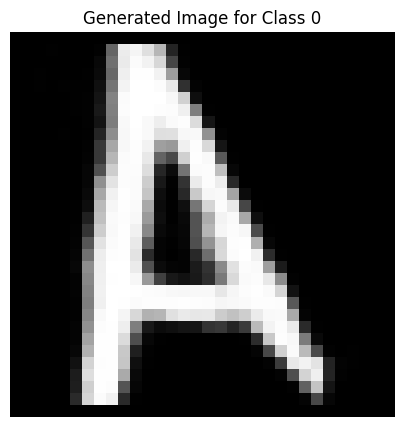

Epoch [1545/2500], D_loss: -0.07037682831287384, G_loss: -0.6447922587394714


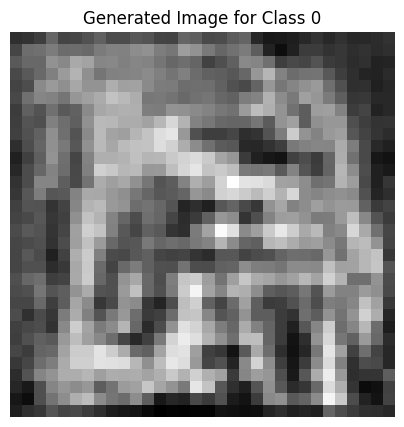

Epoch [1546/2500], D_loss: -0.06331628561019897, G_loss: -0.43724650144577026


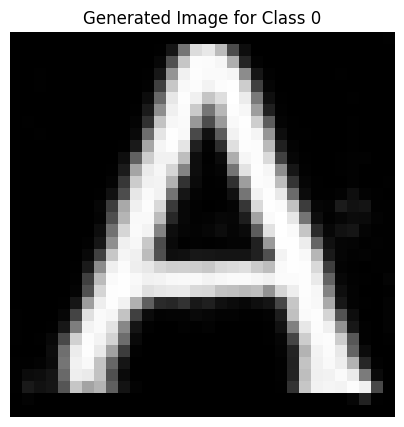

Epoch [1547/2500], D_loss: -0.08873684704303741, G_loss: -0.43850404024124146


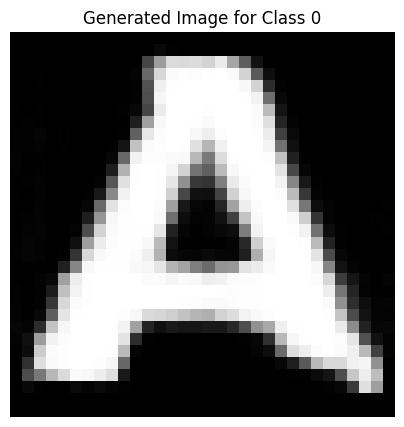

Epoch [1548/2500], D_loss: -0.07597407698631287, G_loss: -0.4120643734931946


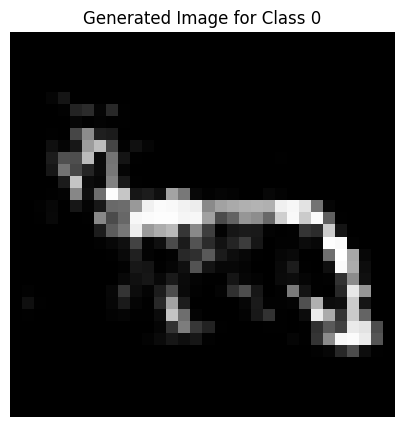

Epoch [1549/2500], D_loss: -0.07803522795438766, G_loss: -0.5083508491516113


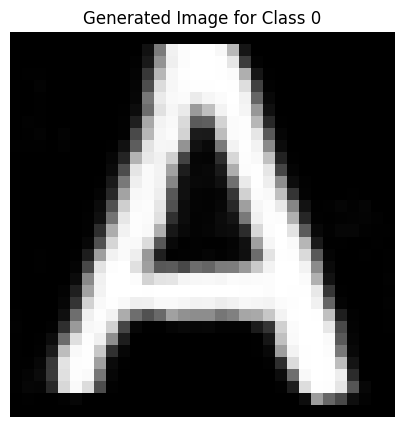

Epoch [1550/2500], D_loss: -0.0615905225276947, G_loss: -0.5175709128379822


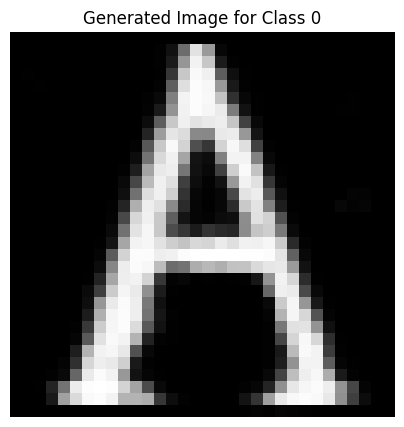

Epoch [1551/2500], D_loss: -0.06836288422346115, G_loss: -0.4547674059867859


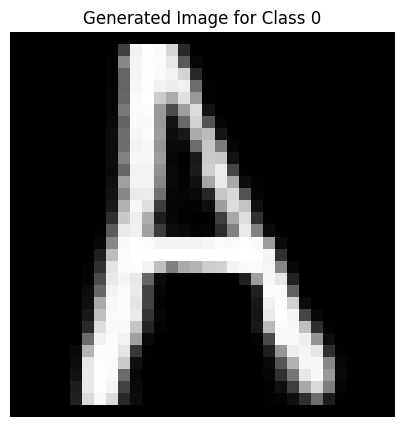

Epoch [1552/2500], D_loss: -0.0734889805316925, G_loss: -0.5279481410980225


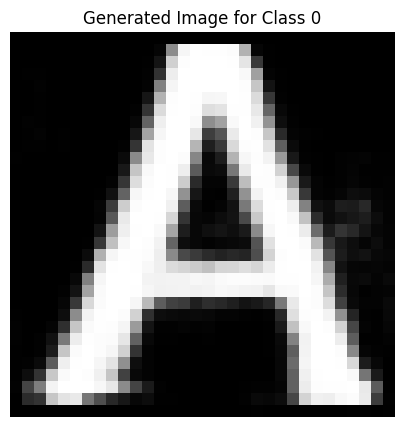

Epoch [1553/2500], D_loss: -0.06110335886478424, G_loss: -0.4780239760875702


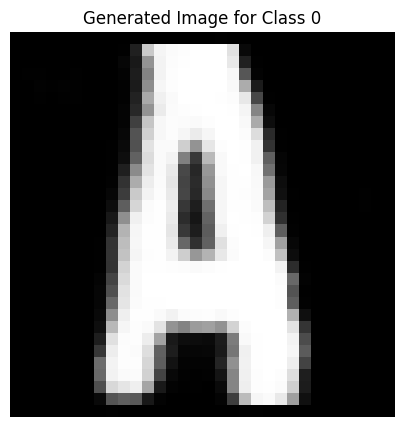

Epoch [1554/2500], D_loss: -0.07951022684574127, G_loss: -0.4941815733909607


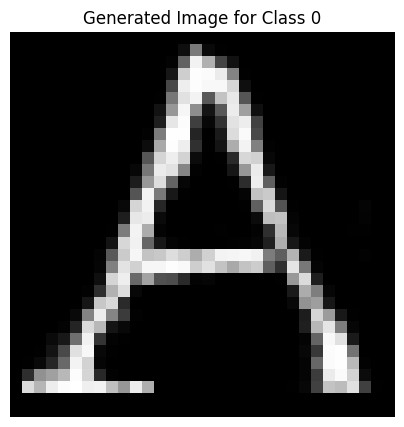

Epoch [1555/2500], D_loss: -0.06663810461759567, G_loss: -0.5821326375007629


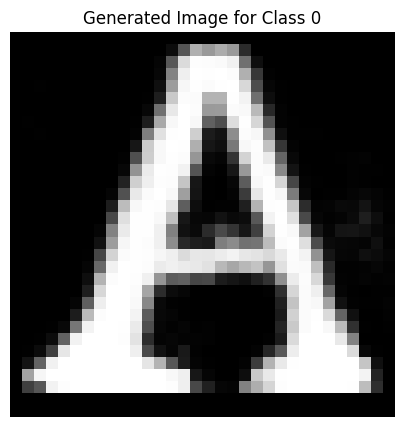

Epoch [1556/2500], D_loss: -0.07106921076774597, G_loss: -0.5088262557983398


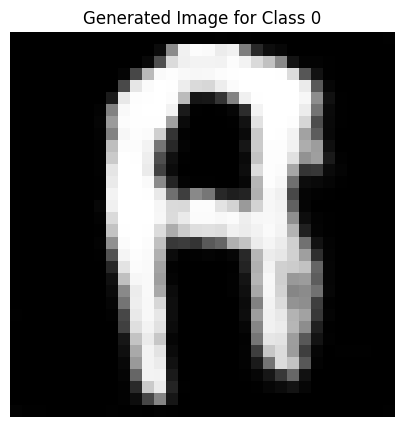

Epoch [1557/2500], D_loss: -0.05787239968776703, G_loss: -0.5687025785446167


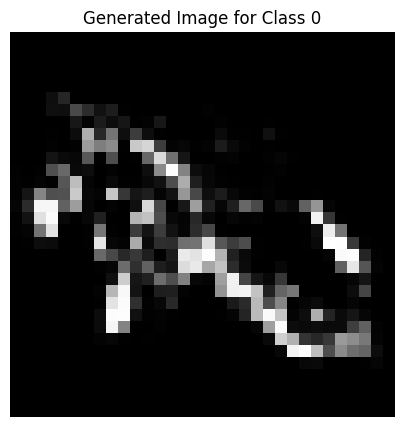

Epoch [1558/2500], D_loss: -0.04407684504985809, G_loss: -0.5154094696044922


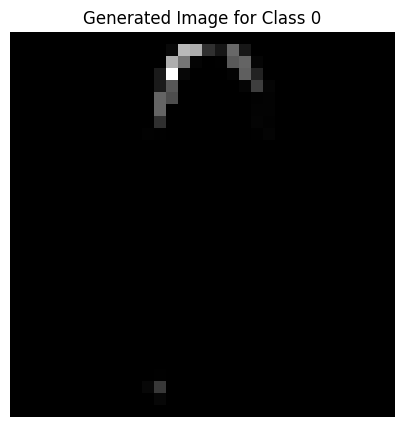

Epoch [1559/2500], D_loss: -0.06318886578083038, G_loss: -0.5217534303665161


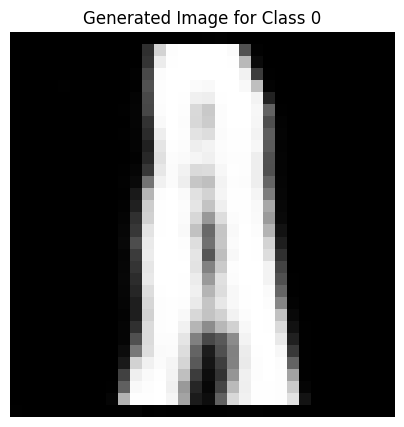

Epoch [1560/2500], D_loss: -0.07491834461688995, G_loss: -0.47957348823547363


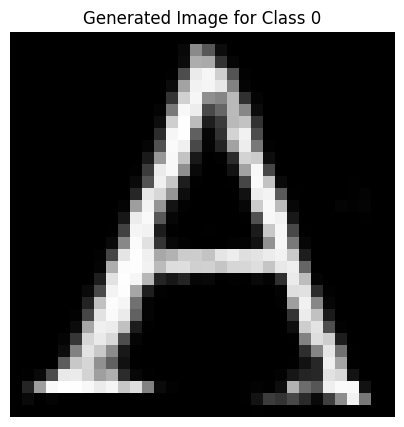

Epoch [1561/2500], D_loss: -0.06140860170125961, G_loss: -0.515847384929657


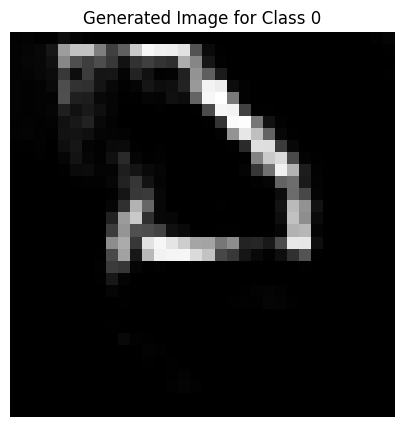

Epoch [1562/2500], D_loss: -0.05892060697078705, G_loss: -0.5915509462356567


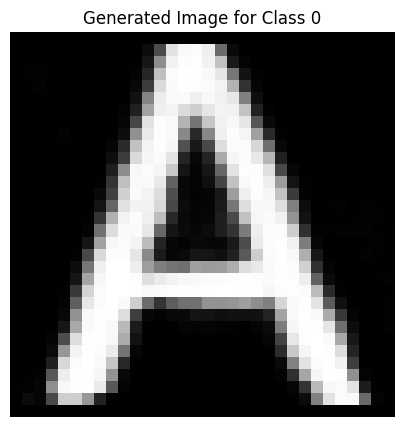

Epoch [1563/2500], D_loss: -0.07270930707454681, G_loss: -0.5516806244850159


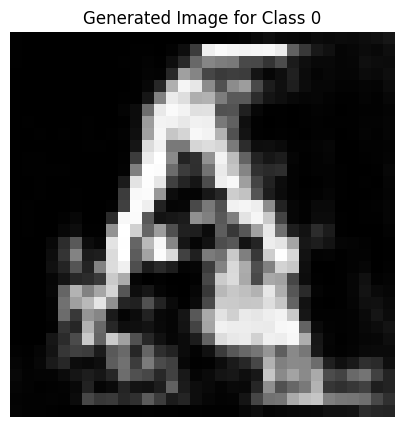

Epoch [1564/2500], D_loss: -0.09247720241546631, G_loss: -0.5018250942230225


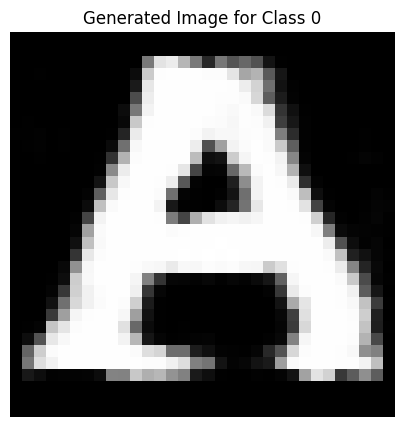

Epoch [1565/2500], D_loss: -0.06550722569227219, G_loss: -0.6136128902435303


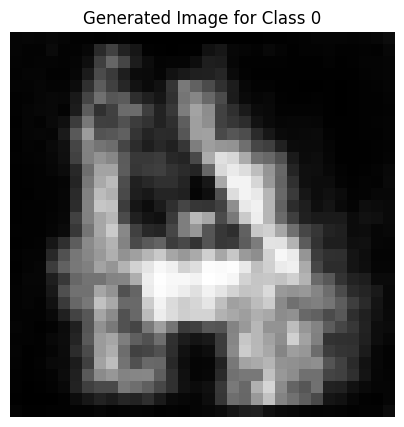

Epoch [1566/2500], D_loss: -0.06407342106103897, G_loss: -0.45386597514152527


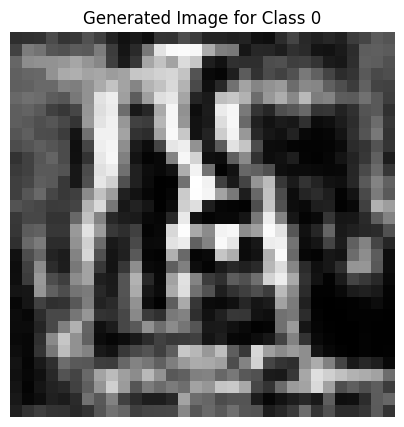

Epoch [1567/2500], D_loss: -0.019365161657333374, G_loss: -0.5209266543388367


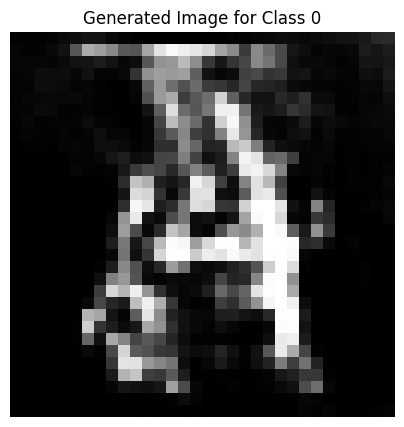

Epoch [1568/2500], D_loss: -0.06113097071647644, G_loss: -0.510468602180481


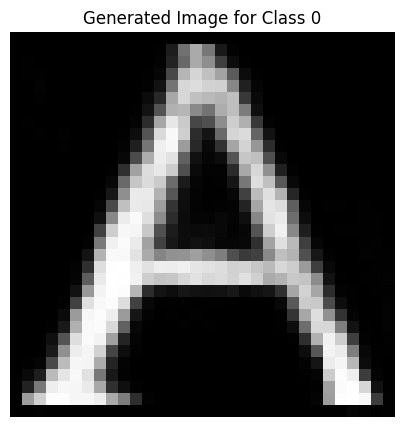

Epoch [1569/2500], D_loss: -0.04795330762863159, G_loss: -0.4485689401626587


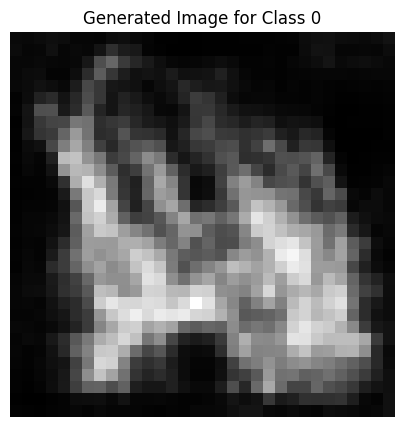

Epoch [1570/2500], D_loss: -0.026463814079761505, G_loss: -0.5548925399780273


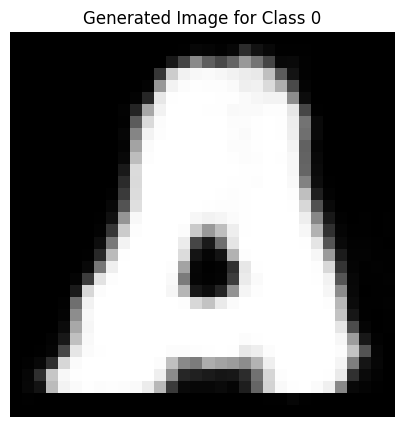

Epoch [1571/2500], D_loss: -0.06158477067947388, G_loss: -0.46970540285110474


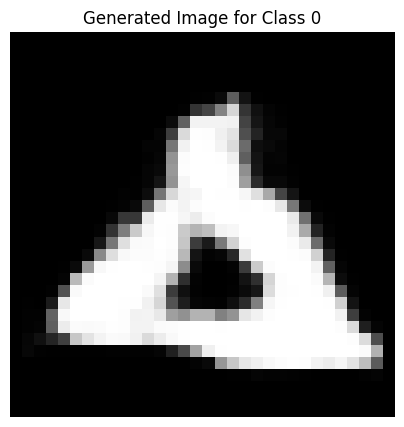

Epoch [1572/2500], D_loss: -0.06466404348611832, G_loss: -0.4945788085460663


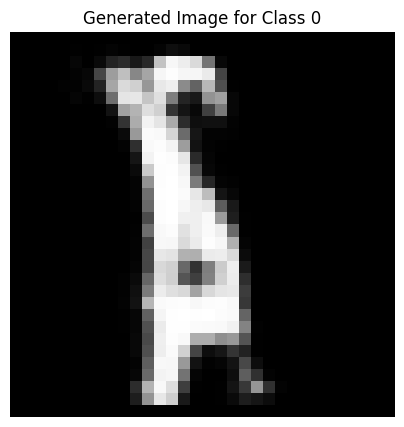

Epoch [1573/2500], D_loss: 0.02004215121269226, G_loss: -0.624048113822937


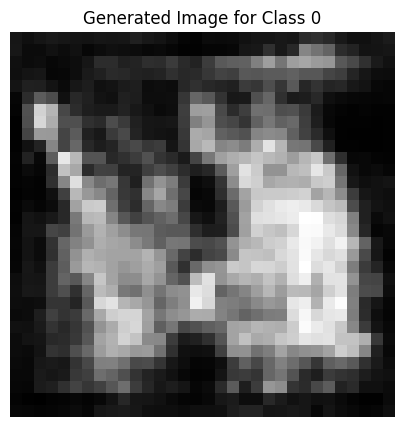

Epoch [1574/2500], D_loss: -0.06362585723400116, G_loss: -0.5098052620887756


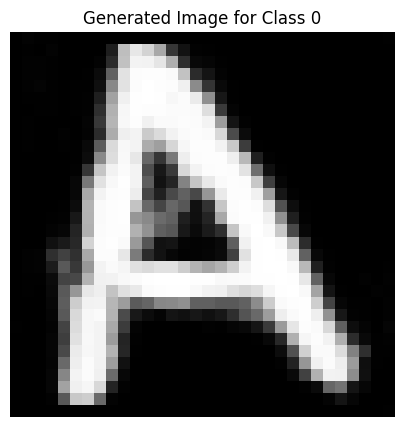

Epoch [1575/2500], D_loss: -0.04501008987426758, G_loss: -0.4937281012535095


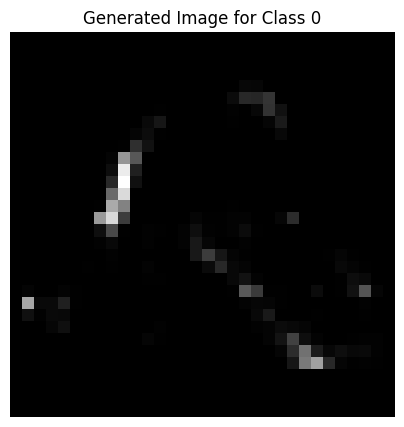

Epoch [1576/2500], D_loss: -0.06919737160205841, G_loss: -0.5420252084732056


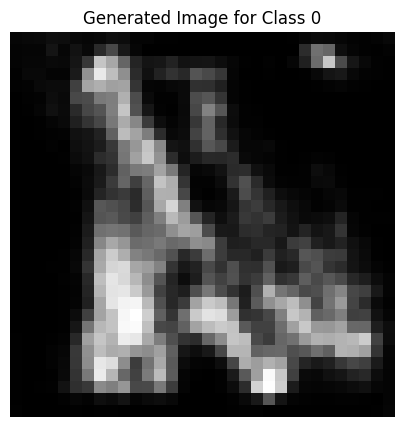

Epoch [1577/2500], D_loss: -0.034936487674713135, G_loss: -0.47607487440109253


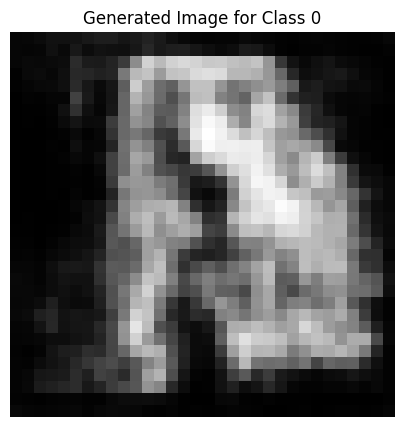

Epoch [1578/2500], D_loss: -0.05812528356909752, G_loss: -0.6868545413017273


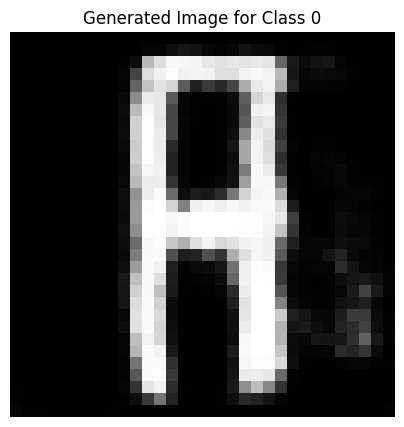

Epoch [1579/2500], D_loss: -0.05770032852888107, G_loss: -0.4933874011039734


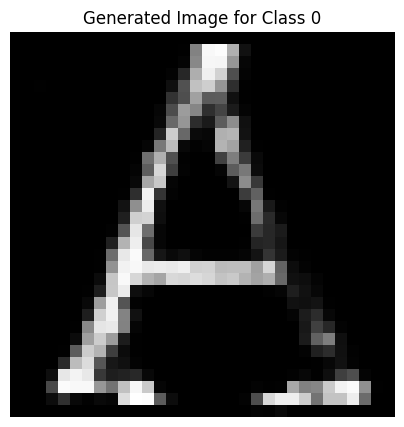

Epoch [1580/2500], D_loss: -0.031355902552604675, G_loss: -0.5290184020996094


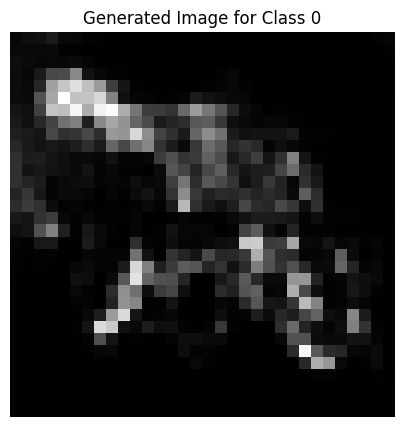

Epoch [1581/2500], D_loss: -0.06438659876585007, G_loss: -0.5166037082672119


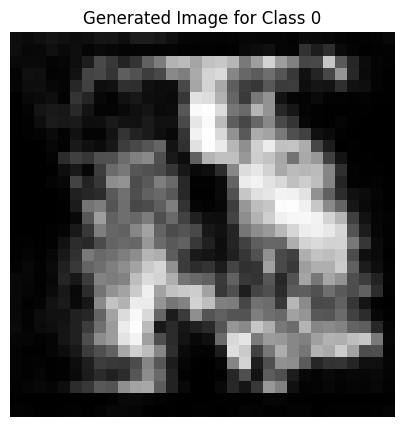

Epoch [1582/2500], D_loss: -0.07922280579805374, G_loss: -0.5158297419548035


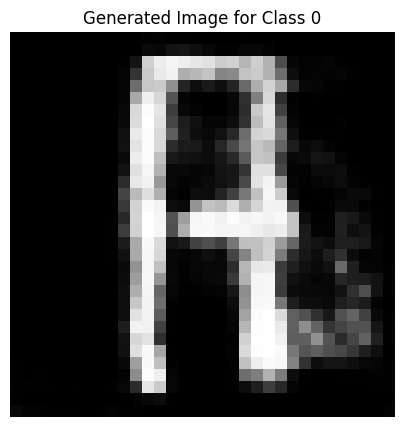

Epoch [1583/2500], D_loss: -0.051978468894958496, G_loss: -0.4392460584640503


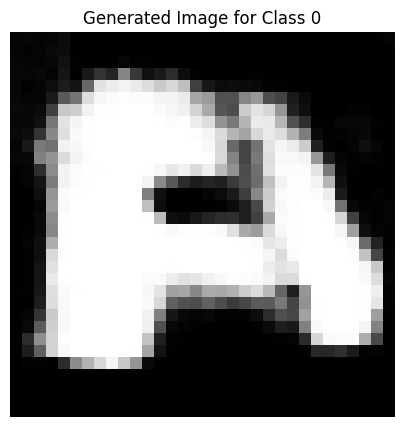

Epoch [1584/2500], D_loss: -0.06334588676691055, G_loss: -0.560211181640625


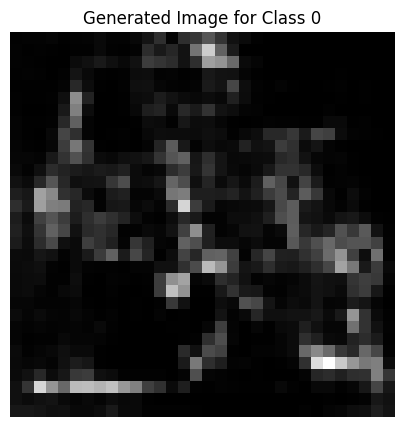

Epoch [1585/2500], D_loss: -0.06651224195957184, G_loss: -0.5049653649330139


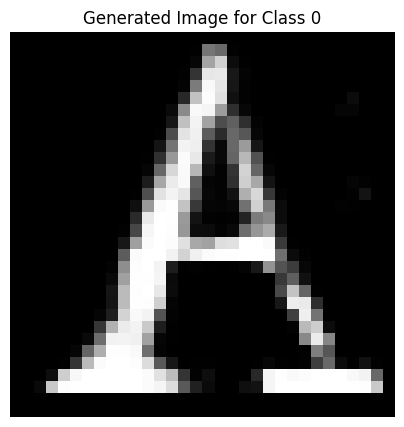

Epoch [1586/2500], D_loss: -0.0786575973033905, G_loss: -0.4970672130584717


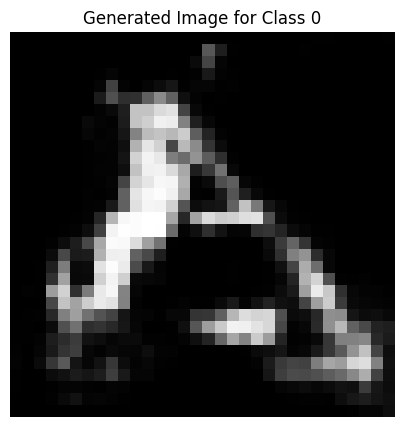

Epoch [1587/2500], D_loss: -0.06554626673460007, G_loss: -0.49043136835098267


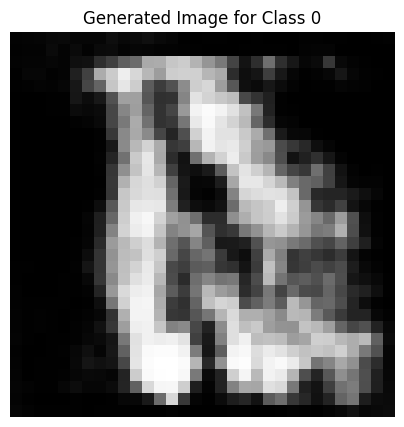

Epoch [1588/2500], D_loss: -0.06698187440633774, G_loss: -0.5707100629806519


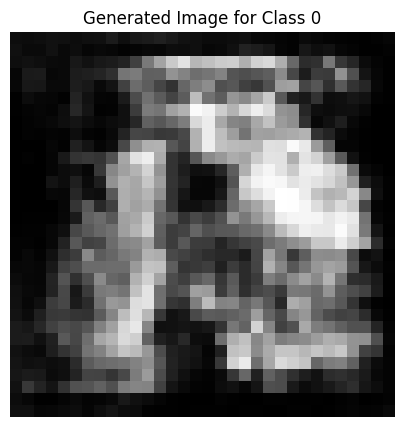

Epoch [1589/2500], D_loss: -0.05052711069583893, G_loss: -0.5498697757720947


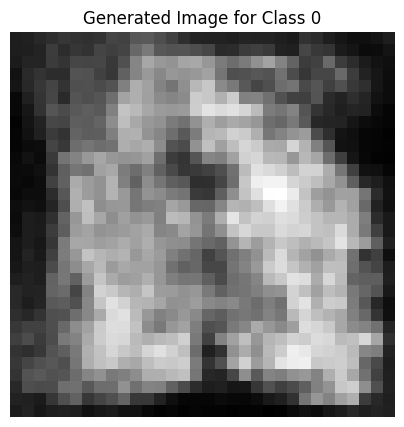

Epoch [1590/2500], D_loss: -0.05261394381523132, G_loss: -0.54233318567276


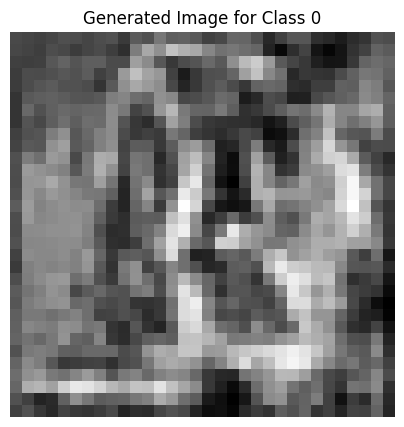

Epoch [1591/2500], D_loss: -0.04915694147348404, G_loss: -0.46580439805984497


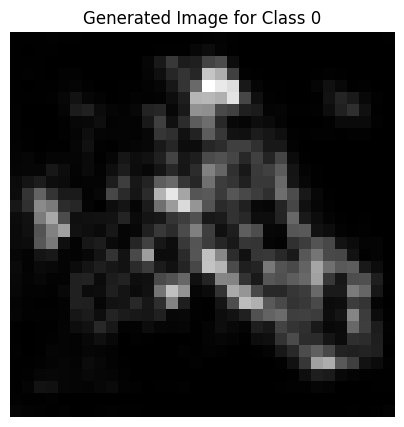

Epoch [1592/2500], D_loss: -0.07827568054199219, G_loss: -0.5671883821487427


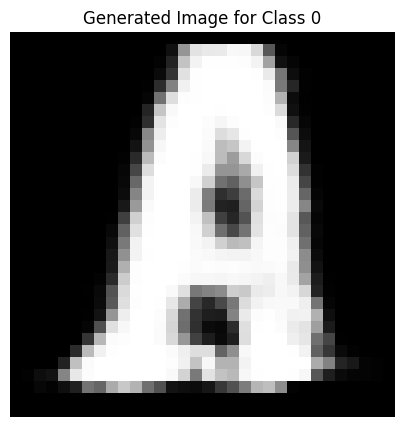

Epoch [1593/2500], D_loss: -0.09025046229362488, G_loss: -0.43731361627578735


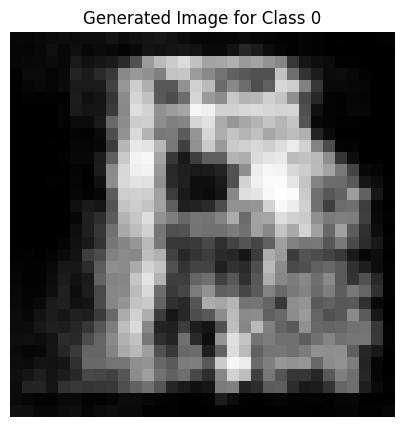

Epoch [1594/2500], D_loss: -0.07291563600301743, G_loss: -0.5358371734619141


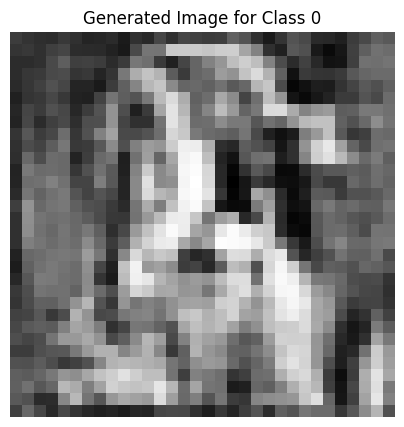

Epoch [1595/2500], D_loss: -0.08541140705347061, G_loss: -0.5375185012817383


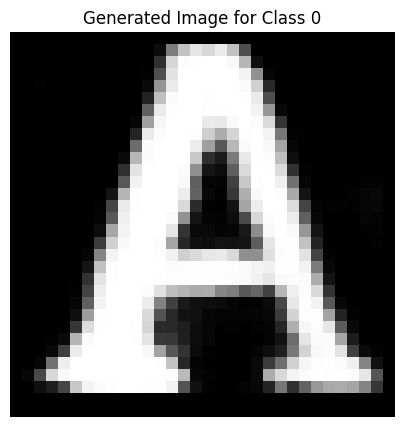

Epoch [1596/2500], D_loss: -0.07210777699947357, G_loss: -0.6041856408119202


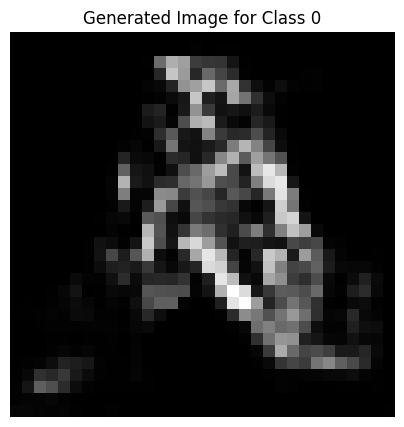

Epoch [1597/2500], D_loss: -0.046256549656391144, G_loss: -0.5482408404350281


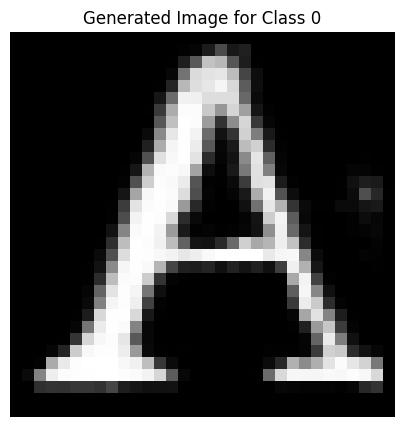

Epoch [1598/2500], D_loss: -0.08444662392139435, G_loss: -0.44373244047164917


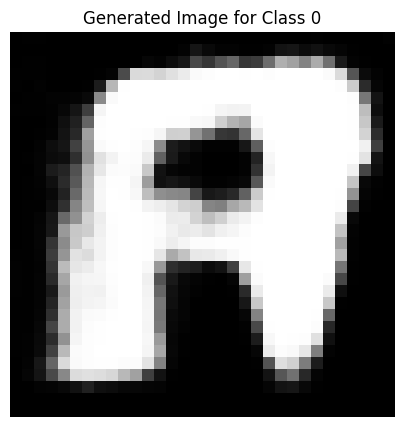

Epoch [1599/2500], D_loss: -0.08563567698001862, G_loss: -0.45469343662261963


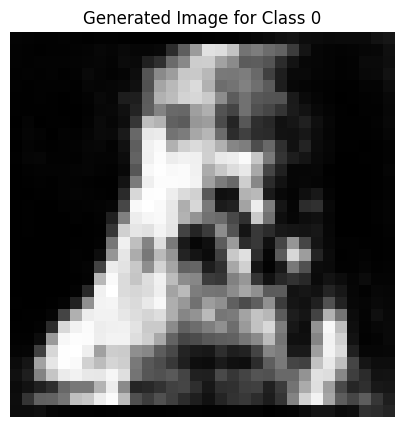

Epoch [1600/2500], D_loss: -0.08174469321966171, G_loss: -0.5179024934768677


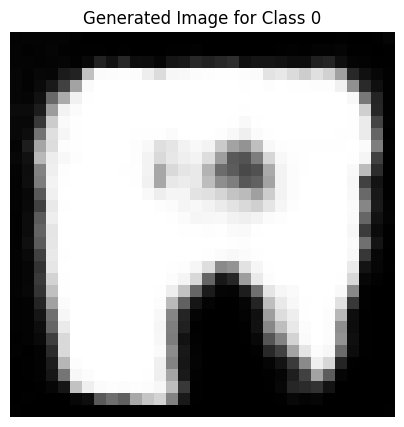

Epoch [1601/2500], D_loss: 0.025058045983314514, G_loss: -0.490060031414032


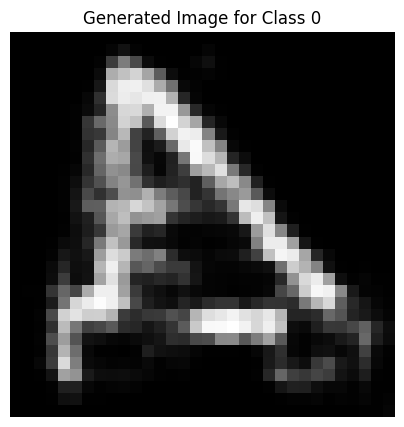

Epoch [1602/2500], D_loss: -0.02824302762746811, G_loss: -0.5071722865104675


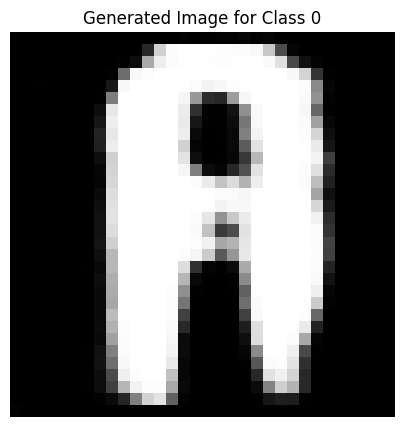

Epoch [1603/2500], D_loss: -0.04545530676841736, G_loss: -0.6273074150085449


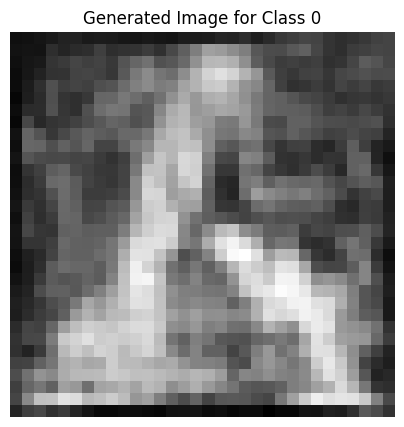

Epoch [1604/2500], D_loss: -0.06598891317844391, G_loss: -0.47304922342300415


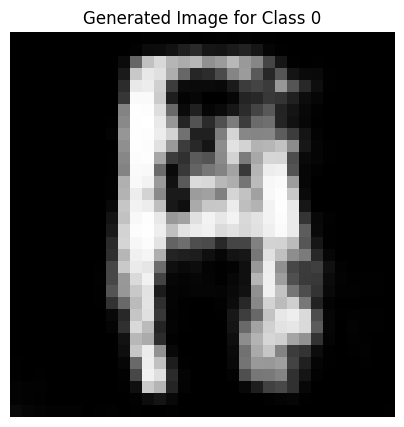

Epoch [1605/2500], D_loss: -0.07944841682910919, G_loss: -0.4946790337562561


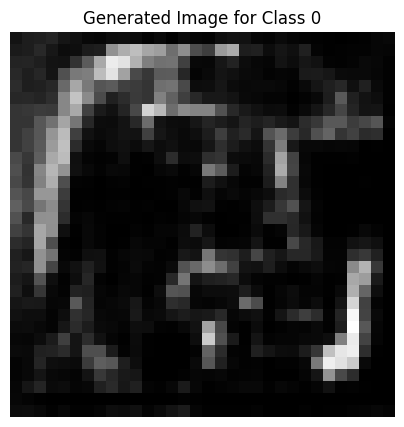

Epoch [1606/2500], D_loss: -0.05983208864927292, G_loss: -0.41236042976379395


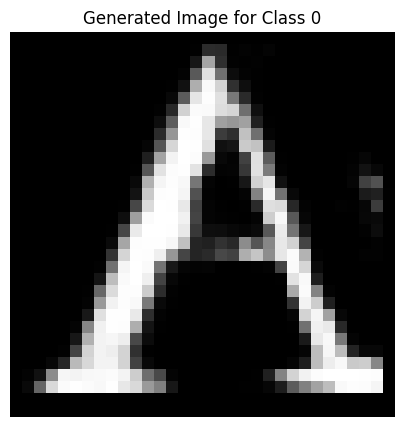

Epoch [1607/2500], D_loss: -0.0930023267865181, G_loss: -0.4646778106689453


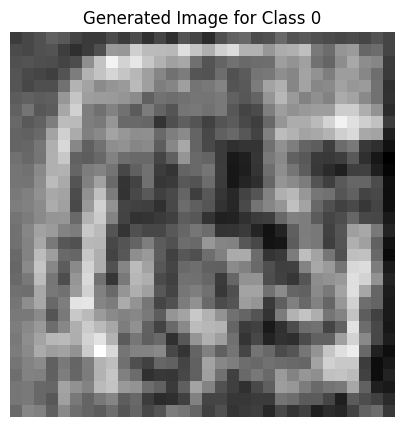

Epoch [1608/2500], D_loss: -0.0725099965929985, G_loss: -0.5283907651901245


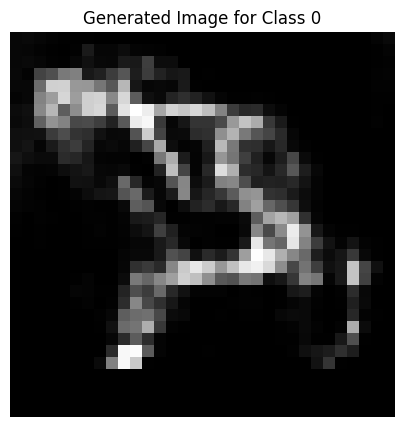

Epoch [1609/2500], D_loss: -0.07662995159626007, G_loss: -0.4954718351364136


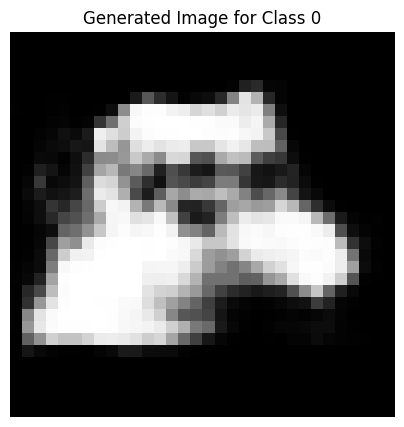

Epoch [1610/2500], D_loss: 0.012897282838821411, G_loss: -0.49653029441833496


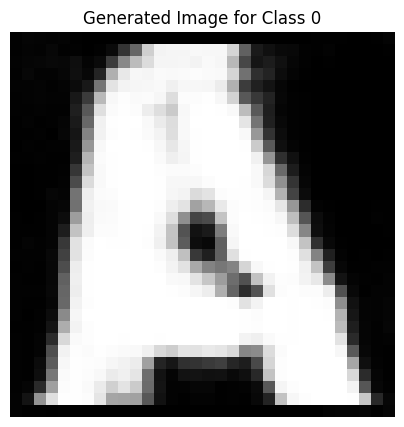

Epoch [1611/2500], D_loss: -0.08405864983797073, G_loss: -0.5159323215484619


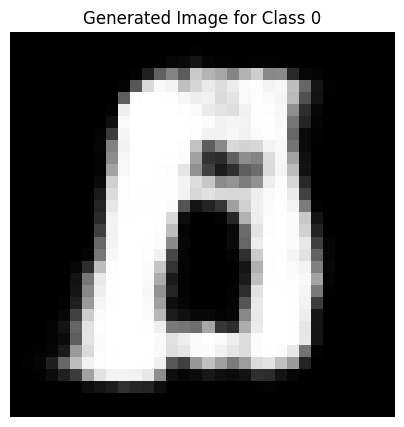

Epoch [1612/2500], D_loss: -0.024049408733844757, G_loss: -0.38157349824905396


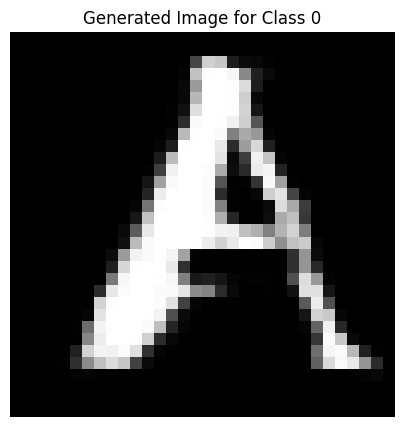

Epoch [1613/2500], D_loss: -0.03173096477985382, G_loss: -0.5180485248565674


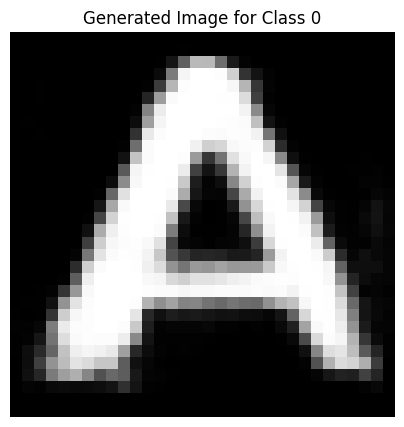

Epoch [1614/2500], D_loss: -0.0843927264213562, G_loss: -0.5692003965377808


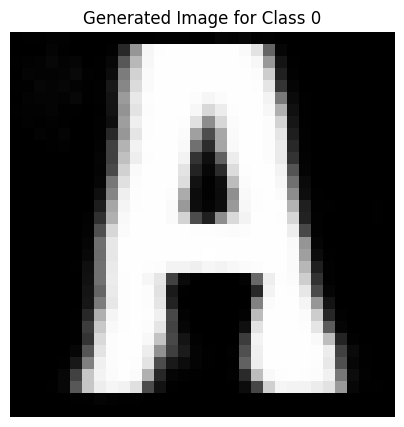

Epoch [1615/2500], D_loss: -0.064987912774086, G_loss: -0.5276399850845337


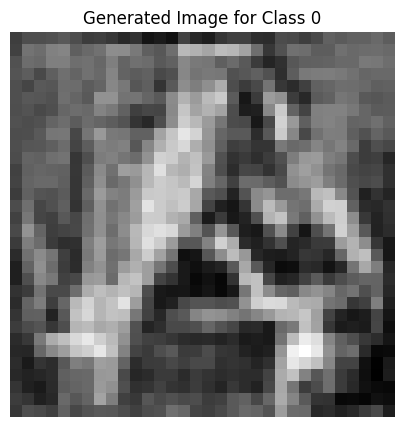

Epoch [1616/2500], D_loss: -0.0638737753033638, G_loss: -0.5324888825416565


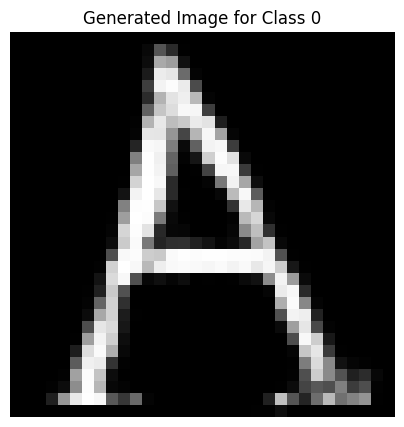

Epoch [1617/2500], D_loss: -0.06504431366920471, G_loss: -0.6401236653327942


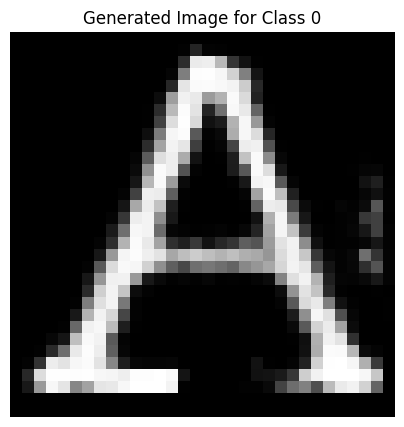

Epoch [1618/2500], D_loss: -0.07434157282114029, G_loss: -0.528529703617096


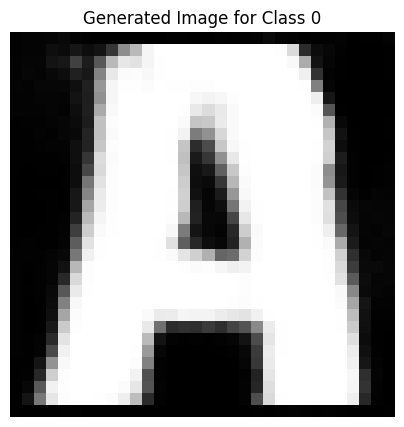

Epoch [1619/2500], D_loss: -0.07633556425571442, G_loss: -0.45339715480804443


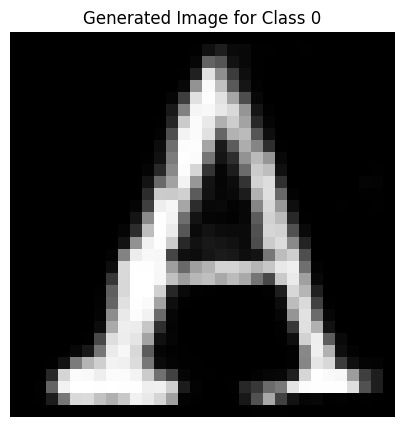

Epoch [1620/2500], D_loss: -0.06950001418590546, G_loss: -0.5479689240455627


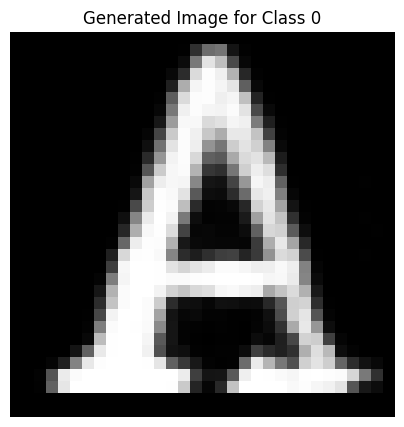

Epoch [1621/2500], D_loss: -0.06708061695098877, G_loss: -0.43558019399642944


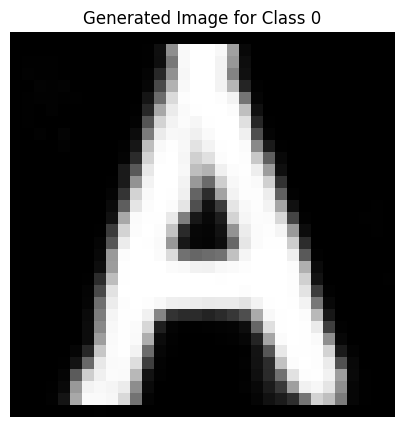

Epoch [1622/2500], D_loss: -0.060537248849868774, G_loss: -0.5334456562995911


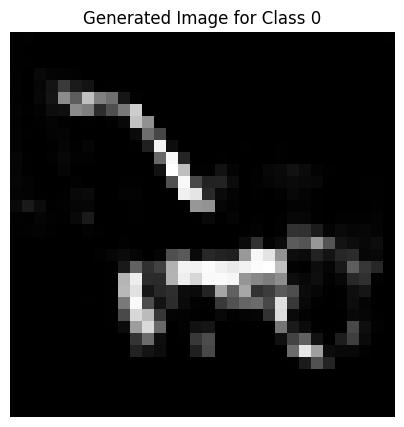

Epoch [1623/2500], D_loss: -0.04598361253738403, G_loss: -0.49100321531295776


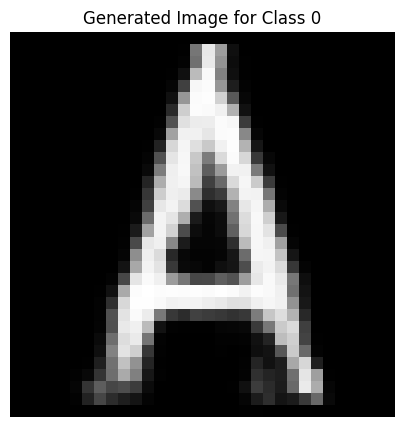

Epoch [1624/2500], D_loss: -0.07246636599302292, G_loss: -0.4421383738517761


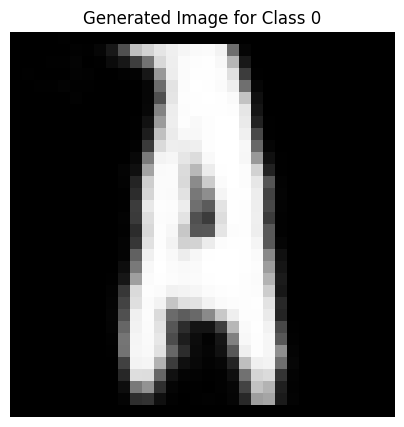

Epoch [1625/2500], D_loss: -0.053691357374191284, G_loss: -0.5823891162872314


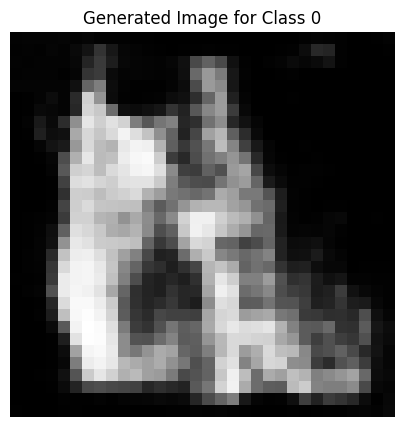

Epoch [1626/2500], D_loss: -0.03906622529029846, G_loss: -0.5327506065368652


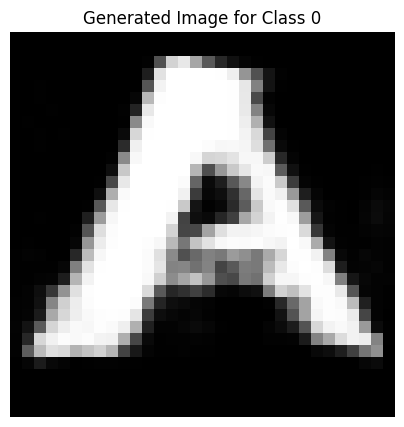

Epoch [1627/2500], D_loss: 0.009885415434837341, G_loss: -0.49219563603401184


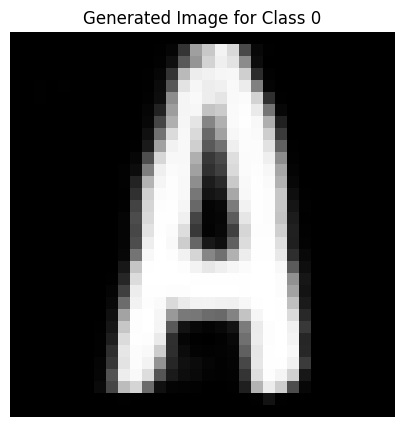

Epoch [1628/2500], D_loss: -0.034440889954566956, G_loss: -0.534221887588501


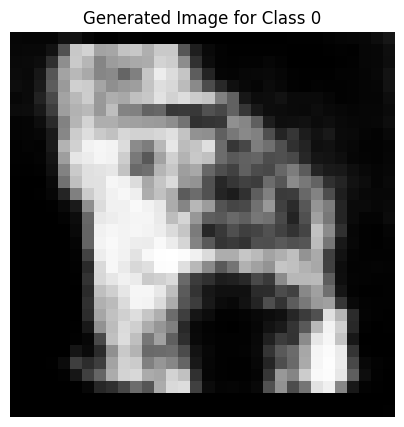

Epoch [1629/2500], D_loss: -0.03554572910070419, G_loss: -0.5220633149147034


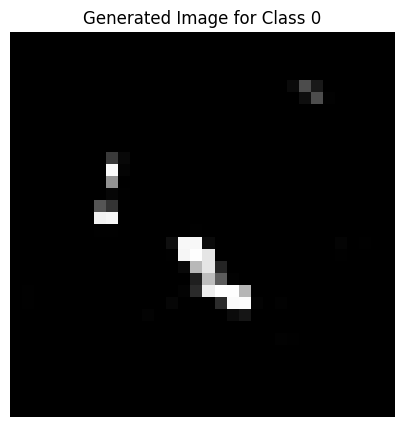

Epoch [1630/2500], D_loss: -0.039456985890865326, G_loss: -0.5217911005020142


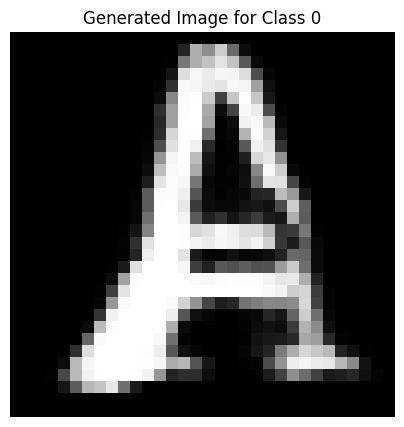

Epoch [1631/2500], D_loss: -0.06356734782457352, G_loss: -0.5611714124679565


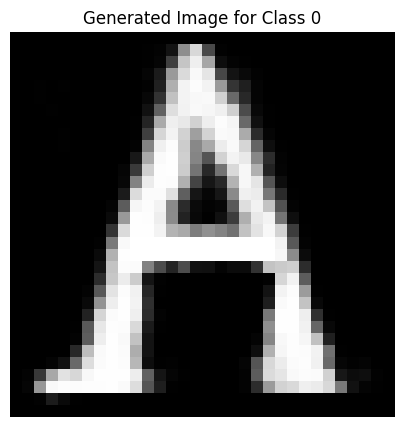

Epoch [1632/2500], D_loss: -0.07132960110902786, G_loss: -0.49524664878845215


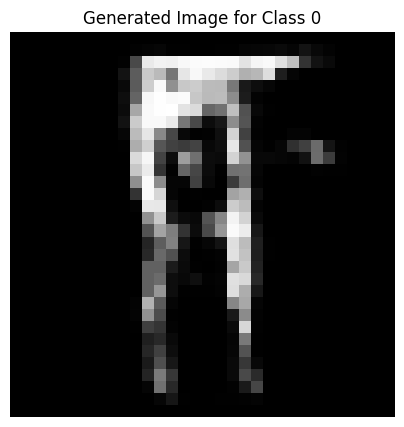

Epoch [1633/2500], D_loss: -0.0815666988492012, G_loss: -0.5402191877365112


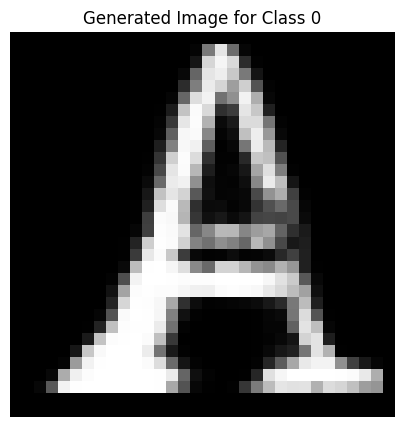

Epoch [1634/2500], D_loss: -0.07454599440097809, G_loss: -0.494411826133728


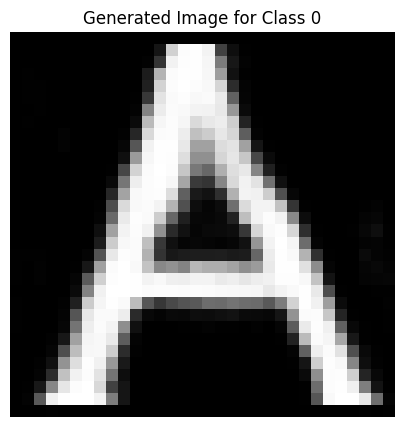

Epoch [1635/2500], D_loss: -0.027373522520065308, G_loss: -0.478221595287323


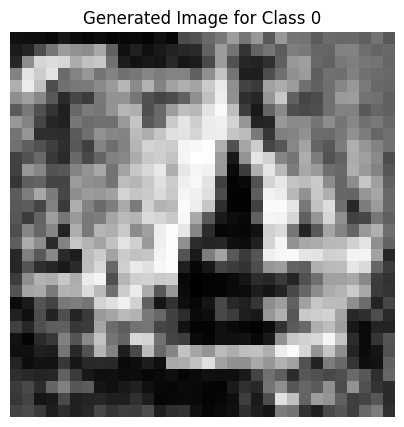

Epoch [1636/2500], D_loss: -0.011308684945106506, G_loss: -0.4863181710243225


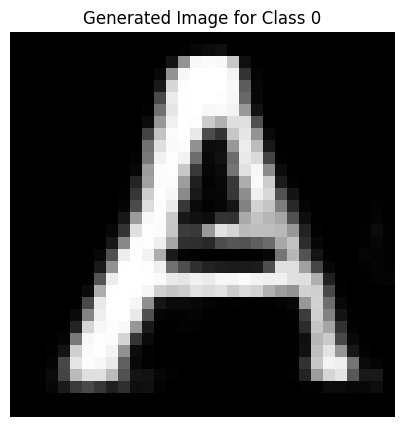

Epoch [1637/2500], D_loss: -0.07317563891410828, G_loss: -0.4673686921596527


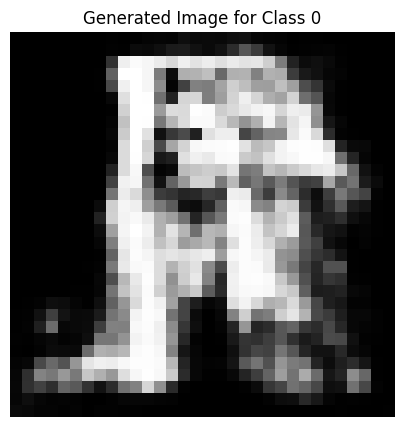

Epoch [1638/2500], D_loss: -0.07190939784049988, G_loss: -0.5606832504272461


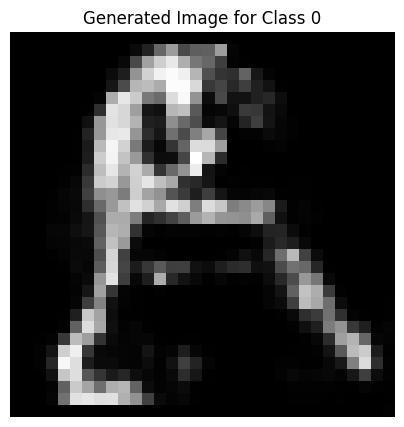

Epoch [1639/2500], D_loss: -0.06036681681871414, G_loss: -0.49366840720176697


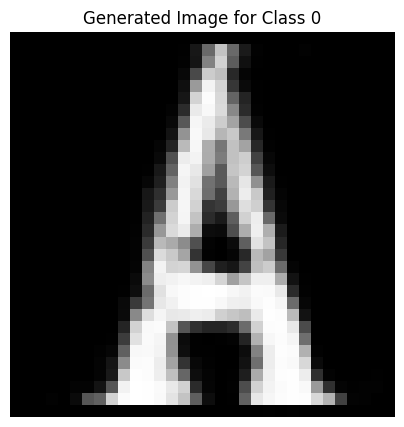

Epoch [1640/2500], D_loss: -0.03950950503349304, G_loss: -0.5058901309967041


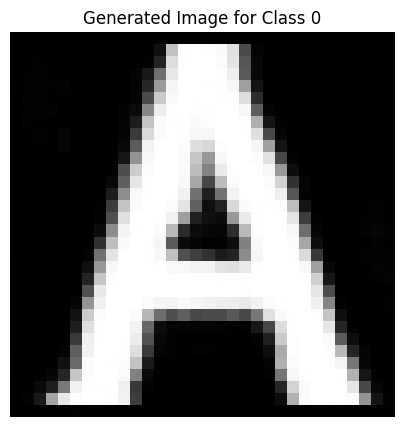

Epoch [1641/2500], D_loss: 0.022178635001182556, G_loss: -0.49733445048332214


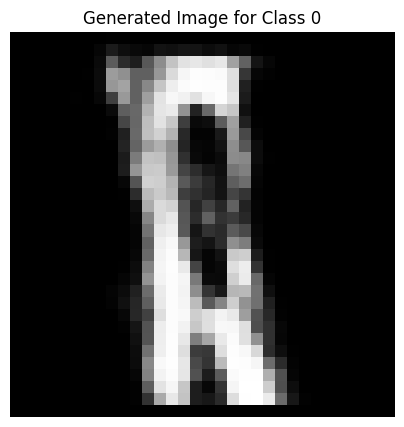

Epoch [1642/2500], D_loss: -0.07857995480298996, G_loss: -0.5204440355300903


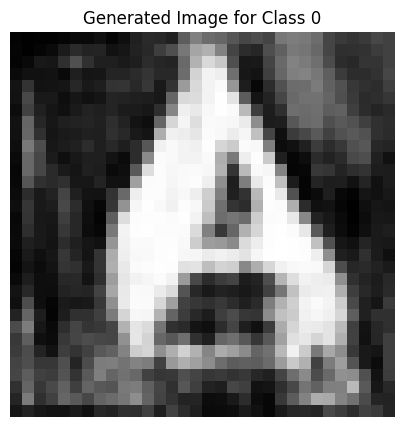

Epoch [1643/2500], D_loss: -0.07009033113718033, G_loss: -0.5410572290420532


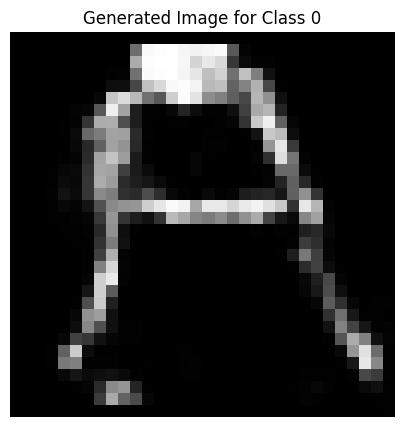

Epoch [1644/2500], D_loss: -0.08286304026842117, G_loss: -0.5511083006858826


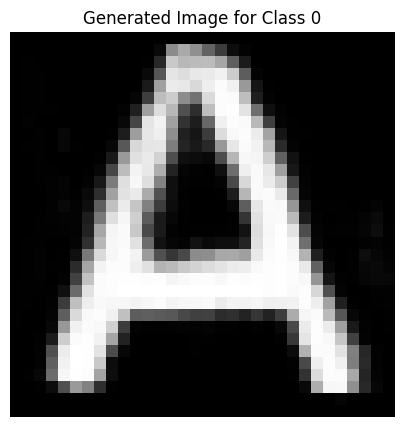

Epoch [1645/2500], D_loss: -0.0714544951915741, G_loss: -0.5356364846229553


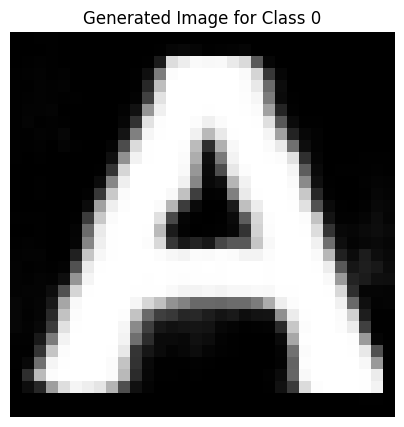

Epoch [1646/2500], D_loss: -0.08622322231531143, G_loss: -0.4825625717639923


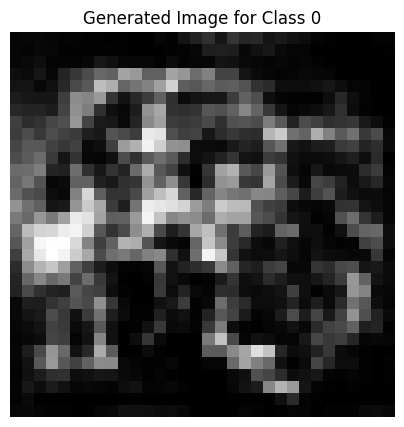

Epoch [1647/2500], D_loss: -0.09575160592794418, G_loss: -0.518624484539032


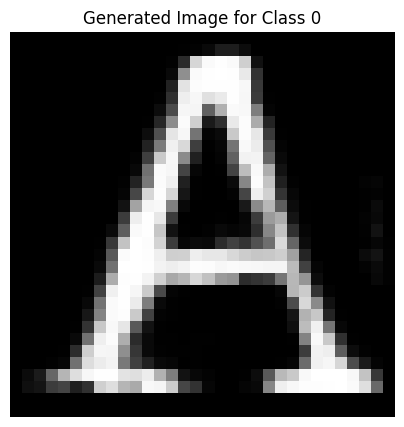

Epoch [1648/2500], D_loss: -0.07901254296302795, G_loss: -0.4657260775566101


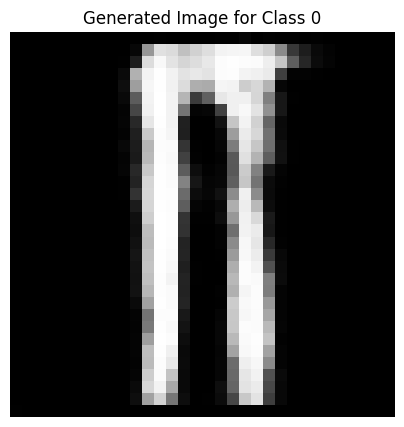

Epoch [1649/2500], D_loss: -0.04691494256258011, G_loss: -0.5376189947128296


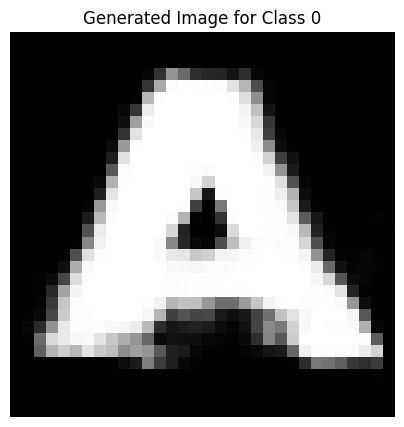

Epoch [1650/2500], D_loss: -0.07672035694122314, G_loss: -0.5070545673370361


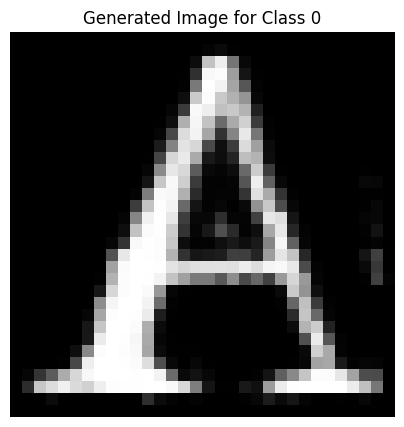

Epoch [1651/2500], D_loss: -0.07485194504261017, G_loss: -0.5089156031608582


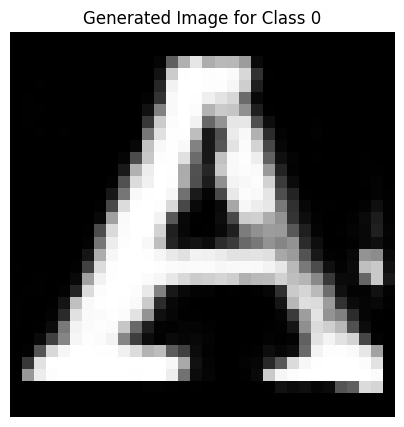

Epoch [1652/2500], D_loss: -0.08431912958621979, G_loss: -0.5542535781860352


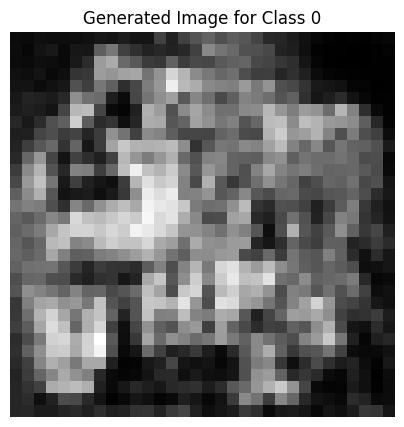

Epoch [1653/2500], D_loss: -0.06397951394319534, G_loss: -0.45632243156433105


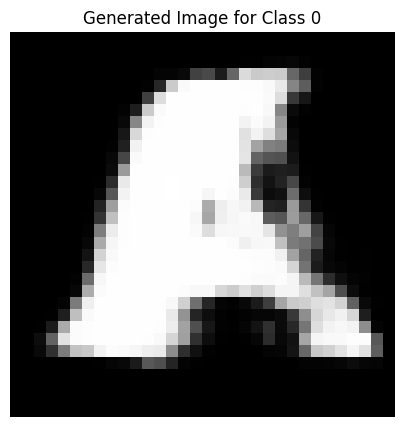

Epoch [1654/2500], D_loss: -0.030243530869483948, G_loss: -0.563467264175415


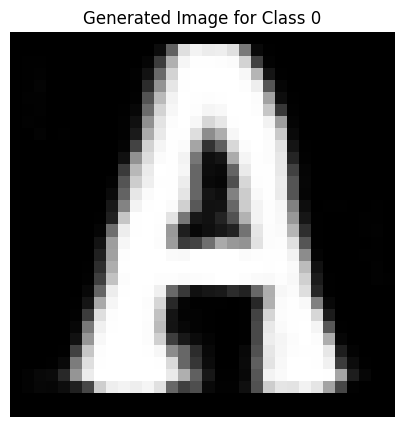

Epoch [1655/2500], D_loss: -0.0847381055355072, G_loss: -0.5141015648841858


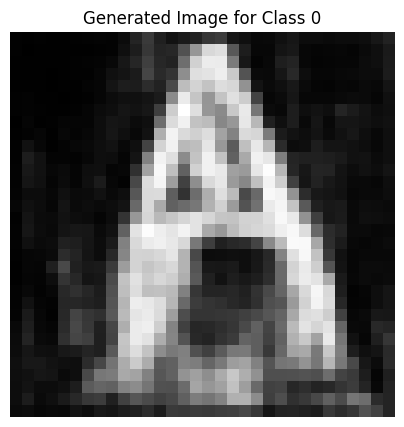

Epoch [1656/2500], D_loss: -0.06153276562690735, G_loss: -0.49235597252845764


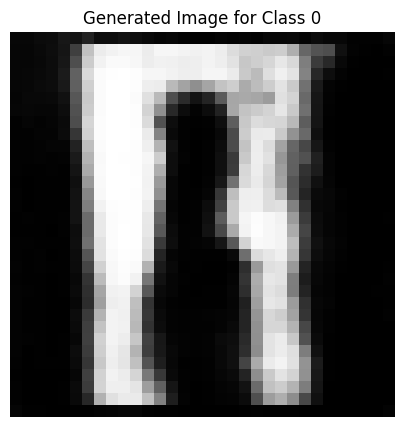

Epoch [1657/2500], D_loss: -0.053114429116249084, G_loss: -0.5559946298599243


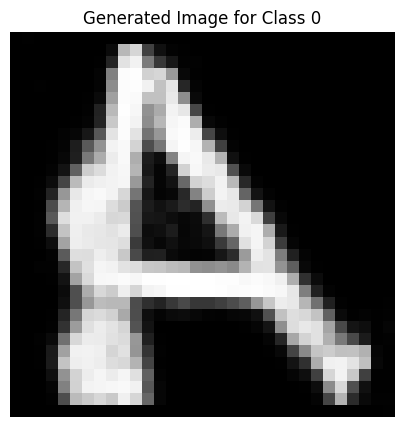

Epoch [1658/2500], D_loss: -0.07651598751544952, G_loss: -0.47089242935180664


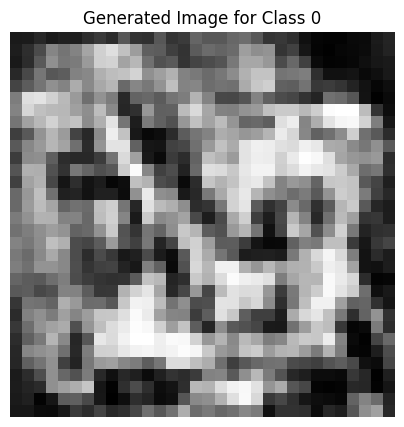

Epoch [1659/2500], D_loss: -0.08425924181938171, G_loss: -0.5109525918960571


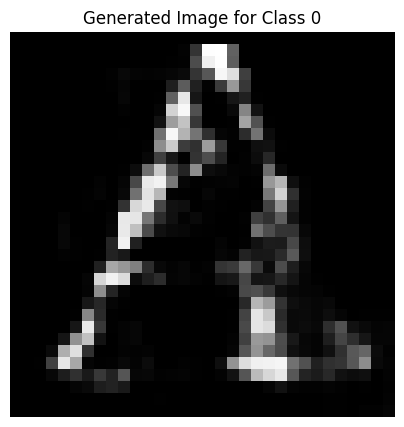

Epoch [1660/2500], D_loss: -0.07257554680109024, G_loss: -0.4323069155216217


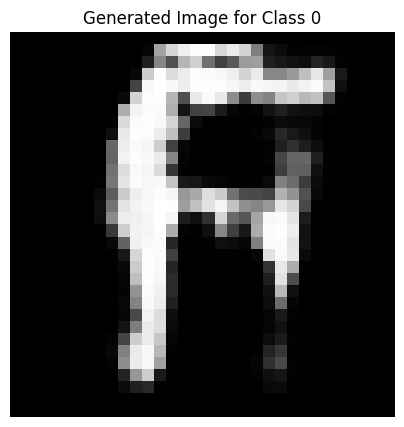

Epoch [1661/2500], D_loss: -0.035753197968006134, G_loss: -0.5740676522254944


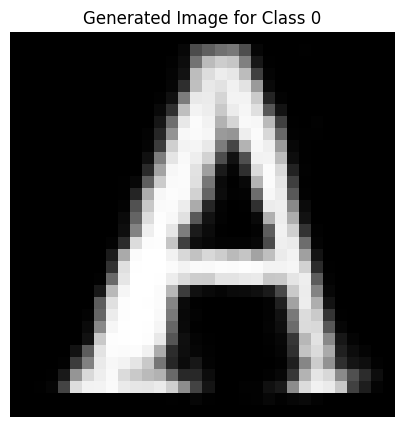

Epoch [1662/2500], D_loss: -0.0805257260799408, G_loss: -0.5099837779998779


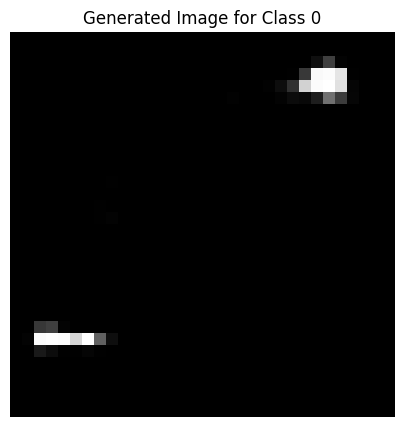

Epoch [1663/2500], D_loss: -0.06165541708469391, G_loss: -0.503000795841217


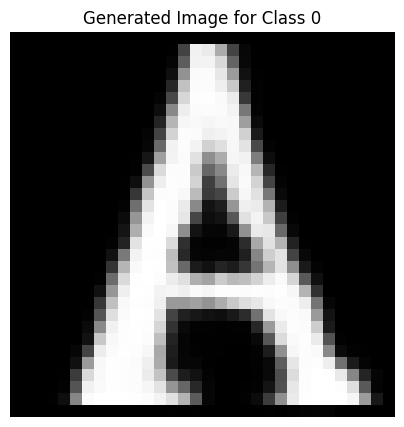

Epoch [1664/2500], D_loss: -0.0709056705236435, G_loss: -0.5366424322128296


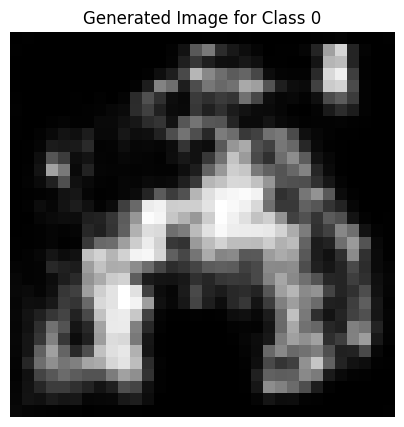

Epoch [1665/2500], D_loss: -0.08143298327922821, G_loss: -0.4411925971508026


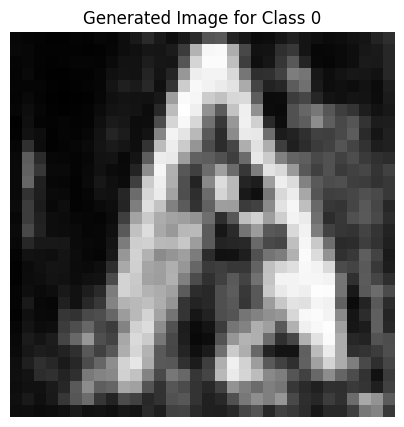

Epoch [1666/2500], D_loss: -0.07780604064464569, G_loss: -0.5092850923538208


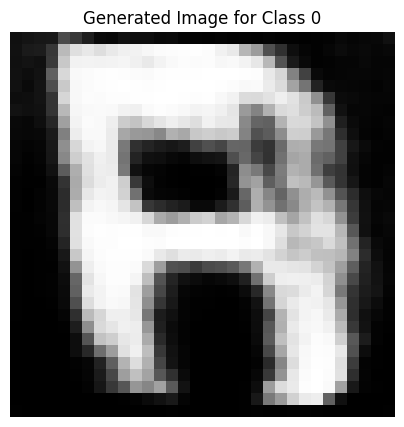

Epoch [1667/2500], D_loss: 0.051058873534202576, G_loss: -0.49698442220687866


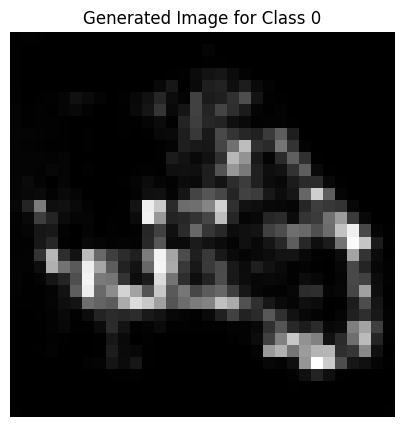

Epoch [1668/2500], D_loss: -0.08877559006214142, G_loss: -0.5169628858566284


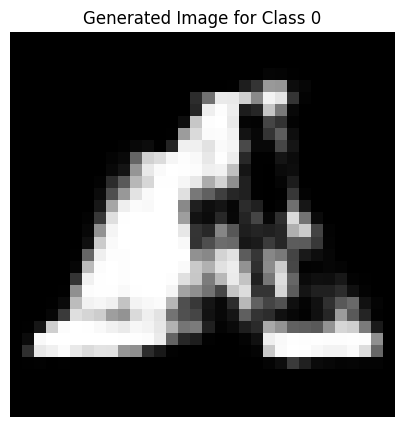

Epoch [1669/2500], D_loss: -0.05114047974348068, G_loss: -0.5214459896087646


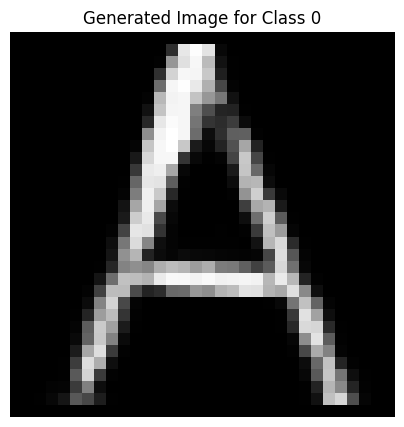

Epoch [1670/2500], D_loss: -0.08030974864959717, G_loss: -0.5197296738624573


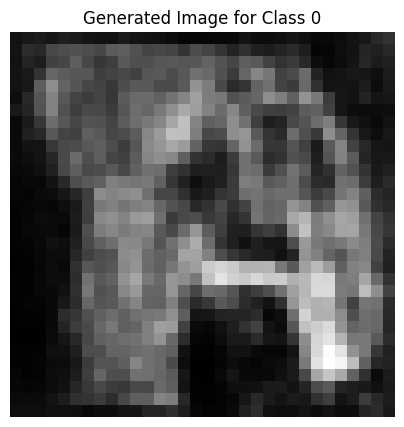

Epoch [1671/2500], D_loss: -0.020255684852600098, G_loss: -0.5208277702331543


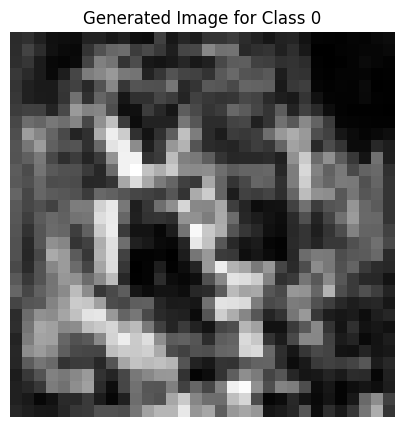

Epoch [1672/2500], D_loss: -0.06914319843053818, G_loss: -0.5510930418968201


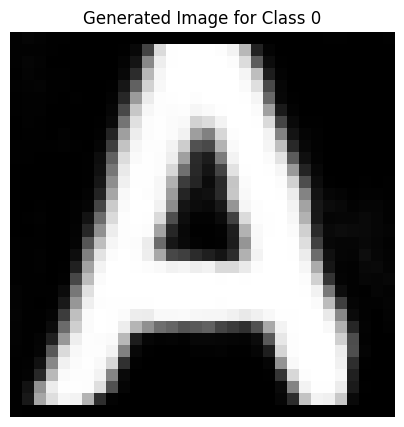

Epoch [1673/2500], D_loss: -0.0763663500547409, G_loss: -0.5620414018630981


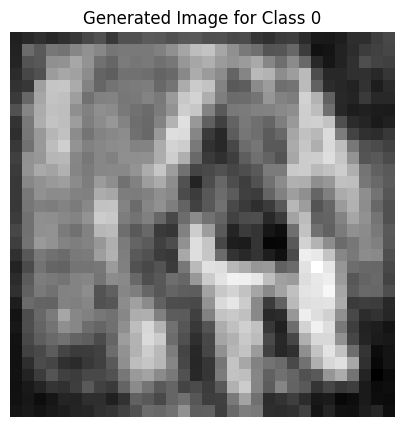

Epoch [1674/2500], D_loss: -0.0667821541428566, G_loss: -0.4307901859283447


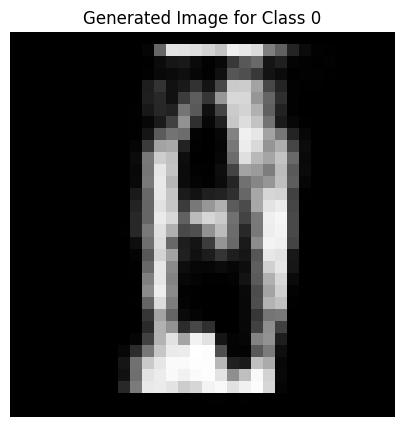

Epoch [1675/2500], D_loss: -0.06828811764717102, G_loss: -0.4835095703601837


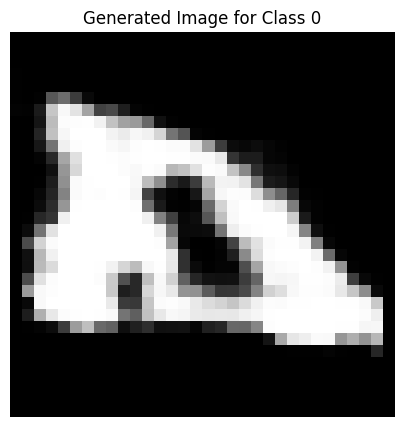

Epoch [1676/2500], D_loss: -0.072451651096344, G_loss: -0.47423258423805237


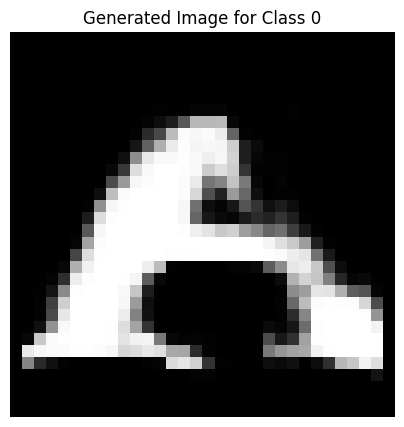

Epoch [1677/2500], D_loss: 0.05068732798099518, G_loss: -0.5124272108078003


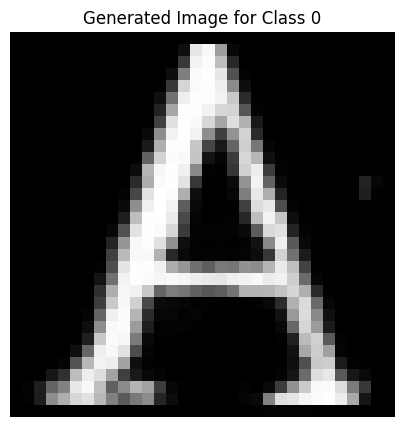

Epoch [1678/2500], D_loss: -0.058866292238235474, G_loss: -0.5192973613739014


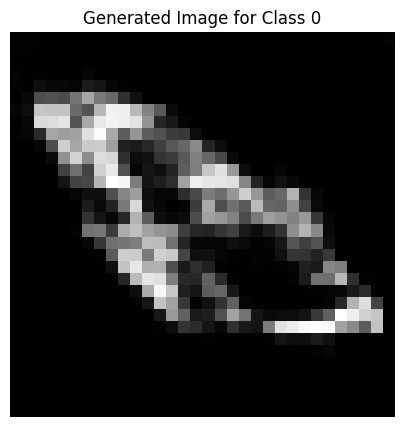

Epoch [1679/2500], D_loss: -0.0755331814289093, G_loss: -0.5127996802330017


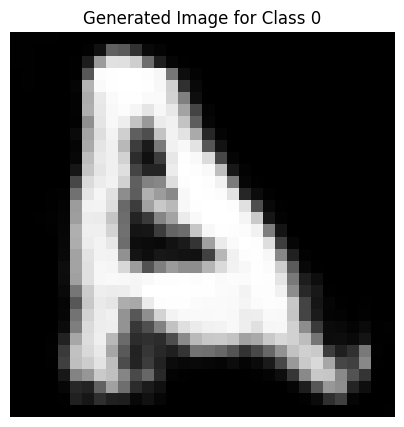

Epoch [1680/2500], D_loss: -0.06136621534824371, G_loss: -0.49956202507019043


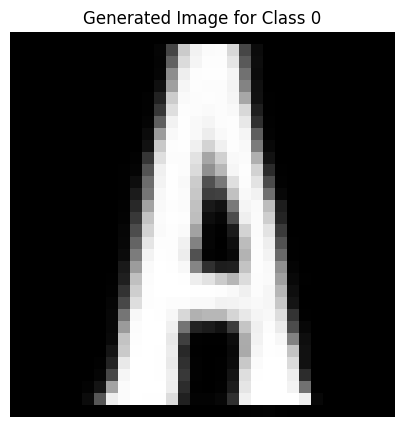

Epoch [1681/2500], D_loss: -0.07051326334476471, G_loss: -0.5011329650878906


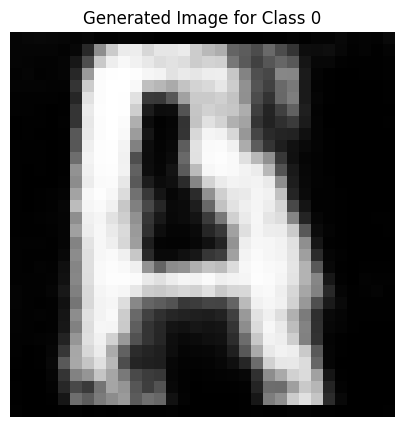

Epoch [1682/2500], D_loss: -0.08401098847389221, G_loss: -0.5193933248519897


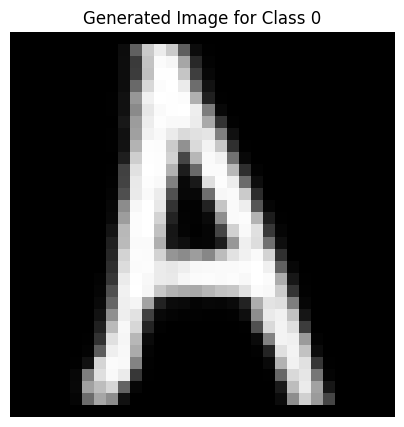

Epoch [1683/2500], D_loss: -0.060330554842948914, G_loss: -0.6310477256774902


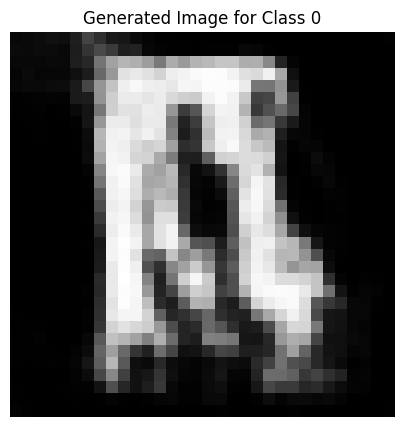

Epoch [1684/2500], D_loss: -0.07023054361343384, G_loss: -0.5525288581848145


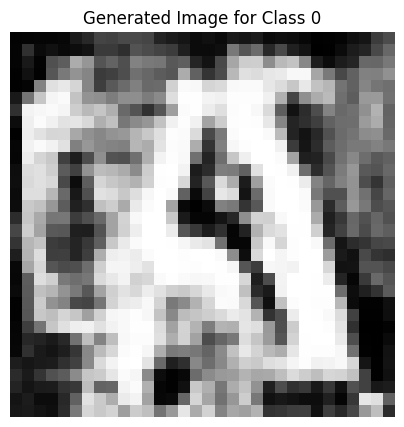

Epoch [1685/2500], D_loss: -0.09176620095968246, G_loss: -0.468641072511673


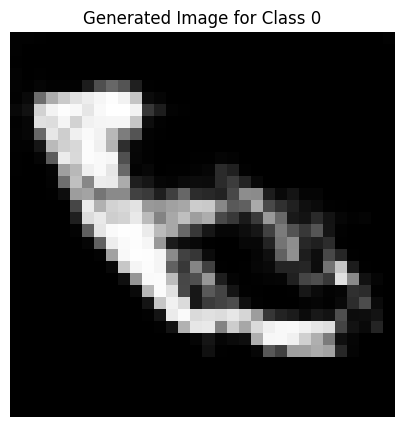

Epoch [1686/2500], D_loss: -0.08069837093353271, G_loss: -0.46330589056015015


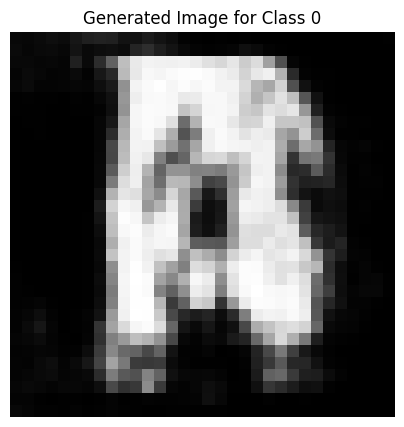

Epoch [1687/2500], D_loss: -0.08656525611877441, G_loss: -0.526007890701294


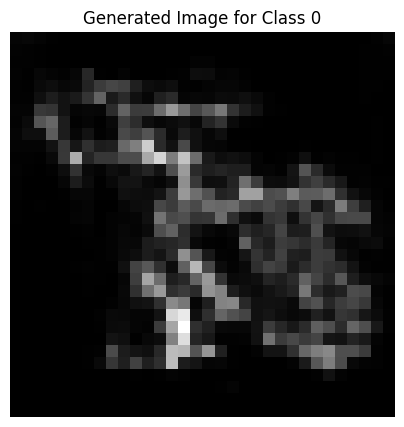

Epoch [1688/2500], D_loss: -0.07422393560409546, G_loss: -0.5927900671958923


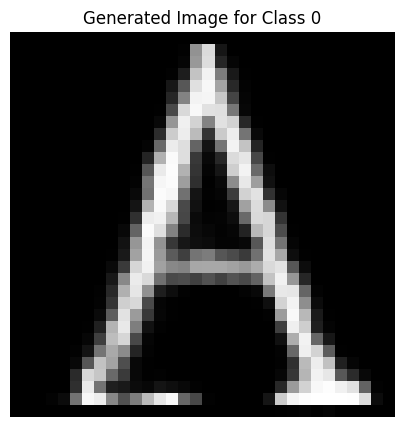

Epoch [1689/2500], D_loss: -0.07615984231233597, G_loss: -0.4364015460014343


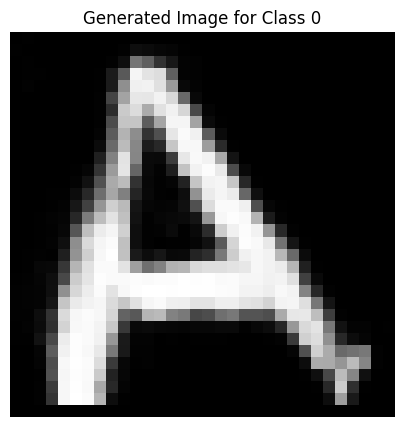

Epoch [1690/2500], D_loss: -0.07937806099653244, G_loss: -0.561729907989502


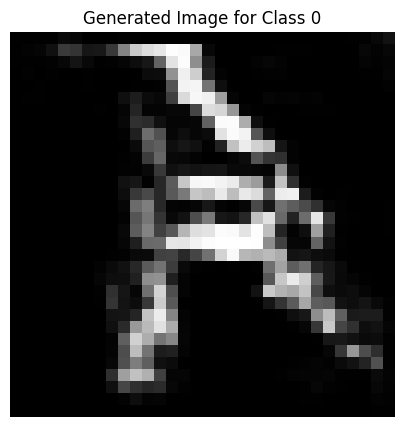

Epoch [1691/2500], D_loss: -0.05527332425117493, G_loss: -0.5602750778198242


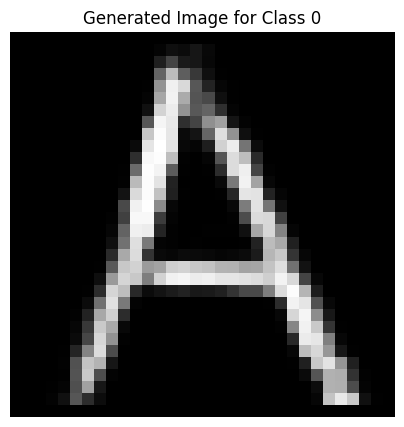

Epoch [1692/2500], D_loss: -0.058735355734825134, G_loss: -0.40031012892723083


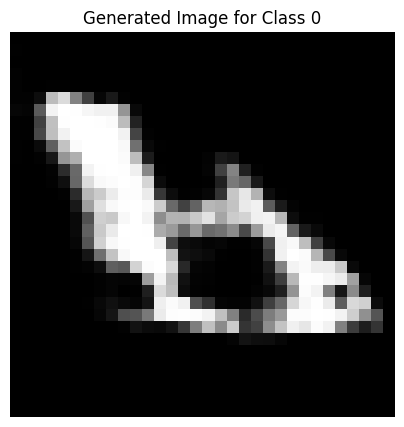

Epoch [1693/2500], D_loss: -0.07728046923875809, G_loss: -0.5227497220039368


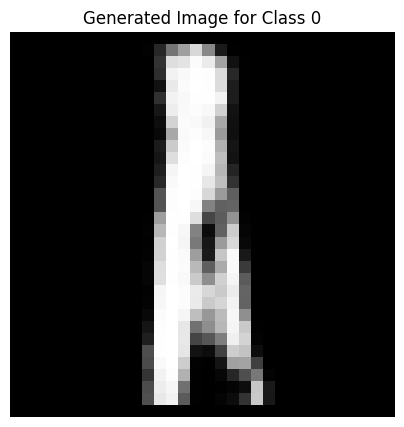

Epoch [1694/2500], D_loss: -0.09780026972293854, G_loss: -0.4986782670021057


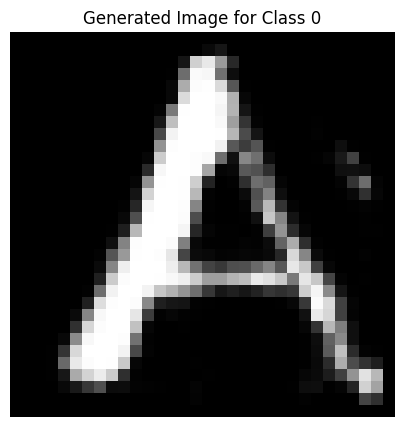

Epoch [1695/2500], D_loss: -0.08388980478048325, G_loss: -0.5456345677375793


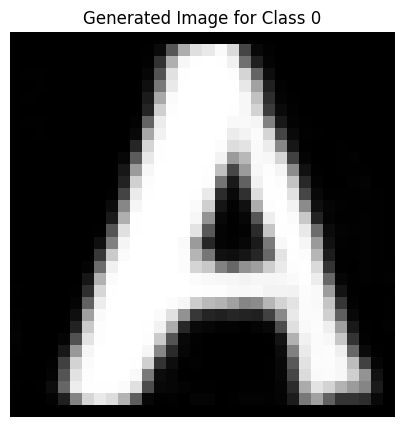

Epoch [1696/2500], D_loss: -0.09249155968427658, G_loss: -0.5149980783462524


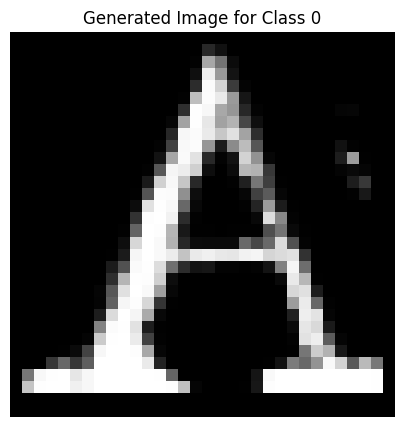

Epoch [1697/2500], D_loss: -0.07435262203216553, G_loss: -0.5062564015388489


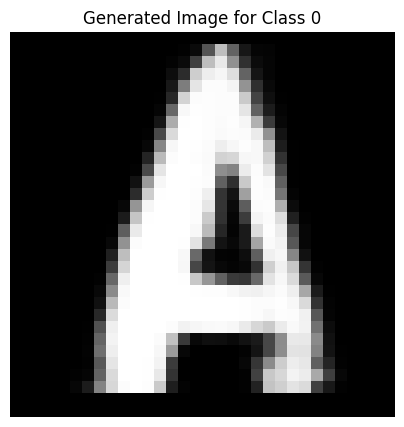

Epoch [1698/2500], D_loss: -0.08585599064826965, G_loss: -0.5159173011779785


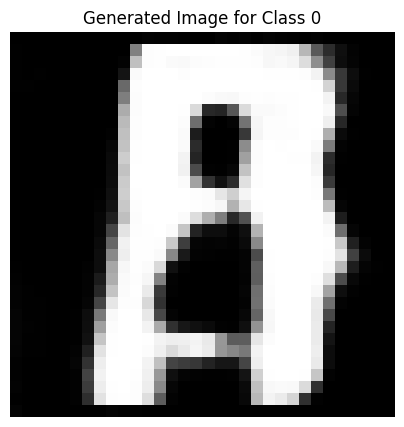

Epoch [1699/2500], D_loss: -0.08510172367095947, G_loss: -0.3822571039199829


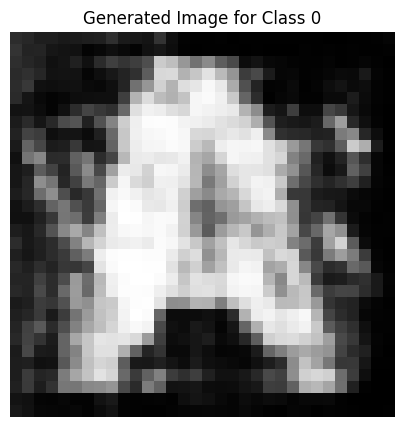

Epoch [1700/2500], D_loss: -0.05410464107990265, G_loss: -0.4416729807853699


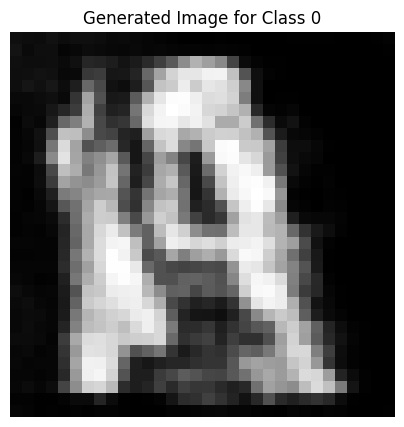

Epoch [1701/2500], D_loss: -0.07815726846456528, G_loss: -0.5979194641113281


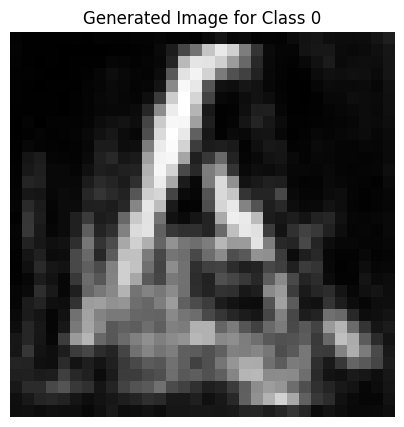

Epoch [1702/2500], D_loss: -0.09391171485185623, G_loss: -0.5256706476211548


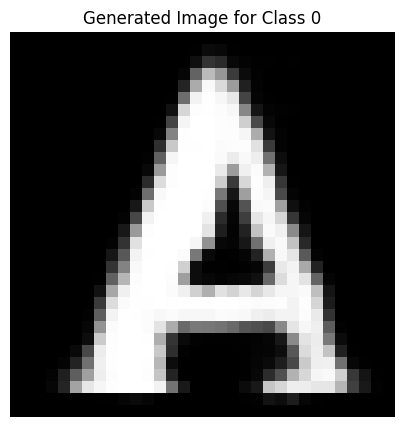

Epoch [1703/2500], D_loss: -0.08072112500667572, G_loss: -0.44002431631088257


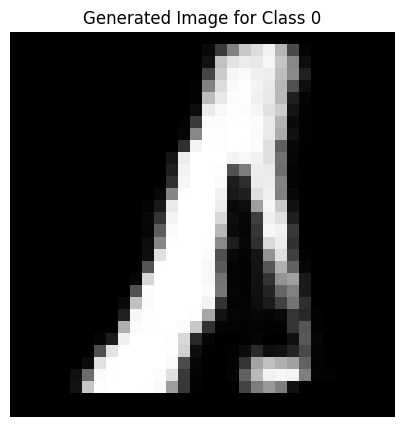

Epoch [1704/2500], D_loss: -0.07352115213871002, G_loss: -0.5367174744606018


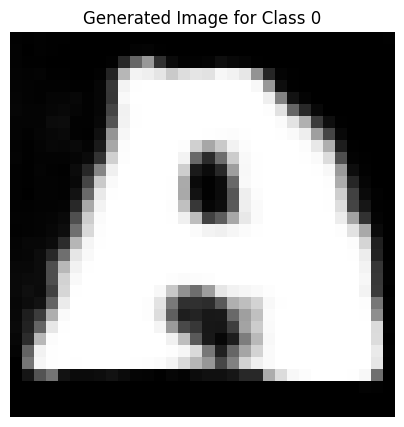

Epoch [1705/2500], D_loss: -0.1034228652715683, G_loss: -0.44750624895095825


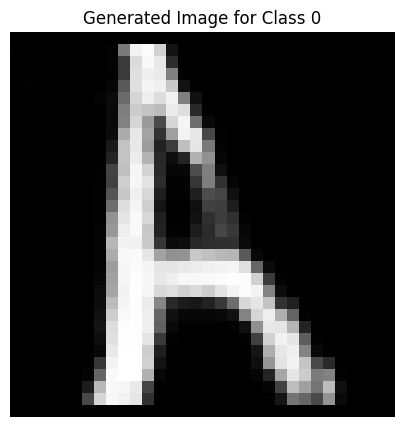

Epoch [1706/2500], D_loss: -0.08692756295204163, G_loss: -0.5674669742584229


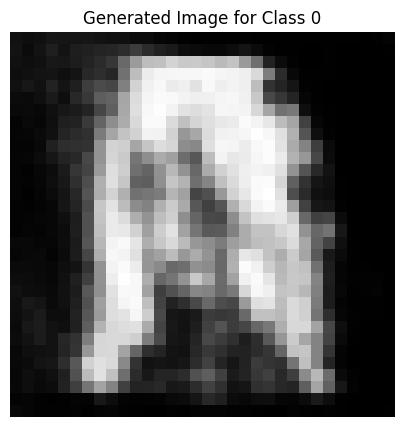

Epoch [1707/2500], D_loss: -0.07387596368789673, G_loss: -0.5168327689170837


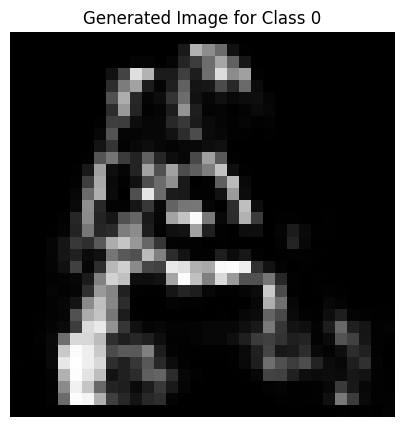

Epoch [1708/2500], D_loss: -0.09125781804323196, G_loss: -0.4712715148925781


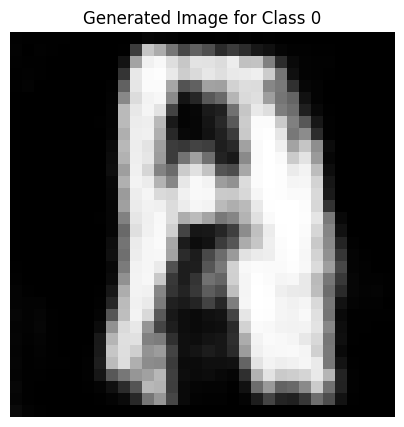

Epoch [1709/2500], D_loss: -0.09272817522287369, G_loss: -0.5281200408935547


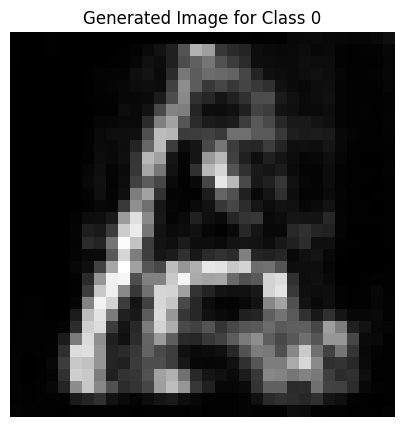

Epoch [1710/2500], D_loss: -0.0854053646326065, G_loss: -0.468855619430542


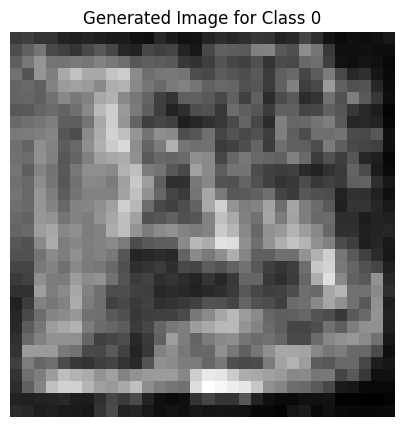

Epoch [1711/2500], D_loss: -0.11735846847295761, G_loss: -0.4770873188972473


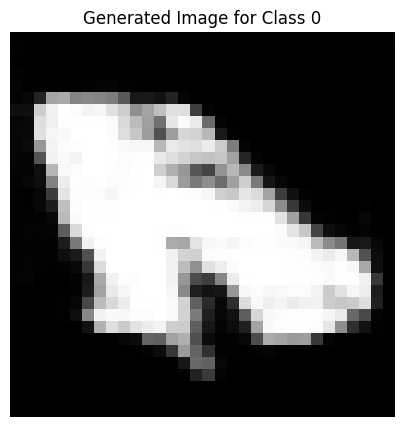

Epoch [1712/2500], D_loss: -0.09331785887479782, G_loss: -0.5349608659744263


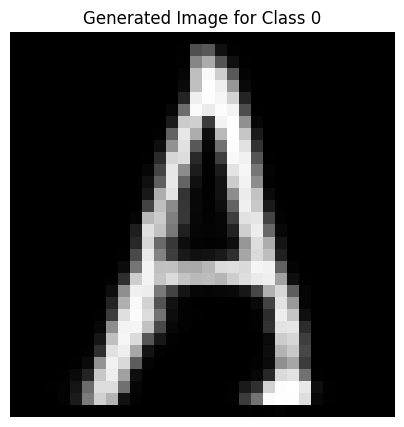

Epoch [1713/2500], D_loss: -0.07635585218667984, G_loss: -0.47015804052352905


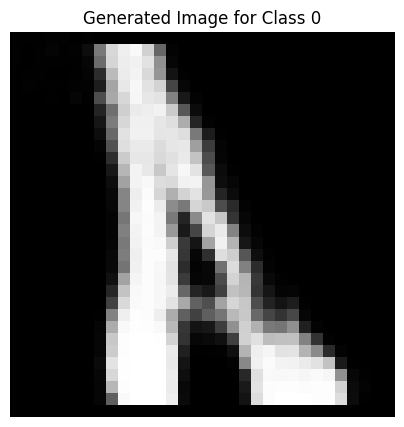

Epoch [1714/2500], D_loss: -0.0820518285036087, G_loss: -0.5074777603149414


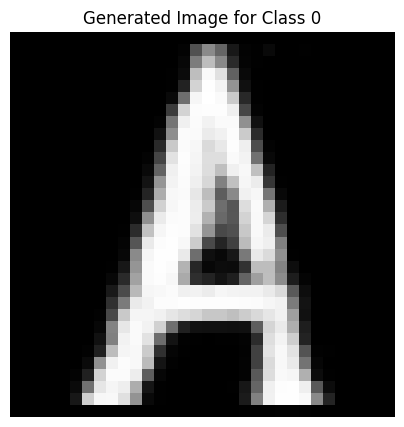

Epoch [1715/2500], D_loss: -0.08996360003948212, G_loss: -0.5340290665626526


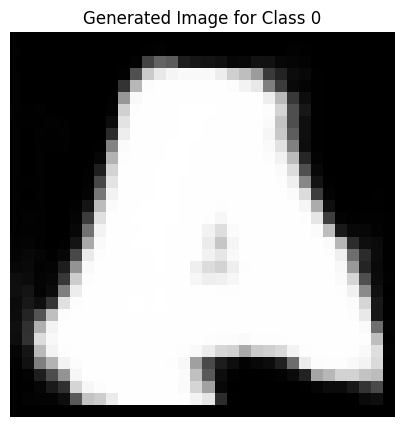

Epoch [1716/2500], D_loss: -0.07811480015516281, G_loss: -0.47924110293388367


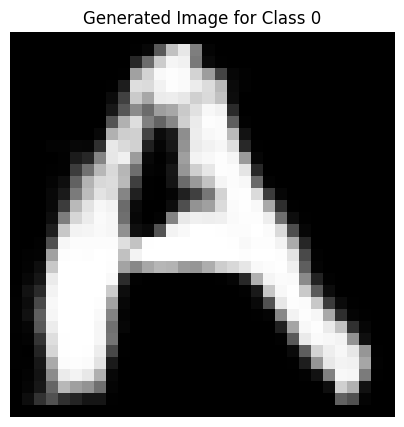

Epoch [1717/2500], D_loss: -0.0817994475364685, G_loss: -0.5046921968460083


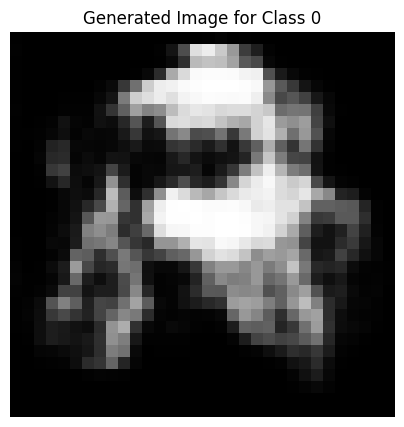

Epoch [1718/2500], D_loss: -0.08035878092050552, G_loss: -0.4606831967830658


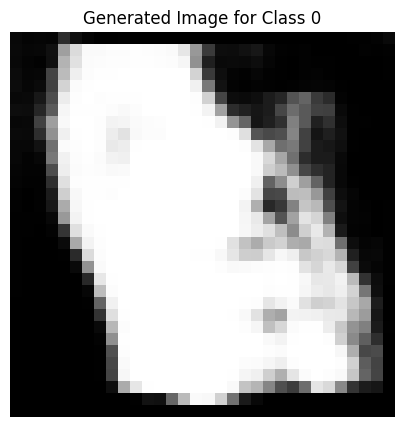

Epoch [1719/2500], D_loss: -0.09788798540830612, G_loss: -0.46322715282440186


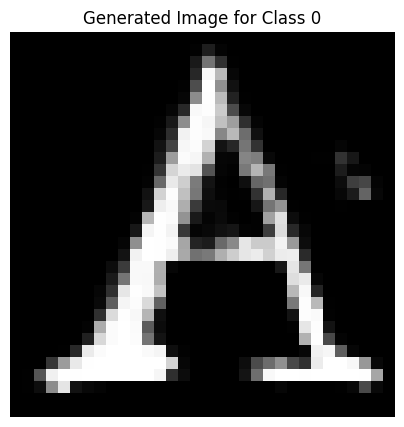

Epoch [1720/2500], D_loss: -0.07517242431640625, G_loss: -0.5221275091171265


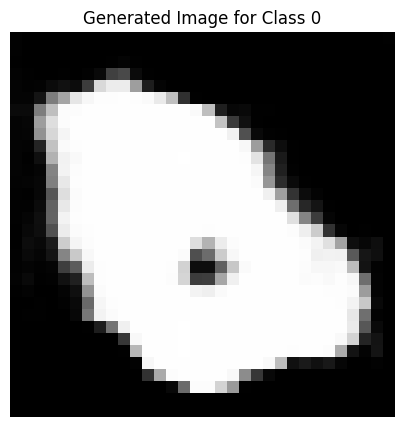

Epoch [1721/2500], D_loss: -0.0950472354888916, G_loss: -0.5159563422203064


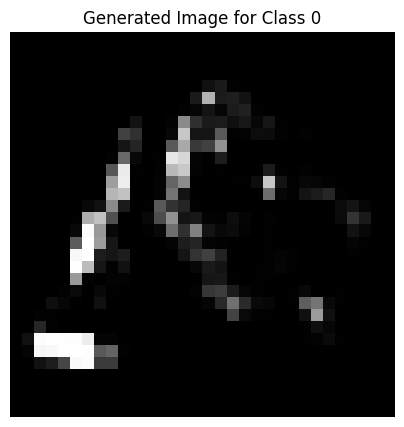

Epoch [1722/2500], D_loss: -0.07279022783041, G_loss: -0.5205277800559998


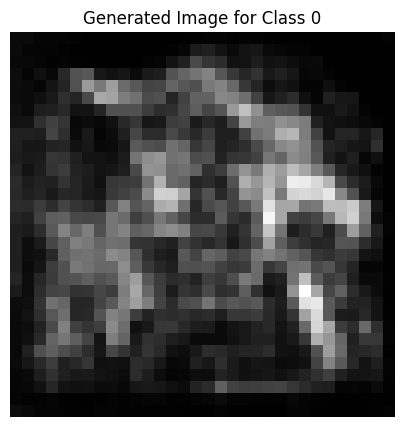

Epoch [1723/2500], D_loss: -0.09426473826169968, G_loss: -0.3552389144897461


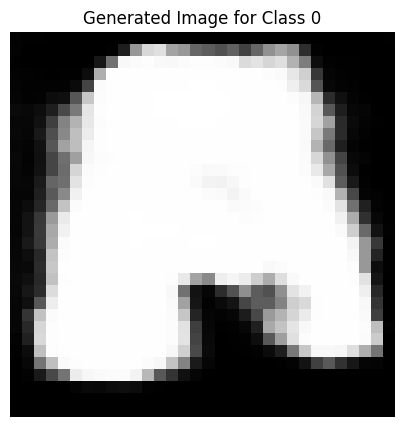

Epoch [1724/2500], D_loss: -0.08697926253080368, G_loss: -0.5614637732505798


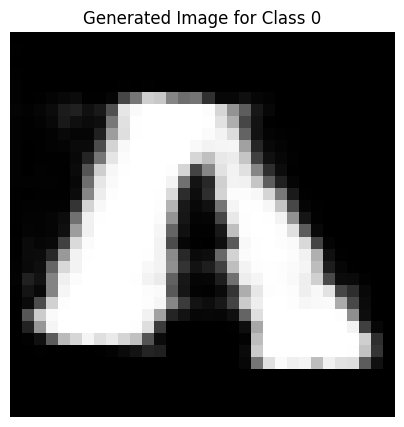

Epoch [1725/2500], D_loss: -0.07046426832675934, G_loss: -0.5134278535842896


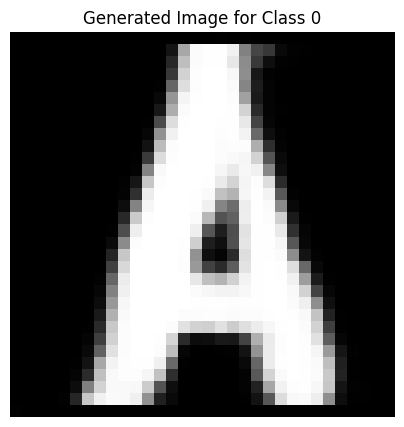

Epoch [1726/2500], D_loss: -0.07662226259708405, G_loss: -0.49080872535705566


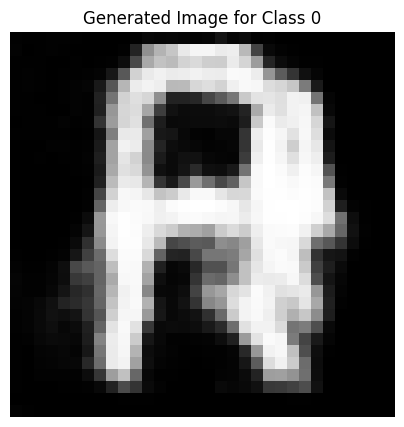

Epoch [1727/2500], D_loss: -0.07797719538211823, G_loss: -0.49026182293891907


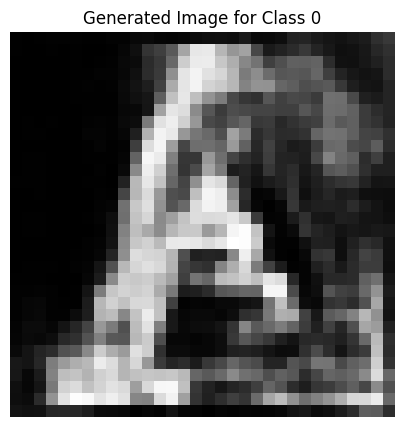

Epoch [1728/2500], D_loss: -0.0713023915886879, G_loss: -0.6101850271224976


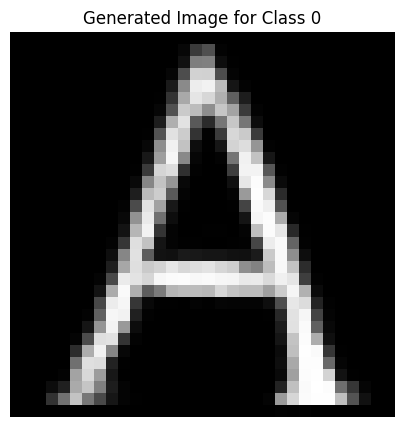

Epoch [1729/2500], D_loss: -0.06877230852842331, G_loss: -0.568583607673645


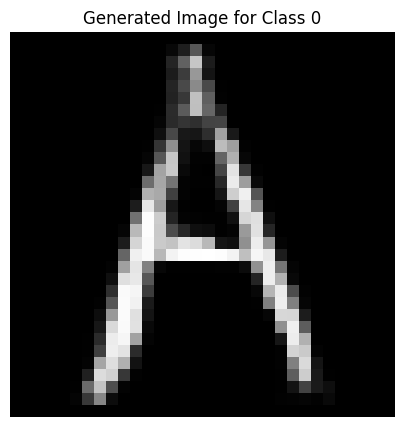

Epoch [1730/2500], D_loss: -0.10586388409137726, G_loss: -0.47300541400909424


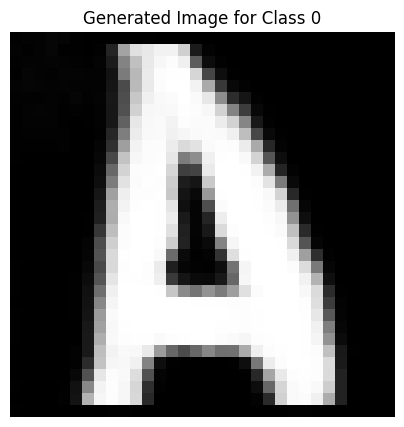

Epoch [1731/2500], D_loss: -0.10258069634437561, G_loss: -0.45527398586273193


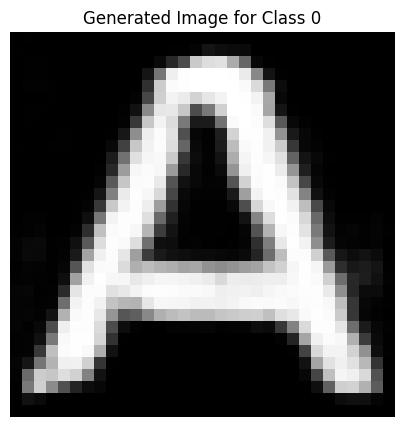

Epoch [1732/2500], D_loss: -0.08052145689725876, G_loss: -0.43836596608161926


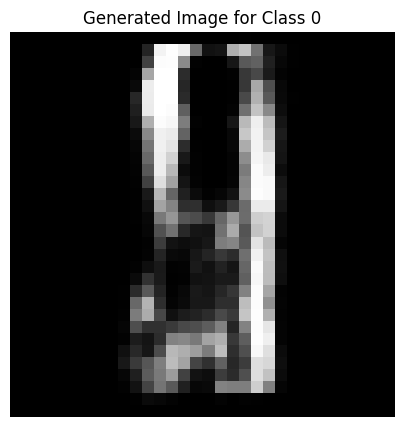

Epoch [1733/2500], D_loss: -0.06359288841485977, G_loss: -0.4877066910266876


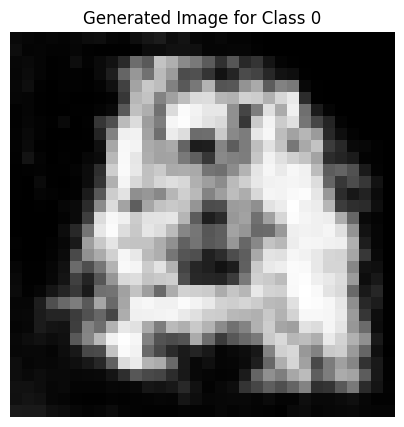

Epoch [1734/2500], D_loss: -0.08631514012813568, G_loss: -0.4891582131385803


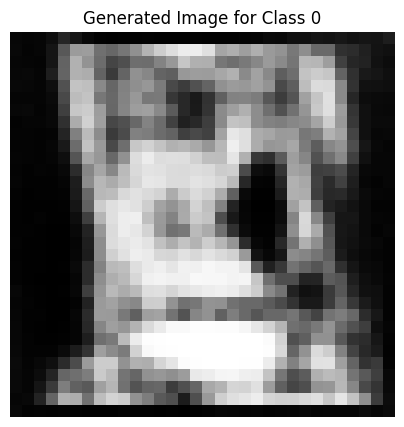

Epoch [1735/2500], D_loss: -0.039632648229599, G_loss: -0.6147781014442444


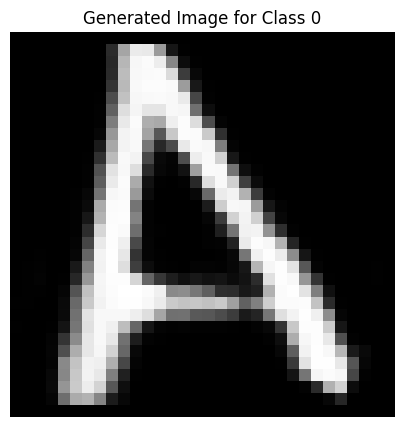

Epoch [1736/2500], D_loss: -0.10127236694097519, G_loss: -0.5043975114822388


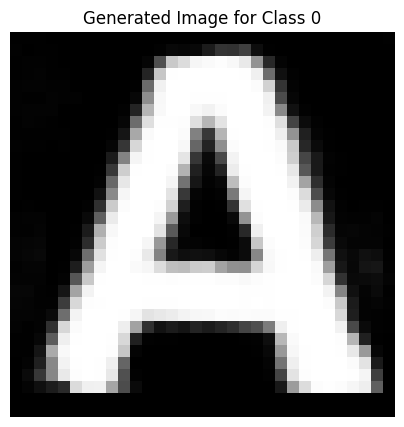

Epoch [1737/2500], D_loss: -0.10098696500062943, G_loss: -0.47767627239227295


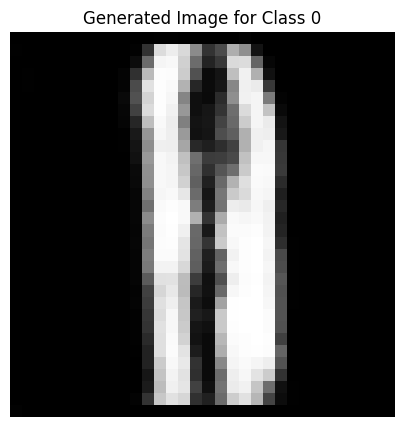

Epoch [1738/2500], D_loss: -0.09299638867378235, G_loss: -0.4840087294578552


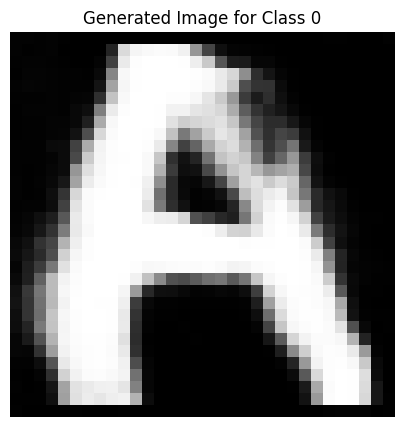

Epoch [1739/2500], D_loss: -0.09214600175619125, G_loss: -0.5172678232192993


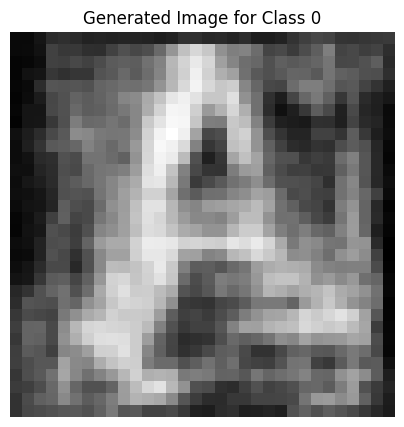

Epoch [1740/2500], D_loss: -0.10829046368598938, G_loss: -0.5216304063796997


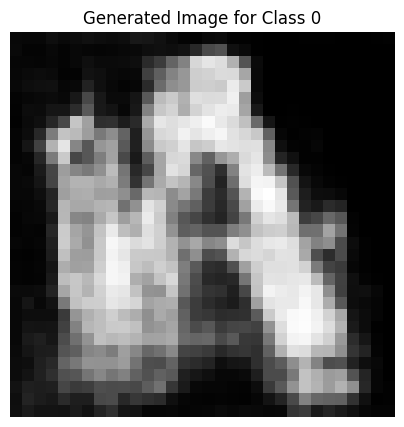

Epoch [1741/2500], D_loss: -0.08487019687891006, G_loss: -0.523699164390564


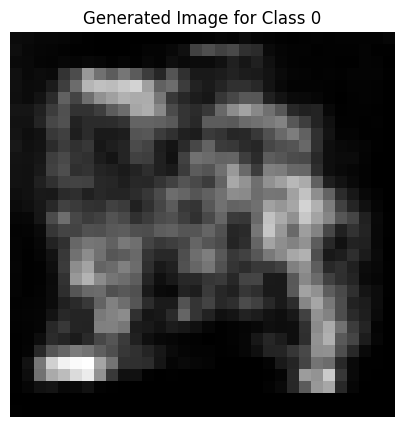

Epoch [1742/2500], D_loss: -0.10946568101644516, G_loss: -0.44940805435180664


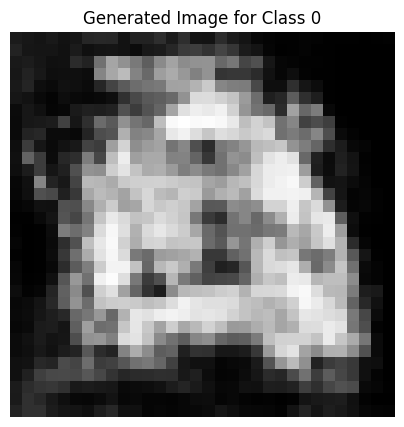

Epoch [1743/2500], D_loss: -0.09410776942968369, G_loss: -0.4514903128147125


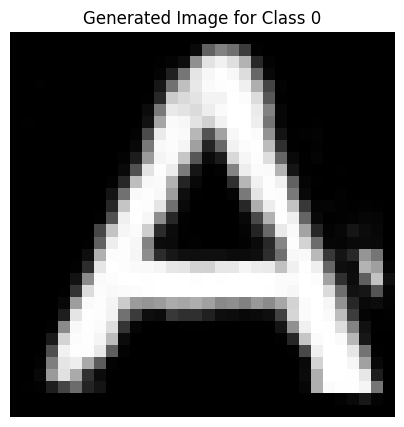

Epoch [1744/2500], D_loss: -0.09360712021589279, G_loss: -0.45268571376800537


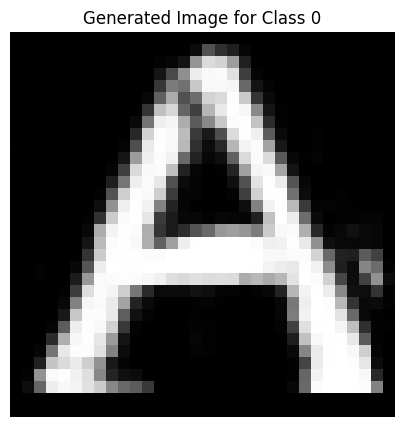

Epoch [1745/2500], D_loss: -0.09606295078992844, G_loss: -0.5211580395698547


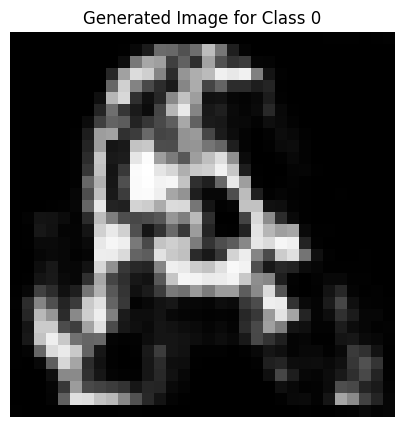

Epoch [1746/2500], D_loss: -0.08847908675670624, G_loss: -0.46058258414268494


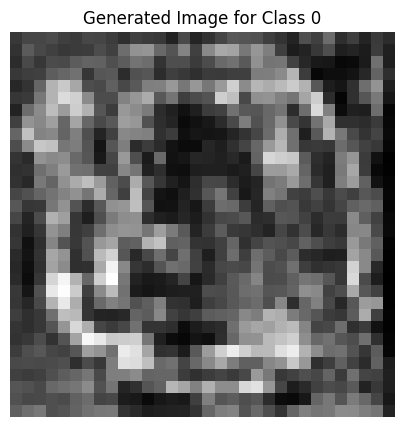

Epoch [1747/2500], D_loss: -0.09713038802146912, G_loss: -0.5252116918563843


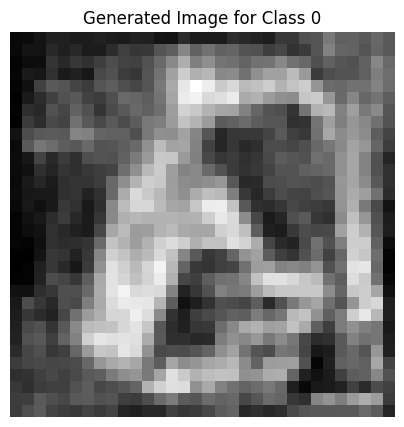

Epoch [1748/2500], D_loss: -0.06572801619768143, G_loss: -0.5096099376678467


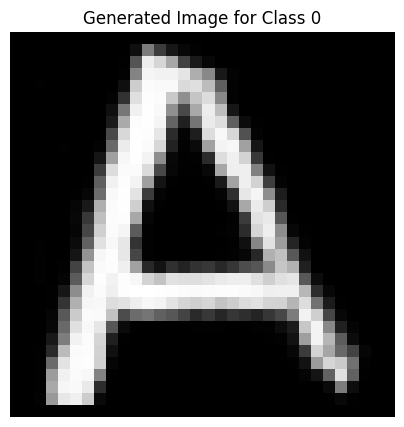

Epoch [1749/2500], D_loss: -0.09036291390657425, G_loss: -0.4702138900756836


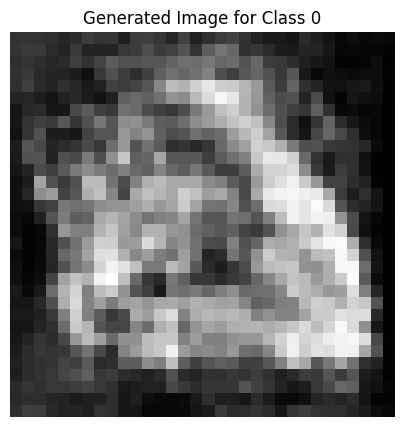

Epoch [1750/2500], D_loss: -0.11094783246517181, G_loss: -0.46683067083358765


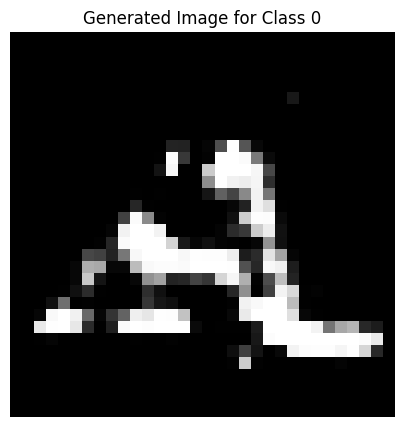

Epoch [1751/2500], D_loss: -0.0856548547744751, G_loss: -0.4981275200843811


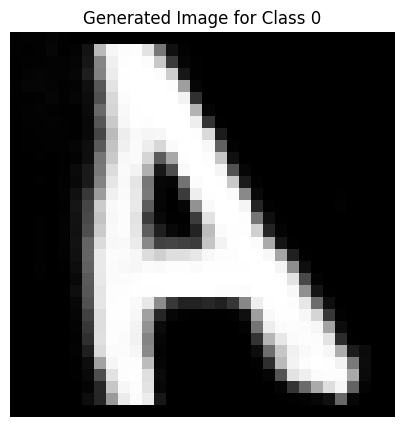

Epoch [1752/2500], D_loss: -0.09759359061717987, G_loss: -0.4592520594596863


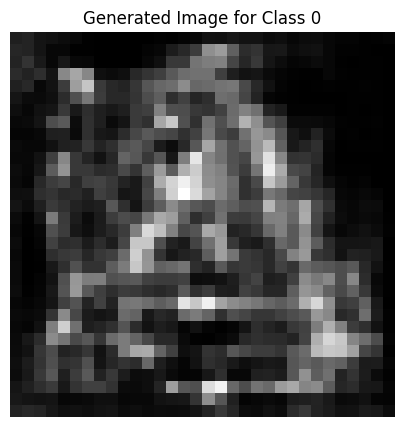

Epoch [1753/2500], D_loss: -0.0979788601398468, G_loss: -0.540172815322876


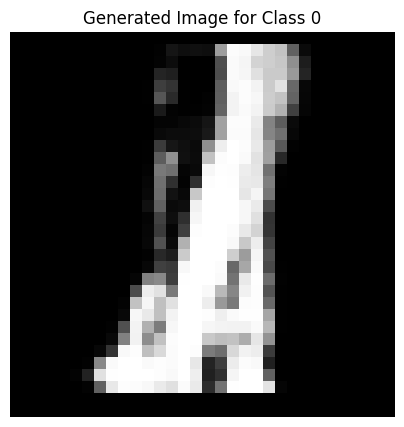

Epoch [1754/2500], D_loss: -0.08958892524242401, G_loss: -0.4803602397441864


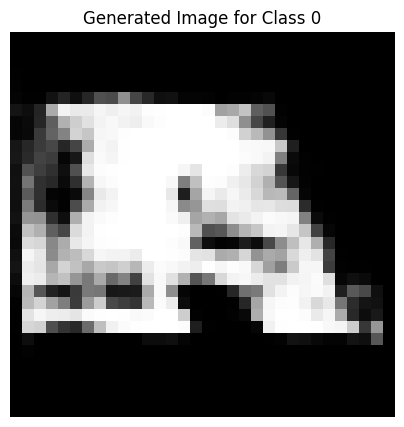

Epoch [1755/2500], D_loss: -0.07737039774656296, G_loss: -0.5343877077102661


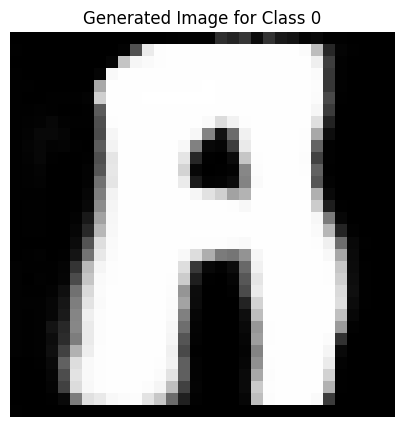

Epoch [1756/2500], D_loss: -0.09189162403345108, G_loss: -0.4857901632785797


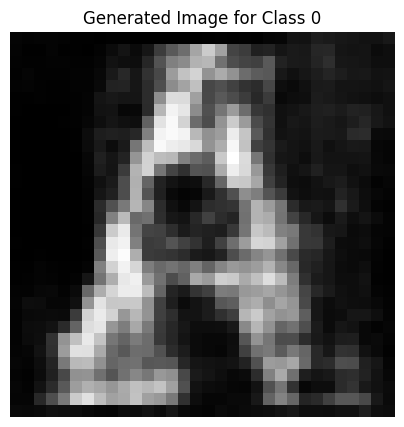

Epoch [1757/2500], D_loss: -0.06332392990589142, G_loss: -0.502991795539856


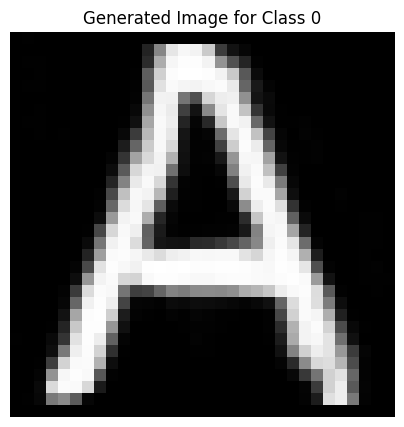

Epoch [1758/2500], D_loss: -0.05692891776561737, G_loss: -0.4358311891555786


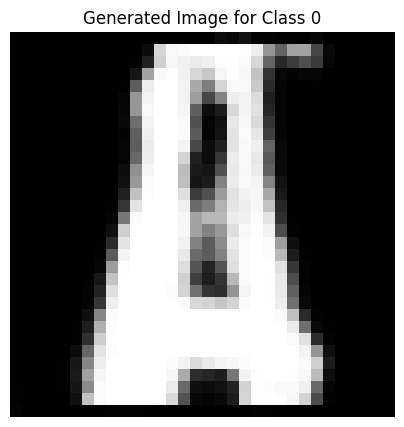

Epoch [1759/2500], D_loss: -0.07669675350189209, G_loss: -0.5698496103286743


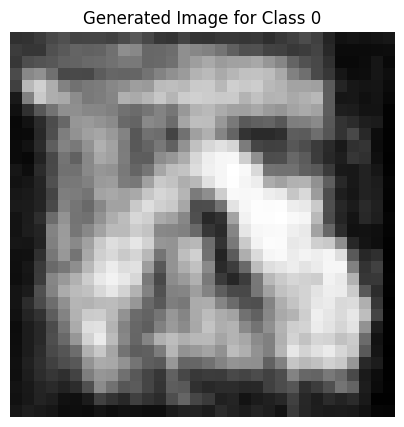

Epoch [1760/2500], D_loss: -0.05845055729150772, G_loss: -0.4840705692768097


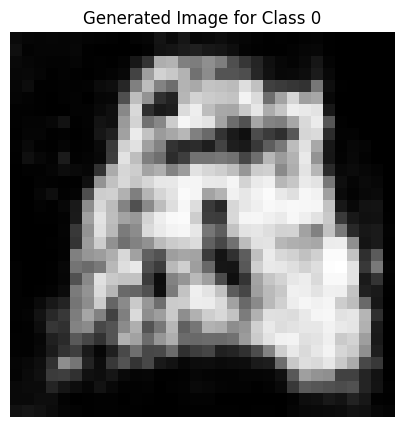

Epoch [1761/2500], D_loss: -0.0887855738401413, G_loss: -0.4365667998790741


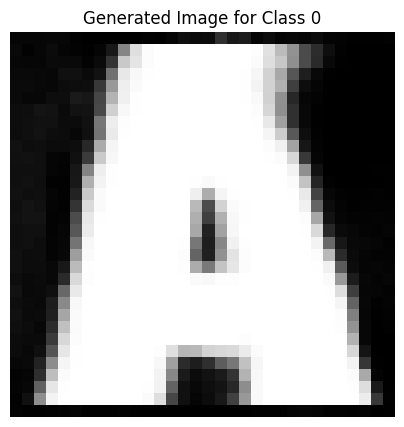

Epoch [1762/2500], D_loss: -0.07756578922271729, G_loss: -0.3775067925453186


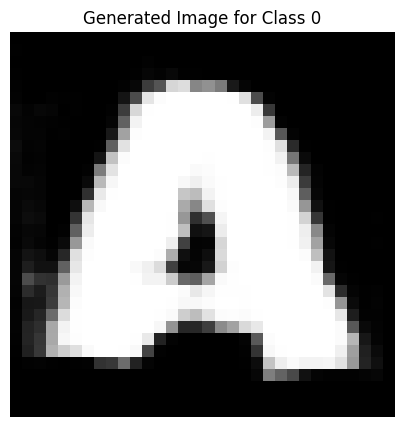

Epoch [1763/2500], D_loss: -0.09612605720758438, G_loss: -0.5059837698936462


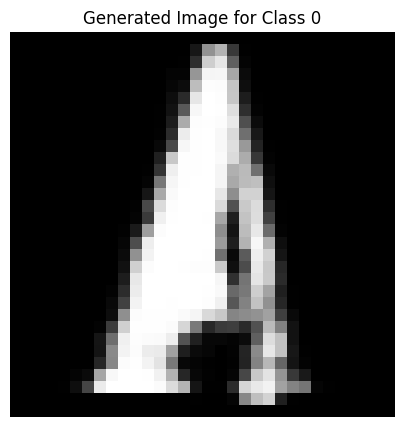

Epoch [1764/2500], D_loss: -0.08510686457157135, G_loss: -0.4858987331390381


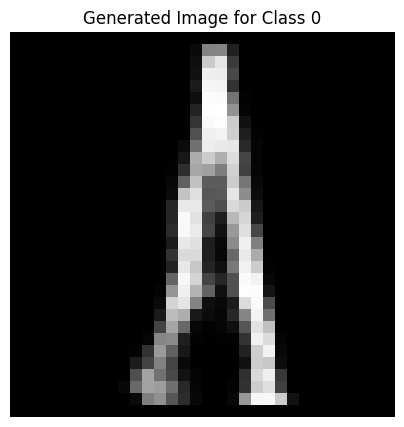

Epoch [1765/2500], D_loss: -0.08687189221382141, G_loss: -0.5169438719749451


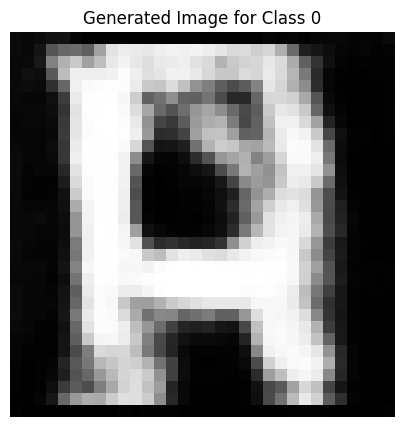

Epoch [1766/2500], D_loss: -0.1031607910990715, G_loss: -0.489475280046463


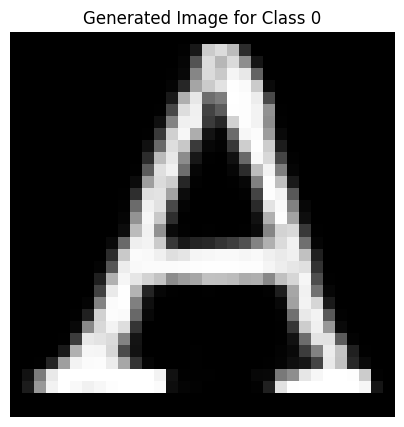

Epoch [1767/2500], D_loss: 0.012369111180305481, G_loss: -0.48159077763557434


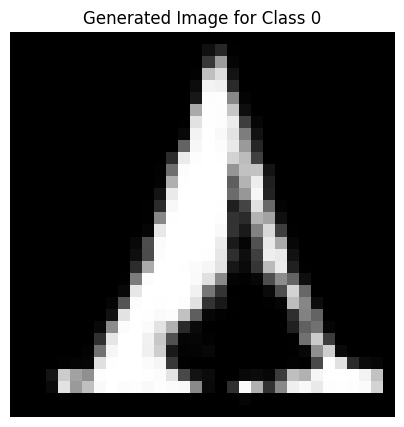

Epoch [1768/2500], D_loss: -0.09276977181434631, G_loss: -0.5183107852935791


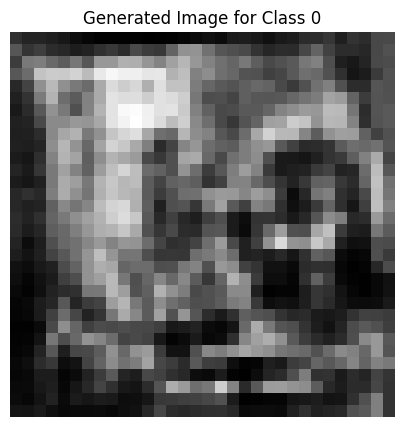

Epoch [1769/2500], D_loss: -0.09211113303899765, G_loss: -0.4994446039199829


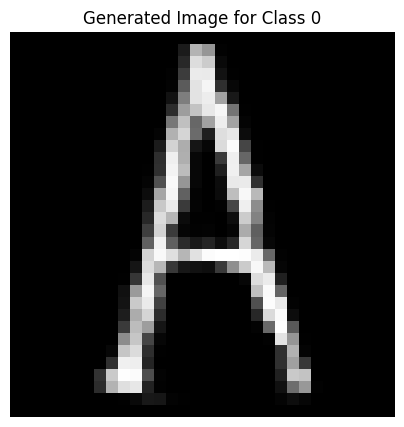

Epoch [1770/2500], D_loss: -0.06795535981655121, G_loss: -0.4815870523452759


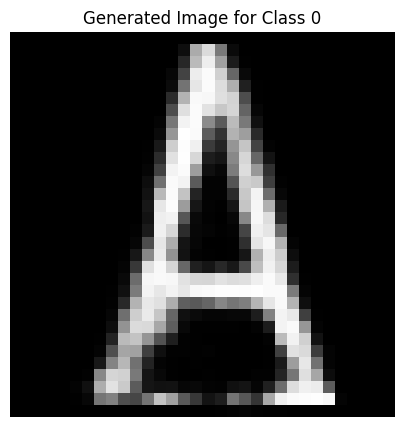

Epoch [1771/2500], D_loss: -0.0860276147723198, G_loss: -0.4322127103805542


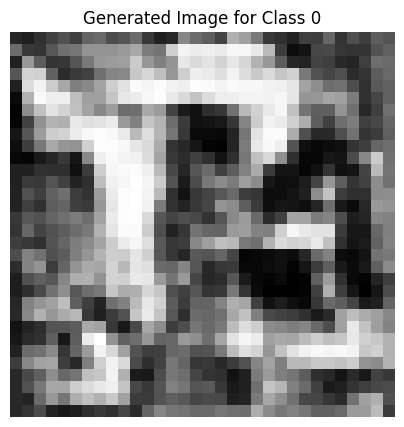

Epoch [1772/2500], D_loss: -0.004012361168861389, G_loss: -0.5567348003387451


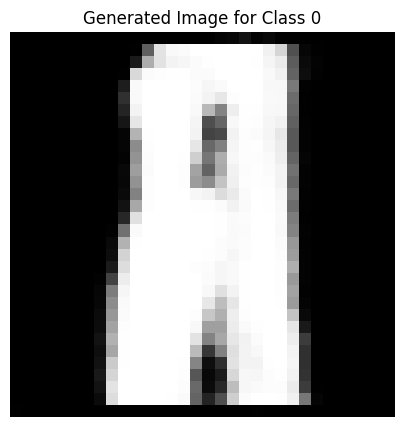

Epoch [1773/2500], D_loss: -0.10039536654949188, G_loss: -0.49066081643104553


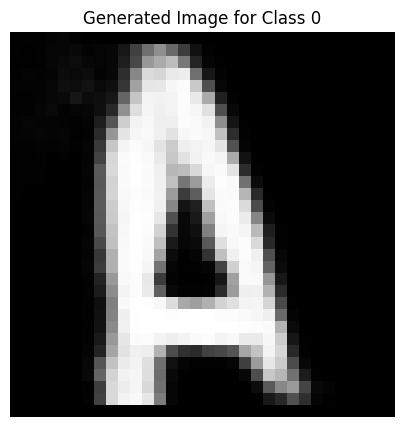

Epoch [1774/2500], D_loss: -0.07464250177145004, G_loss: -0.4388309717178345


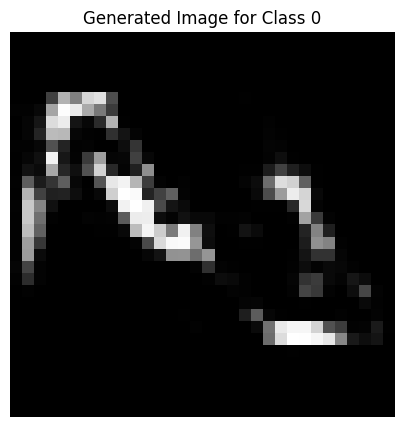

Epoch [1775/2500], D_loss: -0.07713569700717926, G_loss: -0.4945727288722992


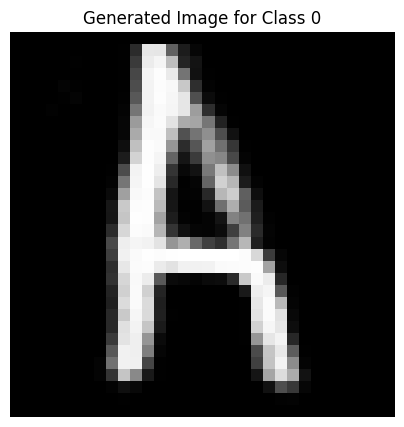

Epoch [1776/2500], D_loss: -0.08490253239870071, G_loss: -0.49703943729400635


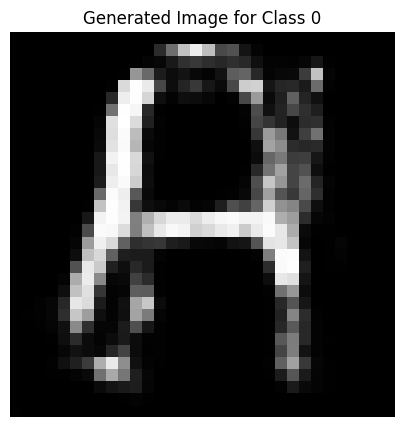

Epoch [1777/2500], D_loss: -0.08644750714302063, G_loss: -0.561279833316803


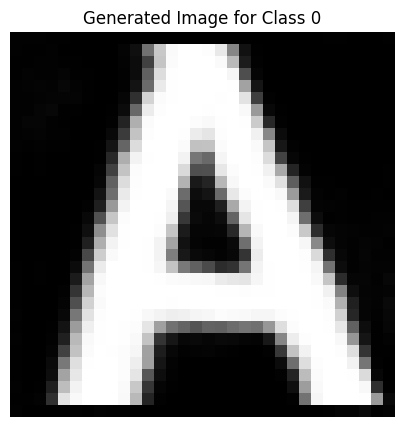

Epoch [1778/2500], D_loss: -0.09285858273506165, G_loss: -0.5188823938369751


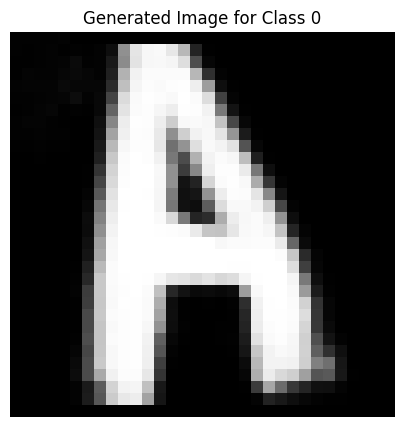

Epoch [1779/2500], D_loss: -0.04703180491924286, G_loss: -0.454315721988678


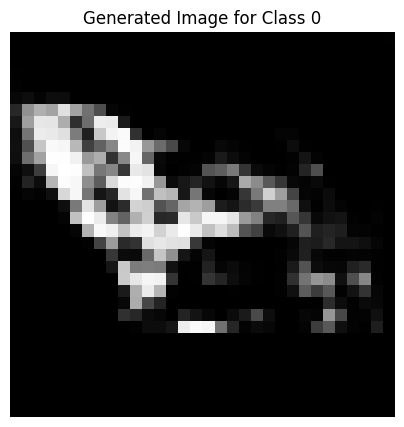

Epoch [1780/2500], D_loss: -0.09466598927974701, G_loss: -0.523525059223175


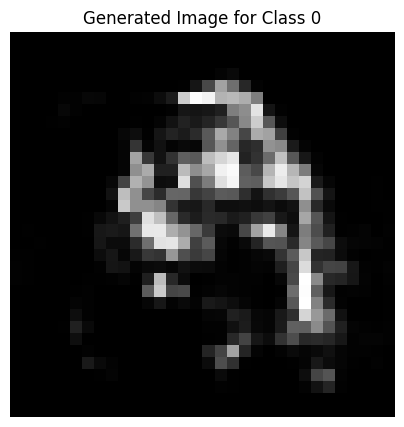

Epoch [1781/2500], D_loss: -0.08694670349359512, G_loss: -0.4916501045227051


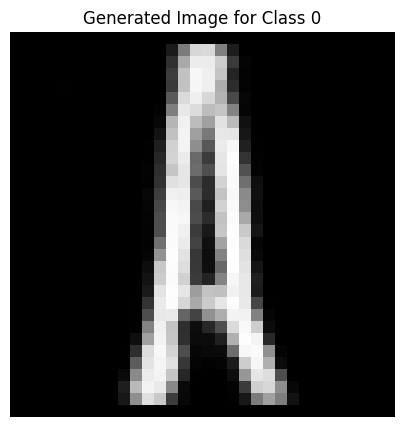

Epoch [1782/2500], D_loss: -0.06750400364398956, G_loss: -0.48576414585113525


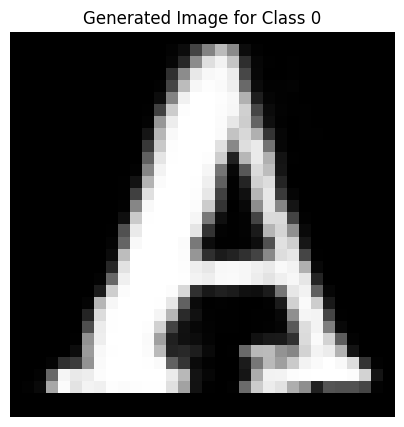

Epoch [1783/2500], D_loss: -0.08789636194705963, G_loss: -0.554145097732544


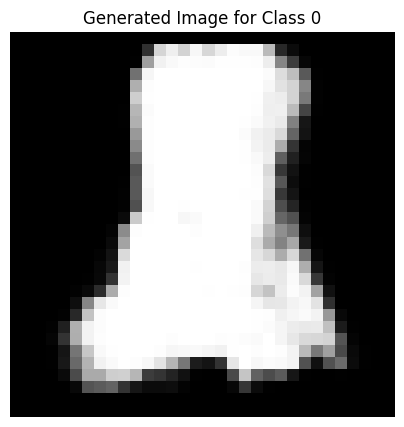

Epoch [1784/2500], D_loss: -0.046454086899757385, G_loss: -0.4844398498535156


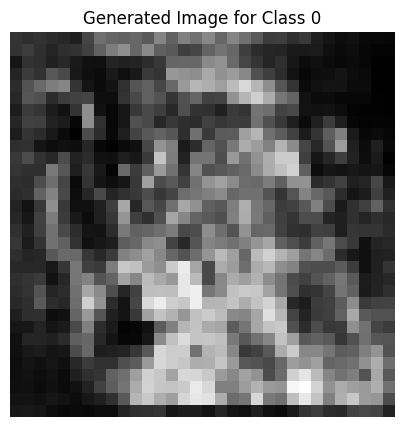

Epoch [1785/2500], D_loss: 0.04812133312225342, G_loss: -0.5047729015350342


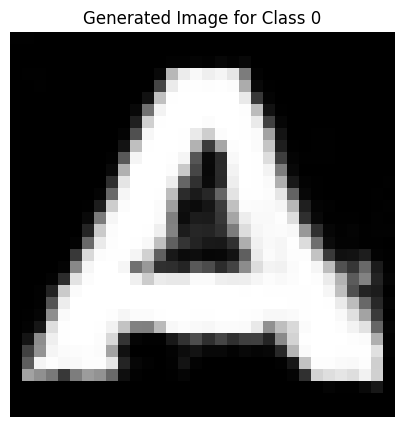

Epoch [1786/2500], D_loss: -0.09853115677833557, G_loss: -0.442348837852478


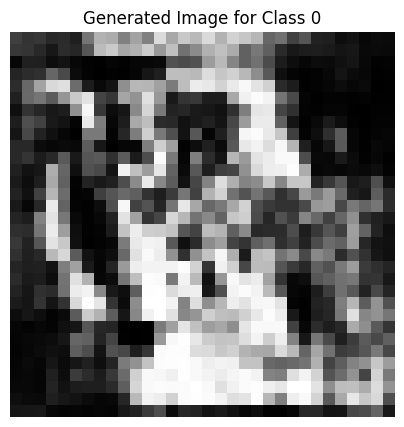

Epoch [1787/2500], D_loss: -0.054598018527030945, G_loss: -0.45428213477134705


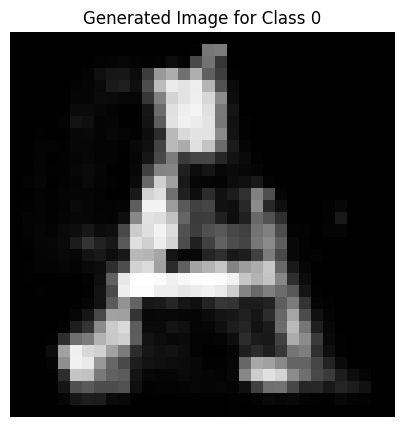

Epoch [1788/2500], D_loss: -0.07720331847667694, G_loss: -0.4901154637336731


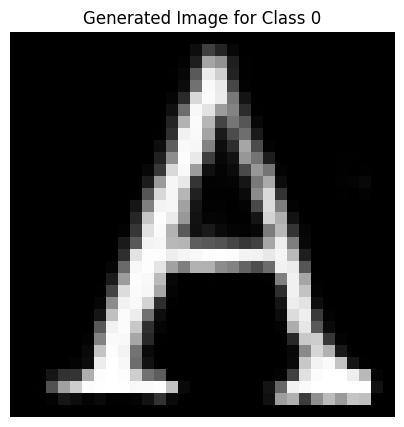

Epoch [1789/2500], D_loss: -0.0905604287981987, G_loss: -0.48432686924934387


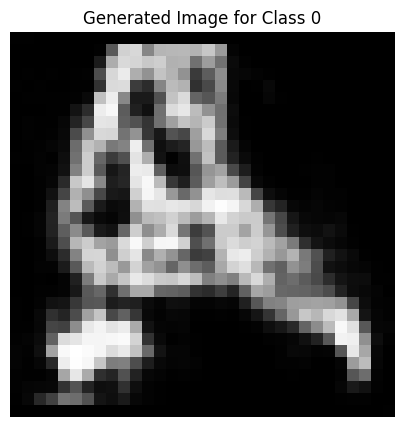

Epoch [1790/2500], D_loss: -0.07082509249448776, G_loss: -0.4973750114440918


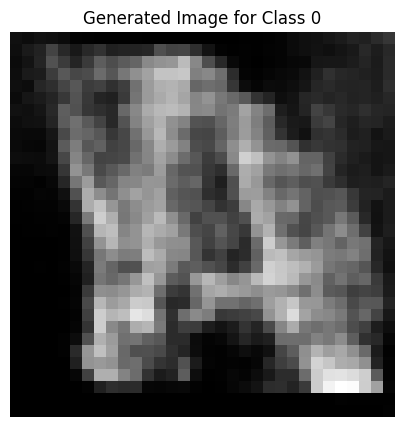

Epoch [1791/2500], D_loss: -0.08563646674156189, G_loss: -0.5303800106048584


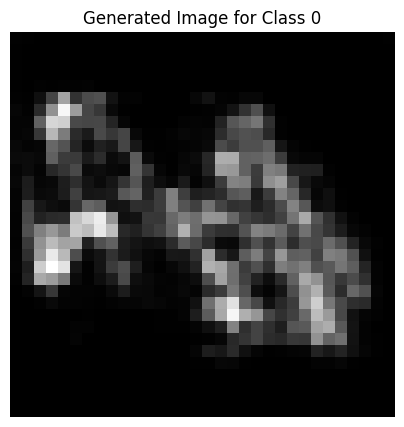

Epoch [1792/2500], D_loss: -0.06621335446834564, G_loss: -0.39829158782958984


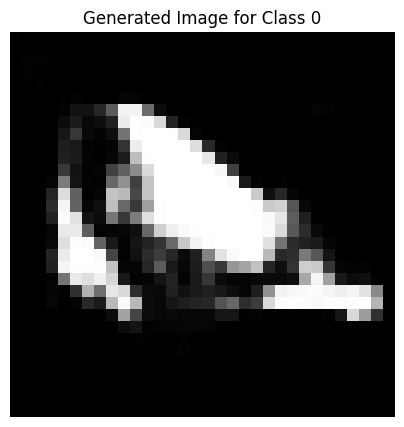

Epoch [1793/2500], D_loss: -0.07812374830245972, G_loss: -0.5222377181053162


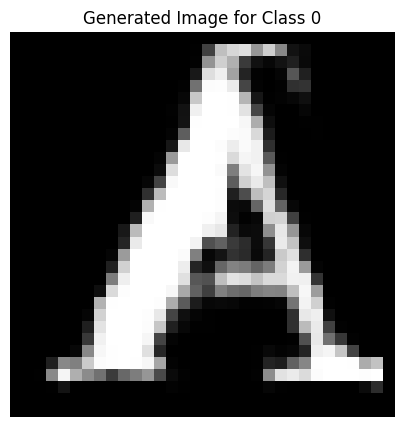

Epoch [1794/2500], D_loss: -0.08865000307559967, G_loss: -0.4765124022960663


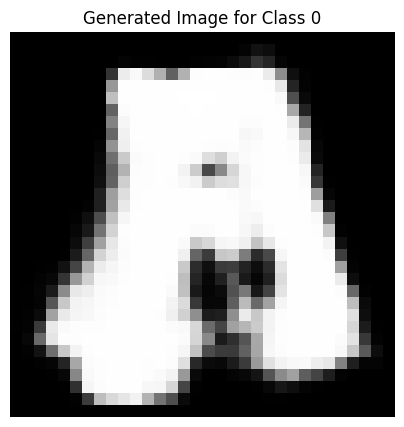

Epoch [1795/2500], D_loss: -0.09730619937181473, G_loss: -0.6251235008239746


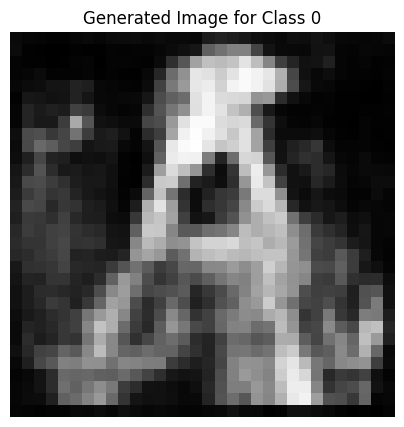

Epoch [1796/2500], D_loss: -0.08447563648223877, G_loss: -0.4924147129058838


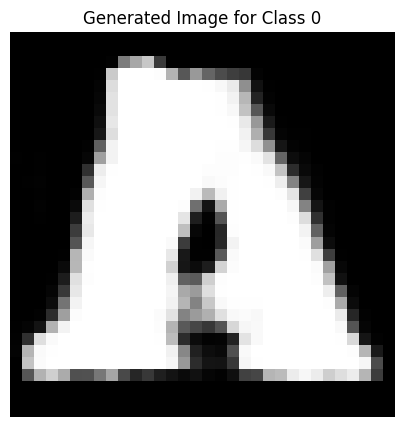

Epoch [1797/2500], D_loss: -0.0857217088341713, G_loss: -0.5949252843856812


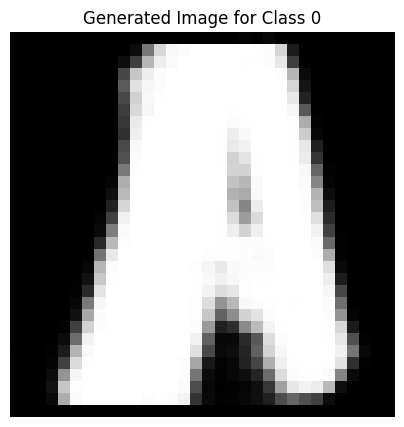

Epoch [1798/2500], D_loss: -0.10050516575574875, G_loss: -0.5216383934020996


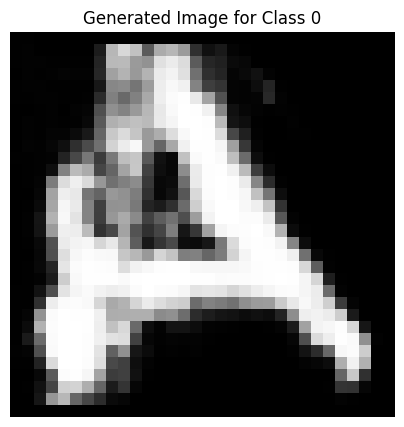

Epoch [1799/2500], D_loss: -0.10614093393087387, G_loss: -0.5252333879470825


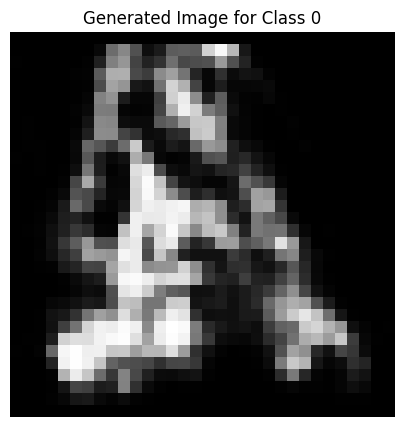

Epoch [1800/2500], D_loss: -0.09705314040184021, G_loss: -0.49916473031044006


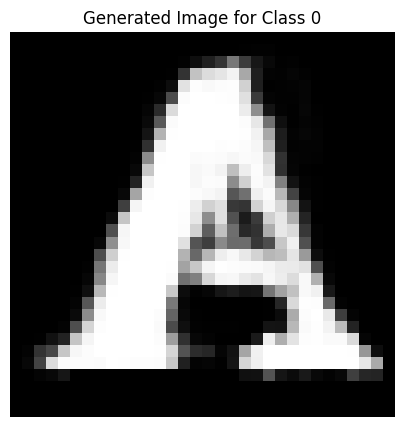

Epoch [1801/2500], D_loss: -0.07779793441295624, G_loss: -0.5056724548339844


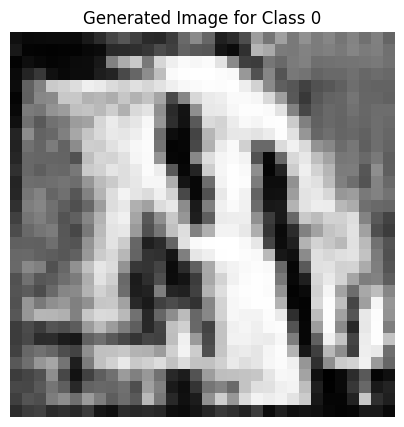

Epoch [1802/2500], D_loss: -0.05510571599006653, G_loss: -0.5209128856658936


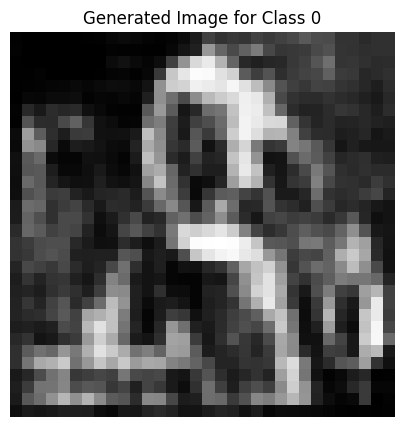

Epoch [1803/2500], D_loss: -0.08661668002605438, G_loss: -0.5201869606971741


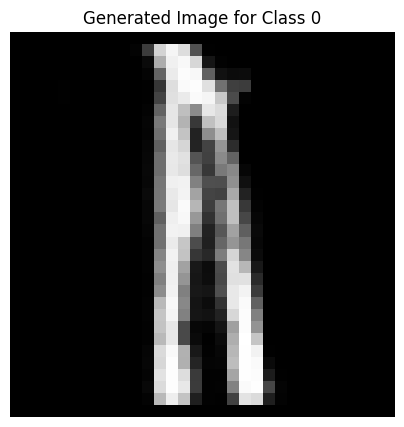

Epoch [1804/2500], D_loss: -0.06727084517478943, G_loss: -0.4703434705734253


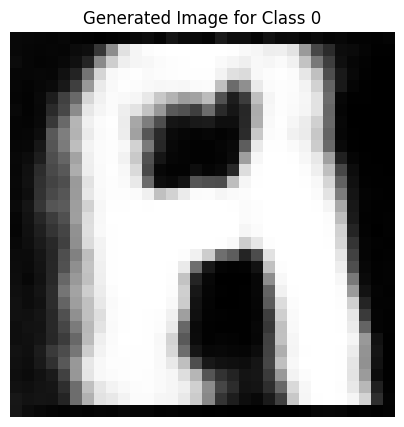

Epoch [1805/2500], D_loss: -0.07914267480373383, G_loss: -0.41455861926078796


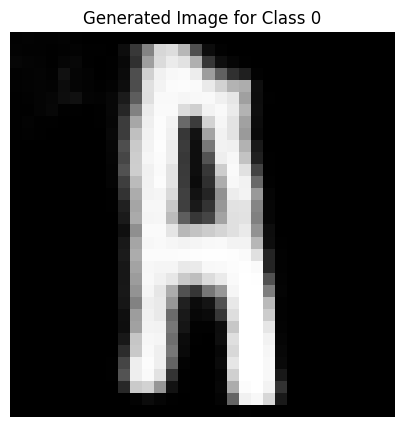

Epoch [1806/2500], D_loss: 0.040768012404441833, G_loss: -0.504062831401825


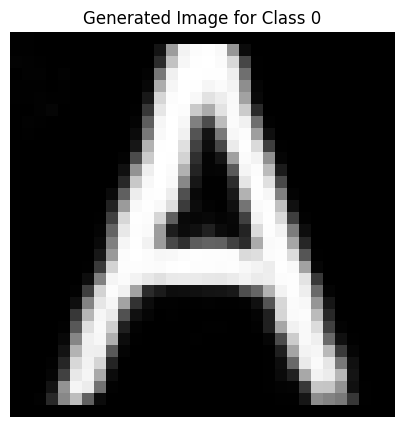

Epoch [1807/2500], D_loss: -0.0837702602148056, G_loss: -0.47396135330200195


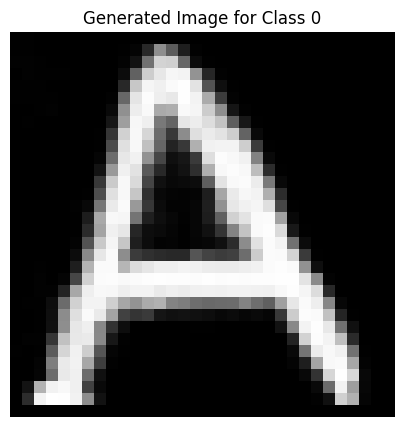

Epoch [1808/2500], D_loss: -0.09692274034023285, G_loss: -0.45783621072769165


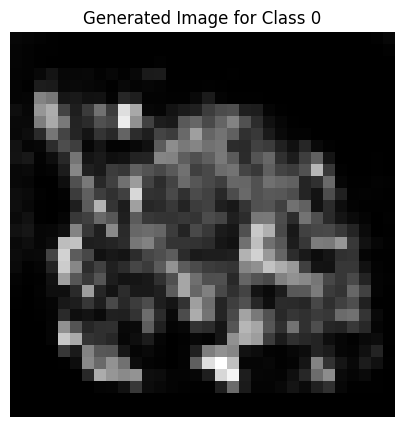

Epoch [1809/2500], D_loss: -0.10088538378477097, G_loss: -0.478305846452713


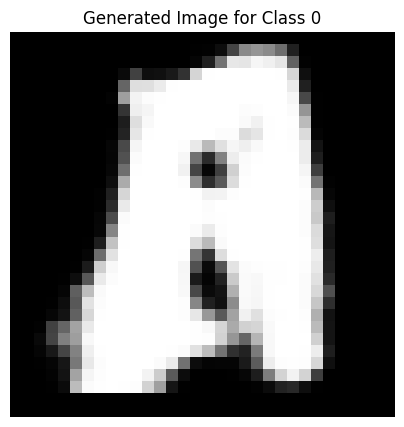

Epoch [1810/2500], D_loss: -0.08613640069961548, G_loss: -0.4404951333999634


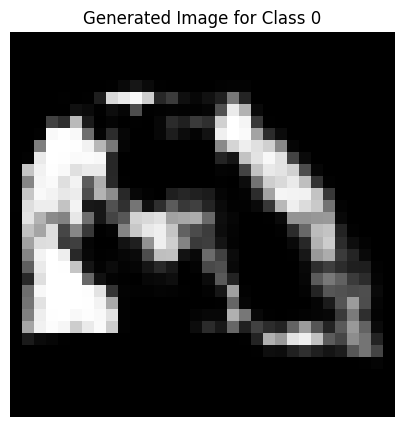

Epoch [1811/2500], D_loss: -0.030966728925704956, G_loss: -0.46654820442199707


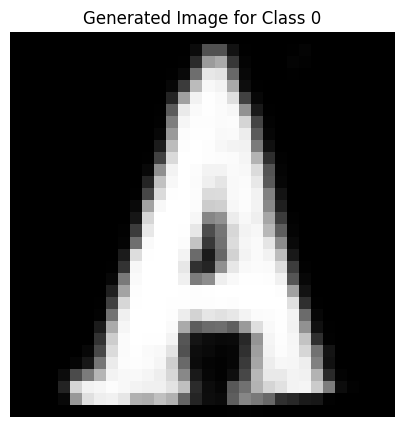

Epoch [1812/2500], D_loss: -0.10837042331695557, G_loss: -0.4644067585468292


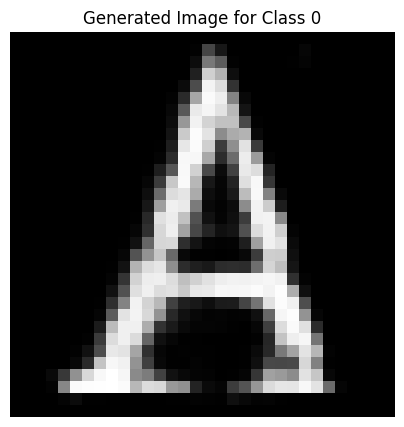

Epoch [1813/2500], D_loss: -0.0926072895526886, G_loss: -0.4970182776451111


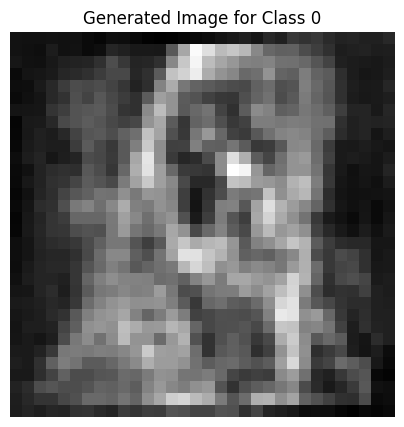

Epoch [1814/2500], D_loss: -0.08848559856414795, G_loss: -0.46395784616470337


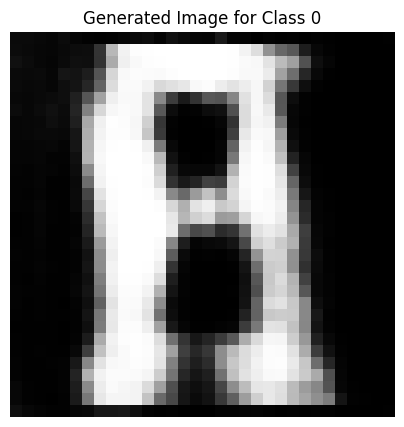

Epoch [1815/2500], D_loss: -0.09212169051170349, G_loss: -0.4651966989040375


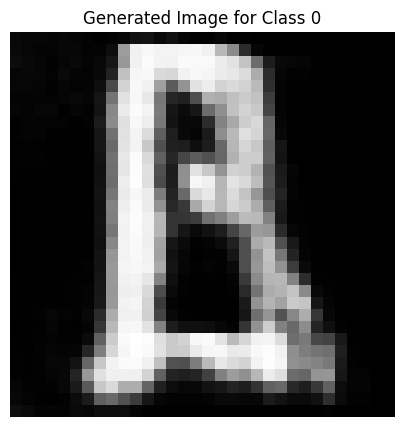

Epoch [1816/2500], D_loss: -0.10736199468374252, G_loss: -0.5066724419593811


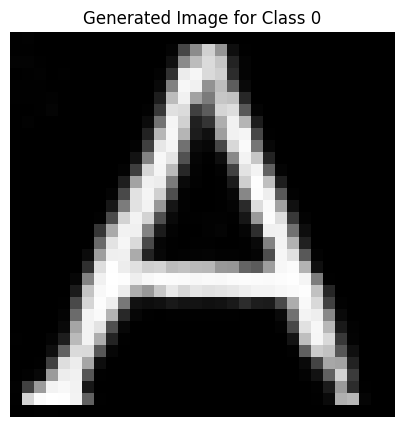

Epoch [1817/2500], D_loss: -0.08480742573738098, G_loss: -0.428684264421463


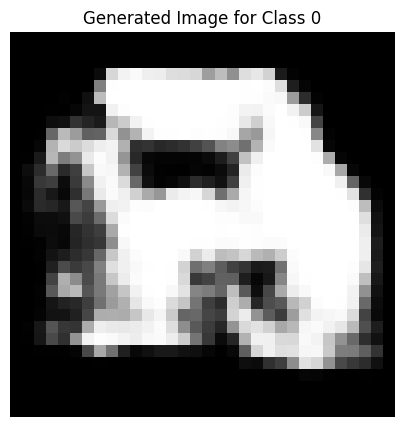

Epoch [1818/2500], D_loss: -0.10687397420406342, G_loss: -0.513673722743988


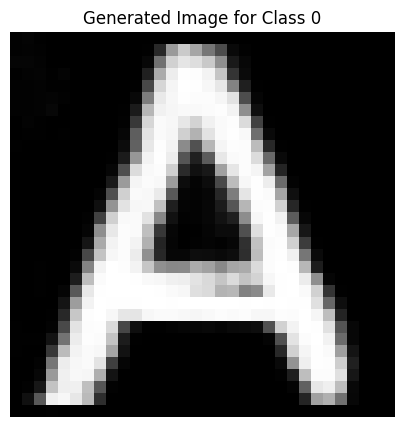

Epoch [1819/2500], D_loss: -0.06609220057725906, G_loss: -0.3458525538444519


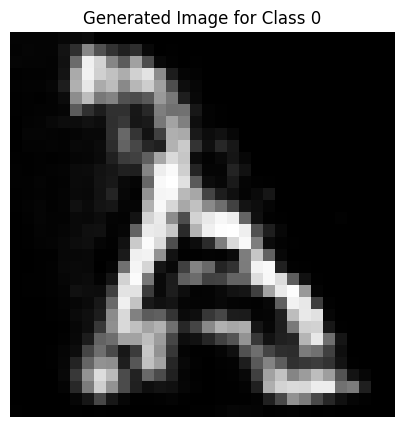

Epoch [1820/2500], D_loss: -0.07503800839185715, G_loss: -0.49307501316070557


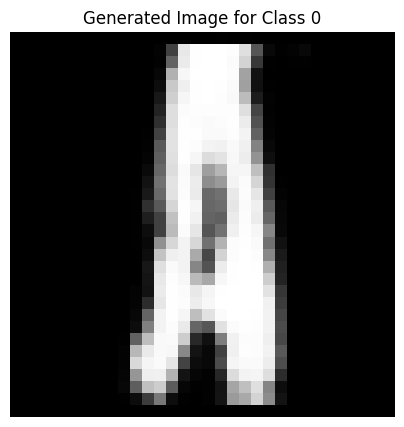

Epoch [1821/2500], D_loss: -0.10243363678455353, G_loss: -0.47087061405181885


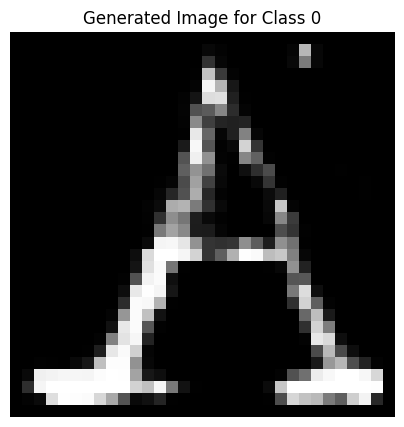

Epoch [1822/2500], D_loss: -0.09102334082126617, G_loss: -0.533107340335846


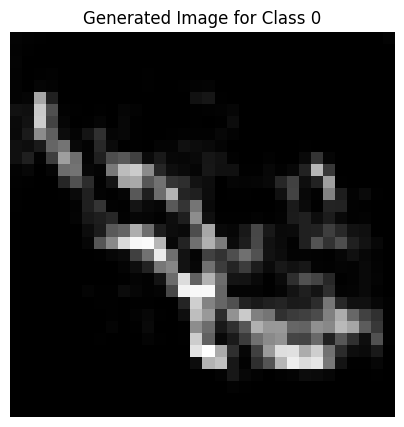

Epoch [1823/2500], D_loss: -0.08879176527261734, G_loss: -0.5978474617004395


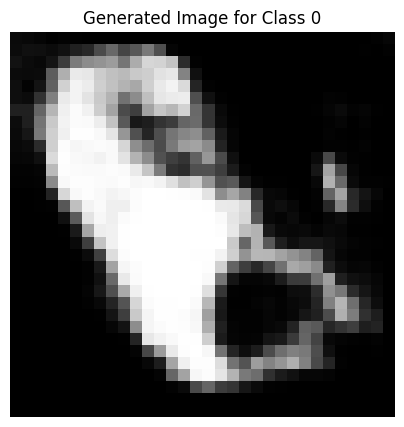

Epoch [1824/2500], D_loss: -0.07679196447134018, G_loss: -0.5083563327789307


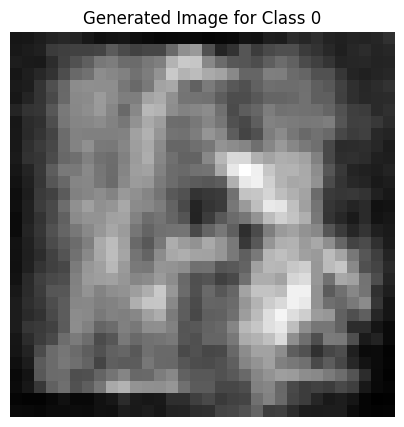

Epoch [1825/2500], D_loss: -0.09033621847629547, G_loss: -0.46246787905693054


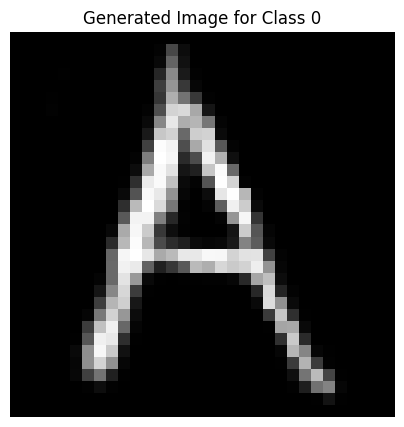

Epoch [1826/2500], D_loss: -0.11094116419553757, G_loss: -0.5037755966186523


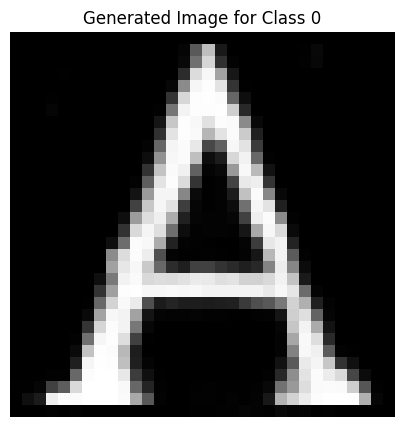

Epoch [1827/2500], D_loss: -0.07952439785003662, G_loss: -0.4787837266921997


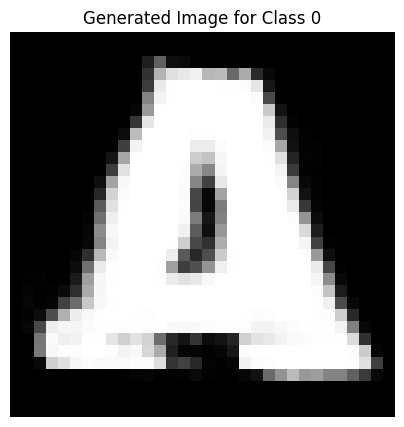

Epoch [1828/2500], D_loss: -0.1046690121293068, G_loss: -0.4811667799949646


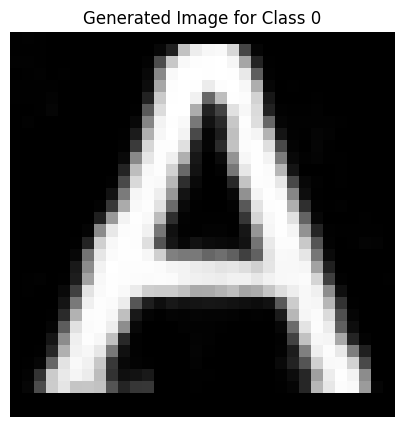

Epoch [1829/2500], D_loss: -0.07451198250055313, G_loss: -0.44620078802108765


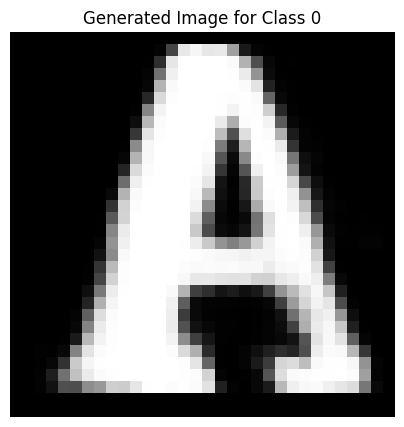

Epoch [1830/2500], D_loss: -0.08220420777797699, G_loss: -0.43996894359588623


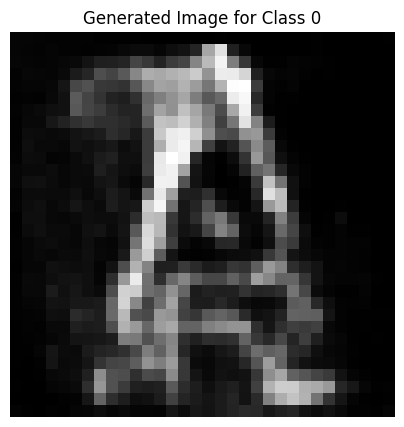

Epoch [1831/2500], D_loss: -0.08977515250444412, G_loss: -0.42974668741226196


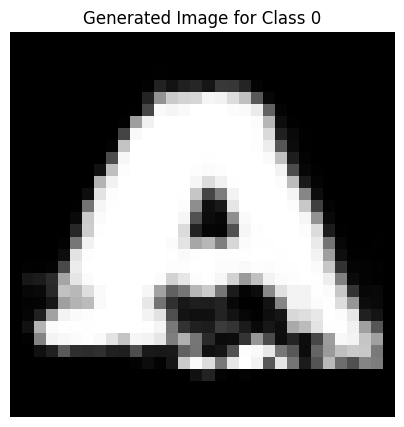

Epoch [1832/2500], D_loss: -0.10794317722320557, G_loss: -0.3691657781600952


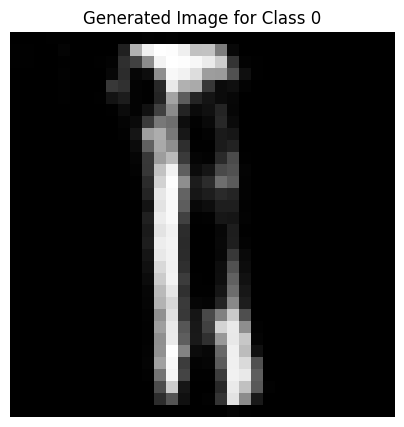

Epoch [1833/2500], D_loss: -0.011464327573776245, G_loss: -0.4875239133834839


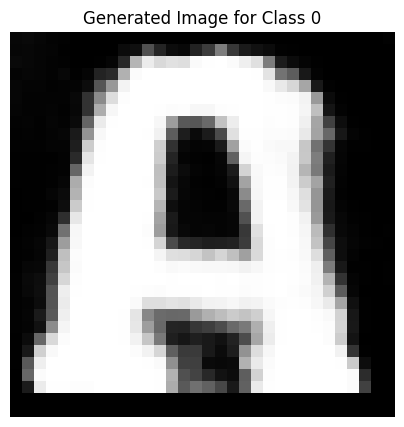

Epoch [1834/2500], D_loss: -0.10210589319467545, G_loss: -0.5475032329559326


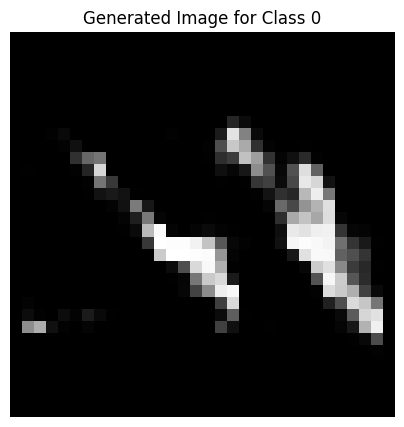

Epoch [1835/2500], D_loss: -0.09823977202177048, G_loss: -0.4691985547542572


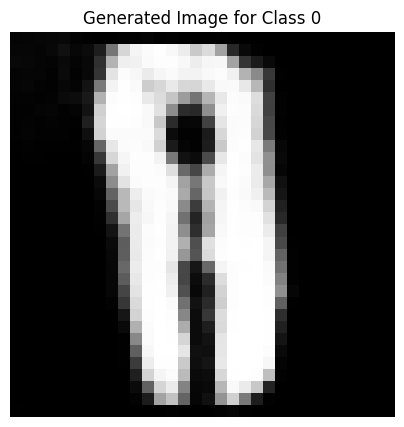

Epoch [1836/2500], D_loss: -0.11269548535346985, G_loss: -0.49437302350997925


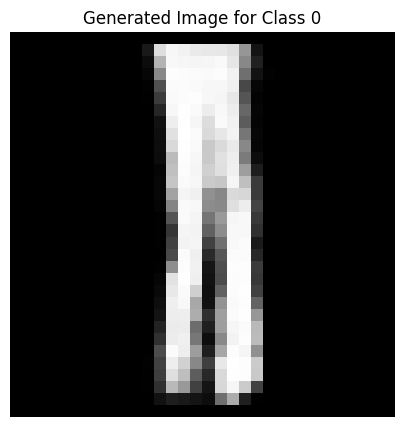

Epoch [1837/2500], D_loss: -0.06688845157623291, G_loss: -0.3557335138320923


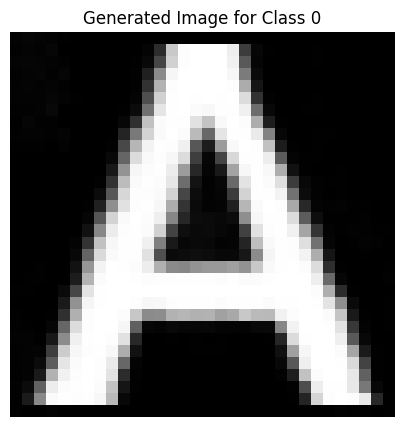

Epoch [1838/2500], D_loss: -0.0948050245642662, G_loss: -0.5058390498161316


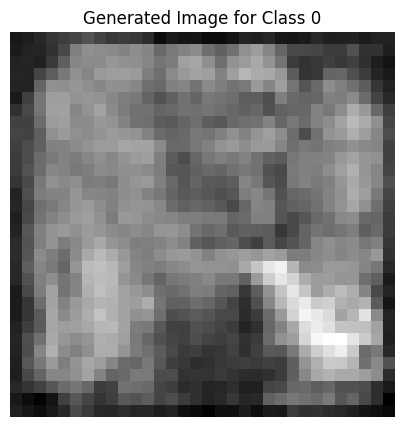

Epoch [1839/2500], D_loss: -0.1070297434926033, G_loss: -0.473315566778183


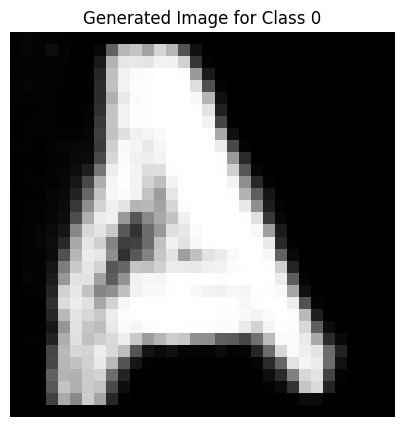

Epoch [1840/2500], D_loss: -0.08235073834657669, G_loss: -0.4780656099319458


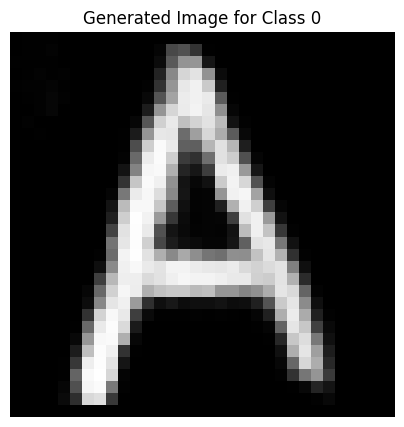

Epoch [1841/2500], D_loss: -0.07285518944263458, G_loss: -0.5030490756034851


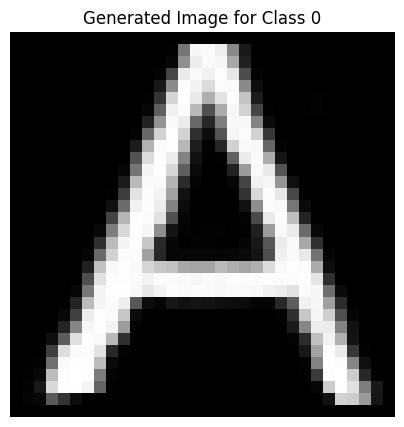

Epoch [1842/2500], D_loss: -0.10357831418514252, G_loss: -0.4325929284095764


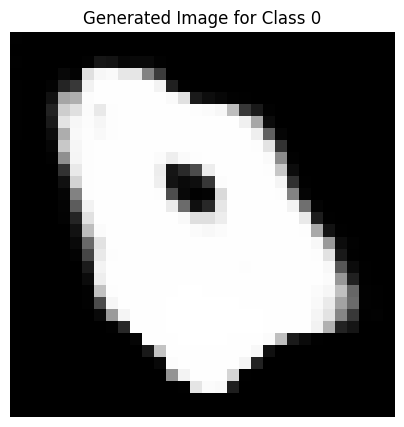

Epoch [1843/2500], D_loss: -0.10718131065368652, G_loss: -0.4642646908760071


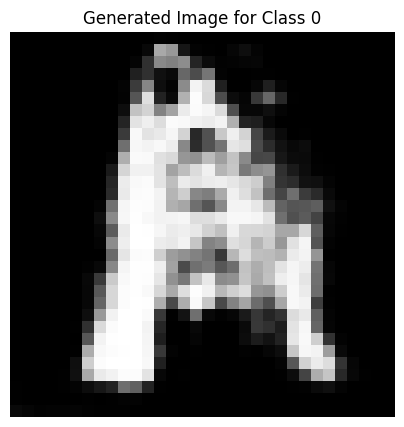

Epoch [1844/2500], D_loss: -0.11706717312335968, G_loss: -0.42287957668304443


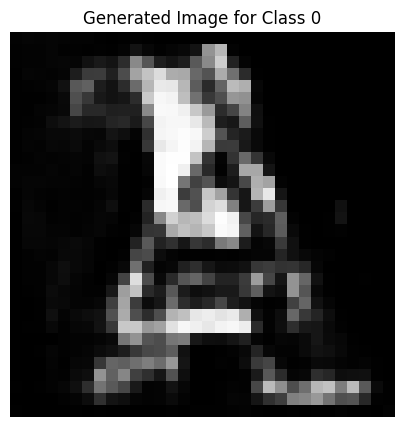

Epoch [1845/2500], D_loss: -0.10175205022096634, G_loss: -0.38455304503440857


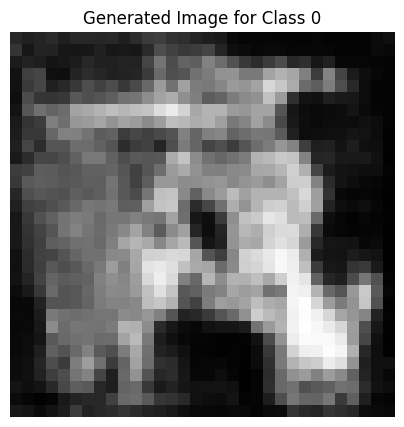

Epoch [1846/2500], D_loss: -0.10266075283288956, G_loss: -0.5575717687606812


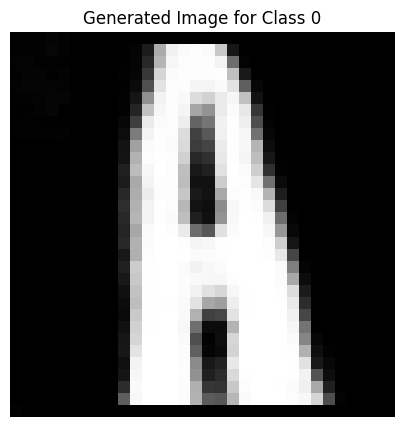

Epoch [1847/2500], D_loss: -0.12361852824687958, G_loss: -0.4971134066581726


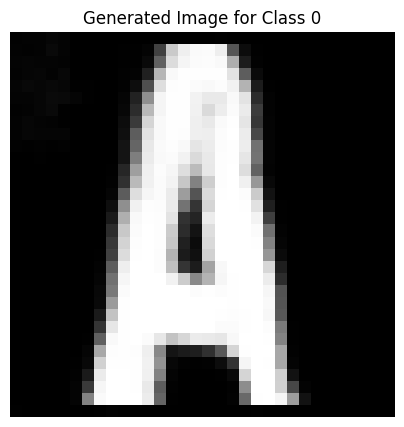

Epoch [1848/2500], D_loss: -0.10286548733711243, G_loss: -0.45664024353027344


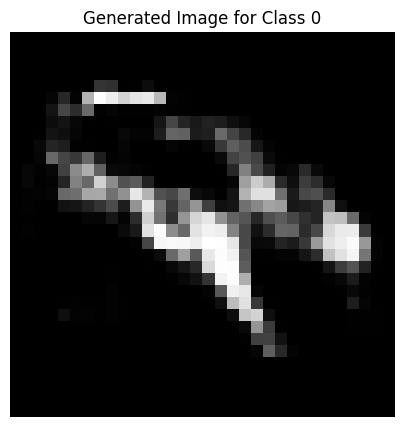

Epoch [1849/2500], D_loss: -0.09568341076374054, G_loss: -0.5049973726272583


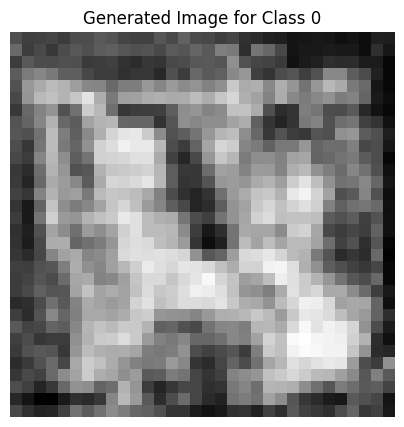

Epoch [1850/2500], D_loss: -0.10938689857721329, G_loss: -0.5077933669090271


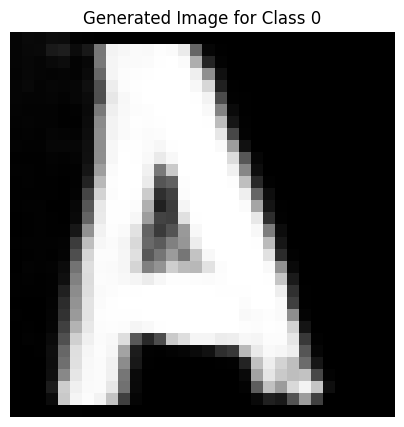

Epoch [1851/2500], D_loss: -0.0967681035399437, G_loss: -0.5122184753417969


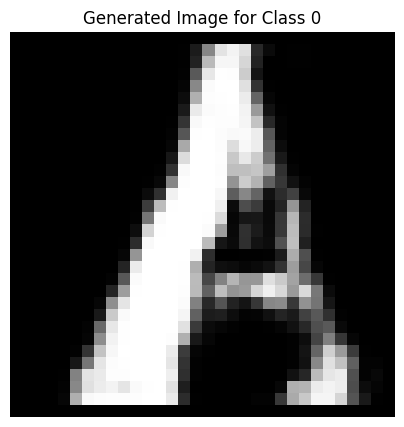

Epoch [1852/2500], D_loss: -0.07796303182840347, G_loss: -0.40904831886291504


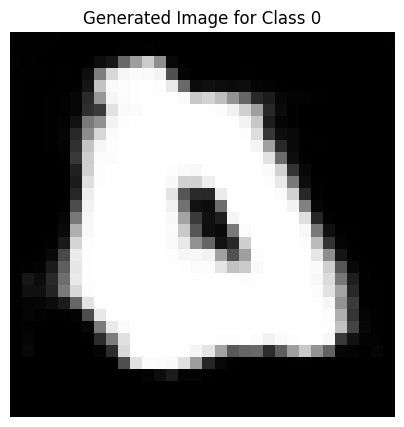

Epoch [1853/2500], D_loss: -0.0907571017742157, G_loss: -0.524366557598114


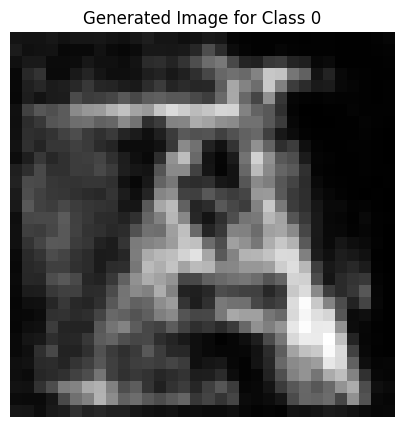

Epoch [1854/2500], D_loss: -0.10833831876516342, G_loss: -0.4919387698173523


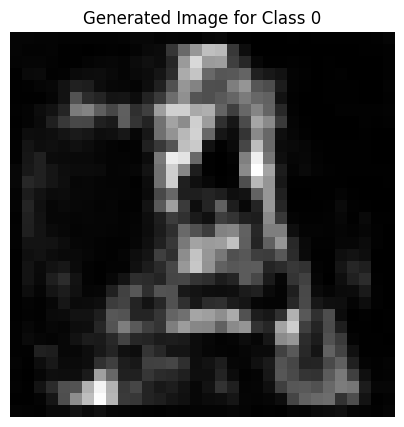

Epoch [1855/2500], D_loss: -0.09134110808372498, G_loss: -0.5254104137420654


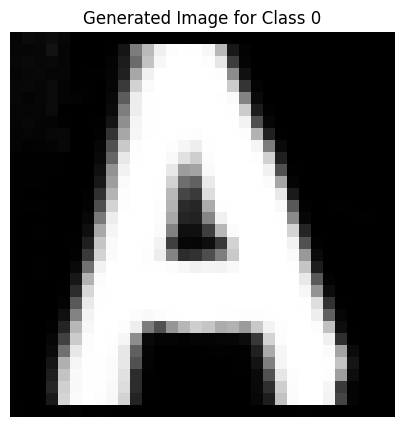

Epoch [1856/2500], D_loss: -0.09118297696113586, G_loss: -0.48091357946395874


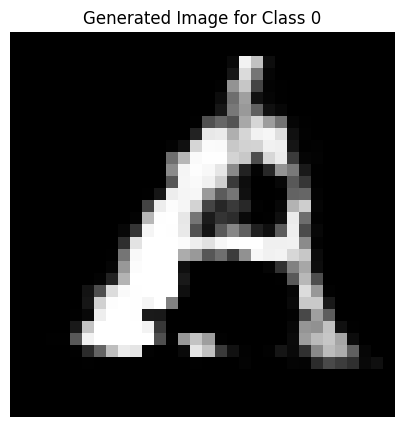

Epoch [1857/2500], D_loss: -0.07613305002450943, G_loss: -0.5744988322257996


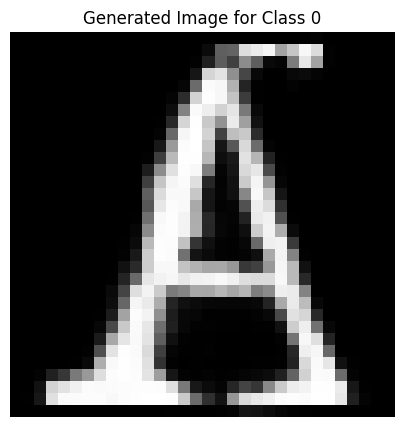

Epoch [1858/2500], D_loss: -0.027522459626197815, G_loss: -0.4915100336074829


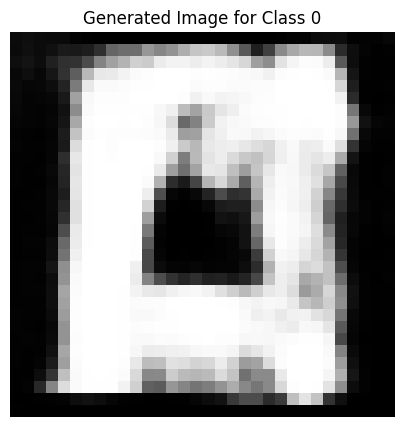

Epoch [1859/2500], D_loss: -0.0736803188920021, G_loss: -0.4854530692100525


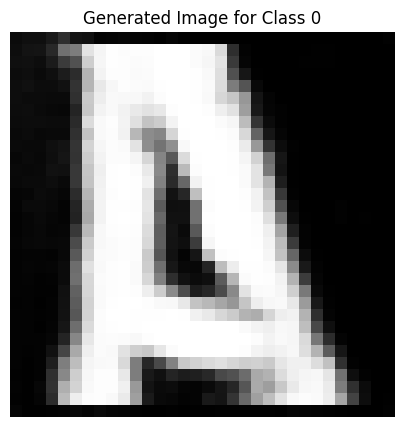

Epoch [1860/2500], D_loss: -0.08480925112962723, G_loss: -0.5043390989303589


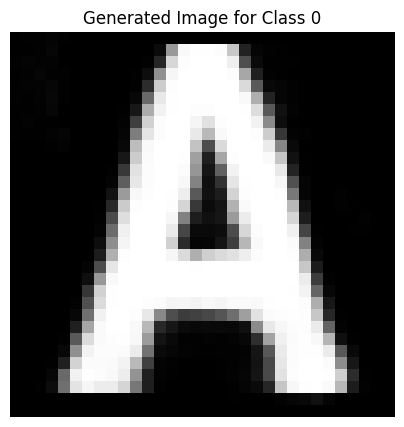

Epoch [1861/2500], D_loss: -0.08492755144834518, G_loss: -0.4402642250061035


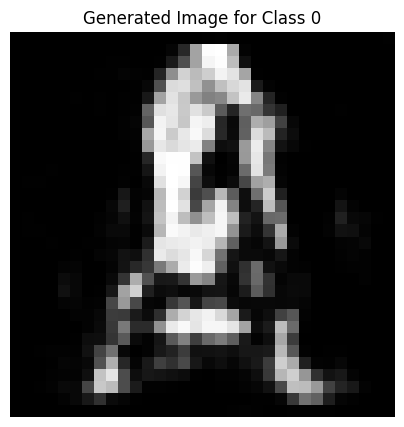

Epoch [1862/2500], D_loss: -0.1007399708032608, G_loss: -0.47857773303985596


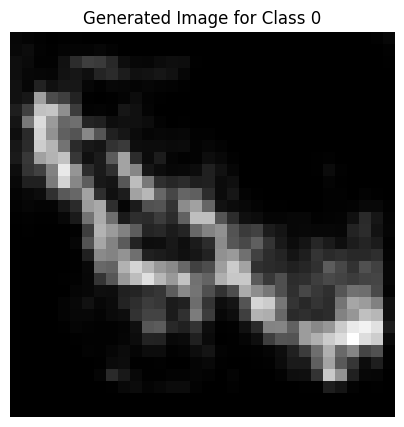

Epoch [1863/2500], D_loss: -0.04669658839702606, G_loss: -0.4970630407333374


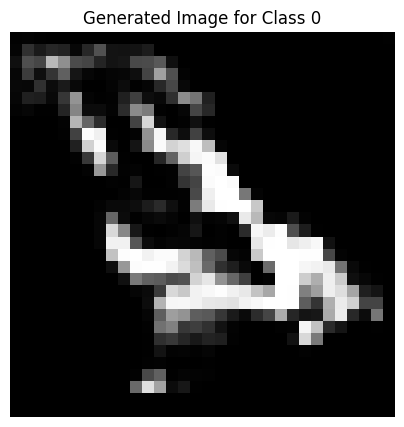

Epoch [1864/2500], D_loss: -0.08533772826194763, G_loss: -0.4512989819049835


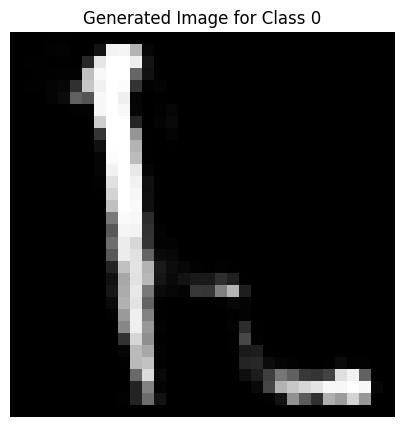

Epoch [1865/2500], D_loss: -0.07310381531715393, G_loss: -0.44932085275650024


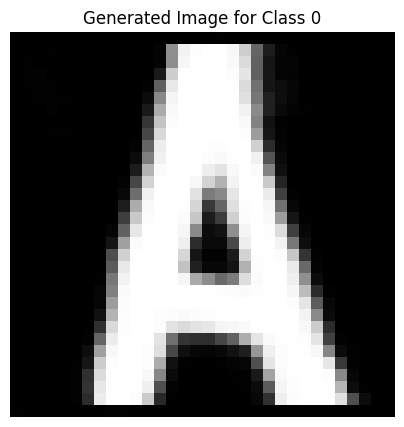

Epoch [1866/2500], D_loss: -0.08728960156440735, G_loss: -0.4767480492591858


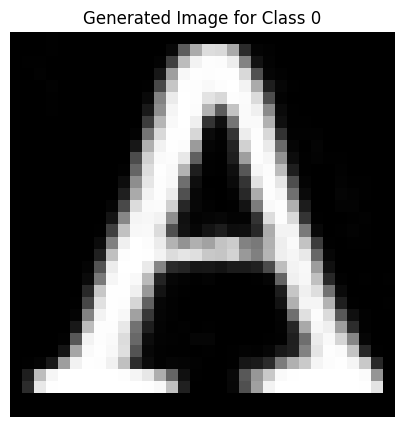

Epoch [1867/2500], D_loss: -0.08440353721380234, G_loss: -0.5393399000167847


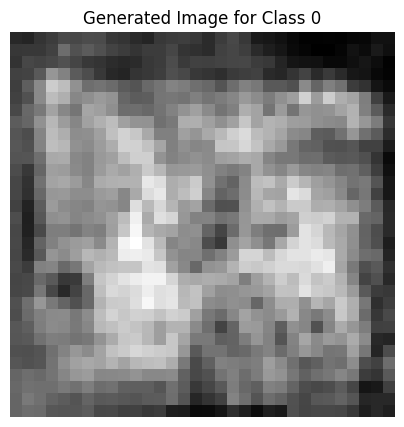

Epoch [1868/2500], D_loss: -0.09440386295318604, G_loss: -0.4950529932975769


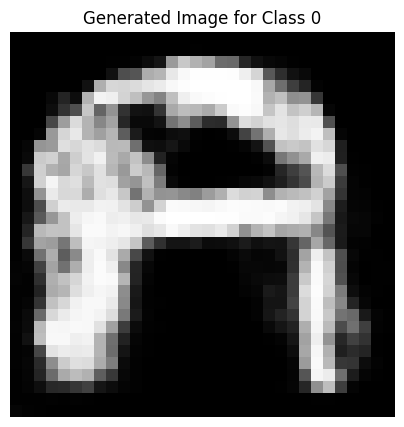

Epoch [1869/2500], D_loss: -0.08347739279270172, G_loss: -0.39808374643325806


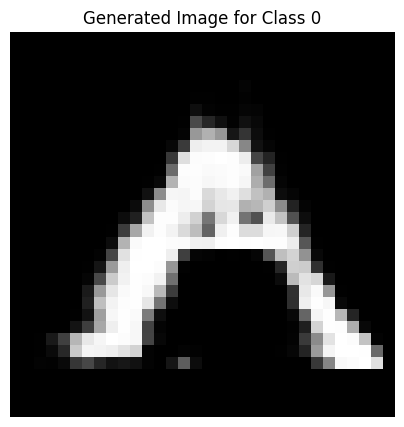

Epoch [1870/2500], D_loss: -0.0797833502292633, G_loss: -0.5894569158554077


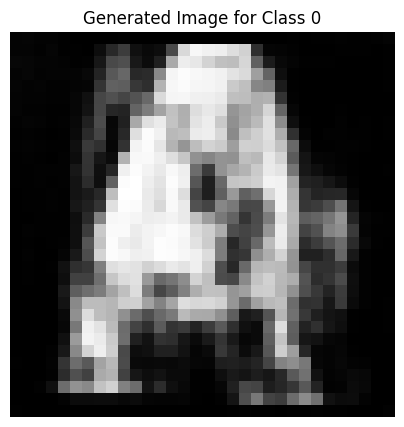

Epoch [1871/2500], D_loss: -0.08252709358930588, G_loss: -0.5326125621795654


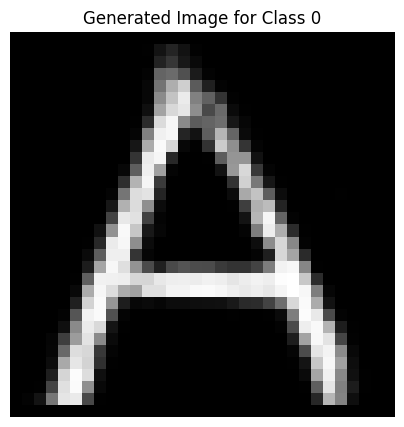

Epoch [1872/2500], D_loss: -0.07238780707120895, G_loss: -0.5017688274383545


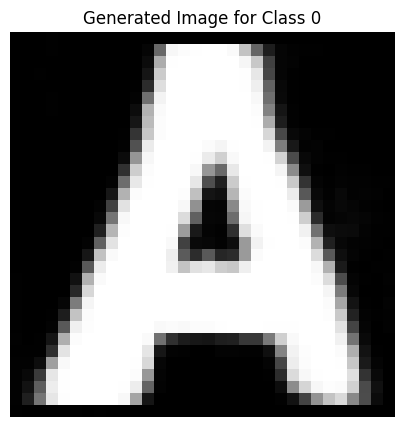

Epoch [1873/2500], D_loss: -0.10851016640663147, G_loss: -0.44047868251800537


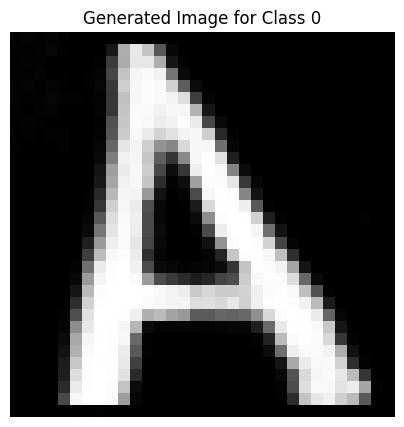

Epoch [1874/2500], D_loss: -0.09179982542991638, G_loss: -0.48481690883636475


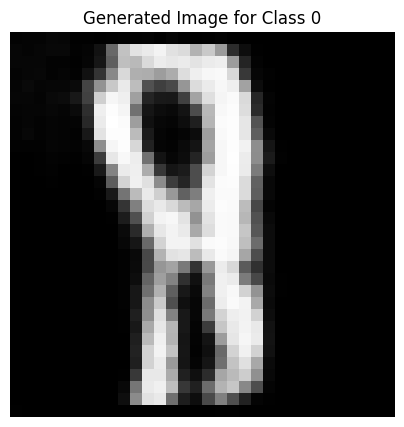

Epoch [1875/2500], D_loss: -0.05922047793865204, G_loss: -0.4492173194885254


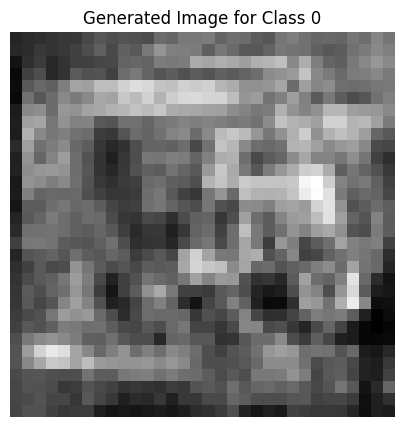

Epoch [1876/2500], D_loss: -0.10462840646505356, G_loss: -0.5219415426254272


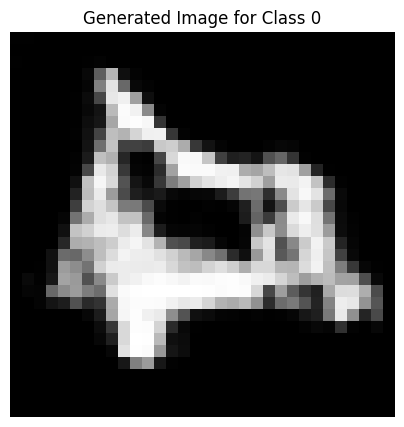

Epoch [1877/2500], D_loss: -0.06720372289419174, G_loss: -0.48972123861312866


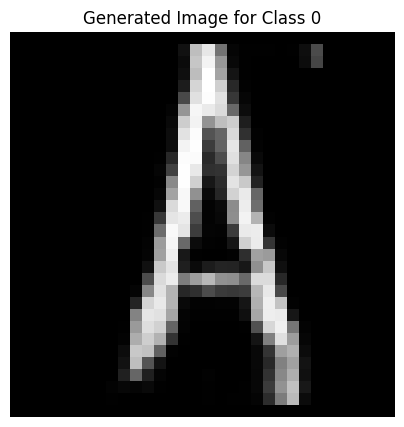

Epoch [1878/2500], D_loss: -0.08119199424982071, G_loss: -0.5238610506057739


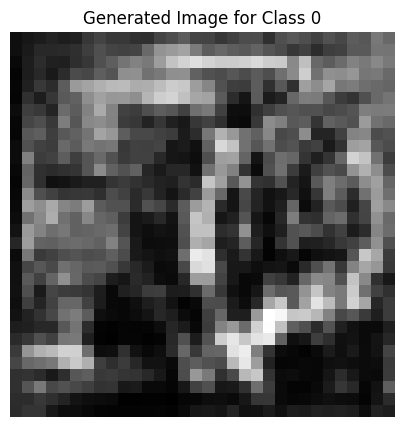

Epoch [1879/2500], D_loss: -0.10040867328643799, G_loss: -0.43705877661705017


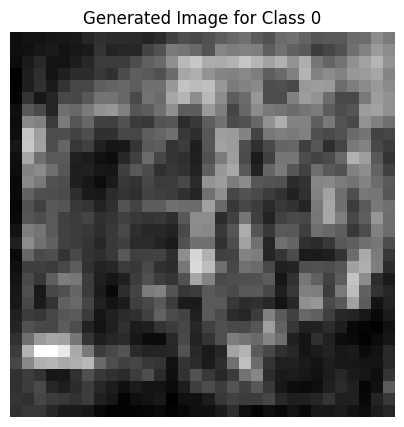

Epoch [1880/2500], D_loss: -0.0995604395866394, G_loss: -0.45827949047088623


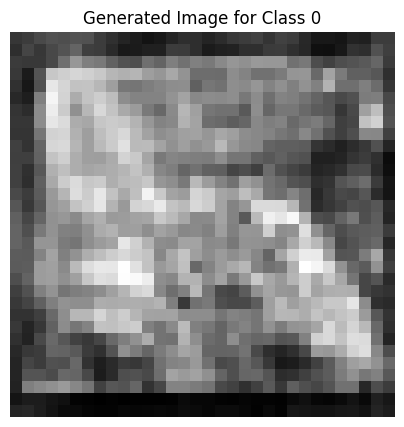

Epoch [1881/2500], D_loss: -0.09307393431663513, G_loss: -0.530300498008728


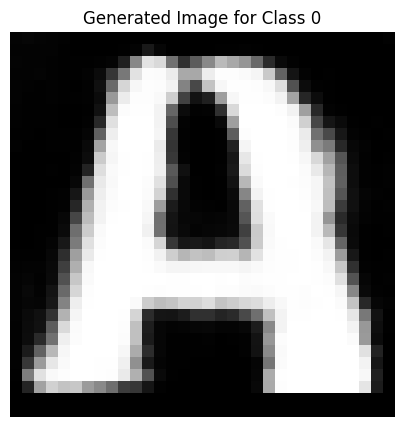

Epoch [1882/2500], D_loss: -0.0973939448595047, G_loss: -0.4438507556915283


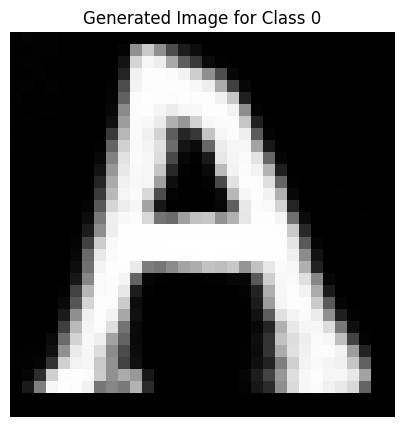

Epoch [1883/2500], D_loss: -0.10298322886228561, G_loss: -0.5543553233146667


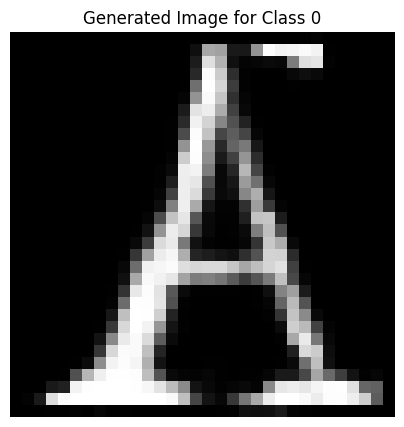

Epoch [1884/2500], D_loss: -0.08461445569992065, G_loss: -0.6029317378997803


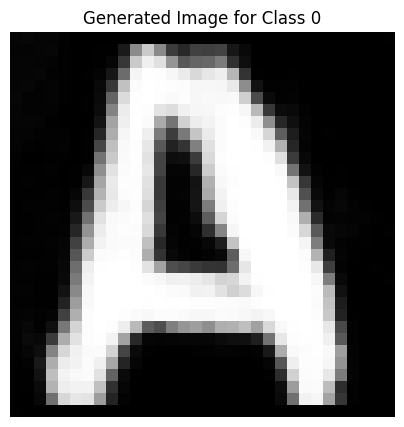

Epoch [1885/2500], D_loss: -0.1024731919169426, G_loss: -0.4135756492614746


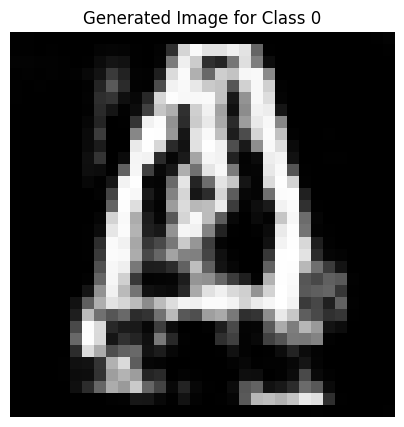

Epoch [1886/2500], D_loss: -0.0995393842458725, G_loss: -0.5162628889083862


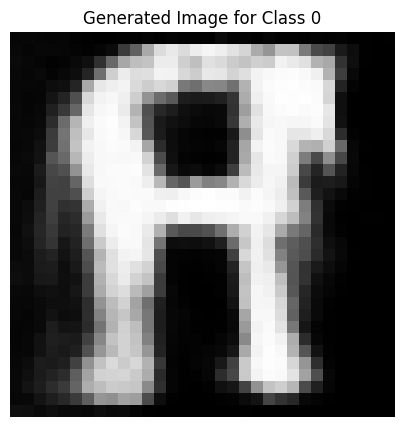

Epoch [1887/2500], D_loss: -0.12328556180000305, G_loss: -0.47019684314727783


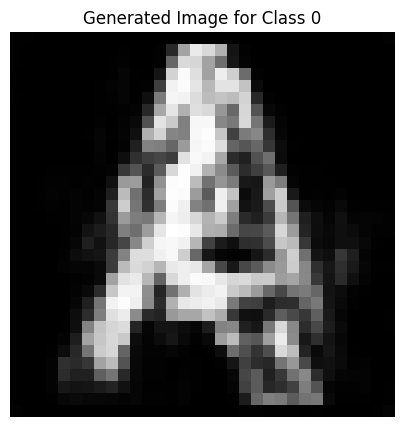

Epoch [1888/2500], D_loss: -0.09097586572170258, G_loss: -0.5295928716659546


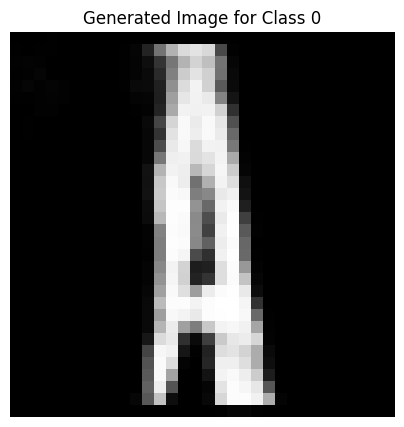

Epoch [1889/2500], D_loss: -0.08329949527978897, G_loss: -0.39738619327545166


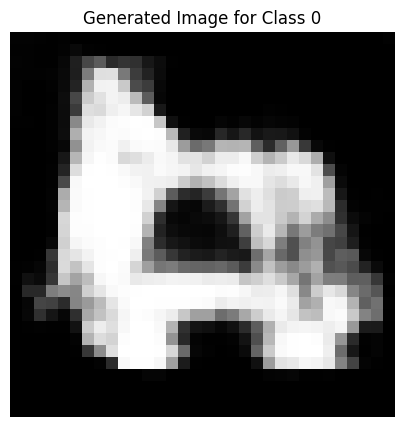

Epoch [1890/2500], D_loss: -0.0919874832034111, G_loss: -0.4182274341583252


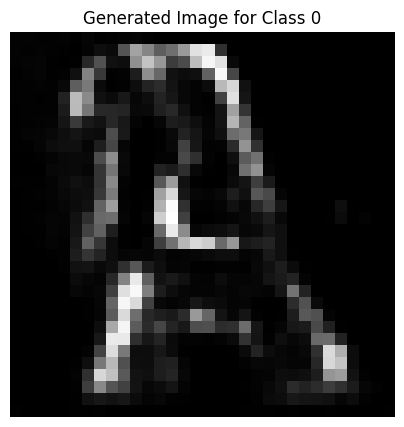

Epoch [1891/2500], D_loss: -0.1061096116900444, G_loss: -0.4802154302597046


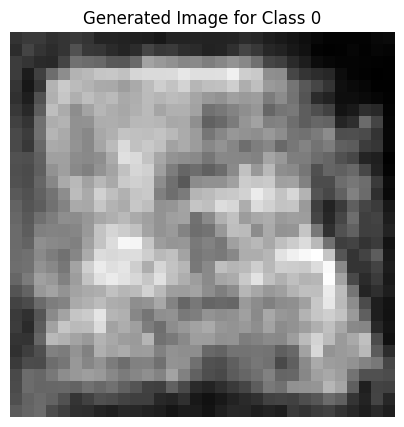

Epoch [1892/2500], D_loss: -0.08889240026473999, G_loss: -0.5103310346603394


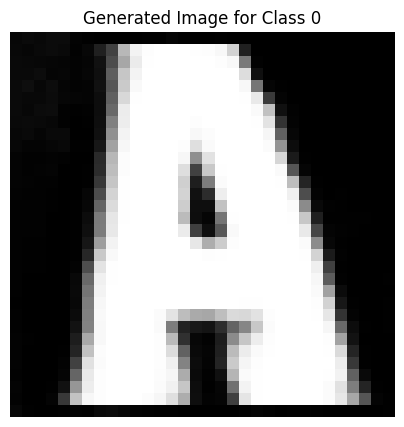

Epoch [1893/2500], D_loss: -0.06729191541671753, G_loss: -0.5225667953491211


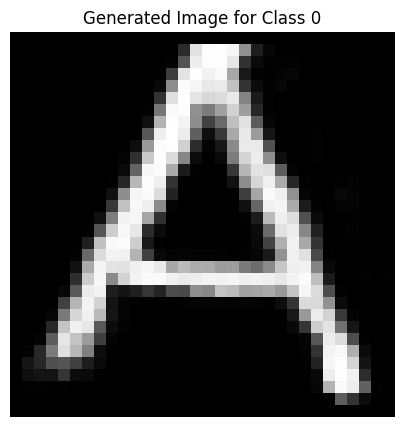

Epoch [1894/2500], D_loss: -0.05736768990755081, G_loss: -0.4997056722640991


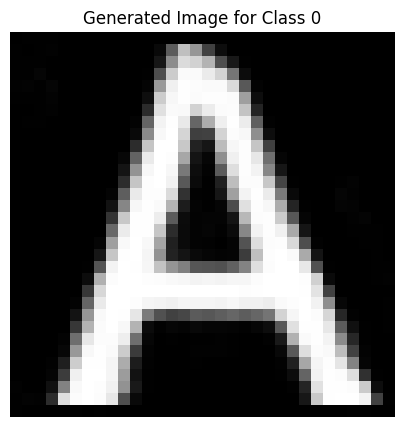

Epoch [1895/2500], D_loss: -0.10041821748018265, G_loss: -0.501964271068573


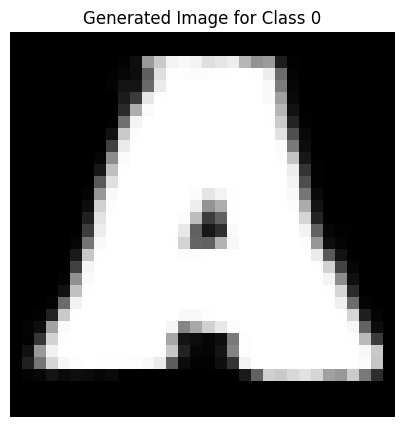

Epoch [1896/2500], D_loss: -0.08791062235832214, G_loss: -0.5773831605911255


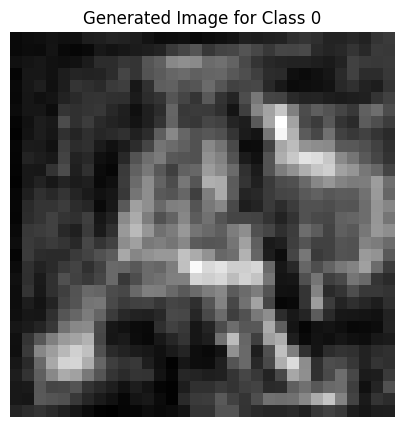

Epoch [1897/2500], D_loss: -0.09393730014562607, G_loss: -0.45751887559890747


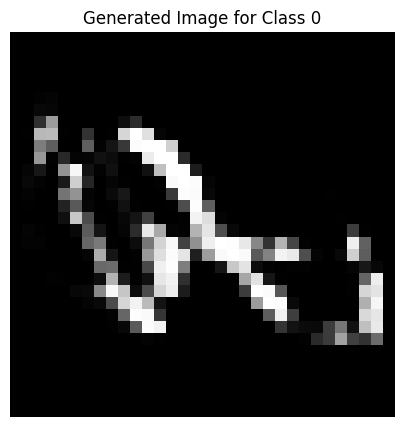

Epoch [1898/2500], D_loss: -0.10988986492156982, G_loss: -0.5244536399841309


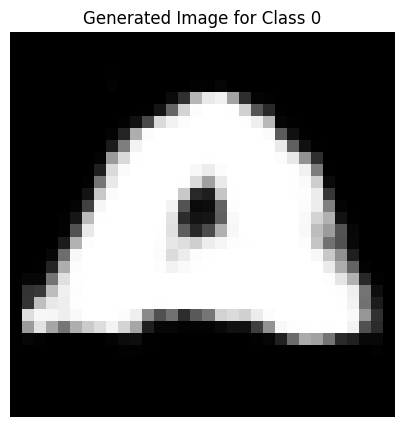

Epoch [1899/2500], D_loss: -0.09527365863323212, G_loss: -0.4609537124633789


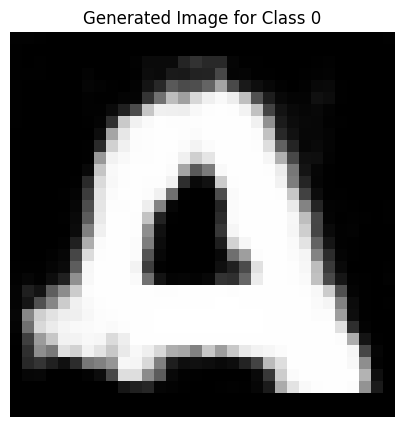

Epoch [1900/2500], D_loss: -0.11235648393630981, G_loss: -0.6366819739341736


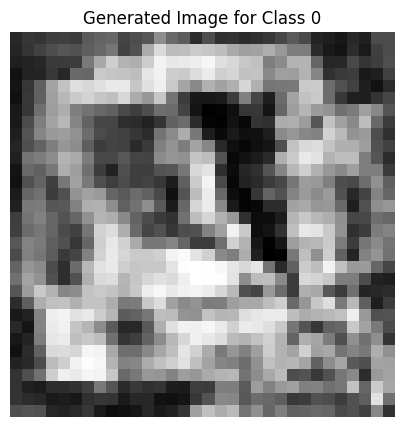

Epoch [1901/2500], D_loss: -0.09885949641466141, G_loss: -0.5536028742790222


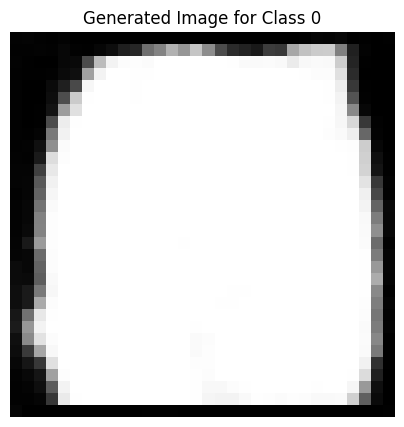

Epoch [1902/2500], D_loss: 0.09140291810035706, G_loss: -0.46520882844924927


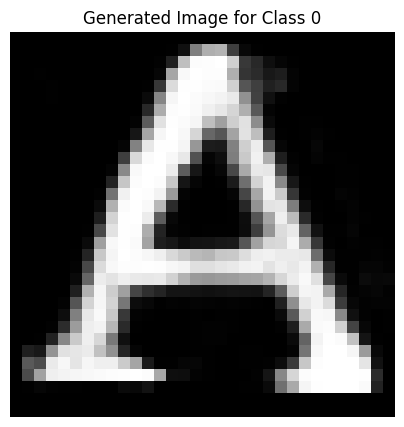

Epoch [1903/2500], D_loss: -0.08665473759174347, G_loss: -0.4875975251197815


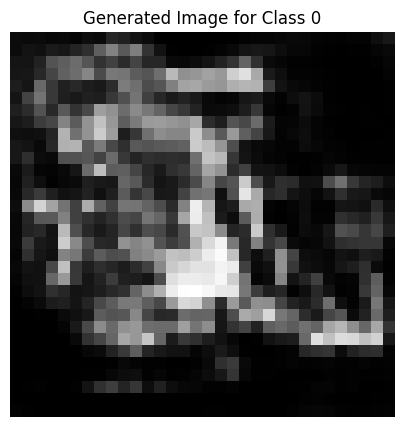

Epoch [1904/2500], D_loss: -0.10014061629772186, G_loss: -0.54618901014328


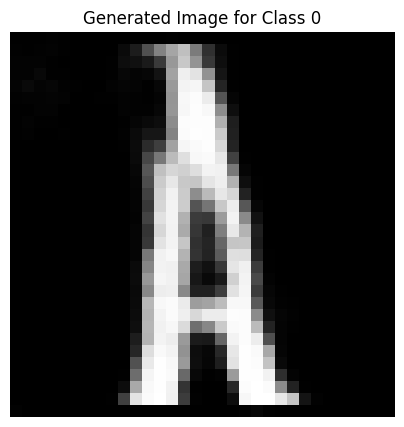

Epoch [1905/2500], D_loss: -0.09271178394556046, G_loss: -0.40971359610557556


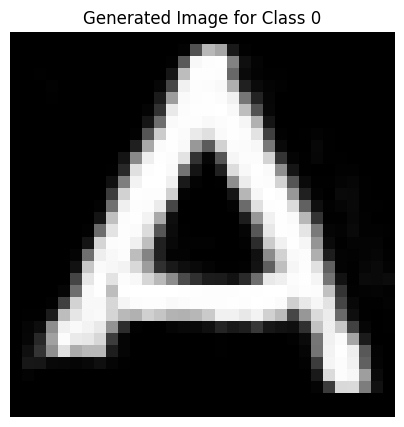

Epoch [1906/2500], D_loss: -0.09049031883478165, G_loss: -0.4173126220703125


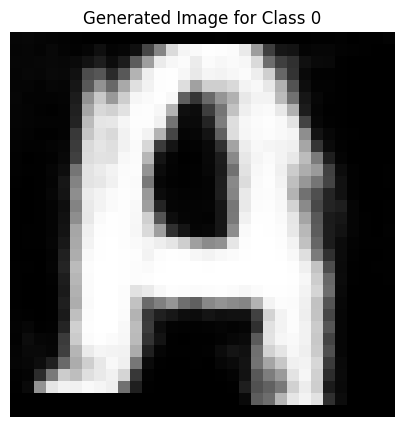

Epoch [1907/2500], D_loss: -0.07540439069271088, G_loss: -0.4978448450565338


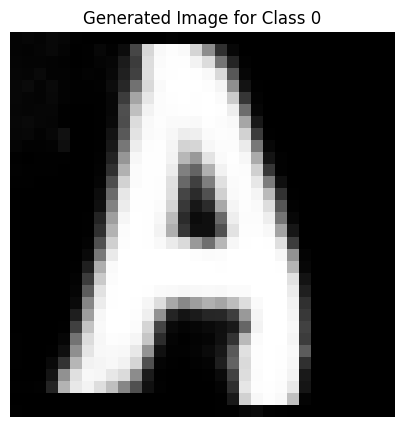

Epoch [1908/2500], D_loss: -0.09215445816516876, G_loss: -0.42013120651245117


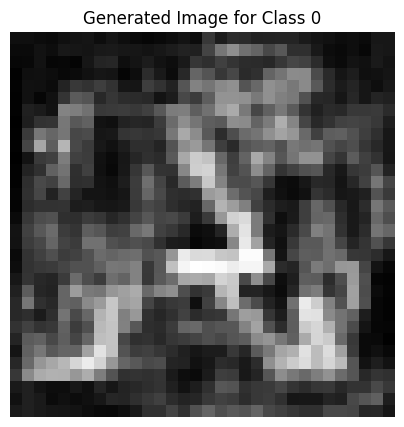

Epoch [1909/2500], D_loss: -0.09801596403121948, G_loss: -0.4562488794326782


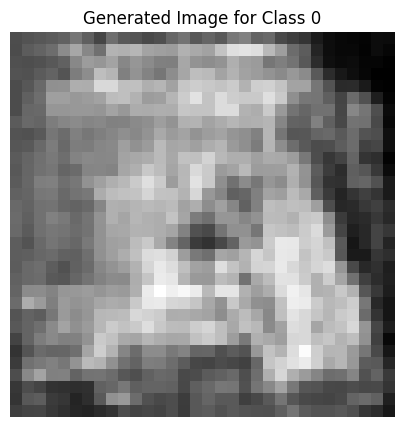

Epoch [1910/2500], D_loss: -0.11529063433408737, G_loss: -0.5347195863723755


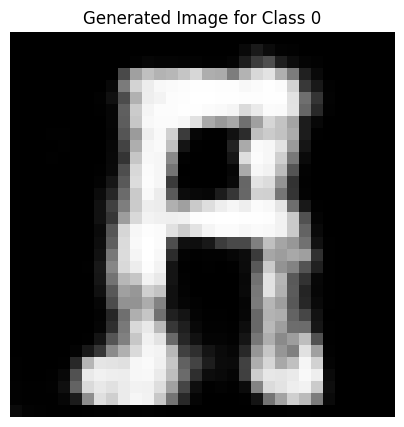

Epoch [1911/2500], D_loss: -0.1198381707072258, G_loss: -0.44273653626441956


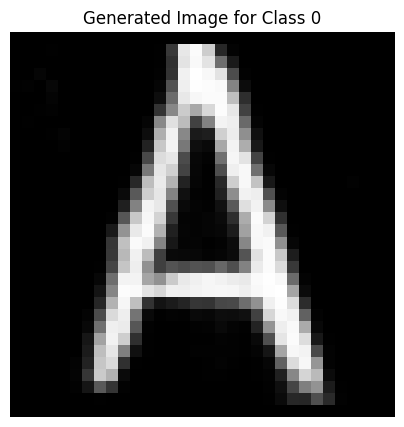

Epoch [1912/2500], D_loss: -0.10750910639762878, G_loss: -0.4519014060497284


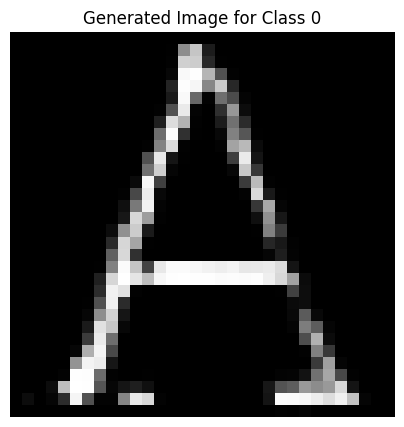

Epoch [1913/2500], D_loss: -0.11922751367092133, G_loss: -0.47773033380508423


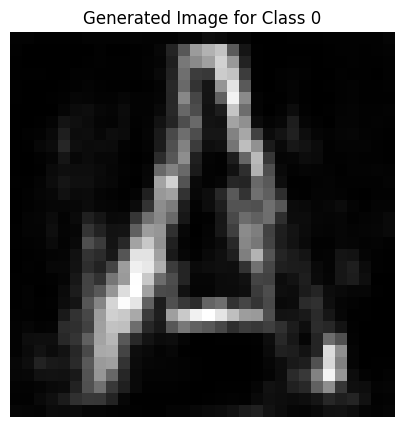

Epoch [1914/2500], D_loss: -0.0804414227604866, G_loss: -0.5889859795570374


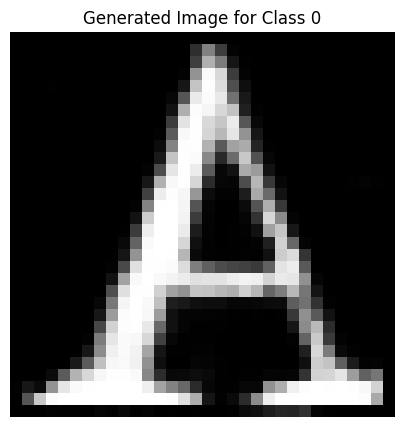

Epoch [1915/2500], D_loss: -0.10975874960422516, G_loss: -0.5011333227157593


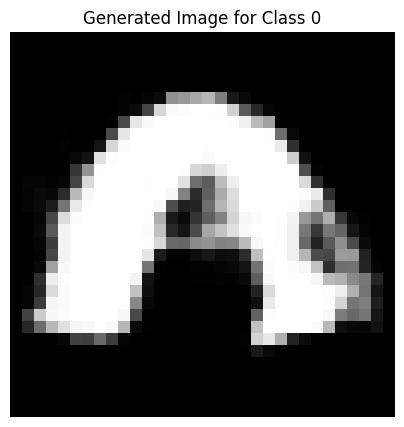

Epoch [1916/2500], D_loss: -0.09949851036071777, G_loss: -0.4301145374774933


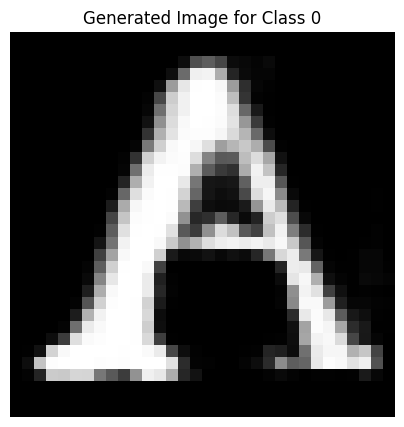

Epoch [1917/2500], D_loss: -0.10454494506120682, G_loss: -0.45803433656692505


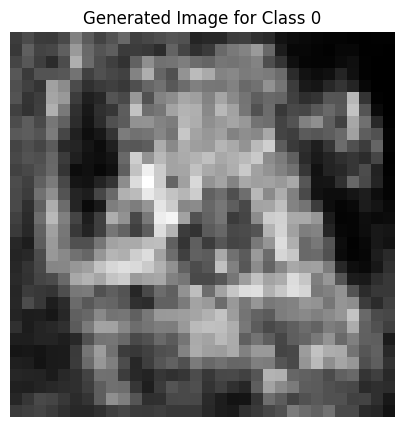

Epoch [1918/2500], D_loss: -0.09533783793449402, G_loss: -0.46819183230400085


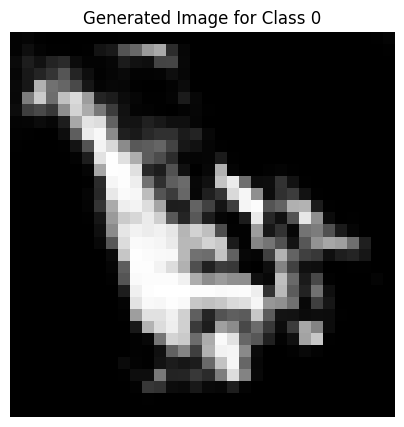

Epoch [1919/2500], D_loss: -0.07806378602981567, G_loss: -0.49171268939971924


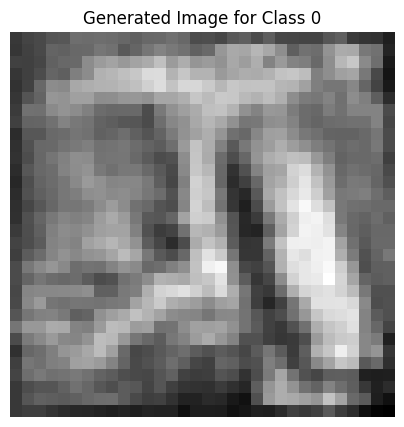

Epoch [1920/2500], D_loss: -0.07307716459035873, G_loss: -0.4941312074661255


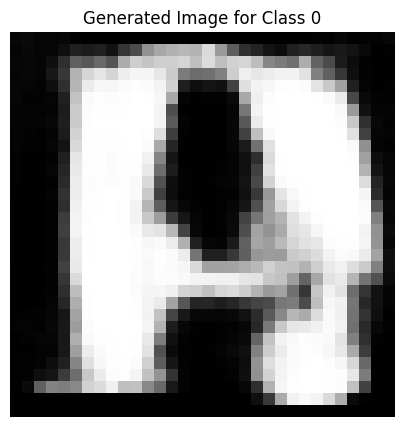

Epoch [1921/2500], D_loss: -0.034900158643722534, G_loss: -0.5019283890724182


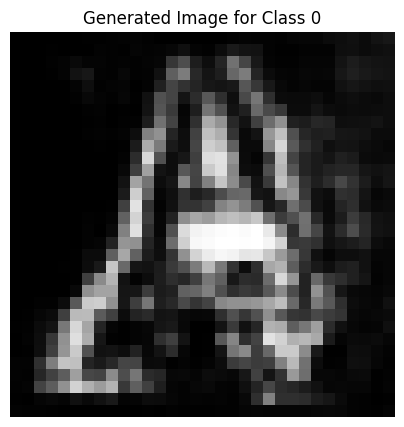

Epoch [1922/2500], D_loss: -0.0726955384016037, G_loss: -0.4386865496635437


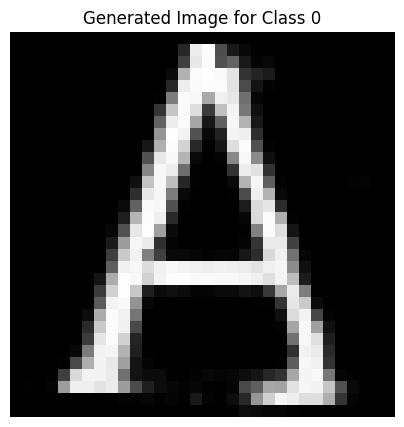

Epoch [1923/2500], D_loss: -0.0980166345834732, G_loss: -0.4695635139942169


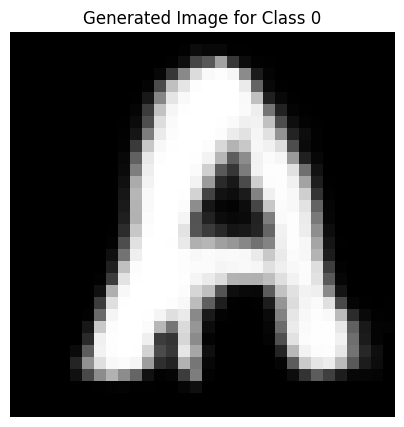

Epoch [1924/2500], D_loss: -0.0825280174612999, G_loss: -0.3596080541610718


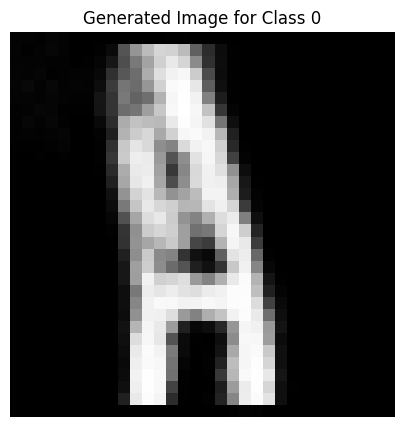

Epoch [1925/2500], D_loss: -0.1142464280128479, G_loss: -0.5520918369293213


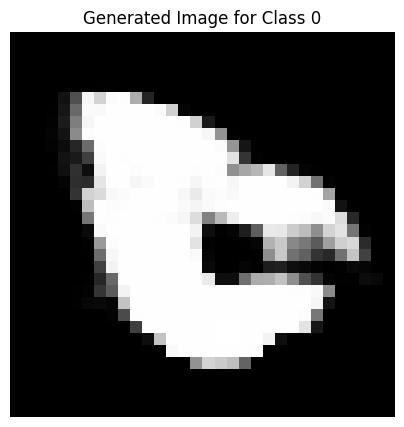

Epoch [1926/2500], D_loss: -0.09174444526433945, G_loss: -0.5010291337966919


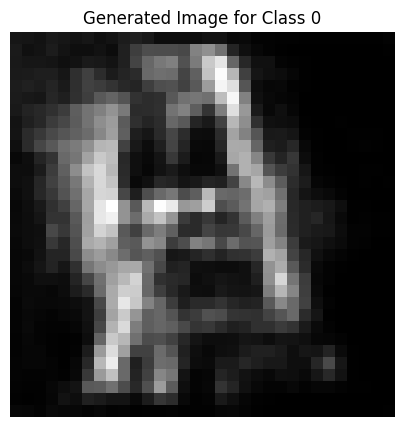

Epoch [1927/2500], D_loss: -0.07390075922012329, G_loss: -0.4944103956222534


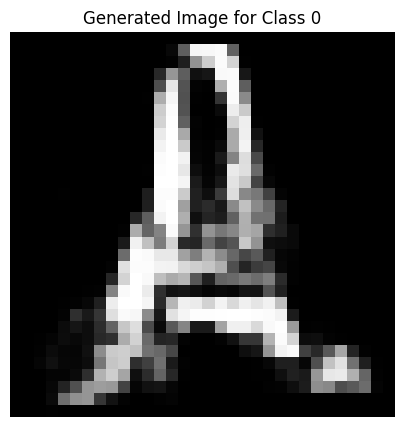

Epoch [1928/2500], D_loss: -0.09734007716178894, G_loss: -0.39400768280029297


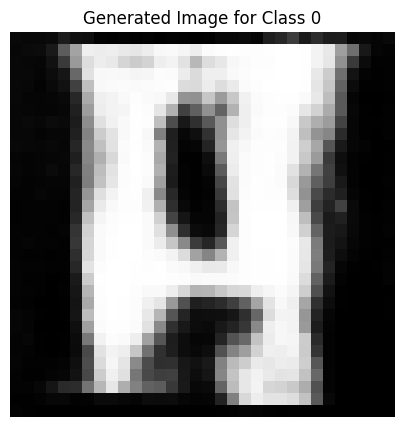

Epoch [1929/2500], D_loss: -0.09715825319290161, G_loss: -0.4938212037086487


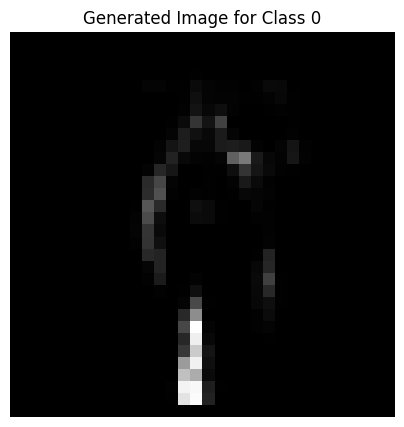

Epoch [1930/2500], D_loss: -0.12283249199390411, G_loss: -0.4594760239124298


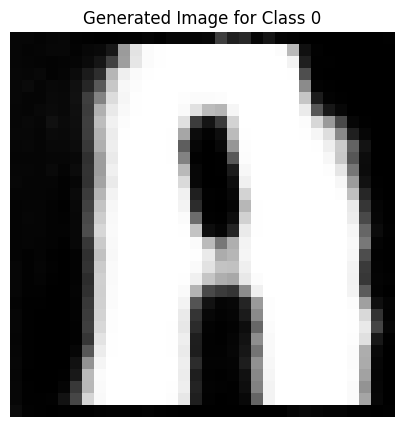

Epoch [1931/2500], D_loss: -0.10670745372772217, G_loss: -0.4717163145542145


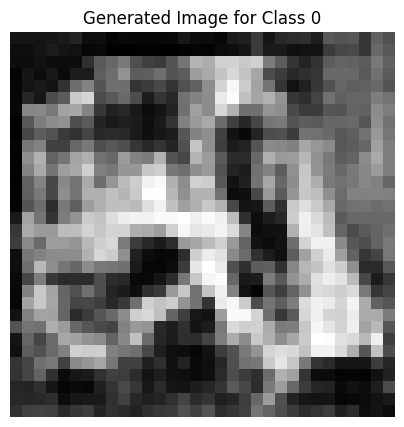

Epoch [1932/2500], D_loss: -0.1271892935037613, G_loss: -0.45902174711227417


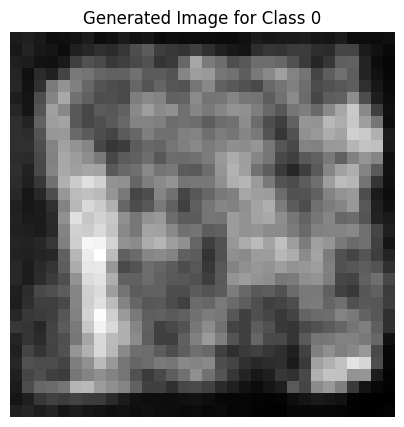

Epoch [1933/2500], D_loss: -0.062280960381031036, G_loss: -0.47934502363204956


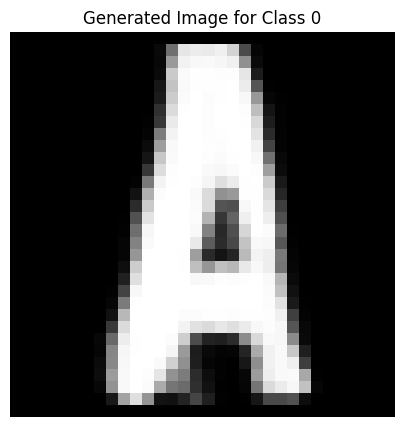

Epoch [1934/2500], D_loss: -0.11812290549278259, G_loss: -0.4708455801010132


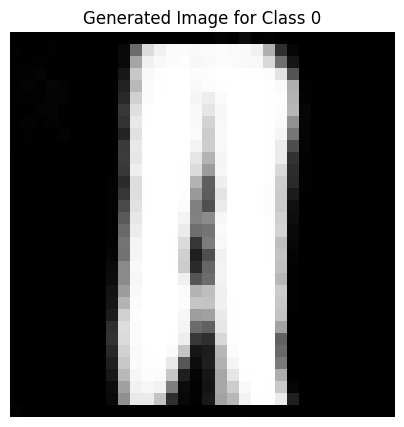

Epoch [1935/2500], D_loss: -0.11580310761928558, G_loss: -0.4417344629764557


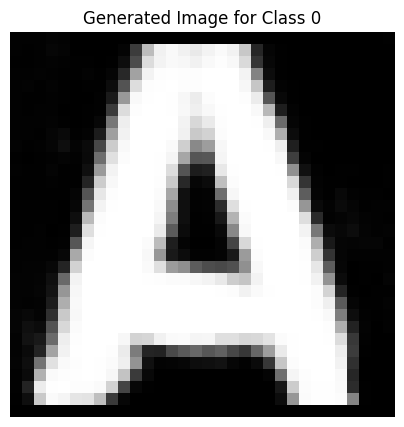

Epoch [1936/2500], D_loss: -0.10694463551044464, G_loss: -0.4113349914550781


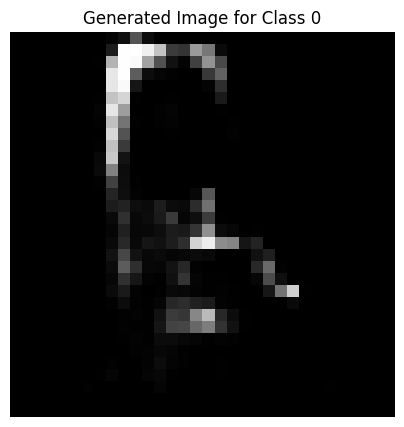

Epoch [1937/2500], D_loss: -0.11869704723358154, G_loss: -0.43790897727012634


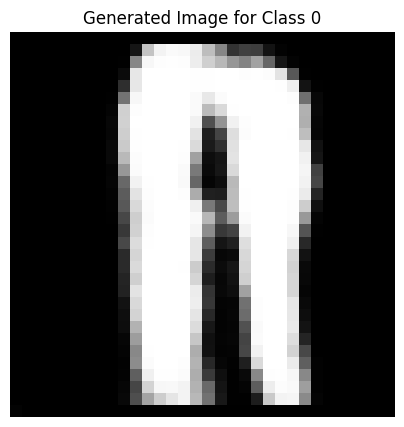

Epoch [1938/2500], D_loss: -0.11953097581863403, G_loss: -0.49954235553741455


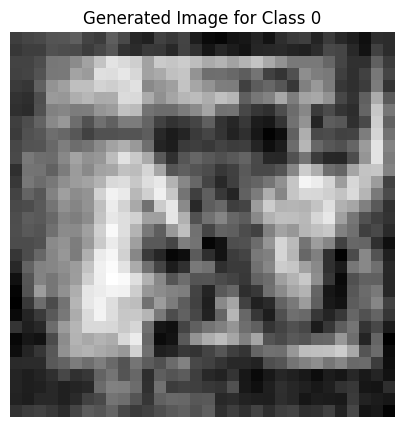

Epoch [1939/2500], D_loss: -0.11154447495937347, G_loss: -0.5676318407058716


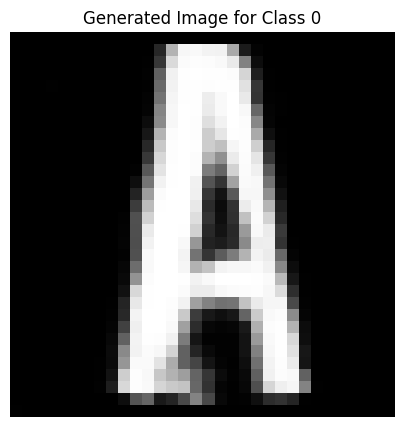

Epoch [1940/2500], D_loss: -0.09172563254833221, G_loss: -0.5135560631752014


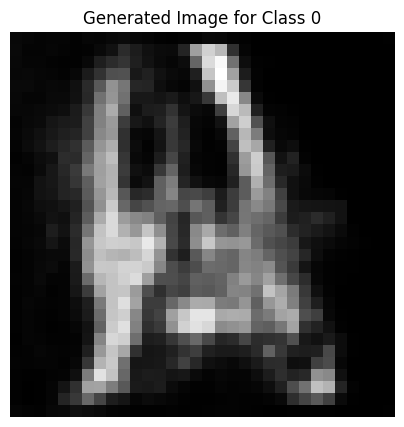

Epoch [1941/2500], D_loss: -0.12048609554767609, G_loss: -0.5156737565994263


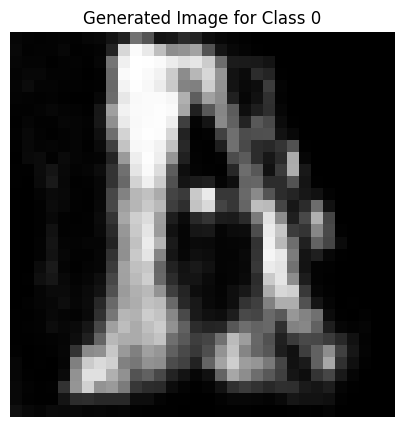

Epoch [1942/2500], D_loss: -0.11532910913228989, G_loss: -0.505113959312439


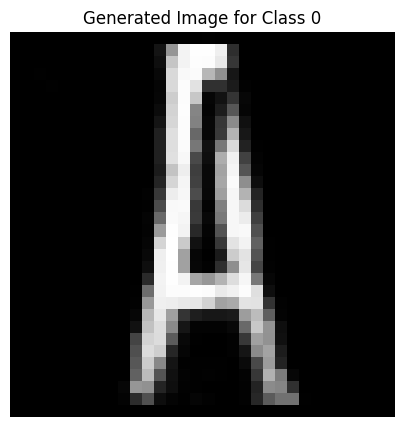

Epoch [1943/2500], D_loss: -0.10473931580781937, G_loss: -0.5265564918518066


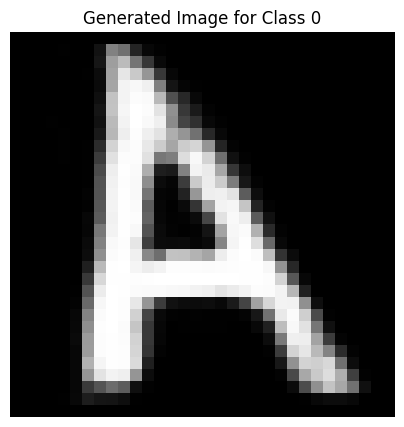

Epoch [1944/2500], D_loss: -0.09849424660205841, G_loss: -0.5692785382270813


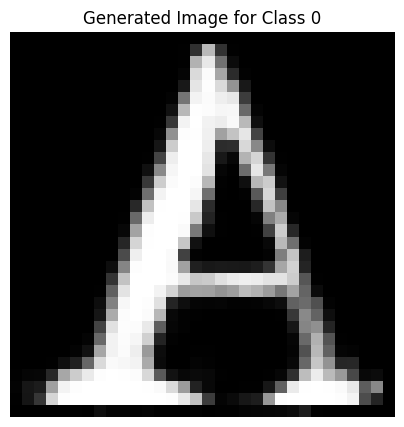

Epoch [1945/2500], D_loss: -0.11456514894962311, G_loss: -0.537792980670929


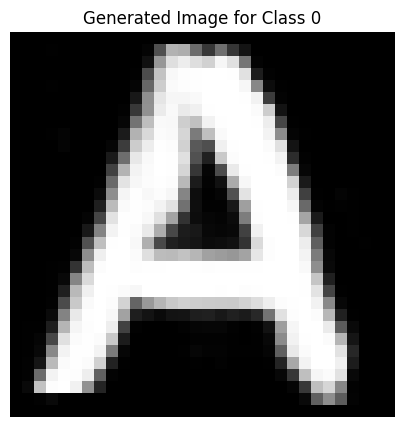

Epoch [1946/2500], D_loss: -0.09674549847841263, G_loss: -0.5052005052566528


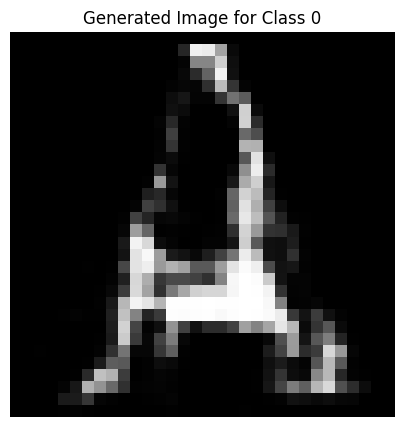

Epoch [1947/2500], D_loss: -0.11538103222846985, G_loss: -0.4559405744075775


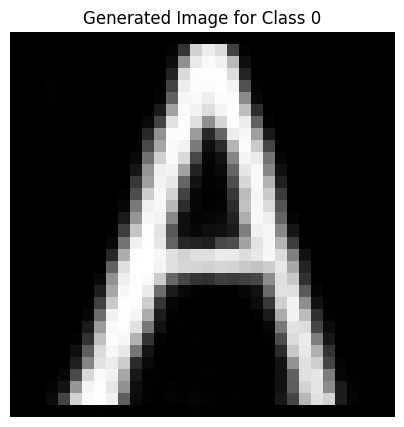

Epoch [1948/2500], D_loss: -0.06954647600650787, G_loss: -0.4980584979057312


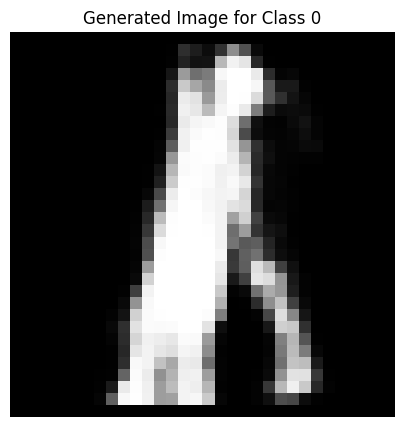

Epoch [1949/2500], D_loss: -0.12720337510108948, G_loss: -0.4486934244632721


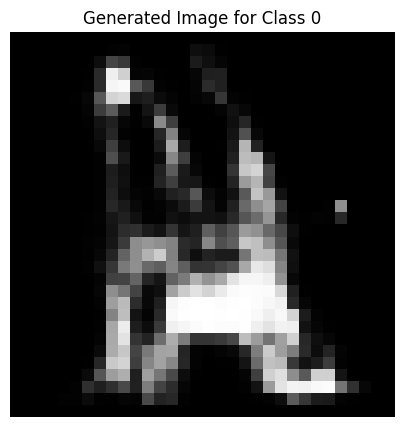

Epoch [1950/2500], D_loss: -0.11484294384717941, G_loss: -0.5204508304595947


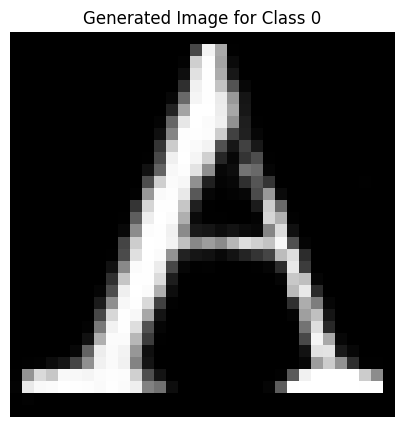

Epoch [1951/2500], D_loss: -0.09457206726074219, G_loss: -0.5136932134628296


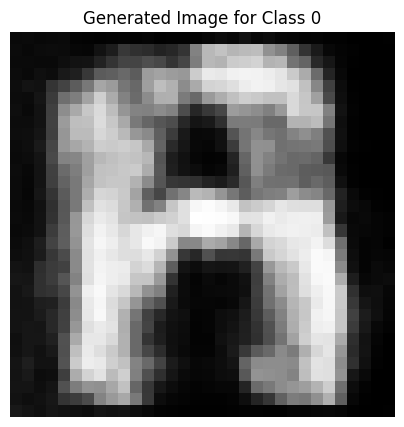

Epoch [1952/2500], D_loss: -0.10581862926483154, G_loss: -0.5354773998260498


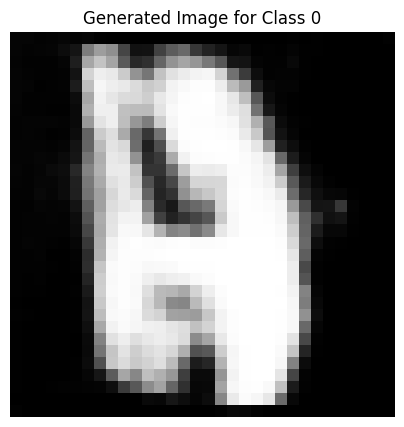

Epoch [1953/2500], D_loss: -0.10504090785980225, G_loss: -0.45456793904304504


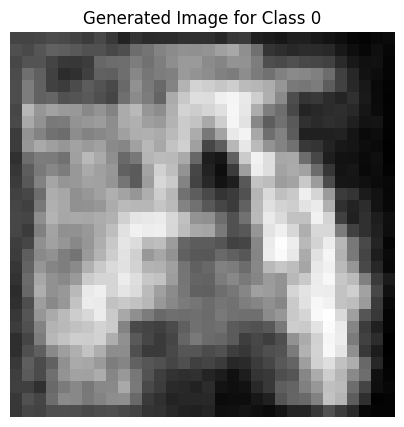

Epoch [1954/2500], D_loss: -0.1013374924659729, G_loss: -0.491266667842865


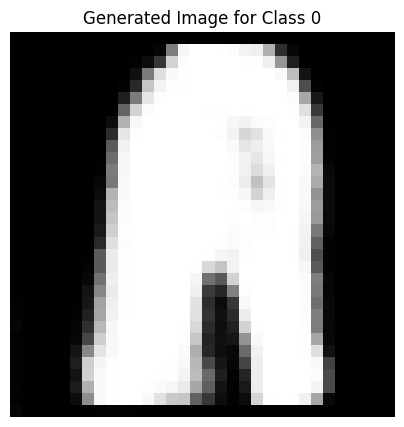

Epoch [1955/2500], D_loss: -0.10205940902233124, G_loss: -0.4870758652687073


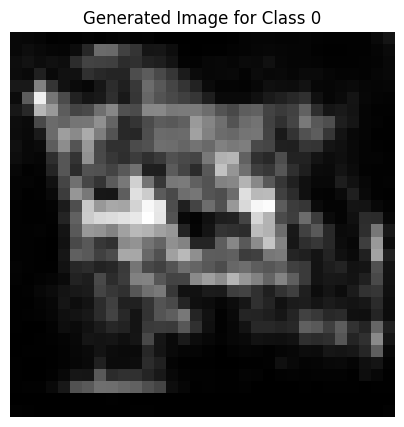

Epoch [1956/2500], D_loss: -0.09453890472650528, G_loss: -0.4911538064479828


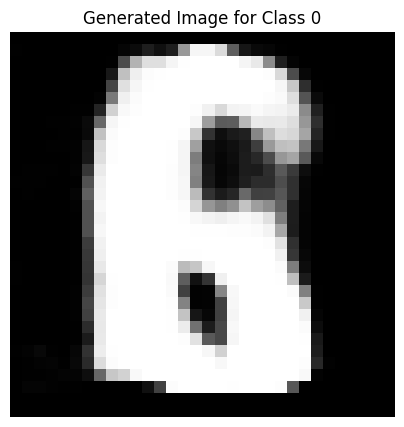

Epoch [1957/2500], D_loss: -0.10102061927318573, G_loss: -0.48445549607276917


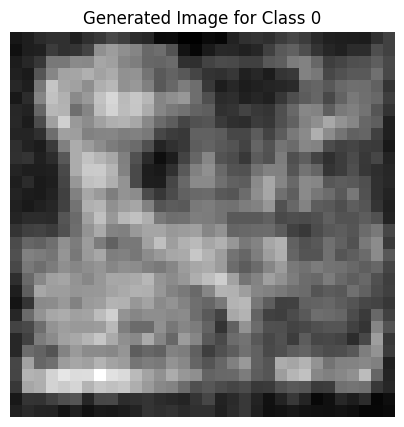

Epoch [1958/2500], D_loss: -0.13160130381584167, G_loss: -0.5136798620223999


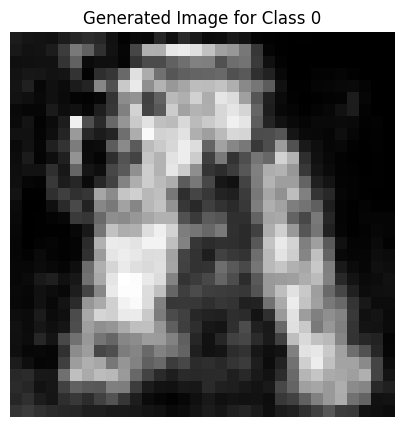

Epoch [1959/2500], D_loss: -0.12349015474319458, G_loss: -0.47519898414611816


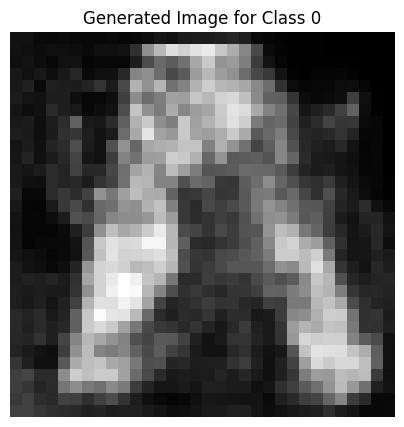

Epoch [1960/2500], D_loss: -0.11415830254554749, G_loss: -0.5406908988952637


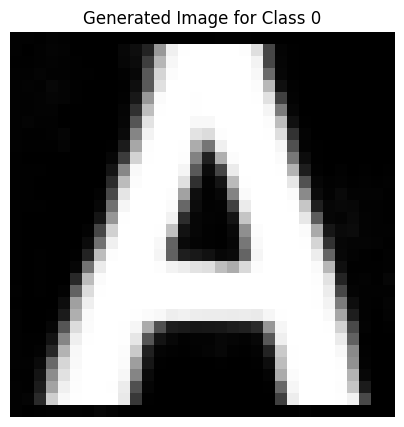

Epoch [1961/2500], D_loss: -0.11580154299736023, G_loss: -0.5114448070526123


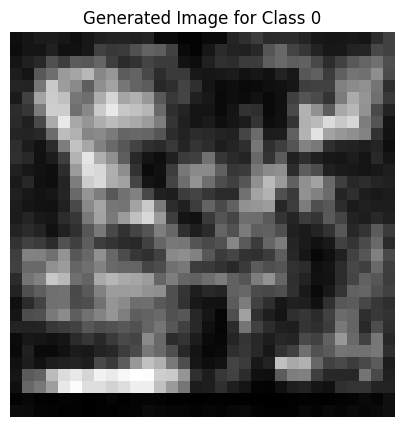

Epoch [1962/2500], D_loss: -0.1288730800151825, G_loss: -0.45955443382263184


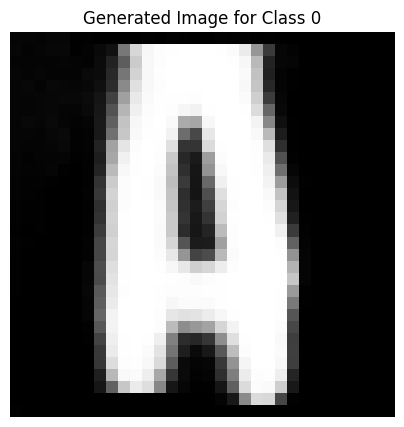

Epoch [1963/2500], D_loss: -0.09632976353168488, G_loss: -0.49751585721969604


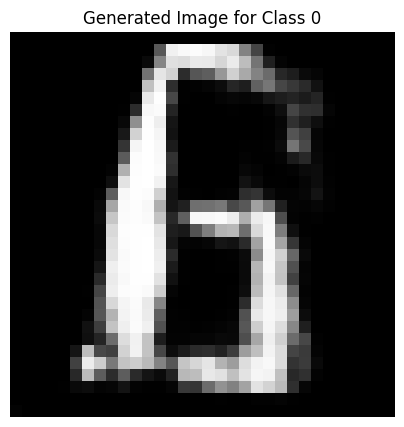

Epoch [1964/2500], D_loss: -0.10578182339668274, G_loss: -0.5598285794258118


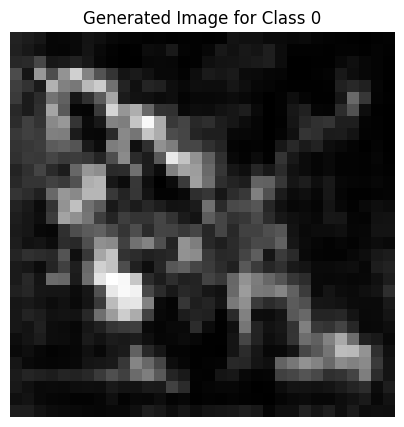

Epoch [1965/2500], D_loss: -0.11704716831445694, G_loss: -0.3883650302886963


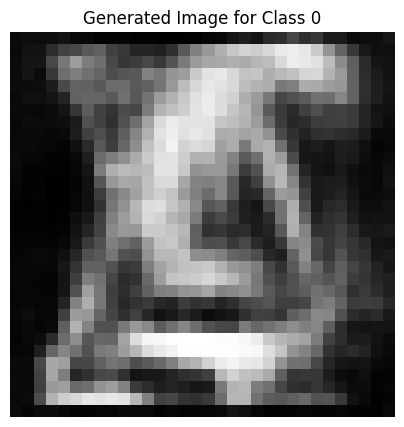

Epoch [1966/2500], D_loss: -0.12951472401618958, G_loss: -0.5484394431114197


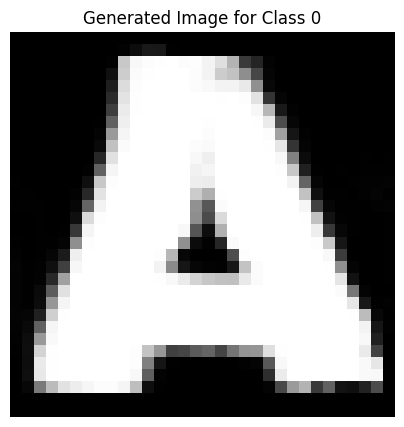

Epoch [1967/2500], D_loss: -0.10828615725040436, G_loss: -0.4861704707145691


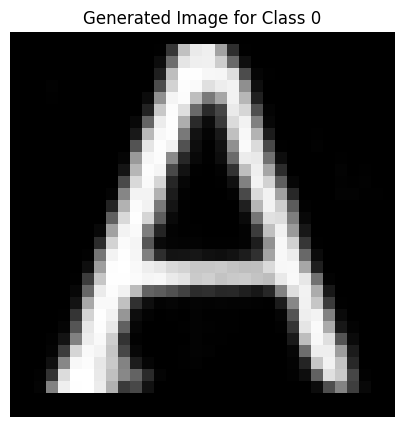

Epoch [1968/2500], D_loss: -0.09727280586957932, G_loss: -0.5197542309761047


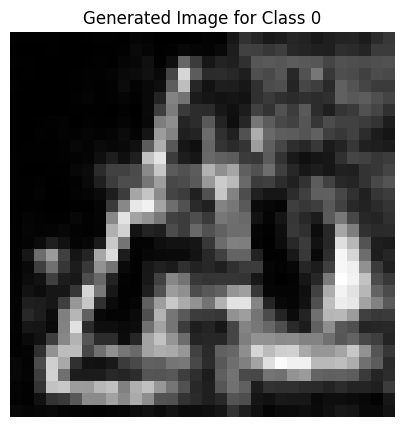

Epoch [1969/2500], D_loss: -0.11664604395627975, G_loss: -0.4349263310432434


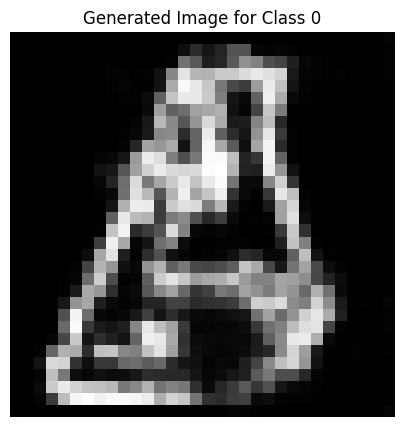

Epoch [1970/2500], D_loss: -0.1173296794295311, G_loss: -0.4790559709072113


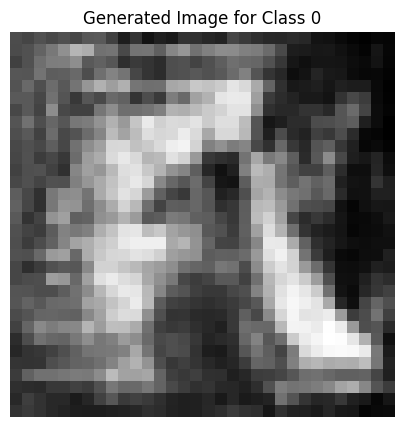

Epoch [1971/2500], D_loss: -0.11970005184412003, G_loss: -0.4760427474975586


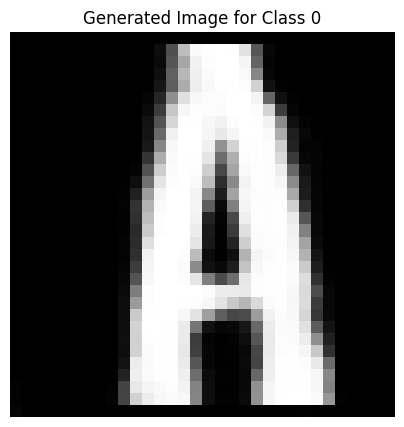

Epoch [1972/2500], D_loss: -0.11342348903417587, G_loss: -0.430417001247406


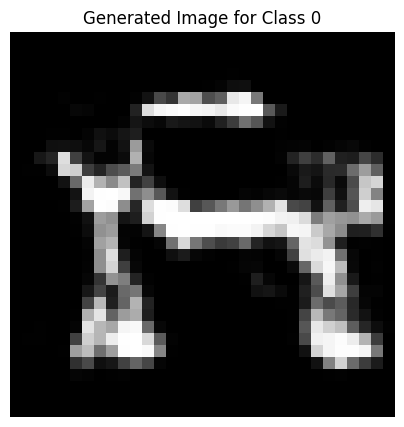

Epoch [1973/2500], D_loss: -0.11037688702344894, G_loss: -0.6191474795341492


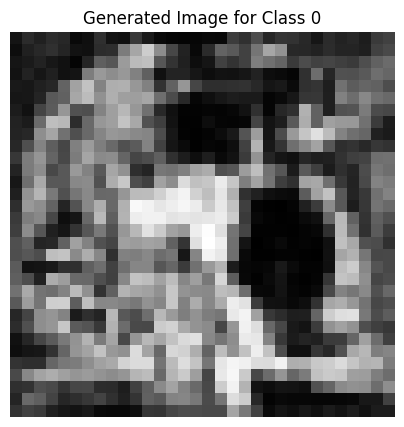

Epoch [1974/2500], D_loss: -0.10815562307834625, G_loss: -0.4130381941795349


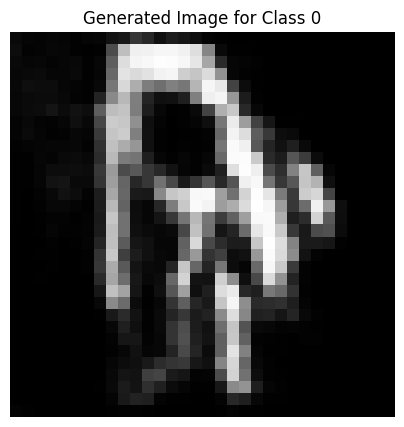

Epoch [1975/2500], D_loss: -0.11961840838193893, G_loss: -0.49178388714790344


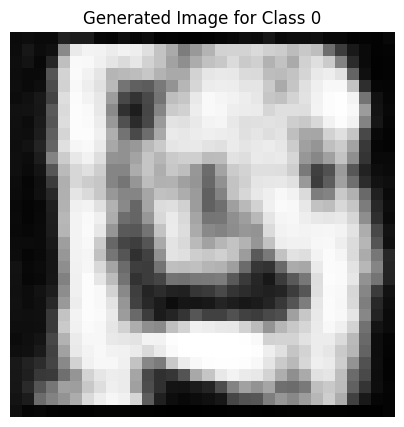

Epoch [1976/2500], D_loss: -0.11162683367729187, G_loss: -0.5191004276275635


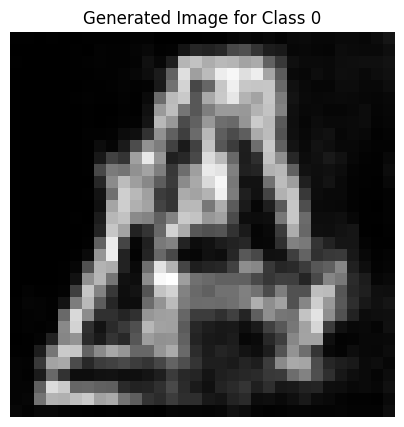

Epoch [1977/2500], D_loss: -0.1086319163441658, G_loss: -0.4974634349346161


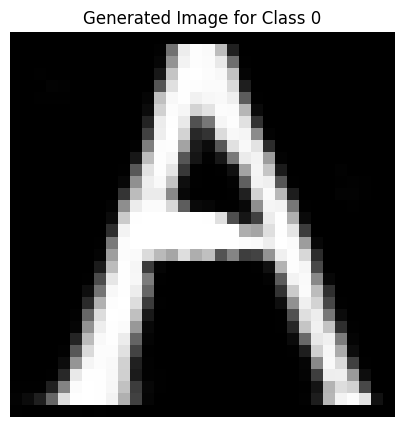

Epoch [1978/2500], D_loss: -0.10393825173377991, G_loss: -0.5592283010482788


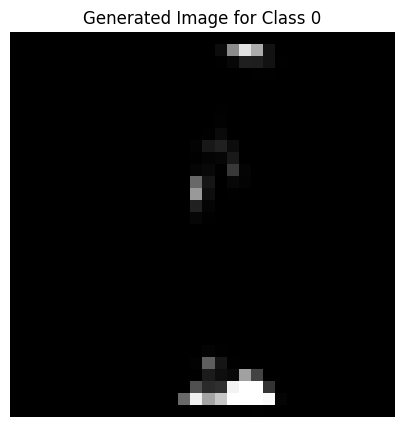

Epoch [1979/2500], D_loss: -0.12291181087493896, G_loss: -0.3956579566001892


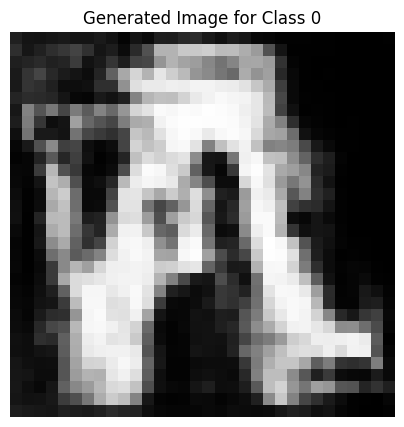

Epoch [1980/2500], D_loss: -0.10839235037565231, G_loss: -0.4401664137840271


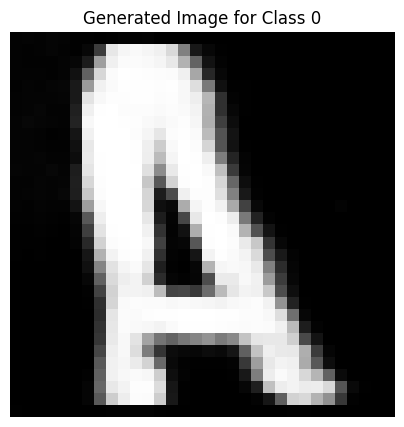

Epoch [1981/2500], D_loss: -0.08500485867261887, G_loss: -0.4984703063964844


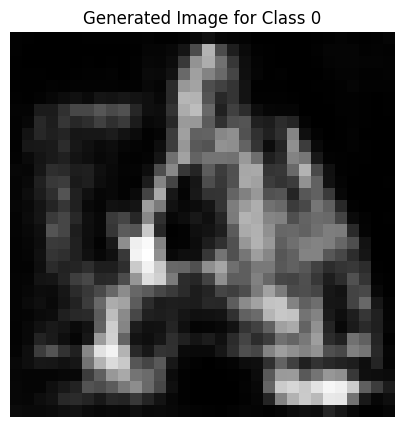

Epoch [1982/2500], D_loss: -0.10264923423528671, G_loss: -0.5106580257415771


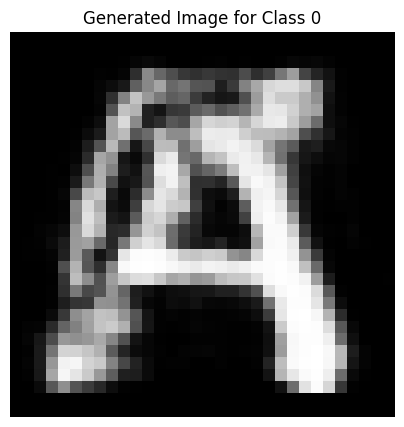

Epoch [1983/2500], D_loss: -0.08831155300140381, G_loss: -0.5066928863525391


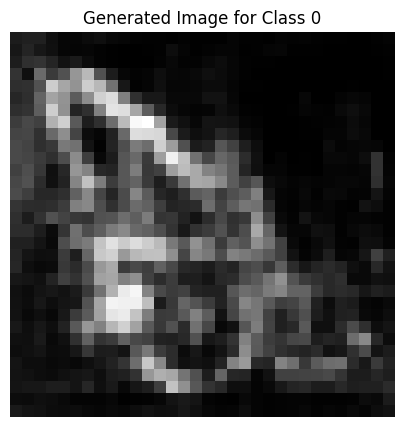

Epoch [1984/2500], D_loss: -0.12730321288108826, G_loss: -0.43349552154541016


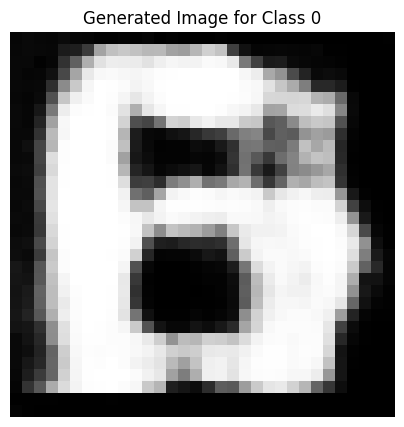

Epoch [1985/2500], D_loss: -0.10239437967538834, G_loss: -0.4782600998878479


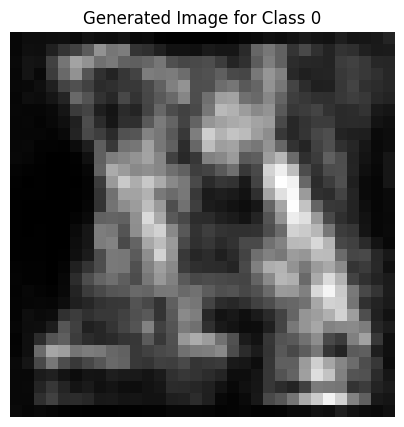

Epoch [1986/2500], D_loss: -0.1123780757188797, G_loss: -0.44890496134757996


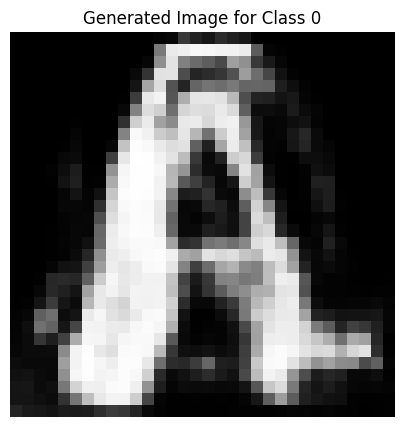

Epoch [1987/2500], D_loss: -0.1032412126660347, G_loss: -0.4689337909221649


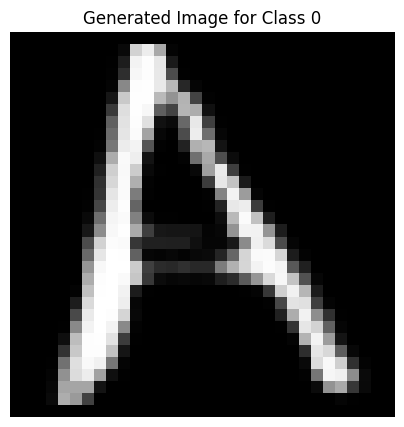

Epoch [1988/2500], D_loss: -0.10822702944278717, G_loss: -0.5110803842544556


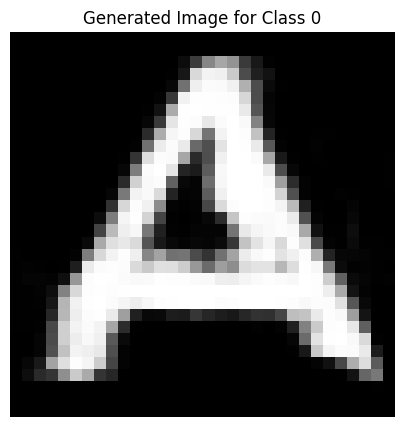

Epoch [1989/2500], D_loss: -0.05371537804603577, G_loss: -0.4958738684654236


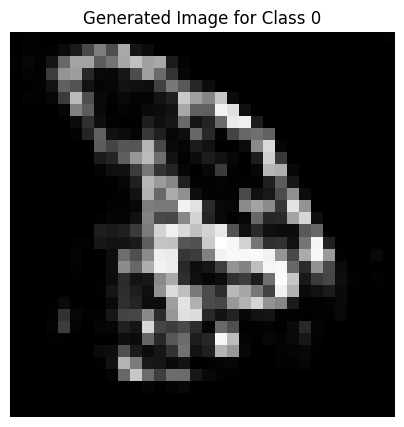

Epoch [1990/2500], D_loss: -0.10094520449638367, G_loss: -0.5915310382843018


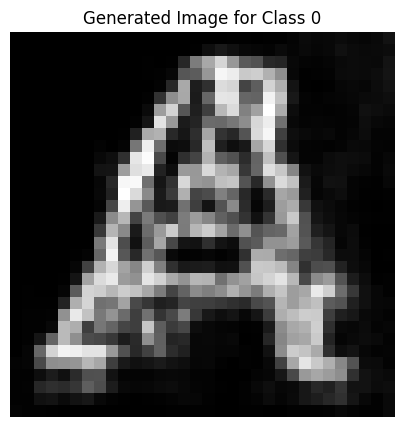

Epoch [1991/2500], D_loss: -0.046729639172554016, G_loss: -0.4682943820953369


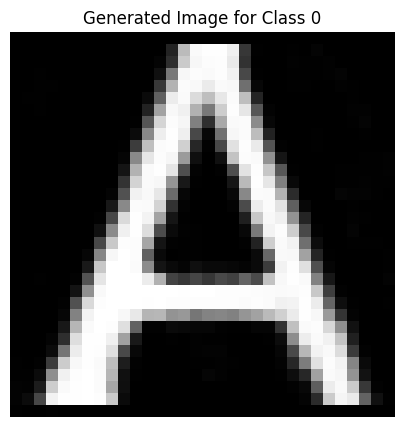

Epoch [1992/2500], D_loss: -0.09777168184518814, G_loss: -0.5444096922874451


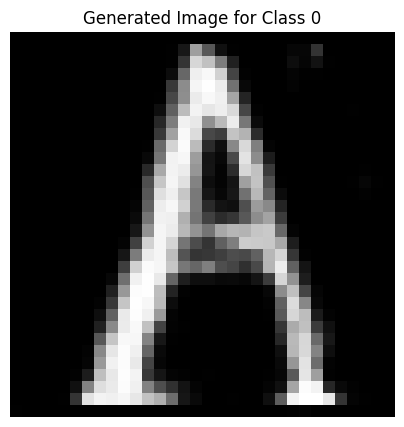

Epoch [1993/2500], D_loss: -0.09404949098825455, G_loss: -0.468472421169281


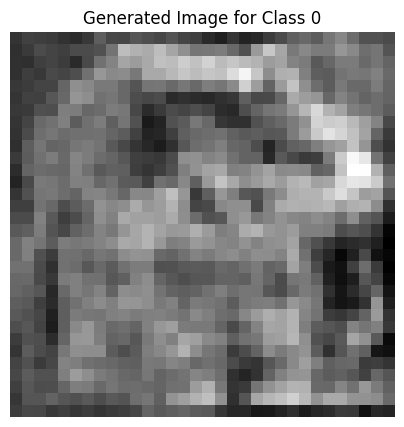

Epoch [1994/2500], D_loss: -0.05166046321392059, G_loss: -0.4763157069683075


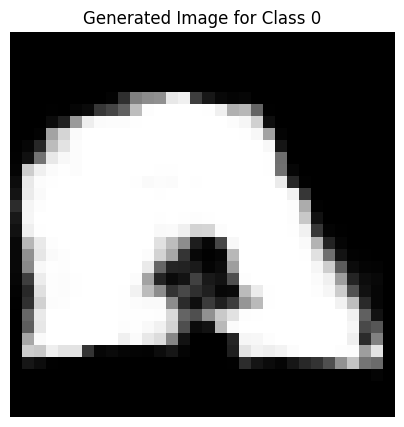

Epoch [1995/2500], D_loss: -0.10821317881345749, G_loss: -0.5181264877319336


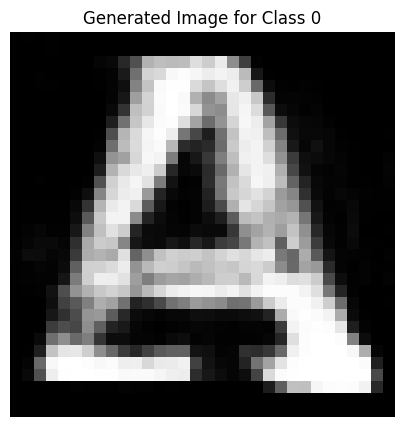

Epoch [1996/2500], D_loss: -0.045108579099178314, G_loss: -0.48847609758377075


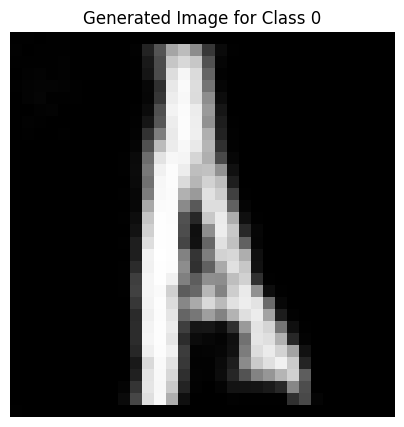

Epoch [1997/2500], D_loss: -0.10318656265735626, G_loss: -0.6396172642707825


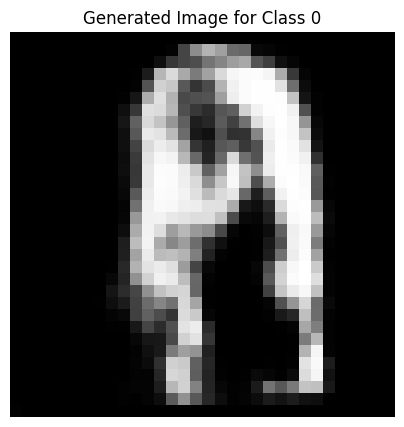

Epoch [1998/2500], D_loss: -0.08347196877002716, G_loss: -0.46786201000213623


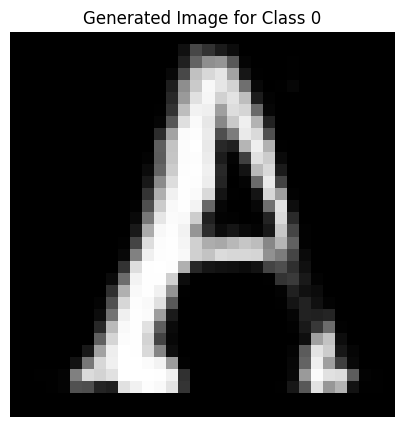

Epoch [1999/2500], D_loss: -0.08294474333524704, G_loss: -0.47923600673675537


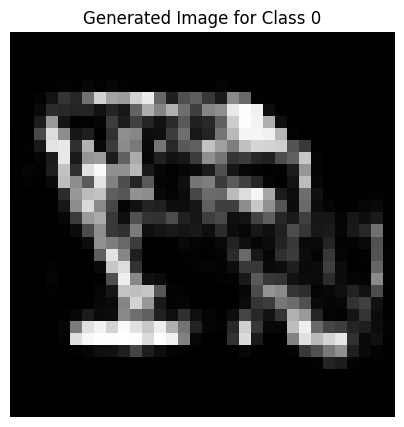

Epoch [2000/2500], D_loss: -0.08067087829113007, G_loss: -0.3694888949394226


Epoch [2001/2500], D_loss: -0.11163094639778137, G_loss: -0.45386403799057007


Epoch [2002/2500], D_loss: -0.11169574409723282, G_loss: -0.4723941385746002


Epoch [2003/2500], D_loss: -0.10674396902322769, G_loss: -0.4279404878616333


Epoch [2004/2500], D_loss: -0.1024734303355217, G_loss: -0.537716269493103


Epoch [2005/2500], D_loss: -0.10630679130554199, G_loss: -0.4711742401123047


Epoch [2006/2500], D_loss: -0.058565303683280945, G_loss: -0.5709712505340576


Epoch [2007/2500], D_loss: -0.10328729450702667, G_loss: -0.5115149021148682


Epoch [2008/2500], D_loss: -0.08145617693662643, G_loss: -0.5094953775405884


Epoch [2009/2500], D_loss: -0.11927808076143265, G_loss: -0.41255536675453186


Epoch [2010/2500], D_loss: -0.11616460978984833, G_loss: -0.5208037495613098


Epoch [2011/2500], D_loss: -0.07565195113420486, G_loss: -0.45430290699005127


Epoch [2012/2500], D_loss: -0.0668894574046135, G_loss: -0.4343997836112976


Epoch [2013/2500], D_loss: -0.10726312547922134, G_loss: -0.42782407999038696


Epoch [2014/2500], D_loss: -0.10263513028621674, G_loss: -0.5524923801422119


Epoch [2015/2500], D_loss: -0.10126916319131851, G_loss: -0.49902021884918213


Epoch [2016/2500], D_loss: -0.09765245765447617, G_loss: -0.46790531277656555


Epoch [2017/2500], D_loss: -0.12271860986948013, G_loss: -0.439879834651947


Epoch [2018/2500], D_loss: -0.10336320102214813, G_loss: -0.48839789628982544


Epoch [2019/2500], D_loss: -0.1215456947684288, G_loss: -0.4565712809562683


Epoch [2020/2500], D_loss: -0.11217398196458817, G_loss: -0.5200462341308594


Epoch [2021/2500], D_loss: -0.09407827258110046, G_loss: -0.4227663576602936


Epoch [2022/2500], D_loss: -0.11142995953559875, G_loss: -0.4667941927909851


Epoch [2023/2500], D_loss: -0.11511196941137314, G_loss: -0.5134948492050171


Epoch [2024/2500], D_loss: -0.08700313419103622, G_loss: -0.421286404132843


Epoch [2025/2500], D_loss: -0.1064368262887001, G_loss: -0.4915871024131775


Epoch [2026/2500], D_loss: -0.09991205483675003, G_loss: -0.5186201930046082


Epoch [2027/2500], D_loss: -0.11487895995378494, G_loss: -0.42231497168540955


Epoch [2028/2500], D_loss: -0.10057038813829422, G_loss: -0.45739543437957764


Epoch [2029/2500], D_loss: -0.1235174760222435, G_loss: -0.491617888212204


Epoch [2030/2500], D_loss: -0.09578707814216614, G_loss: -0.5104547739028931


Epoch [2031/2500], D_loss: -0.09638772904872894, G_loss: -0.45162466168403625


Epoch [2032/2500], D_loss: -0.1276136040687561, G_loss: -0.40804702043533325


Epoch [2033/2500], D_loss: -0.06542815268039703, G_loss: -0.3576226234436035


Epoch [2034/2500], D_loss: -0.11757756769657135, G_loss: -0.4795835018157959


Epoch [2035/2500], D_loss: -0.1264626681804657, G_loss: -0.48125144839286804


Epoch [2036/2500], D_loss: -0.12979097664356232, G_loss: -0.472929447889328


Epoch [2037/2500], D_loss: -0.12297199666500092, G_loss: -0.4836927652359009


Epoch [2038/2500], D_loss: -0.08644400537014008, G_loss: -0.5037459135055542


Epoch [2039/2500], D_loss: -0.11882547289133072, G_loss: -0.49690964818000793


Epoch [2040/2500], D_loss: -0.11076905578374863, G_loss: -0.4866666793823242


Epoch [2041/2500], D_loss: -0.1195145696401596, G_loss: -0.49439284205436707


Epoch [2042/2500], D_loss: -0.1263677179813385, G_loss: -0.46710795164108276


Epoch [2043/2500], D_loss: -0.10708316415548325, G_loss: -0.45230573415756226


Epoch [2044/2500], D_loss: -0.11576884984970093, G_loss: -0.5067190527915955


Epoch [2045/2500], D_loss: -0.12417294085025787, G_loss: -0.43854594230651855


Epoch [2046/2500], D_loss: -0.10174647718667984, G_loss: -0.4062289595603943


Epoch [2047/2500], D_loss: -0.08394958078861237, G_loss: -0.4399048388004303


Epoch [2048/2500], D_loss: -0.11391995847225189, G_loss: -0.5079382658004761


Epoch [2049/2500], D_loss: -0.11484085023403168, G_loss: -0.4521764814853668


Epoch [2050/2500], D_loss: -0.11055663228034973, G_loss: -0.38304030895233154


Epoch [2051/2500], D_loss: -0.1342197209596634, G_loss: -0.4770352244377136


Epoch [2052/2500], D_loss: -0.11281675100326538, G_loss: -0.6339179277420044


Epoch [2053/2500], D_loss: -0.10909373313188553, G_loss: -0.4510585069656372


Epoch [2054/2500], D_loss: -0.1245170533657074, G_loss: -0.5153219103813171


Epoch [2055/2500], D_loss: -0.12251497060060501, G_loss: -0.409162312746048


Epoch [2056/2500], D_loss: -0.10246123373508453, G_loss: -0.4427454173564911


Epoch [2057/2500], D_loss: -0.12859320640563965, G_loss: -0.49621060490608215


Epoch [2058/2500], D_loss: -0.0996587872505188, G_loss: -0.5466110706329346


Epoch [2059/2500], D_loss: -0.11018107831478119, G_loss: -0.45429861545562744


Epoch [2060/2500], D_loss: -0.11834864318370819, G_loss: -0.4737640619277954


Epoch [2061/2500], D_loss: -0.08448457717895508, G_loss: -0.492145836353302


Epoch [2062/2500], D_loss: -0.1165911927819252, G_loss: -0.5897451639175415


Epoch [2063/2500], D_loss: -0.11726982891559601, G_loss: -0.504990816116333


Epoch [2064/2500], D_loss: -0.11094355583190918, G_loss: -0.4957580268383026


Epoch [2065/2500], D_loss: -0.1336890608072281, G_loss: -0.399202436208725


Epoch [2066/2500], D_loss: -0.13077926635742188, G_loss: -0.5758056044578552


Epoch [2067/2500], D_loss: -0.12722226977348328, G_loss: -0.4548432230949402


Epoch [2068/2500], D_loss: -0.13461050391197205, G_loss: -0.5007237792015076


Epoch [2069/2500], D_loss: -0.11536320298910141, G_loss: -0.5349680781364441


Epoch [2070/2500], D_loss: -0.1227063536643982, G_loss: -0.4738391637802124


Epoch [2071/2500], D_loss: -0.10743936151266098, G_loss: -0.5340029001235962


Epoch [2072/2500], D_loss: -0.08596162497997284, G_loss: -0.407583624124527


Epoch [2073/2500], D_loss: -0.1040036603808403, G_loss: -0.4371598958969116


Epoch [2074/2500], D_loss: -0.11164296418428421, G_loss: -0.47509095072746277


Epoch [2075/2500], D_loss: -0.1173153668642044, G_loss: -0.53673255443573


Epoch [2076/2500], D_loss: -0.09014832228422165, G_loss: -0.37130028009414673


Epoch [2077/2500], D_loss: -0.10745172947645187, G_loss: -0.4975022077560425


Epoch [2078/2500], D_loss: -0.043741047382354736, G_loss: -0.5248470306396484


Epoch [2079/2500], D_loss: -0.09042040258646011, G_loss: -0.5263540744781494


Epoch [2080/2500], D_loss: -0.09614253789186478, G_loss: -0.4394182860851288


Epoch [2081/2500], D_loss: -0.10570864379405975, G_loss: -0.48709380626678467


Epoch [2082/2500], D_loss: -0.09040377289056778, G_loss: -0.4358878433704376


Epoch [2083/2500], D_loss: -0.11388690769672394, G_loss: -0.5476190447807312


Epoch [2084/2500], D_loss: -0.1162566989660263, G_loss: -0.4996149241924286


Epoch [2085/2500], D_loss: -0.11482518911361694, G_loss: -0.4370105266571045


Epoch [2086/2500], D_loss: -0.09973523020744324, G_loss: -0.5806698799133301


Epoch [2087/2500], D_loss: -0.0997581034898758, G_loss: -0.3709157705307007


Epoch [2088/2500], D_loss: -0.06636133790016174, G_loss: -0.5296416878700256


Epoch [2089/2500], D_loss: -0.06315004080533981, G_loss: -0.49574393033981323


Epoch [2090/2500], D_loss: -0.09759034216403961, G_loss: -0.4775881767272949


Epoch [2091/2500], D_loss: -0.1240328699350357, G_loss: -0.485176682472229


Epoch [2092/2500], D_loss: -0.09048578888177872, G_loss: -0.6100398302078247


Epoch [2093/2500], D_loss: -0.10688894987106323, G_loss: -0.4551932215690613


Epoch [2094/2500], D_loss: -0.08174331486225128, G_loss: -0.5767749547958374


Epoch [2095/2500], D_loss: -0.08598379790782928, G_loss: -0.3892287015914917


Epoch [2096/2500], D_loss: -0.11007590591907501, G_loss: -0.5044313669204712


Epoch [2097/2500], D_loss: -0.11429150402545929, G_loss: -0.4678243398666382


Epoch [2098/2500], D_loss: -0.1153043881058693, G_loss: -0.42644715309143066


Epoch [2099/2500], D_loss: -0.11092349886894226, G_loss: -0.39208096265792847


Epoch [2100/2500], D_loss: -0.11831723898649216, G_loss: -0.4872691035270691


Epoch [2101/2500], D_loss: -0.10625086724758148, G_loss: -0.5060042142868042


Epoch [2102/2500], D_loss: -0.010451912879943848, G_loss: -0.45397132635116577


Epoch [2103/2500], D_loss: -0.1141187995672226, G_loss: -0.47826534509658813


Epoch [2104/2500], D_loss: -0.11025537550449371, G_loss: -0.4876648783683777


Epoch [2105/2500], D_loss: -0.12126301974058151, G_loss: -0.4100605845451355


Epoch [2106/2500], D_loss: -0.09688347578048706, G_loss: -0.5254964828491211


Epoch [2107/2500], D_loss: -0.10525639355182648, G_loss: -0.5023312568664551


Epoch [2108/2500], D_loss: -0.10708745568990707, G_loss: -0.4707592725753784


Epoch [2109/2500], D_loss: -0.13004305958747864, G_loss: -0.5308252573013306


Epoch [2110/2500], D_loss: 0.04635241627693176, G_loss: -0.46182316541671753


Epoch [2111/2500], D_loss: -0.09888233989477158, G_loss: -0.5162866115570068


Epoch [2112/2500], D_loss: -0.06863521784543991, G_loss: -0.5940982103347778


Epoch [2113/2500], D_loss: -0.11344251781702042, G_loss: -0.44833293557167053


Epoch [2114/2500], D_loss: -0.09647610038518906, G_loss: -0.48880577087402344


Epoch [2115/2500], D_loss: -0.10863712430000305, G_loss: -0.4376183748245239


Epoch [2116/2500], D_loss: -0.1075483188033104, G_loss: -0.4724593162536621


Epoch [2117/2500], D_loss: -0.11998173594474792, G_loss: -0.5738121271133423


Epoch [2118/2500], D_loss: -0.08738435804843903, G_loss: -0.4764665365219116


Epoch [2119/2500], D_loss: -0.10225182771682739, G_loss: -0.5896034240722656


Epoch [2120/2500], D_loss: -0.12461559474468231, G_loss: -0.47672438621520996


Epoch [2121/2500], D_loss: -0.10371851921081543, G_loss: -0.3933883607387543


Epoch [2122/2500], D_loss: -0.12433504313230515, G_loss: -0.575973629951477


Epoch [2123/2500], D_loss: -0.11040033400058746, G_loss: -0.3795732855796814


Epoch [2124/2500], D_loss: -0.09595493227243423, G_loss: -0.5777428150177002


Epoch [2125/2500], D_loss: -0.12599799036979675, G_loss: -0.543489933013916


Epoch [2126/2500], D_loss: -0.12586209177970886, G_loss: -0.428946852684021


Epoch [2127/2500], D_loss: -0.08940604329109192, G_loss: -0.5255095958709717


Epoch [2128/2500], D_loss: 0.10154742002487183, G_loss: -0.4887286424636841


Epoch [2129/2500], D_loss: -0.11807042360305786, G_loss: -0.4891633987426758


Epoch [2130/2500], D_loss: -0.04882913827896118, G_loss: -0.5216084718704224


Epoch [2131/2500], D_loss: -0.1047498807311058, G_loss: -0.5020800232887268


Epoch [2132/2500], D_loss: -0.1031084954738617, G_loss: -0.4606064260005951


Epoch [2133/2500], D_loss: -0.12642474472522736, G_loss: -0.47120052576065063


Epoch [2134/2500], D_loss: -0.10691673308610916, G_loss: -0.46701332926750183


Epoch [2135/2500], D_loss: -0.11028960347175598, G_loss: -0.5231573581695557


Epoch [2136/2500], D_loss: -0.1008300930261612, G_loss: -0.3703487515449524


Epoch [2137/2500], D_loss: -0.11377689242362976, G_loss: -0.4795911908149719


Epoch [2138/2500], D_loss: -0.11573605984449387, G_loss: -0.5103451609611511


Epoch [2139/2500], D_loss: -0.07340865582227707, G_loss: -0.48239457607269287


Epoch [2140/2500], D_loss: -0.11541688442230225, G_loss: -0.437160849571228


Epoch [2141/2500], D_loss: -0.09980505704879761, G_loss: -0.4972073435783386


Epoch [2142/2500], D_loss: -0.0962822213768959, G_loss: -0.43516600131988525


Epoch [2143/2500], D_loss: -0.09128933399915695, G_loss: -0.459802508354187


Epoch [2144/2500], D_loss: -0.09804391860961914, G_loss: -0.586861252784729


Epoch [2145/2500], D_loss: -0.10927402228116989, G_loss: -0.5326038002967834


Epoch [2146/2500], D_loss: -0.11122305691242218, G_loss: -0.4782356917858124


Epoch [2147/2500], D_loss: -0.09294457733631134, G_loss: -0.440765380859375


Epoch [2148/2500], D_loss: -0.12093228101730347, G_loss: -0.46853363513946533


Epoch [2149/2500], D_loss: -0.0985688865184784, G_loss: -0.4376852512359619


Epoch [2150/2500], D_loss: -0.11913228780031204, G_loss: -0.48537179827690125


Epoch [2151/2500], D_loss: -0.09235647320747375, G_loss: -0.4509580731391907


Epoch [2152/2500], D_loss: -0.08990244567394257, G_loss: -0.5106576085090637


Epoch [2153/2500], D_loss: -0.10441882163286209, G_loss: -0.4312800168991089


Epoch [2154/2500], D_loss: -0.1195908933877945, G_loss: -0.4627261161804199


Epoch [2155/2500], D_loss: -0.10872164368629456, G_loss: -0.5225669145584106


Epoch [2156/2500], D_loss: -0.06196053326129913, G_loss: -0.44794726371765137


Epoch [2157/2500], D_loss: -0.12639445066452026, G_loss: -0.45791053771972656


Epoch [2158/2500], D_loss: -0.12038599699735641, G_loss: -0.549332320690155


Epoch [2159/2500], D_loss: -0.12129709869623184, G_loss: -0.4548380970954895


Epoch [2160/2500], D_loss: -0.0651586502790451, G_loss: -0.5063037872314453


Epoch [2161/2500], D_loss: -0.1241641715168953, G_loss: -0.5149136781692505


Epoch [2162/2500], D_loss: -0.10725528001785278, G_loss: -0.4538227319717407


Epoch [2163/2500], D_loss: -0.08551369607448578, G_loss: -0.4681021273136139


Epoch [2164/2500], D_loss: -0.10014701634645462, G_loss: -0.470592200756073


Epoch [2165/2500], D_loss: -0.10156213492155075, G_loss: -0.4527645409107208


Epoch [2166/2500], D_loss: -0.060406289994716644, G_loss: -0.45843565464019775


Epoch [2167/2500], D_loss: -0.10396114736795425, G_loss: -0.45659196376800537


Epoch [2168/2500], D_loss: -0.10223773866891861, G_loss: -0.48699694871902466


Epoch [2169/2500], D_loss: -0.12394644320011139, G_loss: -0.46650171279907227


Epoch [2170/2500], D_loss: -0.11137023568153381, G_loss: -0.4487333297729492


Epoch [2171/2500], D_loss: -0.12857499718666077, G_loss: -0.4516986012458801


Epoch [2172/2500], D_loss: -0.11835138499736786, G_loss: -0.4557570219039917


Epoch [2173/2500], D_loss: -0.027841076254844666, G_loss: -0.4768761396408081


Epoch [2174/2500], D_loss: -0.12190774083137512, G_loss: -0.4890028238296509


Epoch [2175/2500], D_loss: -0.11654078960418701, G_loss: -0.4919336438179016


Epoch [2176/2500], D_loss: -0.11818656325340271, G_loss: -0.621505856513977


Epoch [2177/2500], D_loss: -0.09768791496753693, G_loss: -0.4791492819786072


Epoch [2178/2500], D_loss: -0.1143166720867157, G_loss: -0.46947190165519714


Epoch [2179/2500], D_loss: -0.08880958706140518, G_loss: -0.4648643434047699


Epoch [2180/2500], D_loss: -0.05434037744998932, G_loss: -0.4677700400352478


Epoch [2181/2500], D_loss: -0.11276858299970627, G_loss: -0.5004465579986572


Epoch [2182/2500], D_loss: -0.12897951900959015, G_loss: -0.4742732048034668


Epoch [2183/2500], D_loss: -0.07536746561527252, G_loss: -0.48283302783966064


Epoch [2184/2500], D_loss: -0.10053209960460663, G_loss: -0.47487688064575195


Epoch [2185/2500], D_loss: -0.0802507996559143, G_loss: -0.5160132646560669


Epoch [2186/2500], D_loss: -0.09277555346488953, G_loss: -0.5025557279586792


Epoch [2187/2500], D_loss: -0.10173273086547852, G_loss: -0.47942906618118286


Epoch [2188/2500], D_loss: -0.08892818540334702, G_loss: -0.46353432536125183


Epoch [2189/2500], D_loss: -0.14815813302993774, G_loss: -0.4819223880767822


Epoch [2190/2500], D_loss: -0.08935990184545517, G_loss: -0.5532598495483398


Epoch [2191/2500], D_loss: -0.10196077078580856, G_loss: -0.44438567757606506


Epoch [2192/2500], D_loss: -0.11284340173006058, G_loss: -0.353572815656662


Epoch [2193/2500], D_loss: -0.0908052995800972, G_loss: -0.455879271030426


Epoch [2194/2500], D_loss: -0.10082487761974335, G_loss: -0.5649865865707397


Epoch [2195/2500], D_loss: -0.08274484425783157, G_loss: -0.43348589539527893


Epoch [2196/2500], D_loss: -0.13930587470531464, G_loss: -0.5120214223861694


Epoch [2197/2500], D_loss: -0.09507051110267639, G_loss: -0.4698227643966675


Epoch [2198/2500], D_loss: -0.127684086561203, G_loss: -0.4323795437812805


Epoch [2199/2500], D_loss: -0.08781902492046356, G_loss: -0.5868111848831177


Epoch [2200/2500], D_loss: -0.05643258988857269, G_loss: -0.44979941844940186


Epoch [2201/2500], D_loss: -0.12700805068016052, G_loss: -0.5009720325469971


Epoch [2202/2500], D_loss: -0.10649900883436203, G_loss: -0.49432602524757385


Epoch [2203/2500], D_loss: -0.12047768384218216, G_loss: -0.5418812036514282


Epoch [2204/2500], D_loss: -0.1109204813838005, G_loss: -0.6514644622802734


Epoch [2205/2500], D_loss: -0.10382386296987534, G_loss: -0.4881748855113983


Epoch [2206/2500], D_loss: -0.10453644394874573, G_loss: -0.4658692479133606


Epoch [2207/2500], D_loss: -0.012531965970993042, G_loss: -0.45823097229003906


Epoch [2208/2500], D_loss: -0.11636291444301605, G_loss: -0.48271042108535767


Epoch [2209/2500], D_loss: -0.1132054552435875, G_loss: -0.4766915738582611


Epoch [2210/2500], D_loss: -0.08522620797157288, G_loss: -0.498465895652771


Epoch [2211/2500], D_loss: -0.10935457050800323, G_loss: -0.4140338599681854


Epoch [2212/2500], D_loss: -0.11088041961193085, G_loss: -0.5918468236923218


Epoch [2213/2500], D_loss: -0.07117043435573578, G_loss: -0.47369006276130676


Epoch [2214/2500], D_loss: -0.11286170780658722, G_loss: -0.4230663478374481


Epoch [2215/2500], D_loss: -0.11242764443159103, G_loss: -0.41144323348999023


Epoch [2216/2500], D_loss: -0.1307445615530014, G_loss: -0.4931299388408661


Epoch [2217/2500], D_loss: -0.11303462833166122, G_loss: -0.4166443347930908


Epoch [2218/2500], D_loss: -0.10330307483673096, G_loss: -0.5361044406890869


Epoch [2219/2500], D_loss: -0.11459536850452423, G_loss: -0.4601764678955078


Epoch [2220/2500], D_loss: -0.1172550767660141, G_loss: -0.437594473361969


Epoch [2221/2500], D_loss: -0.1105080395936966, G_loss: -0.4143781065940857


Epoch [2222/2500], D_loss: -0.12160500138998032, G_loss: -0.48317205905914307


Epoch [2223/2500], D_loss: -0.1334928572177887, G_loss: -0.46498167514801025


Epoch [2224/2500], D_loss: -0.11459843814373016, G_loss: -0.4650241732597351


Epoch [2225/2500], D_loss: -0.12752169370651245, G_loss: -0.5147153735160828


Epoch [2226/2500], D_loss: -0.10041419416666031, G_loss: -0.4867181181907654


Epoch [2227/2500], D_loss: -0.13624602556228638, G_loss: -0.4376916289329529


Epoch [2228/2500], D_loss: -0.061232686042785645, G_loss: -0.4100021421909332


Epoch [2229/2500], D_loss: -0.1300160437822342, G_loss: -0.5245479345321655


Epoch [2230/2500], D_loss: -0.09758751094341278, G_loss: -0.4764385223388672


Epoch [2231/2500], D_loss: -0.1236315667629242, G_loss: -0.5221877098083496


Epoch [2232/2500], D_loss: -0.10502772033214569, G_loss: -0.49695122241973877


Epoch [2233/2500], D_loss: -0.11283699423074722, G_loss: -0.5856891870498657


Epoch [2234/2500], D_loss: -0.10213688015937805, G_loss: -0.45206940174102783


Epoch [2235/2500], D_loss: -0.11438343673944473, G_loss: -0.4452238976955414


Epoch [2236/2500], D_loss: -0.11500854790210724, G_loss: -0.4250781536102295


Epoch [2237/2500], D_loss: -0.11737871170043945, G_loss: -0.5204495191574097


Epoch [2238/2500], D_loss: -0.10950995981693268, G_loss: -0.4486023783683777


Epoch [2239/2500], D_loss: -0.11828525364398956, G_loss: -0.5857154726982117


Epoch [2240/2500], D_loss: -0.12216396629810333, G_loss: -0.41928449273109436


Epoch [2241/2500], D_loss: -0.10770414024591446, G_loss: -0.48450934886932373


Epoch [2242/2500], D_loss: -0.1149262934923172, G_loss: -0.38476675748825073


Epoch [2243/2500], D_loss: -0.1234496533870697, G_loss: -0.46823650598526


Epoch [2244/2500], D_loss: -0.0774378776550293, G_loss: -0.4589303731918335


Epoch [2245/2500], D_loss: -0.11674684286117554, G_loss: -0.5528519153594971


Epoch [2246/2500], D_loss: -0.1289343237876892, G_loss: -0.443828284740448


Epoch [2247/2500], D_loss: -0.13329897820949554, G_loss: -0.4305763840675354


Epoch [2248/2500], D_loss: -0.10679450631141663, G_loss: -0.3612692356109619


Epoch [2249/2500], D_loss: -0.11118007451295853, G_loss: -0.44423115253448486


Epoch [2250/2500], D_loss: -0.04991920292377472, G_loss: -0.4470634460449219


Epoch [2251/2500], D_loss: -0.09957346320152283, G_loss: -0.44509580731391907


Epoch [2252/2500], D_loss: -0.08451399207115173, G_loss: -0.4524054229259491


Epoch [2253/2500], D_loss: -0.09749238193035126, G_loss: -0.445223331451416


Epoch [2254/2500], D_loss: -0.12480567395687103, G_loss: -0.45446932315826416


Epoch [2255/2500], D_loss: -0.1375700831413269, G_loss: -0.520037055015564


Epoch [2256/2500], D_loss: -0.10460960119962692, G_loss: -0.4735638499259949


Epoch [2257/2500], D_loss: -0.13668987154960632, G_loss: -0.4033479690551758


Epoch [2258/2500], D_loss: -0.12348074465990067, G_loss: -0.5022135972976685


Epoch [2259/2500], D_loss: -0.1269739270210266, G_loss: -0.45735061168670654


Epoch [2260/2500], D_loss: -0.14032283425331116, G_loss: -0.5288046002388


Epoch [2261/2500], D_loss: -0.06059843301773071, G_loss: -0.4669133722782135


Epoch [2262/2500], D_loss: -0.1128770038485527, G_loss: -0.4200808107852936


Epoch [2263/2500], D_loss: 0.004354268312454224, G_loss: -0.48500126600265503


Epoch [2264/2500], D_loss: -0.11439384520053864, G_loss: -0.49962130188941956


Epoch [2265/2500], D_loss: -0.09587180614471436, G_loss: -0.400867223739624


Epoch [2266/2500], D_loss: -0.08562460541725159, G_loss: -0.4207155704498291


Epoch [2267/2500], D_loss: -0.12321107089519501, G_loss: -0.4849805235862732


Epoch [2268/2500], D_loss: -0.110635906457901, G_loss: -0.48216888308525085


Epoch [2269/2500], D_loss: -0.10246500372886658, G_loss: -0.48113271594047546


Epoch [2270/2500], D_loss: -0.10112808644771576, G_loss: -0.4907420873641968


Epoch [2271/2500], D_loss: -0.13221323490142822, G_loss: -0.5139881372451782


Epoch [2272/2500], D_loss: -0.09478867799043655, G_loss: -0.487305611371994


Epoch [2273/2500], D_loss: -0.12432292848825455, G_loss: -0.4376881718635559


Epoch [2274/2500], D_loss: -0.11636470258235931, G_loss: -0.43268007040023804


Epoch [2275/2500], D_loss: -0.12987011671066284, G_loss: -0.49126875400543213


Epoch [2276/2500], D_loss: -0.09909530729055405, G_loss: -0.5046233534812927


Epoch [2277/2500], D_loss: -0.09591874480247498, G_loss: -0.4581616520881653


Epoch [2278/2500], D_loss: -0.1207529604434967, G_loss: -0.5087631940841675


Epoch [2279/2500], D_loss: -0.11626093089580536, G_loss: -0.5331733226776123


Epoch [2280/2500], D_loss: -0.135992169380188, G_loss: -0.5309834480285645


Epoch [2281/2500], D_loss: -0.07993978261947632, G_loss: -0.5011811256408691


Epoch [2282/2500], D_loss: -0.0965798869729042, G_loss: -0.5039658546447754


Epoch [2283/2500], D_loss: -0.1290132850408554, G_loss: -0.446995347738266


Epoch [2284/2500], D_loss: -0.1170712262392044, G_loss: -0.4365204870700836


Epoch [2285/2500], D_loss: -0.10371558368206024, G_loss: -0.5027588605880737


Epoch [2286/2500], D_loss: -0.12118557095527649, G_loss: -0.4621095061302185


Epoch [2287/2500], D_loss: -0.13103073835372925, G_loss: -0.5438925623893738


Epoch [2288/2500], D_loss: -0.1127999871969223, G_loss: -0.517583966255188


Epoch [2289/2500], D_loss: -0.10858266800642014, G_loss: -0.4696820378303528


Epoch [2290/2500], D_loss: -0.11418688297271729, G_loss: -0.5186127424240112


Epoch [2291/2500], D_loss: -0.11508023738861084, G_loss: -0.45409539341926575


Epoch [2292/2500], D_loss: -0.06519617140293121, G_loss: -0.44736534357070923


Epoch [2293/2500], D_loss: -0.13711702823638916, G_loss: -0.5252685546875


Epoch [2294/2500], D_loss: -0.10991378128528595, G_loss: -0.4761899709701538


Epoch [2295/2500], D_loss: -0.11248885095119476, G_loss: -0.4572947025299072


Epoch [2296/2500], D_loss: -0.1257944405078888, G_loss: -0.5051113367080688


Epoch [2297/2500], D_loss: -0.11317312717437744, G_loss: -0.42254549264907837


Epoch [2298/2500], D_loss: -0.0971221998333931, G_loss: -0.4769272804260254


Epoch [2299/2500], D_loss: -0.12023934721946716, G_loss: -0.45586758852005005


Epoch [2300/2500], D_loss: -0.11679282784461975, G_loss: -0.42921870946884155


Epoch [2301/2500], D_loss: -0.11172080039978027, G_loss: -0.48316866159439087


Epoch [2302/2500], D_loss: -0.11790603399276733, G_loss: -0.5000725984573364


Epoch [2303/2500], D_loss: -0.11937689036130905, G_loss: -0.393643856048584


Epoch [2304/2500], D_loss: -0.11949469894170761, G_loss: -0.564656138420105


Epoch [2305/2500], D_loss: -0.11526662856340408, G_loss: -0.49740713834762573


Epoch [2306/2500], D_loss: -0.09184575825929642, G_loss: -0.43869680166244507


Epoch [2307/2500], D_loss: -0.10116127133369446, G_loss: -0.5463430881500244


Epoch [2308/2500], D_loss: -0.11433669179677963, G_loss: -0.5002659559249878


Epoch [2309/2500], D_loss: -0.12238945811986923, G_loss: -0.4420841932296753


Epoch [2310/2500], D_loss: -0.1258179098367691, G_loss: -0.5336349010467529


Epoch [2311/2500], D_loss: -0.11939410865306854, G_loss: -0.500454306602478


Epoch [2312/2500], D_loss: -0.11368025094270706, G_loss: -0.4802058935165405


Epoch [2313/2500], D_loss: -0.11902791261672974, G_loss: -0.48089224100112915


Epoch [2314/2500], D_loss: -0.12297863513231277, G_loss: -0.48445168137550354


Epoch [2315/2500], D_loss: -0.10971681773662567, G_loss: -0.5186675190925598


Epoch [2316/2500], D_loss: -0.1215287297964096, G_loss: -0.6009998917579651


Epoch [2317/2500], D_loss: -0.05519571900367737, G_loss: -0.45612633228302


Epoch [2318/2500], D_loss: -0.12803426384925842, G_loss: -0.5133654475212097


Epoch [2319/2500], D_loss: -0.12778928875923157, G_loss: -0.48918092250823975


Epoch [2320/2500], D_loss: -0.11017042398452759, G_loss: -0.39048153162002563


Epoch [2321/2500], D_loss: -0.012876078486442566, G_loss: -0.4553489685058594


Epoch [2322/2500], D_loss: -0.13397908210754395, G_loss: -0.47981032729148865


Epoch [2323/2500], D_loss: -0.12951384484767914, G_loss: -0.4843471646308899


Epoch [2324/2500], D_loss: -0.13218066096305847, G_loss: -0.48887747526168823


Epoch [2325/2500], D_loss: -0.12751512229442596, G_loss: -0.464880108833313


Epoch [2326/2500], D_loss: -0.13141950964927673, G_loss: -0.44335058331489563


Epoch [2327/2500], D_loss: -0.11888691037893295, G_loss: -0.4918122887611389


Epoch [2328/2500], D_loss: -0.12218650430440903, G_loss: -0.5052329301834106


Epoch [2329/2500], D_loss: -0.07351343333721161, G_loss: -0.47211992740631104


Epoch [2330/2500], D_loss: -0.08589082956314087, G_loss: -0.4526589810848236


Epoch [2331/2500], D_loss: -0.11754082143306732, G_loss: -0.4568927586078644


Epoch [2332/2500], D_loss: -0.0731622576713562, G_loss: -0.49815115332603455


Epoch [2333/2500], D_loss: -0.12233580648899078, G_loss: -0.5263823866844177


Epoch [2334/2500], D_loss: -0.10994717478752136, G_loss: -0.5020739436149597


Epoch [2335/2500], D_loss: -0.11970362067222595, G_loss: -0.4131165146827698


Epoch [2336/2500], D_loss: -0.12969854474067688, G_loss: -0.5018540620803833


Epoch [2337/2500], D_loss: -0.13776247203350067, G_loss: -0.4788942039012909


Epoch [2338/2500], D_loss: -0.06066044420003891, G_loss: -0.4674242436885834


Epoch [2339/2500], D_loss: -0.1291513293981552, G_loss: -0.44630730152130127


Epoch [2340/2500], D_loss: -0.12394078820943832, G_loss: -0.4624994695186615


Epoch [2341/2500], D_loss: -0.1324387788772583, G_loss: -0.5080195665359497


Epoch [2342/2500], D_loss: -0.10591934621334076, G_loss: -0.5403087735176086


Epoch [2343/2500], D_loss: -0.11532457172870636, G_loss: -0.3780387341976166


Epoch [2344/2500], D_loss: -0.13197019696235657, G_loss: -0.3968208432197571


Epoch [2345/2500], D_loss: -0.1180199533700943, G_loss: -0.45314282178878784


Epoch [2346/2500], D_loss: -0.11726701259613037, G_loss: -0.4763932526111603


Epoch [2347/2500], D_loss: -0.10796791315078735, G_loss: -0.45930835604667664


Epoch [2348/2500], D_loss: -0.12061917781829834, G_loss: -0.5059089660644531


Epoch [2349/2500], D_loss: -0.12456823885440826, G_loss: -0.4552348554134369


Epoch [2350/2500], D_loss: -0.12098861485719681, G_loss: -0.43254804611206055


Epoch [2351/2500], D_loss: -0.11008968204259872, G_loss: -0.4700776934623718


Epoch [2352/2500], D_loss: -0.11816323548555374, G_loss: -0.4161584675312042


Epoch [2353/2500], D_loss: -0.10428690910339355, G_loss: -0.5108727812767029


Epoch [2354/2500], D_loss: -0.12645040452480316, G_loss: -0.44758063554763794


Epoch [2355/2500], D_loss: -0.13427358865737915, G_loss: -0.49645304679870605


Epoch [2356/2500], D_loss: -0.1334003359079361, G_loss: -0.5295636057853699


Epoch [2357/2500], D_loss: -0.10836273431777954, G_loss: -0.4266011118888855


Epoch [2358/2500], D_loss: -0.13084083795547485, G_loss: -0.5074462294578552


Epoch [2359/2500], D_loss: -0.11157713085412979, G_loss: -0.3681331276893616


Epoch [2360/2500], D_loss: -0.10149987787008286, G_loss: -0.5637086629867554


Epoch [2361/2500], D_loss: -0.13277313113212585, G_loss: -0.44204869866371155


Epoch [2362/2500], D_loss: -0.08182065933942795, G_loss: -0.47121739387512207


Epoch [2363/2500], D_loss: -0.13339295983314514, G_loss: -0.43601447343826294


Epoch [2364/2500], D_loss: -0.13708393275737762, G_loss: -0.4470592737197876


Epoch [2365/2500], D_loss: -0.10970689356327057, G_loss: -0.39610815048217773


Epoch [2366/2500], D_loss: -0.11727972328662872, G_loss: -0.4443962275981903


Epoch [2367/2500], D_loss: -0.11575492471456528, G_loss: -0.5633039474487305


Epoch [2368/2500], D_loss: -0.12488049268722534, G_loss: -0.49888479709625244


Epoch [2369/2500], D_loss: -0.1369885504245758, G_loss: -0.4900057315826416


Epoch [2370/2500], D_loss: -0.10077892243862152, G_loss: -0.512193500995636


Epoch [2371/2500], D_loss: -0.09528373181819916, G_loss: -0.45029008388519287


Epoch [2372/2500], D_loss: -0.13442616164684296, G_loss: -0.41507378220558167


Epoch [2373/2500], D_loss: -0.10753095895051956, G_loss: -0.5273487567901611


Epoch [2374/2500], D_loss: -0.08587646484375, G_loss: -0.3488609492778778


Epoch [2375/2500], D_loss: -0.1154918372631073, G_loss: -0.5041322708129883


Epoch [2376/2500], D_loss: -0.10921916365623474, G_loss: -0.44990479946136475


Epoch [2377/2500], D_loss: -0.1313554048538208, G_loss: -0.5001664161682129


Epoch [2378/2500], D_loss: -0.11398712545633316, G_loss: -0.4959426522254944


Epoch [2379/2500], D_loss: -0.12286831438541412, G_loss: -0.4014008641242981


Epoch [2380/2500], D_loss: -0.10173776000738144, G_loss: -0.45285046100616455


Epoch [2381/2500], D_loss: -0.07629179954528809, G_loss: -0.5024672746658325


Epoch [2382/2500], D_loss: -0.10654288530349731, G_loss: -0.4914968013763428


Epoch [2383/2500], D_loss: -0.11643067747354507, G_loss: -0.46748125553131104


Epoch [2384/2500], D_loss: -0.11358365416526794, G_loss: -0.4002000093460083


Epoch [2385/2500], D_loss: -0.08433645218610764, G_loss: -0.49318984150886536


Epoch [2386/2500], D_loss: -0.05372583866119385, G_loss: -0.46284735202789307


Epoch [2387/2500], D_loss: -0.09206083416938782, G_loss: -0.46102744340896606


Epoch [2388/2500], D_loss: -0.08455317467451096, G_loss: -0.4723019003868103


Epoch [2389/2500], D_loss: -0.10074829310178757, G_loss: -0.48256784677505493


Epoch [2390/2500], D_loss: -0.09762689471244812, G_loss: -0.4575260579586029


Epoch [2391/2500], D_loss: -0.11069558560848236, G_loss: -0.5183756351470947


Epoch [2392/2500], D_loss: -0.07641950249671936, G_loss: -0.5140286684036255


Epoch [2393/2500], D_loss: -0.07014152407646179, G_loss: -0.5147484540939331


Epoch [2394/2500], D_loss: -0.09310030937194824, G_loss: -0.5527493953704834


Epoch [2395/2500], D_loss: -0.07205521315336227, G_loss: -0.5007213354110718


Epoch [2396/2500], D_loss: -0.02462330460548401, G_loss: -0.5021348595619202


Epoch [2397/2500], D_loss: -0.04809524118900299, G_loss: -0.5731032490730286


Epoch [2398/2500], D_loss: -0.07263869047164917, G_loss: -0.41676175594329834


Epoch [2399/2500], D_loss: -0.060764819383621216, G_loss: -0.4794560670852661


Epoch [2400/2500], D_loss: -0.029276132583618164, G_loss: -0.49884214997291565


Epoch [2401/2500], D_loss: -0.06789357960224152, G_loss: -0.44271641969680786


Epoch [2402/2500], D_loss: -0.11059802025556564, G_loss: -0.4580828547477722


Epoch [2403/2500], D_loss: -0.11356836557388306, G_loss: -0.5130473971366882


Epoch [2404/2500], D_loss: -0.12012989819049835, G_loss: -0.47853511571884155


Epoch [2405/2500], D_loss: -0.0854470431804657, G_loss: -0.48949307203292847


Epoch [2406/2500], D_loss: -0.08565016835927963, G_loss: -0.4643206298351288


Epoch [2407/2500], D_loss: -0.109941765666008, G_loss: -0.48881232738494873


Epoch [2408/2500], D_loss: -0.11154894530773163, G_loss: -0.4757674038410187


Epoch [2409/2500], D_loss: -0.10144054144620895, G_loss: -0.4916926324367523


Epoch [2410/2500], D_loss: -0.09639843553304672, G_loss: -0.48091667890548706


Epoch [2411/2500], D_loss: -0.042578041553497314, G_loss: -0.4643537700176239


Epoch [2412/2500], D_loss: -0.0975581631064415, G_loss: -0.4860536456108093


Epoch [2413/2500], D_loss: -0.12625978887081146, G_loss: -0.48588475584983826


Epoch [2414/2500], D_loss: -0.13527436554431915, G_loss: -0.4873111844062805


Epoch [2415/2500], D_loss: -0.11677279323339462, G_loss: -0.5230950713157654


Epoch [2416/2500], D_loss: -0.13151493668556213, G_loss: -0.5273967981338501


Epoch [2417/2500], D_loss: -0.11417359113693237, G_loss: -0.4677858352661133


Epoch [2418/2500], D_loss: -0.06445866823196411, G_loss: -0.46552982926368713


Epoch [2419/2500], D_loss: -0.1181049719452858, G_loss: -0.41695162653923035


Epoch [2420/2500], D_loss: -0.11574085056781769, G_loss: -0.4814760684967041


Epoch [2421/2500], D_loss: -0.1464400738477707, G_loss: -0.44123944640159607


Epoch [2422/2500], D_loss: -0.14165478944778442, G_loss: -0.4490658640861511


Epoch [2423/2500], D_loss: -0.15803521871566772, G_loss: -0.4373493790626526


Epoch [2424/2500], D_loss: -0.0748632624745369, G_loss: -0.5374587774276733


Epoch [2425/2500], D_loss: -0.12941133975982666, G_loss: -0.48561087250709534


Epoch [2426/2500], D_loss: -0.14863067865371704, G_loss: -0.444393128156662


Epoch [2427/2500], D_loss: -0.13935431838035583, G_loss: -0.49121755361557007


Epoch [2428/2500], D_loss: -0.10623118281364441, G_loss: -0.47566553950309753


Epoch [2429/2500], D_loss: -0.13693705201148987, G_loss: -0.43895649909973145


Epoch [2430/2500], D_loss: -0.11319747567176819, G_loss: -0.4887152910232544


Epoch [2431/2500], D_loss: -0.13585618138313293, G_loss: -0.4792407751083374


Epoch [2432/2500], D_loss: -0.12008988857269287, G_loss: -0.4578242301940918


Epoch [2433/2500], D_loss: -0.11865168809890747, G_loss: -0.4590076804161072


Epoch [2434/2500], D_loss: -0.11570663005113602, G_loss: -0.4073851704597473


Epoch [2435/2500], D_loss: -0.14951357245445251, G_loss: -0.44081175327301025


Epoch [2436/2500], D_loss: -0.145111083984375, G_loss: -0.44443774223327637


Epoch [2437/2500], D_loss: -0.12051624059677124, G_loss: -0.36852210760116577


Epoch [2438/2500], D_loss: -0.14509153366088867, G_loss: -0.5245538949966431


Epoch [2439/2500], D_loss: -0.14472311735153198, G_loss: -0.41056519746780396


Epoch [2440/2500], D_loss: -0.12833252549171448, G_loss: -0.49072301387786865


Epoch [2441/2500], D_loss: -0.1372106671333313, G_loss: -0.39870184659957886


Epoch [2442/2500], D_loss: -0.12638673186302185, G_loss: -0.4596167802810669


Epoch [2443/2500], D_loss: -0.15790912508964539, G_loss: -0.5330738425254822


Epoch [2444/2500], D_loss: -0.12297452241182327, G_loss: -0.3998216390609741


Epoch [2445/2500], D_loss: -0.044632211327552795, G_loss: -0.4562667906284332


Epoch [2446/2500], D_loss: -0.13012099266052246, G_loss: -0.33716636896133423


Epoch [2447/2500], D_loss: -0.11208175867795944, G_loss: -0.5039294362068176


Epoch [2448/2500], D_loss: -0.14639094471931458, G_loss: -0.4427824914455414


Epoch [2449/2500], D_loss: -0.15275387465953827, G_loss: -0.4650001525878906


Epoch [2450/2500], D_loss: -0.14071208238601685, G_loss: -0.4770546555519104


Epoch [2451/2500], D_loss: -0.11615448445081711, G_loss: -0.49524080753326416


Epoch [2452/2500], D_loss: -0.06826528906822205, G_loss: -0.4973558783531189


Epoch [2453/2500], D_loss: -0.133211150765419, G_loss: -0.4810654819011688


Epoch [2454/2500], D_loss: -0.1544179767370224, G_loss: -0.5410997271537781


Epoch [2455/2500], D_loss: -0.1433088481426239, G_loss: -0.47797805070877075


Epoch [2456/2500], D_loss: -0.13284143805503845, G_loss: -0.47001534700393677


Epoch [2457/2500], D_loss: -0.11373245716094971, G_loss: -0.4093945026397705


Epoch [2458/2500], D_loss: -0.14764122664928436, G_loss: -0.4074433147907257


Epoch [2459/2500], D_loss: -0.129634290933609, G_loss: -0.5533221364021301


Epoch [2460/2500], D_loss: -0.15840017795562744, G_loss: -0.4520817995071411


Epoch [2461/2500], D_loss: -0.13582202792167664, G_loss: -0.4363113343715668


Epoch [2462/2500], D_loss: -0.11648911982774734, G_loss: -0.4262842535972595


Epoch [2463/2500], D_loss: -0.10472983121871948, G_loss: -0.4197610318660736


Epoch [2464/2500], D_loss: -0.13627111911773682, G_loss: -0.5085139870643616


Epoch [2465/2500], D_loss: -0.12083503603935242, G_loss: -0.43650302290916443


Epoch [2466/2500], D_loss: -0.12488357722759247, G_loss: -0.47818422317504883


Epoch [2467/2500], D_loss: -0.14322936534881592, G_loss: -0.49222248792648315


Epoch [2468/2500], D_loss: -0.12183672189712524, G_loss: -0.45334699749946594


Epoch [2469/2500], D_loss: -0.15740390121936798, G_loss: -0.46275991201400757


Epoch [2470/2500], D_loss: -0.11257132142782211, G_loss: -0.4501061737537384


Epoch [2471/2500], D_loss: -0.14037227630615234, G_loss: -0.37460941076278687


Epoch [2472/2500], D_loss: -0.1312200427055359, G_loss: -0.42261266708374023


Epoch [2473/2500], D_loss: -0.14715737104415894, G_loss: -0.4732280671596527


Epoch [2474/2500], D_loss: -0.13514359295368195, G_loss: -0.40107351541519165


Epoch [2475/2500], D_loss: -0.10305479168891907, G_loss: -0.46243125200271606


Epoch [2476/2500], D_loss: -0.08610369265079498, G_loss: -0.45651713013648987


Epoch [2477/2500], D_loss: -0.14165839552879333, G_loss: -0.4188644289970398


Epoch [2478/2500], D_loss: -0.1325775384902954, G_loss: -0.3440020978450775


Epoch [2479/2500], D_loss: -0.13080336153507233, G_loss: -0.5141633152961731


Epoch [2480/2500], D_loss: -0.12994110584259033, G_loss: -0.44021397829055786


Epoch [2481/2500], D_loss: -0.1510971635580063, G_loss: -0.58559250831604


Epoch [2482/2500], D_loss: -0.10335063934326172, G_loss: -0.40553897619247437


Epoch [2483/2500], D_loss: -0.15523655712604523, G_loss: -0.41657182574272156


Epoch [2484/2500], D_loss: -0.15077438950538635, G_loss: -0.5455557107925415


Epoch [2485/2500], D_loss: -0.15028122067451477, G_loss: -0.4673979878425598


Epoch [2486/2500], D_loss: -0.14100685715675354, G_loss: -0.43617790937423706


Epoch [2487/2500], D_loss: -0.090482696890831, G_loss: -0.4700551927089691


Epoch [2488/2500], D_loss: -0.12422946095466614, G_loss: -0.5140625238418579


Epoch [2489/2500], D_loss: -0.12320596724748611, G_loss: -0.48074305057525635


Epoch [2490/2500], D_loss: -0.14626815915107727, G_loss: -0.4940398037433624


Epoch [2491/2500], D_loss: -0.14313866198062897, G_loss: -0.533627986907959


Epoch [2492/2500], D_loss: -0.13680532574653625, G_loss: -0.44901028275489807


Epoch [2493/2500], D_loss: -0.13784170150756836, G_loss: -0.5471280813217163


Epoch [2494/2500], D_loss: -0.15176904201507568, G_loss: -0.4103672504425049


Epoch [2495/2500], D_loss: -0.15596508979797363, G_loss: -0.4291124939918518


Epoch [2496/2500], D_loss: -0.14378726482391357, G_loss: -0.3773835003376007


Epoch [2497/2500], D_loss: -0.15953008830547333, G_loss: -0.4775174856185913


Epoch [2498/2500], D_loss: -0.13120920956134796, G_loss: -0.4707460403442383


Epoch [2499/2500], D_loss: -0.10486011207103729, G_loss: -0.4748906195163727


Epoch [2500/2500], D_loss: -0.12725871801376343, G_loss: -0.48517662286758423


In [18]:
# Hyperparameters
z_dim = 100
num_classes = 26  # For uppercase alphabets
img_size = 32  # Assuming 32x32 images
batch_size = 1024
lr = 0.0002
lambda_gp = 10  # Gradient penalty weight
n_critic = 5  # Number of discriminator updates per generator update
epochs = 2500
dataset = NPZDataset(npz_file, transform, 0, 50000)
dataloader = DataLoader(dataset, batch_size=batch_size, shuffle=True)
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")

# Initialize models and optimizers
#generator = ConvGenerator(z_dim, num_classes, img_size).cuda()
#discriminator = ConvDiscriminator(img_size).cuda()
#generator = intermediate_generator_alt().cuda()
#discriminator = build_font_shape_discriminator().cuda()
#generator = Generator2(nz=126, ngf=32, nc=1, ngpu=1).cuda()
#discriminator = Discriminator2(nc=1, ndf=32, ngpu=1).cuda()
generator = Generator3(126).cuda()
discriminator = Discriminator3(nc=1, ndf=32, ngpu=1).cuda()
optimizer_G = optim.Adam(generator.parameters(), lr=lr, betas=(0.5, 0.9))
optimizer_D = optim.Adam(discriminator.parameters(), lr=lr, betas=(0.5, 0.9))

# Training
for epoch in range(epochs):
    for i, (real_imgs, labels) in enumerate(dataloader):
        # Fix real_imgs shape

        real_imgs = real_imgs.permute(0, 2, 1, 3).cuda()
        labels = labels.cuda()
        batch_size = labels.shape[0]
        # Generate one-hot vectors for labels
        z_c = torch.zeros(batch_size, num_classes).cuda()
        z_c[torch.arange(batch_size), labels] = 1

        # Train Discriminator
        z_s = torch.randn(batch_size, z_dim).cuda()
        z = torch.cat((z_s, z_c), dim=1)  # Shape: (batch_size, z_dim + num_classes)
        fake_imgs = generator(z)
        real_validity = discriminator(real_imgs)
        fake_validity = discriminator(fake_imgs.detach())  # Detach to avoid affecting generator
        gradient_penalty = compute_gradient_penalty(discriminator, real_imgs, fake_imgs)
        d_loss = -torch.mean(real_validity) + torch.mean(fake_validity) + lambda_gp * gradient_penalty

        optimizer_D.zero_grad()
        d_loss.backward()
        optimizer_D.step()

        # Train Generator every n_critic steps
        if i % n_critic == 0:
            z_s = torch.randn(batch_size, z_dim).cuda()  # Regenerate z_s
            z = torch.cat((z_s, z_c), dim=1)  # Shape: (batch_size, z_dim + num_classes)
            fake_imgs = generator(z)  # Generate new fake images
            fake_validity = discriminator(fake_imgs)
            g_loss = -torch.mean(fake_validity)

            optimizer_G.zero_grad()
            g_loss.backward()  # No retain_graph needed
            optimizer_G.step()

    displayGeneratedImage(class_index=0, generator=generator, z_dim=z_dim, num_classes=num_classes, device='cuda')
    print(f"Epoch [{epoch+1}/{epochs}], D_loss: {d_loss.item()}, G_loss: {g_loss.item()}")